In [1]:
pip install cvnn

Note: you may need to restart the kernel to use updated packages.


In [2]:
import tensorflow as tf

import numpy as np
import matplotlib.pyplot as plt

from cvnn import layers

from sklearn.model_selection import train_test_split

import math

from tensorflow.keras import regularizers
print(tf.__version__)

2.15.0


In [3]:
#フェージングデータ
npz = np.load('jaks_data_online_add_h_fixed.npz')

In [4]:
train_data = npz['arr_0']
teach_train = npz['arr_1']
test_data = npz['arr_2']
teach_test = npz['arr_3']
h=npz['arr_4']
h2=npz['arr_5']
print(train_data.shape)
print(teach_train.shape)
print(test_data.shape)
print(teach_test.shape)
print(h.shape)
print(h2.shape)

(10000, 1)
(10000, 2)
(20, 10000, 1)
(20, 10000, 2)
(10000,)
(10000,)


In [5]:
#cvnn正規化めも
from tensorflow.keras.layers import Layer, Dense
from tensorflow.keras import regularizers

# カスタムレイヤーの定義
class ComplexDense(Layer):
    def __init__(self, units, activation=None, **kwargs):
        super(ComplexDense, self).__init__(**kwargs)
        self.units = units
        self.activation = tf.keras.activations.get(activation)

    def build(self, input_shape):
        real_initializer = tf.random_normal_initializer()
        imag_initializer = tf.random_normal_initializer()
        self.real_kernel = self.add_weight(shape=(input_shape[-1], self.units),
                                           initializer=real_initializer,
                                           regularizer=regularizers.l2(0.01),
                                           name='real_kernel')
        self.imag_kernel = self.add_weight(shape=(input_shape[-1], self.units),
                                           initializer=imag_initializer,
                                           regularizer=regularizers.l2(0.01),
                                           name='imag_kernel')

    def call(self, inputs):
        real_part = tf.math.real(inputs)
        imag_part = tf.math.imag(inputs)
        real_output = tf.matmul(real_part, self.real_kernel) - tf.matmul(imag_part, self.imag_kernel)
        imag_output = tf.matmul(real_part, self.imag_kernel) + tf.matmul(imag_part, self.real_kernel)
        output = tf.complex(real_output, imag_output)
        return self.activation(output)


In [6]:
#モデル構築layers.ComplexInputComplexDense
output_size = 1
model = tf.keras.Sequential([
    layers.ComplexInput(input_shape=(30, )),
    layers.ComplexDense(50, activation='cart_relu'),
    layers.ComplexDense(output_size)
])

#, kernel_regularizer=regularizers.l2(0.01)

In [7]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 complex_dense (ComplexDens  (None, 50)                3100      
 e)                                                              
                                                                 
 complex_dense_1 (ComplexDe  (None, 1)                 102       
 nse)                                                            
                                                                 
Total params: 3202 (12.51 KB)
Trainable params: 3202 (12.51 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [8]:
optimizer = tf.keras.optimizers.legacy.SGD(learning_rate=0.001)
#rate=0.02
# モデルのコンパイル時に上記のoptimizerを指定する
model.compile(optimizer=optimizer, loss='mean_squared_error', metrics=['accuracy'])

In [9]:
# ハイパーパラメータ
window_size = 30
output_size = 1

# オンライン学習
for i in range(window_size, 1000): #window_size, len(h)
    # 50個のデータを入力とし、次のデータを予測

    input_data = h[i - window_size:i]
    true_label = h[i:i+output_size]
    #print(input_data)
    #print(true_label)

    input_data = np.reshape(input_data, (1, window_size))
    true_label = np.reshape(true_label, (1, output_size))

    # 予測
    prediction = model.predict(input_data)
    #print(input_data)
    #print(true_label)

    # 学習
    model.fit(input_data, true_label, epochs=1, verbose=0)

    # 予測結果を表示
    print(f"Step {i - window_size + 1}, Predicted: {prediction.flatten()}, True: {true_label.flatten()}")

print("オンライン学習完了")

# 最後にモデルの要約を表示
model.summary()


1/1 [==============================] - 0s 63ms/step
Step 1, Predicted: [6.1915855-5.0867357j], True: [2.83422484+1.92307968j]
1/1 [==============================] - 0s 5ms/step
Step 2, Predicted: [-5.325625+16.202742j], True: [2.77795194+1.9166377j]
1/1 [==============================] - 0s 5ms/step
Step 3, Predicted: [13.808312-18.140982j], True: [2.72067104+1.90988864j]
1/1 [==============================] - 0s 5ms/step
Step 4, Predicted: [-1.9403555+5.074032j], True: [2.66240161+1.90283284j]
1/1 [==============================] - 0s 5ms/step
Step 5, Predicted: [0.8311041+4.2572727j], True: [2.60316346+1.89547076j]
1/1 [==============================] - 0s 5ms/step
Step 6, Predicted: [1.379989+3.618721j], True: [2.54297683+1.88780288j]
1/1 [==============================] - 0s 5ms/step
Step 7, Predicted: [1.628575+3.2198222j], True: [2.4818623+1.87982978j]
1/1 [==============================] - 0s 5ms/step
Step 8, Predicted: [1.768208+2.9431863j], True: [2.41984083+1.87155208j]
1/1 [

1/1 [==============================] - 0s 5ms/step
Step 53, Predicted: [-0.5223214+1.1604497j], True: [-0.91444987+1.20694722j]
1/1 [==============================] - 0s 5ms/step
Step 54, Predicted: [-0.5898363+1.1400144j], True: [-0.99098507+1.18647614j]
1/1 [==============================] - 0s 6ms/step
Step 55, Predicted: [-0.6608775+1.121442j], True: [-1.0671886+1.16580269j]
1/1 [==============================] - 0s 5ms/step
Step 56, Predicted: [-0.7378488+1.1068105j], True: [-1.1430325+1.14493044j]
1/1 [==============================] - 0s 6ms/step
Step 57, Predicted: [-0.8251956+1.109537j], True: [-1.21848892+1.12386299j]
1/1 [==============================] - 0s 7ms/step
Step 58, Predicted: [-0.90988374+1.1139792j], True: [-1.29353014+1.10260402j]
1/1 [==============================] - 0s 6ms/step
Step 59, Predicted: [-0.99310493+1.1152476j], True: [-1.36812855+1.08115722j]
1/1 [==============================] - 0s 6ms/step
Step 60, Predicted: [-1.0755522+1.119831j], True: [-1.4

1/1 [==============================] - 0s 6ms/step
Step 117, Predicted: [-4.1227546-0.352165j], True: [-4.11857058-0.33842105j]
1/1 [==============================] - 0s 6ms/step
Step 118, Predicted: [-4.1587596-0.35328445j], True: [-4.12783553-0.36319693j]
1/1 [==============================] - 0s 6ms/step
Step 119, Predicted: [-4.1160455-0.4213711j], True: [-4.13556839-0.38788715j]
1/1 [==============================] - 0s 6ms/step
Step 120, Predicted: [-4.217404-0.36249104j], True: [-4.14176498-0.41248693j]
1/1 [==============================] - 0s 6ms/step
Step 121, Predicted: [-4.0355654-0.5497236j], True: [-4.14642164-0.43699155j]
1/1 [==============================] - 0s 6ms/step
Step 122, Predicted: [-4.4051285-0.24425814j], True: [-4.14953529-0.46139629j]
1/1 [==============================] - 0s 5ms/step
Step 123, Predicted: [-3.668962-0.94949895j], True: [-4.15110338-0.48569644j]
1/1 [==============================] - 0s 5ms/step
Step 124, Predicted: [-5.17964+0.46526846j], 

1/1 [==============================] - 0s 6ms/step
Step 181, Predicted: [-1.8763765-1.5187197j], True: [-1.79642631-1.57170904j]
1/1 [==============================] - 0s 6ms/step
Step 182, Predicted: [-1.803633-1.5275669j], True: [-1.72169859-1.58275777j]
1/1 [==============================] - 0s 5ms/step
Step 183, Predicted: [-1.7304664-1.5360526j], True: [-1.64622427-1.59349157j]
1/1 [==============================] - 0s 5ms/step
Step 184, Predicted: [-1.656368-1.544612j], True: [-1.57002951-1.60390866j]
1/1 [==============================] - 0s 5ms/step
Step 185, Predicted: [-1.5747614-1.564418j], True: [-1.49314071-1.61400734j]
1/1 [==============================] - 0s 6ms/step
Step 186, Predicted: [-1.4947624-1.5790768j], True: [-1.41558457-1.62378595j]
1/1 [==============================] - 0s 5ms/step
Step 187, Predicted: [-1.4170163-1.5926791j], True: [-1.337388-1.63324294j]
1/1 [==============================] - 0s 6ms/step
Step 188, Predicted: [-1.3398551-1.6044312j], True: 

1/1 [==============================] - 0s 6ms/step
Step 245, Predicted: [3.2804391-1.5705609j], True: [3.31003104-1.61567727j]
1/1 [==============================] - 0s 6ms/step
Step 246, Predicted: [3.3424065-1.574018j], True: [3.37523748-1.60599632j]
1/1 [==============================] - 0s 6ms/step
Step 247, Predicted: [3.404817-1.57199j], True: [3.43941013-1.59603183j]
1/1 [==============================] - 0s 6ms/step
Step 248, Predicted: [3.4669359-1.5664861j], True: [3.50252666-1.5857865j]
1/1 [==============================] - 0s 6ms/step
Step 249, Predicted: [3.5198116-1.5575335j], True: [3.5645651-1.57526313j]
1/1 [==============================] - 0s 6ms/step
Step 250, Predicted: [3.576195-1.5487756j], True: [3.62550386-1.56446453j]
1/1 [==============================] - 0s 6ms/step
Step 251, Predicted: [3.635288-1.5396376j], True: [3.68532176-1.5533936j]
1/1 [==============================] - 0s 6ms/step
Step 252, Predicted: [3.6942942-1.5295017j], True: [3.74399801-1.5420

1/1 [==============================] - 0s 6ms/step
Step 310, Predicted: [4.7330313-0.5356696j], True: [4.72975078-0.54820945j]
1/1 [==============================] - 0s 6ms/step
Step 311, Predicted: [4.7052627-0.5153052j], True: [4.70175226-0.5277381j]
1/1 [==============================] - 0s 6ms/step
Step 312, Predicted: [4.6758237-0.4947173j], True: [4.67228171-0.50724357j]
1/1 [==============================] - 0s 6ms/step
Step 313, Predicted: [4.6450915-0.47422615j], True: [4.64135-0.48673048j]
1/1 [==============================] - 0s 6ms/step
Step 314, Predicted: [4.6127815-0.45362344j], True: [4.60896849-0.46620344j]
1/1 [==============================] - 0s 6ms/step
Step 315, Predicted: [4.579135-0.4330632j], True: [4.57514906-0.44566706j]
1/1 [==============================] - 0s 6ms/step
Step 316, Predicted: [4.5439973-0.41244417j], True: [4.53990408-0.42512595j]
1/1 [==============================] - 0s 6ms/step
Step 317, Predicted: [4.507496-0.39184514j], True: [4.50324641

1/1 [==============================] - 0s 6ms/step
Step 375, Predicted: [0.74272543+0.6388056j], True: [0.61432618+0.64051902j]
1/1 [==============================] - 0s 6ms/step
Step 376, Predicted: [0.67972624+0.64351326j], True: [0.53096371+0.6537763j]
1/1 [==============================] - 0s 6ms/step
Step 377, Predicted: [0.6143377+0.65022236j], True: [0.44758605+0.66680904j]
1/1 [==============================] - 0s 6ms/step
Step 378, Predicted: [0.550752+0.6565859j], True: [0.36422127+0.67961483j]
1/1 [==============================] - 0s 6ms/step
Step 379, Predicted: [0.48722708+0.66310793j], True: [0.28089735+0.69219135j]
1/1 [==============================] - 0s 6ms/step
Step 380, Predicted: [0.42550048+0.66922307j], True: [0.19764225+0.70453632j]
1/1 [==============================] - 0s 6ms/step
Step 381, Predicted: [0.3637991+0.67530316j], True: [0.11448382+0.71664753j]
1/1 [==============================] - 0s 6ms/step
Step 382, Predicted: [0.3025502+0.6811642j], True: [0

1/1 [==============================] - 0s 6ms/step
Step 439, Predicted: [-3.709356+0.883234j], True: [-3.68797473+0.97531303j]
1/1 [==============================] - 0s 6ms/step
Step 440, Predicted: [-3.748287+0.88425523j], True: [-3.72382412+0.97192772j]
1/1 [==============================] - 0s 6ms/step
Step 441, Predicted: [-3.7840528+0.88522184j], True: [-3.75837197+0.96828878j]
1/1 [==============================] - 0s 6ms/step
Step 442, Predicted: [-3.817495+0.88593525j], True: [-3.79161042+0.96439774j]
1/1 [==============================] - 0s 6ms/step
Step 443, Predicted: [-3.8491323+0.88604575j], True: [-3.82353208+0.96025618j]
1/1 [==============================] - 0s 6ms/step
Step 444, Predicted: [-3.8792527+0.88563013j], True: [-3.85413009+0.95586573j]
1/1 [==============================] - 0s 6ms/step
Step 445, Predicted: [-3.907903+0.8843263j], True: [-3.88339806+0.95122807j]
1/1 [==============================] - 0s 6ms/step
Step 446, Predicted: [-3.9351196+0.88308525j],

1/1 [==============================] - 0s 6ms/step
Step 503, Predicted: [-3.3661823+0.3144446j], True: [-3.34460995+0.34212028j]
1/1 [==============================] - 0s 6ms/step
Step 504, Predicted: [-3.3229556+0.29813886j], True: [-3.30162532+0.32754466j]
1/1 [==============================] - 0s 6ms/step
Step 505, Predicted: [-3.279159+0.28325704j], True: [-3.2577895+0.31290132j]
1/1 [==============================] - 0s 5ms/step
Step 506, Predicted: [-3.2348154+0.26758617j], True: [-3.21312228+0.29819412j]
1/1 [==============================] - 0s 6ms/step
Step 507, Predicted: [-3.1896837+0.2527053j], True: [-3.16764369+0.28342694j]
1/1 [==============================] - 0s 6ms/step
Step 508, Predicted: [-3.1438901+0.2370773j], True: [-3.12137399+0.26860367j]
1/1 [==============================] - 0s 6ms/step
Step 509, Predicted: [-3.097316+0.22196901j], True: [-3.07433371+0.25372819j]
1/1 [==============================] - 0s 6ms/step
Step 510, Predicted: [-3.0500774+0.20629536j]

1/1 [==============================] - 0s 5ms/step
Step 566, Predicted: [-0.05526689-0.6555218j], True: [0.15066977-0.55279947j]
1/1 [==============================] - 0s 6ms/step
Step 567, Predicted: [-0.01832698-0.66965735j], True: [0.20380753-0.56404918j]
1/1 [==============================] - 0s 6ms/step
Step 568, Predicted: [0.01849386-0.6835707j], True: [0.25640481-0.57512887j]
1/1 [==============================] - 0s 6ms/step
Step 569, Predicted: [0.05506754-0.6974881j], True: [0.30844299-0.58603538j]
1/1 [==============================] - 0s 6ms/step
Step 570, Predicted: [0.09128511-0.7111498j], True: [0.35990375-0.59676555j]
1/1 [==============================] - 0s 6ms/step
Step 571, Predicted: [0.12335217-0.71734846j], True: [0.41076902-0.60731627j]
1/1 [==============================] - 0s 6ms/step
Step 572, Predicted: [0.15150054-0.7200333j], True: [0.46102105-0.61768448j]
1/1 [==============================] - 0s 6ms/step
Step 573, Predicted: [0.17985916-0.72230655j], Tr

1/1 [==============================] - 0s 6ms/step
Step 630, Predicted: [1.8794507-0.7768973j], True: [1.90249088-0.82325176j]
1/1 [==============================] - 0s 6ms/step
Step 631, Predicted: [1.8751545-0.7752201j], True: [1.89815264-0.81895992j]
1/1 [==============================] - 0s 6ms/step
Step 632, Predicted: [1.8700345-0.7728397j], True: [1.89282079-0.81438413j]
1/1 [==============================] - 0s 6ms/step
Step 633, Predicted: [1.8640501-0.7698197j], True: [1.88650128-0.80952431j]
1/1 [==============================] - 0s 6ms/step
Step 634, Predicted: [1.8571726-0.7662131j], True: [1.87920046-0.80438047j]
1/1 [==============================] - 0s 6ms/step
Step 635, Predicted: [1.8493786-0.762132j], True: [1.87092503-0.79895266j]
1/1 [==============================] - 0s 6ms/step
Step 636, Predicted: [1.840666-0.7584104j], True: [1.86168206-0.79324101j]
1/1 [==============================] - 0s 6ms/step
Step 637, Predicted: [1.8309963-0.7540226j], True: [1.851479-0

1/1 [==============================] - 0s 6ms/step
Step 694, Predicted: [0.1033372+0.12772307j], True: [0.07250481-0.01120727j]
1/1 [==============================] - 0s 6ms/step
Step 695, Predicted: [0.06839292+0.15997016j], True: [0.02906431+0.00892546j]
1/1 [==============================] - 0s 6ms/step
Step 696, Predicted: [0.03317663+0.1926856j], True: [-0.01445342+0.02922875j]
1/1 [==============================] - 0s 6ms/step
Step 697, Predicted: [-0.00173205+0.22381806j], True: [-0.0580301+0.04969907j]
1/1 [==============================] - 0s 6ms/step
Step 698, Predicted: [-0.04227007+0.25333315j], True: [-0.10164749+0.07033288j]
1/1 [==============================] - 0s 6ms/step
Step 699, Predicted: [-0.08274157+0.2848206j], True: [-0.14528738+0.09112654j]
1/1 [==============================] - 0s 6ms/step
Step 700, Predicted: [-0.12148167+0.31497896j], True: [-0.18893165+0.11207643j]
1/1 [==============================] - 0s 6ms/step
Step 701, Predicted: [-0.15762807+0.33545

1/1 [==============================] - 0s 5ms/step
Step 757, Predicted: [-2.1059086+1.4015086j], True: [-2.16152163+1.4284025j]
1/1 [==============================] - 0s 5ms/step
Step 758, Predicted: [-2.1297247+1.4239293j], True: [-2.17971693+1.45103293j]
1/1 [==============================] - 0s 6ms/step
Step 759, Predicted: [-2.151927+1.4465686j], True: [-2.19717068+1.47355316j]
1/1 [==============================] - 0s 5ms/step
Step 760, Predicted: [-2.1725895+1.4693048j], True: [-2.21387861+1.49595835j]
1/1 [==============================] - 0s 5ms/step
Step 761, Predicted: [-2.1918263+1.4920708j], True: [-2.22983672+1.51824368j]
1/1 [==============================] - 0s 5ms/step
Step 762, Predicted: [-2.2097359+1.514811j], True: [-2.2450414+1.54040434j]
1/1 [==============================] - 0s 6ms/step
Step 763, Predicted: [-2.226409+1.5374804j], True: [-2.25948934+1.56243552j]
1/1 [==============================] - 0s 5ms/step
Step 764, Predicted: [-2.241925+1.5600405j], True: 

1/1 [==============================] - 0s 6ms/step
Step 821, Predicted: [-1.8418369+2.4338465j], True: [-1.85736892+2.46795426j]
1/1 [==============================] - 0s 6ms/step
Step 822, Predicted: [-1.8128378+2.4435778j], True: [-1.8326157+2.47490367j]
1/1 [==============================] - 0s 6ms/step
Step 823, Predicted: [-1.7856715+2.4513488j], True: [-1.80745399+2.48149935j]
1/1 [==============================] - 0s 6ms/step
Step 824, Predicted: [-1.7589997+2.4571314j], True: [-1.7818964+2.48773928j]
1/1 [==============================] - 0s 6ms/step
Step 825, Predicted: [-1.7326074+2.4626448j], True: [-1.7559557+2.49362152j]
1/1 [==============================] - 0s 5ms/step
Step 826, Predicted: [-1.7063277+2.4656017j], True: [-1.72964472+2.49914419j]
1/1 [==============================] - 0s 6ms/step
Step 827, Predicted: [-1.6794978+2.4695687j], True: [-1.70297644+2.5043055j]
1/1 [==============================] - 0s 6ms/step
Step 828, Predicted: [-1.6522534+2.4731205j], True

1/1 [==============================] - 0s 5ms/step
Step 885, Predicted: [-0.00238892+2.1368797j], True: [-0.0024714+2.16778336j]
1/1 [==============================] - 0s 6ms/step
Step 886, Predicted: [0.02085344+2.1205275j], True: [0.02205063+2.15150537j]
1/1 [==============================] - 0s 6ms/step
Step 887, Predicted: [0.0440319+2.1038465j], True: [0.04619413+2.13491606j]
1/1 [==============================] - 0s 6ms/step
Step 888, Predicted: [0.0637316+2.0869055j], True: [0.06995106+2.11801896j]
1/1 [==============================] - 0s 6ms/step
Step 889, Predicted: [0.08279584+2.069692j], True: [0.09331364+2.10081767j]
1/1 [==============================] - 0s 6ms/step
Step 890, Predicted: [0.10234249+2.0521777j], True: [0.11627433+2.0833159j]
1/1 [==============================] - 0s 5ms/step
Step 891, Predicted: [0.12228499+2.0344112j], True: [0.13882582+2.06551742j]
1/1 [==============================] - 0s 6ms/step
Step 892, Predicted: [0.14007232+2.0194254j], True: [0.1

Step 949, Predicted: [0.5460321+0.7317331j], True: [0.63245647+0.69181623j]
1/1 [==============================] - 0s 6ms/step
Step 950, Predicted: [0.53826827+0.70658994j], True: [0.62734164+0.66562505j]
1/1 [==============================] - 0s 6ms/step
Step 951, Predicted: [0.53011656+0.6814545j], True: [0.62185624+0.63947578j]
1/1 [==============================] - 0s 6ms/step
Step 952, Predicted: [0.5215777+0.65633506j], True: [0.61600831+0.6133751j]
1/1 [==============================] - 0s 6ms/step
Step 953, Predicted: [0.512717+0.63273525j], True: [0.60980604+0.58732968j]
1/1 [==============================] - 0s 6ms/step
Step 954, Predicted: [0.50270355+0.6095851j], True: [0.60325781+0.56134621j]
1/1 [==============================] - 0s 6ms/step
Step 955, Predicted: [0.49219218+0.58715886j], True: [0.59637218+0.53543134j]
1/1 [==============================] - 0s 6ms/step
Step 956, Predicted: [0.48056078+0.56902707j], True: [0.58915788+0.50959176j]
1/1 [======================

In [10]:
#事前学習後の重みを保存
model.save_weights("pretrained_model.h5")

In [11]:
import numpy as np

BER_list = []
snr_num = 10
window_size = 30
output_size = 1
#h2_save = np.zeros((30,))  # h2_saveを30要素のゼロ配列に初期化
#pre_save = np.zeros((1, 1))  # pre_saveをゼロに初期化
squared_error_list=[]

for count in range(snr_num):
    acc = 0
    error = 0
    sum = 0
    sum_h=0
    h2_save = np.zeros((30,))  # h2_saveを30要素のゼロ配列に初期化
    pre_save = np.zeros((1, 1))  # pre_saveをゼロに初期化
    model.load_weights("pretrained_model.h5")

    for i in range(window_size, len(h2) - 1):
        # オンラインテストデータ取得
        
        if(i==window_size):
          print("training")
          input_data_test = h2[i - window_size:i]
          h2_save = h2[i - window_size:i]  # [1, 30]
          true_label_test = h2[i + output_size]

        elif(i % 10==1):
          #test
          print("doing test")
          h2_save[:-1] = h2_save[1:]
          h2_save[-1] = pre_save
          input_data_test=h2_save
          true_label_test = h2[i + output_size]
         #print(h2_save)
        else:
            
          print("training")
          #100回に10回test
          # オンライン学習データ
          h2_save[:-1] = h2_save[1:]
          h2_save[-1] =h2[i]
          true_label_test = h2[i + output_size]
          #print(h2_save)
            

        input_data_test = np.reshape(h2_save, (1, window_size))
        true_label_test = np.reshape(true_label_test, (1, output_size))

        # h予測
        prediction_h = model.predict(input_data_test)
        pre_teach = teach_test[count][i + 1]

        # 数値化
        pre_h_real = np.array(prediction_h.real)
        pre_h_imag = np.array(prediction_h.imag)
        pre_h = (pre_h_real + 1j * pre_h_imag)

        # 雑音のみに近似
        pre_data = test_data[count][i + 1] / pre_h

        # 復調
        answer = np.zeros((1, 2))

        if pre_data.real >= 0 and pre_data.imag > 0:
            answer = [0, 0]
        elif pre_data.real >= 0 and pre_data.imag < 0:
            answer = [0, 1]
        elif pre_data.real <= 0 and pre_data.imag < 0:
            answer = [1, 1]
        elif pre_data.real <= 0 and pre_data.imag > 0:
            answer = [1, 0]

        if np.array_equal(pre_teach, answer):
            acc += 1
            print('true')
        else:
            error += 1
            print('false')

        sum += 1

        print(i)
        print(error / sum)

        #print("コピーデータ前2", h2_save)
        pre_save = np.round(pre_h,6)  # [1, 1]

        #学習
        if((i==window_size)or(i%10==0)):
          print("学習なし")
        else:
          model.fit(input_data_test, true_label_test, epochs=1, verbose=0)
        
        print(f"Step {i - window_size + 1}, Predicted: {pre_h}, True: {true_label_test.flatten()}")
        
        er_h=(true_label_test-pre_h)
        sum_h+=np.abs(er_h)

        #print("平均絶対誤差",sum_h/sum)
    print("SNR >", count, "SER:", error / sum)
    BER_list.append(error / sum)
    squared_error_list.append(sum_h/sum)


training
1/1 [==============================] - 0s 6ms/step
true
30
0.0
学習なし
Step 1, Predicted: [[-2.8315697-6.819538j]], True: [-1.38118053-4.1352073j]
doing test
1/1 [==============================] - 0s 8ms/step
true
31
0.0
Step 2, Predicted: [[-2.7890234-7.4589252j]], True: [-1.38553665-4.13630847j]
training
1/1 [==============================] - 0s 6ms/step
true
32
0.0
Step 3, Predicted: [[-2.5773566-3.0403483j]], True: [-1.3896065-4.13671215j]
training
1/1 [==============================] - 0s 6ms/step
true
33
0.0
Step 4, Predicted: [[-1.3250751-4.8526006j]], True: [-1.39339144-4.1364181j]
training
1/1 [==============================] - 0s 6ms/step
true
34
0.0
Step 5, Predicted: [[-0.73287696-4.841938j]], True: [-1.39689292-4.13542624j]
training
1/1 [==============================] - 0s 6ms/step
true
35
0.0
Step 6, Predicted: [[-1.1865859-3.5851688j]], True: [-1.40011247-4.13373663j]
training
1/1 [==============================] - 0s 6ms/step
true
36
0.0
Step 7, Predicted: [[-2.2

1/1 [==============================] - 0s 6ms/step
true
84
0.0
Step 55, Predicted: [[-1.2757634-3.1997218j]], True: [-1.26470706-3.23775595j]
training
1/1 [==============================] - 0s 6ms/step
true
85
0.0
Step 56, Predicted: [[-1.2472796-3.2029455j]], True: [-1.25741023-3.20450431j]
training
1/1 [==============================] - 0s 6ms/step
true
86
0.0
Step 57, Predicted: [[-1.2626175-3.186043j]], True: [-1.25000354-3.17074824j]
training
1/1 [==============================] - 0s 6ms/step
true
87
0.0
Step 58, Predicted: [[-1.2923379-3.1257887j]], True: [-1.24249184-3.13649482j]
training
1/1 [==============================] - 0s 6ms/step
true
88
0.0
Step 59, Predicted: [[-1.2091308-3.1575491j]], True: [-1.23488001-3.10175124j]
training
1/1 [==============================] - 0s 6ms/step
true
89
0.0
Step 60, Predicted: [[-1.2166929-3.0110788j]], True: [-1.227173-3.06652477j]
training
1/1 [==============================] - 0s 6ms/step
true
90
0.0
学習なし
Step 61, Predicted: [[-1.2849

1/1 [==============================] - 0s 6ms/step
true
138
0.0
Step 109, Predicted: [[-0.9012516-0.9022414j]], True: [-0.84035-0.92228929j]
training
1/1 [==============================] - 0s 6ms/step
true
139
0.0
Step 110, Predicted: [[-0.90522546-0.8491477j]], True: [-0.83445441-0.87385487j]
training
1/1 [==============================] - 0s 6ms/step
true
140
0.0
学習なし
Step 111, Predicted: [[-0.8881191-0.80342275j]], True: [-0.82872155-0.82539547j]
doing test
1/1 [==============================] - 0s 6ms/step
true
141
0.0
Step 112, Predicted: [[-0.9135915-0.734141j]], True: [-0.82315576-0.77692076j]
training
1/1 [==============================] - 0s 5ms/step
true
142
0.0
Step 113, Predicted: [[-0.8918881-0.70969707j]], True: [-0.8177613-0.72844037j]
training
1/1 [==============================] - 0s 5ms/step
true
143
0.0
Step 114, Predicted: [[-0.90406346-0.66735935j]], True: [-0.81254238-0.67996394j]
training
1/1 [==============================] - 0s 6ms/step
true
144
0.0
Step 115, P

Step 158, Predicted: [[-0.63731074+1.3532552j]], True: [-0.80609332+1.30968939j]
training
1/1 [==============================] - 0s 6ms/step
true
188
0.006289308176100629
Step 159, Predicted: [[-0.6616806+1.3777649j]], True: [-0.81175285+1.34872278j]
training
1/1 [==============================] - 0s 6ms/step
true
189
0.00625
Step 160, Predicted: [[-0.64280707+1.4058323j]], True: [-0.8176834+1.38736516j]
training
1/1 [==============================] - 0s 6ms/step
true
190
0.006211180124223602
学習なし
Step 161, Predicted: [[-0.66013134+1.4340184j]], True: [-0.82388441+1.4256101j]
doing test
1/1 [==============================] - 0s 6ms/step
true
191
0.006172839506172839
Step 162, Predicted: [[-0.61889803+1.5085659j]], True: [-0.83035519+1.46345125j]
training
1/1 [==============================] - 0s 6ms/step
true
192
0.006134969325153374
Step 163, Predicted: [[-0.6827424+1.5032943j]], True: [-0.83709494+1.50088242j]
training
1/1 [==============================] - 0s 5ms/step
true
193
0.006

1/1 [==============================] - 0s 6ms/step
true
236
0.004830917874396135
Step 207, Predicted: [[-1.3830926+2.65812j]], True: [-1.36463696+2.66980384j]
training
1/1 [==============================] - 0s 6ms/step
true
237
0.004807692307692308
Step 208, Predicted: [[-1.3909482+2.6833134j]], True: [-1.38056597+2.68440444j]
training
1/1 [==============================] - 0s 6ms/step
true
238
0.004784688995215311
Step 209, Predicted: [[-1.3942719+2.6859148j]], True: [-1.39659046+2.69844925j]
training
1/1 [==============================] - 0s 6ms/step
true
239
0.004761904761904762
Step 210, Predicted: [[-1.4233586+2.707858j]], True: [-1.41270397+2.71193837j]
training
1/1 [==============================] - 0s 6ms/step
true
240
0.004739336492890996
学習なし
Step 211, Predicted: [[-1.4330763+2.7380192j]], True: [-1.42889997+2.72487204j]
doing test
1/1 [==============================] - 0s 6ms/step
true
241
0.0047169811320754715
Step 212, Predicted: [[-1.4541665+2.7407064j]], True: [-1.445171

1/1 [==============================] - 0s 6ms/step
true
284
0.00392156862745098
Step 255, Predicted: [[-2.1249847+2.7810652j]], True: [-2.11097031+2.77166362j]
training
1/1 [==============================] - 0s 6ms/step
true
285
0.00390625
Step 256, Predicted: [[-2.1322498+2.7742887j]], True: [-2.12303534+2.76199452j]
training
1/1 [==============================] - 0s 6ms/step
true
286
0.0038910505836575876
Step 257, Predicted: [[-2.1527805+2.7635381j]], True: [-2.13482206+2.75191956j]
training
1/1 [==============================] - 0s 6ms/step
true
287
0.003875968992248062
Step 258, Predicted: [[-2.1594818+2.754189j]], True: [-2.14632235+2.74144455j]
training
1/1 [==============================] - 0s 6ms/step
true
288
0.003861003861003861
Step 259, Predicted: [[-2.1753256+2.7395623j]], True: [-2.15752818+2.73057538j]
training
1/1 [==============================] - 0s 6ms/step
true
289
0.0038461538461538464
Step 260, Predicted: [[-2.1826487+2.731269j]], True: [-2.16843152+2.71931805j]


1/1 [==============================] - 0s 6ms/step
true
332
0.0033003300330033004
Step 303, Predicted: [[-2.2568922+1.9711536j]], True: [-2.24911154+1.96301321j]
training
1/1 [==============================] - 0s 6ms/step
true
333
0.003289473684210526
Step 304, Predicted: [[-2.250227+1.9454634j]], True: [-2.23997118+1.94145882j]
training
1/1 [==============================] - 0s 6ms/step
true
334
0.003278688524590164
Step 305, Predicted: [[-2.2385087+1.921512j]], True: [-2.23026177+1.91983508j]
training
1/1 [==============================] - 0s 6ms/step
true
335
0.0032679738562091504
Step 306, Predicted: [[-2.2252123+1.9016073j]], True: [-2.21998053+1.89814937j]
training
1/1 [==============================] - 0s 6ms/step
true
336
0.003257328990228013
Step 307, Predicted: [[-2.217337+1.8799103j]], True: [-2.20912484+1.87640904j]
training
1/1 [==============================] - 0s 6ms/step
true
337
0.003246753246753247
Step 308, Predicted: [[-2.2064557+1.8561835j]], True: [-2.19769226+1.8

1/1 [==============================] - 0s 6ms/step
true
380
0.002849002849002849
学習なし
Step 351, Predicted: [[-1.1924113+0.93713886j]], True: [-1.15723004+0.96925694j]
doing test
1/1 [==============================] - 0s 6ms/step
true
381
0.002840909090909091
Step 352, Predicted: [[-1.1619434+0.90996313j]], True: [-1.12096253+0.95185333j]
training
1/1 [==============================] - 0s 6ms/step
true
382
0.0028328611898017
Step 353, Predicted: [[-1.1267837+0.8999021j]], True: [-1.08421348+0.93467059j]
training
1/1 [==============================] - 0s 6ms/step
true
383
0.002824858757062147
Step 354, Predicted: [[-1.1046475+0.877174j]], True: [-1.04698972+0.91771264j]
training
1/1 [==============================] - 0s 7ms/step
true
384
0.0028169014084507044
Step 355, Predicted: [[-1.0444764+0.85731894j]], True: [-1.00929829+0.90098331j]
training
1/1 [==============================] - 0s 6ms/step
true
385
0.0028089887640449437
Step 356, Predicted: [[-1.0125302+0.84744155j]], True: [-0.9

1/1 [==============================] - 0s 6ms/step
true
428
0.005012531328320802
Step 399, Predicted: [[0.7942526+0.30590057j]], True: [0.97299658+0.42802589j]
training
1/1 [==============================] - 0s 7ms/step
true
429
0.005
Step 400, Predicted: [[0.8158245+0.3275155j]], True: [1.0216065+0.42359182j]
training
1/1 [==============================] - 0s 6ms/step
true
430
0.004987531172069825
学習なし
Step 401, Predicted: [[0.8849413+0.36551112j]], True: [1.07018212+0.41943078j]
doing test
1/1 [==============================] - 0s 6ms/step
true
431
0.004975124378109453
Step 402, Predicted: [[0.8828611+0.26513946j]], True: [1.11870975+0.41554083j]
training
1/1 [==============================] - 0s 6ms/step
true
432
0.004962779156327543
Step 403, Predicted: [[0.9070369+0.34180775j]], True: [1.16717564+0.41191991j]
training
1/1 [==============================] - 0s 6ms/step
true
433
0.0049504950495049506
Step 404, Predicted: [[0.9952432+0.3196142j]], True: [1.215566+0.40856585j]
trainin

1/1 [==============================] - 0s 6ms/step
true
477
0.004464285714285714
Step 448, Predicted: [[3.0892057+0.48905876j]], True: [3.05811796+0.47359177j]
training
1/1 [==============================] - 0s 6ms/step
true
478
0.004454342984409799
Step 449, Predicted: [[3.0824795+0.52459925j]], True: [3.08879135+0.47836636j]
training
1/1 [==============================] - 0s 6ms/step
true
479
0.0044444444444444444
Step 450, Predicted: [[3.1347857+0.5045357j]], True: [3.11877202+0.48320623j]
training
1/1 [==============================] - 0s 6ms/step
true
480
0.004434589800443459
学習なし
Step 451, Predicted: [[3.1581478+0.4730135j]], True: [3.14804868+0.48810547j]
doing test
1/1 [==============================] - 0s 6ms/step
true
481
0.004424778761061947
Step 452, Predicted: [[3.2150345+0.5056346j]], True: [3.17661018+0.49305813j]
training
1/1 [==============================] - 0s 6ms/step
true
482
0.004415011037527594
Step 453, Predicted: [[3.2160285+0.52397907j]], True: [3.20444554+0.4

1/1 [==============================] - 0s 6ms/step
true
526
0.004024144869215292
Step 497, Predicted: [[3.5772974+0.6776927j]], True: [3.57950812+0.67330096j]
training
1/1 [==============================] - 0s 6ms/step
true
527
0.004016064257028112
Step 498, Predicted: [[3.5726292+0.6734184j]], True: [3.56668772+0.67425446j]
training
1/1 [==============================] - 0s 6ms/step
true
528
0.004008016032064128
Step 499, Predicted: [[3.55014+0.6794721j]], True: [3.5528746+0.67499131j]
training
1/1 [==============================] - 0s 6ms/step
true
529
0.004
Step 500, Predicted: [[3.5382996+0.67633533j]], True: [3.53806915+0.67550691j]
training
1/1 [==============================] - 0s 6ms/step
true
530
0.003992015968063872
学習なし
Step 501, Predicted: [[3.5219755+0.6695117j]], True: [3.52227201+0.67579674j]
doing test
1/1 [==============================] - 0s 6ms/step
true
531
0.00398406374501992
Step 502, Predicted: [[3.5077374+0.67266184j]], True: [3.50548413+0.67585638j]
training
1/

1/1 [==============================] - 0s 7ms/step
true
575
0.003663003663003663
Step 546, Predicted: [[1.8460742+0.4065998j]], True: [1.85142322+0.40174379j]
training
1/1 [==============================] - 0s 6ms/step
true
576
0.003656307129798903
Step 547, Predicted: [[1.7909884+0.396052j]], True: [1.79563316+0.38858943j]
training
1/1 [==============================] - 0s 6ms/step
true
577
0.0036496350364963502
Step 548, Predicted: [[1.7382894+0.38791224j]], True: [1.73919676+0.37512211j]
training
1/1 [==============================] - 0s 6ms/step
true
578
0.0036429872495446266
Step 549, Predicted: [[1.6838107+0.37675357j]], True: [1.68212734+0.3613431j]
training
1/1 [==============================] - 0s 6ms/step
true
579
0.0036363636363636364
Step 550, Predicted: [[1.6295171+0.36723354j]], True: [1.62443845+0.34725377j]
training
1/1 [==============================] - 0s 6ms/step
true
580
0.003629764065335753
学習なし
Step 551, Predicted: [[1.5697334+0.35415488j]], True: [1.56614383+0.33

1/1 [==============================] - 0s 6ms/step
true
623
0.016835016835016835
Step 594, Predicted: [[-1.4933882+0.00653702j]], True: [-1.29310307-0.53481618j]
training
1/1 [==============================] - 0s 6ms/step
true
624
0.01680672268907563
Step 595, Predicted: [[-1.6136291-0.07079086j]], True: [-1.3622528-0.5592812j]
training
1/1 [==============================] - 0s 6ms/step
true
625
0.016778523489932886
Step 596, Predicted: [[-1.5520715-0.10923482j]], True: [-1.43126079-0.5838533j]
training
1/1 [==============================] - 0s 6ms/step
true
626
0.01675041876046901
Step 597, Predicted: [[-1.6637521-0.06633011j]], True: [-1.5001094-0.60852545j]
training
1/1 [==============================] - 0s 5ms/step
true
627
0.016722408026755852
Step 598, Predicted: [[-1.7622012-0.15126036j]], True: [-1.5687811-0.63329059j]
training
1/1 [==============================] - 0s 6ms/step
true
628
0.01669449081803005
Step 599, Predicted: [[-1.9142287-0.24524485j]], True: [-1.63725836-0.65

Step 642, Predicted: [[-4.2424965-1.7081785j]], True: [-4.16569311-1.69681658j]
training
1/1 [==============================] - 0s 7ms/step
true
672
0.015552099533437015
Step 643, Predicted: [[-4.2028494-1.7391235j]], True: [-4.20998207-1.71756956j]
training
1/1 [==============================] - 0s 7ms/step
true
673
0.015527950310559006
Step 644, Predicted: [[-4.230428-1.6942244j]], True: [-4.25342493-1.73804376j]
training
1/1 [==============================] - 0s 5ms/step
true
674
0.015503875968992248
Step 645, Predicted: [[-4.3419714-1.7758154j]], True: [-4.29601194-1.75823115j]
training
1/1 [==============================] - 0s 6ms/step
true
675
0.015479876160990712
Step 646, Predicted: [[-4.2996826-1.7598077j]], True: [-4.3377336-1.77812375j]
training
1/1 [==============================] - 0s 6ms/step
true
676
0.015455950540958269
Step 647, Predicted: [[-4.340547-1.7802336j]], True: [-4.37858071-1.7977136j]
training
1/1 [==============================] - 0s 6ms/step
true
677
0.015

1/1 [==============================] - 0s 6ms/step
true
720
0.01447178002894356
学習なし
Step 691, Predicted: [[-5.2193546-2.2561972j]], True: [-5.22224995-2.25312003j]
doing test
1/1 [==============================] - 0s 7ms/step
true
721
0.014450867052023121
Step 692, Predicted: [[-5.2187414-2.26249j]], True: [-5.21899217-2.25221251j]
training
1/1 [==============================] - 0s 6ms/step
true
722
0.01443001443001443
Step 693, Predicted: [[-5.2146544-2.2540736j]], True: [-5.21475946-2.25073717j]
training
1/1 [==============================] - 0s 6ms/step
true
723
0.01440922190201729
Step 694, Predicted: [[-5.211068-2.2527022j]], True: [-5.20955685-2.24869127j]
training
1/1 [==============================] - 0s 6ms/step
true
724
0.014388489208633094
Step 695, Predicted: [[-5.204843-2.2499404j]], True: [-5.20338968-2.24607224j]
training
1/1 [==============================] - 0s 6ms/step
true
725
0.014367816091954023
Step 696, Predicted: [[-5.196886-2.2462072j]], True: [-5.19626355-2.2

true
768
0.013531799729364006
Step 739, Predicted: [[-4.1080256-1.558054j]], True: [-4.10555922-1.55423147j]
training
1/1 [==============================] - 0s 6ms/step
true
769
0.013513513513513514
Step 740, Predicted: [[-4.067092-1.5305727j]], True: [-4.06568758-1.52588843j]
training
1/1 [==============================] - 0s 6ms/step
true
770
0.01349527665317139
学習なし
Step 741, Predicted: [[-4.0288105-1.5015193j]], True: [-4.02535912-1.49703694j]
doing test
1/1 [==============================] - 0s 6ms/step
true
771
0.013477088948787063
Step 742, Predicted: [[-3.9897401-1.4763337j]], True: [-3.98458903-1.46768236j]
training
1/1 [==============================] - 0s 5ms/step
true
772
0.013458950201884253
Step 743, Predicted: [[-3.9480312-1.4430219j]], True: [-3.94339258-1.43783024j]
training
1/1 [==============================] - 0s 6ms/step
true
773
0.013440860215053764
Step 744, Predicted: [[-3.903947-1.4117317j]], True: [-3.90178513-1.40748625j]
training
1/1 [=======================

Step 787, Predicted: [[-1.964032+0.26388574j]], True: [-1.94806388+0.25923421j]
training
1/1 [==============================] - 0s 7ms/step
true
817
0.012690355329949238
Step 788, Predicted: [[-1.9168591+0.3067274j]], True: [-1.90395269+0.30355887j]
training
1/1 [==============================] - 0s 6ms/step
true
818
0.012674271229404309
Step 789, Predicted: [[-1.8722377+0.35696226j]], True: [-1.86012398+0.34799038j]
training
1/1 [==============================] - 0s 6ms/step
true
819
0.012658227848101266
Step 790, Predicted: [[-1.8298056+0.39444917j]], True: [-1.81659117+0.39251823j]
training
1/1 [==============================] - 0s 6ms/step
true
820
0.012642225031605562
学習なし
Step 791, Predicted: [[-1.785507+0.4385719j]], True: [-1.77336755+0.43713186j]
doing test
1/1 [==============================] - 0s 6ms/step
true
821
0.012626262626262626
Step 792, Predicted: [[-1.7462943+0.48455086j]], True: [-1.73046622+0.48182066j]
training
1/1 [==============================] - 0s 6ms/step
t

1/1 [==============================] - 0s 6ms/step
true
865
0.011961722488038277
Step 836, Predicted: [[-0.22400372+2.334233j]], True: [-0.32329146+2.36071837j]
training
1/1 [==============================] - 0s 6ms/step
true
866
0.011947431302270013
Step 837, Predicted: [[-0.09161809+2.3817704j]], True: [-0.30492003+2.3978626j]
training
1/1 [==============================] - 0s 6ms/step
true
867
0.011933174224343675
Step 838, Predicted: [[-0.15174398+2.4056098j]], True: [-0.28722522+2.4346114j]
training
1/1 [==============================] - 0s 6ms/step
true
868
0.011918951132300357
Step 839, Predicted: [[-0.14736128+2.455139j]], True: [-0.27020839+2.4709561j]
training
1/1 [==============================] - 0s 6ms/step
true
869
0.011904761904761904
Step 840, Predicted: [[-0.11039095+2.5021403j]], True: [-0.25387065+2.50688816j]
training
1/1 [==============================] - 0s 6ms/step
true
870
0.011890606420927468
学習なし
Step 841, Predicted: [[-0.13340755+2.4899194j]], True: [-0.23821

1/1 [==============================] - 0s 6ms/step
true
913
0.011312217194570135
Step 884, Predicted: [[-0.16770917+3.5688303j]], True: [-0.17381066+3.57423087j]
training
1/1 [==============================] - 0s 6ms/step
true
914
0.011299435028248588
Step 885, Predicted: [[-0.17994255+3.5835197j]], True: [-0.18468136+3.58505826j]
training
1/1 [==============================] - 0s 6ms/step
true
915
0.011286681715575621
Step 886, Predicted: [[-0.19690846+3.5867796j]], True: [-0.19599188+3.59524152j]
training
1/1 [==============================] - 0s 6ms/step
true
916
0.011273957158962795
Step 887, Predicted: [[-0.20567535+3.5962753j]], True: [-0.20773166+3.60477971j]
training
1/1 [==============================] - 0s 6ms/step
true
917
0.01126126126126126
Step 888, Predicted: [[-0.22214392+3.605049j]], True: [-0.21989004+3.61367207j]
training
1/1 [==============================] - 0s 6ms/step
true
918
0.01124859392575928
Step 889, Predicted: [[-0.23391452+3.6119895j]], True: [-0.23245613

1/1 [==============================] - 0s 6ms/step
true
961
0.01072961373390558
Step 932, Predicted: [[-1.0010862+3.3726757j]], True: [-0.98548945+3.3868904j]
training
1/1 [==============================] - 0s 6ms/step
true
962
0.010718113612004287
Step 933, Predicted: [[-1.0128447+3.3640466j]], True: [-1.00367328+3.36888857j]
training
1/1 [==============================] - 0s 6ms/step
true
963
0.010706638115631691
Step 934, Predicted: [[-1.0327075+3.3416169j]], True: [-1.02169078+3.3503985j]
training
1/1 [==============================] - 0s 6ms/step
true
964
0.0106951871657754
Step 935, Predicted: [[-1.0445338+3.324555j]], True: [-1.03952926+3.33142731j]
training
1/1 [==============================] - 0s 7ms/step
true
965
0.010683760683760684
Step 936, Predicted: [[-1.0653204+3.3040984j]], True: [-1.05717612+3.31198226j]
training
1/1 [==============================] - 0s 6ms/step
true
966
0.010672358591248666
Step 937, Predicted: [[-1.0864898+3.2838817j]], True: [-1.07461884+3.292070

1/1 [==============================] - 0s 6ms/step
true
1009
0.01020408163265306
Step 980, Predicted: [[-1.4908036+2.123914j]], True: [-1.47685654+2.11507845j]
training
1/1 [==============================] - 0s 6ms/step
true
1010
0.010193679918450561
学習なし
Step 981, Predicted: [[-1.4838942+2.0919447j]], True: [-1.47521266+2.08330998j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1011
0.010183299389002037
Step 982, Predicted: [[-1.4909681+2.0603917j]], True: [-1.47297399+2.05148766j]
training
1/1 [==============================] - 0s 6ms/step
true
1012
0.01017293997965412
Step 983, Predicted: [[-1.4854937+2.0319395j]], True: [-1.47013703+2.01962132j]
training
1/1 [==============================] - 0s 6ms/step
true
1013
0.01016260162601626
Step 984, Predicted: [[-1.4807687+1.9995897j]], True: [-1.46669858+1.98772077j]
training
1/1 [==============================] - 0s 6ms/step
true
1014
0.01015228426395939
Step 985, Predicted: [[-1.4801536+1.959338j]], True: [-1.4626

1/1 [==============================] - 0s 6ms/step
true
1057
0.009727626459143969
Step 1028, Predicted: [[-0.74174064+0.6946372j]], True: [-0.72019118+0.68970625j]
training
1/1 [==============================] - 0s 6ms/step
true
1058
0.009718172983479106
Step 1029, Predicted: [[-0.7230091+0.66629255j]], True: [-0.69081859+0.6654498j]
training
1/1 [==============================] - 0s 6ms/step
true
1059
0.009708737864077669
Step 1030, Predicted: [[-0.6940994+0.6441165j]], True: [-0.66099226+0.64153372j]
training
1/1 [==============================] - 0s 6ms/step
true
1060
0.009699321047526674
学習なし
Step 1031, Predicted: [[-0.66538554+0.6177374j]], True: [-0.63072148+0.61796352j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1061
0.009689922480620155
Step 1032, Predicted: [[-0.6507178+0.5895109j]], True: [-0.60001573+0.59474453j]
training
1/1 [==============================] - 0s 7ms/step
true
1062
0.00968054211035818
Step 1033, Predicted: [[-0.6196357+0.5774369j]], T

Step 1075, Predicted: [[0.8354703-0.09391389j]], True: [0.96695092-0.02122633j]
training
1/1 [==============================] - 0s 6ms/step
true
1105
0.01858736059479554
Step 1076, Predicted: [[0.8773371-0.07649577j]], True: [1.00475791-0.02611102j]
training
1/1 [==============================] - 0s 6ms/step
true
1106
0.018570102135561744
Step 1077, Predicted: [[0.89323646-0.08452044j]], True: [1.04241215-0.03057032j]
training
1/1 [==============================] - 0s 6ms/step
true
1107
0.01855287569573284
Step 1078, Predicted: [[0.95001125-0.05102464j]], True: [1.07989883-0.03460635j]
training
1/1 [==============================] - 0s 6ms/step
true
1108
0.018535681186283594
Step 1079, Predicted: [[1.0281397-0.09142935j]], True: [1.11720312-0.03822138j]
training
1/1 [==============================] - 0s 6ms/step
true
1109
0.018518518518518517
Step 1080, Predicted: [[1.0653566-0.06281693j]], True: [1.15431023-0.04141784j]
training
1/1 [==============================] - 0s 7ms/step
true


Step 1123, Predicted: [[2.3935926+0.18755697j]], True: [2.36427079+0.15998875j]
training
1/1 [==============================] - 0s 7ms/step
true
1153
0.017793594306049824
Step 1124, Predicted: [[2.3948288+0.18659684j]], True: [2.37925542+0.17076896j]
training
1/1 [==============================] - 0s 6ms/step
true
1154
0.017777777777777778
Step 1125, Predicted: [[2.4153414+0.19279616j]], True: [2.39348025+0.18172823j]
training
1/1 [==============================] - 0s 6ms/step
true
1155
0.017761989342806393
Step 1126, Predicted: [[2.4415932+0.21218085j]], True: [2.40693686+0.19285919j]
training
1/1 [==============================] - 0s 6ms/step
true
1156
0.01774622892635315
Step 1127, Predicted: [[2.4489002+0.21848293j]], True: [2.41961708+0.2041544j]
training
1/1 [==============================] - 0s 6ms/step
true
1157
0.01773049645390071
Step 1128, Predicted: [[2.4519596+0.23343691j]], True: [2.43151301+0.21560639j]
training
1/1 [==============================] - 0s 6ms/step
true
115

1/1 [==============================] - 0s 7ms/step
true
1201
0.017064846416382253
Step 1172, Predicted: [[2.1658418+0.7223011j]], True: [2.10703994+0.75850784j]
training
1/1 [==============================] - 0s 7ms/step
true
1202
0.017050298380221655
Step 1173, Predicted: [[2.1209686+0.74941516j]], True: [2.07994773+0.76914826j]
training
1/1 [==============================] - 0s 8ms/step
true
1203
0.017035775127768313
Step 1174, Predicted: [[2.109465+0.7571429j]], True: [2.05201308+0.77960588j]
training
1/1 [==============================] - 0s 7ms/step
true
1204
0.01702127659574468
Step 1175, Predicted: [[2.0876386+0.77488846j]], True: [2.02324173+0.7898745j]
training
1/1 [==============================] - 0s 7ms/step
true
1205
0.017006802721088437
Step 1176, Predicted: [[2.0466177+0.7749604j]], True: [1.99363967+0.79994804j]
training
1/1 [==============================] - 0s 7ms/step
true
1206
0.016992353440951572
Step 1177, Predicted: [[2.0230155+0.79353j]], True: [1.9632132+0.8098

1/1 [==============================] - 0s 6ms/step
true
1249
0.01639344262295082
Step 1220, Predicted: [[0.05035991+0.8432709j]], True: [0.0074403+0.97765192j]
training
1/1 [==============================] - 0s 7ms/step
false
1250
0.0171990171990172
学習なし
Step 1221, Predicted: [[-0.02785316+0.8572091j]], True: [-0.04913546+0.97453272j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1251
0.01718494271685761
Step 1222, Predicted: [[-0.10425309+0.81338245j]], True: [-0.10600154+0.97107081j]
training
1/1 [==============================] - 0s 6ms/step
true
1252
0.017170891251022075
Step 1223, Predicted: [[-0.17389852+0.8304297j]], True: [-0.16314191+0.96726631j]
training
1/1 [==============================] - 0s 6ms/step
true
1253
0.01715686274509804
Step 1224, Predicted: [[-0.19153616+0.7940561j]], True: [-0.22054046+0.96311953j]
training
1/1 [==============================] - 0s 6ms/step
true
1254
0.017142857142857144
Step 1225, Predicted: [[-0.2351308+0.82780755j]], Tr

1/1 [==============================] - 0s 6ms/step
true
1297
0.016561514195583597
Step 1268, Predicted: [[-2.7896912+0.4957382j]], True: [-2.74778824+0.47225331j]
training
1/1 [==============================] - 0s 6ms/step
true
1298
0.016548463356973995
Step 1269, Predicted: [[-2.8813684+0.46211118j]], True: [-2.79950704+0.4553351j]
training
1/1 [==============================] - 0s 5ms/step
true
1299
0.01653543307086614
Step 1270, Predicted: [[-2.9021351+0.4640076j]], True: [-2.8507261+0.43823846j]
training
1/1 [==============================] - 0s 6ms/step
true
1300
0.016522423288749016
学習なし
Step 1271, Predicted: [[-2.93498+0.44672957j]], True: [-2.90143069+0.42096973j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1301
0.01650943396226415
Step 1272, Predicted: [[-2.9827425+0.4326057j]], True: [-2.95160627+0.40353531j]
training
1/1 [==============================] - 0s 6ms/step
true
1302
0.016496465043205028
Step 1273, Predicted: [[-3.0317852+0.4243434j]], True: 

1/1 [==============================] - 0s 7ms/step
true
1345
0.015957446808510637
Step 1316, Predicted: [[-4.4477158-0.4088037j]], True: [-4.45044124-0.41950563j]
training
1/1 [==============================] - 0s 6ms/step
true
1346
0.015945330296127564
Step 1317, Predicted: [[-4.4639115-0.4251641j]], True: [-4.46514672-0.43688463j]
training
1/1 [==============================] - 0s 6ms/step
true
1347
0.015933232169954476
Step 1318, Predicted: [[-4.487002-0.44969943j]], True: [-4.47889528-0.45408792j]
training
1/1 [==============================] - 0s 6ms/step
true
1348
0.01592115238817286
Step 1319, Predicted: [[-4.4921017-0.46186554j]], True: [-4.491684-0.47110813j]
training
1/1 [==============================] - 0s 6ms/step
true
1349
0.015909090909090907
Step 1320, Predicted: [[-4.5058417-0.48284853j]], True: [-4.50351027-0.48793793j]
training
1/1 [==============================] - 0s 6ms/step
true
1350
0.015897047691143074
学習なし
Step 1321, Predicted: [[-4.5141478-0.49588212j]], True

1/1 [==============================] - 0s 6ms/step
true
1393
0.015395894428152493
Step 1364, Predicted: [[-4.0788007-0.9464062j]], True: [-4.08443138-0.94174805j]
training
1/1 [==============================] - 0s 6ms/step
true
1394
0.015384615384615385
Step 1365, Predicted: [[-4.0519114-0.9470805j]], True: [-4.05503113-0.94370149j]
training
1/1 [==============================] - 0s 6ms/step
true
1395
0.015373352855051245
Step 1366, Predicted: [[-4.019644-0.94885457j]], True: [-4.02486195-0.94522217j]
training
1/1 [==============================] - 0s 6ms/step
true
1396
0.015362106803218726
Step 1367, Predicted: [[-3.9866703-0.9525796j]], True: [-3.99393421-0.94630767j]
training
1/1 [==============================] - 0s 6ms/step
true
1397
0.015350877192982455
Step 1368, Predicted: [[-3.958311-0.9500095j]], True: [-3.96225846-0.94695567j]
training
1/1 [==============================] - 0s 6ms/step
true
1398
0.015339663988312637
Step 1369, Predicted: [[-3.925665-0.9518631j]], True: [-3.9

1/1 [==============================] - 0s 7ms/step
true
1441
0.014872521246458924
Step 1412, Predicted: [[-2.031553-0.55959076j]], True: [-2.01953898-0.53447967j]
training
1/1 [==============================] - 0s 6ms/step
true
1442
0.014861995753715499
Step 1413, Predicted: [[-1.984383-0.54500765j]], True: [-1.9677838-0.51552138j]
training
1/1 [==============================] - 0s 6ms/step
true
1443
0.01485148514851485
Step 1414, Predicted: [[-1.9322075-0.52627647j]], True: [-1.91592195-0.49618359j]
training
1/1 [==============================] - 0s 5ms/step
true
1444
0.014840989399293287
Step 1415, Predicted: [[-1.8723307-0.5097455j]], True: [-1.86396888-0.476471j]
training
1/1 [==============================] - 0s 6ms/step
true
1445
0.014830508474576272
Step 1416, Predicted: [[-1.8247889-0.49171382j]], True: [-1.81194003-0.45638845j]
training
1/1 [==============================] - 0s 6ms/step
true
1446
0.014820042342978124
Step 1417, Predicted: [[-1.7795745-0.47161677j]], True: [-1.

Step 1459, Predicted: [[0.23170377+0.6834137j]], True: [0.28867284+0.66981233j]
training
1/1 [==============================] - 0s 6ms/step
true
1489
0.018493150684931507
Step 1460, Predicted: [[0.266424+0.7128437j]], True: [0.32991557+0.69972103j]
training
1/1 [==============================] - 0s 6ms/step
true
1490
0.018480492813141684
学習なし
Step 1461, Predicted: [[0.30007187+0.7603629j]], True: [0.37063672+0.72967761j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1491
0.018467852257181942
Step 1462, Predicted: [[0.32482827+0.8114952j]], True: [0.41082667+0.75967343j]
training
1/1 [==============================] - 0s 6ms/step
true
1492
0.01845522898154477
Step 1463, Predicted: [[0.40121573+0.85388327j]], True: [0.45047606+0.78969984j]
training
1/1 [==============================] - 0s 6ms/step
true
1493
0.018442622950819672
Step 1464, Predicted: [[0.42717648+0.89413625j]], True: [0.4895757+0.81974818j]
training
1/1 [==============================] - 0s 6ms/step


1/1 [==============================] - 0s 6ms/step
true
1537
0.01790450928381963
Step 1508, Predicted: [[1.5994728+2.0274844j]], True: [1.56861439+2.03328338j]
training
1/1 [==============================] - 0s 6ms/step
true
1538
0.017892644135188866
Step 1509, Predicted: [[1.6251019+2.0689802j]], True: [1.57735583+2.05557275j]
training
1/1 [==============================] - 0s 6ms/step
true
1539
0.017880794701986755
Step 1510, Predicted: [[1.6133685+2.0733626j]], True: [1.58538749+2.07751225j]
training
1/1 [==============================] - 0s 6ms/step
true
1540
0.01786896095301125
学習なし
Step 1511, Predicted: [[1.6086401+2.0932827j]], True: [1.59271175+2.09909538j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1541
0.017857142857142856
Step 1512, Predicted: [[1.6226141+2.1185021j]], True: [1.59933122+2.12031574j]
training
1/1 [==============================] - 0s 6ms/step
true
1542
0.01784534038334435
Step 1513, Predicted: [[1.6397892+2.1316128j]], True: [1.6052487

true
1585
0.017352185089974295
Step 1556, Predicted: [[1.2776583+2.607316j]], True: [1.27136229+2.61962678j]
training
1/1 [==============================] - 0s 6ms/step
true
1586
0.017341040462427744
Step 1557, Predicted: [[1.2645112+2.6077108j]], True: [1.25239454+2.61994185j]
training
1/1 [==============================] - 0s 6ms/step
true
1587
0.017329910141206675
Step 1558, Predicted: [[1.239871+2.603112j]], True: [1.23305765+2.61974116j]
training
1/1 [==============================] - 0s 6ms/step
true
1588
0.01731879409878127
Step 1559, Predicted: [[1.2283083+2.6032903j]], True: [1.2133624+2.61902484j]
training
1/1 [==============================] - 0s 7ms/step
true
1589
0.01730769230769231
Step 1560, Predicted: [[1.2087483+2.602473j]], True: [1.19331965+2.61779316j]
training
1/1 [==============================] - 0s 6ms/step
true
1590
0.01729660474055093
学習なし
Step 1561, Predicted: [[1.1826031+2.6013937j]], True: [1.17294033+2.61604656j]
doing test
1/1 [===========================

1/1 [==============================] - 0s 6ms/step
true
1634
0.016822429906542057
Step 1605, Predicted: [[0.13105312+2.0272377j]], True: [0.11667495+2.06223424j]
training
1/1 [==============================] - 0s 6ms/step
true
1635
0.016811955168119553
Step 1606, Predicted: [[0.09553857+1.9934052j]], True: [0.09299504+2.04011487j]
training
1/1 [==============================] - 0s 6ms/step
true
1636
0.016801493466085875
Step 1607, Predicted: [[0.07567324+1.9692004j]], True: [0.0694985+2.01765263j]
training
1/1 [==============================] - 0s 6ms/step
true
1637
0.016791044776119403
Step 1608, Predicted: [[0.04368377+1.952289j]], True: [0.04619546+1.99485408j]
training
1/1 [==============================] - 0s 6ms/step
true
1638
0.01678060907395898
Step 1609, Predicted: [[0.03461158+1.9261909j]], True: [0.02309594+1.97172588j]
training
1/1 [==============================] - 0s 6ms/step
true
1639
0.016770186335403725
Step 1610, Predicted: [[0.00908953+1.9024704j]], True: [0.00020984

1/1 [==============================] - 0s 6ms/step
true
1682
0.016333938294010888
Step 1653, Predicted: [[-0.6663672+0.7388619j]], True: [-0.66435755+0.74127354j]
training
1/1 [==============================] - 0s 5ms/step
true
1683
0.016324062877871828
Step 1654, Predicted: [[-0.6704313+0.7099911j]], True: [-0.67026248+0.71124059j]
training
1/1 [==============================] - 0s 6ms/step
true
1684
0.016314199395770394
Step 1655, Predicted: [[-0.6758604+0.68162495j]], True: [-0.675668+0.68124276j]
training
1/1 [==============================] - 0s 5ms/step
true
1685
0.016304347826086956
Step 1656, Predicted: [[-0.68632275+0.6456051j]], True: [-0.68057195+0.65128831j]
training
1/1 [==============================] - 0s 6ms/step
true
1686
0.016294508147254073
Step 1657, Predicted: [[-0.68870795+0.6160552j]], True: [-0.68497238+0.62138545j]
training
1/1 [==============================] - 0s 6ms/step
true
1687
0.016284680337756333
Step 1658, Predicted: [[-0.6908852+0.5859982j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
1729
0.02
Step 1700, Predicted: [[-0.28456354-0.46045202j]], True: [-0.40206498-0.5068348j]
training
1/1 [==============================] - 0s 5ms/step
true
1730
0.019988242210464434
学習なし
Step 1701, Predicted: [[-0.2705739-0.48407188j]], True: [-0.3853143-0.52714125j]
doing test
1/1 [==============================] - 0s 6ms/step
false
1731
0.020564042303172738
Step 1702, Predicted: [[-0.24581204-0.5029915j]], True: [-0.3681681-0.54709028j]
training
1/1 [==============================] - 0s 5ms/step
true
1732
0.020551967116852612
Step 1703, Predicted: [[-0.20644009-0.5399763j]], True: [-0.35063265-0.56667725j]
training
1/1 [==============================] - 0s 6ms/step
true
1733
0.020539906103286387
Step 1704, Predicted: [[-0.18648693-0.54549676j]], True: [-0.33271434-0.58589762j]
training
1/1 [==============================] - 0s 6ms/step
true
1734
0.020527859237536656
Step 1705, Predicted: [[-0.18835036-0.52921766j]], True: [-0.3

1/1 [==============================] - 0s 6ms/step
true
1777
0.02574370709382151
Step 1748, Predicted: [[0.8509685-1.0039806j]], True: [0.71813219-1.02237932j]
training
1/1 [==============================] - 0s 6ms/step
true
1778
0.025728987993138937
Step 1749, Predicted: [[0.804192-0.9832131j]], True: [0.74500621-1.02248161j]
training
1/1 [==============================] - 0s 6ms/step
true
1779
0.025714285714285714
Step 1750, Predicted: [[0.8716515-1.0193406j]], True: [0.77187212-1.02214867j]
training
1/1 [==============================] - 0s 6ms/step
true
1780
0.02569960022844089
学習なし
Step 1751, Predicted: [[0.8650396-1.0367225j]], True: [0.79872049-1.02138212j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1781
0.025684931506849314
Step 1752, Predicted: [[0.90298104-1.0476792j]], True: [0.82554192-1.02018374j]
training
1/1 [==============================] - 0s 6ms/step
true
1782
0.02567027952082145
Step 1753, Predicted: [[0.9265067-1.0078071j]], True: [0.8523270

1/1 [==============================] - 0s 6ms/step
true
1825
0.02505567928730512
Step 1796, Predicted: [[1.8164803-0.53279674j]], True: [1.84374805-0.58775032j]
training
1/1 [==============================] - 0s 6ms/step
true
1826
0.025041736227045076
Step 1797, Predicted: [[1.829072-0.50101435j]], True: [1.86041296-0.57080948j]
training
1/1 [==============================] - 0s 6ms/step
true
1827
0.02502780867630701
Step 1798, Predicted: [[1.8838974-0.509597j]], True: [1.87668255-0.55363642j]
training
1/1 [==============================] - 0s 6ms/step
true
1828
0.02501389660922735
Step 1799, Predicted: [[1.878397-0.50428796j]], True: [1.89255117-0.5362375j]
training
1/1 [==============================] - 0s 6ms/step
true
1829
0.025
Step 1800, Predicted: [[1.8995588-0.47780132j]], True: [1.90801327-0.51861913j]
training
1/1 [==============================] - 0s 6ms/step
true
1830
0.02498611882287618
学習なし
Step 1801, Predicted: [[1.9184775-0.48805892j]], True: [1.92306347-0.50078778j]
do

1/1 [==============================] - 0s 6ms/step
true
1873
0.02440347071583514
Step 1844, Predicted: [[2.1481204+0.40393883j]], True: [2.12753508+0.36989999j]
training
1/1 [==============================] - 0s 6ms/step
true
1874
0.024390243902439025
Step 1845, Predicted: [[2.1350236+0.4206735j]], True: [2.12133581+0.39023805j]
training
1/1 [==============================] - 0s 6ms/step
true
1875
0.02437703141928494
Step 1846, Predicted: [[2.1223383+0.43474957j]], True: [2.11463521+0.41047508j]
training
1/1 [==============================] - 0s 6ms/step
true
1876
0.024363833243096916
Step 1847, Predicted: [[2.1157188+0.46333906j]], True: [2.10743481+0.43060435j]
training
1/1 [==============================] - 0s 6ms/step
true
1877
0.024350649350649352
Step 1848, Predicted: [[2.1144+0.4761352j]], True: [2.09973631+0.45061917j]
training
1/1 [==============================] - 0s 6ms/step
true
1878
0.024337479718766902
Step 1849, Predicted: [[2.1016476+0.505122j]], True: [2.09154153+0.470

1/1 [==============================] - 0s 6ms/step
true
1921
0.023784355179704016
Step 1892, Predicted: [[1.3559213+1.1306012j]], True: [1.31805234+1.12684927j]
training
1/1 [==============================] - 0s 6ms/step
true
1922
0.02377179080824089
Step 1893, Predicted: [[1.3151975+1.1405647j]], True: [1.29186466+1.13580055j]
training
1/1 [==============================] - 0s 6ms/step
true
1923
0.02375923970432946
Step 1894, Predicted: [[1.293473+1.1525769j]], True: [1.26539529+1.14440349j]
training
1/1 [==============================] - 0s 6ms/step
true
1924
0.023746701846965697
Step 1895, Predicted: [[1.2615405+1.170466j]], True: [1.23865134+1.15265513j]
training
1/1 [==============================] - 0s 6ms/step
true
1925
0.023734177215189875
Step 1896, Predicted: [[1.2382812+1.1724235j]], True: [1.21163999+1.16055261j]
training
1/1 [==============================] - 0s 6ms/step
true
1926
0.023721665788086453
Step 1897, Predicted: [[1.2132448+1.1870126j]], True: [1.18436847+1.1680

1/1 [==============================] - 0s 6ms/step
true
1969
0.023711340206185566
Step 1940, Predicted: [[-0.07104859+1.1144816j]], True: [-0.12403067+1.13363006j]
training
1/1 [==============================] - 0s 6ms/step
true
1970
0.02369912416280268
学習なし
Step 1941, Predicted: [[-0.11712299+1.0885257j]], True: [-0.15495135+1.124421j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1971
0.02368692070030896
Step 1942, Predicted: [[-0.13696812+1.0806643j]], True: [-0.18577266+1.11484589j]
training
1/1 [==============================] - 0s 6ms/step
true
1972
0.023674729799279464
Step 1943, Predicted: [[-0.17562695+1.0646516j]], True: [-0.21648668+1.10490705j]
training
1/1 [==============================] - 0s 6ms/step
true
1973
0.023662551440329218
Step 1944, Predicted: [[-0.18142954+1.0332273j]], True: [-0.24708552+1.09460688j]
training
1/1 [==============================] - 0s 6ms/step
false
1974
0.02416452442159383
Step 1945, Predicted: [[-0.21848992+1.0620476j]], 

Step 1987, Predicted: [[-1.4059523+0.42849392j]], True: [-1.35087688+0.35919141j]
training
1/1 [==============================] - 0s 6ms/step
true
2017
0.023641851106639838
Step 1988, Predicted: [[-1.4251678+0.41168126j]], True: [-1.36948981+0.33674216j]
training
1/1 [==============================] - 0s 6ms/step
true
2018
0.023629964806435394
Step 1989, Predicted: [[-1.4558086+0.3917926j]], True: [-1.38769991+0.31412798j]
training
1/1 [==============================] - 0s 5ms/step
true
2019
0.023618090452261306
Step 1990, Predicted: [[-1.4794674+0.36120754j]], True: [-1.40550282+0.29135471j]
training
1/1 [==============================] - 0s 6ms/step
true
2020
0.023606228026117528
学習なし
Step 1991, Predicted: [[-1.4783281+0.3499751j]], True: [-1.4228943+0.26842823j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2021
0.02359437751004016
Step 1992, Predicted: [[-1.5070497+0.33321142j]], True: [-1.43987021+0.24535447j]
training
1/1 [==============================] - 0s

1/1 [==============================] - 0s 6ms/step
true
2064
0.023095823095823097
Step 2035, Predicted: [[-1.7468843-0.7817246j]], True: [-1.73648674-0.79836455j]
training
1/1 [==============================] - 0s 6ms/step
true
2065
0.023084479371316306
Step 2036, Predicted: [[-1.7222353-0.8002954j]], True: [-1.73281664-0.82176874j]
training
1/1 [==============================] - 0s 6ms/step
true
2066
0.023073146784486992
Step 2037, Predicted: [[-1.7229575-0.8256991j]], True: [-1.72866436-0.8450411j]
training
1/1 [==============================] - 0s 6ms/step
true
2067
0.023061825318940136
Step 2038, Predicted: [[-1.7402292-0.86048234j]], True: [-1.72403111-0.86817578j]
training
1/1 [==============================] - 0s 6ms/step
true
2068
0.0230505149583129
Step 2039, Predicted: [[-1.7349361-0.8698784j]], True: [-1.71891825-0.89116693j]
training
1/1 [==============================] - 0s 6ms/step
true
2069
0.02303921568627451
Step 2040, Predicted: [[-1.713089-0.8995935j]], True: [-1.713

1/1 [==============================] - 0s 6ms/step
true
2112
0.02256361017762842
Step 2083, Predicted: [[-1.0320723-1.6432338j]], True: [-1.05901807-1.68187418j]
training
1/1 [==============================] - 0s 6ms/step
true
2113
0.022552783109404992
Step 2084, Predicted: [[-1.0110842-1.6547126j]], True: [-1.03544955-1.69330294j]
training
1/1 [==============================] - 0s 6ms/step
true
2114
0.022541966426858514
Step 2085, Predicted: [[-1.0009004-1.6624944j]], True: [-1.01157487-1.70438732j]
training
1/1 [==============================] - 0s 6ms/step
true
2115
0.022531160115052733
Step 2086, Predicted: [[-0.9618358-1.6792967j]], True: [-0.98739984-1.71512483j]
training
1/1 [==============================] - 0s 6ms/step
true
2116
0.022520364159080018
Step 2087, Predicted: [[-0.9339294-1.6828777j]], True: [-0.96293036-1.7255131j]
training
1/1 [==============================] - 0s 6ms/step
true
2117
0.022509578544061302
Step 2088, Predicted: [[-0.9193744-1.7086524j]], True: [-0.9

1/1 [==============================] - 0s 6ms/step
true
2160
0.022055373064289067
学習なし
Step 2131, Predicted: [[0.31650257-1.8379674j]], True: [0.30661712-1.81823432j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2161
0.02204502814258912
Step 2132, Predicted: [[0.35420996-1.8453165j]], True: [0.33746099-1.81204395j]
training
1/1 [==============================] - 0s 6ms/step
true
2162
0.02203469292076887
Step 2133, Predicted: [[0.37438062-1.8327646j]], True: [0.36828307-1.80550205j]
training
1/1 [==============================] - 0s 6ms/step
true
2163
0.022024367385192128
Step 2134, Predicted: [[0.39971498-1.8277168j]], True: [0.39907608-1.79861091j]
training
1/1 [==============================] - 0s 6ms/step
false
2164
0.022482435597189696
Step 2135, Predicted: [[0.4277717-1.8277825j]], True: [0.42983281-1.79137289j]
training
1/1 [==============================] - 0s 6ms/step
true
2165
0.02247191011235955
Step 2136, Predicted: [[0.46439782-1.8283836j]], True: [0.4

1/1 [==============================] - 0s 6ms/step
true
2208
0.02202845341899954
Step 2179, Predicted: [[1.595119-1.2040724j]], True: [1.64212408-1.18061937j]
training
1/1 [==============================] - 0s 6ms/step
true
2209
0.022018348623853212
Step 2180, Predicted: [[1.6196-1.1740447j]], True: [1.66425953-1.16156396j]
training
1/1 [==============================] - 0s 6ms/step
true
2210
0.02200825309491059
学習なし
Step 2181, Predicted: [[1.6366156-1.1562766j]], True: [1.68606651-1.14235537j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2211
0.021998166819431713
Step 2182, Predicted: [[1.6380053-1.1387715j]], True: [1.70754018-1.12299924j]
training
1/1 [==============================] - 0s 6ms/step
true
2212
0.021988089784699953
Step 2183, Predicted: [[1.6605611-1.1129867j]], True: [1.72867577-1.10350119j]
training
1/1 [==============================] - 0s 6ms/step
true
2213
0.02197802197802198
Step 2184, Predicted: [[1.6929262-1.1042684j]], True: [1.74946857-1.

1/1 [==============================] - 0s 6ms/step
true
2256
0.02155365963179165
Step 2227, Predicted: [[2.2395074-0.19337304j]], True: [2.26901331-0.19479501j]
training
1/1 [==============================] - 0s 6ms/step
true
2257
0.02154398563734291
Step 2228, Predicted: [[2.2560823-0.1782122j]], True: [2.27162673-0.17505057j]
training
1/1 [==============================] - 0s 6ms/step
true
2258
0.021534320323014805
Step 2229, Predicted: [[2.2504125-0.15755199j]], True: [2.27379519-0.15543628j]
training
1/1 [==============================] - 0s 6ms/step
true
2259
0.021524663677130046
Step 2230, Predicted: [[2.257331-0.13545187j]], True: [2.27551912-0.1359577j]
training
1/1 [==============================] - 0s 6ms/step
true
2260
0.021515015688032272
学習なし
Step 2231, Predicted: [[2.2598388-0.12098289j]], True: [2.27679906-0.11662033j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2261
0.021505376344086023
Step 2232, Predicted: [[2.2505155-0.09792798j]], True: [2.277

1/1 [==============================] - 0s 6ms/step
true
2304
0.0210989010989011
Step 2275, Predicted: [[1.9050473+0.5242427j]], True: [1.92379068+0.52092939j]
training
1/1 [==============================] - 0s 6ms/step
true
2305
0.0210896309314587
Step 2276, Predicted: [[1.8875078+0.54083526j]], True: [1.9076353+0.5291824j]
training
1/1 [==============================] - 0s 6ms/step
true
2306
0.021080368906455864
Step 2277, Predicted: [[1.8682747+0.54705304j]], True: [1.89119083+0.53711105j]
training
1/1 [==============================] - 0s 5ms/step
true
2307
0.021071115013169446
Step 2278, Predicted: [[1.8623453+0.5551668j]], True: [1.8744632+0.54471333j]
training
1/1 [==============================] - 0s 6ms/step
true
2308
0.02106186924089513
Step 2279, Predicted: [[1.8394529+0.55342436j]], True: [1.85745845+0.55198733j]
training
1/1 [==============================] - 0s 6ms/step
true
2309
0.021052631578947368
Step 2280, Predicted: [[1.8228251+0.56675386j]], True: [1.84018269+0.5589

1/1 [==============================] - 0s 6ms/step
true
2352
0.020662935858803272
Step 2323, Predicted: [[0.91369104+0.5409472j]], True: [0.93994009+0.53625717j]
training
1/1 [==============================] - 0s 6ms/step
true
2353
0.020654044750430294
Step 2324, Predicted: [[0.88437676+0.530932j]], True: [0.9178592+0.52844361j]
training
1/1 [==============================] - 0s 6ms/step
true
2354
0.02064516129032258
Step 2325, Predicted: [[0.8622183+0.514702j]], True: [0.8958468+0.52032498j]
training
1/1 [==============================] - 0s 6ms/step
true
2355
0.02063628546861565
Step 2326, Predicted: [[0.84283924+0.5142254j]], True: [0.87391111+0.51190416j]
training
1/1 [==============================] - 0s 6ms/step
true
2356
0.020627417275461968
Step 2327, Predicted: [[0.81818765+0.49879098j]], True: [0.85206031+0.50318412j]
training
1/1 [==============================] - 0s 5ms/step
true
2357
0.020618556701030927
Step 2328, Predicted: [[0.7986913+0.49605903j]], True: [0.83030258+0.

1/1 [==============================] - 0s 6ms/step
true
2400
0.02446225221425559
学習なし
Step 2371, Predicted: [[0.02833689-0.10552499j]], True: [0.09316552-0.11673344j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2401
0.024451939291736932
Step 2372, Predicted: [[-0.02026423-0.14299631j]], True: [0.08298125-0.13454098j]
training
1/1 [==============================] - 0s 5ms/step
false
2402
0.024863042562157607
Step 2373, Predicted: [[-0.01767277-0.14201224j]], True: [0.07320562-0.15243021j]
training
1/1 [==============================] - 0s 6ms/step
false
2403
0.02527379949452401
Step 2374, Predicted: [[-0.03804603-0.16687009j]], True: [0.06384355-0.17039522j]
training
1/1 [==============================] - 0s 6ms/step
true
2404
0.02526315789473684
Step 2375, Predicted: [[-0.02215437-0.2195162j]], True: [0.05489989-0.18843005j]
training
1/1 [==============================] - 0s 6ms/step
true
2405
0.025252525252525252
Step 2376, Predicted: [[-0.01927285-0.190053j]], 

Step 2418, Predicted: [[0.17382507-0.99986154j]], True: [0.11150243-0.9446116j]
training
1/1 [==============================] - 0s 6ms/step
true
2448
0.02728400165357586
Step 2419, Predicted: [[0.17718995-1.0081491j]], True: [0.1235448-0.95981294j]
training
1/1 [==============================] - 0s 6ms/step
true
2449
0.02727272727272727
Step 2420, Predicted: [[0.20237243-1.0256553j]], True: [0.13606739-0.97482339j]
training
1/1 [==============================] - 0s 6ms/step
true
2450
0.027261462205700124
学習なし
Step 2421, Predicted: [[0.20179749-1.0440016j]], True: [0.14906772-0.98963805j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2451
0.027250206440957887
Step 2422, Predicted: [[0.24703115-1.0770437j]], True: [0.16254318-1.00425205j]
training
1/1 [==============================] - 0s 6ms/step
true
2452
0.02723895996698308
Step 2423, Predicted: [[0.23975013-1.0877775j]], True: [0.17649093-1.01866059j]
training
1/1 [==============================] - 0s 6ms/step
tr

1/1 [==============================] - 0s 7ms/step
true
2496
0.026753141467369273
Step 2467, Predicted: [[1.217618-1.5017585j]], True: [1.18519211-1.391352j]
training
1/1 [==============================] - 0s 6ms/step
true
2497
0.02674230145867099
Step 2468, Predicted: [[1.2006044-1.4388946j]], True: [1.21480936-1.39295757j]
training
1/1 [==============================] - 0s 7ms/step
true
2498
0.026731470230862697
Step 2469, Predicted: [[1.2419976-1.4476432j]], True: [1.244597-1.39423601j]
training
1/1 [==============================] - 0s 7ms/step
true
2499
0.026720647773279354
Step 2470, Predicted: [[1.2966361-1.4411922j]], True: [1.27454532-1.39518724j]
training
1/1 [==============================] - 0s 7ms/step
true
2500
0.026709834075273168
学習なし
Step 2471, Predicted: [[1.2925389-1.426425j]], True: [1.3046445-1.39581126j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2501
0.02669902912621359
Step 2472, Predicted: [[1.314688-1.4478774j]], True: [1.33488464-1.396

Step 2515, Predicted: [[2.613888-1.1298656j]], True: [2.61728872-1.12073378j]
training
1/1 [==============================] - 0s 6ms/step
true
2545
0.026232114467408585
Step 2516, Predicted: [[2.6374295-1.1033587j]], True: [2.64305185-1.10855485j]
training
1/1 [==============================] - 0s 6ms/step
true
2546
0.026221692491060787
Step 2517, Predicted: [[2.6663141-1.0994476j]], True: [2.66846497-1.09617392j]
training
1/1 [==============================] - 0s 6ms/step
true
2547
0.026211278792692614
Step 2518, Predicted: [[2.6948533-1.0866038j]], True: [2.69351746-1.08359614j]
training
1/1 [==============================] - 0s 6ms/step
true
2548
0.026200873362445413
Step 2519, Predicted: [[2.7228632-1.0780816j]], True: [2.71819878-1.07082674j]
training
1/1 [==============================] - 0s 6ms/step
true
2549
0.02619047619047619
Step 2520, Predicted: [[2.7437057-1.059935j]], True: [2.74249846-1.05787103j]
training
1/1 [==============================] - 0s 6ms/step
true
2550
0.02

1/1 [==============================] - 0s 6ms/step
true
2593
0.02574102964118565
Step 2564, Predicted: [[3.2938814-0.39976105j]], True: [3.29466877-0.39542072j]
training
1/1 [==============================] - 0s 6ms/step
true
2594
0.025730994152046785
Step 2565, Predicted: [[3.292001-0.38252178j]], True: [3.29288465-0.38053613j]
training
1/1 [==============================] - 0s 6ms/step
true
2595
0.025720966484801246
Step 2566, Predicted: [[3.2900152-0.3672443j]], True: [3.29037984-0.36576417j]
training
1/1 [==============================] - 0s 6ms/step
true
2596
0.025710946630307752
Step 2567, Predicted: [[3.2879798-0.35498908j]], True: [3.28715122-0.35111169j]
training
1/1 [==============================] - 0s 6ms/step
true
2597
0.02570093457943925
Step 2568, Predicted: [[3.280842-0.3371667j]], True: [3.28319588-0.33658552j]
training
1/1 [==============================] - 0s 6ms/step
true
2598
0.025690930323082912
Step 2569, Predicted: [[3.2800386-0.32635024j]], True: [3.27851117-0.

1/1 [==============================] - 0s 7ms/step
true
2641
0.02526799387442573
Step 2612, Predicted: [[2.382069+0.08254631j]], True: [2.38724459+0.08215385j]
training
1/1 [==============================] - 0s 7ms/step
true
2642
0.02525832376578645
Step 2613, Predicted: [[2.34379+0.08536521j]], True: [2.35138566+0.08477108j]
training
1/1 [==============================] - 0s 7ms/step
true
2643
0.0252486610558531
Step 2614, Predicted: [[2.3047373+0.08746067j]], True: [2.31492139+0.0870137j]
training
1/1 [==============================] - 0s 6ms/step
true
2644
0.025239005736137667
Step 2615, Predicted: [[2.269195+0.08805254j]], True: [2.27785993+0.08887852j]
training
1/1 [==============================] - 0s 6ms/step
true
2645
0.02522935779816514
Step 2616, Predicted: [[2.2331254+0.088739j]], True: [2.24020966+0.09036252j]
training
1/1 [==============================] - 0s 5ms/step
true
2646
0.025219717233473445
Step 2617, Predicted: [[2.194555+0.08847038j]], True: [2.20197916+0.0914627

1/1 [==============================] - 0s 6ms/step
false
2689
0.02593984962406015
Step 2660, Predicted: [[0.20498188-0.22076035j]], True: [0.1622418-0.24353506j]
training
1/1 [==============================] - 0s 6ms/step
true
2690
0.02593010146561443
学習なし
Step 2661, Predicted: [[0.1498203-0.23130265j]], True: [0.1097707-0.26012462j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2691
0.025920360631104433
Step 2662, Predicted: [[0.11529264-0.23133609j]], True: [0.05728197-0.27708484j]
training
1/1 [==============================] - 0s 6ms/step
true
2692
0.025910627112279386
Step 2663, Predicted: [[0.07379937-0.25229415j]], True: [0.00479068-0.2944121j]
training
1/1 [==============================] - 0s 6ms/step
false
2693
0.026276276276276277
Step 2664, Predicted: [[0.0206625-0.26657072j]], True: [-0.04768805-0.31210264j]
training
1/1 [==============================] - 0s 6ms/step
true
2694
0.02626641651031895
Step 2665, Predicted: [[-0.04309643-0.25741154j]], True:

1/1 [==============================] - 0s 6ms/step
true
2737
0.02621861152141802
Step 2708, Predicted: [[-2.141975-1.3926146j]], True: [-2.11536925-1.37002464j]
training
1/1 [==============================] - 0s 6ms/step
true
2738
0.026208933185677373
Step 2709, Predicted: [[-2.1645007-1.4197665j]], True: [-2.15188137-1.39813907j]
training
1/1 [==============================] - 0s 6ms/step
true
2739
0.026199261992619925
Step 2710, Predicted: [[-2.1688688-1.4534098j]], True: [-2.1877235-1.42631579j]
training
1/1 [==============================] - 0s 6ms/step
true
2740
0.02618959793434157
学習なし
Step 2711, Predicted: [[-2.2086701-1.4575777j]], True: [-2.22288403-1.45454621j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2741
0.026179941002949854
Step 2712, Predicted: [[-2.2579896-1.5042064j]], True: [-2.25735152-1.48282168j]
training
1/1 [==============================] - 0s 6ms/step
true
2742
0.026170291190563952
Step 2713, Predicted: [[-2.2813926-1.546286j]], True: [

1/1 [==============================] - 0s 7ms/step
true
2785
0.02576197387518142
Step 2756, Predicted: [[-2.9541404-2.6336007j]], True: [-2.9541242-2.63622186j]
training
1/1 [==============================] - 0s 6ms/step
true
2786
0.025752629669931085
Step 2757, Predicted: [[-2.9524639-2.6529336j]], True: [-2.94931438-2.65732368j]
training
1/1 [==============================] - 0s 6ms/step
true
2787
0.02574329224075417
Step 2758, Predicted: [[-2.9479973-2.673784j]], True: [-2.94354719-2.67806903j]
training
1/1 [==============================] - 0s 6ms/step
true
2788
0.02573396158028271
Step 2759, Predicted: [[-2.9414656-2.6962457j]], True: [-2.93682345-2.69845024j]
training
1/1 [==============================] - 0s 5ms/step
true
2789
0.02572463768115942
Step 2760, Predicted: [[-2.93124-2.714281j]], True: [-2.9291443-2.71845969j]
training
1/1 [==============================] - 0s 6ms/step
true
2790
0.02571532053603767
学習なし
Step 2761, Predicted: [[-2.9233856-2.7330766j]], True: [-2.92051

1/1 [==============================] - 0s 6ms/step
true
2833
0.025320970042796005
Step 2804, Predicted: [[-1.7148249-3.125105j]], True: [-1.71519152-3.13596378j]
training
1/1 [==============================] - 0s 6ms/step
true
2834
0.02531194295900178
Step 2805, Predicted: [[-1.6724122-3.1212366j]], True: [-1.67041317-3.13332541j]
training
1/1 [==============================] - 0s 6ms/step
true
2835
0.025302922309337134
Step 2806, Predicted: [[-1.6236969-3.1160948j]], True: [-1.62503844-3.13010432j]
training
1/1 [==============================] - 0s 6ms/step
true
2836
0.025293908086925544
Step 2807, Predicted: [[-1.5777551-3.110487j]], True: [-1.57908093-3.12629961j]
training
1/1 [==============================] - 0s 6ms/step
true
2837
0.025284900284900286
Step 2808, Predicted: [[-1.5365324-3.1135044j]], True: [-1.53255446-3.12191057j]
training
1/1 [==============================] - 0s 6ms/step
true
2838
0.025275898896404414
Step 2809, Predicted: [[-1.4839569-3.109198j]], True: [-1.485

1/1 [==============================] - 0s 6ms/step
true
2881
0.024894810659186535
Step 2852, Predicted: [[0.85666996-2.3667684j]], True: [0.84212769-2.37153609j]
training
1/1 [==============================] - 0s 6ms/step
true
2882
0.02488608482299334
Step 2853, Predicted: [[0.9125446-2.3376274j]], True: [0.89779528-2.3430139j]
training
1/1 [==============================] - 0s 6ms/step
true
2883
0.024877365101611773
Step 2854, Predicted: [[0.96727324-2.3057165j]], True: [0.95327533-2.31406556j]
training
1/1 [==============================] - 0s 6ms/step
true
2884
0.024868651488616462
Step 2855, Predicted: [[1.0244929-2.2741385j]], True: [1.00855086-2.28469839j]
training
1/1 [==============================] - 0s 6ms/step
true
2885
0.024859943977591035
Step 2856, Predicted: [[1.0943623-2.2414105j]], True: [1.06360492-2.25491979j]
training
1/1 [==============================] - 0s 6ms/step
true
2886
0.024851242562128107
Step 2857, Predicted: [[1.149993-2.207003j]], True: [1.11842068-2.22

true
2929
0.024482758620689656
Step 2900, Predicted: [[3.0263124-0.6807953j]], True: [3.03163927-0.67089779j]
training
1/1 [==============================] - 0s 6ms/step
true
2930
0.024474319200275766
学習なし
Step 2901, Predicted: [[3.052877-0.6367483j]], True: [3.06139641-0.63207485j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2931
0.02446588559614059
Step 2902, Predicted: [[3.0845356-0.6157531j]], True: [3.0903209-0.59328851j]
training
1/1 [==============================] - 0s 6ms/step
true
2932
0.02445745780227351
Step 2903, Predicted: [[3.1107075-0.5749929j]], True: [3.11840485-0.5545497j]
training
1/1 [==============================] - 0s 6ms/step
true
2933
0.024449035812672177
Step 2904, Predicted: [[3.1456218-0.5359406j]], True: [3.14564067-0.51586934j]
training
1/1 [==============================] - 0s 6ms/step
true
2934
0.024440619621342512
Step 2905, Predicted: [[3.168611-0.49673602j]], True: [3.17202105-0.47725833j]
training
1/1 [========================

Step 2948, Predicted: [[3.436354+0.9693721j]], True: [3.44400563+0.96875786j]
training
1/1 [==============================] - 0s 6ms/step
true
2978
0.024075957951848085
Step 2949, Predicted: [[3.4260585+0.9897894j]], True: [3.43024961+0.99420764j]
training
1/1 [==============================] - 0s 6ms/step
true
2979
0.02406779661016949
Step 2950, Predicted: [[3.4104717+1.0194064j]], True: [3.41563462+1.01915733j]
training
1/1 [==============================] - 0s 6ms/step
true
2980
0.024059640799728905
学習なし
Step 2951, Predicted: [[3.3982263+1.0457557j]], True: [3.40016784+1.04359982j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2981
0.024051490514905148
Step 2952, Predicted: [[3.375434+1.0674051j]], True: [3.38385672+1.06752813j]
training
1/1 [==============================] - 0s 6ms/step
true
2982
0.02404334575008466
Step 2953, Predicted: [[3.361923+1.086921j]], True: [3.366709+1.09093546j]
training
1/1 [==============================] - 0s 6ms/step
true
2983
0.

1/1 [==============================] - 0s 6ms/step
true
3026
0.023690357023690357
Step 2997, Predicted: [[1.9376476+1.5284033j]], True: [1.94747263+1.53188467j]
training
1/1 [==============================] - 0s 6ms/step
true
3027
0.023682454969979987
Step 2998, Predicted: [[1.8954161+1.5245291j]], True: [1.90470522+1.52759718j]
training
1/1 [==============================] - 0s 6ms/step
true
3028
0.023674558186062022
Step 2999, Predicted: [[1.8513545+1.5169071j]], True: [1.86170556+1.52266711j]
training
1/1 [==============================] - 0s 6ms/step
true
3029
0.023666666666666666
Step 3000, Predicted: [[1.8092034+1.5140973j]], True: [1.81849036+1.51709632j]
training
1/1 [==============================] - 0s 5ms/step
true
3030
0.023658780406531157
学習なし
Step 3001, Predicted: [[1.7656558+1.5078739j]], True: [1.77507642+1.51088687j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3031
0.023650899400399734
Step 3002, Predicted: [[1.7118828+1.4983134j]], True: [1.7314

1/1 [==============================] - 0s 6ms/step
false
3074
0.023645320197044337
Step 3045, Predicted: [[-0.14230394+0.7439104j]], True: [-0.07663021+0.66906883j]
training
1/1 [==============================] - 0s 6ms/step
true
3075
0.023637557452396585
Step 3046, Predicted: [[-0.14311603+0.7280904j]], True: [-0.11180994+0.63914054j]
training
1/1 [==============================] - 0s 6ms/step
true
3076
0.023629799803085
Step 3047, Predicted: [[-0.1892195+0.69208235j]], True: [-0.14645547+0.60885367j]
training
1/1 [==============================] - 0s 6ms/step
false
3077
0.023950131233595802
Step 3048, Predicted: [[-0.20537023+0.6842792j]], True: [-0.18055395+0.57821759j]
training
1/1 [==============================] - 0s 6ms/step
true
3078
0.02394227615611676
Step 3049, Predicted: [[-0.27135208+0.6362774j]], True: [-0.21409274+0.54724179j]
training
1/1 [==============================] - 0s 6ms/step
true
3079
0.023934426229508195
Step 3050, Predicted: [[-0.28304473+0.6075111j]], True:

Step 3092, Predicted: [[-1.0100509-0.8876186j]], True: [-0.98941817-0.9604324j]
training
1/1 [==============================] - 0s 6ms/step
true
3122
0.02521823472356935
Step 3093, Predicted: [[-0.9871333-0.96605724j]], True: [-0.98983824-0.99605291j]
training
1/1 [==============================] - 0s 6ms/step
true
3123
0.025210084033613446
Step 3094, Predicted: [[-0.9739225-0.9519202j]], True: [-0.98941584-1.03153759j]
training
1/1 [==============================] - 0s 6ms/step
true
3124
0.025201938610662358
Step 3095, Predicted: [[-1.0447284-0.99470514j]], True: [-0.98815192-1.06687599j]
training
1/1 [==============================] - 0s 6ms/step
true
3125
0.025193798449612403
Step 3096, Predicted: [[-0.99514264-1.061866j]], True: [-0.98604774-1.10205774j]
training
1/1 [==============================] - 0s 6ms/step
true
3126
0.025185663545366485
Step 3097, Predicted: [[-0.9840071-1.0767784j]], True: [-0.9831049-1.13707253j]
training
1/1 [==============================] - 0s 6ms/step


1/1 [==============================] - 0s 6ms/step
true
3169
0.024840764331210193
Step 3140, Predicted: [[-0.1294881-2.3556654j]], True: [-0.13780598-2.35308947j]
training
1/1 [==============================] - 0s 6ms/step
true
3170
0.024832855778414518
学習なし
Step 3141, Predicted: [[-0.10114609-2.3772402j]], True: [-0.10429367-2.37200923j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3171
0.024824952259707194
Step 3142, Predicted: [[-0.06223175-2.3988116j]], True: [-0.07032776-2.39040799j]
training
1/1 [==============================] - 0s 6ms/step
true
3172
0.02481705377028317
Step 3143, Predicted: [[-0.02954331-2.4140983j]], True: [-0.03592267-2.40828115j]
training
1/1 [==============================] - 0s 6ms/step
true
3173
0.02480916030534351
Step 3144, Predicted: [[0.00640763-2.430789j]], True: [-0.00109295-2.42562433j]
training
1/1 [==============================] - 0s 6ms/step
true
3174
0.02480127186009539
Step 3145, Predicted: [[0.04155062-2.4495413j]], Tru

1/1 [==============================] - 0s 6ms/step
true
3217
0.024466750313676285
Step 3188, Predicted: [[1.7256596-2.6119382j]], True: [1.70713921-2.62877461j]
training
1/1 [==============================] - 0s 6ms/step
true
3218
0.024459078080903106
Step 3189, Predicted: [[1.7644341-2.602067j]], True: [1.74410168-2.62059033j]
training
1/1 [==============================] - 0s 6ms/step
true
3219
0.02445141065830721
Step 3190, Predicted: [[1.805938-2.5989158j]], True: [1.78071904-2.61186552j]
training
1/1 [==============================] - 0s 6ms/step
true
3220
0.024443748041366342
学習なし
Step 3191, Predicted: [[1.8374758-2.5906863j]], True: [1.81697476-2.602604j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3221
0.02443609022556391
Step 3192, Predicted: [[1.8820257-2.5740998j]], True: [1.85285239-2.59280979j]
training
1/1 [==============================] - 0s 6ms/step
true
3222
0.024428437206388976
Step 3193, Predicted: [[1.9207188-2.5767622j]], True: [1.88833565-2

Step 3236, Predicted: [[2.8357782-1.7158284j]], True: [2.8372965-1.7197207j]
training
1/1 [==============================] - 0s 6ms/step
true
3266
0.024096385542168676
Step 3237, Predicted: [[2.848036-1.6892201j]], True: [2.84204224-1.69223586j]
training
1/1 [==============================] - 0s 6ms/step
true
3267
0.024088943792464484
Step 3238, Predicted: [[2.8441956-1.6586368j]], True: [2.84586796-1.66453478j]
training
1/1 [==============================] - 0s 6ms/step
true
3268
0.024081506637851188
Step 3239, Predicted: [[2.850107-1.6347567j]], True: [2.84876824-1.63662626j]
training
1/1 [==============================] - 0s 6ms/step
true
3269
0.024074074074074074
Step 3240, Predicted: [[2.8510084-1.6086024j]], True: [2.85073797-1.60851915j]
training
1/1 [==============================] - 0s 6ms/step
true
3270
0.02406664609688368
学習なし
Step 3241, Predicted: [[2.8518984-1.574903j]], True: [2.85177239-1.58022232j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3271


1/1 [==============================] - 0s 6ms/step
true
3314
0.023744292237442923
Step 3285, Predicted: [[1.9789454-0.2900981j]], True: [1.95923449-0.28283963j]
training
1/1 [==============================] - 0s 6ms/step
true
3315
0.023737066342057214
Step 3286, Predicted: [[1.9382712-0.26756j]], True: [1.91873186-0.25514792j]
training
1/1 [==============================] - 0s 6ms/step
true
3316
0.02372984484332218
Step 3287, Predicted: [[1.8943161-0.24178469j]], True: [1.87743932-0.22765945j]
training
1/1 [==============================] - 0s 6ms/step
true
3317
0.023722627737226276
Step 3288, Predicted: [[1.837878-0.21457109j]], True: [1.83536765-0.20038139j]
training
1/1 [==============================] - 0s 6ms/step
true
3318
0.023715415019762844
Step 3289, Predicted: [[1.7903827-0.18018866j]], True: [1.79252789-0.17332082j]
training
1/1 [==============================] - 0s 6ms/step
true
3319
0.02370820668693009
Step 3290, Predicted: [[1.7430611-0.16109364j]], True: [1.74893139-0.1

1/1 [==============================] - 0s 7ms/step
true
3362
0.024902490249024904
Step 3333, Predicted: [[-0.7561554+0.55059564j]], True: [-0.64119288+0.71514465j]
training
1/1 [==============================] - 0s 6ms/step
true
3363
0.02489502099580084
Step 3334, Predicted: [[-0.7872791+0.50084114j]], True: [-0.70336674+0.72701177j]
training
1/1 [==============================] - 0s 6ms/step
true
3364
0.024887556221889054
Step 3335, Predicted: [[-0.8108412+0.5595983j]], True: [-0.76557027+0.73846878j]
training
1/1 [==============================] - 0s 6ms/step
true
3365
0.024880095923261392
Step 3336, Predicted: [[-0.9482318+0.5847463j]], True: [-0.82778449+0.74951475j]
training
1/1 [==============================] - 0s 6ms/step
true
3366
0.024872640095894516
Step 3337, Predicted: [[-1.0196965+0.58479977j]], True: [-0.88999041+0.76014888j]
training
1/1 [==============================] - 0s 6ms/step
true
3367
0.02486518873576992
Step 3338, Predicted: [[-1.0735902+0.6112246j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
3410
0.024548950014788525
学習なし
Step 3381, Predicted: [[-3.3331351+0.84873813j]], True: [-3.3366867+0.83268482j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3411
0.024541691306918984
Step 3382, Predicted: [[-3.3746996+0.8400756j]], True: [-3.3796676+0.82614719j]
training
1/1 [==============================] - 0s 6ms/step
true
3412
0.02453443689033402
Step 3383, Predicted: [[-3.4179397+0.83065176j]], True: [-3.42184689+0.81930201j]
training
1/1 [==============================] - 0s 7ms/step
true
3413
0.024527186761229315
Step 3384, Predicted: [[-3.4580798+0.8277499j]], True: [-3.4632113+0.81215409j]
training
1/1 [==============================] - 0s 6ms/step
true
3414
0.024519940915805023
Step 3385, Predicted: [[-3.508854+0.8109707j]], True: [-3.50374779+0.80470837j]
training
1/1 [==============================] - 0s 7ms/step
true
3415
0.0245126993502658
Step 3386, Predicted: [[-3.5366101+0.80558395j]], True: 

1/1 [==============================] - 0s 6ms/step
true
3458
0.0242053076698746
Step 3429, Predicted: [[-4.321791+0.2687319j]], True: [-4.32115737+0.26759294j]
training
1/1 [==============================] - 0s 6ms/step
true
3459
0.024198250728862974
Step 3430, Predicted: [[-4.3177156+0.2527087j]], True: [-4.31571344+0.25271584j]
training
1/1 [==============================] - 0s 6ms/step
true
3460
0.024191197901486446
学習なし
Step 3431, Predicted: [[-4.3103156+0.2383155j]], True: [-4.30916977+0.23781575j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3461
0.024184149184149184
Step 3432, Predicted: [[-4.3043103+0.22330219j]], True: [-4.30152823+0.2228988j]
training
1/1 [==============================] - 0s 6ms/step
true
3462
0.02417710457325954
Step 3433, Predicted: [[-4.2941194+0.20893826j]], True: [-4.29279107+0.20797113j]
training
1/1 [==============================] - 0s 6ms/step
true
3463
0.024170064065230052
Step 3434, Predicted: [[-4.2845173+0.19398206j]], True

1/1 [==============================] - 0s 6ms/step
true
3506
0.02387115329306874
Step 3477, Predicted: [[-2.9201913-0.37538514j]], True: [-2.91471316-0.37505025j]
training
1/1 [==============================] - 0s 5ms/step
true
3507
0.02386428982173663
Step 3478, Predicted: [[-2.871834-0.38643843j]], True: [-2.86407675-0.38496756j]
training
1/1 [==============================] - 0s 5ms/step
true
3508
0.023857430296062087
Step 3479, Predicted: [[-2.8197744-0.39633j]], True: [-2.81277426-0.39467736j]
training
1/1 [==============================] - 0s 5ms/step
true
3509
0.02385057471264368
Step 3480, Predicted: [[-2.7669008-0.40558472j]], True: [-2.76082085-0.40417685j]
training
1/1 [==============================] - 0s 5ms/step
true
3510
0.023843723068083883
学習なし
Step 3481, Predicted: [[-2.7147746-0.4152126j]], True: [-2.70823185-0.41346334j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3511
0.023836875358989085
Step 3482, Predicted: [[-2.6665437-0.42527497j]], True

Step 3524, Predicted: [[-0.10589003-0.6032924j]], True: [-0.08359804-0.5895368j]
training
1/1 [==============================] - 0s 6ms/step
true
3554
0.023829787234042554
Step 3525, Predicted: [[-0.04332251-0.5941447j]], True: [-0.01991149-0.5883217j]
training
1/1 [==============================] - 0s 6ms/step
true
3555
0.0238230289279637
Step 3526, Predicted: [[0.01802646-0.586289j]], True: [0.04362914-0.58687696j]
training
1/1 [==============================] - 0s 6ms/step
true
3556
0.023816274454210376
Step 3527, Predicted: [[0.07607137-0.5766935j]], True: [0.10700656-0.58520445j]
training
1/1 [==============================] - 0s 6ms/step
true
3557
0.023809523809523808
Step 3528, Predicted: [[0.14386383-0.5665522j]], True: [0.17020356-0.58330609j]
training
1/1 [==============================] - 0s 6ms/step
true
3558
0.023802776990648908
Step 3529, Predicted: [[0.21417852-0.5685775j]], True: [0.23320303-0.58118392j]
training
1/1 [==============================] - 0s 7ms/step
true
3

Step 3572, Predicted: [[2.566278-0.30179274j]], True: [2.53611046-0.31855655j]
training
1/1 [==============================] - 0s 6ms/step
true
3602
0.023509655751469353
Step 3573, Predicted: [[2.5894377-0.2996145j]], True: [2.57583174-0.3096195j]
training
1/1 [==============================] - 0s 6ms/step
true
3603
0.023503077783995522
Step 3574, Predicted: [[2.621746-0.2718241j]], True: [2.61476287-0.30061366j]
training
1/1 [==============================] - 0s 7ms/step
true
3604
0.023496503496503496
Step 3575, Predicted: [[2.6738925-0.27993444j]], True: [2.65289598-0.2915433j]
training
1/1 [==============================] - 0s 6ms/step
true
3605
0.02348993288590604
Step 3576, Predicted: [[2.6821723-0.2553507j]], True: [2.69022349-0.28241273j]
training
1/1 [==============================] - 0s 6ms/step
true
3606
0.023483365949119372
Step 3577, Predicted: [[2.7147758-0.23702553j]], True: [2.72673809-0.27322624j]
training
1/1 [==============================] - 0s 6ms/step
true
3607
0.0

1/1 [==============================] - 0s 6ms/step
true
3650
0.0231980115990058
学習なし
Step 3621, Predicted: [[3.4715333+0.12372591j]], True: [3.46815007+0.12247967j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3651
0.02319160684704583
Step 3622, Predicted: [[3.4712098+0.13590634j]], True: [3.46511032+0.12992539j]
training
1/1 [==============================] - 0s 6ms/step
true
3652
0.023185205630692797
Step 3623, Predicted: [[3.4645984+0.14237088j]], True: [3.46122614+0.13724897j]
training
1/1 [==============================] - 0s 7ms/step
true
3653
0.023178807947019868
Step 3624, Predicted: [[3.456924+0.1527112j]], True: [3.45650318+0.14444754j]
training
1/1 [==============================] - 0s 7ms/step
true
3654
0.023172413793103447
Step 3625, Predicted: [[3.452952+0.15343004j]], True: [3.45094731+0.15151828j]
training
1/1 [==============================] - 0s 6ms/step
true
3655
0.023166023166023165
Step 3626, Predicted: [[3.4440918+0.1651969j]], True: [3.44456

1/1 [==============================] - 0s 6ms/step
true
3698
0.022894521668029435
Step 3669, Predicted: [[2.511616+0.3010705j]], True: [2.50768753+0.30547744j]
training
1/1 [==============================] - 0s 6ms/step
true
3699
0.022888283378746595
Step 3670, Predicted: [[2.477042+0.30562016j]], True: [2.47390682+0.30500656j]
training
1/1 [==============================] - 0s 6ms/step
true
3700
0.02288204848815037
学習なし
Step 3671, Predicted: [[2.445895+0.3051159j]], True: [2.43975773+0.30435517j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3701
0.02287581699346405
Step 3672, Predicted: [[2.4132783+0.30357185j]], True: [2.40525299+0.30352389j]
training
1/1 [==============================] - 0s 6ms/step
true
3702
0.022869588891913966
Step 3673, Predicted: [[2.3679914+0.300145j]], True: [2.37040539+0.30251343j]
training
1/1 [==============================] - 0s 6ms/step
true
3703
0.02286336418072945
Step 3674, Predicted: [[2.3295095+0.30384824j]], True: [2.33522774

1/1 [==============================] - 0s 7ms/step
true
3746
0.023136938391175678
Step 3717, Predicted: [[0.682433+0.07520667j]], True: [0.69085447+0.10333107j]
training
1/1 [==============================] - 0s 6ms/step
true
3747
0.023130715438407747
Step 3718, Predicted: [[0.644791+0.06969621j]], True: [0.65356075+0.09604622j]
training
1/1 [==============================] - 0s 6ms/step
true
3748
0.02312449583221296
Step 3719, Predicted: [[0.6078064+0.05669258j]], True: [0.61647737+0.08868166j]
training
1/1 [==============================] - 0s 6ms/step
false
3749
0.02338709677419355
Step 3720, Predicted: [[0.5656147+0.05049367j]], True: [0.57961409+0.08124066j]
training
1/1 [==============================] - 0s 6ms/step
true
3750
0.023380811609782316
学習なし
Step 3721, Predicted: [[0.5322417+0.04670693j]], True: [0.54298052+0.07372654j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3751
0.02337452982267598
Step 3722, Predicted: [[0.48044798+0.02919701j]], True: [0.5

1/1 [==============================] - 0s 6ms/step
true
3794
0.027622841965471448
Step 3765, Predicted: [[-0.7413768-0.3313498j]], True: [-0.7266606-0.27613124j]
training
1/1 [==============================] - 0s 6ms/step
true
3795
0.027615507169410514
Step 3766, Predicted: [[-0.7692938-0.33423164j]], True: [-0.74589129-0.28329149j]
training
1/1 [==============================] - 0s 6ms/step
true
3796
0.02760817626758694
Step 3767, Predicted: [[-0.7977928-0.34971374j]], True: [-0.76464768-0.29036322j]
training
1/1 [==============================] - 0s 6ms/step
true
3797
0.027600849256900213
Step 3768, Predicted: [[-0.8055481-0.36302608j]], True: [-0.78292907-0.29734319j]
training
1/1 [==============================] - 0s 6ms/step
true
3798
0.02759352613425312
Step 3769, Predicted: [[-0.8083769-0.36918795j]], True: [-0.80073498-0.30422814j]
training
1/1 [==============================] - 0s 6ms/step
false
3799
0.027851458885941646
Step 3770, Predicted: [[-0.8342609-0.38145462j]], True: 

1/1 [==============================] - 0s 6ms/step
true
3842
0.028061893522161027
Step 3813, Predicted: [[-1.1350738-0.47042358j]], True: [-1.13872006-0.47059199j]
training
1/1 [==============================] - 0s 6ms/step
true
3843
0.028054535920293656
Step 3814, Predicted: [[-1.1371822-0.47672758j]], True: [-1.13751777-0.47048222j]
training
1/1 [==============================] - 0s 6ms/step
true
3844
0.02804718217562254
Step 3815, Predicted: [[-1.1183549-0.469053j]], True: [-1.13600132-0.47017355j]
training
1/1 [==============================] - 0s 6ms/step
true
3845
0.028039832285115304
Step 3816, Predicted: [[-1.1403872-0.4730181j]], True: [-1.13417731-0.46966492j]
training
1/1 [==============================] - 0s 6ms/step
true
3846
0.02803248624574273
Step 3817, Predicted: [[-1.1347706-0.47342283j]], True: [-1.13205246-0.46895533j]
training
1/1 [==============================] - 0s 6ms/step
true
3847
0.028025144054478784
Step 3818, Predicted: [[-1.1139756-0.46067664j]], True: [-

Step 3860, Predicted: [[-0.87721527-0.26514527j]], True: [-0.86005445-0.24336492j]
training
1/1 [==============================] - 0s 6ms/step
true
3890
0.02823102823102823
学習なし
Step 3861, Predicted: [[-0.8691321-0.2553853j]], True: [-0.85203203-0.23367605j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3891
0.028223718280683582
Step 3862, Predicted: [[-0.86045647-0.24473043j]], True: [-0.8440448-0.2237986j]
training
1/1 [==============================] - 0s 6ms/step
true
3892
0.028216412114936577
Step 3863, Predicted: [[-0.86000574-0.23804215j]], True: [-0.8360998-0.21373404j]
training
1/1 [==============================] - 0s 6ms/step
true
3893
0.02820910973084886
Step 3864, Predicted: [[-0.85133463-0.22654772j]], True: [-0.82820402-0.20348385j]
training
1/1 [==============================] - 0s 6ms/step
true
3894
0.028201811125485123
Step 3865, Predicted: [[-0.8381614-0.21864502j]], True: [-0.82036435-0.19304959j]
training
1/1 [==============================] - 

1/1 [==============================] - 0s 6ms/step
true
3937
0.028659160696008188
Step 3908, Predicted: [[-0.66064656+0.32747826j]], True: [-0.61931042+0.40171488j]
training
1/1 [==============================] - 0s 6ms/step
true
3938
0.028651829112304936
Step 3909, Predicted: [[-0.6539133+0.35328928j]], True: [-0.61930694+0.41817283j]
training
1/1 [==============================] - 0s 6ms/step
true
3939
0.02864450127877238
Step 3910, Predicted: [[-0.66302216+0.36012745j]], True: [-0.61956268+0.43471085j]
training
1/1 [==============================] - 0s 6ms/step
true
3940
0.028637177192533878
学習なし
Step 3911, Predicted: [[-0.660856+0.3963199j]], True: [-0.6200792+0.45132609j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3941
0.028629856850715747
Step 3912, Predicted: [[-0.65673655+0.4155198j]], True: [-0.62085791+0.46801572j]
training
1/1 [==============================] - 0s 6ms/step
true
3942
0.028622540250447227
Step 3913, Predicted: [[-0.65369004+0.43791977j]

Step 3955, Predicted: [[-0.8501982+1.23773j]], True: [-0.89940704+1.21494585j]
training
1/1 [==============================] - 0s 7ms/step
true
3985
0.028311425682507583
Step 3956, Predicted: [[-0.8694448+1.2447927j]], True: [-0.91100329+1.23204473j]
training
1/1 [==============================] - 0s 7ms/step
true
3986
0.028304270912307302
Step 3957, Predicted: [[-0.8462342+1.2752134j]], True: [-0.92278421+1.24908904j]
training
1/1 [==============================] - 0s 6ms/step
true
3987
0.02829711975745326
Step 3958, Predicted: [[-0.8901905+1.275929j]], True: [-0.93474534+1.2660761j]
training
1/1 [==============================] - 0s 6ms/step
true
3988
0.02828997221520586
Step 3959, Predicted: [[-0.88627803+1.3045408j]], True: [-0.94688209+1.28300323j]
training
1/1 [==============================] - 0s 6ms/step
true
3989
0.028282828282828285
Step 3960, Predicted: [[-0.91182137+1.3338836j]], True: [-0.95918978+1.29986779j]
training
1/1 [==============================] - 0s 6ms/step
tru

1/1 [==============================] - 0s 6ms/step
true
4032
0.027979015738196354
Step 4003, Predicted: [[-1.5666451+1.9333429j]], True: [-1.57213068+1.93120839j]
training
1/1 [==============================] - 0s 6ms/step
true
4033
0.027972027972027972
Step 4004, Predicted: [[-1.5805839+1.9448081j]], True: [-1.58633038+1.94298384j]
training
1/1 [==============================] - 0s 6ms/step
true
4034
0.027965043695380776
Step 4005, Predicted: [[-1.5955656+1.9587497j]], True: [-1.60043212+1.95459825j]
training
1/1 [==============================] - 0s 6ms/step
true
4035
0.027958062905641536
Step 4006, Predicted: [[-1.611333+1.9691817j]], True: [-1.61442952+1.96604996j]
training
1/1 [==============================] - 0s 6ms/step
true
4036
0.02795108560019965
Step 4007, Predicted: [[-1.6246072+1.9798412j]], True: [-1.62831622+1.97733735j]
training
1/1 [==============================] - 0s 6ms/step
true
4037
0.027944111776447105
Step 4008, Predicted: [[-1.6392165+1.9925878j]], True: [-1.6

1/1 [==============================] - 0s 6ms/step
true
4080
0.027647494445815848
学習なし
Step 4051, Predicted: [[-2.0408368+2.2933702j]], True: [-2.04072416+2.29148099j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4081
0.027640671273445213
Step 4052, Predicted: [[-2.04396+2.2972908j]], True: [-2.0438158+2.29413036j]
training
1/1 [==============================] - 0s 6ms/step
true
4082
0.027633851468048358
Step 4053, Predicted: [[-2.0469172+2.2993245j]], True: [-2.04656424+2.29656978j]
training
1/1 [==============================] - 0s 6ms/step
true
4083
0.027627035027133696
Step 4054, Predicted: [[-2.0485942+2.3021436j]], True: [-2.04896643+2.29879888j]
training
1/1 [==============================] - 0s 6ms/step
true
4084
0.027620221948212082
Step 4055, Predicted: [[-2.052291+2.302731j]], True: [-2.05101942+2.30081732j]
training
1/1 [==============================] - 0s 6ms/step
true
4085
0.027613412228796843
Step 4056, Predicted: [[-2.0527205+2.3046772j]], True: [

1/1 [==============================] - 0s 6ms/step
true
4128
0.027323737496950475
Step 4099, Predicted: [[-1.7695533+2.1837428j]], True: [-1.7712368+2.18074298j]
training
1/1 [==============================] - 0s 6ms/step
true
4129
0.027317073170731707
Step 4100, Predicted: [[-1.7541032+2.1764317j]], True: [-1.75638475+2.17336663j]
training
1/1 [==============================] - 0s 6ms/step
true
4130
0.02731041209461107
学習なし
Step 4101, Predicted: [[-1.7389746+2.1679144j]], True: [-1.74117256+2.16579295j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4131
0.027303754266211604
Step 4102, Predicted: [[-1.7220557+2.1615102j]], True: [-1.72560268+2.15802285j]
training
1/1 [==============================] - 0s 6ms/step
true
4132
0.027297099683158663
Step 4103, Predicted: [[-1.7068181+2.1525364j]], True: [-1.70967768+2.15005725j]
training
1/1 [==============================] - 0s 5ms/step
true
4133
0.02729044834307992
Step 4104, Predicted: [[-1.6895304+2.145078j]], True: 

1/1 [==============================] - 0s 6ms/step
true
4176
0.027007475283337353
Step 4147, Predicted: [[-0.71072423+1.607854j]], True: [-0.71341424+1.62485464j]
training
1/1 [==============================] - 0s 7ms/step
true
4177
0.02700096432015429
Step 4148, Predicted: [[-0.6829721+1.5940969j]], True: [-0.68566277+1.60947708j]
training
1/1 [==============================] - 0s 6ms/step
true
4178
0.026994456495541094
Step 4149, Predicted: [[-0.6526854+1.5776122j]], True: [-0.65776799+1.59397449j]
training
1/1 [==============================] - 0s 6ms/step
true
4179
0.026987951807228915
Step 4150, Predicted: [[-0.6261697+1.5615169j]], True: [-0.62973598+1.57834897j]
training
1/1 [==============================] - 0s 6ms/step
true
4180
0.026981450252951095
学習なし
Step 4151, Predicted: [[-0.5975602+1.5479188j]], True: [-0.60157285+1.56260264j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4181
0.02697495183044316
Step 4152, Predicted: [[-0.56994176+1.5267782j]], Tru

1/1 [==============================] - 0s 6ms/step
true
4224
0.027175208581644815
Step 4195, Predicted: [[0.5110564+0.76211166j]], True: [0.67130908+0.78566286j]
training
1/1 [==============================] - 0s 6ms/step
true
4225
0.02716873212583413
Step 4196, Predicted: [[0.57071066+0.7631471j]], True: [0.69881368+0.76696677j]
training
1/1 [==============================] - 0s 6ms/step
true
4226
0.027162258756254467
Step 4197, Predicted: [[0.5833665+0.74374473j]], True: [0.72616025+0.74826566j]
training
1/1 [==============================] - 0s 7ms/step
true
4227
0.027155788470700333
Step 4198, Predicted: [[0.64198494+0.70197004j]], True: [0.75334297+0.72956232j]
training
1/1 [==============================] - 0s 7ms/step
true
4228
0.027149321266968326
Step 4199, Predicted: [[0.6780636+0.64085966j]], True: [0.78035606+0.71085955j]
training
1/1 [==============================] - 0s 6ms/step
true
4229
0.027142857142857142
Step 4200, Predicted: [[0.6869053+0.6344832j]], True: [0.807193

1/1 [==============================] - 0s 6ms/step
true
4272
0.02710346452981381
Step 4243, Predicted: [[1.76222-0.04767051j]], True: [1.72317-0.06913889j]
training
1/1 [==============================] - 0s 7ms/step
true
4273
0.02709707822808671
Step 4244, Predicted: [[1.7784913-0.05316918j]], True: [1.7375086-0.08495048j]
training
1/1 [==============================] - 0s 6ms/step
true
4274
0.027090694935217905
Step 4245, Predicted: [[1.7919286-0.05699769j]], True: [1.75147854-0.10063715j]
training
1/1 [==============================] - 0s 6ms/step
true
4275
0.027084314649081488
Step 4246, Predicted: [[1.7827328-0.10673434j]], True: [1.76507726-0.1161965j]
training
1/1 [==============================] - 0s 6ms/step
true
4276
0.027077937367553567
Step 4247, Predicted: [[1.8077716-0.10636093j]], True: [1.77830229-0.13162615j]
training
1/1 [==============================] - 0s 7ms/step
true
4277
0.027071563088512243
Step 4248, Predicted: [[1.8100888-0.14020799j]], True: [1.79115125-0.146

1/1 [==============================] - 0s 7ms/step
true
4320
0.026800279655092053
学習なし
Step 4291, Predicted: [[1.9703399-0.64311576j]], True: [1.96793524-0.6509289j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4321
0.02679403541472507
Step 4292, Predicted: [[1.9655653-0.65387255j]], True: [1.96316831-0.65852436j]
training
1/1 [==============================] - 0s 7ms/step
true
4322
0.026787794083391568
Step 4293, Predicted: [[1.9615263-0.66662j]], True: [1.95800586-0.66591359j]
training
1/1 [==============================] - 0s 8ms/step
true
4323
0.026781555659059153
Step 4294, Predicted: [[1.9559819-0.67085j]], True: [1.95244935-0.67309577j]
training
1/1 [==============================] - 0s 6ms/step
true
4324
0.02677532013969732
Step 4295, Predicted: [[1.9484292-0.67957854j]], True: [1.94650031-0.68007017j]
training
1/1 [==============================] - 0s 6ms/step
true
4325
0.026769087523277467
Step 4296, Predicted: [[1.9406759-0.6883302j]], True: [1.94016035

1/1 [==============================] - 0s 6ms/step
true
4368
0.026503802719520627
Step 4339, Predicted: [[1.3442955-0.7663297j]], True: [1.33210187-0.77744144j]
training
1/1 [==============================] - 0s 6ms/step
true
4369
0.026497695852534562
Step 4340, Predicted: [[1.3258487-0.7636227j]], True: [1.31120084-0.77497921j]
training
1/1 [==============================] - 0s 6ms/step
true
4370
0.026491591799124626
学習なし
Step 4341, Predicted: [[1.3041171-0.76257044j]], True: [1.2900496-0.77232046j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4371
0.026485490557346846
Step 4342, Predicted: [[1.291302-0.7516883j]], True: [1.26865253-0.76946638j]
training
1/1 [==============================] - 0s 6ms/step
true
4372
0.026479392125259037
Step 4343, Predicted: [[1.2710787-0.7544615j]], True: [1.24701404-0.76641819j]
training
1/1 [==============================] - 0s 6ms/step
true
4373
0.02647329650092081
Step 4344, Predicted: [[1.2486067-0.74758375j]], True: [1.22513

1/1 [==============================] - 0s 6ms/step
true
4416
0.026897652154091633
Step 4387, Predicted: [[0.15234524-0.4686087j]], True: [0.12868202-0.46418546j]
training
1/1 [==============================] - 0s 7ms/step
true
4417
0.026891522333637192
Step 4388, Predicted: [[0.11732326-0.4630263j]], True: [0.10123792-0.45414207j]
training
1/1 [==============================] - 0s 6ms/step
true
4418
0.02688539530644794
Step 4389, Predicted: [[0.08289719-0.443365j]], True: [0.07378423-0.44398958j]
training
1/1 [==============================] - 0s 6ms/step
true
4419
0.026879271070615034
Step 4390, Predicted: [[0.06866185-0.43763667j]], True: [0.04632626-0.4337302j]
training
1/1 [==============================] - 0s 6ms/step
true
4420
0.02687314962423138
学習なし
Step 4391, Predicted: [[0.0086301-0.44938904j]], True: [0.01886935-0.42336616j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4421
0.02686703096539162
Step 4392, Predicted: [[-0.00318244-0.4464121j]], True: [-0.

Step 4434, Predicted: [[-1.2074105+0.02950899j]], True: [-1.08720442+0.09032566j]
training
1/1 [==============================] - 0s 6ms/step
true
4464
0.027959413754227735
Step 4435, Predicted: [[-1.1462175+0.05302484j]], True: [-1.10955923+0.10317226j]
training
1/1 [==============================] - 0s 6ms/step
true
4465
0.027953110910730387
Step 4436, Predicted: [[-1.1988837+0.07378747j]], True: [-1.13169172+0.11603161j]
training
1/1 [==============================] - 0s 7ms/step
true
4466
0.027946810908271353
Step 4437, Predicted: [[-1.2422569+0.08404478j]], True: [-1.15359772+0.12890211j]
training
1/1 [==============================] - 0s 6ms/step
true
4467
0.02794051374493015
Step 4438, Predicted: [[-1.2091675+0.10143188j]], True: [-1.17527308+0.14178216j]
training
1/1 [==============================] - 0s 6ms/step
true
4468
0.027934219418788014
Step 4439, Predicted: [[-1.2409278+0.14634553j]], True: [-1.19671372+0.15467019j]
training
1/1 [==============================] - 0s 6ms

1/1 [==============================] - 0s 6ms/step
true
4511
0.027666220437304774
Step 4482, Predicted: [[-1.8564909+0.7247792j]], True: [-1.8474772+0.69915283j]
training
1/1 [==============================] - 0s 7ms/step
true
4512
0.027660049074280615
Step 4483, Predicted: [[-1.8640871+0.735353j]], True: [-1.8553961+0.71131078j]
training
1/1 [==============================] - 0s 6ms/step
true
4513
0.027653880463871544
Step 4484, Predicted: [[-1.8646954+0.7569562j]], True: [-1.86295752+0.72343877j]
training
1/1 [==============================] - 0s 6ms/step
true
4514
0.027647714604236342
Step 4485, Predicted: [[-1.8865327+0.7546212j]], True: [-1.87016034+0.73553672j]
training
1/1 [==============================] - 0s 6ms/step
true
4515
0.027641551493535442
Step 4486, Predicted: [[-1.8782287+0.7655999j]], True: [-1.87700353+0.74760454j]
training
1/1 [==============================] - 0s 7ms/step
true
4516
0.027635391129930912
Step 4487, Predicted: [[-1.8816044+0.783139j]], True: [-1.883

1/1 [==============================] - 0s 6ms/step
true
4559
0.027373068432671083
Step 4530, Predicted: [[-1.8114829+1.2644396j]], True: [-1.8209906+1.25223236j]
training
1/1 [==============================] - 0s 6ms/step
true
4560
0.027367027146325315
学習なし
Step 4531, Predicted: [[-1.8029863+1.2756361j]], True: [-1.81191663+1.26326202j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4561
0.02736098852603707
Step 4532, Predicted: [[-1.7880322+1.290156j]], True: [-1.80252509+1.27428171j]
training
1/1 [==============================] - 0s 6ms/step
true
4562
0.027354952570041915
Step 4533, Predicted: [[-1.7807024+1.299303j]], True: [-1.79281886+1.28529212j]
training
1/1 [==============================] - 0s 6ms/step
true
4563
0.027348919276576972
Step 4534, Predicted: [[-1.770926+1.311173j]], True: [-1.78280088+1.29629397j]
training
1/1 [==============================] - 0s 6ms/step
true
4564
0.027342888643880927
Step 4535, Predicted: [[-1.7640094+1.3220859j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
4607
0.02708606378331149
Step 4578, Predicted: [[-1.0891412+1.7950962j]], True: [-1.09118157+1.78077566j]
training
1/1 [==============================] - 0s 6ms/step
true
4608
0.027080148504040183
Step 4579, Predicted: [[-1.0724425+1.8093714j]], True: [-1.07133824+1.79192733j]
training
1/1 [==============================] - 0s 6ms/step
true
4609
0.027074235807860263
Step 4580, Predicted: [[-1.0506902+1.8214228j]], True: [-1.05139148+1.80308664j]
training
1/1 [==============================] - 0s 6ms/step
true
4610
0.027068325693080115
学習なし
Step 4581, Predicted: [[-1.0329158+1.8228633j]], True: [-1.031347+1.81425331j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4611
0.027062418158009603
Step 4582, Predicted: [[-1.0074086+1.8416117j]], True: [-1.01121056+1.82542702j]
training
1/1 [==============================] - 0s 6ms/step
true
4612
0.02705651320096007
Step 4583, Predicted: [[-0.98962176+1.8487669j]], True:

Step 4625, Predicted: [[-0.12510224+2.3058107j]], True: [-0.14219964+2.30139136j]
training
1/1 [==============================] - 0s 6ms/step
true
4655
0.02680501513186338
Step 4626, Predicted: [[-0.1142667+2.3100588j]], True: [-0.12386052+2.31193354j]
training
1/1 [==============================] - 0s 6ms/step
true
4656
0.026799221958072186
Step 4627, Predicted: [[-0.0900044+2.3196104j]], True: [-0.10569158+2.32242515j]
training
1/1 [==============================] - 0s 6ms/step
true
4657
0.02679343128781331
Step 4628, Predicted: [[-0.0808174+2.3344157j]], True: [-0.0876981+2.33286393j]
training
1/1 [==============================] - 0s 6ms/step
true
4658
0.026787643119464247
Step 4629, Predicted: [[-0.06331546+2.3396006j]], True: [-0.06988529+2.34324759j]
training
1/1 [==============================] - 0s 6ms/step
true
4659
0.02678185745140389
Step 4630, Predicted: [[-0.04272882+2.3559778j]], True: [-0.05225833+2.35357379j]
training
1/1 [==============================] - 0s 6ms/step


1/1 [==============================] - 0s 6ms/step
true
4703
0.026529738981600343
Step 4674, Predicted: [[0.47717285+2.71643j]], True: [0.47338053+2.70988012j]
training
1/1 [==============================] - 0s 6ms/step
true
4704
0.026524064171122994
Step 4675, Predicted: [[0.4800318+2.720499j]], True: [0.47848835+2.7147163j]
training
1/1 [==============================] - 0s 7ms/step
true
4705
0.026518391787852865
Step 4676, Predicted: [[0.4863801+2.7233026j]], True: [0.48325823+2.71935893j]
training
1/1 [==============================] - 0s 7ms/step
true
4706
0.026512721830233055
Step 4677, Predicted: [[0.49147466+2.7286804j]], True: [0.48768922+2.72380478j]
training
1/1 [==============================] - 0s 6ms/step
true
4707
0.026507054296707994
Step 4678, Predicted: [[0.49378732+2.7334802j]], True: [0.49178047+2.72805064j]
training
1/1 [==============================] - 0s 6ms/step
true
4708
0.026501389185723444
Step 4679, Predicted: [[0.49735022+2.7366817j]], True: [0.49553127+2.

1/1 [==============================] - 0s 6ms/step
true
4751
0.02626005929690809
Step 4722, Predicted: [[0.34172684+2.673858j]], True: [0.3438834+2.67170426j]
training
1/1 [==============================] - 0s 6ms/step
true
4752
0.026254499258945584
Step 4723, Predicted: [[0.33217677+2.6660569j]], True: [0.33374091+2.6640026j]
training
1/1 [==============================] - 0s 6ms/step
true
4753
0.026248941574936496
Step 4724, Predicted: [[0.3212023+2.6583266j]], True: [0.32334756+2.6559839j]
training
1/1 [==============================] - 0s 5ms/step
true
4754
0.026243386243386242
Step 4725, Predicted: [[0.31053132+2.6487775j]], True: [0.31270793+2.64764676j]
training
1/1 [==============================] - 0s 6ms/step
true
4755
0.026237833262801522
Step 4726, Predicted: [[0.30054894+2.6400585j]], True: [0.30182666+2.63898984j]
training
1/1 [==============================] - 0s 5ms/step
true
4756
0.02623228263169029
Step 4727, Predicted: [[0.2884909+2.6313274j]], True: [0.29070852+2.63

1/1 [==============================] - 0s 6ms/step
true
4799
0.0259958071278826
Step 4770, Predicted: [[-0.33690804+1.9190934j]], True: [-0.33074557+1.93482483j]
training
1/1 [==============================] - 0s 6ms/step
true
4800
0.025990358415426535
学習なし
Step 4771, Predicted: [[-0.35185742+1.899531j]], True: [-0.34641835+1.91165514j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4801
0.025984911986588432
Step 4772, Predicted: [[-0.36989644+1.8703381j]], True: [-0.36204326+1.88819058j]
training
1/1 [==============================] - 0s 6ms/step
true
4802
0.025979467839932956
Step 4773, Predicted: [[-0.38293725+1.8534975j]], True: [-0.37761319+1.86443372j]
training
1/1 [==============================] - 0s 6ms/step
true
4803
0.025974025974025976
Step 4774, Predicted: [[-0.39763257+1.8268789j]], True: [-0.39312102+1.84038723j]
training
1/1 [==============================] - 0s 7ms/step
true
4804
0.025968586387434555
Step 4775, Predicted: [[-0.40462258+1.8084235j]],

Step 4817, Predicted: [[-0.86200523+0.6257273j]], True: [-0.90493377+0.58387216j]
training
1/1 [==============================] - 0s 6ms/step
true
4847
0.025736820257368204
Step 4818, Predicted: [[-0.8821866+0.591136j]], True: [-0.9111924+0.5509634j]
training
1/1 [==============================] - 0s 7ms/step
true
4848
0.025731479560074703
Step 4819, Predicted: [[-0.8831775+0.56244665j]], True: [-0.91711495+0.51796624j]
training
1/1 [==============================] - 0s 7ms/step
true
4849
0.025726141078838173
Step 4820, Predicted: [[-0.8872791+0.5352412j]], True: [-0.92269725+0.4848866j]
training
1/1 [==============================] - 0s 6ms/step
true
4850
0.02572080481227961
学習なし
Step 4821, Predicted: [[-0.8988577+0.49869582j]], True: [-0.92793524+0.45173044j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4851
0.025715470759021152
Step 4822, Predicted: [[-0.88974404+0.4787623j]], True: [-0.93282497+0.41850379j]
training
1/1 [==============================] - 0s 6m

1/1 [==============================] - 0s 7ms/step
true
4894
0.0263103802672148
Step 4865, Predicted: [[-0.71966934-0.92912114j]], True: [-0.77971496-0.98755289j]
training
1/1 [==============================] - 0s 6ms/step
true
4895
0.026304973284011508
Step 4866, Predicted: [[-0.6859249-0.9814852j]], True: [-0.76746586-1.0176137j]
training
1/1 [==============================] - 0s 6ms/step
true
4896
0.026299568522703924
Step 4867, Predicted: [[-0.6479391-0.98988724j]], True: [-0.75483726-1.04746022j]
training
1/1 [==============================] - 0s 6ms/step
true
4897
0.02629416598192276
Step 4868, Predicted: [[-0.67551464-0.98623693j]], True: [-0.74183198-1.07708647j]
training
1/1 [==============================] - 0s 7ms/step
true
4898
0.026288765660299855
Step 4869, Predicted: [[-0.67433643-1.0374618j]], True: [-0.72845297-1.1064865j]
training
1/1 [==============================] - 0s 7ms/step
true
4899
0.026283367556468172
Step 4870, Predicted: [[-0.6733009-1.0495769j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
4942
0.026256869529818847
Step 4913, Predicted: [[0.16890734-2.0908134j]], True: [0.15957559-2.09673445j]
training
1/1 [==============================] - 0s 7ms/step
true
4943
0.026251526251526252
Step 4914, Predicted: [[0.19026883-2.1094801j]], True: [0.18443169-2.11084605j]
training
1/1 [==============================] - 0s 7ms/step
true
4944
0.02624618514750763
Step 4915, Predicted: [[0.2167575-2.1216679j]], True: [0.20938084-2.12453382j]
training
1/1 [==============================] - 0s 7ms/step
true
4945
0.026240846216436128
Step 4916, Predicted: [[0.25073898-2.1435864j]], True: [0.23441453-2.13779562j]
training
1/1 [==============================] - 0s 6ms/step
true
4946
0.026235509456985967
Step 4917, Predicted: [[0.26814064-2.153689j]], True: [0.25952418-2.15062941j]
training
1/1 [==============================] - 0s 6ms/step
true
4947
0.026230174867832454
Step 4918, Predicted: [[0.2849421-2.1610157j]], True: [0.28470113-

1/1 [==============================] - 0s 6ms/step
true
4990
0.02600282201169119
学習なし
Step 4961, Predicted: [[1.3125697-2.2881067j]], True: [1.30336841-2.28046849j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4991
0.02599758162031439
Step 4962, Predicted: [[1.3386239-2.2864487j]], True: [1.322606-2.27373683j]
training
1/1 [==============================] - 0s 6ms/step
true
4992
0.025992343340721338
Step 4963, Predicted: [[1.3515097-2.2710207j]], True: [1.34151197-2.26660346j]
training
1/1 [==============================] - 0s 6ms/step
true
4993
0.025987107171635777
Step 4964, Predicted: [[1.3731495-2.2568705j]], True: [1.36007847-2.25907149j]
training
1/1 [==============================] - 0s 6ms/step
true
4994
0.025981873111782478
Step 4965, Predicted: [[1.3901638-2.2435741j]], True: [1.37829768-2.25114408j]
training
1/1 [==============================] - 0s 6ms/step
true
4995
0.025976641159887234
Step 4966, Predicted: [[1.4066993-2.2359056j]], True: [1.39616194

true
5038
0.025753643441804752
Step 5009, Predicted: [[1.7372499-1.569693j]], True: [1.73968516-1.57425603j]
training
1/1 [==============================] - 0s 6ms/step
true
5039
0.025748502994011976
Step 5010, Predicted: [[1.7309066-1.5482634j]], True: [1.73629288-1.55313795j]
training
1/1 [==============================] - 0s 6ms/step
true
5040
0.025743364597884653
学習なし
Step 5011, Predicted: [[1.727523-1.5287719j]], True: [1.73234367-1.53185117j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5041
0.025738228252194732
Step 5012, Predicted: [[1.7209837-1.503804j]], True: [1.727837-1.51040171j]
training
1/1 [==============================] - 0s 6ms/step
true
5042
0.02573309395571514
Step 5013, Predicted: [[1.7198154-1.4821181j]], True: [1.72277253-1.48879563j]
training
1/1 [==============================] - 0s 6ms/step
true
5043
0.025727961707219783
Step 5014, Predicted: [[1.7157909-1.4585057j]], True: [1.7171501-1.46703901j]
training
1/1 [==========================

Step 5057, Predicted: [[1.0099088-0.45737058j]], True: [0.97710346-0.47474011j]
training
1/1 [==============================] - 0s 6ms/step
true
5087
0.025504151838671413
Step 5058, Predicted: [[0.9902108-0.4417152j]], True: [0.94970981-0.45225567j]
training
1/1 [==============================] - 0s 6ms/step
true
5088
0.025499110496145484
Step 5059, Predicted: [[0.9562038-0.40372035j]], True: [0.92194794-0.42987853j]
training
1/1 [==============================] - 0s 6ms/step
true
5089
0.025494071146245058
Step 5060, Predicted: [[0.9279488-0.39300594j]], True: [0.89382603-0.40761342j]
training
1/1 [==============================] - 0s 6ms/step
true
5090
0.025489033787788974
学習なし
Step 5061, Predicted: [[0.8993918-0.37539956j]], True: [0.8653524-0.38546502j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5091
0.025483998419596997
Step 5062, Predicted: [[0.8937954-0.3383601j]], True: [0.83653552-0.36343794j]
training
1/1 [==============================] - 0s 6ms/step
t

1/1 [==============================] - 0s 6ms/step
true
5134
0.02761998041136141
Step 5105, Predicted: [[-0.66615653+0.31700563j]], True: [-0.58926259+0.41657028j]
training
1/1 [==============================] - 0s 6ms/step
true
5135
0.027614571092831962
Step 5106, Predicted: [[-0.7169422+0.34157887j]], True: [-0.62325732+0.42993319j]
training
1/1 [==============================] - 0s 6ms/step
true
5136
0.027609163892696298
Step 5107, Predicted: [[-0.77306324+0.36201423j]], True: [-0.65712346+0.44305434j]
training
1/1 [==============================] - 0s 6ms/step
false
5137
0.02779953014878622
Step 5108, Predicted: [[-0.7899054+0.36716816j]], True: [-0.69084982+0.45593316j]
training
1/1 [==============================] - 0s 6ms/step
true
5138
0.027794088862791153
Step 5109, Predicted: [[-0.81456876+0.39272386j]], True: [-0.72442526+0.46856919j]
training
1/1 [==============================] - 0s 6ms/step
true
5139
0.027788649706457925
Step 5110, Predicted: [[-0.86916703+0.40491492j]], 

1/1 [==============================] - 0s 6ms/step
true
5182
0.027556763050650107
Step 5153, Predicted: [[-1.9153591+0.82181627j]], True: [-1.89576365+0.79267977j]
training
1/1 [==============================] - 0s 7ms/step
true
5183
0.027551416375630577
Step 5154, Predicted: [[-1.9492121+0.820201j]], True: [-1.91230326+0.79529161j]
training
1/1 [==============================] - 0s 6ms/step
true
5184
0.027546071774975752
Step 5155, Predicted: [[-1.9384553+0.8045479j]], True: [-1.92828093+0.79772755j]
training
1/1 [==============================] - 0s 6ms/step
true
5185
0.027540729247478666
Step 5156, Predicted: [[-1.9499869+0.8042042j]], True: [-1.94369122+0.79999057j]
training
1/1 [==============================] - 0s 6ms/step
true
5186
0.027535388791933294
Step 5157, Predicted: [[-1.9806161+0.8013719j]], True: [-1.95852889+0.80208367j]
training
1/1 [==============================] - 0s 6ms/step
true
5187
0.02753005040713455
Step 5158, Predicted: [[-1.9906516+0.8123544j]], True: [-1.

1/1 [==============================] - 0s 6ms/step
true
5230
0.027302441838108055
学習なし
Step 5201, Predicted: [[-2.0121603+0.7716968j]], True: [-2.00236268+0.77669732j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5231
0.027297193387158785
Step 5202, Predicted: [[-2.004103+0.7691134j]], True: [-1.98944888+0.7746481j]
training
1/1 [==============================] - 0s 6ms/step
true
5232
0.02729194695368057
Step 5203, Predicted: [[-1.9908545+0.7678341j]], True: [-1.97595383+0.77258579j]
training
1/1 [==============================] - 0s 6ms/step
true
5233
0.027286702536510377
Step 5204, Predicted: [[-1.9785908+0.7640839j]], True: [-1.96188252+0.77051356j]
training
1/1 [==============================] - 0s 7ms/step
true
5234
0.027281460134486072
Step 5205, Predicted: [[-1.9580108+0.7629066j]], True: [-1.94724014+0.76843455j]
training
1/1 [==============================] - 0s 6ms/step
true
5235
0.02727621974644641
Step 5206, Predicted: [[-1.9440715+0.7599601j]], True: 

Step 5248, Predicted: [[-0.86824316+0.6997897j]], True: [-0.88161707+0.70943705j]
training
1/1 [==============================] - 0s 6ms/step
true
5278
0.027052771956563155
Step 5249, Predicted: [[-0.8316301+0.69979495j]], True: [-0.84973175+0.70941193j]
training
1/1 [==============================] - 0s 6ms/step
true
5279
0.027047619047619046
Step 5250, Predicted: [[-0.79617786+0.69850755j]], True: [-0.81768407+0.70946596j]
training
1/1 [==============================] - 0s 5ms/step
true
5280
0.027042468101314037
学習なし
Step 5251, Predicted: [[-0.7616633+0.6990113j]], True: [-0.7854858+0.70959951j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5281
0.02703731911652704
Step 5252, Predicted: [[-0.71735567+0.70137537j]], True: [-0.75314882+0.70981291j]
training
1/1 [==============================] - 0s 6ms/step
true
5282
0.027032172092137825
Step 5253, Predicted: [[-0.6869409+0.6915058j]], True: [-0.72068503+0.71010638j]
training
1/1 [==============================] - 

1/1 [==============================] - 0s 6ms/step
true
5325
0.02737915407854985
Step 5296, Predicted: [[0.6262833+0.72016126j]], True: [0.62442437+0.7902106j]
training
1/1 [==============================] - 0s 6ms/step
true
5326
0.027373985274683783
Step 5297, Predicted: [[0.6437103+0.69643575j]], True: [0.65066912+0.79319519j]
training
1/1 [==============================] - 0s 6ms/step
true
5327
0.027368818422046054
Step 5298, Predicted: [[0.6571396+0.7224247j]], True: [0.67652214+0.79619992j]
training
1/1 [==============================] - 0s 6ms/step
true
5328
0.02736365351953199
Step 5299, Predicted: [[0.70532507+0.7296232j]], True: [0.70197389+0.79922214j]
training
1/1 [==============================] - 0s 6ms/step
true
5329
0.027358490566037737
Step 5300, Predicted: [[0.7284832+0.7210498j]], True: [0.72701493+0.80225916j]
training
1/1 [==============================] - 0s 6ms/step
true
5330
0.027353329560460292
学習なし
Step 5301, Predicted: [[0.7420006+0.7663519j]], True: [0.751636

1/1 [==============================] - 0s 6ms/step
true
5373
0.02713323353293413
Step 5344, Predicted: [[1.3335111+0.8968093j]], True: [1.31117411+0.90452033j]
training
1/1 [==============================] - 0s 6ms/step
true
5374
0.027128157156220765
Step 5345, Predicted: [[1.3385973+0.91045195j]], True: [1.31098737+0.90502819j]
training
1/1 [==============================] - 0s 5ms/step
true
5375
0.027123082678638236
Step 5346, Predicted: [[1.3324726+0.9002514j]], True: [1.31016685+0.90540637j]
training
1/1 [==============================] - 0s 5ms/step
true
5376
0.027118010099121
Step 5347, Predicted: [[1.3329009+0.9019418j]], True: [1.30871298+0.90565185j]
training
1/1 [==============================] - 0s 6ms/step
true
5377
0.027112939416604337
Step 5348, Predicted: [[1.3204905+0.9045899j]], True: [1.30662646+0.90576165j]
training
1/1 [==============================] - 0s 6ms/step
true
5378
0.027107870630024303
Step 5349, Predicted: [[1.322417+0.90931046j]], True: [1.30390822+0.905

1/1 [==============================] - 0s 6ms/step
true
5421
0.026891691394658752
Step 5392, Predicted: [[0.6286841+0.7673187j]], True: [0.64037074+0.73851858j]
training
1/1 [==============================] - 0s 7ms/step
true
5422
0.02688670498794734
Step 5393, Predicted: [[0.606432+0.7556161j]], True: [0.61423553+0.73016604j]
training
1/1 [==============================] - 0s 6ms/step
true
5423
0.026881720430107527
Step 5394, Predicted: [[0.5719765+0.7520123j]], True: [0.58773891+0.72159408j]
training
1/1 [==============================] - 0s 6ms/step
true
5424
0.026876737720111215
Step 5395, Predicted: [[0.53970516+0.73578054j]], True: [0.56089118+0.71280241j]
training
1/1 [==============================] - 0s 7ms/step
true
5425
0.02687175685693106
Step 5396, Predicted: [[0.5164555+0.7279032j]], True: [0.53370276+0.70379081j]
training
1/1 [==============================] - 0s 7ms/step
true
5426
0.026866777839540487
Step 5397, Predicted: [[0.4834064+0.7206672j]], True: [0.50618422+0.6

1/1 [==============================] - 0s 7ms/step
true
5469
0.028676470588235293
Step 5440, Predicted: [[-0.81978977+0.1475946j]], True: [-0.82417433+0.09989636j]
training
1/1 [==============================] - 0s 7ms/step
true
5470
0.028671200147031797
学習なし
Step 5441, Predicted: [[-0.8260285+0.13898554j]], True: [-0.85449328+0.08199495j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5471
0.02866593164277839
Step 5442, Predicted: [[-0.8554025+0.11398438j]], True: [-0.884599+0.06394442j]
training
1/1 [==============================] - 0s 6ms/step
true
5472
0.028660665074407496
Step 5443, Predicted: [[-0.8780095+0.09521321j]], True: [-0.91447955+0.0457479j]
training
1/1 [==============================] - 0s 6ms/step
true
5473
0.028655400440852314
Step 5444, Predicted: [[-0.90128255+0.09098198j]], True: [-0.94412311+0.02740857j]
training
1/1 [==============================] - 0s 7ms/step
true
5474
0.02865013774104683
Step 5445, Predicted: [[-0.95380145+0.05724119j]],

Step 5487, Predicted: [[-1.8584111-0.8137723j]], True: [-1.84589407-0.84401131j]
training
1/1 [==============================] - 0s 6ms/step
true
5517
0.028425655976676383
Step 5488, Predicted: [[-1.8879014-0.86245114j]], True: [-1.85532352-0.86487157j]
training
1/1 [==============================] - 0s 6ms/step
true
5518
0.02842047731827291
Step 5489, Predicted: [[-1.8824269-0.86321914j]], True: [-1.86413006-0.88569541j]
training
1/1 [==============================] - 0s 7ms/step
true
5519
0.02841530054644809
Step 5490, Predicted: [[-1.8817743-0.8970817j]], True: [-1.87230957-0.90647858j]
training
1/1 [==============================] - 0s 6ms/step
true
5520
0.02841012566017119
学習なし
Step 5491, Predicted: [[-1.873749-0.89726114j]], True: [-1.87985821-0.92721683j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5521
0.028404952658412235
Step 5492, Predicted: [[-1.8932822-0.917813j]], True: [-1.88677232-0.94790592j]
training
1/1 [==============================] - 0s 7ms

1/1 [==============================] - 0s 7ms/step
true
5564
0.028184281842818428
Step 5535, Predicted: [[-1.5864847-1.7136618j]], True: [-1.57180343-1.73532475j]
training
1/1 [==============================] - 0s 6ms/step
true
5565
0.028179190751445087
Step 5536, Predicted: [[-1.5556933-1.7307534j]], True: [-1.55088279-1.75011407j]
training
1/1 [==============================] - 0s 6ms/step
true
5566
0.028174101499006683
Step 5537, Predicted: [[-1.5363454-1.7412937j]], True: [-1.52941425-1.76469994j]
training
1/1 [==============================] - 0s 6ms/step
true
5567
0.028169014084507043
Step 5538, Predicted: [[-1.5192672-1.7608708j]], True: [-1.50740505-1.77908018j]
training
1/1 [==============================] - 0s 6ms/step
true
5568
0.028163928506950712
Step 5539, Predicted: [[-1.497775-1.775457j]], True: [-1.48486265-1.79325267j]
training
1/1 [==============================] - 0s 7ms/step
true
5569
0.02815884476534296
Step 5540, Predicted: [[-1.4714305-1.788356j]], True: [-1.461

1/1 [==============================] - 0s 6ms/step
true
5612
0.027941966684578184
Step 5583, Predicted: [[-0.11037958-2.1926093j]], True: [-0.10909668-2.19186905j]
training
1/1 [==============================] - 0s 7ms/step
true
5613
0.027936962750716332
Step 5584, Predicted: [[-0.07505195-2.1999393j]], True: [-0.07293326-2.19567834j]
training
1/1 [==============================] - 0s 6ms/step
true
5614
0.0279319606087735
Step 5585, Predicted: [[-0.03781994-2.2022007j]], True: [-0.03674001-2.19926148j]
training
1/1 [==============================] - 0s 6ms/step
true
5615
0.027926960257787327
Step 5586, Predicted: [[-0.00223622-2.205101j]], True: [-0.00052984-2.20261977j]
training
1/1 [==============================] - 0s 6ms/step
true
5616
0.027921961696796133
Step 5587, Predicted: [[0.03203102-2.2072265j]], True: [0.03568435-2.20575457j]
training
1/1 [==============================] - 0s 6ms/step
true
5617
0.02791696492483894
Step 5588, Predicted: [[0.06588379-2.2088423j]], True: [0.0

1/1 [==============================] - 0s 7ms/step
true
5660
0.02770378263185935
学習なし
Step 5631, Predicted: [[1.459396-2.1440005j]], True: [1.44344542-2.15330267j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5661
0.027698863636363636
Step 5632, Predicted: [[1.490228-2.135389j]], True: [1.46722849-2.14867328j]
training
1/1 [==============================] - 0s 6ms/step
true
5662
0.0276939463873602
Step 5633, Predicted: [[1.5135326-2.137318j]], True: [1.49049072-2.14393692j]
training
1/1 [==============================] - 0s 8ms/step
true
5663
0.027689030883919063
Step 5634, Predicted: [[1.5348989-2.1290908j]], True: [1.51322379-2.13909682j]
training
1/1 [==============================] - 0s 6ms/step
true
5664
0.027684117125110912
Step 5635, Predicted: [[1.5489044-2.117043j]], True: [1.53541956-2.13415624j]
training
1/1 [==============================] - 0s 7ms/step
true
5665
0.027679205110007096
Step 5636, Predicted: [[1.5677754-2.123698j]], True: [1.55707011-2.12

true
5708
0.02746962493396725
Step 5679, Predicted: [[1.8942084-1.8659219j]], True: [1.89466944-1.86585368j]
training
1/1 [==============================] - 0s 6ms/step
true
5709
0.027464788732394368
Step 5680, Predicted: [[1.884299-1.8583322j]], True: [1.88778975-1.85963115j]
training
1/1 [==============================] - 0s 6ms/step
true
5710
0.02745995423340961
学習なし
Step 5681, Predicted: [[1.8781699-1.8510514j]], True: [1.88023931-1.85344365j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5711
0.027455121436114043
Step 5682, Predicted: [[1.8684301-1.8440917j]], True: [1.87202081-1.84729333j]
training
1/1 [==============================] - 0s 6ms/step
true
5712
0.02745029033960936
Step 5683, Predicted: [[1.8600937-1.8417939j]], True: [1.86313717-1.84118234j]
training
1/1 [==============================] - 0s 7ms/step
true
5713
0.02744546094299789
Step 5684, Predicted: [[1.8511109-1.8338879j]], True: [1.85359156-1.83511273j]
training
1/1 [========================

1/1 [==============================] - 0s 6ms/step
true
5757
0.02723463687150838
Step 5728, Predicted: [[0.8719557-1.6170185j]], True: [0.86469945-1.63042318j]
training
1/1 [==============================] - 0s 7ms/step
true
5758
0.027229883051143305
Step 5729, Predicted: [[0.8399321-1.6165016j]], True: [0.83203753-1.62743206j]
training
1/1 [==============================] - 0s 6ms/step
true
5759
0.027225130890052355
Step 5730, Predicted: [[0.8095894-1.6162843j]], True: [0.79907388-1.6245145j]
training
1/1 [==============================] - 0s 6ms/step
true
5760
0.027220380387366953
学習なし
Step 5731, Predicted: [[0.7779554-1.6111127j]], True: [0.76581984-1.62166977j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5761
0.02721563154221912
Step 5732, Predicted: [[0.7478227-1.6048591j]], True: [0.73228686-1.61889709j]
training
1/1 [==============================] - 0s 6ms/step
true
5762
0.027210884353741496
Step 5733, Predicted: [[0.7187445-1.6052607j]], True: [0.6984864

1/1 [==============================] - 0s 6ms/step
true
5805
0.027008310249307478
Step 5776, Predicted: [[-0.8372884-1.5580733j]], True: [-0.83746322-1.54706429j]
training
1/1 [==============================] - 0s 6ms/step
true
5806
0.027003635104725636
Step 5777, Predicted: [[-0.8663573-1.5548099j]], True: [-0.87113664-1.54591537j]
training
1/1 [==============================] - 0s 7ms/step
true
5807
0.02699896157840083
Step 5778, Predicted: [[-0.9036806-1.541979j]], True: [-0.90454393-1.54475268j]
training
1/1 [==============================] - 0s 7ms/step
true
5808
0.026994289669492993
Step 5779, Predicted: [[-0.9467548-1.5347637j]], True: [-0.93767448-1.54357366j]
training
1/1 [==============================] - 0s 6ms/step
true
5809
0.02698961937716263
Step 5780, Predicted: [[-0.9805032-1.5378027j]], True: [-0.97051782-1.54237573j]
training
1/1 [==============================] - 0s 6ms/step
true
5810
0.026984950700570835
学習なし
Step 5781, Predicted: [[-1.02931-1.537486j]], True: [-1.

1/1 [==============================] - 0s 6ms/step
true
5853
0.026785714285714284
Step 5824, Predicted: [[-2.0009007-1.458376j]], True: [-1.999259-1.43190462j]
training
1/1 [==============================] - 0s 6ms/step
true
5854
0.026781115879828326
Step 5825, Predicted: [[-2.00343-1.4535124j]], True: [-2.01089929-1.42724624j]
training
1/1 [==============================] - 0s 6ms/step
true
5855
0.026776519052523172
Step 5826, Predicted: [[-2.0284889-1.4426099j]], True: [-2.0219525-1.42245969j]
training
1/1 [==============================] - 0s 6ms/step
true
5856
0.0267719238029861
Step 5827, Predicted: [[-2.0336974-1.4403235j]], True: [-2.03241687-1.41754326j]
training
1/1 [==============================] - 0s 6ms/step
true
5857
0.026767330130404943
Step 5828, Predicted: [[-2.0337431-1.4297267j]], True: [-2.0422909-1.41249527j]
training
1/1 [==============================] - 0s 6ms/step
true
5858
0.02676273803396809
Step 5829, Predicted: [[-2.0441628-1.4216323j]], True: [-2.05157328-

1/1 [==============================] - 0s 6ms/step
true
5901
0.02656675749318801
Step 5872, Predicted: [[-1.8983881-1.0393783j]], True: [-1.90821916-1.04385963j]
training
1/1 [==============================] - 0s 6ms/step
true
5902
0.026562233951983653
Step 5873, Predicted: [[-1.8849021-1.0300004j]], True: [-1.89345659-1.03201036j]
training
1/1 [==============================] - 0s 6ms/step
true
5903
0.026557711950970377
Step 5874, Predicted: [[-1.8706623-1.0179548j]], True: [-1.87826145-1.02001127j]
training
1/1 [==============================] - 0s 6ms/step
true
5904
0.0265531914893617
Step 5875, Predicted: [[-1.8562121-1.006295j]], True: [-1.86264149-1.00786336j]
training
1/1 [==============================] - 0s 6ms/step
true
5905
0.02654867256637168
Step 5876, Predicted: [[-1.8406426-0.99504745j]], True: [-1.84660458-0.9955677j]
training
1/1 [==============================] - 0s 6ms/step
true
5906
0.026544155181214904
Step 5877, Predicted: [[-1.8225412-0.9842651j]], True: [-1.8301

1/1 [==============================] - 0s 6ms/step
true
5949
0.026351351351351353
Step 5920, Predicted: [[-0.89989614-0.35400105j]], True: [-0.86707841-0.33430501j]
training
1/1 [==============================] - 0s 6ms/step
true
5950
0.02634690086134099
学習なし
Step 5921, Predicted: [[-0.8760192-0.33644298j]], True: [-0.842035-0.3173348j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5951
0.02634245187436677
Step 5922, Predicted: [[-0.85035676-0.31926686j]], True: [-0.81702686-0.30032102j]
training
1/1 [==============================] - 0s 6ms/step
true
5952
0.026338004389667397
Step 5923, Predicted: [[-0.83424646-0.30022115j]], True: [-0.79206428-0.28326683j]
training
1/1 [==============================] - 0s 6ms/step
true
5953
0.02633355840648211
Step 5924, Predicted: [[-0.8113201-0.2824274j]], True: [-0.7671575-0.26617544j]
training
1/1 [==============================] - 0s 6ms/step
true
5954
0.026329113924050632
Step 5925, Predicted: [[-0.77221715-0.26912794j]], 

1/1 [==============================] - 0s 6ms/step
true
5996
0.02899279369867605
Step 5967, Predicted: [[0.08355798+0.46813783j]], True: [0.11884234+0.45658702j]
training
1/1 [==============================] - 0s 6ms/step
false
5997
0.029155495978552277
Step 5968, Predicted: [[0.12985446+0.47952482j]], True: [0.13249443+0.4720051j]
training
1/1 [==============================] - 0s 6ms/step
false
5998
0.029318143742670465
Step 5969, Predicted: [[0.13726585+0.51144916j]], True: [0.14573409+0.48731122j]
training
1/1 [==============================] - 0s 6ms/step
false
5999
0.02948073701842546
Step 5970, Predicted: [[0.15626429+0.5067773j]], True: [0.15855677+0.50250235j]
training
1/1 [==============================] - 0s 7ms/step
false
6000
0.02964327583319377
学習なし
Step 5971, Predicted: [[0.16364954+0.53392863j]], True: [0.1709581+0.51757547j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6001
0.029638312123241795
Step 5972, Predicted: [[0.1744585+0.56377435j]], True

1/1 [==============================] - 0s 6ms/step
true
6044
0.029758935993349958
Step 6015, Predicted: [[0.27937004+1.0205503j]], True: [0.26703503+1.02491706j]
training
1/1 [==============================] - 0s 7ms/step
true
6045
0.029753989361702128
Step 6016, Predicted: [[0.26456293+1.0270689j]], True: [0.25904417+1.03218991j]
training
1/1 [==============================] - 0s 6ms/step
true
6046
0.029749044374272893
Step 6017, Predicted: [[0.25860825+1.0309132j]], True: [0.25063713+1.03925025j]
training
1/1 [==============================] - 0s 6ms/step
true
6047
0.029744101030242606
Step 6018, Predicted: [[0.25000948+1.041414j]], True: [0.24181837+1.04609718j]
training
1/1 [==============================] - 0s 6ms/step
true
6048
0.029739159328792158
Step 6019, Predicted: [[0.24333543+1.0466628j]], True: [0.23259252+1.05272982j]
training
1/1 [==============================] - 0s 6ms/step
true
6049
0.02973421926910299
Step 6020, Predicted: [[0.23464808+1.0519679j]], True: [0.2229643

1/1 [==============================] - 0s 6ms/step
true
6092
0.030018142833580737
Step 6063, Predicted: [[-0.48325646+1.0955665j]], True: [-0.48080774+1.1280247j]
training
1/1 [==============================] - 0s 6ms/step
true
6093
0.030013192612137203
Step 6064, Predicted: [[-0.49734944+1.0887529j]], True: [-0.50137359+1.12490367j]
training
1/1 [==============================] - 0s 6ms/step
true
6094
0.030008244023083264
Step 6065, Predicted: [[-0.5131088+1.0917387j]], True: [-0.52200058+1.12157938j]
training
1/1 [==============================] - 0s 7ms/step
true
6095
0.030003297065611605
Step 6066, Predicted: [[-0.5396702+1.0883272j]], True: [-0.54267949+1.11805303j]
training
1/1 [==============================] - 0s 6ms/step
true
6096
0.029998351738915446
Step 6067, Predicted: [[-0.55875957+1.0811169j]], True: [-0.56340105+1.11432581j]
training
1/1 [==============================] - 0s 6ms/step
true
6097
0.02999340804218853
Step 6068, Predicted: [[-0.57672465+1.0735039j]], True: [

1/1 [==============================] - 0s 7ms/step
true
6140
0.029782359679266894
学習なし
Step 6111, Predicted: [[-1.3925859+0.7772684j]], True: [-1.38001468+0.77360702j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6141
0.029777486910994765
Step 6112, Predicted: [[-1.3996677+0.76300025j]], True: [-1.39349257+0.76240455j]
training
1/1 [==============================] - 0s 7ms/step
true
6142
0.02977261573695403
Step 6113, Predicted: [[-1.4103794+0.75648934j]], True: [-1.40662944+0.75107412j]
training
1/1 [==============================] - 0s 6ms/step
true
6143
0.02976774615636245
Step 6114, Predicted: [[-1.4260921+0.75126386j]], True: [-1.41941906+0.7396174j]
training
1/1 [==============================] - 0s 7ms/step
true
6144
0.029762878168438266
Step 6115, Predicted: [[-1.433916+0.7436914j]], True: [-1.43185534+0.72803604j]
training
1/1 [==============================] - 0s 7ms/step
true
6145
0.029758011772400263
Step 6116, Predicted: [[-1.4415506+0.7381903j]], Tru

1/1 [==============================] - 0s 6ms/step
true
6188
0.029712615684364344
Step 6159, Predicted: [[-1.5555058+0.12230474j]], True: [-1.56360414+0.11755844j]
training
1/1 [==============================] - 0s 7ms/step
true
6189
0.029707792207792207
Step 6160, Predicted: [[-1.5487078+0.10526956j]], True: [-1.55632426+0.10182912j]
training
1/1 [==============================] - 0s 6ms/step
true
6190
0.0297029702970297
学習なし
Step 6161, Predicted: [[-1.5396603+0.09258034j]], True: [-1.54858134+0.08603315j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6191
0.02969814995131451
Step 6162, Predicted: [[-1.5320246+0.0784976j]], True: [-1.54037696+0.07017128j]
training
1/1 [==============================] - 0s 6ms/step
true
6192
0.029693331169884797
Step 6163, Predicted: [[-1.5232697+0.06298533j]], True: [-1.53171289+0.05424427j]
training
1/1 [==============================] - 0s 6ms/step
true
6193
0.029688513951979235
Step 6164, Predicted: [[-1.5099689+0.04951306j]], 

Step 6206, Predicted: [[-0.73090976-0.69735074j]], True: [-0.77481743-0.68457313j]
training
1/1 [==============================] - 0s 7ms/step
true
6236
0.029482841952634124
Step 6207, Predicted: [[-0.6937642-0.715253j]], True: [-0.74998441-0.70288595j]
training
1/1 [==============================] - 0s 7ms/step
true
6237
0.029478092783505154
Step 6208, Predicted: [[-0.6946521-0.71897775j]], True: [-0.72492116-0.72124614j]
training
1/1 [==============================] - 0s 7ms/step
true
6238
0.029473345144145596
Step 6209, Predicted: [[-0.67304593-0.74738634j]], True: [-0.69963535-0.73965346j]
training
1/1 [==============================] - 0s 6ms/step
true
6239
0.029468599033816423
Step 6210, Predicted: [[-0.64639807-0.75465775j]], True: [-0.67413477-0.75810769j]
training
1/1 [==============================] - 0s 7ms/step
true
6240
0.0294638544517791
学習なし
Step 6211, Predicted: [[-0.61860335-0.7697006j]], True: [-0.64842723-0.77660858j]
doing test
1/1 [==============================] -

1/1 [==============================] - 0s 7ms/step
true
6283
0.029581068116405502
Step 6254, Predicted: [[0.533898-1.6052113j]], True: [0.53478721-1.61094421j]
training
1/1 [==============================] - 0s 7ms/step
true
6284
0.029576338928856916
Step 6255, Predicted: [[0.5733714-1.6071211j]], True: [0.56131786-1.63105362j]
training
1/1 [==============================] - 0s 6ms/step
true
6285
0.02957161125319693
Step 6256, Predicted: [[0.5912108-1.6169164j]], True: [0.58767917-1.65118179j]
training
1/1 [==============================] - 0s 6ms/step
true
6286
0.029566885088700656
Step 6257, Predicted: [[0.607773-1.6418906j]], True: [0.6138633-1.67132746j]
training
1/1 [==============================] - 0s 6ms/step
true
6287
0.029562160434643655
Step 6258, Predicted: [[0.64770323-1.6794426j]], True: [0.63986249-1.69148935j]
training
1/1 [==============================] - 0s 6ms/step
true
6288
0.029557437290301965
Step 6259, Predicted: [[0.674721-1.7090468j]], True: [0.66566906-1.7116

1/1 [==============================] - 0s 6ms/step
true
6331
0.029355760076166297
Step 6302, Predicted: [[1.4949309-2.567677j]], True: [1.49881926-2.56791049j]
training
1/1 [==============================] - 0s 7ms/step
true
6332
0.02935110264953197
Step 6303, Predicted: [[1.506667-2.5853522j]], True: [1.50998019-2.58681021j]
training
1/1 [==============================] - 0s 6ms/step
true
6333
0.029346446700507615
Step 6304, Predicted: [[1.5174868-2.6069329j]], True: [1.5207077-2.60562279j]
training
1/1 [==============================] - 0s 6ms/step
true
6334
0.029341792228390166
Step 6305, Predicted: [[1.5292639-2.6240892j]], True: [1.5309993-2.62434503j]
training
1/1 [==============================] - 0s 7ms/step
true
6335
0.029337139232477005
Step 6306, Predicted: [[1.5385636-2.6422899j]], True: [1.54085264-2.64297371j]
training
1/1 [==============================] - 0s 6ms/step
true
6336
0.02933248771206596
Step 6307, Predicted: [[1.5492257-2.6606998j]], True: [1.55026553-2.661505

Step 6350, Predicted: [[1.527237-3.3145227j]], True: [1.52959407-3.31617631j]
training
1/1 [==============================] - 0s 6ms/step
true
6380
0.02912927098094788
学習なし
Step 6351, Predicted: [[1.5175878-3.3244565j]], True: [1.51952104-3.32684802j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6381
0.029124685138539042
Step 6352, Predicted: [[1.504473-3.3328807j]], True: [1.50904724-3.33725472j]
training
1/1 [==============================] - 0s 6ms/step
true
6382
0.029120100739807964
Step 6353, Predicted: [[1.4958752-3.3440628j]], True: [1.4981763-3.34739257j]
training
1/1 [==============================] - 0s 6ms/step
true
6383
0.029115517784073026
Step 6354, Predicted: [[1.4860667-3.3547401j]], True: [1.48691199-3.35725775j]
training
1/1 [==============================] - 0s 7ms/step
true
6384
0.029110936270653028
Step 6355, Predicted: [[1.4759383-3.3634171j]], True: [1.47525815-3.36684647j]
training
1/1 [==============================] - 0s 6ms/step
true
638

1/1 [==============================] - 0s 6ms/step
true
6428
0.02891076730739178
Step 6399, Predicted: [[0.6496707-3.464793j]], True: [0.64941557-3.46265939j]
training
1/1 [==============================] - 0s 6ms/step
true
6429
0.02890625
Step 6400, Predicted: [[0.62563634-3.4587877j]], True: [0.62542073-3.45640939j]
training
1/1 [==============================] - 0s 6ms/step
true
6430
0.028901734104046242
学習なし
Step 6401, Predicted: [[0.6018976-3.4533541j]], True: [0.60128464-3.44974966j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6431
0.028897219618869104
Step 6402, Predicted: [[0.57798195-3.4495857j]], True: [0.57701345-3.44267872j]
training
1/1 [==============================] - 0s 6ms/step
true
6432
0.02889270654380759
Step 6403, Predicted: [[0.550171-3.436922j]], True: [0.55261333-3.43519514j]
training
1/1 [==============================] - 0s 7ms/step
true
6433
0.028888194878201125
Step 6404, Predicted: [[0.5269041-3.4322085j]], True: [0.5280904-3.4272975

1/1 [==============================] - 0s 6ms/step
true
6476
0.02869551729486583
Step 6447, Predicted: [[-0.5508733-2.7006288j]], True: [-0.55882469-2.69110832j]
training
1/1 [==============================] - 0s 6ms/step
true
6477
0.02869106699751861
Step 6448, Predicted: [[-0.5728851-2.6699224j]], True: [-0.58304925-2.66499736j]
training
1/1 [==============================] - 0s 7ms/step
true
6478
0.02868661808032253
Step 6449, Predicted: [[-0.59534633-2.6423845j]], True: [-0.6071526-2.63850472j]
training
1/1 [==============================] - 0s 6ms/step
true
6479
0.02868217054263566
Step 6450, Predicted: [[-0.62046486-2.61678j]], True: [-0.63113055-2.6116333j]
training
1/1 [==============================] - 0s 6ms/step
true
6480
0.028677724383816463
学習なし
Step 6451, Predicted: [[-0.6456639-2.5902452j]], True: [-0.654979-2.58438609j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6481
0.028673279603223807
Step 6452, Predicted: [[-0.6634563-2.5635142j]], True: [-0.

1/1 [==============================] - 0s 6ms/step
true
6524
0.02848344880677444
Step 6495, Predicted: [[-1.541761-1.1279066j]], True: [-1.5271435-1.07471266j]
training
1/1 [==============================] - 0s 7ms/step
true
6525
0.028479064039408867
Step 6496, Predicted: [[-1.5648113-1.0844328j]], True: [-1.54213542-1.03505414j]
training
1/1 [==============================] - 0s 6ms/step
true
6526
0.028474680621825458
Step 6497, Predicted: [[-1.5815605-1.0560912j]], True: [-1.55689048-0.99524667j]
training
1/1 [==============================] - 0s 6ms/step
true
6527
0.028470298553401045
Step 6498, Predicted: [[-1.5864649-1.0208656j]], True: [-1.57140808-0.95529673j]
training
1/1 [==============================] - 0s 6ms/step
true
6528
0.02846591783351285
Step 6499, Predicted: [[-1.6093591-0.97538906j]], True: [-1.58568767-0.9152108j]
training
1/1 [==============================] - 0s 6ms/step
true
6529
0.02846153846153846
Step 6500, Predicted: [[-1.6252387-0.9381274j]], True: [-1.5997

1/1 [==============================] - 0s 6ms/step
true
6572
0.028274491823322635
Step 6543, Predicted: [[-1.9958111+0.82416064j]], True: [-1.98024423+0.88010379j]
training
1/1 [==============================] - 0s 6ms/step
true
6573
0.028270171149144253
Step 6544, Predicted: [[-2.0189755+0.8383922j]], True: [-1.98413079+0.91924894j]
training
1/1 [==============================] - 0s 6ms/step
true
6574
0.02826585179526356
Step 6545, Predicted: [[-1.974007+0.89530647j]], True: [-1.98780832+0.95821675j]
training
1/1 [==============================] - 0s 6ms/step
true
6575
0.028261533761075465
Step 6546, Predicted: [[-2.0131595+0.95626473j]], True: [-1.9912782+0.99700078j]
training
1/1 [==============================] - 0s 6ms/step
true
6576
0.028257217045975256
Step 6547, Predicted: [[-2.0308135+0.97406757j]], True: [-1.99454184+1.03559464j]
training
1/1 [==============================] - 0s 7ms/step
true
6577
0.02825290164935858
Step 6548, Predicted: [[-1.9917456+1.0325629j]], True: [-1

1/1 [==============================] - 0s 6ms/step
true
6620
0.028068578364436353
学習なし
Step 6591, Predicted: [[-1.9469744+2.4472446j]], True: [-1.95589621+2.45933436j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6621
0.028064320388349516
Step 6592, Predicted: [[-1.9327523+2.4753318j]], True: [-1.95135422+2.48379993j]
training
1/1 [==============================] - 0s 6ms/step
true
6622
0.02806006370392841
Step 6593, Predicted: [[-1.9407585+2.5026808j]], True: [-1.94666842+2.50785665j]
training
1/1 [==============================] - 0s 6ms/step
true
6623
0.028055808310585382
Step 6594, Predicted: [[-1.9172572+2.5322208j]], True: [-1.9418398+2.53150184j]
training
1/1 [==============================] - 0s 6ms/step
true
6624
0.028051554207733132
Step 6595, Predicted: [[-1.9400314+2.554168j]], True: [-1.93686939+2.55473294j]
training
1/1 [==============================] - 0s 6ms/step
true
6625
0.02804730139478472
Step 6596, Predicted: [[-1.9271007+2.5775j]], True: [-1

1/1 [==============================] - 0s 6ms/step
true
6668
0.02786564241602651
Step 6639, Predicted: [[-1.589533+3.144189j]], True: [-1.58871543+3.14672265j]
training
1/1 [==============================] - 0s 6ms/step
true
6669
0.02786144578313253
Step 6640, Predicted: [[-1.5791144+3.1510715j]], True: [-1.57801569+3.15036271j]
training
1/1 [==============================] - 0s 6ms/step
true
6670
0.027857250414094262
学習なし
Step 6641, Predicted: [[-1.567768+3.1540396j]], True: [-1.56719525+3.1535831j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6671
0.02785305630834086
Step 6642, Predicted: [[-1.5568628+3.156751j]], True: [-1.55625412+3.15638602j]
training
1/1 [==============================] - 0s 6ms/step
true
6672
0.027848863465301823
Step 6643, Predicted: [[-1.5458689+3.1590877j]], True: [-1.54519229+3.15877375j]
training
1/1 [==============================] - 0s 6ms/step
true
6673
0.027844671884406983
Step 6644, Predicted: [[-1.5351449+3.1618521j]], True: [-1.

1/1 [==============================] - 0s 6ms/step
true
6716
0.027665619859428742
Step 6687, Predicted: [[-0.9383569+2.9016547j]], True: [-0.93816648+2.90076911j]
training
1/1 [==============================] - 0s 6ms/step
true
6717
0.027661483253588515
Step 6688, Predicted: [[-0.9218508+2.8888435j]], True: [-0.92162965+2.88799185j]
training
1/1 [==============================] - 0s 6ms/step
true
6718
0.027657347884586635
Step 6689, Predicted: [[-0.9053747+2.8757954j]], True: [-0.90497263+2.87497511j]
training
1/1 [==============================] - 0s 6ms/step
true
6719
0.02765321375186846
Step 6690, Predicted: [[-0.8884566+2.8625848j]], True: [-0.88819573+2.86172367j]
training
1/1 [==============================] - 0s 6ms/step
true
6720
0.02764908085487969
学習なし
Step 6691, Predicted: [[-0.87170815+2.8488429j]], True: [-0.87129931+2.84824232j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6721
0.027644949193066346
Step 6692, Predicted: [[-0.85588944+2.8358989j]], Tr

1/1 [==============================] - 0s 6ms/step
true
6764
0.02746844840386043
Step 6735, Predicted: [[-0.01518987+2.0941045j]], True: [-0.02029935+2.09987948j]
training
1/1 [==============================] - 0s 6ms/step
true
6765
0.02746437054631829
Step 6736, Predicted: [[0.00289255+2.0746646j]], True: [0.00109712+2.080921j]
training
1/1 [==============================] - 0s 6ms/step
true
6766
0.027460293899361735
Step 6737, Predicted: [[0.02599525+2.0540938j]], True: [0.02256071+2.0619403j]
training
1/1 [==============================] - 0s 5ms/step
true
6767
0.027456218462451765
Step 6738, Predicted: [[0.04499794+2.0360067j]], True: [0.04408935+2.04294106j]
training
1/1 [==============================] - 0s 6ms/step
true
6768
0.02745214423504971
Step 6739, Predicted: [[0.067151+2.0173786j]], True: [0.06568095+2.02392692j]
training
1/1 [==============================] - 0s 6ms/step
true
6769
0.02744807121661721
Step 6740, Predicted: [[0.0890457+1.9974982j]], True: [0.08733338+2.00

1/1 [==============================] - 0s 6ms/step
true
6812
0.02727406752174554
Step 6783, Predicted: [[1.0227597+1.2282727j]], True: [1.0395815+1.21662575j]
training
1/1 [==============================] - 0s 6ms/step
true
6813
0.02727004716981132
Step 6784, Predicted: [[1.0430919+1.2089725j]], True: [1.06125084+1.19967518j]
training
1/1 [==============================] - 0s 6ms/step
true
6814
0.027266028002947678
Step 6785, Predicted: [[1.0589737+1.1763084j]], True: [1.08284991+1.1828067j]
training
1/1 [==============================] - 0s 6ms/step
true
6815
0.02726201002063071
Step 6786, Predicted: [[1.084026+1.1586411j]], True: [1.10437525+1.1660208j]
training
1/1 [==============================] - 0s 6ms/step
true
6816
0.02725799322233682
Step 6787, Predicted: [[1.1066923+1.1422659j]], True: [1.12582336+1.14931791j]
training
1/1 [==============================] - 0s 6ms/step
true
6817
0.027253977607542723
Step 6788, Predicted: [[1.1337669+1.1200968j]], True: [1.14719077+1.13269839

1/1 [==============================] - 0s 6ms/step
true
6860
0.027082418386766213
学習なし
Step 6831, Predicted: [[1.9292017+0.4959122j]], True: [1.93998197+0.4921488j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6861
0.027078454332552692
Step 6832, Predicted: [[1.9270247+0.47449586j]], True: [1.95436734+0.47866669j]
training
1/1 [==============================] - 0s 6ms/step
true
6862
0.02707449143860676
Step 6833, Predicted: [[1.9521451+0.46394098j]], True: [1.96852079+0.46522751j]
training
1/1 [==============================] - 0s 6ms/step
true
6863
0.02707052970441908
Step 6834, Predicted: [[1.9663427+0.45310265j]], True: [1.98243947+0.45182946j]
training
1/1 [==============================] - 0s 6ms/step
true
6864
0.027066569129480616
Step 6835, Predicted: [[1.9827666+0.43915978j]], True: [1.99612055+0.43847075j]
training
1/1 [==============================] - 0s 6ms/step
true
6865
0.027062609713282622
Step 6836, Predicted: [[1.9919541+0.42983812j]], True: [2.00

1/1 [==============================] - 0s 6ms/step
true
6908
0.026893443814507922
Step 6879, Predicted: [[2.3139002-0.1499205j]], True: [2.32804125-0.13910391j]
training
1/1 [==============================] - 0s 6ms/step
true
6909
0.02688953488372093
Step 6880, Predicted: [[2.316959-0.1584385j]], True: [2.32886426-0.15262912j]
training
1/1 [==============================] - 0s 6ms/step
true
6910
0.02688562708908589
学習なし
Step 6881, Predicted: [[2.3145344-0.16827258j]], True: [2.32937282-0.16619687j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6911
0.026881720430107527
Step 6882, Predicted: [[2.305726-0.1854555j]], True: [2.32956663-0.17980844j]
training
1/1 [==============================] - 0s 6ms/step
true
6912
0.02687781490629086
Step 6883, Predicted: [[2.3102853-0.19728445j]], True: [2.32944541-0.19346507j]
training
1/1 [==============================] - 0s 6ms/step
true
6913
0.026873910517141195
Step 6884, Predicted: [[2.3104603-0.21420087j]], True: [2.329008

1/1 [==============================] - 0s 6ms/step
true
6956
0.026707088205572396
Step 6927, Predicted: [[1.9912357-0.8612724j]], True: [2.01927352-0.84934617j]
training
1/1 [==============================] - 0s 6ms/step
true
6957
0.02670323325635104
Step 6928, Predicted: [[1.9831659-0.8747937j]], True: [2.00569543-0.86552356j]
training
1/1 [==============================] - 0s 5ms/step
true
6958
0.0266993794198297
Step 6929, Predicted: [[1.9700792-0.89977914j]], True: [1.99185492-0.88174815j]
training
1/1 [==============================] - 0s 6ms/step
true
6959
0.026695526695526696
Step 6930, Predicted: [[1.9560823-0.90897685j]], True: [1.97775438-0.89801862j]
training
1/1 [==============================] - 0s 6ms/step
true
6960
0.026691675082960612
学習なし
Step 6931, Predicted: [[1.9439979-0.9211144j]], True: [1.96339626-0.91433362j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6961
0.026687824581650317
Step 6932, Predicted: [[1.9144862-0.9507676j]], True: [1.94878

1/1 [==============================] - 0s 6ms/step
true
7004
0.026523297491039426
Step 6975, Predicted: [[1.1289905-1.6162949j]], True: [1.12036197-1.64588581j]
training
1/1 [==============================] - 0s 6ms/step
true
7005
0.026519495412844037
Step 6976, Predicted: [[1.1029181-1.6387938j]], True: [1.09751173-1.66193182j]
training
1/1 [==============================] - 0s 6ms/step
true
7006
0.026515694424537765
Step 6977, Predicted: [[1.0861411-1.6479102j]], True: [1.07455064-1.6779048j]
training
1/1 [==============================] - 0s 6ms/step
true
7007
0.02651189452565205
Step 6978, Predicted: [[1.0657789-1.6692439j]], True: [1.05148231-1.69380127j]
training
1/1 [==============================] - 0s 6ms/step
true
7008
0.026508095715718584
Step 6979, Predicted: [[1.0365872-1.682817j]], True: [1.02831037-1.70961773j]
training
1/1 [==============================] - 0s 6ms/step
true
7009
0.02650429799426934
Step 6980, Predicted: [[1.0084391-1.7021815j]], True: [1.00503843-1.7253

1/1 [==============================] - 0s 6ms/step
true
7052
0.02634201908016517
Step 7023, Predicted: [[-0.0303997-2.261089j]], True: [-0.03920244-2.27083413j]
training
1/1 [==============================] - 0s 6ms/step
true
7053
0.026338268792710708
Step 7024, Predicted: [[-0.05720552-2.271175j]], True: [-0.06334513-2.27926002j]
training
1/1 [==============================] - 0s 6ms/step
true
7054
0.026334519572953737
Step 7025, Predicted: [[-0.08042713-2.2790432j]], True: [-0.08743122-2.28743894j]
training
1/1 [==============================] - 0s 6ms/step
true
7055
0.02633077142043837
Step 7026, Predicted: [[-0.10590208-2.287013j]], True: [-0.11145758-2.2953676j]
training
1/1 [==============================] - 0s 6ms/step
true
7056
0.02632702433470898
Step 7027, Predicted: [[-0.13000584-2.2949097j]], True: [-0.13542109-2.30304271j]
training
1/1 [==============================] - 0s 5ms/step
true
7057
0.026323278315310186
Step 7028, Predicted: [[-0.15434681-2.3100195j]], True: [-0.1

1/1 [==============================] - 0s 6ms/step
true
7100
0.02616320181021072
学習なし
Step 7071, Predicted: [[-1.078948-2.3341577j]], True: [-1.08431034-2.34722622j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7101
0.02615950226244344
Step 7072, Predicted: [[-1.1012954-2.3260684j]], True: [-1.10258891-2.34079006j]
training
1/1 [==============================] - 0s 6ms/step
true
7102
0.026155803760780433
Step 7073, Predicted: [[-1.1140335-2.3202443j]], True: [-1.12068607-2.33399893j]
training
1/1 [==============================] - 0s 6ms/step
true
7103
0.026152106304778062
Step 7074, Predicted: [[-1.1336242-2.3117287j]], True: [-1.13859976-2.32685195j]
training
1/1 [==============================] - 0s 6ms/step
true
7104
0.026148409893992933
Step 7075, Predicted: [[-1.1562253-2.3057027j]], True: [-1.15632798-2.31934831j]
training
1/1 [==============================] - 0s 6ms/step
true
7105
0.02614471452798191
Step 7076, Predicted: [[-1.1670493-2.3005435j]], True: 

1/1 [==============================] - 0s 6ms/step
true
7148
0.025986795898300323
Step 7119, Predicted: [[-1.7145644-1.6491312j]], True: [-1.72569804-1.63514344j]
training
1/1 [==============================] - 0s 6ms/step
true
7149
0.02598314606741573
Step 7120, Predicted: [[-1.7202388-1.6239625j]], True: [-1.73331083-1.61178205j]
training
1/1 [==============================] - 0s 6ms/step
true
7150
0.02597949726162056
学習なし
Step 7121, Predicted: [[-1.724278-1.5949963j]], True: [-1.740666-1.58809497j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7151
0.02597584948048301
Step 7122, Predicted: [[-1.7303653-1.5792856j]], True: [-1.7477624-1.56408428j]
training
1/1 [==============================] - 0s 6ms/step
true
7152
0.02597220272357153
Step 7123, Predicted: [[-1.7396122-1.5568323j]], True: [-1.75459888-1.5397521j]
training
1/1 [==============================] - 0s 6ms/step
true
7153
0.025968556990454802
Step 7124, Predicted: [[-1.7443874-1.5275921j]], True: [-1.7

1/1 [==============================] - 0s 6ms/step
true
7196
0.025812752895214175
Step 7167, Predicted: [[-1.8197497-0.20132717j]], True: [-1.78380074-0.19166831j]
training
1/1 [==============================] - 0s 7ms/step
true
7197
0.025809151785714284
Step 7168, Predicted: [[-1.8167664-0.1704843j]], True: [-1.77804527-0.15581675j]
training
1/1 [==============================] - 0s 7ms/step
true
7198
0.025805551680848096
Step 7169, Predicted: [[-1.8110204-0.13100629j]], True: [-1.7719975-0.1197882j]
training
1/1 [==============================] - 0s 6ms/step
true
7199
0.02580195258019526
Step 7170, Predicted: [[-1.8020061-0.09509385j]], True: [-1.76565726-0.08358654j]
training
1/1 [==============================] - 0s 6ms/step
true
7200
0.02579835448333566
学習なし
Step 7171, Predicted: [[-1.7921128-0.05362096j]], True: [-1.75902442-0.04721568j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7201
0.025794757389849415
Step 7172, Predicted: [[-1.7977775-0.02067655j]], T

1/1 [==============================] - 0s 6ms/step
true
7244
0.02564102564102564
Step 7215, Predicted: [[-1.1641418+1.6919008j]], True: [-1.18152854+1.65874331j]
training
1/1 [==============================] - 0s 6ms/step
false
7245
0.025776053215077605
Step 7216, Predicted: [[-1.1407901+1.7404044j]], True: [-1.16215971+1.6984752j]
training
1/1 [==============================] - 0s 5ms/step
true
7246
0.025772481640570874
Step 7217, Predicted: [[-1.1456407+1.770377j]], True: [-1.14253223+1.73818509j]
training
1/1 [==============================] - 0s 6ms/step
true
7247
0.025768911055694097
Step 7218, Predicted: [[-1.0925604+1.8272345j]], True: [-1.12264789+1.77786876j]
training
1/1 [==============================] - 0s 6ms/step
true
7248
0.025765341460036017
Step 7219, Predicted: [[-1.0842663+1.8700392j]], True: [-1.10250854+1.81752202j]
training
1/1 [==============================] - 0s 6ms/step
true
7249
0.025761772853185594
Step 7220, Predicted: [[-1.0496713+1.9009174j]], True: [-1.0

1/1 [==============================] - 0s 6ms/step
true
7292
0.02560925237505163
Step 7263, Predicted: [[0.00188322+3.4798748j]], True: [-0.00158548+3.4696j]
training
1/1 [==============================] - 0s 6ms/step
true
7293
0.025605726872246697
Step 7264, Predicted: [[0.02829762+3.5101311j]], True: [0.02723752+3.50365597j]
training
1/1 [==============================] - 0s 6ms/step
true
7294
0.025602202339986235
Step 7265, Predicted: [[0.05446947+3.5476515j]], True: [0.05617168+3.5374971j]
training
1/1 [==============================] - 0s 6ms/step
true
7295
0.02559867877786953
Step 7266, Predicted: [[0.08785695+3.5831504j]], True: [0.08521262+3.57111963j]
training
1/1 [==============================] - 0s 6ms/step
true
7296
0.025595156185496078
Step 7267, Predicted: [[0.11760439+3.6118479j]], True: [0.1143559+3.60451982j]
training
1/1 [==============================] - 0s 5ms/step
true
7297
0.025591634562465604
Step 7268, Predicted: [[0.14255494+3.6445978j]], True: [0.14359703+3.6

1/1 [==============================] - 0s 6ms/step
true
7341
0.025437636761487966
Step 7312, Predicted: [[1.4644663+4.831517j]], True: [1.45187032+4.8193673j]
training
1/1 [==============================] - 0s 6ms/step
true
7342
0.025434158348147134
Step 7313, Predicted: [[1.4840969+4.842383j]], True: [1.48026237+4.83873482j]
training
1/1 [==============================] - 0s 6ms/step
true
7343
0.02543068088597211
Step 7314, Predicted: [[1.5139226+4.8635416j]], True: [1.5085098+4.85772047j]
training
1/1 [==============================] - 0s 6ms/step
true
7344
0.025427204374572795
Step 7315, Predicted: [[1.5385723+4.88317j]], True: [1.53660698+4.87632127j]
training
1/1 [==============================] - 0s 6ms/step
true
7345
0.025423728813559324
Step 7316, Predicted: [[1.5723706+4.900674j]], True: [1.56454832+4.89453425j]
training
1/1 [==============================] - 0s 6ms/step
true
7346
0.025420254202542025
Step 7317, Predicted: [[1.5988244+4.9163265j]], True: [1.59232819+4.9123565j

1/1 [==============================] - 0s 6ms/step
true
7390
0.025268305936693384
学習なし
Step 7361, Predicted: [[2.5738797+5.271949j]], True: [2.57426251+5.26979993j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7391
0.02526487367563162
Step 7362, Predicted: [[2.5918806+5.275447j]], True: [2.58945477+5.26744347j]
training
1/1 [==============================] - 0s 6ms/step
true
7392
0.025261442346869483
Step 7363, Predicted: [[2.604815+5.264812j]], True: [2.604267+5.26459304j]
training
1/1 [==============================] - 0s 6ms/step
true
7393
0.025258011950027158
Step 7364, Predicted: [[2.6194298+5.266246j]], True: [2.61869595+5.26124731j]
training
1/1 [==============================] - 0s 6ms/step
true
7394
0.02525458248472505
Step 7365, Predicted: [[2.6322515+5.2589545j]], True: [2.63273843+5.25740498j]
training
1/1 [==============================] - 0s 6ms/step
true
7395
0.025251153950583763
Step 7366, Predicted: [[2.6489549+5.2567506j]], True: [2.64639135+5.25

Step 7409, Predicted: [[2.834341+4.5886483j]], True: [2.83773404+4.58714449j]
training
1/1 [==============================] - 0s 6ms/step
true
7439
0.025101214574898785
Step 7410, Predicted: [[2.8293583+4.56428j]], True: [2.83276896+4.56055863j]
training
1/1 [==============================] - 0s 6ms/step
true
7440
0.025097827553636487
学習なし
Step 7411, Predicted: [[2.8255548+4.53474j]], True: [2.82738662+4.53348246j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7441
0.02509444144630329
Step 7412, Predicted: [[2.8158996+4.511309j]], True: [2.82158911+4.5059178j]
training
1/1 [==============================] - 0s 6ms/step
true
7442
0.02509105625252934
Step 7413, Predicted: [[2.8147824+4.479483j]], True: [2.81537868+4.47786655j]
training
1/1 [==============================] - 0s 6ms/step
true
7443
0.025087671971944968
Step 7414, Predicted: [[2.8044326+4.4531355j]], True: [2.80875769+4.44933069j]
training
1/1 [==============================] - 0s 6ms/step
true
7444
0.02

1/1 [==============================] - 0s 7ms/step
true
7487
0.0249396621078037
Step 7458, Predicted: [[2.1639576+2.7617123j]], True: [2.16755961+2.75916812j]
training
1/1 [==============================] - 0s 7ms/step
true
7488
0.024936318541359432
Step 7459, Predicted: [[2.140047+2.7143607j]], True: [2.14675713+2.71225347j]
training
1/1 [==============================] - 0s 6ms/step
true
7489
0.024932975871313674
Step 7460, Predicted: [[2.1192102+2.6679146j]], True: [2.1257714+2.66503749j]
training
1/1 [==============================] - 0s 6ms/step
true
7490
0.024929634097305992
学習なし
Step 7461, Predicted: [[2.0997605+2.6199217j]], True: [2.10460946+2.61752614j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7491
0.024926293218976145
Step 7462, Predicted: [[2.0724542+2.5748482j]], True: [2.0832784+2.56972548j]
training
1/1 [==============================] - 0s 6ms/step
true
7492
0.02492295323596409
Step 7463, Predicted: [[2.0571659+2.5271945j]], True: [2.06178539+2

1/1 [==============================] - 0s 6ms/step
true
7535
0.02478017585931255
Step 7506, Predicted: [[1.054164+0.27512825j]], True: [1.09164926+0.28448618j]
training
1/1 [==============================] - 0s 6ms/step
true
7536
0.024776874916744372
Step 7507, Predicted: [[1.0262778+0.21165733j]], True: [1.0705554+0.23102925j]
training
1/1 [==============================] - 0s 6ms/step
true
7537
0.024773574853489612
Step 7508, Predicted: [[1.0150847+0.1609403j]], True: [1.04964099+0.17762968j]
training
1/1 [==============================] - 0s 6ms/step
true
7538
0.024770275669196963
Step 7509, Predicted: [[0.9914875+0.09544201j]], True: [1.02891307+0.124296j]
training
1/1 [==============================] - 0s 6ms/step
true
7539
0.024766977363515314
Step 7510, Predicted: [[0.96020013+0.04190855j]], True: [1.00837863+0.07103677j]
training
1/1 [==============================] - 0s 6ms/step
true
7540
0.02476367993609373
学習なし
Step 7511, Predicted: [[0.950317-0.0048958j]], True: [0.98804458

1/1 [==============================] - 0s 6ms/step
true
7583
0.024622716441620333
Step 7554, Predicted: [[0.40981966-2.0976737j]], True: [0.38631248-2.06908495j]
training
1/1 [==============================] - 0s 7ms/step
true
7584
0.024619457313037725
Step 7555, Predicted: [[0.39282966-2.1514645j]], True: [0.38015929-2.1102434j]
training
1/1 [==============================] - 0s 6ms/step
true
7585
0.024616199047114876
Step 7556, Predicted: [[0.37173405-2.1824465j]], True: [0.37440788-2.15094955j]
training
1/1 [==============================] - 0s 6ms/step
true
7586
0.02461294164350933
Step 7557, Predicted: [[0.37705064-2.2256584j]], True: [0.36905958-2.1911963j]
training
1/1 [==============================] - 0s 6ms/step
true
7587
0.024609685101878803
Step 7558, Predicted: [[0.38894218-2.25263j]], True: [0.36411557-2.23097662j]
training
1/1 [==============================] - 0s 6ms/step
true
7588
0.024606429421881203
Step 7559, Predicted: [[0.3774924-2.3019335j]], True: [0.35957684-2.

1/1 [==============================] - 0s 6ms/step
true
7631
0.0244672454617206
Step 7602, Predicted: [[0.5415351-3.437442j]], True: [0.5354943-3.43025882j]
training
1/1 [==============================] - 0s 7ms/step
true
7632
0.02446402735762199
Step 7603, Predicted: [[0.5502621-3.4497576j]], True: [0.54731402-3.44341985j]
training
1/1 [==============================] - 0s 6ms/step
true
7633
0.024460810099947397
Step 7604, Predicted: [[0.5629761-3.4594533j]], True: [0.55941719-3.45590735j]
training
1/1 [==============================] - 0s 6ms/step
true
7634
0.02445759368836292
Step 7605, Predicted: [[0.5745568-3.4724476j]], True: [0.57179762-3.46771988j]
training
1/1 [==============================] - 0s 6ms/step
true
7635
0.024454378122534842
Step 7606, Predicted: [[0.58705175-3.483719j]], True: [0.58444899-3.47885612j]
training
1/1 [==============================] - 0s 6ms/step
true
7636
0.024451163402129616
Step 7607, Predicted: [[0.59994847-3.4950826j]], True: [0.59736484-3.48931

1/1 [==============================] - 0s 7ms/step
true
7679
0.02431372549019608
Step 7650, Predicted: [[1.2973752-3.300187j]], True: [1.29443885-3.30591247j]
training
1/1 [==============================] - 0s 6ms/step
true
7680
0.024310547640831265
学習なし
Step 7651, Predicted: [[1.3147777-3.2810056j]], True: [1.31112823-3.28766119j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7681
0.024307370622059593
Step 7652, Predicted: [[1.3326582-3.2547297j]], True: [1.32770309-3.26883229j]
training
1/1 [==============================] - 0s 5ms/step
true
7682
0.024304194433555467
Step 7653, Predicted: [[1.3519642-3.2431362j]], True: [1.34415418-3.24943119j]
training
1/1 [==============================] - 0s 6ms/step
true
7683
0.024301019074993466
Step 7654, Predicted: [[1.3683931-3.223253j]], True: [1.36047225-3.22946344j]
training
1/1 [==============================] - 0s 6ms/step
true
7684
0.024297844546048334
Step 7655, Predicted: [[1.3824345-3.1963983j]], True: [1.3766480

Step 7698, Predicted: [[1.8232485-1.8879656j]], True: [1.81580654-1.89305768j]
training
1/1 [==============================] - 0s 6ms/step
true
7728
0.024158981685933237
Step 7699, Predicted: [[1.8219713-1.8458982j]], True: [1.81755867-1.85497717j]
training
1/1 [==============================] - 0s 6ms/step
true
7729
0.024155844155844156
Step 7700, Predicted: [[1.8282702-1.8069887j]], True: [1.81883327-1.81668576j]
training
1/1 [==============================] - 0s 6ms/step
true
7730
0.02415270744059213
学習なし
Step 7701, Predicted: [[1.8311187-1.7662941j]], True: [1.81962585-1.77819256j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7731
0.024149571539859777
Step 7702, Predicted: [[1.8391011-1.7130648j]], True: [1.81993209-1.73950664j]
training
1/1 [==============================] - 0s 6ms/step
true
7732
0.02414643645332987
Step 7703, Predicted: [[1.8437091-1.683596j]], True: [1.81974783-1.70063714j]
training
1/1 [==============================] - 0s 6ms/step
true
77

1/1 [==============================] - 0s 6ms/step
false
7776
0.02413837614560475
Step 7747, Predicted: [[1.3895252+0.06871387j]], True: [1.29738142+0.05491628j]
training
1/1 [==============================] - 0s 6ms/step
true
7777
0.02413526071244192
Step 7748, Predicted: [[1.3822119+0.08502082j]], True: [1.27399443+0.09288694j]
training
1/1 [==============================] - 0s 6ms/step
true
7778
0.024132146083365596
Step 7749, Predicted: [[1.3398838+0.15880732j]], True: [1.25014093+0.1306511j]
training
1/1 [==============================] - 0s 6ms/step
true
7779
0.024129032258064516
Step 7750, Predicted: [[1.3019702+0.18335967j]], True: [1.22582634+0.16820184j]
training
1/1 [==============================] - 0s 7ms/step
true
7780
0.024125919236227585
学習なし
Step 7751, Predicted: [[1.2704853+0.19696212j]], True: [1.20105626+0.20553234j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7781
0.02412280701754386
Step 7752, Predicted: [[1.290408+0.2301895j]], True: [1.175

1/1 [==============================] - 0s 6ms/step
true
7824
0.023989737010904427
Step 7795, Predicted: [[-0.188529+1.4872304j]], True: [-0.22214261+1.54723299j]
training
1/1 [==============================] - 0s 6ms/step
true
7825
0.023986659825551565
Step 7796, Predicted: [[-0.27329865+1.4990568j]], True: [-0.25874515+1.56952501j]
training
1/1 [==============================] - 0s 6ms/step
true
7826
0.023983583429524176
Step 7797, Predicted: [[-0.29685357+1.5126126j]], True: [-0.29536598+1.59141637j]
training
1/1 [==============================] - 0s 6ms/step
true
7827
0.023980507822518593
Step 7798, Predicted: [[-0.33977863+1.5403165j]], True: [-0.33199282+1.61290634j]
training
1/1 [==============================] - 0s 6ms/step
true
7828
0.023977433004231313
Step 7799, Predicted: [[-0.34241337+1.5478694j]], True: [-0.36861333+1.63399435j]
training
1/1 [==============================] - 0s 6ms/step
true
7829
0.023974358974358973
Step 7800, Predicted: [[-0.38151953+1.5924168j]], True:

1/1 [==============================] - 0s 6ms/step
true
7872
0.023842917251051893
Step 7843, Predicted: [[-1.7913901+2.1826055j]], True: [-1.78335163+2.17891873j]
training
1/1 [==============================] - 0s 6ms/step
true
7873
0.02383987761346252
Step 7844, Predicted: [[-1.8149639+2.1793113j]], True: [-1.80681977+2.18343776j]
training
1/1 [==============================] - 0s 6ms/step
true
7874
0.023836838750796684
Step 7845, Predicted: [[-1.8407409+2.1927712j]], True: [-1.829727+2.18766405j]
training
1/1 [==============================] - 0s 6ms/step
true
7875
0.023833800662758094
Step 7846, Predicted: [[-1.8661594+2.1963973j]], True: [-1.85206323+2.19160236j]
training
1/1 [==============================] - 0s 6ms/step
true
7876
0.023830763349050592
Step 7847, Predicted: [[-1.886347+2.1964335j]], True: [-1.87381852+2.19525758j]
training
1/1 [==============================] - 0s 6ms/step
true
7877
0.023827726809378186
Step 7848, Predicted: [[-1.9022444+2.2010884j]], True: [-1.894

1/1 [==============================] - 0s 6ms/step
true
7920
0.023697883664934735
学習なし
Step 7891, Predicted: [[-2.140453+2.1564376j]], True: [-2.13818281+2.15840764j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7921
0.023694880892042573
Step 7892, Predicted: [[-2.1310558+2.156129j]], True: [-2.12663811+2.15505906j]
training
1/1 [==============================] - 0s 6ms/step
true
7922
0.02369187888002027
Step 7893, Predicted: [[-2.1178007+2.1531j]], True: [-2.11427583+2.15168723j]
training
1/1 [==============================] - 0s 6ms/step
true
7923
0.02368887762857867
Step 7894, Predicted: [[-2.1040776+2.1492903j]], True: [-2.10109652+2.14829766j]
training
1/1 [==============================] - 0s 6ms/step
true
7924
0.023685877137428753
Step 7895, Predicted: [[-2.090342+2.1451604j]], True: [-2.08710099+2.14489581j]
training
1/1 [==============================] - 0s 7ms/step
true
7925
0.023682877406281663
Step 7896, Predicted: [[-2.073715+2.142436j]], True: [-2.07

1/1 [==============================] - 0s 6ms/step
true
7968
0.023554603854389723
Step 7939, Predicted: [[-0.72908485+2.053039j]], True: [-0.72218544+2.05414711j]
training
1/1 [==============================] - 0s 6ms/step
true
7969
0.023551637279596978
Step 7940, Predicted: [[-0.68669766+2.0464532j]], True: [-0.67649535+2.05470249j]
training
1/1 [==============================] - 0s 5ms/step
true
7970
0.023548671451958193
学習なし
Step 7941, Predicted: [[-0.6387866+2.0527718j]], True: [-0.63029998+2.0554134j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7971
0.023545706371191136
Step 7942, Predicted: [[-0.597199+2.0483139j]], True: [-0.58361137+2.05628112j]
training
1/1 [==============================] - 0s 6ms/step
true
7972
0.023542742037013724
Step 7943, Predicted: [[-0.54119956+2.0489607j]], True: [-0.53644171+2.05730679j]
training
1/1 [==============================] - 0s 6ms/step
true
7973
0.023539778449144007
Step 7944, Predicted: [[-0.49814045+2.0425246j]], T

1/1 [==============================] - 0s 6ms/step
true
8016
0.023413046200075123
Step 7987, Predicted: [[1.861846+2.2814147j]], True: [1.80562159+2.25524603j]
training
1/1 [==============================] - 0s 6ms/step
true
8017
0.02341011517275914
Step 7988, Predicted: [[1.8719755+2.2905753j]], True: [1.85976731+2.26266934j]
training
1/1 [==============================] - 0s 6ms/step
true
8018
0.02340718487920891
Step 7989, Predicted: [[1.9490051+2.303323j]], True: [1.91371695+2.27017872j]
training
1/1 [==============================] - 0s 6ms/step
true
8019
0.023404255319148935
Step 7990, Predicted: [[1.9998561+2.3199122j]], True: [1.9674551+2.27777014j]
training
1/1 [==============================] - 0s 6ms/step
true
8020
0.02340132649230384
学習なし
Step 7991, Predicted: [[2.0328872+2.309968j]], True: [2.02096639+2.2854395j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8021
0.0233983983983984
Step 7992, Predicted: [[2.103577+2.3396933j]], True: [2.07423554+2.2931

Step 8035, Predicted: [[3.9371297+2.635658j]], True: [3.9355641+2.62595094j]
training
1/1 [==============================] - 0s 6ms/step
true
8065
0.023270283723245397
Step 8036, Predicted: [[3.9687712+2.634715j]], True: [3.96477283+2.6318911j]
training
1/1 [==============================] - 0s 6ms/step
true
8066
0.023267388328978473
Step 8037, Predicted: [[3.997455+2.6417027j]], True: [3.99318775+2.63766407j]
training
1/1 [==============================] - 0s 6ms/step
true
8067
0.023264493655138094
Step 8038, Predicted: [[4.0156207+2.651916j]], True: [4.02080115+2.64326416j]
training
1/1 [==============================] - 0s 6ms/step
true
8068
0.023261599701455405
Step 8039, Predicted: [[4.0512905+2.6531637j]], True: [4.04760557+2.64868568j]
training
1/1 [==============================] - 0s 6ms/step
true
8069
0.02325870646766169
Step 8040, Predicted: [[4.0770397+2.6595733j]], True: [4.07359381+2.653923j]
training
1/1 [==============================] - 0s 6ms/step
true
8070
0.02325581

1/1 [==============================] - 0s 6ms/step
true
8113
0.0231321128154379
Step 8084, Predicted: [[4.3469934+2.6295202j]], True: [4.34797694+2.62477604j]
training
1/1 [==============================] - 0s 6ms/step
true
8114
0.02312925170068027
Step 8085, Predicted: [[4.3335485+2.6187108j]], True: [4.33420605+2.61673475j]
training
1/1 [==============================] - 0s 6ms/step
true
8115
0.023126391293593868
Step 8086, Predicted: [[4.32052+2.6099005j]], True: [4.31958528+2.60831537j]
training
1/1 [==============================] - 0s 6ms/step
true
8116
0.023123531593916162
Step 8087, Predicted: [[4.3038735+2.6031883j]], True: [4.30412042+2.59951582j]
training
1/1 [==============================] - 0s 6ms/step
true
8117
0.023120672601384767
Step 8088, Predicted: [[4.28594+2.5925741j]], True: [4.28781752+2.59033416j]
training
1/1 [==============================] - 0s 6ms/step
true
8118
0.023117814315737423
Step 8089, Predicted: [[4.2716327+2.582273j]], True: [4.27068289+2.58076855

Step 8132, Predicted: [[2.8670664+1.8064363j]], True: [2.87426717+1.8002274j]
training
1/1 [==============================] - 0s 6ms/step
true
8162
0.022992745604328048
Step 8133, Predicted: [[2.8279285+1.7769612j]], True: [2.83016025+1.77382471j]
training
1/1 [==============================] - 0s 6ms/step
true
8163
0.02298991885910991
Step 8134, Predicted: [[2.7816248+1.7506243j]], True: [2.78572065+1.74708372j]
training
1/1 [==============================] - 0s 6ms/step
true
8164
0.022987092808850647
Step 8135, Predicted: [[2.7364335+1.7217461j]], True: [2.74096279+1.72000825j]
training
1/1 [==============================] - 0s 6ms/step
true
8165
0.022984267453294002
Step 8136, Predicted: [[2.6918607+1.6957061j]], True: [2.69590115+1.69260222j]
training
1/1 [==============================] - 0s 6ms/step
true
8166
0.02298144279218385
Step 8137, Predicted: [[2.6464696+1.6683062j]], True: [2.65055028+1.6648697j]
training
1/1 [==============================] - 0s 6ms/step
true
8167
0.022

1/1 [==============================] - 0s 6ms/step
true
8210
0.022857841339689523
学習なし
Step 8181, Predicted: [[0.5315801+0.22623396j]], True: [0.59257987+0.19994509j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8211
0.02285504766560743
Step 8182, Predicted: [[0.45087245+0.1980889j]], True: [0.54933785+0.16319413j]
training
1/1 [==============================] - 0s 7ms/step
true
8212
0.02285225467432482
Step 8183, Predicted: [[0.43778357+0.15876617j]], True: [0.50645811+0.12639371j]
training
1/1 [==============================] - 0s 6ms/step
true
8213
0.0228494623655914
Step 8184, Predicted: [[0.3692563+0.12511262j]], True: [0.46395257+0.08955107j]
training
1/1 [==============================] - 0s 6ms/step
true
8214
0.022846670739156996
Step 8185, Predicted: [[0.33412135+0.05879427j]], True: [0.42183296+0.05267347j]
training
1/1 [==============================] - 0s 6ms/step
true
8215
0.022843879794771562
Step 8186, Predicted: [[0.3050474+0.04308953j]], True: [0.

Step 8228, Predicted: [[-0.9408141-1.3724222j]], True: [-0.89043841-1.46426865j]
training
1/1 [==============================] - 0s 6ms/step
true
8258
0.023453639567383642
Step 8229, Predicted: [[-1.0110402-1.4058238j]], True: [-0.90710306-1.49568718j]
training
1/1 [==============================] - 0s 6ms/step
true
8259
0.02345078979343864
Step 8230, Predicted: [[-0.9771635-1.4247189j]], True: [-0.92307805-1.52683619j]
training
1/1 [==============================] - 0s 7ms/step
true
8260
0.023447940711942655
学習なし
Step 8231, Predicted: [[-0.94749284-1.411518j]], True: [-0.93836235-1.55771021j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8261
0.023445092322643343
Step 8232, Predicted: [[-0.9963897-1.4496349j]], True: [-0.9529552-1.58830385j]
training
1/1 [==============================] - 0s 6ms/step
true
8262
0.023442244625288475
Step 8233, Predicted: [[-0.9767859-1.5509909j]], True: [-0.96685608-1.61861181j]
training
1/1 [==============================] - 0s 5ms

1/1 [==============================] - 0s 6ms/step
true
8305
0.02332044465925568
Step 8276, Predicted: [[-0.96247834-2.5851052j]], True: [-0.94415539-2.5928199j]
training
1/1 [==============================] - 0s 7ms/step
true
8306
0.02331762715959889
Step 8277, Predicted: [[-0.9528919-2.5995345j]], True: [-0.93089229-2.60687441j]
training
1/1 [==============================] - 0s 6ms/step
true
8307
0.023314810340661997
Step 8278, Predicted: [[-0.94333357-2.6237462j]], True: [-0.91716426-2.6205148j]
training
1/1 [==============================] - 0s 6ms/step
true
8308
0.023311994202198334
Step 8279, Predicted: [[-0.93000305-2.629591j]], True: [-0.90298102-2.63374088j]
training
1/1 [==============================] - 0s 6ms/step
true
8309
0.023309178743961354
Step 8280, Predicted: [[-0.91476285-2.6491327j]], True: [-0.88835245-2.6465526j]
training
1/1 [==============================] - 0s 7ms/step
true
8310
0.023306363965704624
学習なし
Step 8281, Predicted: [[-0.88988364-2.6503136j]], True:

1/1 [==============================] - 0s 6ms/step
true
8353
0.023185968284478616
Step 8324, Predicted: [[0.01256964-2.8265107j]], True: [0.02671158-2.81889091j]
training
1/1 [==============================] - 0s 7ms/step
true
8354
0.023183183183183183
Step 8325, Predicted: [[0.03768414-2.8239057j]], True: [0.04956276-2.81474956j]
training
1/1 [==============================] - 0s 6ms/step
true
8355
0.023180398750900794
Step 8326, Predicted: [[0.05758718-2.8138797j]], True: [0.07231899-2.81030311j]
training
1/1 [==============================] - 0s 6ms/step
true
8356
0.023177614987390415
Step 8327, Predicted: [[0.08242097-2.8110723j]], True: [0.09496844-2.80555585j]
training
1/1 [==============================] - 0s 6ms/step
true
8357
0.02317483189241114
Step 8328, Predicted: [[0.10649215-2.8057685j]], True: [0.11749936-2.80051216j]
training
1/1 [==============================] - 0s 7ms/step
true
8358
0.023172049465722176
Step 8329, Predicted: [[0.13089855-2.804222j]], True: [0.1399000

1/1 [==============================] - 0s 7ms/step
true
8401
0.02305303392259914
Step 8372, Predicted: [[0.8217429-2.3658524j]], True: [0.8332572-2.35773825j]
training
1/1 [==============================] - 0s 7ms/step
true
8402
0.023050280664039174
Step 8373, Predicted: [[0.8268146-2.3531046j]], True: [0.84026985-2.34436892j]
training
1/1 [==============================] - 0s 6ms/step
true
8403
0.023047528063052304
Step 8374, Predicted: [[0.8387884-2.3349366j]], True: [0.84677082-2.33092797j]
training
1/1 [==============================] - 0s 6ms/step
true
8404
0.023044776119402983
Step 8375, Predicted: [[0.84558266-2.3239954j]], True: [0.852756-2.31742004j]
training
1/1 [==============================] - 0s 6ms/step
true
8405
0.02304202483285578
Step 8376, Predicted: [[0.84484696-2.3065171j]], True: [0.85822149-2.3038497j]
training
1/1 [==============================] - 0s 7ms/step
true
8406
0.02303927420317536
Step 8377, Predicted: [[0.8576668-2.2931952j]], True: [0.86316362-2.29022

1/1 [==============================] - 0s 6ms/step
true
8449
0.02292161520190024
Step 8420, Predicted: [[0.5698453-1.6994653j]], True: [0.56655781-1.70445554j]
training
1/1 [==============================] - 0s 6ms/step
true
8450
0.02291889324308277
学習なし
Step 8421, Predicted: [[0.5524212-1.6862134j]], True: [0.54837336-1.69185031j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8451
0.0229161719306578
Step 8422, Predicted: [[0.53500915-1.6716052j]], True: [0.52973966-1.67932354j]
training
1/1 [==============================] - 0s 6ms/step
true
8452
0.022913451264395108
Step 8423, Predicted: [[0.5170614-1.6614479j]], True: [0.51066334-1.66687639j]
training
1/1 [==============================] - 0s 6ms/step
true
8453
0.022910731244064578
Step 8424, Predicted: [[0.49773297-1.6475813j]], True: [0.49115127-1.65450992j]
training
1/1 [==============================] - 0s 6ms/step
true
8454
0.022908011869436203
Step 8425, Predicted: [[0.47732666-1.6335696j]], True: [0.47121

1/1 [==============================] - 0s 6ms/step
true
8497
0.022791686348606517
Step 8468, Predicted: [[-0.571958-1.1883509j]], True: [-0.66671688-1.19079663j]
training
1/1 [==============================] - 0s 6ms/step
true
8498
0.0227889951588145
Step 8469, Predicted: [[-0.6079499-1.1653402j]], True: [-0.69633851-1.18176303j]
training
1/1 [==============================] - 0s 6ms/step
true
8499
0.022786304604486423
Step 8470, Predicted: [[-0.6534374-1.1614597j]], True: [-0.72593667-1.17276861j]
training
1/1 [==============================] - 0s 6ms/step
true
8500
0.022783614685397236
学習なし
Step 8471, Predicted: [[-0.6974535-1.158033j]], True: [-0.75549973-1.1638108j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8501
0.022780925401322
Step 8472, Predicted: [[-0.70646966-1.1408272j]], True: [-0.78501608-1.15488701j]
training
1/1 [==============================] - 0s 6ms/step
true
8502
0.02277823675203588
Step 8473, Predicted: [[-0.72875476-1.1431134j]], True: [-0

1/1 [==============================] - 0s 6ms/step
true
8545
0.02266322217003288
Step 8516, Predicted: [[-1.8563114-0.74718j]], True: [-1.86889208-0.7502198j]
training
1/1 [==============================] - 0s 6ms/step
true
8546
0.022660561230480217
Step 8517, Predicted: [[-1.8569946-0.72444j]], True: [-1.88514786-0.73964214j]
training
1/1 [==============================] - 0s 6ms/step
true
8547
0.022657900915707914
Step 8518, Predicted: [[-1.8772529-0.70706797j]], True: [-1.90089769-0.72895404j]
training
1/1 [==============================] - 0s 6ms/step
true
8548
0.02265524122549595
Step 8519, Predicted: [[-1.9005594-0.69582117j]], True: [-1.91613467-0.71815253j]
training
1/1 [==============================] - 0s 6ms/step
true
8549
0.022652582159624412
Step 8520, Predicted: [[-1.9180634-0.6833709j]], True: [-1.93085208-0.70723465j]
training
1/1 [==============================] - 0s 6ms/step
true
8550
0.02264992371787349
学習なし
Step 8521, Predicted: [[-1.9518137-0.6836726j]], True: [-1.

Step 8563, Predicted: [[-2.0187476-0.07677118j]], True: [-2.00992522-0.09431395j]
training
1/1 [==============================] - 0s 6ms/step
true
8593
0.02253619803829986
Step 8564, Predicted: [[-2.0061295-0.05460711j]], True: [-1.99825409-0.07619419j]
training
1/1 [==============================] - 0s 6ms/step
true
8594
0.022533566841798015
Step 8565, Predicted: [[-2.0016286-0.04217822j]], True: [-1.9859784-0.05788782j]
training
1/1 [==============================] - 0s 6ms/step
true
8595
0.0225309362596311
Step 8566, Predicted: [[-1.978244-0.0206377j]], True: [-1.97310134-0.03939507j]
training
1/1 [==============================] - 0s 6ms/step
true
8596
0.022528306291583984
Step 8567, Predicted: [[-1.9637231+0.00170291j]], True: [-1.95962629-0.02071629j]
training
1/1 [==============================] - 0s 6ms/step
true
8597
0.022525676937441643
Step 8568, Predicted: [[-1.9652042+0.00769035j]], True: [-1.9455569-0.00185193j]
training
1/1 [==============================] - 0s 6ms/step


1/1 [==============================] - 0s 6ms/step
true
8640
0.0224131924282894
学習なし
Step 8611, Predicted: [[-0.9314833+0.9994032j]], True: [-0.86170623+0.96339616j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8641
0.02241058987459359
Step 8612, Predicted: [[-0.91959023+1.0337714j]], True: [-0.82796174+0.98857981j]
training
1/1 [==============================] - 0s 6ms/step
true
8642
0.022407987925229304
Step 8613, Predicted: [[-0.8849293+1.0629123j]], True: [-0.79397236+1.01383431j]
training
1/1 [==============================] - 0s 6ms/step
true
8643
0.02240538657998607
Step 8614, Predicted: [[-0.86581826+1.0874748j]], True: [-0.75974895+1.03915517j]
training
1/1 [==============================] - 0s 6ms/step
true
8644
0.022402785838653513
Step 8615, Predicted: [[-0.8108701+1.1118165j]], True: [-0.72530245+1.06453784j]
training
1/1 [==============================] - 0s 6ms/step
true
8645
0.022400185701021355
Step 8616, Predicted: [[-0.7538122+1.1226162j]], True

1/1 [==============================] - 0s 6ms/step
true
8688
0.02228894791546368
Step 8659, Predicted: [[0.8799873+2.1489332j]], True: [0.8380376+2.16351328j]
training
1/1 [==============================] - 0s 6ms/step
true
8689
0.022286374133949193
Step 8660, Predicted: [[0.9145594+2.1534646j]], True: [0.87071646+2.18612573j]
training
1/1 [==============================] - 0s 6ms/step
true
8690
0.02228380094677289
学習なし
Step 8661, Predicted: [[0.951854+2.200584j]], True: [0.90310074+2.20854197j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8691
0.02228122835372893
Step 8662, Predicted: [[0.9941393+2.2173448j]], True: [0.9351804+2.23075598j]
training
1/1 [==============================] - 0s 5ms/step
true
8692
0.022278656354611567
Step 8663, Predicted: [[1.0089732+2.243064j]], True: [0.96694553+2.25276179j]
training
1/1 [==============================] - 0s 6ms/step
true
8693
0.022276084949215142
Step 8664, Predicted: [[1.0585998+2.2354937j]], True: [0.99838631+2.2

1/1 [==============================] - 0s 6ms/step
true
8736
0.02216607327437694
Step 8707, Predicted: [[1.9363049+2.9325883j]], True: [1.92790481+2.92966565j]
training
1/1 [==============================] - 0s 6ms/step
true
8737
0.022163527790537436
Step 8708, Predicted: [[1.941836+2.9363155j]], True: [1.93764744+2.93668909j]
training
1/1 [==============================] - 0s 6ms/step
true
8738
0.022160982891261914
Step 8709, Predicted: [[1.9589483+2.9464197j]], True: [1.94678942+2.94327529j]
training
1/1 [==============================] - 0s 6ms/step
true
8739
0.022158438576349023
Step 8710, Predicted: [[1.9575055+2.9497988j]], True: [1.95532897+2.9494209j]
training
1/1 [==============================] - 0s 6ms/step
true
8740
0.02215589484559752
学習なし
Step 8711, Predicted: [[1.9605596+2.9522858j]], True: [1.96326454+2.95512265j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8741
0.022153351698806244
Step 8712, Predicted: [[1.9756383+2.9590077j]], True: [1.9705948+

1/1 [==============================] - 0s 6ms/step
true
8784
0.022044545973729297
Step 8755, Predicted: [[1.7240931+2.7342565j]], True: [1.72760982+2.73470638j]
training
1/1 [==============================] - 0s 6ms/step
true
8785
0.02204202832343536
Step 8756, Predicted: [[1.7075082+2.7195704j]], True: [1.71005857+2.71868497j]
training
1/1 [==============================] - 0s 6ms/step
true
8786
0.022039511248144343
Step 8757, Predicted: [[1.6889883+2.7035012j]], True: [1.69204693+2.70218011j]
training
1/1 [==============================] - 0s 6ms/step
true
8787
0.022036994747659282
Step 8758, Predicted: [[1.6708091+2.6853652j]], True: [1.67358216+2.68519344j]
training
1/1 [==============================] - 0s 6ms/step
true
8788
0.022034478821783308
Step 8759, Predicted: [[1.6520396+2.668132j]], True: [1.65467163+2.66772672j]
training
1/1 [==============================] - 0s 6ms/step
true
8789
0.022031963470319636
Step 8760, Predicted: [[1.6308445+2.6507916j]], True: [1.63532288+2.64

1/1 [==============================] - 0s 6ms/step
true
8832
0.021924343973645347
Step 8803, Predicted: [[0.50270873+1.4760199j]], True: [0.5129569+1.46808284j]
training
1/1 [==============================] - 0s 7ms/step
true
8833
0.021921853702862336
Step 8804, Predicted: [[0.46930325+1.4409311j]], True: [0.48327366+1.43238415j]
training
1/1 [==============================] - 0s 6ms/step
true
8834
0.021919363997728564
Step 8805, Predicted: [[0.43987447+1.4012877j]], True: [0.45357879+1.39638529j]
training
1/1 [==============================] - 0s 6ms/step
true
8835
0.021916874858051327
Step 8806, Predicted: [[0.41199878+1.3669178j]], True: [0.42388244+1.36009193j]
training
1/1 [==============================] - 0s 6ms/step
true
8836
0.021914386283638017
Step 8807, Predicted: [[0.37841603+1.3302585j]], True: [0.39419472+1.32350975j]
training
1/1 [==============================] - 0s 6ms/step
true
8837
0.021911898274296095
Step 8808, Predicted: [[0.35234293+1.293981j]], True: [0.3645257

1/1 [==============================] - 0s 6ms/step
true
8880
0.022596316800361543
学習なし
Step 8851, Predicted: [[-0.6939073-0.44477412j]], True: [-0.760803-0.47897782j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8881
0.022593764121102575
Step 8852, Predicted: [[-0.71957713-0.48607102j]], True: [-0.78074342-0.5221233j]
training
1/1 [==============================] - 0s 6ms/step
true
8882
0.022591212018524792
Step 8853, Predicted: [[-0.71887106-0.5495718j]], True: [-0.80029722-0.56526649j]
training
1/1 [==============================] - 0s 6ms/step
true
8883
0.0225886604924328
Step 8854, Predicted: [[-0.7381441-0.57626116j]], True: [-0.81945915-0.608401j]
training
1/1 [==============================] - 0s 6ms/step
true
8884
0.02258610954263128
Step 8855, Predicted: [[-0.7641019-0.61749697j]], True: [-0.83822411-0.65152049j]
training
1/1 [==============================] - 0s 6ms/step
true
8885
0.022583559168925023
Step 8856, Predicted: [[-0.7734723-0.66234654j]], Tru

1/1 [==============================] - 0s 6ms/step
true
8928
0.022474435329812338
Step 8899, Predicted: [[-1.2267379-2.4396818j]], True: [-1.2244574-2.44332174j]
training
1/1 [==============================] - 0s 6ms/step
true
8929
0.02247191011235955
Step 8900, Predicted: [[-1.2147299-2.4797719j]], True: [-1.22291645-2.47976516j]
training
1/1 [==============================] - 0s 6ms/step
true
8930
0.022469385462307607
学習なし
Step 8901, Predicted: [[-1.2053131-2.499518j]], True: [-1.22093437-2.51594411j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8931
0.02246686137946529
Step 8902, Predicted: [[-1.2170612-2.5353038j]], True: [-1.21851434-2.55185444j]
training
1/1 [==============================] - 0s 6ms/step
true
8932
0.022464337863641468
Step 8903, Predicted: [[-1.2107514-2.5745142j]], True: [-1.21565974-2.58749204j]
training
1/1 [==============================] - 0s 7ms/step
true
8933
0.022461814914645103
Step 8904, Predicted: [[-1.2196773-2.608564j]], True: [

1/1 [==============================] - 0s 6ms/step
true
8976
0.022353861629596513
Step 8947, Predicted: [[-0.7427176-3.835793j]], True: [-0.73718207-3.83543227j]
training
1/1 [==============================] - 0s 6ms/step
true
8977
0.022351363433169423
Step 8948, Predicted: [[-0.72507054-3.8581982j]], True: [-0.72056082-3.85565295j]
training
1/1 [==============================] - 0s 6ms/step
true
8978
0.0223488657950609
Step 8949, Predicted: [[-0.7096476-3.8783145j]], True: [-0.70380375-3.87548528j]
training
1/1 [==============================] - 0s 6ms/step
true
8979
0.0223463687150838
Step 8950, Predicted: [[-0.6905837-3.8961642j]], True: [-0.68691954-3.89492829j]
training
1/1 [==============================] - 0s 6ms/step
true
8980
0.022343872193051055
学習なし
Step 8951, Predicted: [[-0.6741109-3.9140835j]], True: [-0.66991694-3.91398106j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8981
0.022341376228775692
Step 8952, Predicted: [[-0.66061926-3.9337444j]], True:

1/1 [==============================] - 0s 6ms/step
true
9024
0.022234574763757644
Step 8995, Predicted: [[0.05657098-4.364174j]], True: [0.059534-4.36225487j]
training
1/1 [==============================] - 0s 6ms/step
true
9025
0.022232103156958647
Step 8996, Predicted: [[0.06844122-4.3639593j]], True: [0.07265089-4.36370156j]
training
1/1 [==============================] - 0s 6ms/step
true
9026
0.022229632099588753
Step 8997, Predicted: [[0.08296274-4.3669276j]], True: [0.08548644-4.36477347j]
training
1/1 [==============================] - 0s 5ms/step
true
9027
0.02222716159146477
Step 8998, Predicted: [[0.09550892-4.367671j]], True: [0.09803315-4.36547195j]
training
1/1 [==============================] - 0s 6ms/step
true
9028
0.0222246916324036
Step 8999, Predicted: [[0.10755408-4.3685794j]], True: [0.11028363-4.3657984j]
training
1/1 [==============================] - 0s 6ms/step
true
9029
0.022222222222222223
Step 9000, Predicted: [[0.11944523-4.366955j]], True: [0.12223056-4.365

1/1 [==============================] - 0s 6ms/step
true
9072
0.022116554240849275
Step 9043, Predicted: [[0.26255083-4.038585j]], True: [0.26437499-4.03823566j]
training
1/1 [==============================] - 0s 7ms/step
true
9073
0.022114108801415303
Step 9044, Predicted: [[0.25622657-4.0238304j]], True: [0.25758727-4.02371709j]
training
1/1 [==============================] - 0s 6ms/step
true
9074
0.02211166390270868
Step 9045, Predicted: [[0.24889135-4.009343j]], True: [0.25030029-4.00891865j]
training
1/1 [==============================] - 0s 6ms/step
true
9075
0.022109219544550078
Step 9046, Predicted: [[0.24040638-3.9932697j]], True: [0.24251314-3.99384278j]
training
1/1 [==============================] - 0s 6ms/step
true
9076
0.02210677572676025
Step 9047, Predicted: [[0.23314077-3.9786596j]], True: [0.23422511-3.97849193j]
training
1/1 [==============================] - 0s 6ms/step
true
9077
0.022104332449160036
Step 9048, Predicted: [[0.22433774-3.963145j]], True: [0.22543564-3

1/1 [==============================] - 0s 6ms/step
true
9120
0.021999780002199976
学習なし
Step 9091, Predicted: [[-0.5982045-3.0762587j]], True: [-0.60839625-3.0698246j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9121
0.02199736031676199
Step 9092, Predicted: [[-0.62003285-3.0546963j]], True: [-0.63736624-3.04479183j]
training
1/1 [==============================] - 0s 6ms/step
true
9122
0.021994941163532386
Step 9093, Predicted: [[-0.655298-3.0286407j]], True: [-0.66669963-3.01960637j]
training
1/1 [==============================] - 0s 6ms/step
true
9123
0.021992522542335607
Step 9094, Predicted: [[-0.6849853-2.99779j]], True: [-0.69639009-2.99427103j]
training
1/1 [==============================] - 0s 6ms/step
true
9124
0.02199010445299615
Step 9095, Predicted: [[-0.7145621-2.9726996j]], True: [-0.72643112-2.96878861j]
training
1/1 [==============================] - 0s 6ms/step
true
9125
0.02198768689533861
Step 9096, Predicted: [[-0.7428307-2.9502459j]], True: [-

Step 9138, Predicted: [[-2.2089548-1.8067697j]], True: [-2.2414845-1.77414483j]
training
1/1 [==============================] - 0s 6ms/step
true
9168
0.0218842324105482
Step 9139, Predicted: [[-2.2464752-1.778585j]], True: [-2.2790891-1.74500286j]
training
1/1 [==============================] - 0s 6ms/step
true
9169
0.02188183807439825
Step 9140, Predicted: [[-2.280343-1.7493068j]], True: [-2.31666335-1.71584177j]
training
1/1 [==============================] - 0s 6ms/step
true
9170
0.021879444262115744
学習なし
Step 9141, Predicted: [[-2.3257978-1.7178179j]], True: [-2.35419768-1.68666438j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9171
0.021877050973528767
Step 9142, Predicted: [[-2.347178-1.6972635j]], True: [-2.39168248-1.6574735j]
training
1/1 [==============================] - 0s 5ms/step
true
9172
0.021874658208465493
Step 9143, Predicted: [[-2.3907099-1.6636119j]], True: [-2.42910814-1.62827194j]
training
1/1 [==============================] - 0s 6ms/step
t

1/1 [==============================] - 0s 6ms/step
true
9215
0.021772262138036142
Step 9186, Predicted: [[-3.8425462-0.3971548j]], True: [-3.84892867-0.40108467j]
training
1/1 [==============================] - 0s 6ms/step
true
9216
0.021769892239033417
Step 9187, Predicted: [[-3.855879-0.36906964j]], True: [-3.87458729-0.37406275j]
training
1/1 [==============================] - 0s 6ms/step
true
9217
0.021767522855899
Step 9188, Predicted: [[-3.8754199-0.33309764j]], True: [-3.89978773-0.34714613j]
training
1/1 [==============================] - 0s 6ms/step
true
9218
0.02176515398846447
Step 9189, Predicted: [[-3.9106162-0.3186207j]], True: [-3.9245227-0.32033702j]
training
1/1 [==============================] - 0s 6ms/step
true
9219
0.02176278563656148
Step 9190, Predicted: [[-3.9383936-0.2861163j]], True: [-3.94878499-0.2936376j]
training
1/1 [==============================] - 0s 6ms/step
true
9220
0.02176041780002176
学習なし
Step 9191, Predicted: [[-3.965164-0.26890454j]], True: [-3.9

1/1 [==============================] - 0s 6ms/step
true
9263
0.021659085986571368
Step 9234, Predicted: [[-4.459677+0.7534881j]], True: [-4.45979126+0.74403637j]
training
1/1 [==============================] - 0s 6ms/step
true
9264
0.02165674066053059
Step 9235, Predicted: [[-4.4586635+0.7719973j]], True: [-4.45726281+0.76397715j]
training
1/1 [==============================] - 0s 6ms/step
true
9265
0.021654395842355997
Step 9236, Predicted: [[-4.451496+0.7921008j]], True: [-4.4540643+0.78373857j]
training
1/1 [==============================] - 0s 6ms/step
true
9266
0.021652051531882648
Step 9237, Predicted: [[-4.4481673+0.8124682j]], True: [-4.45019475+0.8033199j]
training
1/1 [==============================] - 0s 6ms/step
true
9267
0.021649707728945658
Step 9238, Predicted: [[-4.447746+0.82906026j]], True: [-4.44565329+0.82272045j]
training
1/1 [==============================] - 0s 6ms/step
true
9268
0.021647364433380237
Step 9239, Predicted: [[-4.4404306+0.8502666j]], True: [-4.4404

1/1 [==============================] - 0s 6ms/step
true
9311
0.021547080370609782
Step 9282, Predicted: [[-3.595612+1.5062667j]], True: [-3.59435987+1.49371917j]
training
1/1 [==============================] - 0s 6ms/step
true
9312
0.02154475923731552
Step 9283, Predicted: [[-3.563879+1.5155318j]], True: [-3.5611099+1.50488425j]
training
1/1 [==============================] - 0s 6ms/step
true
9313
0.021542438604049977
Step 9284, Predicted: [[-3.5294802+1.526442j]], True: [-3.52730751+1.51587695j]
training
1/1 [==============================] - 0s 6ms/step
true
9314
0.021540118470651588
Step 9285, Predicted: [[-3.495795+1.5350527j]], True: [-3.49295851+1.52669826j]
training
1/1 [==============================] - 0s 6ms/step
true
9315
0.021537798836958864
Step 9286, Predicted: [[-3.457798+1.5414945j]], True: [-3.45806886+1.53734916j]
training
1/1 [==============================] - 0s 6ms/step
true
9316
0.02153547970281038
Step 9287, Predicted: [[-3.4228797+1.550136j]], True: [-3.42264461

1/1 [==============================] - 0s 6ms/step
true
9359
0.021436227224008574
Step 9330, Predicted: [[-1.5006666+1.8819493j]], True: [-1.49718634+1.85618798j]
training
1/1 [==============================] - 0s 6ms/step
true
9360
0.021433929911049192
学習なし
Step 9331, Predicted: [[-1.4489166+1.887532j]], True: [-1.44580831+1.86051588j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9361
0.021431633090441493
Step 9332, Predicted: [[-1.3979716+1.9042448j]], True: [-1.39426832+1.86473678j]
training
1/1 [==============================] - 0s 6ms/step
true
9362
0.021429336762027216
Step 9333, Predicted: [[-1.3504982+1.9093812j]], True: [-1.34257623+1.86885215j]
training
1/1 [==============================] - 0s 6ms/step
true
9363
0.021427040925648167
Step 9334, Predicted: [[-1.3105822+1.9027107j]], True: [-1.29074194+1.87286341j]
training
1/1 [==============================] - 0s 7ms/step
true
9364
0.021424745581146223
Step 9335, Predicted: [[-1.266433+1.9038512j]], True

1/1 [==============================] - 0s 6ms/step
true
9407
0.021326508850501174
Step 9378, Predicted: [[0.99862015+1.9418623j]], True: [0.9775122+1.9647272j]
training
1/1 [==============================] - 0s 6ms/step
true
9408
0.021324234993069624
Step 9379, Predicted: [[1.0435125+1.9617505j]], True: [1.0253112+1.965198j]
training
1/1 [==============================] - 0s 6ms/step
true
9409
0.021321961620469083
Step 9380, Predicted: [[1.0867084+1.9332093j]], True: [1.07279356+1.96560422j]
training
1/1 [==============================] - 0s 6ms/step
true
9410
0.021319688732544504
学習なし
Step 9381, Predicted: [[1.1319988+1.9504949j]], True: [1.11995003+1.96594587j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9411
0.021317416329140908
Step 9382, Predicted: [[1.1881968+1.9444472j]], True: [1.16677141+1.96622288j]
training
1/1 [==============================] - 0s 6ms/step
true
9412
0.02131514441010338
Step 9383, Predicted: [[1.2306148+1.9511473j]], True: [1.21324859+

1/1 [==============================] - 0s 6ms/step
true
9455
0.021217907914279653
Step 9426, Predicted: [[2.7869952+1.8893977j]], True: [2.77032088+1.90483579j]
training
1/1 [==============================] - 0s 6ms/step
true
9456
0.021215657154980375
Step 9427, Predicted: [[2.8117142+1.8884757j]], True: [2.79395123+1.90135146j]
training
1/1 [==============================] - 0s 6ms/step
true
9457
0.021213406873143825
Step 9428, Predicted: [[2.822848+1.8818926j]], True: [2.81692432+1.8977472j]
training
1/1 [==============================] - 0s 6ms/step
true
9458
0.02121115706861809
Step 9429, Predicted: [[2.8469584+1.898062j]], True: [2.83923592+1.89402073j]
training
1/1 [==============================] - 0s 6ms/step
true
9459
0.021208907741251327
Step 9430, Predicted: [[2.879966+1.8770498j]], True: [2.86088194+1.89016972j]
training
1/1 [==============================] - 0s 6ms/step
true
9460
0.02120665889089174
学習なし
Step 9431, Predicted: [[2.8914192+1.8819797j]], True: [2.88185844+1.8

true
9503
0.021110407430863416
Step 9474, Predicted: [[3.1314428+1.558482j]], True: [3.11841663+1.55713586j]
training
1/1 [==============================] - 0s 6ms/step
true
9504
0.021108179419525065
Step 9475, Predicted: [[3.1153705+1.5488997j]], True: [3.10827032+1.54486234j]
training
1/1 [==============================] - 0s 6ms/step
true
9505
0.021105951878429716
Step 9476, Predicted: [[3.1058817+1.5363053j]], True: [3.09743126+1.53233501j]
training
1/1 [==============================] - 0s 6ms/step
true
9506
0.02110372480742851
Step 9477, Predicted: [[3.0955641+1.5223156j]], True: [3.08590244+1.51955106j]
training
1/1 [==============================] - 0s 6ms/step
true
9507
0.02110149820637265
Step 9478, Predicted: [[3.0806696+1.5032973j]], True: [3.07368699+1.50650771j]
training
1/1 [==============================] - 0s 6ms/step
true
9508
0.021099272075113407
Step 9479, Predicted: [[3.0701518+1.4997941j]], True: [3.06078817+1.49320219j]
training
1/1 [=============================

1/1 [==============================] - 0s 6ms/step
true
9552
0.0210017851517379
Step 9523, Predicted: [[1.9038163+0.6070212j]], True: [1.89114883+0.61369237j]
training
1/1 [==============================] - 0s 6ms/step
true
9553
0.020999580008399833
Step 9524, Predicted: [[1.8704479+0.5789816j]], True: [1.85308655+0.58646459j]
training
1/1 [==============================] - 0s 7ms/step
true
9554
0.02099737532808399
Step 9525, Predicted: [[1.827426+0.55760133j]], True: [1.8146322+0.5589032j]
training
1/1 [==============================] - 0s 6ms/step
true
9555
0.020995171110644553
Step 9526, Predicted: [[1.7885793+0.5252216j]], True: [1.7757946+0.5310084j]
training
1/1 [==============================] - 0s 6ms/step
true
9556
0.02099296735593576
Step 9527, Predicted: [[1.7530092+0.5008719j]], True: [1.73658266+0.5027805j]
training
1/1 [==============================] - 0s 6ms/step
true
9557
0.020990764063811923
Step 9528, Predicted: [[1.71065+0.47082907j]], True: [1.69700533+0.47421993j]

1/1 [==============================] - 0s 6ms/step
true
9600
0.02120990492111587
学習なし
Step 9571, Predicted: [[-0.2222535-1.0218425j]], True: [-0.21482429-1.04567832j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9601
0.021207689093188466
Step 9572, Predicted: [[-0.2776808-1.0463221j]], True: [-0.26090874-1.08686158j]
training
1/1 [==============================] - 0s 6ms/step
true
9602
0.02120547372819388
Step 9573, Predicted: [[-0.32018292-1.0836531j]], True: [-0.3069181-1.12824775j]
training
1/1 [==============================] - 0s 6ms/step
true
9603
0.02120325882598705
Step 9574, Predicted: [[-0.38065863-1.1273524j]], True: [-0.35284271-1.1698314j]
training
1/1 [==============================] - 0s 6ms/step
true
9604
0.021201044386422976
Step 9575, Predicted: [[-0.4177868-1.1591458j]], True: [-0.39867291-1.211607j]
training
1/1 [==============================] - 0s 6ms/step
true
9605
0.021198830409356724
Step 9576, Predicted: [[-0.45949885-1.1906599j]], True: 

1/1 [==============================] - 0s 6ms/step
true
9648
0.021104064871608274
Step 9619, Predicted: [[-2.1792524-3.132432j]], True: [-2.18770332-3.13851327j]
training
1/1 [==============================] - 0s 6ms/step
true
9649
0.021101871101871103
Step 9620, Predicted: [[-2.2069142-3.174077j]], True: [-2.22051563-3.18168752j]
training
1/1 [==============================] - 0s 5ms/step
true
9650
0.02109967778817171
学習なし
Step 9621, Predicted: [[-2.2422342-3.2211843j]], True: [-2.25288022-3.22470508j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9651
0.021097484930367907
Step 9622, Predicted: [[-2.2688289-3.2628765j]], True: [-2.28479218-3.26755698j]
training
1/1 [==============================] - 0s 6ms/step
true
9652
0.021095292528317572
Step 9623, Predicted: [[-2.300436-3.3047957j]], True: [-2.31624669-3.31023421j]
training
1/1 [==============================] - 0s 6ms/step
true
9653
0.021093100581878636
Step 9624, Predicted: [[-2.3328707-3.341844j]], True: [

1/1 [==============================] - 0s 6ms/step
true
9696
0.020999275887038378
Step 9667, Predicted: [[-3.1997828-4.87622j]], True: [-3.20194003-4.87814279j]
training
1/1 [==============================] - 0s 6ms/step
true
9697
0.020997103847745138
Step 9668, Predicted: [[-3.2098453-4.9034095j]], True: [-3.21035206-4.90371918j]
training
1/1 [==============================] - 0s 6ms/step
true
9698
0.020994932257730893
Step 9669, Predicted: [[-3.21867-4.92572j]], True: [-3.21825456-4.92872355j]
training
1/1 [==============================] - 0s 6ms/step
true
9699
0.020992761116856256
Step 9670, Predicted: [[-3.2223232-4.953222j]], True: [-3.22565009-4.95314863j]
training
1/1 [==============================] - 0s 6ms/step
true
9700
0.020990590424981904
学習なし
Step 9671, Predicted: [[-3.2309918-4.9729633j]], True: [-3.23254138-4.97698726j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9701
0.02098842018196857
Step 9672, Predicted: [[-3.2369764-4.9946094j]], True: [-3.

1/1 [==============================] - 0s 6ms/step
true
9744
0.020895522388059702
Step 9715, Predicted: [[-3.0988982-5.359482j]], True: [-3.10189598-5.35828362j]
training
1/1 [==============================] - 0s 6ms/step
true
9745
0.02089337175792507
Step 9716, Predicted: [[-3.093975-5.346344j]], True: [-3.09102642-5.35037007j]
training
1/1 [==============================] - 0s 5ms/step
true
9746
0.02089122157044355
Step 9717, Predicted: [[-3.079418-5.341631j]], True: [-3.07991018-5.34168539j]
training
1/1 [==============================] - 0s 5ms/step
true
9747
0.020889071825478493
Step 9718, Predicted: [[-3.0715318-5.332475j]], True: [-3.06855492-5.33222932j]
training
1/1 [==============================] - 0s 6ms/step
true
9748
0.0208869225228933
Step 9719, Predicted: [[-3.0580575-5.3196807j]], True: [-3.05696834-5.3220018j]
training
1/1 [==============================] - 0s 6ms/step
true
9749
0.02088477366255144
Step 9720, Predicted: [[-3.0449414-5.3108172j]], True: [-3.04515821-5.

1/1 [==============================] - 0s 6ms/step
true
9792
0.02079278910171054
Step 9763, Predicted: [[-2.438906-4.139048j]], True: [-2.43817788-4.13902688j]
training
1/1 [==============================] - 0s 6ms/step
true
9793
0.02079065956575174
Step 9764, Predicted: [[-2.4275565-4.0971823j]], True: [-2.42431443-4.09689048j]
training
1/1 [==============================] - 0s 6ms/step
true
9794
0.02078853046594982
Step 9765, Predicted: [[-2.412812-4.054689j]], True: [-2.4105713-4.05416887j]
training
1/1 [==============================] - 0s 6ms/step
true
9795
0.020786401802170798
Step 9766, Predicted: [[-2.3996742-4.0096273j]], True: [-2.39695493-4.01086987j]
training
1/1 [==============================] - 0s 6ms/step
true
9796
0.02078427357428074
Step 9767, Predicted: [[-2.386097-3.9671338j]], True: [-2.38347167-3.96700149j]
training
1/1 [==============================] - 0s 6ms/step
true
9797
0.02078214578214578
Step 9768, Predicted: [[-2.3731525-3.9238179j]], True: [-2.37012776-3

1/1 [==============================] - 0s 6ms/step
true
9840
0.02069106105391907
学習なし
Step 9811, Predicted: [[-1.9888394-1.633384j]], True: [-1.99697882-1.61478669j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9841
0.020688952303302078
Step 9812, Predicted: [[-1.9808748-1.5835431j]], True: [-1.99403859-1.55531578j]
training
1/1 [==============================] - 0s 6ms/step
true
9842
0.020686843982472232
Step 9813, Predicted: [[-1.9923496-1.5254942j]], True: [-1.99138141-1.49574769j]
training
1/1 [==============================] - 0s 6ms/step
true
9843
0.020684736091298145
Step 9814, Predicted: [[-1.9968442-1.4648094j]], True: [-1.98900689-1.43609387j]
training
1/1 [==============================] - 0s 6ms/step
true
9844
0.020682628629648498
Step 9815, Predicted: [[-1.9944389-1.4005845j]], True: [-1.98691446-1.37636576j]
training
1/1 [==============================] - 0s 6ms/step
true
9845
0.020680521597392015
Step 9816, Predicted: [[-1.9965541-1.3389275j]], True

1/1 [==============================] - 0s 6ms/step
true
9888
0.020590323562227408
Step 9859, Predicted: [[-2.1257002+1.1063231j]], True: [-2.13620851+1.15699363j]
training
1/1 [==============================] - 0s 6ms/step
true
9889
0.020588235294117647
Step 9860, Predicted: [[-2.141722+1.1406128j]], True: [-2.1435951+1.2088408j]
training
1/1 [==============================] - 0s 6ms/step
true
9890
0.020586147449548727
学習なし
Step 9861, Predicted: [[-2.153967+1.2184024j]], True: [-2.1510674+1.26029026j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9891
0.020584060028391808
Step 9862, Predicted: [[-2.1673622+1.2491608j]], True: [-2.15861799+1.31133402j]
training
1/1 [==============================] - 0s 6ms/step
true
9892
0.0205819730305181
Step 9863, Predicted: [[-2.1705632+1.3011718j]], True: [-2.16623935+1.36196423j]
training
1/1 [==============================] - 0s 6ms/step
true
9893
0.020579886455798866
Step 9864, Predicted: [[-2.176247+1.3351593j]], True: [-2.

1/1 [==============================] - 0s 6ms/step
true
9936
0.020490562228727163
Step 9907, Predicted: [[-2.4340253+3.08848j]], True: [-2.44517284+3.08796193j]
training
1/1 [==============================] - 0s 6ms/step
true
9937
0.02048849414614453
Step 9908, Predicted: [[-2.4367466+3.1105392j]], True: [-2.44721063+3.11434583j]
training
1/1 [==============================] - 0s 6ms/step
true
9938
0.02048642648097689
Step 9909, Predicted: [[-2.4370651+3.143781j]], True: [-2.44892283+3.14012526j]
training
1/1 [==============================] - 0s 6ms/step
true
9939
0.020484359233097882
Step 9910, Predicted: [[-2.443976+3.1610343j]], True: [-2.45030108+3.16530004j]
training
1/1 [==============================] - 0s 6ms/step
true
9940
0.020482292402381194
学習なし
Step 9911, Predicted: [[-2.4480078+3.1869388j]], True: [-2.45133709+3.18987011j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9941
0.020480225988700564
Step 9912, Predicted: [[-2.4392414+3.2134185j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
9984
0.020391762933199397
Step 9955, Predicted: [[-2.0548897+3.6998754j]], True: [-2.05109087+3.6996j]
training
1/1 [==============================] - 0s 6ms/step
true
9985
0.02038971474487746
Step 9956, Predicted: [[-2.0311017+3.7016778j]], True: [-2.02998466+3.69938657j]
training
1/1 [==============================] - 0s 6ms/step
true
9986
0.020387666967962237
Step 9957, Predicted: [[-2.0126603+3.7012906j]], True: [-2.00829102+3.69872327j]
training
1/1 [==============================] - 0s 6ms/step
true
9987
0.020385619602329784
Step 9958, Predicted: [[-1.9898323+3.6996398j]], True: [-1.98600868+3.69761611j]
training
1/1 [==============================] - 0s 6ms/step
true
9988
0.02038357264785621
Step 9959, Predicted: [[-1.9681411+3.698268j]], True: [-1.96313659+3.69607117j]
training
1/1 [==============================] - 0s 6ms/step
true
9989
0.02038152610441767
Step 9960, Predicted: [[-1.9430308+3.6961133j]], True: [-1.9396738

1/1 [==============================] - 0s 6ms/step
true
65
0.08333333333333333
Step 36, Predicted: [[-1.6404226-3.5801423j]], True: [-1.37632969-3.76508205j]
training
1/1 [==============================] - 0s 6ms/step
true
66
0.08108108108108109
Step 37, Predicted: [[-1.1705804-4.3634224j]], True: [-1.37198399-3.74261186j]
training
1/1 [==============================] - 0s 6ms/step
true
67
0.07894736842105263
Step 38, Predicted: [[-1.2441736-3.3272417j]], True: [-1.36744495-3.71952429j]
training
1/1 [==============================] - 0s 6ms/step
true
68
0.07692307692307693
Step 39, Predicted: [[-1.2239149-3.1032248j]], True: [-1.36271647-3.69582418j]
training
1/1 [==============================] - 0s 7ms/step
true
69
0.075
Step 40, Predicted: [[-1.5296859-4.5063577j]], True: [-1.35780251-3.67151649j]
training
1/1 [==============================] - 0s 6ms/step
true
70
0.07317073170731707
学習なし
Step 41, Predicted: [[-1.6364118-3.252779j]], True: [-1.35270711-3.64660634j]
doing test
1/1 [=

Step 85, Predicted: [[-1.0138011-2.0240605j]], True: [-1.01850823-2.05207326j]
training
1/1 [==============================] - 0s 6ms/step
true
115
0.03488372093023256
Step 86, Predicted: [[-1.030391-2.0130692j]], True: [-1.01013335-2.00713375j]
training
1/1 [==============================] - 0s 6ms/step
true
116
0.034482758620689655
Step 87, Predicted: [[-0.9764798-1.9644402j]], True: [-1.00180371-1.96193912j]
training
1/1 [==============================] - 0s 6ms/step
true
117
0.03409090909090909
Step 88, Predicted: [[-0.9967036-1.9256665j]], True: [-0.99352454-1.91649865j]
training
1/1 [==============================] - 0s 6ms/step
true
118
0.033707865168539325
Step 89, Predicted: [[-0.9317411-1.8541156j]], True: [-0.98530106-1.8708217j]
training
1/1 [==============================] - 0s 6ms/step
true
119
0.03333333333333333
Step 90, Predicted: [[-0.99882376-1.7896591j]], True: [-0.97713848-1.82491767j]
training
1/1 [==============================] - 0s 7ms/step
true
120
0.032967032

1/1 [==============================] - 0s 6ms/step
true
163
0.04477611940298507
Step 134, Predicted: [[-0.6399509+0.18578805j]], True: [-0.75085663+0.27414415j]
training
1/1 [==============================] - 0s 6ms/step
true
164
0.044444444444444446
Step 135, Predicted: [[-0.6266743+0.21091343j]], True: [-0.75016251+0.32036615j]
training
1/1 [==============================] - 0s 6ms/step
true
165
0.04411764705882353
Step 136, Predicted: [[-0.6117327+0.23721091j]], True: [-0.74971659+0.36638111j]
training
1/1 [==============================] - 0s 6ms/step
true
166
0.043795620437956206
Step 137, Predicted: [[-0.5995605+0.26048183j]], True: [-0.74952113+0.41218039j]
training
1/1 [==============================] - 0s 6ms/step
true
167
0.043478260869565216
Step 138, Predicted: [[-0.580786+0.28549927j]], True: [-0.74957827+0.45775544j]
training
1/1 [==============================] - 0s 6ms/step
true
168
0.04316546762589928
Step 139, Predicted: [[-0.5879631+0.31996784j]], True: [-0.74989004+

1/1 [==============================] - 0s 6ms/step
true
211
0.03296703296703297
Step 182, Predicted: [[-0.7414399+1.568249j]], True: [-1.01422619+2.1267812j]
training
1/1 [==============================] - 0s 6ms/step
true
212
0.03278688524590164
Step 183, Predicted: [[-0.6953024+1.6104506j]], True: [-1.02597536+2.15489294j]
training
1/1 [==============================] - 0s 6ms/step
true
213
0.03260869565217391
Step 184, Predicted: [[-0.80680966+1.5843257j]], True: [-1.03794656+2.18249251j]
training
1/1 [==============================] - 0s 6ms/step
true
214
0.032432432432432434
Step 185, Predicted: [[-0.8041545+2.034789j]], True: [-1.05013614+2.20957649j]
training
1/1 [==============================] - 0s 6ms/step
true
215
0.03225806451612903
Step 186, Predicted: [[-0.86591345+1.8772644j]], True: [-1.06254034+2.2361416j]
training
1/1 [==============================] - 0s 7ms/step
true
216
0.03208556149732621
Step 187, Predicted: [[-0.92735773+1.8634517j]], True: [-1.07515526+2.262184

Step 230, Predicted: [[-1.7504386+2.840133j]], True: [-1.74297223+2.86640225j]
training
1/1 [==============================] - 0s 6ms/step
true
260
0.025974025974025976
学習なし
Step 231, Predicted: [[-1.7490385+2.8531687j]], True: [-1.75931761+2.86848863j]
doing test
1/1 [==============================] - 0s 7ms/step
true
261
0.02586206896551724
Step 232, Predicted: [[-1.7744973+2.863315j]], True: [-1.77559023+2.87005606j]
training
1/1 [==============================] - 0s 6ms/step
true
262
0.02575107296137339
Step 233, Predicted: [[-1.7916565+2.8655615j]], True: [-1.79178205+2.8711077j]
training
1/1 [==============================] - 0s 6ms/step
true
263
0.02564102564102564
Step 234, Predicted: [[-1.8088977+2.858575j]], True: [-1.80788501+2.87164686j]
training
1/1 [==============================] - 0s 6ms/step
true
264
0.02553191489361702
Step 235, Predicted: [[-1.8213944+2.872425j]], True: [-1.82389099+2.87167696j]
training
1/1 [==============================] - 0s 7ms/step
true
265
0.0

1/1 [==============================] - 0s 7ms/step
true
308
0.021505376344086023
Step 279, Predicted: [[-2.316044+2.4684885j]], True: [-2.3078775+2.44015844j]
training
1/1 [==============================] - 0s 7ms/step
true
309
0.02142857142857143
Step 280, Predicted: [[-2.3195019+2.4511693j]], True: [-2.31114092+2.42250112j]
training
1/1 [==============================] - 0s 6ms/step
true
310
0.021352313167259787
学習なし
Step 281, Predicted: [[-2.3232496+2.4297695j]], True: [-2.3139489+2.40459641j]
doing test
1/1 [==============================] - 0s 6ms/step
true
311
0.02127659574468085
Step 282, Predicted: [[-2.3336995+2.4278812j]], True: [-2.31629514+2.38645157j]
training
1/1 [==============================] - 0s 6ms/step
true
312
0.02120141342756184
Step 283, Predicted: [[-2.330328+2.404392j]], True: [-2.31817348+2.36807387j]
training
1/1 [==============================] - 0s 5ms/step
true
313
0.02112676056338028
Step 284, Predicted: [[-2.3279655+2.391152j]], True: [-2.31957785+2.349

Step 327, Predicted: [[-1.8865327+1.4604948j]], True: [-1.86899203+1.44113786j]
training
1/1 [==============================] - 0s 6ms/step
true
357
0.018292682926829267
Step 328, Predicted: [[-1.8644397+1.4291897j]], True: [-1.84580032+1.41988131j]
training
1/1 [==============================] - 0s 7ms/step
true
358
0.0182370820668693
Step 329, Predicted: [[-1.8379937+1.4093579j]], True: [-1.82202469+1.39872122j]
training
1/1 [==============================] - 0s 6ms/step
true
359
0.01818181818181818
Step 330, Predicted: [[-1.8154848+1.385002j]], True: [-1.797667+1.37766375j]
training
1/1 [==============================] - 0s 6ms/step
true
360
0.01812688821752266
学習なし
Step 331, Predicted: [[-1.7867534+1.3622284j]], True: [-1.77272934+1.35671503j]
doing test
1/1 [==============================] - 0s 6ms/step
true
361
0.018072289156626505
Step 332, Predicted: [[-1.7700756+1.3488748j]], True: [-1.74721399+1.3358811j]
training
1/1 [==============================] - 0s 6ms/step
true
362
0.

1/1 [==============================] - 0s 6ms/step
true
405
0.02127659574468085
Step 376, Predicted: [[-0.22635916+0.55373484j]], True: [-0.12423564+0.6080175j]
training
1/1 [==============================] - 0s 6ms/step
true
406
0.021220159151193633
Step 377, Predicted: [[-0.25113913+0.51583785j]], True: [-0.07841731+0.59704821j]
training
1/1 [==============================] - 0s 6ms/step
true
407
0.021164021164021163
Step 378, Predicted: [[-0.18006285+0.49639824j]], True: [-0.03234406+0.58636273j]
training
1/1 [==============================] - 0s 6ms/step
true
408
0.021108179419525065
Step 379, Predicted: [[-0.09966569+0.47601625j]], True: [0.01397288+0.57596197j]
training
1/1 [==============================] - 0s 6ms/step
true
409
0.021052631578947368
Step 380, Predicted: [[-0.11177039+0.4639419j]], True: [0.0605221+0.56584673j]
training
1/1 [==============================] - 0s 6ms/step
true
410
0.02099737532808399
学習なし
Step 381, Predicted: [[-0.04698696+0.4777636j]], True: [0.107

Step 424, Predicted: [[2.1102843+0.168642j]], True: [2.1459452+0.39319592j]
training
1/1 [==============================] - 0s 6ms/step
true
454
0.023529411764705882
Step 425, Predicted: [[2.2563784+0.2472005j]], True: [2.1895087+0.39475005j]
training
1/1 [==============================] - 0s 6ms/step
true
455
0.023474178403755867
Step 426, Predicted: [[2.2345278+0.27810985j]], True: [2.23268784+0.39649621j]
training
1/1 [==============================] - 0s 6ms/step
true
456
0.0234192037470726
Step 427, Predicted: [[2.2359884+0.2062887j]], True: [2.27546878+0.39842989j]
training
1/1 [==============================] - 0s 6ms/step
true
457
0.02336448598130841
Step 428, Predicted: [[2.3662019+0.2988925j]], True: [2.31783773+0.40054652j]
training
1/1 [==============================] - 0s 6ms/step
true
458
0.023310023310023312
Step 429, Predicted: [[2.413824+0.31162775j]], True: [2.35978093+0.40284142j]
training
1/1 [==============================] - 0s 6ms/step
true
459
0.0232558139534883

1/1 [==============================] - 0s 7ms/step
true
502
0.021141649048625793
Step 473, Predicted: [[3.6079655+0.6027029j]], True: [3.59338664+0.59866437j]
training
1/1 [==============================] - 0s 6ms/step
true
503
0.02109704641350211
Step 474, Predicted: [[3.6085649+0.58151144j]], True: [3.60377107+0.60325446j]
training
1/1 [==============================] - 0s 6ms/step
true
504
0.021052631578947368
Step 475, Predicted: [[3.6148949+0.59858763j]], True: [3.61323741+0.60775808j]
training
1/1 [==============================] - 0s 6ms/step
true
505
0.02100840336134454
Step 476, Predicted: [[3.6495953+0.6216914j]], True: [3.6217795+0.61216927j]
training
1/1 [==============================] - 0s 6ms/step
true
506
0.020964360587002098
Step 477, Predicted: [[3.645604+0.59182626j]], True: [3.62939143+0.61648209j]
training
1/1 [==============================] - 0s 6ms/step
true
507
0.02092050209205021
Step 478, Predicted: [[3.626507+0.6172614j]], True: [3.63606756+0.62069063j]
trai

1/1 [==============================] - 0s 6ms/step
true
551
0.019157088122605363
Step 522, Predicted: [[2.9639513+0.602381j]], True: [2.96569263+0.62272996j]
training
1/1 [==============================] - 0s 6ms/step
true
552
0.019120458891013385
Step 523, Predicted: [[2.9309015+0.616243j]], True: [2.92882994+0.61710484j]
training
1/1 [==============================] - 0s 6ms/step
true
553
0.019083969465648856
Step 524, Predicted: [[2.8946881+0.59927225j]], True: [2.89107026+0.6111776j]
training
1/1 [==============================] - 0s 6ms/step
true
554
0.01904761904761905
Step 525, Predicted: [[2.8504848+0.5968571j]], True: [2.8524211+0.60494628j]
training
1/1 [==============================] - 0s 6ms/step
true
555
0.019011406844106463
Step 526, Predicted: [[2.8211255+0.5903128j]], True: [2.81289024+0.59840905j]
training
1/1 [==============================] - 0s 6ms/step
true
556
0.018975332068311195
Step 527, Predicted: [[2.7805276+0.57821536j]], True: [2.77248573+0.59156421j]
trai

1/1 [==============================] - 0s 6ms/step
true
600
0.02276707530647986
学習なし
Step 571, Predicted: [[0.24650642+0.01684229j]], True: [0.2957821-0.01638973j]
doing test
1/1 [==============================] - 0s 6ms/step
false
601
0.024475524475524476
Step 572, Predicted: [[0.14714926+0.01246865j]], True: [0.22824634-0.03667812j]
training
1/1 [==============================] - 0s 6ms/step
true
602
0.02443280977312391
Step 573, Predicted: [[0.10504088-0.00652198j]], True: [0.16044841-0.05720742j]
training
1/1 [==============================] - 0s 6ms/step
false
603
0.02613240418118467
Step 574, Predicted: [[0.01695038-0.02476127j]], True: [0.09240534-0.07797306j]
training
1/1 [==============================] - 0s 6ms/step
false
604
0.02782608695652174
Step 575, Predicted: [[-0.06178974-0.05126176j]], True: [0.02413429-0.09897033j]
training
1/1 [==============================] - 0s 6ms/step
true
605
0.027777777777777776
Step 576, Predicted: [[-0.13855495-0.07709409j]], True: [-0.044

1/1 [==============================] - 0s 6ms/step
true
648
0.029079159935379646
Step 619, Predicted: [[-3.1552103-1.2413621j]], True: [-2.93967435-1.1615262j]
training
1/1 [==============================] - 0s 6ms/step
true
649
0.02903225806451613
Step 620, Predicted: [[-3.0456934-1.1505928j]], True: [-3.00016887-1.18640578j]
training
1/1 [==============================] - 0s 6ms/step
true
650
0.028985507246376812
学習なし
Step 621, Predicted: [[-2.987396-1.0522432j]], True: [-3.06010723-1.21119797j]
doing test
1/1 [==============================] - 0s 6ms/step
true
651
0.028938906752411574
Step 622, Predicted: [[-3.1459682-1.1275573j]], True: [-3.11947454-1.23589446j]
training
1/1 [==============================] - 0s 6ms/step
true
652
0.028892455858747994
Step 623, Predicted: [[-3.2606843-1.149207j]], True: [-3.17825611-1.26048688j]
training
1/1 [==============================] - 0s 6ms/step
true
653
0.028846153846153848
Step 624, Predicted: [[-3.338158-1.216741j]], True: [-3.23643739-1

Step 667, Predicted: [[-5.00678-2.1132317j]], True: [-5.00018693-2.11427491j]
training
1/1 [==============================] - 0s 7ms/step
true
697
0.02694610778443114
Step 668, Predicted: [[-5.028343-2.128903j]], True: [-5.02104649-2.12579234j]
training
1/1 [==============================] - 0s 6ms/step
true
698
0.026905829596412557
Step 669, Predicted: [[-5.0479875-2.144075j]], True: [-5.04090215-2.13685077j]
training
1/1 [==============================] - 0s 6ms/step
true
699
0.026865671641791045
Step 670, Predicted: [[-5.063209-2.1461914j]], True: [-5.05975154-2.14744415j]
training
1/1 [==============================] - 0s 6ms/step
true
700
0.026825633383010434
学習なし
Step 671, Predicted: [[-5.082606-2.1584117j]], True: [-5.07759258-2.1575666j]
doing test
1/1 [==============================] - 0s 6ms/step
true
701
0.026785714285714284
Step 672, Predicted: [[-5.104943-2.1722784j]], True: [-5.09442352-2.1672123j]
training
1/1 [==============================] - 0s 7ms/step
true
702
0.026

1/1 [==============================] - 0s 6ms/step
true
745
0.025139664804469275
Step 716, Predicted: [[-4.87615-2.051485j]], True: [-4.86348967-2.0558724j]
training
1/1 [==============================] - 0s 6ms/step
true
746
0.02510460251046025
Step 717, Predicted: [[-4.8449826-2.0414102j]], True: [-4.8380123-2.0403286j]
training
1/1 [==============================] - 0s 6ms/step
true
747
0.025069637883008356
Step 718, Predicted: [[-4.8213716-2.0251317j]], True: [-4.81176783-2.02419858j]
training
1/1 [==============================] - 0s 6ms/step
true
748
0.025034770514603615
Step 719, Predicted: [[-4.7914157-2.0117817j]], True: [-4.7847678-2.00748383j]
training
1/1 [==============================] - 0s 6ms/step
true
749
0.025
Step 720, Predicted: [[-4.76509-1.9863472j]], True: [-4.75702392-1.99018603j]
training
1/1 [==============================] - 0s 6ms/step
true
750
0.024965325936199722
学習なし
Step 721, Predicted: [[-4.7379327-1.9767065j]], True: [-4.72854815-1.972307j]
doing test


1/1 [==============================] - 0s 6ms/step
true
794
0.023529411764705882
Step 765, Predicted: [[-2.978113-0.67342067j]], True: [-2.96097426-0.66828518j]
training
1/1 [==============================] - 0s 7ms/step
true
795
0.02349869451697128
Step 766, Predicted: [[-2.934689-0.62609893j]], True: [-2.91432573-0.62885356j]
training
1/1 [==============================] - 0s 6ms/step
true
796
0.02346805736636245
Step 767, Predicted: [[-2.8921652-0.58079094j]], True: [-2.86763171-0.58909993j]
training
1/1 [==============================] - 0s 6ms/step
true
797
0.0234375
Step 768, Predicted: [[-2.8415227-0.5461665j]], True: [-2.82090806-0.54903315j]
training
1/1 [==============================] - 0s 6ms/step
true
798
0.02340702210663199
Step 769, Predicted: [[-2.7923021-0.5089031j]], True: [-2.77417054-0.50866221j]
training
1/1 [==============================] - 0s 6ms/step
true
799
0.023376623376623377
Step 770, Predicted: [[-2.7482595-0.46481013j]], True: [-2.7274349-0.46799619j]
tr

1/1 [==============================] - 0s 6ms/step
true
842
0.02214022140221402
Step 813, Predicted: [[-1.0245589+1.3439926j]], True: [-0.92513618+1.41866248j]
training
1/1 [==============================] - 0s 6ms/step
true
843
0.022113022113022112
Step 814, Predicted: [[-0.96729034+1.4036436j]], True: [-0.89223866+1.46229051j]
training
1/1 [==============================] - 0s 6ms/step
true
844
0.022085889570552148
Step 815, Predicted: [[-0.9203284+1.4268721j]], True: [-0.85990786+1.50574734j]
training
1/1 [==============================] - 0s 6ms/step
true
845
0.022058823529411766
Step 816, Predicted: [[-0.8969652+1.4566238j]], True: [-0.82815156+1.54902246j]
training
1/1 [==============================] - 0s 6ms/step
true
846
0.022031823745410038
Step 817, Predicted: [[-0.9174149+1.4967062j]], True: [-0.7969773+1.59210544j]
training
1/1 [==============================] - 0s 6ms/step
true
847
0.022004889975550123
Step 818, Predicted: [[-0.84813064+1.5416605j]], True: [-0.76639234+1.

1/1 [==============================] - 0s 6ms/step
true
890
0.020905923344947737
学習なし
Step 861, Predicted: [[-0.01769417+3.1609187j]], True: [-0.06652435+3.15236808j]
doing test
1/1 [==============================] - 0s 6ms/step
true
891
0.02088167053364269
Step 862, Predicted: [[0.00050453+3.087954j]], True: [-0.06482383+3.17732483j]
training
1/1 [==============================] - 0s 6ms/step
true
892
0.02085747392815759
Step 863, Predicted: [[0.03056207+3.110845j]], True: [-0.06374931+3.20170977j]
training
1/1 [==============================] - 0s 6ms/step
true
893
0.020833333333333332
Step 864, Predicted: [[-0.01554357+3.1291926j]], True: [-0.06329525+3.2255178j]
training
1/1 [==============================] - 0s 6ms/step
true
894
0.020809248554913295
Step 865, Predicted: [[-0.00723486+3.239453j]], True: [-0.06345584+3.24874402j]
training
1/1 [==============================] - 0s 6ms/step
true
895
0.020785219399538105
Step 866, Predicted: [[-0.03828596+3.2022734j]], True: [-0.064225

1/1 [==============================] - 0s 6ms/step
true
938
0.019801980198019802
Step 909, Predicted: [[-0.5499493+3.628575j]], True: [-0.55143995+3.6518672j]
training
1/1 [==============================] - 0s 7ms/step
true
939
0.01978021978021978
Step 910, Predicted: [[-0.56792855+3.6256645j]], True: [-0.56982299+3.64673663j]
training
1/1 [==============================] - 0s 6ms/step
true
940
0.019758507135016465
学習なし
Step 911, Predicted: [[-0.58465064+3.6287186j]], True: [-0.5883436+3.64099395j]
doing test
1/1 [==============================] - 0s 6ms/step
true
941
0.019736842105263157
Step 912, Predicted: [[-0.60691667+3.5942729j]], True: [-0.60698856+3.63464279j]
training
1/1 [==============================] - 0s 6ms/step
true
942
0.019715224534501644
Step 913, Predicted: [[-0.6194304+3.5976298j]], True: [-0.62574461+3.62768694j]
training
1/1 [==============================] - 0s 6ms/step
true
943
0.019693654266958426
Step 914, Predicted: [[-0.64185315+3.5886784j]], True: [-0.6445

1/1 [==============================] - 0s 6ms/step
true
986
0.018808777429467086
Step 957, Predicted: [[-1.356869+2.793114j]], True: [-1.36238833+2.80821266j]
training
1/1 [==============================] - 0s 6ms/step
true
987
0.018789144050104383
Step 958, Predicted: [[-1.3658228+2.7727716j]], True: [-1.37287457+2.78039821j]
training
1/1 [==============================] - 0s 6ms/step
true
988
0.018769551616266946
Step 959, Predicted: [[-1.3782558+2.7414591j]], True: [-1.38291534+2.7523052j]
training
1/1 [==============================] - 0s 7ms/step
true
989
0.01875
Step 960, Predicted: [[-1.3869551+2.7160175j]], True: [-1.39250163+2.72394305j]
training
1/1 [==============================] - 0s 6ms/step
true
990
0.018730489073881373
学習なし
Step 961, Predicted: [[-1.3965267+2.6893291j]], True: [-1.40162465+2.69532126j]
doing test
1/1 [==============================] - 0s 6ms/step
true
991
0.018711018711018712
Step 962, Predicted: [[-1.402393+2.6498187j]], True: [-1.4102758+2.66644938j]


1/1 [==============================] - 0s 6ms/step
true
1034
0.01791044776119403
Step 1005, Predicted: [[-1.2508581+1.3588443j]], True: [-1.25274826+1.3268623j]
training
1/1 [==============================] - 0s 6ms/step
true
1035
0.017892644135188866
Step 1006, Predicted: [[-1.2334712+1.3280023j]], True: [-1.23581814+1.29660391j]
training
1/1 [==============================] - 0s 6ms/step
true
1036
0.01787487586891758
Step 1007, Predicted: [[-1.2047467+1.3025635j]], True: [-1.21828868+1.26652333j]
training
1/1 [==============================] - 0s 6ms/step
true
1037
0.017857142857142856
Step 1008, Predicted: [[-1.1938045+1.269631j]], True: [-1.20016329+1.23662889j]
training
1/1 [==============================] - 0s 6ms/step
true
1038
0.017839444995044598
Step 1009, Predicted: [[-1.1692804+1.2422729j]], True: [-1.18144569+1.20692882j]
training
1/1 [==============================] - 0s 6ms/step
true
1039
0.01782178217821782
Step 1010, Predicted: [[-1.1491925+1.2129207j]], True: [-1.1621

1/1 [==============================] - 0s 6ms/step
false
1082
0.019943019943019943
Step 1053, Predicted: [[0.04367641+0.34881732j]], True: [0.12629666+0.19611695j]
training
1/1 [==============================] - 0s 6ms/step
true
1083
0.019924098671726755
Step 1054, Predicted: [[0.08770604+0.30299878j]], True: [0.1637671+0.18166425j]
training
1/1 [==============================] - 0s 6ms/step
false
1084
0.02085308056872038
Step 1055, Predicted: [[0.10140271+0.28778708j]], True: [0.20140175+0.16764244j]
training
1/1 [==============================] - 0s 7ms/step
true
1085
0.020833333333333332
Step 1056, Predicted: [[0.12514637+0.31606275j]], True: [0.23918702+0.15405303j]
training
1/1 [==============================] - 0s 6ms/step
false
1086
0.021759697256385997
Step 1057, Predicted: [[0.17319769+0.3363139j]], True: [0.2771092+0.14089733j]
training
1/1 [==============================] - 0s 6ms/step
true
1087
0.021739130434782608
Step 1058, Predicted: [[0.19966748+0.3082456j]], True: [0.3

1/1 [==============================] - 0s 6ms/step
true
1130
0.025431425976385105
学習なし
Step 1101, Predicted: [[1.9691724-0.00826188j]], True: [1.86225124-0.01771442j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1131
0.025408348457350273
Step 1102, Predicted: [[2.0854216+0.11851736j]], True: [1.89137628-0.01260973j]
training
1/1 [==============================] - 0s 6ms/step
true
1132
0.025385312783318223
Step 1103, Predicted: [[2.0861366+0.12289122j]], True: [1.91998064-0.00718128j]
training
1/1 [==============================] - 0s 7ms/step
true
1133
0.025362318840579712
Step 1104, Predicted: [[2.0823467+0.1482254j]], True: [1.94805153-0.0014347j]
training
1/1 [==============================] - 0s 6ms/step
true
1134
0.025339366515837104
Step 1105, Predicted: [[2.0930762+0.05908528j]], True: [1.97557632+0.00462428j]
training
1/1 [==============================] - 0s 6ms/step
true
1135
0.02531645569620253
Step 1106, Predicted: [[2.1139765+0.10338844j]], True: [2.0

1/1 [==============================] - 0s 7ms/step
true
1178
0.024369016536118365
Step 1149, Predicted: [[2.5087984+0.47761247j]], True: [2.48893088+0.47876347j]
training
1/1 [==============================] - 0s 6ms/step
true
1179
0.02434782608695652
Step 1150, Predicted: [[2.5040312+0.4924042j]], True: [2.48210855+0.49172177j]
training
1/1 [==============================] - 0s 6ms/step
true
1180
0.02432667245873154
学習なし
Step 1151, Predicted: [[2.50466+0.5036846j]], True: [2.47439473+0.50465966j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1181
0.024305555555555556
Step 1152, Predicted: [[2.5101354+0.5134227j]], True: [2.46578824+0.51756949j]
training
1/1 [==============================] - 0s 6ms/step
true
1182
0.024284475281873375
Step 1153, Predicted: [[2.480171+0.52832055j]], True: [2.45628819+0.53044369j]
training
1/1 [==============================] - 0s 7ms/step
true
1183
0.024263431542461005
Step 1154, Predicted: [[2.4768875+0.5506763j]], True: [2.4458939

1/1 [==============================] - 0s 6ms/step
true
1226
0.023391812865497075
Step 1197, Predicted: [[1.2205561+0.8686635j]], True: [1.19371644+0.95673958j]
training
1/1 [==============================] - 0s 6ms/step
true
1227
0.02337228714524207
Step 1198, Predicted: [[1.1690167+0.8728732j]], True: [1.14791846+0.96119531j]
training
1/1 [==============================] - 0s 6ms/step
true
1228
0.02335279399499583
Step 1199, Predicted: [[1.1220849+0.8742263j]], True: [1.10150266+0.96534639j]
training
1/1 [==============================] - 0s 6ms/step
true
1229
0.023333333333333334
Step 1200, Predicted: [[1.0698013+0.8777059j]], True: [1.05448126+0.96918956j]
training
1/1 [==============================] - 0s 6ms/step
true
1230
0.02331390507910075
学習なし
Step 1201, Predicted: [[1.0193951+0.885446j]], True: [1.00686667+0.97272172j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1231
0.02329450915141431
Step 1202, Predicted: [[0.9629912+0.84339696j]], True: [0.95867153

1/1 [==============================] - 0s 6ms/step
true
1274
0.02248995983935743
Step 1245, Predicted: [[-1.4423821+0.74811715j]], True: [-1.4561759+0.79906988j]
training
1/1 [==============================] - 0s 7ms/step
true
1275
0.02247191011235955
Step 1246, Predicted: [[-1.5352927+0.77786994j]], True: [-1.51503322+0.78776732j]
training
1/1 [==============================] - 0s 7ms/step
true
1276
0.022453889334402566
Step 1247, Predicted: [[-1.5886966+0.7655108j]], True: [-1.57376176+0.77616986j]
training
1/1 [==============================] - 0s 6ms/step
true
1277
0.022435897435897436
Step 1248, Predicted: [[-1.6010619+0.77227026j]], True: [-1.63234454+0.76428125j]
training
1/1 [==============================] - 0s 6ms/step
true
1278
0.02241793434747798
Step 1249, Predicted: [[-1.6709336+0.76060885j]], True: [-1.69076465+0.75210537j]
training
1/1 [==============================] - 0s 6ms/step
true
1279
0.0224
Step 1250, Predicted: [[-1.7440655+0.75911486j]], True: [-1.74900521+0.7

1/1 [==============================] - 0s 7ms/step
true
1322
0.02165506573859242
Step 1293, Predicted: [[-3.8570788+0.05719403j]], True: [-3.8592389+0.01125925j]
training
1/1 [==============================] - 0s 7ms/step
true
1323
0.021638330757341576
Step 1294, Predicted: [[-3.8937016+0.02787467j]], True: [-3.89447233-0.00805814j]
training
1/1 [==============================] - 0s 7ms/step
true
1324
0.021621621621621623
Step 1295, Predicted: [[-3.9350402-0.00551928j]], True: [-3.92889615-0.02737608j]
training
1/1 [==============================] - 0s 6ms/step
true
1325
0.021604938271604937
Step 1296, Predicted: [[-3.9432728-0.02775638j]], True: [-3.9625009-0.04668688j]
training
1/1 [==============================] - 0s 6ms/step
true
1326
0.02158828064764842
Step 1297, Predicted: [[-3.9765162-0.03782647j]], True: [-3.99527742-0.06598286j]
training
1/1 [==============================] - 0s 7ms/step
true
1327
0.02157164869029276
Step 1298, Predicted: [[-4.0382566-0.06103902j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
1370
0.020879940343027592
学習なし
Step 1341, Predicted: [[-4.524426-0.7775214j]], True: [-4.52808725-0.78505949j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1371
0.020864381520119227
Step 1342, Predicted: [[-4.5150785-0.78420377j]], True: [-4.51868465-0.79597794j]
training
1/1 [==============================] - 0s 7ms/step
true
1372
0.02084884586746091
Step 1343, Predicted: [[-4.5043426-0.80025935j]], True: [-4.50834207-0.80655682j]
training
1/1 [==============================] - 0s 6ms/step
true
1373
0.020833333333333332
Step 1344, Predicted: [[-4.497311-0.8120651j]], True: [-4.49706403-0.81679074j]
training
1/1 [==============================] - 0s 6ms/step
true
1374
0.020817843866171002
Step 1345, Predicted: [[-4.484884-0.8203232j]], True: [-4.4848553-0.82667439j]
training
1/1 [==============================] - 0s 6ms/step
true
1375
0.020802377414561663
Step 1346, Predicted: [[-4.4675927-0.83266634j]], True

1/1 [==============================] - 0s 6ms/step
true
1418
0.020158387329013677
Step 1389, Predicted: [[-3.1527803-0.85357744j]], True: [-3.14507816-0.85703074j]
training
1/1 [==============================] - 0s 6ms/step
true
1419
0.02014388489208633
Step 1390, Predicted: [[-3.1062512-0.8448365j]], True: [-3.10000498-0.84777759j]
training
1/1 [==============================] - 0s 6ms/step
true
1420
0.020129403306973402
学習なし
Step 1391, Predicted: [[-3.0596848-0.8339583j]], True: [-3.0544767-0.8380759j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1421
0.020114942528735632
Step 1392, Predicted: [[-3.0201585-0.8219488j]], True: [-3.00850774-0.82792701j]
training
1/1 [==============================] - 0s 6ms/step
true
1422
0.020100502512562814
Step 1393, Predicted: [[-2.9699216-0.8104173j]], True: [-2.96211264-0.81733245j]
training
1/1 [==============================] - 0s 6ms/step
true
1423
0.020086083213773313
Step 1394, Predicted: [[-2.9244444-0.801335j]], True:

1/1 [==============================] - 0s 7ms/step
true
1466
0.019485038274182326
Step 1437, Predicted: [[-0.81307817+0.05383506j]], True: [-0.72868793+0.04092962j]
training
1/1 [==============================] - 0s 6ms/step
true
1467
0.019471488178025034
Step 1438, Predicted: [[-0.75473857+0.07917917j]], True: [-0.67879417+0.06768268j]
training
1/1 [==============================] - 0s 6ms/step
true
1468
0.019457956914523976
Step 1439, Predicted: [[-0.69684255+0.12003465j]], True: [-0.62916287+0.09466217j]
training
1/1 [==============================] - 0s 6ms/step
true
1469
0.019444444444444445
Step 1440, Predicted: [[-0.65592855+0.14004019j]], True: [-0.57980751+0.12186064j]
training
1/1 [==============================] - 0s 6ms/step
true
1470
0.01943095072866065
学習なし
Step 1441, Predicted: [[-0.6009864+0.17721032j]], True: [-0.53074147+0.14927057j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1471
0.019417475728155338
Step 1442, Predicted: [[-0.5651334+0.224331

1/1 [==============================] - 0s 6ms/step
true
1514
0.02356902356902357
Step 1485, Predicted: [[1.0975701+1.4165986j]], True: [1.16987615+1.44041233j]
training
1/1 [==============================] - 0s 6ms/step
true
1515
0.023553162853297442
Step 1486, Predicted: [[1.1024228+1.4725478j]], True: [1.19503006+1.46874526j]
training
1/1 [==============================] - 0s 6ms/step
true
1516
0.023537323470073975
Step 1487, Predicted: [[1.1181796+1.5303396j]], True: [1.21948813+1.49690177j]
training
1/1 [==============================] - 0s 7ms/step
true
1517
0.023521505376344086
Step 1488, Predicted: [[1.2167528+1.509582j]], True: [1.24324697+1.52487358j]
training
1/1 [==============================] - 0s 6ms/step
true
1518
0.02350570852921424
Step 1489, Predicted: [[1.2252291+1.5277159j]], True: [1.26630344+1.55265244j]
training
1/1 [==============================] - 0s 6ms/step
true
1519
0.02348993288590604
Step 1490, Predicted: [[1.2332327+1.5266949j]], True: [1.28865466+1.5802

1/1 [==============================] - 0s 6ms/step
true
1562
0.0228310502283105
Step 1533, Predicted: [[1.5745234+2.4440546j]], True: [1.58260018+2.47204398j]
training
1/1 [==============================] - 0s 6ms/step
true
1563
0.022816166883963495
Step 1534, Predicted: [[1.572941+2.4682622j]], True: [1.574834+2.48390317j]
training
1/1 [==============================] - 0s 6ms/step
true
1564
0.02280130293159609
Step 1535, Predicted: [[1.5595957+2.4665916j]], True: [1.56648428+2.49528584j]
training
1/1 [==============================] - 0s 6ms/step
true
1565
0.022786458333333332
Step 1536, Predicted: [[1.5499729+2.4836516j]], True: [1.55755869+2.50618865j]
training
1/1 [==============================] - 0s 7ms/step
true
1566
0.02277163305139883
Step 1537, Predicted: [[1.5544667+2.4984713j]], True: [1.54806507+2.5166084j]
training
1/1 [==============================] - 0s 7ms/step
true
1567
0.022756827048114433
Step 1538, Predicted: [[1.5349154+2.4975243j]], True: [1.53801145+2.52654204

1/1 [==============================] - 0s 6ms/step
true
1611
0.022123893805309734
Step 1582, Predicted: [[0.6859683+2.4066854j]], True: [0.68726246+2.46278228j]
training
1/1 [==============================] - 0s 6ms/step
true
1612
0.022109917877447885
Step 1583, Predicted: [[0.6719462+2.3995285j]], True: [0.66236121+2.4501198j]
training
1/1 [==============================] - 0s 6ms/step
true
1613
0.022095959595959596
Step 1584, Predicted: [[0.6485139+2.385601j]], True: [0.63738818+2.43699335j]
training
1/1 [==============================] - 0s 6ms/step
true
1614
0.022082018927444796
Step 1585, Predicted: [[0.62098616+2.3863692j]], True: [0.61235503+2.42340684j]
training
1/1 [==============================] - 0s 7ms/step
true
1615
0.022068095838587643
Step 1586, Predicted: [[0.5922713+2.3638594j]], True: [0.58727338+2.40936434j]
training
1/1 [==============================] - 0s 7ms/step
true
1616
0.02205419029615627
Step 1587, Predicted: [[0.5726766+2.3461115j]], True: [0.56215485+2.39

1/1 [==============================] - 0s 7ms/step
true
1659
0.02147239263803681
Step 1630, Predicted: [[-0.40946263+1.3169026j]], True: [-0.39857751+1.42253698j]
training
1/1 [==============================] - 0s 6ms/step
true
1660
0.02145922746781116
学習なし
Step 1631, Predicted: [[-0.41718894+1.3171079j]], True: [-0.4149272+1.39399896j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1661
0.02144607843137255
Step 1632, Predicted: [[-0.46252003+1.2238394j]], True: [-0.43088028+1.36530458j]
training
1/1 [==============================] - 0s 6ms/step
true
1662
0.021432945499081445
Step 1633, Predicted: [[-0.46505532+1.2130224j]], True: [-0.44643026+1.33646203j]
training
1/1 [==============================] - 0s 5ms/step
true
1663
0.021419828641370868
Step 1634, Predicted: [[-0.46437442+1.1788208j]], True: [-0.4615708+1.30747951j]
training
1/1 [==============================] - 0s 5ms/step
true
1664
0.021406727828746176
Step 1635, Predicted: [[-0.47183707+1.1871066j]], T

Step 1677, Predicted: [[-0.67336625+0.07738277j]], True: [-0.66599315+0.04649809j]
training
1/1 [==============================] - 0s 6ms/step
true
1707
0.02205005959475566
Step 1678, Predicted: [[-0.638098+0.07680648j]], True: [-0.65971929+0.01950678j]
training
1/1 [==============================] - 0s 6ms/step
true
1708
0.022036926742108397
Step 1679, Predicted: [[-0.65603626+0.03275898j]], True: [-0.65294878-0.0072635j]
training
1/1 [==============================] - 0s 6ms/step
true
1709
0.022023809523809525
Step 1680, Predicted: [[-0.6339863+0.03534617j]], True: [-0.64568414-0.03380581j]
training
1/1 [==============================] - 0s 6ms/step
true
1710
0.022010707911957167
学習なし
Step 1681, Predicted: [[-0.64638865+0.01233767j]], True: [-0.63792807-0.06011324j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1711
0.021997621878715814
Step 1682, Predicted: [[-0.6231495-0.013392j]], True: [-0.62968344-0.08617902j]
training
1/1 [==============================] - 

1/1 [==============================] - 0s 6ms/step
true
1754
0.02608695652173913
Step 1725, Predicted: [[0.19087915-0.9074737j]], True: [0.11937358-0.89811739j]
training
1/1 [==============================] - 0s 6ms/step
true
1755
0.02607184241019699
Step 1726, Predicted: [[0.23608994-0.9302121j]], True: [0.14385478-0.90837667j]
training
1/1 [==============================] - 0s 6ms/step
true
1756
0.02605674580196873
Step 1727, Predicted: [[0.26306716-0.94713104j]], True: [0.16854047-0.91819981j]
training
1/1 [==============================] - 0s 6ms/step
true
1757
0.026041666666666668
Step 1728, Predicted: [[0.29260427-0.96799344j]], True: [0.19342185-0.92758537j]
training
1/1 [==============================] - 0s 6ms/step
true
1758
0.026026604973973393
Step 1729, Predicted: [[0.3093597-0.9741999j]], True: [0.21849004-0.93653203j]
training
1/1 [==============================] - 0s 6ms/step
true
1759
0.02601156069364162
Step 1730, Predicted: [[0.33087897-0.995049j]], True: [0.24373611-

1/1 [==============================] - 0s 6ms/step
true
1802
0.025380710659898477
Step 1773, Predicted: [[1.4409312-0.91972315j]], True: [1.36621976-0.89969222j]
training
1/1 [==============================] - 0s 6ms/step
true
1803
0.02536640360766629
Step 1774, Predicted: [[1.4967461-0.9002583j]], True: [1.39013487-0.88968614j]
training
1/1 [==============================] - 0s 6ms/step
true
1804
0.02535211267605634
Step 1775, Predicted: [[1.4961833-0.84526j]], True: [1.41381737-0.87932183j]
training
1/1 [==============================] - 0s 6ms/step
true
1805
0.02533783783783784
Step 1776, Predicted: [[1.5384343-0.89090306j]], True: [1.43725907-0.86860382j]
training
1/1 [==============================] - 0s 6ms/step
true
1806
0.025323579065841307
Step 1777, Predicted: [[1.5972211-0.8848849j]], True: [1.46045187-0.85753672j]
training
1/1 [==============================] - 0s 6ms/step
true
1807
0.02530933633295838
Step 1778, Predicted: [[1.5213864-0.8424226j]], True: [1.48338776-0.8461

1/1 [==============================] - 0s 6ms/step
true
1850
0.02471169686985173
学習なし
Step 1821, Predicted: [[2.1447175-0.09479353j]], True: [2.13049558-0.10979214j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1851
0.02469813391877058
Step 1822, Predicted: [[2.1694496-0.05885575j]], True: [2.13589951-0.08905735j]
training
1/1 [==============================] - 0s 6ms/step
true
1852
0.024684585847504114
Step 1823, Predicted: [[2.173781-0.04658622j]], True: [2.14080911-0.06826156j]
training
1/1 [==============================] - 0s 6ms/step
true
1853
0.024671052631578948
Step 1824, Predicted: [[2.172638-0.0223831j]], True: [2.14522238-0.04741192j]
training
1/1 [==============================] - 0s 6ms/step
true
1854
0.024657534246575342
Step 1825, Predicted: [[2.175596-0.00568034j]], True: [2.14913744-0.02651559j]
training
1/1 [==============================] - 0s 6ms/step
true
1855
0.024644030668127054
Step 1826, Predicted: [[2.176822+0.01673062j]], True: [2.15255

1/1 [==============================] - 0s 6ms/step
true
1898
0.024077046548956663
Step 1869, Predicted: [[1.8610759+0.8550648j]], True: [1.8275156+0.83318187j]
training
1/1 [==============================] - 0s 6ms/step
true
1899
0.02406417112299465
Step 1870, Predicted: [[1.8430982+0.8690397j]], True: [1.80957305+0.84909335j]
training
1/1 [==============================] - 0s 6ms/step
true
1900
0.024051309460181722
学習なし
Step 1871, Predicted: [[1.8133045+0.87340724j]], True: [1.79120974+0.86475213j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1901
0.02403846153846154
Step 1872, Predicted: [[1.8206835+0.8986822j]], True: [1.77243059+0.88015307j]
training
1/1 [==============================] - 0s 6ms/step
true
1902
0.02402562733582488
Step 1873, Predicted: [[1.7912161+0.9161895j]], True: [1.75324063+0.89529108j]
training
1/1 [==============================] - 0s 5ms/step
true
1903
0.0240128068303095
Step 1874, Predicted: [[1.776333+0.9379615j]], True: [1.73364498+0

Step 1917, Predicted: [[0.5889149+1.2667202j]], True: [0.59596193+1.24067646j]
training
1/1 [==============================] - 0s 6ms/step
true
1947
0.02346193952033368
Step 1918, Predicted: [[0.5533473+1.2563846j]], True: [0.5649963+1.24027967j]
training
1/1 [==============================] - 0s 7ms/step
true
1948
0.02344971339239187
Step 1919, Predicted: [[0.5272676+1.2578329j]], True: [0.53394246+1.23949327j]
training
1/1 [==============================] - 0s 6ms/step
true
1949
0.0234375
Step 1920, Predicted: [[0.5059575+1.2618481j]], True: [0.50280862+1.23831709j]
training
1/1 [==============================] - 0s 6ms/step
true
1950
0.02342529932326913
学習なし
Step 1921, Predicted: [[0.46385333+1.252941j]], True: [0.47160294+1.23675103j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1951
0.023413111342351717
Step 1922, Predicted: [[0.4484702+1.2610248j]], True: [0.44033365+1.23479513j]
training
1/1 [==============================] - 0s 6ms/step
true
1952
0.0234009

1/1 [==============================] - 0s 6ms/step
true
1994
0.022900763358778626
Step 1965, Predicted: [[-0.84147274+0.7488996j]], True: [-0.84958429+0.80014105j]
training
1/1 [==============================] - 0s 6ms/step
true
1995
0.02288911495422177
Step 1966, Predicted: [[-0.8856454+0.72414637j]], True: [-0.87575318+0.78269606j]
training
1/1 [==============================] - 0s 6ms/step
true
1996
0.022877478393492627
Step 1967, Predicted: [[-0.8990722+0.7156106j]], True: [-0.90164009+0.76497108j]
training
1/1 [==============================] - 0s 6ms/step
true
1997
0.022865853658536585
Step 1968, Predicted: [[-0.91167927+0.7038878j]], True: [-0.92723859+0.74697068j]
training
1/1 [==============================] - 0s 6ms/step
true
1998
0.0228542407313357
Step 1969, Predicted: [[-0.9257673+0.7013942j]], True: [-0.95254232+0.72869948j]
training
1/1 [==============================] - 0s 6ms/step
true
1999
0.02284263959390863
Step 1970, Predicted: [[-0.9527063+0.6835367j]], True: [-0.

1/1 [==============================] - 0s 6ms/step
true
2042
0.022354694485842028
Step 2013, Predicted: [[-1.6925653-0.17777848j]], True: [-1.69421738-0.26240397j]
training
1/1 [==============================] - 0s 6ms/step
true
2043
0.022343594836146972
Step 2014, Predicted: [[-1.6987131-0.19389188j]], True: [-1.70123013-0.28716218j]
training
1/1 [==============================] - 0s 7ms/step
true
2044
0.022332506203473945
Step 2015, Predicted: [[-1.729119-0.24203445j]], True: [-1.70776335-0.31192461j]
training
1/1 [==============================] - 0s 7ms/step
true
2045
0.022321428571428572
Step 2016, Predicted: [[-1.6862923-0.28051305j]], True: [-1.71381567-0.33668493j]
training
1/1 [==============================] - 0s 7ms/step
true
2046
0.022310361923648984
Step 2017, Predicted: [[-1.6804504-0.29111007j]], True: [-1.71938583-0.3614368j]
training
1/1 [==============================] - 0s 7ms/step
true
2047
0.022299306243805748
Step 2018, Predicted: [[-1.7291664-0.3356826j]], True: 

1/1 [==============================] - 0s 6ms/step
true
2090
0.021834061135371178
学習なし
Step 2061, Predicted: [[-1.4653741-1.2797834j]], True: [-1.4892436-1.34947372j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2091
0.021823472356935016
Step 2062, Predicted: [[-1.4675463-1.2933263j]], True: [-1.47372797-1.36767022j]
training
1/1 [==============================] - 0s 5ms/step
true
2092
0.021812893843916627
Step 2063, Predicted: [[-1.4166949-1.3333002j]], True: [-1.457798-1.38559922j]
training
1/1 [==============================] - 0s 6ms/step
true
2093
0.02180232558139535
Step 2064, Predicted: [[-1.4293141-1.3544452j]], True: [-1.4414577-1.40325637j]
training
1/1 [==============================] - 0s 6ms/step
true
2094
0.021791767554479417
Step 2065, Predicted: [[-1.4220283-1.3630995j]], True: [-1.42471117-1.42063738j]
training
1/1 [==============================] - 0s 6ms/step
true
2095
0.021781219748305904
Step 2066, Predicted: [[-1.3648882-1.3954582j]], True: [

1/1 [==============================] - 0s 6ms/step
true
2138
0.021337126600284494
Step 2109, Predicted: [[-0.34662262-1.869837j]], True: [-0.36275301-1.86210325j]
training
1/1 [==============================] - 0s 6ms/step
true
2139
0.02132701421800948
Step 2110, Predicted: [[-0.3166542-1.8678285j]], True: [-0.33326563-1.86402593j]
training
1/1 [==============================] - 0s 6ms/step
true
2140
0.021316911416390336
学習なし
Step 2111, Predicted: [[-0.27816528-1.8650568j]], True: [-0.30364112-1.8655717j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2141
0.02130681818181818
Step 2112, Predicted: [[-0.2472804-1.8687791j]], True: [-0.27388656-1.86674066j]
training
1/1 [==============================] - 0s 6ms/step
true
2142
0.02129673450070989
Step 2113, Predicted: [[-0.21756142-1.8720818j]], True: [-0.24400902-1.86753302j]
training
1/1 [==============================] - 0s 7ms/step
true
2143
0.02128666035950804
Step 2114, Predicted: [[-0.1879333-1.8741626j]], True:

1/1 [==============================] - 0s 6ms/step
true
2186
0.02086230876216968
Step 2157, Predicted: [[1.0311818-1.6024497j]], True: [1.08288856-1.55029653j]
training
1/1 [==============================] - 0s 6ms/step
true
2187
0.020852641334569044
Step 2158, Predicted: [[1.0636497-1.5873135j]], True: [1.11086222-1.53593642j]
training
1/1 [==============================] - 0s 6ms/step
true
2188
0.020842982862436313
Step 2159, Predicted: [[1.11199-1.5796846j]], True: [1.1386335-1.52131212j]
training
1/1 [==============================] - 0s 6ms/step
true
2189
0.020833333333333332
Step 2160, Predicted: [[1.1271186-1.5522833j]], True: [1.16619599-1.50642805j]
training
1/1 [==============================] - 0s 5ms/step
true
2190
0.020823692734844978
学習なし
Step 2161, Predicted: [[1.1495345-1.5336452j]], True: [1.19354333-1.4912887j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2191
0.020814061054579093
Step 2162, Predicted: [[1.1662772-1.5223594j]], True: [1.22066921-

1/1 [==============================] - 0s 6ms/step
true
2234
0.02040816326530612
Step 2205, Predicted: [[2.0506332-0.6374551j]], True: [2.0996467-0.65044973j]
training
1/1 [==============================] - 0s 6ms/step
true
2235
0.020398912058023574
Step 2206, Predicted: [[2.0661542-0.603891j]], True: [2.11190768-0.62930987j]
training
1/1 [==============================] - 0s 6ms/step
true
2236
0.020389669234254643
Step 2207, Predicted: [[2.0730014-0.57485193j]], True: [2.12374526-0.60817077j]
training
1/1 [==============================] - 0s 6ms/step
true
2237
0.020380434782608696
Step 2208, Predicted: [[2.0996568-0.5619154j]], True: [2.13515723-0.58703851j]
training
1/1 [==============================] - 0s 6ms/step
true
2238
0.020371208691715707
Step 2209, Predicted: [[2.111145-0.54916644j]], True: [2.14614146-0.56591912j]
training
1/1 [==============================] - 0s 6ms/step
true
2239
0.020361990950226245
Step 2210, Predicted: [[2.1227863-0.5173511j]], True: [2.15669596-0.54

1/1 [==============================] - 0s 6ms/step
true
2282
0.019973368841544607
Step 2253, Predicted: [[2.2029321+0.2741463j]], True: [2.19530313+0.26256932j]
training
1/1 [==============================] - 0s 6ms/step
true
2283
0.019964507542147295
Step 2254, Predicted: [[2.1957164+0.29203713j]], True: [2.18680704+0.27725942j]
training
1/1 [==============================] - 0s 6ms/step
true
2284
0.019955654101995565
Step 2255, Predicted: [[2.1846304+0.3028919j]], True: [2.17791712+0.29169277j]
training
1/1 [==============================] - 0s 6ms/step
true
2285
0.0199468085106383
Step 2256, Predicted: [[2.1737297+0.32078812j]], True: [2.16863696+0.3058654j]
training
1/1 [==============================] - 0s 7ms/step
true
2286
0.01993797075764289
Step 2257, Predicted: [[2.16542+0.3359725j]], True: [2.1589703+0.31977342j]
training
1/1 [==============================] - 0s 6ms/step
true
2287
0.019929140832595216
Step 2258, Predicted: [[2.159288+0.3451677j]], True: [2.14892096+0.333413

1/1 [==============================] - 0s 7ms/step
true
2330
0.01955671447196871
学習なし
Step 2301, Predicted: [[1.4217887+0.6380937j]], True: [1.42650497+0.62636748j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2331
0.01954821894005213
Step 2302, Predicted: [[1.4012551+0.6488966j]], True: [1.40497806+0.62579679j]
training
1/1 [==============================] - 0s 6ms/step
true
2332
0.019539730785931395
Step 2303, Predicted: [[1.3792038+0.64573437j]], True: [1.38334206+0.6248826j]
training
1/1 [==============================] - 0s 6ms/step
true
2333
0.01953125
Step 2304, Predicted: [[1.356345+0.6461878j]], True: [1.36160472+0.6236256j]
training
1/1 [==============================] - 0s 6ms/step
true
2334
0.019522776572668113
Step 2305, Predicted: [[1.3310962+0.63894224j]], True: [1.33977386+0.62202655j]
training
1/1 [==============================] - 0s 7ms/step
true
2335
0.019514310494362534
Step 2306, Predicted: [[1.3091671+0.64120674j]], True: [1.31785734+0.62008

1/1 [==============================] - 0s 6ms/step
true
2378
0.020434227330779056
Step 2349, Predicted: [[0.38634032+0.2709085j]], True: [0.40913066+0.24278054j]
training
1/1 [==============================] - 0s 6ms/step
true
2379
0.020425531914893616
Step 2350, Predicted: [[0.35808954+0.25720677j]], True: [0.39143628+0.22819956j]
training
1/1 [==============================] - 0s 6ms/step
false
2380
0.020842194810718844
学習なし
Step 2351, Predicted: [[0.3521849+0.24053109j]], True: [0.37401425+0.2134161j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2381
0.020833333333333332
Step 2352, Predicted: [[0.31653506+0.24708593j]], True: [0.35687173+0.19843511j]
training
1/1 [==============================] - 0s 6ms/step
false
2382
0.021249468763280918
Step 2353, Predicted: [[0.30940902+0.22053684j]], True: [0.34001578+0.18326161j]
training
1/1 [==============================] - 0s 6ms/step
false
2383
0.021665250637213255
Step 2354, Predicted: [[0.28583494+0.20659605j]], T

Step 2396, Predicted: [[-0.05780239-0.40185127j]], True: [-0.02914779-0.57259536j]
training
1/1 [==============================] - 0s 6ms/step
true
2426
0.028368794326241134
Step 2397, Predicted: [[-0.04006208-0.37760836j]], True: [-0.0279423-0.59063634j]
training
1/1 [==============================] - 0s 6ms/step
true
2427
0.02835696413678065
Step 2398, Predicted: [[-0.0464785-0.42699826j]], True: [-0.02624612-0.60860813j]
training
1/1 [==============================] - 0s 6ms/step
true
2428
0.0283451438099208
Step 2399, Predicted: [[-0.09159494-0.5122235j]], True: [-0.02405794-0.62650479j]
training
1/1 [==============================] - 0s 6ms/step
true
2429
0.028333333333333332
Step 2400, Predicted: [[-0.09146994-0.48743817j]], True: [-0.02137664-0.64432041j]
training
1/1 [==============================] - 0s 6ms/step
true
2430
0.028321532694710536
学習なし
Step 2401, Predicted: [[-0.02247999-0.49644783j]], True: [-0.01820124-0.66204912j]
doing test
1/1 [==============================] 

1/1 [==============================] - 0s 6ms/step
true
2473
0.02823240589198036
Step 2444, Predicted: [[0.5699303-1.3222058j]], True: [0.57169117-1.26610805j]
training
1/1 [==============================] - 0s 6ms/step
true
2474
0.02822085889570552
Step 2445, Predicted: [[0.60662097-1.3409373j]], True: [0.59497232-1.27494332j]
training
1/1 [==============================] - 0s 7ms/step
true
2475
0.028209321340964842
Step 2446, Predicted: [[0.6288967-1.3402047j]], True: [0.61861439-1.28348548j]
training
1/1 [==============================] - 0s 6ms/step
true
2476
0.02819779321618308
Step 2447, Predicted: [[0.647476-1.3638451j]], True: [0.64261059-1.29173183j]
training
1/1 [==============================] - 0s 6ms/step
true
2477
0.028186274509803922
Step 2448, Predicted: [[0.6664555-1.3650279j]], True: [0.666954-1.2996798j]
training
1/1 [==============================] - 0s 6ms/step
true
2478
0.028174765210289915
Step 2449, Predicted: [[0.6804935-1.3728682j]], True: [0.69163754-1.307326

1/1 [==============================] - 0s 7ms/step
true
2521
0.02768860353130016
Step 2492, Predicted: [[1.9430652-1.3709096j]], True: [1.95331487-1.33463899j]
training
1/1 [==============================] - 0s 6ms/step
true
2522
0.027677496991576414
Step 2493, Predicted: [[1.965014-1.3744453j]], True: [1.98409024-1.32831127j]
training
1/1 [==============================] - 0s 6ms/step
true
2523
0.027666399358460304
Step 2494, Predicted: [[2.0076609-1.3696687j]], True: [2.0147708-1.32168963j]
training
1/1 [==============================] - 0s 7ms/step
true
2524
0.027655310621242483
Step 2495, Predicted: [[2.0377398-1.3564024j]], True: [2.04534534-1.3147769j]
training
1/1 [==============================] - 0s 6ms/step
true
2525
0.027644230769230768
Step 2496, Predicted: [[2.0576923-1.3554016j]], True: [2.07580263-1.30757606j]
training
1/1 [==============================] - 0s 6ms/step
true
2526
0.0276331597917501
Step 2497, Predicted: [[2.0945947-1.351116j]], True: [2.10613142-1.3000901

true
2569
0.02716535433070866
Step 2540, Predicted: [[3.1278634-0.7760307j]], True: [3.13305528-0.76846175j]
training
1/1 [==============================] - 0s 6ms/step
true
2570
0.02715466351829988
学習なし
Step 2541, Predicted: [[3.143322-0.7572982j]], True: [3.14709581-0.75294663j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2571
0.02714398111723053
Step 2542, Predicted: [[3.1496294-0.7468527j]], True: [3.160551-0.73737911j]
training
1/1 [==============================] - 0s 6ms/step
true
2572
0.027133307117577665
Step 2543, Predicted: [[3.1656933-0.7292969j]], True: [3.17341313-0.72176587j]
training
1/1 [==============================] - 0s 6ms/step
true
2573
0.027122641509433963
Step 2544, Predicted: [[3.1775324-0.71635073j]], True: [3.18567463-0.70611361j]
training
1/1 [==============================] - 0s 6ms/step
true
2574
0.02711198428290766
Step 2545, Predicted: [[3.1926987-0.69658643j]], True: [3.19732809-0.69042909j]
training
1/1 [========================

Step 2588, Predicted: [[3.0513763-0.08517149j]], True: [3.04903921-0.08279012j]
training
1/1 [==============================] - 0s 6ms/step
true
2618
0.026651216685979143
Step 2589, Predicted: [[3.0309627-0.07440495j]], True: [3.02956049-0.07242632j]
training
1/1 [==============================] - 0s 7ms/step
true
2619
0.02664092664092664
Step 2590, Predicted: [[3.0104382-0.06374516j]], True: [3.00934999-0.06232823j]
training
1/1 [==============================] - 0s 6ms/step
true
2620
0.026630644538788113
学習なし
Step 2591, Predicted: [[2.988728-0.05594716j]], True: [2.98841023-0.05250146j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2621
0.02662037037037037
Step 2592, Predicted: [[2.9693482-0.04763482j]], True: [2.96674397-0.04295157j]
training
1/1 [==============================] - 0s 6ms/step
true
2622
0.026610104126494408
Step 2593, Predicted: [[2.9446626-0.03636637j]], True: [2.94435423-0.03368402j]
training
1/1 [==============================] - 0s 6ms/step
t

Step 2636, Predicted: [[1.3988128+0.02191333j]], True: [1.37828238+0.03653317j]
training
1/1 [==============================] - 0s 6ms/step
true
2666
0.026166097838452786
Step 2637, Predicted: [[1.3526613+0.01535011j]], True: [1.33056248+0.02954957j]
training
1/1 [==============================] - 0s 6ms/step
true
2667
0.026156178923426837
Step 2638, Predicted: [[1.306977+0.00867113j]], True: [1.28248819+0.02215199j]
training
1/1 [==============================] - 0s 6ms/step
true
2668
0.02614626752557787
Step 2639, Predicted: [[1.2569665+0.00233579j]], True: [1.23407218+0.01434054j]
training
1/1 [==============================] - 0s 7ms/step
true
2669
0.026136363636363635
Step 2640, Predicted: [[1.2100359-0.00351398j]], True: [1.18532726+0.0061155j]
training
1/1 [==============================] - 0s 7ms/step
true
2670
0.026126467247254828
学習なし
Step 2641, Predicted: [[1.1579392-0.01191276j]], True: [1.1362664-0.00252275j]
doing test
1/1 [==============================] - 0s 7ms/step
tr

1/1 [==============================] - 0s 6ms/step
true
2713
0.027570789865871834
Step 2684, Predicted: [[-0.94769984-0.6706669j]], True: [-1.07115269-0.73520884j]
training
1/1 [==============================] - 0s 6ms/step
true
2714
0.027560521415270017
Step 2685, Predicted: [[-1.0557699-0.69810104j]], True: [-1.1198484-0.75942169j]
training
1/1 [==============================] - 0s 6ms/step
true
2715
0.027550260610573342
Step 2686, Predicted: [[-1.0866146-0.7705105j]], True: [-1.1681977-0.78388177j]
training
1/1 [==============================] - 0s 6ms/step
true
2716
0.027540007443245255
Step 2687, Predicted: [[-1.1133264-0.8041169j]], True: [-1.21618582-0.8085824j]
training
1/1 [==============================] - 0s 6ms/step
true
2717
0.027529761904761904
Step 2688, Predicted: [[-1.1884569-0.843854j]], True: [-1.26379807-0.83351683j]
training
1/1 [==============================] - 0s 7ms/step
true
2718
0.027519523986612122
Step 2689, Predicted: [[-1.2531295-0.8821671j]], True: [-1.3

1/1 [==============================] - 0s 6ms/step
true
2761
0.027086383601756955
Step 2732, Predicted: [[-2.7851646-2.0652306j]], True: [-2.78539382-2.04414269j]
training
1/1 [==============================] - 0s 6ms/step
true
2762
0.02707647274057812
Step 2733, Predicted: [[-2.8024323-2.0678096j]], True: [-2.80304149-2.07130709j]
training
1/1 [==============================] - 0s 6ms/step
true
2763
0.027066569129480616
Step 2734, Predicted: [[-2.815323-2.100548j]], True: [-2.81979994-2.09831934j]
training
1/1 [==============================] - 0s 7ms/step
true
2764
0.027056672760511883
Step 2735, Predicted: [[-2.813183-2.1317136j]], True: [-2.83566307-2.12517044j]
training
1/1 [==============================] - 0s 6ms/step
true
2765
0.027046783625730993
Step 2736, Predicted: [[-2.868626-2.1469474j]], True: [-2.85062505-2.15185142j]
training
1/1 [==============================] - 0s 7ms/step
true
2766
0.02703690171720862
Step 2737, Predicted: [[-2.8727736-2.170535j]], True: [-2.864680

1/1 [==============================] - 0s 6ms/step
true
2809
0.026618705035971222
Step 2780, Predicted: [[-2.5717173-3.0275497j]], True: [-2.57932959-3.02979665j]
training
1/1 [==============================] - 0s 6ms/step
true
2810
0.02660913340524991
学習なし
Step 2781, Predicted: [[-2.5464883-3.0391767j]], True: [-2.55237863-3.0404327j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2811
0.026599568655643422
Step 2782, Predicted: [[-2.5115569-3.0482824j]], True: [-2.52457243-3.05055799j]
training
1/1 [==============================] - 0s 6ms/step
true
2812
0.0265900107797341
Step 2783, Predicted: [[-2.4870265-3.0588398j]], True: [-2.49591887-3.0601677j]
training
1/1 [==============================] - 0s 6ms/step
true
2813
0.02658045977011494
Step 2784, Predicted: [[-2.4577065-3.0664158j]], True: [-2.46642608-3.06925716j]
training
1/1 [==============================] - 0s 7ms/step
true
2814
0.02657091561938959
Step 2785, Predicted: [[-2.430162-3.0737185j]], True: [-2.

1/1 [==============================] - 0s 7ms/step
true
2857
0.02616690240452617
Step 2828, Predicted: [[-0.49355176-2.9087472j]], True: [-0.50532445-2.91192182j]
training
1/1 [==============================] - 0s 7ms/step
true
2858
0.026157652880876636
Step 2829, Predicted: [[-0.44036707-2.8911016j]], True: [-0.45033219-2.89541681j]
training
1/1 [==============================] - 0s 6ms/step
true
2859
0.026148409893992933
Step 2830, Predicted: [[-0.3818628-2.8725836j]], True: [-0.39511401-2.87835741j]
training
1/1 [==============================] - 0s 6ms/step
true
2860
0.026139173436948077
学習なし
Step 2831, Predicted: [[-0.3266687-2.8555706j]], True: [-0.3396868-2.86074704j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2861
0.026129943502824857
Step 2832, Predicted: [[-0.2627848-2.8343546j]], True: [-0.28406755-2.8425893j]
training
1/1 [==============================] - 0s 6ms/step
true
2862
0.02612072008471585
Step 2833, Predicted: [[-0.21167073-2.8192782j]], Tru

1/1 [==============================] - 0s 6ms/step
true
2905
0.02573018080667594
Step 2876, Predicted: [[2.0950108-1.6097428j]], True: [2.09296779-1.58553282j]
training
1/1 [==============================] - 0s 7ms/step
true
2906
0.025721237400069517
Step 2877, Predicted: [[2.137996-1.5735495j]], True: [2.13964401-1.54905373j]
training
1/1 [==============================] - 0s 6ms/step
true
2907
0.02571230020847811
Step 2878, Predicted: [[2.1791945-1.5154874j]], True: [2.18575528-1.51235727j]
training
1/1 [==============================] - 0s 6ms/step
true
2908
0.025703369225425494
Step 2879, Predicted: [[2.233756-1.473601j]], True: [2.23128782-1.47545339j]
training
1/1 [==============================] - 0s 6ms/step
true
2909
0.025694444444444443
Step 2880, Predicted: [[2.2795527-1.4227209j]], True: [2.27622802-1.43835216j]
training
1/1 [==============================] - 0s 6ms/step
true
2910
0.02568552585907671
学習なし
Step 2881, Predicted: [[2.3190618-1.3839306j]], True: [2.32056248-1.4

1/1 [==============================] - 0s 6ms/step
true
2953
0.0253077975376197
Step 2924, Predicted: [[3.4950206+0.22951451j]], True: [3.50321304+0.22882049j]
training
1/1 [==============================] - 0s 6ms/step
true
2954
0.0252991452991453
Step 2925, Predicted: [[3.5056965+0.26965958j]], True: [3.51142012+0.26379258j]
training
1/1 [==============================] - 0s 6ms/step
true
2955
0.025290498974709502
Step 2926, Predicted: [[3.5049129+0.30601913j]], True: [3.51868954+0.29847363j]
training
1/1 [==============================] - 0s 7ms/step
true
2956
0.02528185855825077
Step 2927, Predicted: [[3.5156436+0.3331877j]], True: [3.52502091+0.33285369j]
training
1/1 [==============================] - 0s 7ms/step
true
2957
0.025273224043715847
Step 2928, Predicted: [[3.5244439+0.37333402j]], True: [3.53041414+0.36692295j]
training
1/1 [==============================] - 0s 6ms/step
true
2958
0.02526459542505975
Step 2929, Predicted: [[3.5342453+0.4079703j]], True: [3.53486947+0.40

1/1 [==============================] - 0s 7ms/step
true
3001
0.02489905787348587
Step 2972, Predicted: [[2.8848193+1.4406493j]], True: [2.89427359+1.42880622j]
training
1/1 [==============================] - 0s 6ms/step
true
3002
0.024890682811974436
Step 2973, Predicted: [[2.8596168+1.4454638j]], True: [2.86244032+1.44061482j]
training
1/1 [==============================] - 0s 7ms/step
true
3003
0.02488231338264963
Step 2974, Predicted: [[2.8242273+1.4564358j]], True: [2.82999448+1.4517979j]
training
1/1 [==============================] - 0s 6ms/step
true
3004
0.024873949579831932
Step 2975, Predicted: [[2.7938676+1.4728746j]], True: [2.79694935+1.46235246j]
training
1/1 [==============================] - 0s 6ms/step
true
3005
0.02486559139784946
Step 2976, Predicted: [[2.7619252+1.4818308j]], True: [2.76331838+1.47227567j]
training
1/1 [==============================] - 0s 7ms/step
true
3006
0.024857238831037957
Step 2977, Predicted: [[2.728718+1.4880323j]], True: [2.72911524+1.48156

true
3049
0.024503311258278145
Step 3020, Predicted: [[0.9040828+1.2750634j]], True: [0.93501504+1.27566951j]
training
1/1 [==============================] - 0s 6ms/step
true
3050
0.024495200264812975
学習なし
Step 3021, Predicted: [[0.8556137+1.2556088j]], True: [0.89119135+1.25740648j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3051
0.024487094639311716
Step 3022, Predicted: [[0.7898381+1.2346385j]], True: [0.84752475+1.2385907j]
training
1/1 [==============================] - 0s 6ms/step
true
3052
0.02447899437644724
Step 3023, Predicted: [[0.76220644+1.2231704j]], True: [0.80403184+1.21922822j]
training
1/1 [==============================] - 0s 6ms/step
true
3053
0.02447089947089947
Step 3024, Predicted: [[0.72524774+1.2015456j]], True: [0.76072913+1.19932521j]
training
1/1 [==============================] - 0s 6ms/step
true
3054
0.02446280991735537
Step 3025, Predicted: [[0.68059623+1.1862168j]], True: [0.71763302+1.17888802j]
training
1/1 [====================

1/1 [==============================] - 0s 6ms/step
true
3097
0.02607561929595828
Step 3068, Predicted: [[-0.68763864-0.02418245j]], True: [-0.72993306-0.09262421j]
training
1/1 [==============================] - 0s 6ms/step
true
3098
0.02606712284131639
Step 3069, Predicted: [[-0.7178044-0.06104512j]], True: [-0.75000008-0.12828009j]
training
1/1 [==============================] - 0s 6ms/step
true
3099
0.026058631921824105
Step 3070, Predicted: [[-0.7257441-0.086814j]], True: [-0.76930011-0.16405949j]
training
1/1 [==============================] - 0s 6ms/step
true
3100
0.026050146532074242
学習なし
Step 3071, Predicted: [[-0.73145765-0.113433j]], True: [-0.78782637-0.19995158j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3101
0.026041666666666668
Step 3072, Predicted: [[-0.74201155-0.13180923j]], True: [-0.80557236-0.2359455j]
training
1/1 [==============================] - 0s 6ms/step
true
3102
0.026033192320208266
Step 3073, Predicted: [[-0.756222-0.17201415j]], T

1/1 [==============================] - 0s 6ms/step
true
3145
0.025673940949935817
Step 3116, Predicted: [[-0.7439028-1.7167188j]], True: [-0.77236555-1.75747048j]
training
1/1 [==============================] - 0s 6ms/step
true
3146
0.025665704202759064
Step 3117, Predicted: [[-0.7293541-1.7582562j]], True: [-0.75348644-1.78710278j]
training
1/1 [==============================] - 0s 6ms/step
true
3147
0.025657472738935216
Step 3118, Predicted: [[-0.73074937-1.7960228j]], True: [-0.73387671-1.81637125j]
training
1/1 [==============================] - 0s 6ms/step
true
3148
0.025649246553382493
Step 3119, Predicted: [[-0.74037874-1.8295602j]], True: [-0.71354488-1.84526768j]
training
1/1 [==============================] - 0s 6ms/step
true
3149
0.02564102564102564
Step 3120, Predicted: [[-0.6921445-1.8573607j]], True: [-0.69249978-1.873784j]
training
1/1 [==============================] - 0s 6ms/step
true
3150
0.0256328099967959
学習なし
Step 3121, Predicted: [[-0.6751507-1.8765886j]], True: [

1/1 [==============================] - 0s 6ms/step
true
3193
0.025284450063211124
Step 3164, Predicted: [[0.7696323-2.665788j]], True: [0.7608107-2.65595576j]
training
1/1 [==============================] - 0s 6ms/step
true
3194
0.02527646129541864
Step 3165, Predicted: [[0.8046724-2.672668j]], True: [0.80091993-2.66146303j]
training
1/1 [==============================] - 0s 6ms/step
true
3195
0.025268477574226154
Step 3166, Predicted: [[0.8519171-2.6807866j]], True: [0.84109745-2.6663882j]
training
1/1 [==============================] - 0s 7ms/step
true
3196
0.025260498894853173
Step 3167, Predicted: [[0.8794496-2.6854877j]], True: [0.88132598-2.67073096j]
training
1/1 [==============================] - 0s 6ms/step
true
3197
0.025252525252525252
Step 3168, Predicted: [[0.9225453-2.6830232j]], True: [0.92158821-2.67449121j]
training
1/1 [==============================] - 0s 6ms/step
true
3198
0.025244556642473968
Step 3169, Predicted: [[0.9609744-2.6805975j]], True: [0.96186679-2.67766

1/1 [==============================] - 0s 6ms/step
true
3242
0.024898848428260192
Step 3213, Predicted: [[2.4951842-2.2940564j]], True: [2.49134321-2.27272102j]
training
1/1 [==============================] - 0s 6ms/step
true
3243
0.024891101431238332
Step 3214, Predicted: [[2.523435-2.2720568j]], True: [2.51504504-2.25251196j]
training
1/1 [==============================] - 0s 6ms/step
true
3244
0.024883359253499222
Step 3215, Predicted: [[2.5531087-2.2476878j]], True: [2.53803483-2.23190099j]
training
1/1 [==============================] - 0s 7ms/step
true
3245
0.024875621890547265
Step 3216, Predicted: [[2.5643473-2.2244124j]], True: [2.56030051-2.21089525j]
training
1/1 [==============================] - 0s 6ms/step
true
3246
0.024867889337892447
Step 3217, Predicted: [[2.5910015-2.2099924j]], True: [2.58183027-2.18950201j]
training
1/1 [==============================] - 0s 6ms/step
true
3247
0.024860161591050343
Step 3218, Predicted: [[2.6067424-2.1847818j]], True: [2.60261253-2.1

1/1 [==============================] - 0s 6ms/step
true
3290
0.024532352039251762
学習なし
Step 3261, Predicted: [[2.666591-0.99537313j]], True: [2.67166515-0.98827732j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3291
0.024524831391784182
Step 3262, Predicted: [[2.6417537-0.9763424j]], True: [2.65255179-0.95807315j]
training
1/1 [==============================] - 0s 6ms/step
true
3292
0.02451731535396874
Step 3263, Predicted: [[2.6211076-0.9387769j]], True: [2.63248374-0.92787679j]
training
1/1 [==============================] - 0s 6ms/step
true
3293
0.024509803921568627
Step 3264, Predicted: [[2.6036496-0.9105306j]], True: [2.61146408-0.89769706j]
training
1/1 [==============================] - 0s 6ms/step
true
3294
0.02450229709035222
Step 3265, Predicted: [[2.5865908-0.87620425j]], True: [2.58949621-0.86754272j]
training
1/1 [==============================] - 0s 6ms/step
true
3295
0.02449479485609308
Step 3266, Predicted: [[2.5630333-0.84544605j]], True: [2.56658

1/1 [==============================] - 0s 6ms/step
true
3338
0.024176488365064974
Step 3309, Predicted: [[0.8218328+0.30682996j]], True: [0.79383713+0.31227831j]
training
1/1 [==============================] - 0s 6ms/step
true
3339
0.02416918429003021
Step 3310, Predicted: [[0.7783334+0.3163549j]], True: [0.73788718+0.33333177j]
training
1/1 [==============================] - 0s 6ms/step
true
3340
0.024161884627000908
学習なし
Step 3311, Predicted: [[0.70297015+0.33890396j]], True: [0.68147658+0.35404066j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3341
0.024154589371980676
Step 3312, Predicted: [[0.6478911+0.3525665j]], True: [0.62462179+0.37440064j]
training
1/1 [==============================] - 0s 6ms/step
true
3342
0.024147298520977967
Step 3313, Predicted: [[0.5594991+0.37939745j]], True: [0.56733944+0.39440751j]
training
1/1 [==============================] - 0s 6ms/step
true
3343
0.024140012070006035
Step 3314, Predicted: [[0.4967033+0.3887958j]], True: [0.5

1/1 [==============================] - 0s 6ms/step
true
3386
0.0247244563598451
Step 3357, Predicted: [[-2.1462612+0.88821j]], True: [-2.10314514+0.88636229j]
training
1/1 [==============================] - 0s 6ms/step
true
3387
0.0247170935080405
Step 3358, Predicted: [[-2.1990068+0.8899075j]], True: [-2.16080954+0.88841168j]
training
1/1 [==============================] - 0s 6ms/step
true
3388
0.02470973504019053
Step 3359, Predicted: [[-2.2475672+0.9047504j]], True: [-2.21805402+0.89006681j]
training
1/1 [==============================] - 0s 6ms/step
true
3389
0.02470238095238095
Step 3360, Predicted: [[-2.317589+0.8384683j]], True: [-2.27486075+0.89133001j]
training
1/1 [==============================] - 0s 6ms/step
true
3390
0.024695031240702173
学習なし
Step 3361, Predicted: [[-2.3180788+0.90029484j]], True: [-2.33121203+0.89220373j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3391
0.024687685901249257
Step 3362, Predicted: [[-2.4065185+0.9153226j]], True: [-2.

1/1 [==============================] - 0s 6ms/step
true
3434
0.024375917767988253
Step 3405, Predicted: [[-4.11753+0.5987452j]], True: [-4.12296282+0.6014552j]
training
1/1 [==============================] - 0s 6ms/step
true
3435
0.024368761009982386
Step 3406, Predicted: [[-4.1462936+0.5882234j]], True: [-4.14359297+0.58901221j]
training
1/1 [==============================] - 0s 6ms/step
true
3436
0.024361608453184618
Step 3407, Predicted: [[-4.169804+0.5718822j]], True: [-4.16318017+0.57639569j]
training
1/1 [==============================] - 0s 6ms/step
true
3437
0.024354460093896715
Step 3408, Predicted: [[-4.1792684+0.5657509j]], True: [-4.1817182+0.56361181j]
training
1/1 [==============================] - 0s 7ms/step
true
3438
0.02434731592842476
Step 3409, Predicted: [[-4.199879+0.5484543j]], True: [-4.19920113+0.55066676j]
training
1/1 [==============================] - 0s 6ms/step
true
3439
0.02434017595307918
Step 3410, Predicted: [[-4.2159734+0.541529j]], True: [-4.2156234+

1/1 [==============================] - 0s 6ms/step
true
3482
0.02403706921517521
Step 3453, Predicted: [[-3.8949106-0.08477385j]], True: [-3.89433006-0.08374771j]
training
1/1 [==============================] - 0s 6ms/step
true
3483
0.024030110017371164
Step 3454, Predicted: [[-3.8632467-0.10001645j]], True: [-3.86368233-0.09755908j]
training
1/1 [==============================] - 0s 6ms/step
true
3484
0.024023154848046308
Step 3455, Predicted: [[-3.8306022-0.11536206j]], True: [-3.83207028-0.11125789j]
training
1/1 [==============================] - 0s 6ms/step
true
3485
0.024016203703703703
Step 3456, Predicted: [[-3.7977915-0.12781143j]], True: [-3.7995034-0.12483922j]
training
1/1 [==============================] - 0s 6ms/step
true
3486
0.024009256580850447
Step 3457, Predicted: [[-3.7659066-0.14101857j]], True: [-3.76599149-0.13829823j]
training
1/1 [==============================] - 0s 6ms/step
true
3487
0.024002313475997687
Step 3458, Predicted: [[-3.7303176-0.15506703j]], True:

1/1 [==============================] - 0s 6ms/step
true
3530
0.023707512139388747
学習なし
Step 3501, Predicted: [[-1.5422829-0.55387926j]], True: [-1.54793413-0.55119062j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3531
0.023700742432895487
Step 3502, Predicted: [[-1.4746794-0.5577812j]], True: [-1.48579586-0.55555895j]
training
1/1 [==============================] - 0s 7ms/step
true
3532
0.023693976591493006
Step 3503, Predicted: [[-1.4135813-0.5622562j]], True: [-1.42339298-0.55968061j]
training
1/1 [==============================] - 0s 6ms/step
true
3533
0.023687214611872145
Step 3504, Predicted: [[-1.3515666-0.56475985j]], True: [-1.36074338-0.56355525j]
training
1/1 [==============================] - 0s 6ms/step
true
3534
0.02368045649072753
Step 3505, Predicted: [[-1.2870374-0.5648123j]], True: [-1.29786493-0.56718262j]
training
1/1 [==============================] - 0s 6ms/step
true
3535
0.023673702224757558
Step 3506, Predicted: [[-1.2241553-0.56774634j]], 

1/1 [==============================] - 0s 6ms/step
true
3578
0.023950408565793183
Step 3549, Predicted: [[1.3840683-0.405954j]], True: [1.42644879-0.49554505j]
training
1/1 [==============================] - 0s 6ms/step
true
3579
0.023943661971830985
Step 3550, Predicted: [[1.443596-0.40339762j]], True: [1.48157576-0.48932524j]
training
1/1 [==============================] - 0s 6ms/step
true
3580
0.023936919177696424
学習なし
Step 3551, Predicted: [[1.5115465-0.41313675j]], True: [1.53616382-0.48294472j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3581
0.02393018018018018
Step 3552, Predicted: [[1.5554457-0.35940254j]], True: [1.59019949-0.47640708j]
training
1/1 [==============================] - 0s 7ms/step
true
3582
0.023923444976076555
Step 3553, Predicted: [[1.6394821-0.37289408j]], True: [1.64366947-0.46971595j]
training
1/1 [==============================] - 0s 7ms/step
true
3583
0.023916713562183455
Step 3554, Predicted: [[1.6914178-0.3817804j]], True: [1.696

1/1 [==============================] - 0s 6ms/step
true
3626
0.02363080344731721
Step 3597, Predicted: [[3.2774677-0.09327976j]], True: [3.27755066-0.08438182j]
training
1/1 [==============================] - 0s 6ms/step
true
3627
0.023624235686492495
Step 3598, Predicted: [[3.283963-0.077038j]], True: [3.29580524-0.07501133j]
training
1/1 [==============================] - 0s 6ms/step
true
3628
0.02361767157543762
Step 3599, Predicted: [[3.3203259-0.07519884j]], True: [3.3131578-0.06567816j]
training
1/1 [==============================] - 0s 6ms/step
true
3629
0.02361111111111111
Step 3600, Predicted: [[3.3257935-0.06230038j]], True: [3.3296076-0.05638632j]
training
1/1 [==============================] - 0s 6ms/step
true
3630
0.02360455429047487
学習なし
Step 3601, Predicted: [[3.3528092-0.03146713j]], True: [3.34515417-0.0471398j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3631
0.02359800111049417
Step 3602, Predicted: [[3.3514214-0.02997835j]], True: [3.35979732-

1/1 [==============================] - 0s 6ms/step
true
3674
0.023319615912208505
Step 3645, Predicted: [[3.1752427+0.26077864j]], True: [3.17594067+0.26232399j]
training
1/1 [==============================] - 0s 7ms/step
true
3675
0.02331321996708722
Step 3646, Predicted: [[3.151777+0.26162505j]], True: [3.15463818+0.26617623j]
training
1/1 [==============================] - 0s 7ms/step
true
3676
0.02330682752947628
Step 3647, Predicted: [[3.132006+0.26481545j]], True: [3.13268554+0.26985574j]
training
1/1 [==============================] - 0s 7ms/step
true
3677
0.023300438596491228
Step 3648, Predicted: [[3.1084368+0.27156198j]], True: [3.11009317+0.2733613j]
training
1/1 [==============================] - 0s 7ms/step
true
3678
0.023294053165250753
Step 3649, Predicted: [[3.0881321+0.271201j]], True: [3.08687159+0.27669179j]
training
1/1 [==============================] - 0s 6ms/step
true
3679
0.023287671232876714
Step 3650, Predicted: [[3.062386+0.27582884j]], True: [3.06303151+0.27

1/1 [==============================] - 0s 6ms/step
true
3722
0.023016517736257784
Step 3693, Predicted: [[1.6070178+0.23670383j]], True: [1.62128317+0.24638067j]
training
1/1 [==============================] - 0s 6ms/step
true
3723
0.02301028695181375
Step 3694, Predicted: [[1.5683222+0.22984624j]], True: [1.58220788+0.24189324j]
training
1/1 [==============================] - 0s 6ms/step
true
3724
0.023004059539918808
Step 3695, Predicted: [[1.5296762+0.22333337j]], True: [1.54307148+0.23725944j]
training
1/1 [==============================] - 0s 6ms/step
true
3725
0.022997835497835496
Step 3696, Predicted: [[1.4905164+0.21833347j]], True: [1.50388638+0.2324815j]
training
1/1 [==============================] - 0s 7ms/step
true
3726
0.022991614822829323
Step 3697, Predicted: [[1.4503226+0.20911348j]], True: [1.46466495+0.22756168j]
training
1/1 [==============================] - 0s 7ms/step
true
3727
0.02298539751216874
Step 3698, Predicted: [[1.4105346+0.20634037j]], True: [1.42541946

1/1 [==============================] - 0s 6ms/step
false
3770
0.024859663191659984
学習なし
Step 3741, Predicted: [[-0.14245021-0.06644089j]], True: [-0.12812374-0.08662351j]
doing test
1/1 [==============================] - 0s 6ms/step
false
3771
0.02512025654730091
Step 3742, Predicted: [[-0.18350086-0.07223336j]], True: [-0.15801136-0.09487236j]
training
1/1 [==============================] - 0s 6ms/step
false
3772
0.025380710659898477
Step 3743, Predicted: [[-0.204928-0.08473474j]], True: [-0.1875013-0.10311688j]
training
1/1 [==============================] - 0s 6ms/step
false
3773
0.02564102564102564
Step 3744, Predicted: [[-0.23430495-0.0844118j]], True: [-0.21658808-0.11135343j]
training
1/1 [==============================] - 0s 6ms/step
false
3774
0.02590120160213618
Step 3745, Predicted: [[-0.2577731-0.08996976j]], True: [-0.24526639-0.11957841j]
training
1/1 [==============================] - 0s 7ms/step
true
3775
0.02589428723972237
Step 3746, Predicted: [[-0.28430614-0.0935171

1/1 [==============================] - 0s 7ms/step
true
3817
0.026399155227032733
Step 3788, Predicted: [[-1.0703709-0.46855608j]], True: [-1.04945835-0.41292662j]
training
1/1 [==============================] - 0s 6ms/step
true
3818
0.026392187912377935
Step 3789, Predicted: [[-1.0728277-0.46723688j]], True: [-1.0579446-0.41728405j]
training
1/1 [==============================] - 0s 7ms/step
true
3819
0.026385224274406333
Step 3790, Predicted: [[-1.0826845-0.48719332j]], True: [-1.0659883-0.42148674j]
training
1/1 [==============================] - 0s 7ms/step
true
3820
0.02637826431020839
学習なし
Step 3791, Predicted: [[-1.0773779-0.47972548j]], True: [-1.07359293-0.42553231j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3821
0.026371308016877638
Step 3792, Predicted: [[-1.0928438-0.48448646j]], True: [-1.08076213-0.42941842j]
training
1/1 [==============================] - 0s 7ms/step
true
3822
0.026364355391510677
Step 3793, Predicted: [[-1.0998938-0.48397493j]],

Step 3835, Predicted: [[-1.0621716-0.4410848j]], True: [-1.05042712-0.42101797j]
training
1/1 [==============================] - 0s 7ms/step
true
3865
0.02632950990615224
Step 3836, Predicted: [[-1.0650947-0.42438868j]], True: [-1.04394942-0.41637566j]
training
1/1 [==============================] - 0s 7ms/step
true
3866
0.026322647902006776
Step 3837, Predicted: [[-1.0709581-0.41412118j]], True: [-1.0373178-0.41152431j]
training
1/1 [==============================] - 0s 6ms/step
true
3867
0.02631578947368421
Step 3838, Predicted: [[-1.0519047-0.4144144j]], True: [-1.03053998-0.40646412j]
training
1/1 [==============================] - 0s 6ms/step
true
3868
0.026308934618390206
Step 3839, Predicted: [[-1.0469718-0.41666213j]], True: [-1.02362372-0.40119533j]
training
1/1 [==============================] - 0s 7ms/step
true
3869
0.026302083333333334
Step 3840, Predicted: [[-1.0413828-0.40016842j]], True: [-1.01657676-0.39571824j]
training
1/1 [==============================] - 0s 6ms/ste

1/1 [==============================] - 0s 6ms/step
true
3912
0.026268349214524853
Step 3883, Predicted: [[-0.750185+0.04684967j]], True: [-0.69623486+0.02424048j]
training
1/1 [==============================] - 0s 6ms/step
true
3913
0.026261585993820804
Step 3884, Predicted: [[-0.75295895+0.06270714j]], True: [-0.69066234+0.0378255j]
training
1/1 [==============================] - 0s 7ms/step
true
3914
0.026254826254826256
Step 3885, Predicted: [[-0.727448+0.05760644j]], True: [-0.6852656+0.05155553j]
training
1/1 [==============================] - 0s 7ms/step
true
3915
0.02624806999485332
Step 3886, Predicted: [[-0.7235695+0.08098195j]], True: [-0.68004951+0.06542826j]
training
1/1 [==============================] - 0s 7ms/step
true
3916
0.026241317211216877
Step 3887, Predicted: [[-0.7350567+0.10721626j]], True: [-0.67501884+0.07944133j]
training
1/1 [==============================] - 0s 6ms/step
false
3917
0.026491769547325104
Step 3888, Predicted: [[-0.7198766+0.11666033j]], True: 

Step 3930, Predicted: [[-0.715181+0.8648954j]], True: [-0.68046199+0.77786409j]
training
1/1 [==============================] - 0s 6ms/step
true
3960
0.026456372424319512
学習なし
Step 3931, Predicted: [[-0.70636743+0.86021566j]], True: [-0.68630057+0.79541778j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3961
0.026449643947100712
Step 3932, Predicted: [[-0.7139368+0.9252374j]], True: [-0.69239971+0.81298776j]
training
1/1 [==============================] - 0s 6ms/step
true
3962
0.026442918891431477
Step 3933, Predicted: [[-0.729566+0.9219661j]], True: [-0.69875785+0.83057112j]
training
1/1 [==============================] - 0s 6ms/step
true
3963
0.026436197254702594
Step 3934, Predicted: [[-0.7491245+0.9752011j]], True: [-0.70537331+0.84816493j]
training
1/1 [==============================] - 0s 7ms/step
true
3964
0.026429479034307497
Step 3935, Predicted: [[-0.7474345+0.93043727j]], True: [-0.71224429+0.86576629j]
training
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 6ms/step
true
4007
0.026143790849673203
Step 3978, Predicted: [[-1.183183+1.5740315j]], True: [-1.20413616+1.58980343j]
training
1/1 [==============================] - 0s 7ms/step
true
4008
0.026137220407137472
Step 3979, Predicted: [[-1.1962967+1.598415j]], True: [-1.21869665+1.60499766j]
training
1/1 [==============================] - 0s 7ms/step
true
4009
0.02613065326633166
Step 3980, Predicted: [[-1.2160044+1.608552j]], True: [-1.23331855+1.62008001j]
training
1/1 [==============================] - 0s 7ms/step
true
4010
0.026124089424767648
学習なし
Step 3981, Predicted: [[-1.2359552+1.624499j]], True: [-1.24799573+1.63504822j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4011
0.026117528879959818
Step 3982, Predicted: [[-1.2431991+1.6315587j]], True: [-1.26272205+1.64990006j]
training
1/1 [==============================] - 0s 6ms/step
true
4012
0.026110971629425057
Step 3983, Predicted: [[-1.257791+1.6485429j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
4055
0.025832091405861898
Step 4026, Predicted: [[-1.8597673+2.1542716j]], True: [-1.86289234+2.15861977j]
training
1/1 [==============================] - 0s 6ms/step
true
4056
0.02582567668239384
Step 4027, Predicted: [[-1.8690261+2.1605582j]], True: [-1.87328079+2.16632183j]
training
1/1 [==============================] - 0s 6ms/step
true
4057
0.025819265143992055
Step 4028, Predicted: [[-1.8792036+2.1699102j]], True: [-1.8834338+2.17383171j]
training
1/1 [==============================] - 0s 7ms/step
true
4058
0.025812856788284936
Step 4029, Predicted: [[-1.8891097+2.176876j]], True: [-1.89334604+2.18114839j]
training
1/1 [==============================] - 0s 6ms/step
true
4059
0.025806451612903226
Step 4030, Predicted: [[-1.8994805+2.1850426j]], True: [-1.90301227+2.18827084j]
training
1/1 [==============================] - 0s 6ms/step
true
4060
0.02580004961548003
学習なし
Step 4031, Predicted: [[-1.9109842+2.1922333j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
4103
0.025527736867943053
Step 4074, Predicted: [[-2.0225375+2.2950323j]], True: [-2.0205765+2.29889253j]
training
1/1 [==============================] - 0s 7ms/step
true
4104
0.025521472392638037
Step 4075, Predicted: [[-2.0165431+2.2944221j]], True: [-2.01519976+2.29666854j]
training
1/1 [==============================] - 0s 6ms/step
true
4105
0.02551521099116781
Step 4076, Predicted: [[-2.0113869+2.2913346j]], True: [-2.00943813+2.29423301j]
training
1/1 [==============================] - 0s 7ms/step
true
4106
0.025508952661270543
Step 4077, Predicted: [[-2.0058966+2.2878513j]], True: [-2.00329121+2.29158619j]
training
1/1 [==============================] - 0s 6ms/step
true
4107
0.02550269740068661
Step 4078, Predicted: [[-1.9983929+2.2859383j]], True: [-1.9967587+2.28872836j]
training
1/1 [==============================] - 0s 7ms/step
true
4108
0.025496445207158616
Step 4079, Predicted: [[-1.9920876+2.2823215j]], True: [-1.989

1/1 [==============================] - 0s 6ms/step
true
4151
0.025230470645317808
Step 4122, Predicted: [[-1.3440138+1.9559902j]], True: [-1.34378727+1.96300439j]
training
1/1 [==============================] - 0s 6ms/step
true
4152
0.025224351200582102
Step 4123, Predicted: [[-1.3207034+1.9451667j]], True: [-1.3214535+1.95136575j]
training
1/1 [==============================] - 0s 6ms/step
true
4153
0.02521823472356935
Step 4124, Predicted: [[-1.2982223+1.9326661j]], True: [-1.29884118+1.93955727j]
training
1/1 [==============================] - 0s 6ms/step
true
4154
0.025212121212121213
Step 4125, Predicted: [[-1.274026+1.922859j]], True: [-1.27595494+1.92758047j]
training
1/1 [==============================] - 0s 6ms/step
true
4155
0.025206010664081433
Step 4126, Predicted: [[-1.2524211+1.9103218j]], True: [-1.25279949+1.91543686j]
training
1/1 [==============================] - 0s 6ms/step
true
4156
0.025199903077295856
Step 4127, Predicted: [[-1.2297703+1.8960255j]], True: [-1.229

1/1 [==============================] - 0s 6ms/step
true
4199
0.024940047961630695
Step 4170, Predicted: [[-0.02055221+1.2110267j]], True: [-0.04989303+1.24342891j]
training
1/1 [==============================] - 0s 6ms/step
true
4200
0.024934068568688565
学習なし
Step 4171, Predicted: [[0.01138148+1.1989263j]], True: [-0.02043047+1.22574134j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4201
0.024928092042186004
Step 4172, Predicted: [[0.05240757+1.1668886j]], True: [0.00902978+1.20798191j]
training
1/1 [==============================] - 0s 7ms/step
true
4202
0.024922118380062305
Step 4173, Predicted: [[0.07500309+1.1437962j]], True: [0.03848125+1.19015313j]
training
1/1 [==============================] - 0s 6ms/step
true
4203
0.024916147580258743
Step 4174, Predicted: [[0.10686614+1.1274458j]], True: [0.06791751+1.17225756j]
training
1/1 [==============================] - 0s 6ms/step
true
4204
0.024910179640718563
Step 4175, Predicted: [[0.14580436+1.1169255j]], True

1/1 [==============================] - 0s 7ms/step
true
4247
0.024893314366998577
Step 4218, Predicted: [[1.1823034+0.390351j]], True: [1.25405217+0.35934819j]
training
1/1 [==============================] - 0s 6ms/step
true
4248
0.024887414079165678
Step 4219, Predicted: [[1.2311832+0.3575708j]], True: [1.27653788+0.34124629j]
training
1/1 [==============================] - 0s 6ms/step
true
4249
0.024881516587677725
Step 4220, Predicted: [[1.2269121+0.32718545j]], True: [1.29874498+0.3232038j]
training
1/1 [==============================] - 0s 6ms/step
true
4250
0.024875621890547265
学習なし
Step 4221, Predicted: [[1.2661451+0.30022973j]], True: [1.32066894+0.30522351j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4251
0.024869729985788725
Step 4222, Predicted: [[1.2628124+0.28765205j]], True: [1.34230534+0.28730817j]
training
1/1 [==============================] - 0s 7ms/step
true
4252
0.02486384087141842
Step 4223, Predicted: [[1.2932028+0.2716701j]], True: [1.3636

1/1 [==============================] - 0s 6ms/step
true
4295
0.02461322081575246
Step 4266, Predicted: [[1.9898806-0.38341594j]], True: [1.955909-0.39716736j]
training
1/1 [==============================] - 0s 8ms/step
true
4296
0.024607452542770095
Step 4267, Predicted: [[1.9964788-0.38767385j]], True: [1.96127203-0.40954308j]
training
1/1 [==============================] - 0s 7ms/step
true
4297
0.024601686972820995
Step 4268, Predicted: [[1.9911112-0.40521872j]], True: [1.96622917-0.4217453j]
training
1/1 [==============================] - 0s 6ms/step
true
4298
0.024595924104005622
Step 4269, Predicted: [[1.9863822-0.4105962j]], True: [1.97077983-0.43377226j]
training
1/1 [==============================] - 0s 6ms/step
true
4299
0.02459016393442623
Step 4270, Predicted: [[1.988956-0.4218277j]], True: [1.97492351-0.44562224j]
training
1/1 [==============================] - 0s 6ms/step
true
4300
0.02458440646218684
学習なし
Step 4271, Predicted: [[1.9855119-0.45251304j]], True: [1.97865979-

1/1 [==============================] - 0s 6ms/step
true
4343
0.024339360222531293
Step 4314, Predicted: [[1.7568204-0.770736j]], True: [1.76147533-0.77241509j]
training
1/1 [==============================] - 0s 7ms/step
true
4344
0.02433371958285052
Step 4315, Predicted: [[1.7424548-0.7753632j]], True: [1.7481116-0.7751415j]
training
1/1 [==============================] - 0s 7ms/step
true
4345
0.02432808155699722
Step 4316, Predicted: [[1.7306104-0.77632505j]], True: [1.73440428-0.77765422j]
training
1/1 [==============================] - 0s 7ms/step
true
4346
0.024322446143154968
Step 4317, Predicted: [[1.7152015-0.77866656j]], True: [1.72035645-0.77995344j]
training
1/1 [==============================] - 0s 7ms/step
true
4347
0.02431681333950903
Step 4318, Predicted: [[1.70211-0.78104335j]], True: [1.70597123-0.78203939j]
training
1/1 [==============================] - 0s 7ms/step
true
4348
0.024311183144246355
Step 4319, Predicted: [[1.686069-0.7833669j]], True: [1.69125182-0.783912

1/1 [==============================] - 0s 6ms/step
true
4391
0.024071526822558458
Step 4362, Predicted: [[0.82121766-0.6613532j]], True: [0.79615003-0.67349769j]
training
1/1 [==============================] - 0s 6ms/step
true
4392
0.02406600962640385
Step 4363, Predicted: [[0.79495466-0.6579815j]], True: [0.7706649-0.66687535j]
training
1/1 [==============================] - 0s 6ms/step
true
4393
0.024060494958753436
Step 4364, Predicted: [[0.76974845-0.64464515j]], True: [0.74503891-0.66009198j]
training
1/1 [==============================] - 0s 6ms/step
true
4394
0.024054982817869417
Step 4365, Predicted: [[0.7406029-0.63472706j]], True: [0.71927715-0.65314945j]
training
1/1 [==============================] - 0s 6ms/step
true
4395
0.024049473202015576
Step 4366, Predicted: [[0.71499527-0.63102466j]], True: [0.69338473-0.64604965j]
training
1/1 [==============================] - 0s 7ms/step
true
4396
0.024043966109457294
Step 4367, Predicted: [[0.688392-0.62199193j]], True: [0.667366

1/1 [==============================] - 0s 6ms/step
true
4439
0.025170068027210883
Step 4410, Predicted: [[-0.5469511-0.21210447j]], True: [-0.49558986-0.2095185j]
training
1/1 [==============================] - 0s 6ms/step
true
4440
0.025164361822715937
学習なし
Step 4411, Predicted: [[-0.5869294-0.20574498j]], True: [-0.52192137-0.1975266j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4441
0.02515865820489574
Step 4412, Predicted: [[-0.6169632-0.20395823j]], True: [-0.54814243-0.18547621j]
training
1/1 [==============================] - 0s 7ms/step
true
4442
0.02515295717199184
Step 4413, Predicted: [[-0.6344536-0.18045042j]], True: [-0.57424804-0.17336942j]
training
1/1 [==============================] - 0s 7ms/step
true
4443
0.025147258722247396
Step 4414, Predicted: [[-0.6708217-0.18053435j]], True: [-0.6002332-0.16120835j]
training
1/1 [==============================] - 0s 6ms/step
true
4444
0.025141562853907135
Step 4415, Predicted: [[-0.6829848-0.1776786j]], Tr

1/1 [==============================] - 0s 6ms/step
true
4487
0.02489905787348587
Step 4458, Predicted: [[-1.5276859+0.4321472j]], True: [-1.55442009+0.39918957j]
training
1/1 [==============================] - 0s 6ms/step
true
4488
0.02489347387306571
Step 4459, Predicted: [[-1.5529472+0.43182096j]], True: [-1.57038697+0.41195387j]
training
1/1 [==============================] - 0s 6ms/step
true
4489
0.024887892376681615
Step 4460, Predicted: [[-1.5563853+0.4558476j]], True: [-1.58604553+0.42470023j]
training
1/1 [==============================] - 0s 6ms/step
true
4490
0.02488231338264963
学習なし
Step 4461, Predicted: [[-1.5749032+0.45928863j]], True: [-1.60139292+0.43742777j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4491
0.024876736889287314
Step 4462, Predicted: [[-1.5808063+0.4816587j]], True: [-1.61642636+0.45013564j]
training
1/1 [==============================] - 0s 6ms/step
true
4492
0.024871162894913736
Step 4463, Predicted: [[-1.5991765+0.48405468j]], Tr

1/1 [==============================] - 0s 6ms/step
true
4535
0.02463382157123835
Step 4506, Predicted: [[-1.9452991+0.99025756j]], True: [-1.93746563+0.98277306j]
training
1/1 [==============================] - 0s 7ms/step
true
4536
0.024628355890836475
Step 4507, Predicted: [[-1.9411649+1.0031408j]], True: [-1.93666121+0.99424041j]
training
1/1 [==============================] - 0s 7ms/step
true
4537
0.024622892635314995
Step 4508, Predicted: [[-1.9464073+1.00872j]], True: [-1.93549509+1.00568275j]
training
1/1 [==============================] - 0s 6ms/step
true
4538
0.024617431803060547
Step 4509, Predicted: [[-1.9411693+1.0265833j]], True: [-1.93396814+1.01710059j]
training
1/1 [==============================] - 0s 6ms/step
true
4539
0.024611973392461198
Step 4510, Predicted: [[-1.9415635+1.0384297j]], True: [-1.9320813+1.02849442j]
training
1/1 [==============================] - 0s 6ms/step
true
4540
0.02460651740190645
学習なし
Step 4511, Predicted: [[-1.9344246+1.050467j]], True: [-1

1/1 [==============================] - 0s 6ms/step
true
4583
0.024374176548089592
Step 4554, Predicted: [[-1.5415616+1.54819j]], True: [-1.52219676+1.51555542j]
training
1/1 [==============================] - 0s 6ms/step
true
4584
0.02436882546652031
Step 4555, Predicted: [[-1.5248208+1.5469743j]], True: [-1.50644793+1.52652675j]
training
1/1 [==============================] - 0s 7ms/step
true
4585
0.024363476733977173
Step 4556, Predicted: [[-1.5018101+1.5643713j]], True: [-1.49047108+1.53750277j]
training
1/1 [==============================] - 0s 7ms/step
true
4586
0.024358130348913758
Step 4557, Predicted: [[-1.4859695+1.5820159j]], True: [-1.4742708+1.54848391j]
training
1/1 [==============================] - 0s 7ms/step
true
4587
0.024352786309784994
Step 4558, Predicted: [[-1.4723048+1.583673j]], True: [-1.45785175+1.55947058j]
training
1/1 [==============================] - 0s 7ms/step
true
4588
0.02434744461504716
Step 4559, Predicted: [[-1.4539945+1.5947493j]], True: [-1.44121

1/1 [==============================] - 0s 6ms/step
true
4631
0.024119947848761408
Step 4602, Predicted: [[-0.589977+2.0474305j]], True: [-0.59821032+2.04954116j]
training
1/1 [==============================] - 0s 6ms/step
true
4632
0.02411470779926135
Step 4603, Predicted: [[-0.5704886+2.0596566j]], True: [-0.57750514+2.06071869j]
training
1/1 [==============================] - 0s 6ms/step
true
4633
0.02410947002606429
Step 4604, Predicted: [[-0.5437446+2.0662217j]], True: [-0.55683863+2.07188601j]
training
1/1 [==============================] - 0s 6ms/step
true
4634
0.024104234527687295
Step 4605, Predicted: [[-0.52874357+2.083243j]], True: [-0.53621675+2.08304184j]
training
1/1 [==============================] - 0s 7ms/step
true
4635
0.02409900130264872
Step 4606, Predicted: [[-0.51398313+2.0880406j]], True: [-0.51564547+2.09418486j]
training
1/1 [==============================] - 0s 7ms/step
true
4636
0.0240937703494682
Step 4607, Predicted: [[-0.4812174+2.1013377j]], True: [-0.4951

1/1 [==============================] - 0s 6ms/step
true
4679
0.023870967741935485
Step 4650, Predicted: [[0.26015922+2.537086j]], True: [0.2538501+2.54412022j]
training
1/1 [==============================] - 0s 6ms/step
true
4680
0.02386583530423565
学習なし
Step 4651, Predicted: [[0.2706197+2.5485065j]], True: [0.26649481+2.55263874j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4681
0.023860705073086845
Step 4652, Predicted: [[0.2867358+2.5485125j]], True: [0.27885709+2.56103997j]
training
1/1 [==============================] - 0s 6ms/step
true
4682
0.02385557704706641
Step 4653, Predicted: [[0.30025786+2.5570302j]], True: [0.29093348+2.56932088j]
training
1/1 [==============================] - 0s 6ms/step
true
4683
0.023850451224752902
Step 4654, Predicted: [[0.31041417+2.5636494j]], True: [0.3027206+2.57747841j]
training
1/1 [==============================] - 0s 6ms/step
true
4684
0.023845327604726102
Step 4655, Predicted: [[0.32149157+2.5812898j]], True: [0.31421

1/1 [==============================] - 0s 7ms/step
true
4727
0.02362707535121328
Step 4698, Predicted: [[0.5012937+2.7658725j]], True: [0.50201356+2.76614683j]
training
1/1 [==============================] - 0s 8ms/step
true
4728
0.023622047244094488
Step 4699, Predicted: [[0.49830344+2.7653341j]], True: [0.49898609+2.76547822j]
training
1/1 [==============================] - 0s 6ms/step
true
4729
0.023617021276595745
Step 4700, Predicted: [[0.4947994+2.7644265j]], True: [0.49563048+2.7645435j]
training
1/1 [==============================] - 0s 7ms/step
true
4730
0.023611997447351627
学習なし
Step 4701, Predicted: [[0.4910529+2.763428j]], True: [0.49194864+2.76333999j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4731
0.023606975754997872
Step 4702, Predicted: [[0.4863617+2.761856j]], True: [0.48794258+2.76186506j]
training
1/1 [==============================] - 0s 7ms/step
true
4732
0.02360195619817138
Step 4703, Predicted: [[0.4826546+2.7602968j]], True: [0.48361445

1/1 [==============================] - 0s 7ms/step
true
4775
0.02338811630847029
Step 4746, Predicted: [[0.04387548+2.394616j]], True: [0.04144227+2.39728859j]
training
1/1 [==============================] - 0s 7ms/step
true
4776
0.023383189382768062
Step 4747, Predicted: [[0.02945782+2.3770227j]], True: [0.02672087+2.38173856j]
training
1/1 [==============================] - 0s 6ms/step
true
4777
0.02337826453243471
Step 4748, Predicted: [[0.01302995+2.35953j]], True: [0.01188198+2.3658584j]
training
1/1 [==============================] - 0s 6ms/step
true
4778
0.02337334175615919
Step 4749, Predicted: [[-0.00385019+2.3433268j]], True: [-0.00306795+2.34964855j]
training
1/1 [==============================] - 0s 6ms/step
true
4779
0.02336842105263158
Step 4750, Predicted: [[-0.01827901+2.3251798j]], True: [-0.01812239+2.33310958j]
training
1/1 [==============================] - 0s 6ms/step
true
4780
0.023363502420543043
学習なし
Step 4751, Predicted: [[-0.03385713+2.3079054j]], True: [-0.03

1/1 [==============================] - 0s 6ms/step
true
4823
0.023153942428035045
Step 4794, Predicted: [[-0.6471789+1.2657588j]], True: [-0.67942931+1.30350757j]
training
1/1 [==============================] - 0s 7ms/step
true
4824
0.023149113660062566
Step 4795, Predicted: [[-0.6550439+1.2433871j]], True: [-0.69202479+1.27414687j]
training
1/1 [==============================] - 0s 6ms/step
true
4825
0.023144286905754794
Step 4796, Predicted: [[-0.67462945+1.2048835j]], True: [-0.704408+1.24457664j]
training
1/1 [==============================] - 0s 6ms/step
true
4826
0.023139462163852407
Step 4797, Predicted: [[-0.6784529+1.1670034j]], True: [-0.71657262+1.21480142j]
training
1/1 [==============================] - 0s 6ms/step
true
4827
0.023134639433097123
Step 4798, Predicted: [[-0.6904365+1.1405714j]], True: [-0.72851243+1.18482584j]
training
1/1 [==============================] - 0s 6ms/step
true
4828
0.023129818712231714
Step 4799, Predicted: [[-0.69560146+1.1045525j]], True: [-0

1/1 [==============================] - 0s 6ms/step
true
4871
0.023337463857909954
Step 4842, Predicted: [[-0.8833509-0.25846213j]], True: [-0.95256092-0.25128628j]
training
1/1 [==============================] - 0s 7ms/step
true
4872
0.02333264505471815
Step 4843, Predicted: [[-0.8715656-0.31239823j]], True: [-0.94945842-0.28455008j]
training
1/1 [==============================] - 0s 7ms/step
true
4873
0.02332782824112304
Step 4844, Predicted: [[-0.8546462-0.32865438j]], True: [-0.9459547-0.31774515j]
training
1/1 [==============================] - 0s 6ms/step
true
4874
0.023323013415892675
Step 4845, Predicted: [[-0.86072534-0.35622197j]], True: [-0.94204901-0.35086502j]
training
1/1 [==============================] - 0s 7ms/step
true
4875
0.02331820057779612
Step 4846, Predicted: [[-0.8677418-0.41568923j]], True: [-0.93774072-0.38390319j]
training
1/1 [==============================] - 0s 6ms/step
true
4876
0.023313389725603467
Step 4847, Predicted: [[-0.8458463-0.45249248j]], True: 

1/1 [==============================] - 0s 6ms/step
true
4919
0.02310838445807771
Step 4890, Predicted: [[-0.3952953-1.6264061j]], True: [-0.36800352-1.66167335j]
training
1/1 [==============================] - 0s 6ms/step
true
4920
0.023103659783275405
学習なし
Step 4891, Predicted: [[-0.3596745-1.6411425j]], True: [-0.34745265-1.68470513j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4921
0.023098937040065413
Step 4892, Predicted: [[-0.35183004-1.6682004j]], True: [-0.32663648-1.70739023j]
training
1/1 [==============================] - 0s 7ms/step
true
4922
0.023094216227263438
Step 4893, Predicted: [[-0.285326-1.6877754j]], True: [-0.30556134-1.72972426j]
training
1/1 [==============================] - 0s 7ms/step
true
4923
0.023089497343686146
Step 4894, Predicted: [[-0.27436942-1.7338188j]], True: [-0.28423368-1.75170293j]
training
1/1 [==============================] - 0s 6ms/step
true
4924
0.023084780388151174
Step 4895, Predicted: [[-0.24494742-1.7378547j]], T

1/1 [==============================] - 0s 6ms/step
true
4967
0.02288375860672337
Step 4938, Predicted: [[0.81109893-2.323346j]], True: [0.78866183-2.31882941j]
training
1/1 [==============================] - 0s 7ms/step
true
4968
0.02287912532901397
Step 4939, Predicted: [[0.82922703-2.318245j]], True: [0.81318198-2.32195514j]
training
1/1 [==============================] - 0s 6ms/step
true
4969
0.022874493927125508
Step 4940, Predicted: [[0.8592304-2.3278909j]], True: [0.83757041-2.32463667j]
training
1/1 [==============================] - 0s 6ms/step
true
4970
0.022869864399919046
学習なし
Step 4941, Predicted: [[0.87889206-2.3244872j]], True: [0.86181796-2.32687465j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4971
0.022865236746256578
Step 4942, Predicted: [[0.91545236-2.3321614j]], True: [0.8859155-2.32866984j]
training
1/1 [==============================] - 0s 7ms/step
true
4972
0.022860610965001013
Step 4943, Predicted: [[0.94934684-2.3264415j]], True: [0.9098

1/1 [==============================] - 0s 6ms/step
true
5015
0.022663457681508223
Step 4986, Predicted: [[1.6844717-2.0123868j]], True: [1.66805359-1.99993524j]
training
1/1 [==============================] - 0s 7ms/step
true
5016
0.02265891317425306
Step 4987, Predicted: [[1.697576-2.0008793j]], True: [1.67689152-1.98429516j]
training
1/1 [==============================] - 0s 6ms/step
true
5017
0.022654370489174017
Step 4988, Predicted: [[1.6982805-1.9808072j]], True: [1.68523589-1.96835674j]
training
1/1 [==============================] - 0s 6ms/step
true
5018
0.022649829625175387
Step 4989, Predicted: [[1.715285-1.9597069j]], True: [1.69308204-1.95212507j]
training
1/1 [==============================] - 0s 7ms/step
true
5019
0.022645290581162325
Step 4990, Predicted: [[1.7188498-1.9485132j]], True: [1.70042546-1.93560534j]
training
1/1 [==============================] - 0s 6ms/step
true
5020
0.022640753356040873
学習なし
Step 4991, Predicted: [[1.7239087-1.928378j]], True: [1.70726181-1

1/1 [==============================] - 0s 6ms/step
true
5063
0.02244735796583234
Step 5034, Predicted: [[1.5034561-1.0134408j]], True: [1.48902755-1.00969355j]
training
1/1 [==============================] - 0s 7ms/step
true
5064
0.022442899702085402
Step 5035, Predicted: [[1.4875542-0.98480606j]], True: [1.47199912-0.98618415j]
training
1/1 [==============================] - 0s 6ms/step
true
5065
0.022438443208895948
Step 5036, Predicted: [[1.466015-0.9657616j]], True: [1.45445877-0.96265767j]
training
1/1 [==============================] - 0s 7ms/step
true
5066
0.02243398848520945
Step 5037, Predicted: [[1.450418-0.94722974j]], True: [1.43641084-0.93912j]
training
1/1 [==============================] - 0s 6ms/step
true
5067
0.022429535529972212
Step 5038, Predicted: [[1.4250106-0.92371905j]], True: [1.41785981-0.91557698j]
training
1/1 [==============================] - 0s 7ms/step
true
5068
0.022425084342131377
Step 5039, Predicted: [[1.4117607-0.897341j]], True: [1.39881037-0.89203

1/1 [==============================] - 0s 6ms/step
true
5111
0.023415977961432508
Step 5082, Predicted: [[0.29829818+0.04859554j]], True: [0.20225659+0.04520251j]
training
1/1 [==============================] - 0s 6ms/step
true
5112
0.023411371237458192
Step 5083, Predicted: [[0.23997232+0.07117956j]], True: [0.16840144+0.0637536j]
training
1/1 [==============================] - 0s 7ms/step
false
5113
0.023603461841070025
Step 5084, Predicted: [[0.20195144+0.08034002j]], True: [0.13441831+0.08210188j]
training
1/1 [==============================] - 0s 7ms/step
true
5114
0.02359882005899705
Step 5085, Predicted: [[0.15485246+0.13438839j]], True: [0.10031802+0.10024464j]
training
1/1 [==============================] - 0s 6ms/step
true
5115
0.023594180102241447
Step 5086, Predicted: [[0.1164881+0.14591311j]], True: [0.06611141+0.11817924j]
training
1/1 [==============================] - 0s 7ms/step
false
5116
0.023786121486141145
Step 5087, Predicted: [[0.07910378+0.15448393j]], True: [0.

Step 5129, Predicted: [[-1.4661862+0.6960127j]], True: [-1.34754336+0.670385j]
training
1/1 [==============================] - 0s 6ms/step
true
5159
0.024366471734892786
Step 5130, Predicted: [[-1.475841+0.6759012j]], True: [-1.37547611+0.67797371j]
training
1/1 [==============================] - 0s 6ms/step
true
5160
0.024361722861040734
学習なし
Step 5131, Predicted: [[-1.4533023+0.72826964j]], True: [-1.40302912+0.68533182j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5161
0.02435697583787997
Step 5132, Predicted: [[-1.5100106+0.7423428j]], True: [-1.4301931+0.69246082j]
training
1/1 [==============================] - 0s 6ms/step
true
5162
0.02435223066432885
Step 5133, Predicted: [[-1.521738+0.73799676j]], True: [-1.45695886+0.69936232j]
training
1/1 [==============================] - 0s 6ms/step
true
5163
0.024347487339306584
Step 5134, Predicted: [[-1.5854894+0.798245j]], True: [-1.48331736+0.70603796j]
training
1/1 [==============================] - 0s 6ms/ste

1/1 [==============================] - 0s 7ms/step
true
5206
0.024145257871354065
Step 5177, Predicted: [[-2.1413534+0.813114j]], True: [-2.12876225+0.81323085j]
training
1/1 [==============================] - 0s 6ms/step
true
5207
0.02414059482425647
Step 5178, Predicted: [[-2.1386554+0.80987114j]], True: [-2.13072805+0.81251283j]
training
1/1 [==============================] - 0s 6ms/step
true
5208
0.024135933577910794
Step 5179, Predicted: [[-2.142031+0.810035j]], True: [-2.13205868+0.81169895j]
training
1/1 [==============================] - 0s 6ms/step
true
5209
0.02413127413127413
Step 5180, Predicted: [[-2.1423845+0.8085666j]], True: [-2.1327538+0.81079277j]
training
1/1 [==============================] - 0s 6ms/step
true
5210
0.024126616483304383
学習なし
Step 5181, Predicted: [[-2.1431932+0.8103281j]], True: [-2.13281331+0.80979785j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5211
0.024121960632960248
Step 5182, Predicted: [[-2.1437523+0.8038949j]], True: [

1/1 [==============================] - 0s 6ms/step
true
5254
0.023923444976076555
Step 5225, Predicted: [[-1.5672247+0.72472j]], True: [-1.54422199+0.72988968j]
training
1/1 [==============================] - 0s 6ms/step
true
5255
0.023918867202449293
Step 5226, Predicted: [[-1.5420859+0.7244259j]], True: [-1.51913362+0.72831605j]
training
1/1 [==============================] - 0s 7ms/step
true
5256
0.023914291180409414
Step 5227, Predicted: [[-1.5233847+0.727983j]], True: [-1.49363682+0.72679308j]
training
1/1 [==============================] - 0s 7ms/step
true
5257
0.023909716908951797
Step 5228, Predicted: [[-1.4931929+0.72266555j]], True: [-1.46774095+0.72532274j]
training
1/1 [==============================] - 0s 7ms/step
true
5258
0.023905144387072096
Step 5229, Predicted: [[-1.4679307+0.7224972j]], True: [-1.44145551+0.72390695j]
training
1/1 [==============================] - 0s 6ms/step
true
5259
0.02390057361376673
Step 5230, Predicted: [[-1.4439112+0.7139225j]], True: [-1.41

1/1 [==============================] - 0s 6ms/step
true
5302
0.02370567039635881
Step 5273, Predicted: [[-0.07760651+0.74983954j]], True: [-0.06339962+0.73251521j]
training
1/1 [==============================] - 0s 6ms/step
true
5303
0.023701175578308684
Step 5274, Predicted: [[-0.04181381+0.751605j]], True: [-0.03107042+0.73441684j]
training
1/1 [==============================] - 0s 6ms/step
true
5304
0.023696682464454975
Step 5275, Predicted: [[-0.01023377+0.7335366j]], True: [0.00111921+0.73638556j]
training
1/1 [==============================] - 0s 6ms/step
true
5305
0.023692191053828658
Step 5276, Predicted: [[0.02404333+0.72992545j]], True: [0.03315737+0.73841995j]
training
1/1 [==============================] - 0s 7ms/step
false
5306
0.023877202956225127
Step 5277, Predicted: [[0.04775979+0.7366308j]], True: [0.06503221+0.74051858j]
training
1/1 [==============================] - 0s 6ms/step
true
5307
0.023872679045092837
Step 5278, Predicted: [[0.09026722+0.72367984j]], True: [

1/1 [==============================] - 0s 7ms/step
true
5350
0.02367975944371359
学習なし
Step 5321, Predicted: [[1.1189779+0.86558014j]], True: [1.14308625+0.86430429j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5351
0.02367531003382187
Step 5322, Predicted: [[1.1152784+0.84388417j]], True: [1.15705243+0.86691693j]
training
1/1 [==============================] - 0s 6ms/step
true
5352
0.023670862295697915
Step 5323, Predicted: [[1.1388614+0.8406372j]], True: [1.17043985+0.86947395j]
training
1/1 [==============================] - 0s 6ms/step
true
5353
0.0236664162283997
Step 5324, Predicted: [[1.1489915+0.8441655j]], True: [1.18324359+0.87197207j]
training
1/1 [==============================] - 0s 6ms/step
true
5354
0.023661971830985916
Step 5325, Predicted: [[1.1693271+0.8635582j]], True: [1.19545896+0.87440802j]
training
1/1 [==============================] - 0s 7ms/step
true
5355
0.02365752910251596
Step 5326, Predicted: [[1.1839434+0.85544497j]], True: [1.207081

1/1 [==============================] - 0s 7ms/step
true
5398
0.02346805736636245
Step 5369, Predicted: [[1.1274723+0.8674867j]], True: [1.12040929+0.87182835j]
training
1/1 [==============================] - 0s 6ms/step
true
5399
0.02346368715083799
Step 5370, Predicted: [[1.1146286+0.86751133j]], True: [1.10505722+0.8682755j]
training
1/1 [==============================] - 0s 7ms/step
true
5400
0.023459318562651276
学習なし
Step 5371, Predicted: [[1.0944283+0.8592728j]], True: [1.08915306+0.86452962j]
doing test
1/1 [==============================] - 0s 5ms/step
true
5401
0.02345495160089352
Step 5372, Predicted: [[1.0845556+0.8526618j]], True: [1.07270299+0.86058884j]
training
1/1 [==============================] - 0s 6ms/step
true
5402
0.023450586264656615
Step 5373, Predicted: [[1.0636089+0.84735423j]], True: [1.05571342+0.85645134j]
training
1/1 [==============================] - 0s 6ms/step
true
5403
0.023446222553033122
Step 5374, Predicted: [[1.0465684+0.8438102j]], True: [1.038190

1/1 [==============================] - 0s 7ms/step
true
5446
0.023260107070334133
Step 5417, Predicted: [[-0.1304356+0.46051514j]], True: [-0.09623396+0.46417786j]
training
1/1 [==============================] - 0s 7ms/step
true
5447
0.023255813953488372
Step 5418, Predicted: [[-0.14925249+0.4573416j]], True: [-0.12805186+0.45042867j]
training
1/1 [==============================] - 0s 6ms/step
true
5448
0.023251522421110907
Step 5419, Predicted: [[-0.16522864+0.42999366j]], True: [-0.15994208+0.43647576j]
training
1/1 [==============================] - 0s 8ms/step
true
5449
0.023247232472324724
Step 5420, Predicted: [[-0.2003715+0.411375j]], True: [-0.19189218+0.42232074j]
training
1/1 [==============================] - 0s 6ms/step
true
5450
0.02324294410625346
学習なし
Step 5421, Predicted: [[-0.21121997+0.41324937j]], True: [-0.22388964+0.40796531j]
doing test
1/1 [==============================] - 0s 7ms/step
false
5451
0.023423091110291405
Step 5422, Predicted: [[-0.24221629+0.38375658

true
5493
0.023792093704245974
Step 5464, Predicted: [[-1.3329644-0.3271766j]], True: [-1.46986703-0.36402606j]
training
1/1 [==============================] - 0s 7ms/step
true
5494
0.023787740164684355
Step 5465, Predicted: [[-1.4207988-0.32518002j]], True: [-1.4919835-0.38454391j]
training
1/1 [==============================] - 0s 6ms/step
true
5495
0.023783388218075376
Step 5466, Predicted: [[-1.4507782-0.40620607j]], True: [-1.51363111-0.40512304j]
training
1/1 [==============================] - 0s 7ms/step
true
5496
0.023779037863544905
Step 5467, Predicted: [[-1.4359136-0.41929692j]], True: [-1.53480099-0.42575934j]
training
1/1 [==============================] - 0s 7ms/step
true
5497
0.02377468910021946
Step 5468, Predicted: [[-1.4866271-0.4431079j]], True: [-1.55548447-0.44644869j]
training
1/1 [==============================] - 0s 6ms/step
true
5498
0.023770341927226185
Step 5469, Predicted: [[-1.4939688-0.44288433j]], True: [-1.57567303-0.46718693j]
training
1/1 [============

1/1 [==============================] - 0s 6ms/step
true
5541
0.02358490566037736
Step 5512, Predicted: [[-1.8861619-1.3204494j]], True: [-1.88833544-1.34502356j]
training
1/1 [==============================] - 0s 6ms/step
true
5542
0.023580627607473245
Step 5513, Predicted: [[-1.8802079-1.3424608j]], True: [-1.88151231-1.36374131j]
training
1/1 [==============================] - 0s 7ms/step
true
5543
0.023576351106274936
Step 5514, Predicted: [[-1.8737125-1.3581882j]], True: [-1.87403607-1.38232306j]
training
1/1 [==============================] - 0s 6ms/step
true
5544
0.02357207615593835
Step 5515, Predicted: [[-1.8656625-1.3781421j]], True: [-1.86590869-1.40076529j]
training
1/1 [==============================] - 0s 6ms/step
true
5545
0.023567802755620013
Step 5516, Predicted: [[-1.8547446-1.4011223j]], True: [-1.85713242-1.41906451j]
training
1/1 [==============================] - 0s 7ms/step
true
5546
0.023563530904477072
Step 5517, Predicted: [[-1.844807-1.4157994j]], True: [-1.84

1/1 [==============================] - 0s 7ms/step
true
5589
0.023381294964028777
Step 5560, Predicted: [[-0.938101-2.0231586j]], True: [-0.90350684-2.039878j]
training
1/1 [==============================] - 0s 6ms/step
true
5590
0.02337709045135767
学習なし
Step 5561, Predicted: [[-0.89741683-2.0257134j]], True: [-0.87149353-2.04908763j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5591
0.023372887450557354
Step 5562, Predicted: [[-0.87732714-2.030128j]], True: [-0.83916751-2.05806066j]
training
1/1 [==============================] - 0s 6ms/step
true
5592
0.02336868596081251
Step 5563, Predicted: [[-0.8265518-2.0369263j]], True: [-0.80654016-2.06679673j]
training
1/1 [==============================] - 0s 7ms/step
true
5593
0.02336448598130841
Step 5564, Predicted: [[-0.8058964-2.0511692j]], True: [-0.77362295-2.07529555j]
training
1/1 [==============================] - 0s 6ms/step
true
5594
0.02336028751123091
Step 5565, Predicted: [[-0.76660407-2.058036j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
5637
0.023181169757489302
Step 5608, Predicted: [[0.8043354-2.1865146j]], True: [0.77440345-2.22303243j]
training
1/1 [==============================] - 0s 6ms/step
true
5638
0.02317703690497415
Step 5609, Predicted: [[0.8162224-2.1894214j]], True: [0.80748093-2.22171816j]
training
1/1 [==============================] - 0s 6ms/step
true
5639
0.023172905525846704
Step 5610, Predicted: [[0.8678604-2.185939j]], True: [0.84027372-2.22022791j]
training
1/1 [==============================] - 0s 6ms/step
true
5640
0.023168775619319196
学習なし
Step 5611, Predicted: [[0.899124-2.18333j]], True: [0.87277008-2.21856432j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5641
0.02316464718460442
Step 5612, Predicted: [[0.9396832-2.1744907j]], True: [0.90495839-2.21673011j]
training
1/1 [==============================] - 0s 6ms/step
true
5642
0.02316052022091573
Step 5613, Predicted: [[0.98928106-2.178115j]], True: [0.93682712-2.

Step 5656, Predicted: [[1.8711383-2.009437j]], True: [1.8651807-2.01297333j]
training
1/1 [==============================] - 0s 6ms/step
true
5686
0.022980378292381122
Step 5657, Predicted: [[1.8798122-2.0020957j]], True: [1.87391701-2.0066452j]
training
1/1 [==============================] - 0s 7ms/step
true
5687
0.022976316719688937
Step 5658, Predicted: [[1.8883914-1.9964914j]], True: [1.8819873-2.0002906j]
training
1/1 [==============================] - 0s 6ms/step
true
5688
0.02297225658243506
Step 5659, Predicted: [[1.893969-1.9907482j]], True: [1.88938868-1.99391258j]
training
1/1 [==============================] - 0s 7ms/step
true
5689
0.022968197879858657
Step 5660, Predicted: [[1.9003863-1.9845028j]], True: [1.89611853-1.98751414j]
training
1/1 [==============================] - 0s 6ms/step
true
5690
0.022964140611199436
学習なし
Step 5661, Predicted: [[1.9074943-1.977775j]], True: [1.90217446-1.98109829j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5691
0.

1/1 [==============================] - 0s 6ms/step
true
5734
0.022787028921998246
Step 5705, Predicted: [[1.4982324-1.7213163j]], True: [1.50821538-1.72030523j]
training
1/1 [==============================] - 0s 7ms/step
true
5735
0.02278303540133193
Step 5706, Predicted: [[1.4774833-1.7130165j]], True: [1.48535849-1.71555929j]
training
1/1 [==============================] - 0s 6ms/step
true
5736
0.022779043280182234
Step 5707, Predicted: [[1.4542391-1.7062432j]], True: [1.46197285-1.71088694j]
training
1/1 [==============================] - 0s 6ms/step
true
5737
0.022775052557813594
Step 5708, Predicted: [[1.4328979-1.7010981j]], True: [1.43806664-1.70628886j]
training
1/1 [==============================] - 0s 6ms/step
true
5738
0.022771063233490978
Step 5709, Predicted: [[1.4096928-1.6986088j]], True: [1.41364826-1.70176569j]
training
1/1 [==============================] - 0s 6ms/step
true
5739
0.02276707530647986
Step 5710, Predicted: [[1.3840096-1.6917725j]], True: [1.38872624-1.69

1/1 [==============================] - 0s 6ms/step
true
5782
0.022596905962106728
Step 5753, Predicted: [[0.01454587-1.6108822j]], True: [-0.01537758-1.57533077j]
training
1/1 [==============================] - 0s 6ms/step
true
5783
0.02259297879735836
Step 5754, Predicted: [[-0.02634946-1.6184257j]], True: [-0.05202983-1.57383382j]
training
1/1 [==============================] - 0s 6ms/step
true
5784
0.022589052997393572
Step 5755, Predicted: [[-0.06081736-1.6184622j]], True: [-0.08868363-1.57237626j]
training
1/1 [==============================] - 0s 6ms/step
true
5785
0.022585128561501043
Step 5756, Predicted: [[-0.09628417-1.6222161j]], True: [-0.12532675-1.57095609j]
training
1/1 [==============================] - 0s 6ms/step
true
5786
0.022581205488969948
Step 5757, Predicted: [[-0.13816184-1.6339207j]], True: [-0.16194698-1.56957131j]
training
1/1 [==============================] - 0s 6ms/step
true
5787
0.022577283779089963
Step 5758, Predicted: [[-0.17049049-1.6384757j]], True:

Step 5800, Predicted: [[-1.5809134-1.5152786j]], True: [-1.55214319-1.51042245j]
training
1/1 [==============================] - 0s 6ms/step
true
5830
0.022409929322530598
学習なし
Step 5801, Predicted: [[-1.6055474-1.5124751j]], True: [-1.57678382-1.50822436j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5831
0.0224060668734919
Step 5802, Predicted: [[-1.6379368-1.5153377j]], True: [-1.60094398-1.50595027j]
training
1/1 [==============================] - 0s 6ms/step
true
5832
0.022402205755643632
Step 5803, Predicted: [[-1.656206-1.5006686j]], True: [-1.62461686-1.50359769j]
training
1/1 [==============================] - 0s 6ms/step
true
5833
0.022398345968297727
Step 5804, Predicted: [[-1.687519-1.5081012j]], True: [-1.64779584-1.50116415j]
training
1/1 [==============================] - 0s 6ms/step
true
5834
0.02239448751076658
Step 5805, Predicted: [[-1.6843642-1.5110748j]], True: [-1.6704745-1.49864719j]
training
1/1 [==============================] - 0s 6ms/ste

1/1 [==============================] - 0s 6ms/step
true
5877
0.02222982216142271
Step 5848, Predicted: [[-2.1108956-1.2935897j]], True: [-2.11542511-1.2817541j]
training
1/1 [==============================] - 0s 6ms/step
true
5878
0.022226021542143957
Step 5849, Predicted: [[-2.107973-1.2852067j]], True: [-2.1129433-1.2736433j]
training
1/1 [==============================] - 0s 6ms/step
true
5879
0.022222222222222223
Step 5850, Predicted: [[-2.1074288-1.2790415j]], True: [-2.10989349-1.26537688j]
training
1/1 [==============================] - 0s 6ms/step
true
5880
0.022218424200991283
学習なし
Step 5851, Predicted: [[-2.106724-1.2746296j]], True: [-2.10627916-1.25695436j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5881
0.02221462747778537
Step 5852, Predicted: [[-2.1011715-1.2674147j]], True: [-2.102104-1.24837536j]
training
1/1 [==============================] - 0s 6ms/step
true
5882
0.022210832051939175
Step 5853, Predicted: [[-2.0951722-1.2528068j]], True: [-2.0

1/1 [==============================] - 0s 6ms/step
true
5925
0.022048846675712348
Step 5896, Predicted: [[-1.465728-0.73280936j]], True: [-1.45155934-0.72077725j]
training
1/1 [==============================] - 0s 6ms/step
true
5926
0.02204510768187214
Step 5897, Predicted: [[-1.4472033-0.71578586j]], True: [-1.42880228-0.70572614j]
training
1/1 [==============================] - 0s 6ms/step
true
5927
0.02204136995591726
Step 5898, Predicted: [[-1.4167227-0.70593125j]], True: [-1.40583052-0.69056495j]
training
1/1 [==============================] - 0s 6ms/step
true
5928
0.022037633497202915
Step 5899, Predicted: [[-1.392145-0.6925763j]], True: [-1.38265423-0.675296j]
training
1/1 [==============================] - 0s 6ms/step
true
5929
0.022033898305084745
Step 5900, Predicted: [[-1.372397-0.6719958j]], True: [-1.35928362-0.65992164j]
training
1/1 [==============================] - 0s 6ms/step
true
5930
0.022030164378918828
学習なし
Step 5901, Predicted: [[-1.3490444-0.65919966j]], True: [

1/1 [==============================] - 0s 6ms/step
true
5973
0.022543741588156124
Step 5944, Predicted: [[-0.33513975+0.11946764j]], True: [-0.29594198+0.07838801j]
training
1/1 [==============================] - 0s 6ms/step
true
5974
0.02253994953742641
Step 5945, Predicted: [[-0.313318+0.13350734j]], True: [-0.27445118+0.09549368j]
training
1/1 [==============================] - 0s 6ms/step
true
5975
0.02253615876219307
Step 5946, Predicted: [[-0.29668224+0.15441069j]], True: [-0.25322232+0.11256271j]
training
1/1 [==============================] - 0s 6ms/step
true
5976
0.02253236926181268
Step 5947, Predicted: [[-0.2869026+0.18686385j]], True: [-0.23226356+0.1295917j]
training
1/1 [==============================] - 0s 6ms/step
true
5977
0.02252858103564223
Step 5948, Predicted: [[-0.25953525+0.19624451j]], True: [-0.21158295+0.14657722j]
training
1/1 [==============================] - 0s 6ms/step
false
5978
0.0226928895612708
Step 5949, Predicted: [[-0.2390836+0.20055941j]], True: [

1/1 [==============================] - 0s 6ms/step
true
6021
0.023197596795727637
Step 5992, Predicted: [[0.3390362+0.80995786j]], True: [0.32830566+0.80189105j]
training
1/1 [==============================] - 0s 6ms/step
true
6022
0.02319372601368263
Step 5993, Predicted: [[0.334966+0.8377467j]], True: [0.33071307+0.813678j]
training
1/1 [==============================] - 0s 6ms/step
true
6023
0.023189856523189858
Step 5994, Predicted: [[0.34240958+0.8569022j]], True: [0.33265105+0.82528777j]
training
1/1 [==============================] - 0s 6ms/step
true
6024
0.023185988323603003
Step 5995, Predicted: [[0.3261873+0.8382757j]], True: [0.33411984+0.83671829j]
training
1/1 [==============================] - 0s 6ms/step
true
6025
0.023182121414276183
Step 5996, Predicted: [[0.33100674+0.85345924j]], True: [0.33511987+0.84796753j]
training
1/1 [==============================] - 0s 6ms/step
true
6026
0.023178255794563948
Step 5997, Predicted: [[0.3365592+0.8915638j]], True: [0.33565177+0.

1/1 [==============================] - 0s 8ms/step
true
6069
0.023178807947019868
Step 6040, Predicted: [[-0.09319654+1.163573j]], True: [-0.04535256+1.14150641j]
training
1/1 [==============================] - 0s 8ms/step
true
6070
0.023174971031286212
学習なし
Step 6041, Predicted: [[-0.09936816+1.1741141j]], True: [-0.0620577+1.1433061j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6071
0.023171135385633895
Step 6042, Predicted: [[-0.12050042+1.1818103j]], True: [-0.07902329+1.14488527j]
training
1/1 [==============================] - 0s 6ms/step
true
6072
0.0231673010094324
Step 6043, Predicted: [[-0.1359964+1.1905277j]], True: [-0.09624148+1.14624422j]
training
1/1 [==============================] - 0s 6ms/step
true
6073
0.02316346790205162
Step 6044, Predicted: [[-0.16373858+1.2009177j]], True: [-0.11370432+1.1473833j]
training
1/1 [==============================] - 0s 6ms/step
true
6074
0.02315963606286187
Step 6045, Predicted: [[-0.16580485+1.1684544j]], True:

1/1 [==============================] - 0s 6ms/step
true
6117
0.022996057818659658
Step 6088, Predicted: [[-0.95647496+0.98191154j]], True: [-0.99203664+0.9920593j]
training
1/1 [==============================] - 0s 6ms/step
true
6118
0.022992281162752506
Step 6089, Predicted: [[-0.9722023+0.97555655j]], True: [-1.01136738+0.98426729j]
training
1/1 [==============================] - 0s 6ms/step
true
6119
0.022988505747126436
Step 6090, Predicted: [[-0.99047786+0.9688567j]], True: [-1.03053156+0.97630837j]
training
1/1 [==============================] - 0s 6ms/step
true
6120
0.02298473157117058
学習なし
Step 6091, Predicted: [[-1.0096607+0.95467323j]], True: [-1.04952058+0.96818421j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6121
0.02298095863427446
Step 6092, Predicted: [[-1.0162923+0.9489744j]], True: [-1.06832593+0.95989647j]
training
1/1 [==============================] - 0s 6ms/step
true
6122
0.022977186935828
Step 6093, Predicted: [[-1.0421269+0.9406201j]], Tru

1/1 [==============================] - 0s 6ms/step
true
6165
0.022816166883963495
Step 6136, Predicted: [[-1.5954818+0.44246095j]], True: [-1.60212898+0.45882644j]
training
1/1 [==============================] - 0s 6ms/step
true
6166
0.022812449079354733
Step 6137, Predicted: [[-1.5895706+0.42694062j]], True: [-1.60554513+0.44489436j]
training
1/1 [==============================] - 0s 6ms/step
true
6167
0.022808732486151843
Step 6138, Predicted: [[-1.5980477+0.40482053j]], True: [-1.60850898+0.43087178j]
training
1/1 [==============================] - 0s 6ms/step
true
6168
0.02280501710376283
Step 6139, Predicted: [[-1.5917488+0.3981621j]], True: [-1.61101817+0.41675997j]
training
1/1 [==============================] - 0s 6ms/step
true
6169
0.02280130293159609
Step 6140, Predicted: [[-1.5982425+0.37740093j]], True: [-1.61307049+0.40256017j]
training
1/1 [==============================] - 0s 6ms/step
true
6170
0.022797589969060415
学習なし
Step 6141, Predicted: [[-1.5959327+0.36332142j]], T

Step 6183, Predicted: [[-1.2242737-0.29202437j]], True: [-1.26605764-0.27699492j]
training
1/1 [==============================] - 0s 7ms/step
true
6213
0.022639068564036222
Step 6184, Predicted: [[-1.2002217-0.3045695j]], True: [-1.24843367-0.2941511j]
training
1/1 [==============================] - 0s 6ms/step
true
6214
0.02263540824575586
Step 6185, Predicted: [[-1.1907268-0.30947444j]], True: [-1.230429-0.31136071j]
training
1/1 [==============================] - 0s 6ms/step
true
6215
0.02263174911089557
Step 6186, Predicted: [[-1.1771891-0.33479497j]], True: [-1.21204889-0.32862338j]
training
1/1 [==============================] - 0s 6ms/step
true
6216
0.022628091158881525
Step 6187, Predicted: [[-1.1479051-0.36183047j]], True: [-1.19329874-0.3459388j]
training
1/1 [==============================] - 0s 6ms/step
true
6217
0.02262443438914027
Step 6188, Predicted: [[-1.133515-0.36615908j]], True: [-1.17418409-0.36330662j]
training
1/1 [==============================] - 0s 7ms/step
tr

1/1 [==============================] - 0s 6ms/step
true
6260
0.02262879152623977
学習なし
Step 6231, Predicted: [[-0.20655975-1.0625443j]], True: [-0.10337367-1.15598056j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6261
0.022625160462130936
Step 6232, Predicted: [[-0.23799276-1.0585285j]], True: [-0.075222-1.17538939j]
training
1/1 [==============================] - 0s 6ms/step
true
6262
0.02262153056313172
Step 6233, Predicted: [[-0.15154481-1.0728583j]], True: [-0.04704737-1.19483687j]
training
1/1 [==============================] - 0s 7ms/step
true
6263
0.022617901828681425
Step 6234, Predicted: [[-0.13295816-1.126108j]], True: [-0.0188584-1.21432243j]
training
1/1 [==============================] - 0s 6ms/step
true
6264
0.022614274258219727
Step 6235, Predicted: [[-0.10022102-1.139193j]], True: [0.00933629-1.2338455j]
training
1/1 [==============================] - 0s 6ms/step
true
6265
0.022610647851186657
Step 6236, Predicted: [[-0.05681653-1.160918j]], True: 

1/1 [==============================] - 0s 6ms/step
true
6308
0.022455805064500716
Step 6279, Predicted: [[1.1043619-2.1058674j]], True: [1.13023063-2.11593159j]
training
1/1 [==============================] - 0s 6ms/step
true
6309
0.022452229299363056
Step 6280, Predicted: [[1.1147813-2.1191156j]], True: [1.15036479-2.13604359j]
training
1/1 [==============================] - 0s 6ms/step
true
6310
0.0224486546728228
学習なし
Step 6281, Predicted: [[1.1508639-2.1430135j]], True: [1.17015948-2.15613107j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6311
0.022445081184336198
Step 6282, Predicted: [[1.1663206-2.1533463j]], True: [1.18960922-2.17619175j]
training
1/1 [==============================] - 0s 6ms/step
true
6312
0.02244150883335986
Step 6283, Predicted: [[1.2014203-2.1752896j]], True: [1.20870865-2.19622332j]
training
1/1 [==============================] - 0s 6ms/step
true
6313
0.022437937619350732
Step 6284, Predicted: [[1.2125968-2.2130113j]], True: [1.2274525

1/1 [==============================] - 0s 6ms/step
true
6356
0.022285443338074917
Step 6327, Predicted: [[1.6479942-3.0043683j]], True: [1.64386999-3.0065231j]
training
1/1 [==============================] - 0s 7ms/step
true
6357
0.022281921618204803
Step 6328, Predicted: [[1.6479332-3.0203774j]], True: [1.64377104-3.02221652j]
training
1/1 [==============================] - 0s 6ms/step
true
6358
0.022278401011218203
Step 6329, Predicted: [[1.6448863-3.0348113j]], True: [1.64321828-3.03773432j]
training
1/1 [==============================] - 0s 6ms/step
true
6359
0.02227488151658768
Step 6330, Predicted: [[1.6465973-3.051413j]], True: [1.64221266-3.05307265j]
training
1/1 [==============================] - 0s 6ms/step
true
6360
0.02227136313378613
学習なし
Step 6331, Predicted: [[1.6439588-3.0667982j]], True: [1.64075527-3.06822768j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6361
0.0222678458622868
Step 6332, Predicted: [[1.6453931-3.0815487j]], True: [1.63884733-3

1/1 [==============================] - 0s 6ms/step
true
6405
0.02211417816813049
Step 6376, Predicted: [[1.1542103-3.5039692j]], True: [1.14830507-3.49786184j]
training
1/1 [==============================] - 0s 5ms/step
true
6406
0.02211071036537557
Step 6377, Predicted: [[1.134631-3.5091276j]], True: [1.12922967-3.50045745j]
training
1/1 [==============================] - 0s 6ms/step
true
6407
0.022107243650047036
Step 6378, Predicted: [[1.1168858-3.509508j]], True: [1.10987588-3.50269692j]
training
1/1 [==============================] - 0s 6ms/step
true
6408
0.022103778021633484
Step 6379, Predicted: [[1.0977339-3.5086603j]], True: [1.09024928-3.50457725j]
training
1/1 [==============================] - 0s 6ms/step
true
6409
0.022100313479623823
Step 6380, Predicted: [[1.0782604-3.513183j]], True: [1.07035556-3.50609551j]
training
1/1 [==============================] - 0s 6ms/step
true
6410
0.022096850023507288
学習なし
Step 6381, Predicted: [[1.0547161-3.5152361j]], True: [1.05020039-3.

1/1 [==============================] - 0s 6ms/step
true
6453
0.021948941469489416
Step 6424, Predicted: [[0.04187398-3.2014196j]], True: [0.02119348-3.18107767j]
training
1/1 [==============================] - 0s 6ms/step
true
6454
0.021945525291828794
Step 6425, Predicted: [[0.01548783-3.184093j]], True: [-0.00451563-3.1643252j]
training
1/1 [==============================] - 0s 6ms/step
true
6455
0.021942110177404293
Step 6426, Predicted: [[-0.01257001-3.167915j]], True: [-0.03021713-3.14715086j]
training
1/1 [==============================] - 0s 6ms/step
true
6456
0.02193869612571962
Step 6427, Predicted: [[-0.04333726-3.1537914j]], True: [-0.05590548-3.12955534j]
training
1/1 [==============================] - 0s 6ms/step
true
6457
0.02193528313627878
Step 6428, Predicted: [[-0.06189034-3.132904j]], True: [-0.08157518-3.11153943j]
training
1/1 [==============================] - 0s 6ms/step
true
6458
0.021931871208586095
Step 6429, Predicted: [[-0.08307426-3.108908j]], True: [-0.107

1/1 [==============================] - 0s 6ms/step
true
6501
0.021786155747836836
Step 6472, Predicted: [[-1.102885-1.9313655j]], True: [-1.11939293-1.93166886j]
training
1/1 [==============================] - 0s 6ms/step
true
6502
0.021782790050980997
Step 6473, Predicted: [[-1.1437114-1.8950101j]], True: [-1.13950368-1.89709646j]
training
1/1 [==============================] - 0s 6ms/step
true
6503
0.021779425393883226
Step 6474, Predicted: [[-1.1597644-1.8549614j]], True: [-1.15941116-1.8622419j]
training
1/1 [==============================] - 0s 7ms/step
true
6504
0.021776061776061777
Step 6475, Predicted: [[-1.1932428-1.8101621j]], True: [-1.17911308-1.82711024j]
training
1/1 [==============================] - 0s 6ms/step
true
6505
0.021772699197035207
Step 6476, Predicted: [[-1.2194395-1.7884139j]], True: [-1.19860725-1.79170663j]
training
1/1 [==============================] - 0s 6ms/step
true
6506
0.02176933765632237
Step 6477, Predicted: [[-1.2356043-1.7520957j]], True: [-1.21

1/1 [==============================] - 0s 6ms/step
true
6549
0.021625766871165644
Step 6520, Predicted: [[-1.8738278-0.0823668j]], True: [-1.83027135-0.05385205j]
training
1/1 [==============================] - 0s 6ms/step
true
6550
0.02162245054439503
学習なし
Step 6521, Predicted: [[-1.8678182-0.03192819j]], True: [-1.8392993-0.012481j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6551
0.021619135234590615
Step 6522, Predicted: [[-1.8914114+0.01334275j]], True: [-1.8480928+0.02886903j]
training
1/1 [==============================] - 0s 6ms/step
true
6552
0.021615820941284686
Step 6523, Predicted: [[-1.8949065+0.04874272j]], True: [-1.85665259+0.07019108j]
training
1/1 [==============================] - 0s 6ms/step
true
6553
0.02161250766400981
Step 6524, Predicted: [[-1.9064745+0.09307614j]], True: [-1.86497947+0.11147818j]
training
1/1 [==============================] - 0s 6ms/step
true
6554
0.02160919540229885
Step 6525, Predicted: [[-1.8868941+0.12215832j]], True

1/1 [==============================] - 0s 6ms/step
true
6597
0.021467722289890377
Step 6568, Predicted: [[-2.058349+1.8052231j]], True: [-2.01800406+1.79139735j]
training
1/1 [==============================] - 0s 6ms/step
true
6598
0.021464454254833308
Step 6569, Predicted: [[-2.0577056+1.8407629j]], True: [-2.01709882+1.82430447j]
training
1/1 [==============================] - 0s 6ms/step
true
6599
0.021461187214611873
Step 6570, Predicted: [[-2.0558398+1.8581768j]], True: [-2.01602091+1.8568908j]
training
1/1 [==============================] - 0s 6ms/step
true
6600
0.021457921168771876
学習なし
Step 6571, Predicted: [[-2.0336463+1.8935128j]], True: [-2.01477173+1.88915152j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6601
0.021454656116859403
Step 6572, Predicted: [[-2.0452676+1.9454086j]], True: [-2.01335272+1.92108189j]
training
1/1 [==============================] - 0s 7ms/step
true
6602
0.021451392058420813
Step 6573, Predicted: [[-2.0452807+1.9673746j]], True

1/1 [==============================] - 0s 6ms/step
true
6645
0.021311970979443772
Step 6616, Predicted: [[-1.8018858+2.937156j]], True: [-1.80125185+2.9435007j]
training
1/1 [==============================] - 0s 6ms/step
true
6646
0.02130875018890736
Step 6617, Predicted: [[-1.7980413+2.9452627j]], True: [-1.79336634+2.95718508j]
training
1/1 [==============================] - 0s 6ms/step
true
6647
0.02130553037171351
Step 6618, Predicted: [[-1.7828718+2.9636562j]], True: [-1.7853554+2.97042536j]
training
1/1 [==============================] - 0s 6ms/step
true
6648
0.02130231152742106
Step 6619, Predicted: [[-1.7768083+2.9759893j]], True: [-1.77721946+2.98322153j]
training
1/1 [==============================] - 0s 6ms/step
true
6649
0.021299093655589123
Step 6620, Predicted: [[-1.7685809+2.9857519j]], True: [-1.76895891+2.99557364j]
training
1/1 [==============================] - 0s 5ms/step
true
6650
0.021295876755777075
学習なし
Step 6621, Predicted: [[-1.7601765+3.0037594j]], True: [-1.

1/1 [==============================] - 0s 6ms/step
true
6693
0.021158463385354143
Step 6664, Predicted: [[-1.2847981+3.1065285j]], True: [-1.28492684+3.11790896j]
training
1/1 [==============================] - 0s 6ms/step
true
6694
0.02115528882220555
Step 6665, Predicted: [[-1.2708937+3.104116j]], True: [-1.27119516+3.11190049j]
training
1/1 [==============================] - 0s 6ms/step
true
6695
0.02115211521152115
Step 6666, Predicted: [[-1.2590867+3.0966344j]], True: [-1.25734124+3.10555047j]
training
1/1 [==============================] - 0s 6ms/step
true
6696
0.021148942552872356
Step 6667, Predicted: [[-1.2454294+3.0871267j]], True: [-1.24336503+3.09886288j]
training
1/1 [==============================] - 0s 6ms/step
true
6697
0.021145770845830834
Step 6668, Predicted: [[-1.2299291+3.083499j]], True: [-1.22926647+3.09184175j]
training
1/1 [==============================] - 0s 6ms/step
true
6698
0.02114260008996851
Step 6669, Predicted: [[-1.2144883+3.0750656j]], True: [-1.2150

1/1 [==============================] - 0s 6ms/step
true
6741
0.02100715137067938
Step 6712, Predicted: [[-0.4899226+2.5022895j]], True: [-0.48977838+2.52057415j]
training
1/1 [==============================] - 0s 6ms/step
true
6742
0.021004022046774914
Step 6713, Predicted: [[-0.46706316+2.4853697j]], True: [-0.470399+2.5032547j]
training
1/1 [==============================] - 0s 6ms/step
true
6743
0.02100089365504915
Step 6714, Predicted: [[-0.44622704+2.4663844j]], True: [-0.45091646+2.4858156j]
training
1/1 [==============================] - 0s 6ms/step
true
6744
0.02099776619508563
Step 6715, Predicted: [[-0.42383745+2.4533756j]], True: [-0.43133187+2.4682615j]
training
1/1 [==============================] - 0s 6ms/step
true
6745
0.020994639666468137
Step 6716, Predicted: [[-0.40636277+2.4350784j]], True: [-0.41164641+2.45059699j]
training
1/1 [==============================] - 0s 6ms/step
true
6746
0.020991514068780706
Step 6717, Predicted: [[-0.3863291+2.4123988j]], True: [-0.391

1/1 [==============================] - 0s 6ms/step
true
6789
0.020857988165680474
Step 6760, Predicted: [[0.57470983+1.6062256j]], True: [0.52952257+1.62699121j]
training
1/1 [==============================] - 0s 6ms/step
true
6790
0.020854903120840113
学習なし
Step 6761, Predicted: [[0.5955963+1.596369j]], True: [0.55189088+1.60844657j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6791
0.02085181898846495
Step 6762, Predicted: [[0.64308214+1.5680366j]], True: [0.57426347+1.58995359j]
training
1/1 [==============================] - 0s 6ms/step
true
6792
0.020848735768150228
Step 6763, Predicted: [[0.65320843+1.5388522j]], True: [0.59663739+1.57151438j]
training
1/1 [==============================] - 0s 6ms/step
true
6793
0.020845653459491426
Step 6764, Predicted: [[0.6712964+1.5210017j]], True: [0.61900963+1.55313096j]
training
1/1 [==============================] - 0s 6ms/step
true
6794
0.020842572062084258
Step 6765, Predicted: [[0.693516+1.5136617j]], True: [0.6413

1/1 [==============================] - 0s 6ms/step
true
6837
0.020710928319623973
Step 6808, Predicted: [[1.5170377+0.82405025j]], True: [1.55216716+0.81779755j]
training
1/1 [==============================] - 0s 6ms/step
true
6838
0.02070788662064914
Step 6809, Predicted: [[1.5507333+0.79713374j]], True: [1.57102589+0.80289942j]
training
1/1 [==============================] - 0s 6ms/step
true
6839
0.020704845814977973
Step 6810, Predicted: [[1.5593356+0.778071j]], True: [1.58972655+0.78807693j]
training
1/1 [==============================] - 0s 7ms/step
true
6840
0.020701805902217003
学習なし
Step 6811, Predicted: [[1.5831983+0.7528321j]], True: [1.6082657+0.77332909j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6841
0.020698766881972988
Step 6812, Predicted: [[1.6014836+0.72890174j]], True: [1.62663989+0.75865489j]
training
1/1 [==============================] - 0s 6ms/step
true
6842
0.020695728753852928
Step 6813, Predicted: [[1.6154195+0.7200268j]], True: [1.6448

1/1 [==============================] - 0s 6ms/step
true
6885
0.0205659276546091
Step 6856, Predicted: [[2.2171082+0.1668969j]], True: [2.22398169+0.16367884j]
training
1/1 [==============================] - 0s 6ms/step
true
6886
0.02056292839434155
Step 6857, Predicted: [[2.2261899+0.15790157j]], True: [2.23180773+0.15070433j]
training
1/1 [==============================] - 0s 6ms/step
true
6887
0.020559930008748905
Step 6858, Predicted: [[2.2356074+0.1424974j]], True: [2.23934343+0.13772512j]
training
1/1 [==============================] - 0s 6ms/step
true
6888
0.020556932497448607
Step 6859, Predicted: [[2.2417367+0.1278269j]], True: [2.24658713+0.12473932j]
training
1/1 [==============================] - 0s 6ms/step
true
6889
0.020553935860058308
Step 6860, Predicted: [[2.2497153+0.11618739j]], True: [2.25353717+0.11174507j]
training
1/1 [==============================] - 0s 6ms/step
true
6890
0.020550940096195888
学習なし
Step 6861, Predicted: [[2.2580752+0.1000552j]], True: [2.2601919

1/1 [==============================] - 0s 6ms/step
true
6933
0.020422943221320974
Step 6904, Predicted: [[2.245878-0.4807186j]], True: [2.25433336-0.49238836j]
training
1/1 [==============================] - 0s 6ms/step
true
6934
0.02041998551774077
Step 6905, Predicted: [[2.2355127-0.49458453j]], True: [2.24734194-0.50725857j]
training
1/1 [==============================] - 0s 6ms/step
true
6935
0.02041702867072111
Step 6906, Predicted: [[2.227622-0.50775605j]], True: [2.2400466-0.52218948j]
training
1/1 [==============================] - 0s 6ms/step
true
6936
0.020414072679889966
Step 6907, Predicted: [[2.2186704-0.5201985j]], True: [2.23244856-0.53718116j]
training
1/1 [==============================] - 0s 6ms/step
true
6937
0.020411117544875505
Step 6908, Predicted: [[2.2111251-0.5364848j]], True: [2.22454908-0.55223359j]
training
1/1 [==============================] - 0s 6ms/step
true
6938
0.02040816326530612
Step 6909, Predicted: [[2.201337-0.55147374j]], True: [2.21634948-0.5673

1/1 [==============================] - 0s 6ms/step
true
6981
0.0202819332566168
Step 6952, Predicted: [[1.5535591-1.1984786j]], True: [1.60713993-1.26422567j]
training
1/1 [==============================] - 0s 6ms/step
true
6982
0.020279016251977564
Step 6953, Predicted: [[1.5641284-1.2308547j]], True: [1.58781434-1.28106246j]
training
1/1 [==============================] - 0s 7ms/step
true
6983
0.020276100086281276
Step 6954, Predicted: [[1.5328561-1.2453297j]], True: [1.56829793-1.29789718j]
training
1/1 [==============================] - 0s 7ms/step
true
6984
0.020273184759166066
Step 6955, Predicted: [[1.5054886-1.2723867j]], True: [1.54859398-1.3147272j]
training
1/1 [==============================] - 0s 6ms/step
true
6985
0.02027027027027027
Step 6956, Predicted: [[1.4885774-1.2829692j]], True: [1.52870578-1.33154982j]
training
1/1 [==============================] - 0s 6ms/step
true
6986
0.02026735661923243
Step 6957, Predicted: [[1.4697506-1.2924125j]], True: [1.50863666-1.34836

1/1 [==============================] - 0s 6ms/step
true
7029
0.020142857142857143
Step 7000, Predicted: [[0.4901164-1.9917308j]], True: [0.52419178-2.01687987j]
training
1/1 [==============================] - 0s 6ms/step
true
7030
0.020139980002856734
学習なし
Step 7001, Predicted: [[0.4799561-2.0041995j]], True: [0.49965725-2.03001537j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7031
0.020137103684661525
Step 7002, Predicted: [[0.4390318-2.0227785j]], True: [0.47510208-2.04298629j]
training
1/1 [==============================] - 0s 6ms/step
true
7032
0.020134228187919462
Step 7003, Predicted: [[0.4280463-2.0408428j]], True: [0.4505298-2.05578888j]
training
1/1 [==============================] - 0s 6ms/step
true
7033
0.020131353512278696
Step 7004, Predicted: [[0.40140688-2.059487j]], True: [0.42594393-2.06841943j]
training
1/1 [==============================] - 0s 7ms/step
true
7034
0.02012847965738758
Step 7005, Predicted: [[0.36908814-2.078357j]], True: [0.401347

1/1 [==============================] - 0s 7ms/step
true
7077
0.020005675368898978
Step 7048, Predicted: [[-0.61967385-2.4365501j]], True: [-0.61885101-2.40023342j]
training
1/1 [==============================] - 0s 6ms/step
true
7078
0.020002837281883956
Step 7049, Predicted: [[-0.63121796-2.4350493j]], True: [-0.64068831-2.40157754j]
training
1/1 [==============================] - 0s 6ms/step
true
7079
0.02
Step 7050, Predicted: [[-0.65213144-2.4370565j]], True: [-0.66239729-2.40260367j]
training
1/1 [==============================] - 0s 7ms/step
true
7080
0.01999716352290455
学習なし
Step 7051, Predicted: [[-0.67869383-2.4416885j]], True: [-0.68397539-2.40330958j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7081
0.019994327850255247
Step 7052, Predicted: [[-0.69177866-2.4491913j]], True: [-0.70542007-2.40369307j]
training
1/1 [==============================] - 0s 6ms/step
true
7082
0.01999149298170991
Step 7053, Predicted: [[-0.72735137-2.439821j]], True: [-0.72672

1/1 [==============================] - 0s 6ms/step
true
7125
0.019870349492671927
Step 7096, Predicted: [[-1.4895991-2.0828674j]], True: [-1.48242383-2.07861926j]
training
1/1 [==============================] - 0s 6ms/step
true
7126
0.019867549668874173
Step 7097, Predicted: [[-1.5048783-2.0625763j]], True: [-1.49560282-2.06319263j]
training
1/1 [==============================] - 0s 6ms/step
true
7127
0.019864750633981403
Step 7098, Predicted: [[-1.5136055-2.046232j]], True: [-1.50855551-2.04740832j]
training
1/1 [==============================] - 0s 7ms/step
true
7128
0.019861952387660232
Step 7099, Predicted: [[-1.5259502-2.027493j]], True: [-1.52128036-2.03126705j]
training
1/1 [==============================] - 0s 6ms/step
true
7129
0.019859154929577464
Step 7100, Predicted: [[-1.5436779-2.0142863j]], True: [-1.53377583-2.01476961j]
training
1/1 [==============================] - 0s 6ms/step
true
7130
0.019856358259400086
学習なし
Step 7101, Predicted: [[-1.5569022-1.9934156j]], True: 

1/1 [==============================] - 0s 6ms/step
true
7173
0.019736842105263157
Step 7144, Predicted: [[-1.8507571-0.9777542j]], True: [-1.8362717-0.95882406j]
training
1/1 [==============================] - 0s 6ms/step
true
7174
0.01973407977606718
Step 7145, Predicted: [[-1.8448954-0.9555972j]], True: [-1.8371342-0.92805888j]
training
1/1 [==============================] - 0s 6ms/step
true
7175
0.019731318219983206
Step 7146, Predicted: [[-1.8443075-0.92712057j]], True: [-1.83771516-0.89703455j]
training
1/1 [==============================] - 0s 6ms/step
true
7176
0.019728557436686722
Step 7147, Predicted: [[-1.8475393-0.8963141j]], True: [-1.83801387-0.86575429j]
training
1/1 [==============================] - 0s 6ms/step
true
7177
0.019725797425853387
Step 7148, Predicted: [[-1.848085-0.8695191j]], True: [-1.83802963-0.83422136j]
training
1/1 [==============================] - 0s 7ms/step
true
7178
0.019723038187159043
Step 7149, Predicted: [[-1.8512367-0.8420386j]], True: [-1.83

1/1 [==============================] - 0s 6ms/step
true
7221
0.01960511679644049
Step 7192, Predicted: [[-1.5754212+0.8048032j]], True: [-1.55224481+0.74855436j]
training
1/1 [==============================] - 0s 6ms/step
true
7222
0.019602391213679966
Step 7193, Predicted: [[-1.5635135+0.85065264j]], True: [-1.53920632+0.78762588j]
training
1/1 [==============================] - 0s 7ms/step
true
7223
0.019599666388657216
Step 7194, Predicted: [[-1.5587772+0.8884295j]], True: [-1.52588133+0.82677258j]
training
1/1 [==============================] - 0s 6ms/step
true
7224
0.01959694232105629
Step 7195, Predicted: [[-1.5359155+0.93055487j]], True: [-1.51227058+0.86599025j]
training
1/1 [==============================] - 0s 6ms/step
true
7225
0.019594219010561423
Step 7196, Predicted: [[-1.5188487+0.98380303j]], True: [-1.4983748+0.9052747j]
training
1/1 [==============================] - 0s 6ms/step
true
7226
0.019591496456857024
Step 7197, Predicted: [[-1.5148604+1.0227625j]], True: [-1.

1/1 [==============================] - 0s 6ms/step
true
7269
0.019475138121546963
Step 7240, Predicted: [[-0.62765944+2.6547291j]], True: [-0.62450919+2.63583358j]
training
1/1 [==============================] - 0s 6ms/step
true
7270
0.019472448556829166
学習なし
Step 7241, Predicted: [[-0.59033746+2.6466885j]], True: [-0.59933501+2.67376696j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7271
0.01946975973487987
Step 7242, Predicted: [[-0.5682438+2.7455523j]], True: [-0.57396319+2.71157512j]
training
1/1 [==============================] - 0s 6ms/step
true
7272
0.019467071655391414
Step 7243, Predicted: [[-0.5685889+2.7807333j]], True: [-0.54839689+2.74925405j]
training
1/1 [==============================] - 0s 6ms/step
true
7273
0.019464384318056322
Step 7244, Predicted: [[-0.51779366+2.8318222j]], True: [-0.52263932+2.78679974j]
training
1/1 [==============================] - 0s 6ms/step
true
7274
0.019461697722567287
Step 7245, Predicted: [[-0.5150136+2.8296084j]], 

1/1 [==============================] - 0s 6ms/step
true
7317
0.019346871569703623
Step 7288, Predicted: [[0.7433831+4.248727j]], True: [0.74167257+4.24807416j]
training
1/1 [==============================] - 0s 6ms/step
true
7318
0.019344217313760462
Step 7289, Predicted: [[0.77058434+4.2731066j]], True: [0.77185614+4.2756627j]
training
1/1 [==============================] - 0s 6ms/step
true
7319
0.01934156378600823
Step 7290, Predicted: [[0.79779994+4.303108j]], True: [0.80202836+4.30294653j]
training
1/1 [==============================] - 0s 6ms/step
true
7320
0.019338910986147304
学習なし
Step 7291, Predicted: [[0.8341494+4.327493j]], True: [0.83218387+4.32992222j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7321
0.01933625891387822
Step 7292, Predicted: [[0.8650289+4.354454j]], True: [0.86231729+4.35658639j]
training
1/1 [==============================] - 0s 6ms/step
true
7322
0.019333607568901685
Step 7293, Predicted: [[0.893567+4.3809853j]], True: [0.8924232+4.

Step 7336, Predicted: [[2.0870519+5.1754804j]], True: [2.08213974+5.17300875j]
training
1/1 [==============================] - 0s 6ms/step
true
7366
0.019217663895325064
Step 7337, Predicted: [[2.1110973+5.1859975j]], True: [2.10554269+5.18243719j]
training
1/1 [==============================] - 0s 6ms/step
true
7367
0.019215044971381847
Step 7338, Predicted: [[2.1312203+5.1940446j]], True: [2.12867161+5.19141905j]
training
1/1 [==============================] - 0s 6ms/step
true
7368
0.019212426761139118
Step 7339, Predicted: [[2.156911+5.201407j]], True: [2.15152152+5.19995198j]
training
1/1 [==============================] - 0s 6ms/step
true
7369
0.019209809264305176
Step 7340, Predicted: [[2.1778793+5.213284j]], True: [2.17408748+5.20803369j]
training
1/1 [==============================] - 0s 6ms/step
true
7370
0.019207192480588477
学習なし
Step 7341, Predicted: [[2.2006695+5.2157383j]], True: [2.19636464+5.21566188j]
doing test
1/1 [==============================] - 0s 6ms/step
true
73

1/1 [==============================] - 0s 6ms/step
true
7414
0.01909275558564658
Step 7385, Predicted: [[2.8280284+5.075998j]], True: [2.82838018+5.07475269j]
training
1/1 [==============================] - 0s 6ms/step
true
7415
0.019090170593013808
Step 7386, Predicted: [[2.8354588+5.062813j]], True: [2.83374421+5.06027864j]
training
1/1 [==============================] - 0s 6ms/step
true
7416
0.019087586300257208
Step 7387, Predicted: [[2.8394694+5.0467114j]], True: [2.83867695+5.04529352j]
training
1/1 [==============================] - 0s 6ms/step
true
7417
0.019085002707092583
Step 7388, Predicted: [[2.8439536+5.0320406j]], True: [2.84317761+5.02979738j]
training
1/1 [==============================] - 0s 6ms/step
true
7418
0.01908241981323589
Step 7389, Predicted: [[2.8476605+5.016097j]], True: [2.84724553+5.01379033j]
training
1/1 [==============================] - 0s 6ms/step
true
7419
0.019079837618403248
Step 7390, Predicted: [[2.852202+4.998154j]], True: [2.85088012+4.9972725

Step 7433, Predicted: [[2.6086454+3.8200681j]], True: [2.60896681+3.81832076j]
training
1/1 [==============================] - 0s 6ms/step
true
7463
0.018966908797417272
Step 7434, Predicted: [[2.5938013+3.7832594j]], True: [2.59481392+3.78063806j]
training
1/1 [==============================] - 0s 6ms/step
true
7464
0.018964357767316746
Step 7435, Predicted: [[2.579555+3.7444396j]], True: [2.58032735+3.74253185j]
training
1/1 [==============================] - 0s 6ms/step
true
7465
0.018961807423345883
Step 7436, Predicted: [[2.5649822+3.7060463j]], True: [2.56551199+3.70400599j]
training
1/1 [==============================] - 0s 6ms/step
true
7466
0.018959257765227916
Step 7437, Predicted: [[2.5497208+3.6679254j]], True: [2.55037285+3.66506443j]
training
1/1 [==============================] - 0s 6ms/step
true
7467
0.018956708792686208
Step 7438, Predicted: [[2.5340178+3.6277456j]], True: [2.53491505+3.6257112j]
training
1/1 [==============================] - 0s 6ms/step
true
7468
0.0

1/1 [==============================] - 0s 6ms/step
true
7511
0.01884522854851644
Step 7482, Predicted: [[1.6034199+1.580345j]], True: [1.63250864+1.56293755j]
training
1/1 [==============================] - 0s 6ms/step
true
7512
0.018842710142990778
Step 7483, Predicted: [[1.588129+1.5280813j]], True: [1.60934759+1.51058998j]
training
1/1 [==============================] - 0s 6ms/step
true
7513
0.01884019241047568
Step 7484, Predicted: [[1.5631701+1.472943j]], True: [1.58618403+1.45810449j]
training
1/1 [==============================] - 0s 6ms/step
true
7514
0.018837675350701404
Step 7485, Predicted: [[1.5408171+1.4171768j]], True: [1.56302577+1.40548869j]
training
1/1 [==============================] - 0s 6ms/step
true
7515
0.018835158963398345
Step 7486, Predicted: [[1.5188797+1.3673472j]], True: [1.53988061+1.35275028j]
training
1/1 [==============================] - 0s 6ms/step
true
7516
0.01883264324829705
Step 7487, Predicted: [[1.4914329+1.3149498j]], True: [1.51675638+1.299896

1/1 [==============================] - 0s 6ms/step
true
7559
0.018725099601593624
Step 7530, Predicted: [[0.5035487-0.87293804j]], True: [0.64837907-0.96526993j]
training
1/1 [==============================] - 0s 6ms/step
true
7560
0.01872261319877838
学習なし
Step 7531, Predicted: [[0.5384-0.90000176j]], True: [0.63337623-1.01497975j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7561
0.018720127456186935
Step 7532, Predicted: [[0.44158286-0.9285189j]], True: [0.61869857-1.06442648j]
training
1/1 [==============================] - 0s 6ms/step
true
7562
0.018717642373556352
Step 7533, Predicted: [[0.4717664-0.9855712j]], True: [0.60435086-1.11360173j]
training
1/1 [==============================] - 0s 6ms/step
true
7563
0.01871515795062384
Step 7534, Predicted: [[0.4535018-1.0621026j]], True: [0.59033775-1.16249711j]
training
1/1 [==============================] - 0s 6ms/step
true
7564
0.018712674187126743
Step 7535, Predicted: [[0.4489123-1.0956463j]], True: [0.576663

1/1 [==============================] - 0s 6ms/step
true
7607
0.018606492478226443
Step 7578, Predicted: [[0.34753218-2.9493983j]], True: [0.35049892-2.91860242j]
training
1/1 [==============================] - 0s 6ms/step
true
7608
0.018604037471962
Step 7579, Predicted: [[0.3556347-2.9595175j]], True: [0.35402679-2.94712638j]
training
1/1 [==============================] - 0s 6ms/step
true
7609
0.018601583113456464
Step 7580, Predicted: [[0.34978795-2.9874005j]], True: [0.35794335-2.97505334j]
training
1/1 [==============================] - 0s 6ms/step
true
7610
0.018599129402453504
学習なし
Step 7581, Predicted: [[0.3476794-3.0087943j]], True: [0.362246-3.00237859j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7611
0.018596676338696914
Step 7582, Predicted: [[0.36946142-3.049785j]], True: [0.36693197-3.02909757j]
training
1/1 [==============================] - 0s 6ms/step
true
7612
0.018594223921930636
Step 7583, Predicted: [[0.380718-3.074613j]], True: [0.37199835-

1/1 [==============================] - 0s 6ms/step
true
7655
0.01848937844217152
Step 7626, Predicted: [[0.8835866-3.5764248j]], True: [0.88358467-3.55885693j]
training
1/1 [==============================] - 0s 6ms/step
true
7656
0.018486954241510423
Step 7627, Predicted: [[0.8990469-3.573763j]], True: [0.9002601-3.5557515j]
training
1/1 [==============================] - 0s 6ms/step
true
7657
0.018484530676455165
Step 7628, Predicted: [[0.9145533-3.5650973j]], True: [0.91703935-3.55197857j]
training
1/1 [==============================] - 0s 6ms/step
true
7658
0.0184821077467558
Step 7629, Predicted: [[0.9380379-3.5628655j]], True: [0.93391381-3.54754028j]
training
1/1 [==============================] - 0s 6ms/step
true
7659
0.018479685452162515
Step 7630, Predicted: [[0.9524715-3.559539j]], True: [0.95087479-3.54243886j]
training
1/1 [==============================] - 0s 6ms/step
true
7660
0.018477263792425633
学習なし
Step 7631, Predicted: [[0.9642008-3.5538397j]], True: [0.96791353-3.53

true
7703
0.018373729476153244
Step 7674, Predicted: [[1.6339766-2.7478237j]], True: [1.64497424-2.72067358j]
training
1/1 [==============================] - 0s 7ms/step
true
7704
0.018371335504885993
Step 7675, Predicted: [[1.6567882-2.7261796j]], True: [1.65643348-2.6902879j]
training
1/1 [==============================] - 0s 6ms/step
true
7705
0.01836894215737363
Step 7676, Predicted: [[1.6638181-2.6864915j]], True: [1.66756818-2.65948533j]
training
1/1 [==============================] - 0s 6ms/step
true
7706
0.01836654943337241
Step 7677, Predicted: [[1.6759892-2.6574423j]], True: [1.67837051-2.62827377j]
training
1/1 [==============================] - 0s 6ms/step
true
7707
0.018364157332638707
Step 7678, Predicted: [[1.684877-2.6185234j]], True: [1.68883273-2.59666119j]
training
1/1 [==============================] - 0s 6ms/step
true
7708
0.018361765854929026
Step 7679, Predicted: [[1.7040907-2.5916462j]], True: [1.69894722-2.56465563j]
training
1/1 [==============================

1/1 [==============================] - 0s 6ms/step
true
7752
0.01825715395571669
Step 7723, Predicted: [[1.7337414-0.9282864j]], True: [1.70831302-0.89874653j]
training
1/1 [==============================] - 0s 6ms/step
true
7753
0.01825479026411186
Step 7724, Predicted: [[1.7299873-0.88327914j]], True: [1.6972021-0.8581249j]
training
1/1 [==============================] - 0s 6ms/step
true
7754
0.01825242718446602
Step 7725, Predicted: [[1.7176507-0.8430221j]], True: [1.68555763-0.81751854j]
training
1/1 [==============================] - 0s 7ms/step
true
7755
0.018250064716541548
Step 7726, Predicted: [[1.7075284-0.80867547j]], True: [1.67338-0.77693619j]
training
1/1 [==============================] - 0s 6ms/step
true
7756
0.018247702860100946
Step 7727, Predicted: [[1.6956114-0.7703774j]], True: [1.66066977-0.73638652j]
training
1/1 [==============================] - 0s 6ms/step
true
7757
0.018245341614906832
Step 7728, Predicted: [[1.6751057-0.7272146j]], True: [1.64742773-0.695878

1/1 [==============================] - 0s 6ms/step
true
7800
0.018144382962295716
学習なし
Step 7771, Predicted: [[0.5709781+0.8699088j]], True: [0.62033634+0.89635815j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7801
0.018142048378795676
Step 7772, Predicted: [[0.5196571+0.8830258j]], True: [0.58763283+0.92768538j]
training
1/1 [==============================] - 0s 6ms/step
true
7802
0.018139714395986106
Step 7773, Predicted: [[0.5027074+0.91363317j]], True: [0.55464434+0.95867128j]
training
1/1 [==============================] - 0s 6ms/step
true
7803
0.018137381013635195
Step 7774, Predicted: [[0.48752242+0.9317408j]], True: [0.52138057+0.98931176j]
training
1/1 [==============================] - 0s 7ms/step
true
7804
0.018135048231511255
Step 7775, Predicted: [[0.40623936+0.9961754j]], True: [0.48785137+1.01960291j]
training
1/1 [==============================] - 0s 6ms/step
true
7805
0.018132716049382717
Step 7776, Predicted: [[0.3692071+1.0057836j]], True: [0.4

1/1 [==============================] - 0s 6ms/step
true
7848
0.018032996546873
Step 7819, Predicted: [[-1.0241628+1.9063016j]], True: [-1.08035297+1.97167251j]
training
1/1 [==============================] - 0s 6ms/step
true
7849
0.0180306905370844
Step 7820, Predicted: [[-1.0572047+1.931221j]], True: [-1.11393187+1.98442811j]
training
1/1 [==============================] - 0s 6ms/step
true
7850
0.01802838511699271
学習なし
Step 7821, Predicted: [[-1.1196185+1.9335331j]], True: [-1.14722691+1.99680323j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7851
0.018026080286371773
Step 7822, Predicted: [[-1.1276543+1.9331934j]], True: [-1.1802256+2.0088003j]
training
1/1 [==============================] - 0s 6ms/step
true
7852
0.018023776044995526
Step 7823, Predicted: [[-1.1782959+1.9535156j]], True: [-1.21291552+2.02042187j]
training
1/1 [==============================] - 0s 7ms/step
true
7853
0.018021472392638037
Step 7824, Predicted: [[-1.1763953+1.9439769j]], True: [-1.2

1/1 [==============================] - 0s 6ms/step
true
7896
0.017922969365704842
Step 7867, Predicted: [[-2.167433+2.1990206j]], True: [-2.17312594+2.21693476j]
training
1/1 [==============================] - 0s 6ms/step
true
7897
0.017920691408235892
Step 7868, Predicted: [[-2.1716948+2.2055554j]], True: [-2.18069414+2.21587057j]
training
1/1 [==============================] - 0s 6ms/step
true
7898
0.017918414029736943
Step 7869, Predicted: [[-2.1804414+2.1956365j]], True: [-2.18750857+2.21464372j]
training
1/1 [==============================] - 0s 6ms/step
true
7899
0.017916137229987295
Step 7870, Predicted: [[-2.1828537+2.201681j]], True: [-2.19356375+2.21326007j]
training
1/1 [==============================] - 0s 6ms/step
true
7900
0.01791386100876636
学習なし
Step 7871, Predicted: [[-2.1908977+2.19908j]], True: [-2.19885444+2.21172551j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7901
0.017911585365853657
Step 7872, Predicted: [[-2.1934922+2.190369j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
7944
0.017814276689829437
Step 7915, Predicted: [[-1.659961+2.086924j]], True: [-1.63938048+2.08218192j]
training
1/1 [==============================] - 0s 6ms/step
true
7945
0.017812026275896918
Step 7916, Predicted: [[-1.6290373+2.0849452j]], True: [-1.60890021+2.07967821j]
training
1/1 [==============================] - 0s 6ms/step
true
7946
0.017809776430466086
Step 7917, Predicted: [[-1.605091+2.083043j]], True: [-1.57768821+2.07726633j]
training
1/1 [==============================] - 0s 6ms/step
true
7947
0.017807527153321547
Step 7918, Predicted: [[-1.5686378+2.079494j]], True: [-1.54575128+2.07495012j]
training
1/1 [==============================] - 0s 6ms/step
true
7948
0.01780527844424801
Step 7919, Predicted: [[-1.5370001+2.07605j]], True: [-1.51309647+2.07273331j]
training
1/1 [==============================] - 0s 6ms/step
true
7949
0.017803030303030303
Step 7920, Predicted: [[-1.4928143+2.080848j]], True: [-1.47973106

1/1 [==============================] - 0s 6ms/step
true
7992
0.017706894386537737
Step 7963, Predicted: [[0.50470763+2.0773413j]], True: [0.48778498+2.1117169j]
training
1/1 [==============================] - 0s 6ms/step
true
7993
0.017704671019588145
Step 7964, Predicted: [[0.561386+2.0858858j]], True: [0.54196741+2.11611578j]
training
1/1 [==============================] - 0s 6ms/step
true
7994
0.01770244821092279
Step 7965, Predicted: [[0.62603724+2.0854588j]], True: [0.59632592+2.12066795j]
training
1/1 [==============================] - 0s 6ms/step
true
7995
0.017700225960331408
Step 7966, Predicted: [[0.6824808+2.0958202j]], True: [0.65084538+2.12537184j]
training
1/1 [==============================] - 0s 6ms/step
true
7996
0.017698004267603866
Step 7967, Predicted: [[0.74434954+2.0959086j]], True: [0.70551062+2.13022576j]
training
1/1 [==============================] - 0s 6ms/step
true
7997
0.017695783132530122
Step 7968, Predicted: [[0.80412114+2.109471j]], True: [0.76030638+2.

1/1 [==============================] - 0s 6ms/step
true
8041
0.017598602096854717
Step 8012, Predicted: [[3.0621307+2.4619915j]], True: [3.06592601+2.45642659j]
training
1/1 [==============================] - 0s 7ms/step
true
8042
0.01759640584050917
Step 8013, Predicted: [[3.10492+2.481397j]], True: [3.11073069+2.46462407j]
training
1/1 [==============================] - 0s 6ms/step
true
8043
0.01759421013226853
Step 8014, Predicted: [[3.1529622+2.490671j]], True: [3.15498127+2.47278607j]
training
1/1 [==============================] - 0s 6ms/step
true
8044
0.017592014971927635
Step 8015, Predicted: [[3.181596+2.4872901j]], True: [3.19866513+2.48090702j]
training
1/1 [==============================] - 0s 6ms/step
true
8045
0.017589820359281437
Step 8016, Predicted: [[3.2436228+2.50134j]], True: [3.24176983+2.48898136j]
training
1/1 [==============================] - 0s 7ms/step
true
8046
0.017587626294124983
Step 8017, Predicted: [[3.2807639+2.5132906j]], True: [3.2842831+2.49700346j]

Step 8060, Predicted: [[4.416291+2.7136512j]], True: [4.41320674+2.71161721j]
training
1/1 [==============================] - 0s 6ms/step
true
8090
0.017491626349088202
学習なし
Step 8061, Predicted: [[4.4221096+2.711135j]], True: [4.42086265+2.71175209j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8091
0.017489456710493675
Step 8062, Predicted: [[4.43242+2.7124293j]], True: [4.42761204+2.71158972j]
training
1/1 [==============================] - 0s 6ms/step
true
8092
0.017487287610070693
Step 8063, Predicted: [[4.433931+2.713787j]], True: [4.43345403+2.71112569j]
training
1/1 [==============================] - 0s 6ms/step
true
8093
0.017485119047619048
Step 8064, Predicted: [[4.440733+2.7106092j]], True: [4.438388+2.71035564j]
training
1/1 [==============================] - 0s 6ms/step
true
8094
0.017482951022938623
Step 8065, Predicted: [[4.441806+2.70949j]], True: [4.44241365+2.70927531j]
training
1/1 [==============================] - 0s 6ms/step
true
8095
0.0174

1/1 [==============================] - 0s 6ms/step
true
8138
0.017388087310395855
Step 8109, Predicted: [[3.7644773+2.3077323j]], True: [3.76521846+2.30706978j]
training
1/1 [==============================] - 0s 6ms/step
true
8139
0.017385943279901356
Step 8110, Predicted: [[3.7331965+2.2890916j]], True: [3.73250375+2.28923239j]
training
1/1 [==============================] - 0s 6ms/step
true
8140
0.01738379977807915
学習なし
Step 8111, Predicted: [[3.6994953+2.270483j]], True: [3.69915581+2.27100168j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8141
0.017381656804733726
Step 8112, Predicted: [[3.6660297+2.2518938j]], True: [3.66518607+2.25237866j]
training
1/1 [==============================] - 0s 7ms/step
true
8142
0.017379514359669664
Step 8113, Predicted: [[3.6299014+2.2343361j]], True: [3.63060615+2.2333645j]
training
1/1 [==============================] - 0s 6ms/step
true
8143
0.017377372442691646
Step 8114, Predicted: [[3.5965807+2.2143593j]], True: [3.5954278

true
8186
0.017285766826038985
Step 8157, Predicted: [[1.6852417+1.0431092j]], True: [1.70557212+1.04880685j]
training
1/1 [==============================] - 0s 6ms/step
true
8187
0.01728364795292964
Step 8158, Predicted: [[1.6403705+1.0124537j]], True: [1.65757109+1.01533345j]
training
1/1 [==============================] - 0s 6ms/step
true
8188
0.01728152959921559
Step 8159, Predicted: [[1.593173+0.97546685j]], True: [1.60960719+0.9816476j]
training
1/1 [==============================] - 0s 6ms/step
true
8189
0.017279411764705883
Step 8160, Predicted: [[1.5423212+0.94384414j]], True: [1.56169505+0.94775546j]
training
1/1 [==============================] - 0s 7ms/step
true
8190
0.017277294449209654
学習なし
Step 8161, Predicted: [[1.4955602+0.9106837j]], True: [1.51384924+0.91366327j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8191
0.017275177652536142
Step 8162, Predicted: [[1.4311996+0.87271684j]], True: [1.46608428+0.87937733j]
training
1/1 [====================

1/1 [==============================] - 0s 6ms/step
true
8234
0.018037781840341254
Step 8205, Predicted: [[-0.39209166-0.41543436j]], True: [-0.32309199-0.68100673j]
training
1/1 [==============================] - 0s 6ms/step
true
8235
0.018035583719229833
Step 8206, Predicted: [[-0.3734833-0.44877005j]], True: [-0.35473356-0.71693979j]
training
1/1 [==============================] - 0s 7ms/step
true
8236
0.01803338613378823
Step 8207, Predicted: [[-0.42344257-0.4451466j]], True: [-0.38578087-0.75274905j]
training
1/1 [==============================] - 0s 6ms/step
true
8237
0.018031189083820662
Step 8208, Predicted: [[-0.44952247-0.51007456j]], True: [-0.416227-0.78842756j]
training
1/1 [==============================] - 0s 6ms/step
true
8238
0.01802899256913144
Step 8209, Predicted: [[-0.4752751-0.5628484j]], True: [-0.44606527-0.82396839j]
training
1/1 [==============================] - 0s 6ms/step
true
8239
0.018026796589524968
Step 8210, Predicted: [[-0.5263678-0.56460667j]], True: 

1/1 [==============================] - 0s 6ms/step
true
8282
0.017932872894704955
Step 8253, Predicted: [[-1.0501899-2.1199443j]], True: [-1.10108205-2.15745962j]
training
1/1 [==============================] - 0s 6ms/step
true
8283
0.017930700266537435
Step 8254, Predicted: [[-1.1099787-2.1822438j]], True: [-1.10079252-2.18071556j]
training
1/1 [==============================] - 0s 6ms/step
true
8284
0.017928528164748637
Step 8255, Predicted: [[-1.0964459-2.1760197j]], True: [-1.09986467-2.20359436j]
training
1/1 [==============================] - 0s 7ms/step
true
8285
0.017926356589147287
Step 8256, Predicted: [[-1.0589367-2.19978j]], True: [-1.09830375-2.22609313j]
training
1/1 [==============================] - 0s 7ms/step
true
8286
0.017924185539542208
Step 8257, Predicted: [[-1.0745219-2.2282486j]], True: [-1.09611524-2.24820906j]
training
1/1 [==============================] - 0s 6ms/step
true
8287
0.01792201501574231
Step 8258, Predicted: [[-1.1039237-2.2779973j]], True: [-1.09

1/1 [==============================] - 0s 6ms/step
true
8330
0.017829177207565352
学習なし
Step 8301, Predicted: [[-0.51031727-2.8020449j]], True: [-0.49716194-2.8209936j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8331
0.017827029631414117
Step 8302, Predicted: [[-0.49512464-2.8008158j]], True: [-0.47548802-2.82490464j]
training
1/1 [==============================] - 0s 6ms/step
true
8332
0.017824882572564132
Step 8303, Predicted: [[-0.46322966-2.8097858j]], True: [-0.45362782-2.82843092j]
training
1/1 [==============================] - 0s 6ms/step
true
8333
0.017822736030828516
Step 8304, Predicted: [[-0.4486139-2.8201826j]], True: [-0.43159353-2.83157496j]
training
1/1 [==============================] - 0s 6ms/step
true
8334
0.01782059000602047
Step 8305, Predicted: [[-0.42755347-2.81781j]], True: [-0.40939739-2.83433942j]
training
1/1 [==============================] - 0s 7ms/step
true
8335
0.017818444497953285
Step 8306, Predicted: [[-0.40056142-2.8159118j]], T

1/1 [==============================] - 0s 6ms/step
true
8378
0.017726673853156065
Step 8349, Predicted: [[0.5352408-2.6334348j]], True: [0.54345587-2.63433054j]
training
1/1 [==============================] - 0s 7ms/step
true
8379
0.017724550898203593
Step 8350, Predicted: [[0.555526-2.6204014j]], True: [0.5606074-2.62395606j]
training
1/1 [==============================] - 0s 6ms/step
true
8380
0.017722428451682433
学習なし
Step 8351, Predicted: [[0.57483923-2.6087208j]], True: [0.5774-2.61339613j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8381
0.017720306513409962
Step 8352, Predicted: [[0.5913493-2.5953317j]], True: [0.59382492-2.6026558j]
training
1/1 [==============================] - 0s 7ms/step
true
8382
0.01771818508320364
Step 8353, Predicted: [[0.6104009-2.585655j]], True: [0.60987357-2.59174016j]
training
1/1 [==============================] - 0s 7ms/step
true
8383
0.017716064160881013
Step 8354, Predicted: [[0.6246295-2.5784922j]], True: [0.62553756-2.5

1/1 [==============================] - 0s 7ms/step
true
8426
0.01762534238418483
Step 8397, Predicted: [[0.84856874-2.021357j]], True: [0.84850777-2.01204885j]
training
1/1 [==============================] - 0s 6ms/step
true
8427
0.01762324362943558
Step 8398, Predicted: [[0.83988655-2.0043j]], True: [0.8420242-1.99816061j]
training
1/1 [==============================] - 0s 6ms/step
true
8428
0.01762114537444934
Step 8399, Predicted: [[0.83652997-1.9912939j]], True: [0.83499564-1.98430017j]
training
1/1 [==============================] - 0s 6ms/step
true
8429
0.017619047619047618
Step 8400, Predicted: [[0.82760817-1.9775547j]], True: [0.82742381-1.97047066j]
training
1/1 [==============================] - 0s 6ms/step
true
8430
0.01761695036305202
学習なし
Step 8401, Predicted: [[0.8172699-1.9636681j]], True: [0.81931065-1.95667511j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8431
0.017614853606284217
Step 8402, Predicted: [[0.8097359-1.9530122j]], True: [0.81065836-

1/1 [==============================] - 0s 6ms/step
true
8474
0.017525162818235643
Step 8445, Predicted: [[0.02606459-1.4147204j]], True: [-0.00528863-1.4143881j]
training
1/1 [==============================] - 0s 6ms/step
true
8475
0.017523087852237745
Step 8446, Predicted: [[0.00171015-1.4116812j]], True: [-0.03231162-1.40388576j]
training
1/1 [==============================] - 0s 6ms/step
true
8476
0.017521013377530485
Step 8447, Predicted: [[-0.02575154-1.4036777j]], True: [-0.05956803-1.39346418j]
training
1/1 [==============================] - 0s 6ms/step
true
8477
0.017518939393939392
Step 8448, Predicted: [[-0.05183084-1.3989745j]], True: [-0.08704746-1.38312234j]
training
1/1 [==============================] - 0s 6ms/step
true
8478
0.017516865901290094
Step 8449, Predicted: [[-0.08068901-1.3895612j]], True: [-0.11473941-1.37285916j]
training
1/1 [==============================] - 0s 6ms/step
true
8479
0.017514792899408285
Step 8450, Predicted: [[-0.10543933-1.3823007j]], True: 

1/1 [==============================] - 0s 6ms/step
true
8522
0.01742611562463205
Step 8493, Predicted: [[-1.3669446-0.9665118j]], True: [-1.37375271-0.97027687j]
training
1/1 [==============================] - 0s 6ms/step
true
8523
0.01742406404520838
Step 8494, Predicted: [[-1.3696495-0.9481633j]], True: [-1.39936176-0.9613603j]
training
1/1 [==============================] - 0s 6ms/step
true
8524
0.01742201294879341
Step 8495, Predicted: [[-1.4036834-0.92367476j]], True: [-1.42466745-0.95240767j]
training
1/1 [==============================] - 0s 6ms/step
true
8525
0.017419962335216574
Step 8496, Predicted: [[-1.4467651-0.945213j]], True: [-1.44965949-0.94341568j]
training
1/1 [==============================] - 0s 6ms/step
true
8526
0.0174179122043074
Step 8497, Predicted: [[-1.4668398-0.92464244j]], True: [-1.47432771-0.93438099j]
training
1/1 [==============================] - 0s 5ms/step
true
8527
0.017415862555895504
Step 8498, Predicted: [[-1.4776622-0.9151561j]], True: [-1.4986

1/1 [==============================] - 0s 6ms/step
true
8570
0.017328181711743357
学習なし
Step 8541, Predicted: [[-2.1033118-0.46651703j]], True: [-2.11007702-0.44634132j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8571
0.01732615312573168
Step 8542, Predicted: [[-2.096735-0.45111045j]], True: [-2.11206464-0.43221332j]
training
1/1 [==============================] - 0s 6ms/step
true
8572
0.01732412501463186
Step 8543, Predicted: [[-2.0926056-0.440556j]], True: [-2.11343379-0.41791506j]
training
1/1 [==============================] - 0s 6ms/step
true
8573
0.017322097378277154
Step 8544, Predicted: [[-2.1009119-0.42683563j]], True: [-2.11418274-0.40344495j]
training
1/1 [==============================] - 0s 6ms/step
true
8574
0.017320070216500876
Step 8545, Predicted: [[-2.099523-0.40372282j]], True: [-2.11431-0.38880148j]
training
1/1 [==============================] - 0s 6ms/step
true
8575
0.017318043529136438
Step 8546, Predicted: [[-2.1212835-0.38925284j]], True:

Step 8588, Predicted: [[-1.5392077+0.41689593j]], True: [-1.54675351+0.41290226j]
training
1/1 [==============================] - 0s 6ms/step
true
8618
0.017231342414716497
Step 8589, Predicted: [[-1.5150659+0.43553993j]], True: [-1.52139991+0.43539637j]
training
1/1 [==============================] - 0s 6ms/step
true
8619
0.017229336437718276
Step 8590, Predicted: [[-1.4862145+0.46568945j]], True: [-1.49558217+0.45804265j]
training
1/1 [==============================] - 0s 6ms/step
true
8620
0.01722733092771505
学習なし
Step 8591, Predicted: [[-1.4641309+0.4810181j]], True: [-1.4693083+0.48083853j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8621
0.01722532588454376
Step 8592, Predicted: [[-1.4347087+0.49889424j]], True: [-1.44258648+0.50378131j]
training
1/1 [==============================] - 0s 6ms/step
true
8622
0.01722332130804143
Step 8593, Predicted: [[-1.4109193+0.51968205j]], True: [-1.41542505+0.52686823j]
training
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 6ms/step
true
8665
0.01713756368689208
Step 8636, Predicted: [[0.00503731+1.6877601j]], True: [0.02960751+1.60311921j]
training
1/1 [==============================] - 0s 6ms/step
true
8666
0.017135579483616995
Step 8637, Predicted: [[0.00068719+1.7469101j]], True: [0.06608548+1.62858611j]
training
1/1 [==============================] - 0s 6ms/step
true
8667
0.01713359573975457
Step 8638, Predicted: [[0.0729294+1.7140477j]], True: [0.10252249+1.65399411j]
training
1/1 [==============================] - 0s 6ms/step
true
8668
0.017131612455145273
Step 8639, Predicted: [[0.10602693+1.7155259j]], True: [0.13890692+1.67933745j]
training
1/1 [==============================] - 0s 6ms/step
true
8669
0.01712962962962963
Step 8640, Predicted: [[0.1524302+1.7284405j]], True: [0.17522721+1.70461031j]
training
1/1 [==============================] - 0s 6ms/step
true
8670
0.01712764726304826
学習なし
Step 8641, Predicted: [[0.20848885+1.6932862j]], True: [0.211471

1/1 [==============================] - 0s 7ms/step
true
8713
0.01704283740211884
Step 8684, Predicted: [[1.5630345+2.6563954j]], True: [1.54514985+2.65643205j]
training
1/1 [==============================] - 0s 6ms/step
true
8714
0.017040875071963155
Step 8685, Predicted: [[1.5829641+2.6892347j]], True: [1.56775322+2.67239442j]
training
1/1 [==============================] - 0s 6ms/step
true
8715
0.017038913193644947
Step 8686, Predicted: [[1.6063085+2.6882694j]], True: [1.58985215+2.68801903j]
training
1/1 [==============================] - 0s 6ms/step
true
8716
0.017036951767008174
Step 8687, Predicted: [[1.6392865+2.6937807j]], True: [1.61144036+2.70330077j]
training
1/1 [==============================] - 0s 6ms/step
true
8717
0.01703499079189687
Step 8688, Predicted: [[1.6317035+2.7387354j]], True: [1.6325117+2.71823461j]
training
1/1 [==============================] - 0s 6ms/step
true
8718
0.017033030268155138
Step 8689, Predicted: [[1.6634028+2.714944j]], True: [1.65306024+2.7328

1/1 [==============================] - 0s 6ms/step
true
8762
0.016947211725638383
Step 8733, Predicted: [[1.9807662+2.9662263j]], True: [1.98453824+2.96287353j]
training
1/1 [==============================] - 0s 7ms/step
true
8763
0.016945271353331806
Step 8734, Predicted: [[1.9737711+2.959763j]], True: [1.97863234+2.95768898j]
training
1/1 [==============================] - 0s 6ms/step
true
8764
0.016943331425300516
Step 8735, Predicted: [[1.9708469+2.9541311j]], True: [1.97214726+2.95201186j]
training
1/1 [==============================] - 0s 6ms/step
true
8765
0.01694139194139194
Step 8736, Predicted: [[1.9619501+2.9472392j]], True: [1.96508652+2.94584143j]
training
1/1 [==============================] - 0s 6ms/step
true
8766
0.01693945290145359
Step 8737, Predicted: [[1.9525344+2.9401596j]], True: [1.95745386+2.93917708j]
training
1/1 [==============================] - 0s 7ms/step
true
8767
0.016937514305333027
Step 8738, Predicted: [[1.9472309+2.93557j]], True: [1.94925321+2.93201

1/1 [==============================] - 0s 6ms/step
true
8810
0.01685457237216718
学習なし
Step 8781, Predicted: [[1.1296233+2.1681402j]], True: [1.14238435+2.16684805j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8811
0.016852653154179
Step 8782, Predicted: [[1.091345+2.1397977j]], True: [1.11553586+2.13905664j]
training
1/1 [==============================] - 0s 7ms/step
true
8812
0.016850734373220995
Step 8783, Predicted: [[1.0689267+2.1129458j]], True: [1.08845272+2.11085704j]
training
1/1 [==============================] - 0s 6ms/step
true
8813
0.016848816029143898
Step 8784, Predicted: [[1.0420562+2.0827854j]], True: [1.06114477+2.08225337j]
training
1/1 [==============================] - 0s 6ms/step
true
8814
0.01684689812179852
Step 8785, Predicted: [[1.0179614+2.05162j]], True: [1.03362189+2.05324986j]
training
1/1 [==============================] - 0s 6ms/step
true
8815
0.016844980651035738
Step 8786, Predicted: [[0.98844886+2.0233557j]], True: [1.00589404+2.

1/1 [==============================] - 0s 6ms/step
true
8858
0.01710272964095594
Step 8829, Predicted: [[-0.29452977+0.39560798j]], True: [-0.23685538+0.45771445j]
training
1/1 [==============================] - 0s 6ms/step
true
8859
0.01710079275198188
Step 8830, Predicted: [[-0.32529292+0.35991812j]], True: [-0.26366867+0.41615779j]
training
1/1 [==============================] - 0s 6ms/step
true
8860
0.01709885630166459
学習なし
Step 8831, Predicted: [[-0.35083547+0.33585614j]], True: [-0.29024796+0.37446055j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8861
0.017096920289855072
Step 8832, Predicted: [[-0.3912527+0.2660747j]], True: [-0.31658495+0.33262922j]
training
1/1 [==============================] - 0s 6ms/step
true
8862
0.01709498471640439
Step 8833, Predicted: [[-0.40540782+0.25447097j]], True: [-0.34267143+0.29067029j]
training
1/1 [==============================] - 0s 6ms/step
true
8863
0.017093049581163686
Step 8834, Predicted: [[-0.4256453+0.19945696j]

Step 8876, Predicted: [[-1.114841-1.5067629j]], True: [-1.13337211-1.54259691j]
training
1/1 [==============================] - 0s 7ms/step
true
8906
0.01734820322180917
Step 8877, Predicted: [[-1.1241851-1.5505215j]], True: [-1.14246097-1.58383707j]
training
1/1 [==============================] - 0s 7ms/step
true
8907
0.017346249155215137
Step 8878, Predicted: [[-1.1615653-1.6086851j]], True: [-1.15108337-1.62492481j]
training
1/1 [==============================] - 0s 6ms/step
true
8908
0.017344295528775762
Step 8879, Predicted: [[-1.1985809-1.6539979j]], True: [-1.15923844-1.66585464j]
training
1/1 [==============================] - 0s 6ms/step
true
8909
0.017342342342342342
Step 8880, Predicted: [[-1.1814581-1.6857023j]], True: [-1.16692548-1.70662113j]
training
1/1 [==============================] - 0s 6ms/step
true
8910
0.017340389595766243
学習なし
Step 8881, Predicted: [[-1.1795111-1.7187463j]], True: [-1.17414397-1.7472189j]
doing test
1/1 [==============================] - 0s 6ms/

1/1 [==============================] - 0s 6ms/step
true
8953
0.017256835499775885
Step 8924, Predicted: [[-1.0881705-3.2633145j]], True: [-1.06294159-3.26635049j]
training
1/1 [==============================] - 0s 6ms/step
true
8954
0.017254901960784313
Step 8925, Predicted: [[-1.0739644-3.2868845j]], True: [-1.0516892-3.29508887j]
training
1/1 [==============================] - 0s 6ms/step
true
8955
0.01725296885503025
Step 8926, Predicted: [[-1.0563403-3.309619j]], True: [-1.04012111-3.32347895j]
training
1/1 [==============================] - 0s 6ms/step
true
8956
0.017251036182368097
Step 8927, Predicted: [[-1.0361859-3.3410733j]], True: [-1.02824408-3.35151828j]
training
1/1 [==============================] - 0s 6ms/step
true
8957
0.01724910394265233
Step 8928, Predicted: [[-1.0307151-3.3741403j]], True: [-1.016065-3.37920445j]
training
1/1 [==============================] - 0s 7ms/step
true
8958
0.017247172135737485
Step 8929, Predicted: [[-1.0210675-3.4058657j]], True: [-1.00359

1/1 [==============================] - 0s 6ms/step
true
9001
0.017164511814534107
Step 8972, Predicted: [[-0.30496213-4.2174616j]], True: [-0.30134146-4.22296169j]
training
1/1 [==============================] - 0s 6ms/step
true
9002
0.017162598907834614
Step 8973, Predicted: [[-0.28485113-4.230455j]], True: [-0.28400348-4.23331736j]
training
1/1 [==============================] - 0s 7ms/step
true
9003
0.0171606864274571
Step 8974, Predicted: [[-0.26953992-4.2441106j]], True: [-0.26675417-4.2432777j]
training
1/1 [==============================] - 0s 6ms/step
true
9004
0.017158774373259054
Step 8975, Predicted: [[-0.25351465-4.2492833j]], True: [-0.24960247-4.2528431j]
training
1/1 [==============================] - 0s 6ms/step
true
9005
0.01715686274509804
Step 8976, Predicted: [[-0.23428158-4.257213j]], True: [-0.23255729-4.26201404j]
training
1/1 [==============================] - 0s 6ms/step
true
9006
0.01715495154283168
Step 8977, Predicted: [[-0.21715593-4.2679677j]], True: [-0.2

1/1 [==============================] - 0s 6ms/step
true
9049
0.01707317073170732
Step 9020, Predicted: [[0.28774345-4.2886953j]], True: [0.28713895-4.28952467j]
training
1/1 [==============================] - 0s 7ms/step
true
9050
0.017071278128810555
学習なし
Step 9021, Predicted: [[0.29186982-4.2810235j]], True: [0.29122127-4.2820823j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9051
0.01706938594546664
Step 9022, Predicted: [[0.2959866-4.2731414j]], True: [0.29486855-4.2743082j]
training
1/1 [==============================] - 0s 6ms/step
true
9052
0.017067494181536073
Step 9023, Predicted: [[0.29916626-4.26559j]], True: [0.29807633-4.26620444j]
training
1/1 [==============================] - 0s 6ms/step
true
9053
0.017065602836879433
Step 9024, Predicted: [[0.30156097-4.2578807j]], True: [0.30084029-4.2577731j]
training
1/1 [==============================] - 0s 6ms/step
true
9054
0.01706371191135734
Step 9025, Predicted: [[0.30330408-4.2484093j]], True: [0.3031562

1/1 [==============================] - 0s 6ms/step
true
9097
0.01698279664755183
Step 9068, Predicted: [[-0.05212458-3.6001523j]], True: [-0.05506838-3.5970614j]
training
1/1 [==============================] - 0s 6ms/step
true
9098
0.01698092402690484
Step 9069, Predicted: [[-0.07078522-3.578862j]], True: [-0.07422791-3.57630286j]
training
1/1 [==============================] - 0s 6ms/step
true
9099
0.016979051819184122
Step 9070, Predicted: [[-0.09058598-3.5592134j]], True: [-0.09386-3.55532856j]
training
1/1 [==============================] - 0s 6ms/step
true
9100
0.016977180024253115
学習なし
Step 9071, Predicted: [[-0.11236238-3.538037j]], True: [-0.1139615-3.53414116j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9101
0.016975308641975308
Step 9072, Predicted: [[-0.12916635-3.5204217j]], True: [-0.13452909-3.51274337j]
training
1/1 [==============================] - 0s 6ms/step
true
9102
0.01697343767221426
Step 9073, Predicted: [[-0.1537835-3.4952626j]], True: [

1/1 [==============================] - 0s 7ms/step
true
9145
0.01689337428696797
Step 9116, Predicted: [[-1.3861636-2.414463j]], True: [-1.4256329-2.4046851j]
training
1/1 [==============================] - 0s 6ms/step
true
9146
0.016891521333772076
Step 9117, Predicted: [[-1.4164304-2.381994j]], True: [-1.46152986-2.37668291j]
training
1/1 [==============================] - 0s 6ms/step
true
9147
0.016889668787014697
Step 9118, Predicted: [[-1.4478508-2.3533044j]], True: [-1.49759992-2.34859894j]
training
1/1 [==============================] - 0s 6ms/step
true
9148
0.016887816646562123
Step 9119, Predicted: [[-1.4818307-2.3135853j]], True: [-1.53383433-2.32043605j]
training
1/1 [==============================] - 0s 6ms/step
true
9149
0.016885964912280702
Step 9120, Predicted: [[-1.5258615-2.2918983j]], True: [-1.5702243-2.29219709j]
training
1/1 [==============================] - 0s 6ms/step
true
9150
0.01688411358403684
学習なし
Step 9121, Predicted: [[-1.5675895-2.2671866j]], True: [-1.6

1/1 [==============================] - 0s 6ms/step
true
9193
0.01680488869489306
Step 9164, Predicted: [[-3.1634955-1.0718908j]], True: [-3.18443766-1.01747968j]
training
1/1 [==============================] - 0s 6ms/step
true
9194
0.01680305510092744
Step 9165, Predicted: [[-3.199167-1.0221167j]], True: [-3.21815051-0.98874019j]
training
1/1 [==============================] - 0s 6ms/step
true
9195
0.016801221907047786
Step 9166, Predicted: [[-3.240392-0.98908746j]], True: [-3.25158726-0.96005258j]
training
1/1 [==============================] - 0s 6ms/step
true
9196
0.016799389113123158
Step 9167, Predicted: [[-3.2789357-0.966018j]], True: [-3.2847389-0.93141945j]
training
1/1 [==============================] - 0s 6ms/step
true
9197
0.016797556719022687
Step 9168, Predicted: [[-3.310599-0.92335886j]], True: [-3.31759649-0.90284336j]
training
1/1 [==============================] - 0s 6ms/step
true
9198
0.016795724724615553
Step 9169, Predicted: [[-3.3299727-0.8880159j]], True: [-3.3501

1/1 [==============================] - 0s 6ms/step
true
9241
0.016717325227963525
Step 9212, Predicted: [[-4.33927+0.25669837j]], True: [-4.34979014+0.26188253j]
training
1/1 [==============================] - 0s 6ms/step
true
9242
0.016715510691414307
Step 9213, Predicted: [[-4.349844+0.28160954j]], True: [-4.36145132+0.28551322j]
training
1/1 [==============================] - 0s 6ms/step
true
9243
0.016713696548730193
Step 9214, Predicted: [[-4.3639827+0.30533054j]], True: [-4.37250153+0.30898953j]
training
1/1 [==============================] - 0s 7ms/step
true
9244
0.016711882799782963
Step 9215, Predicted: [[-4.3724213+0.3363109j]], True: [-4.38293658+0.33230995j]
training
1/1 [==============================] - 0s 6ms/step
true
9245
0.016710069444444444
Step 9216, Predicted: [[-4.3921003+0.35350433j]], True: [-4.39275245+0.35547303j]
training
1/1 [==============================] - 0s 6ms/step
true
9246
0.016708256482586524
Step 9217, Predicted: [[-4.3943563+0.37533495j]], True: [

1/1 [==============================] - 0s 6ms/step
true
9289
0.016630669546436286
Step 9260, Predicted: [[-4.1717777+1.2066897j]], True: [-4.17592877+1.2028927j]
training
1/1 [==============================] - 0s 6ms/step
true
9290
0.016628873771730914
学習なし
Step 9261, Predicted: [[-4.1540174+1.2200193j]], True: [-4.156044+1.21803387j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9291
0.0166270783847981
Step 9262, Predicted: [[-4.129034+1.2372549j]], True: [-4.13551183+1.2329892j]
training
1/1 [==============================] - 0s 6ms/step
true
9292
0.01662528338551225
Step 9263, Predicted: [[-4.1105857+1.2501689j]], True: [-4.11433514+1.24775895j]
training
1/1 [==============================] - 0s 6ms/step
true
9293
0.016623488773747842
Step 9264, Predicted: [[-4.089875+1.2650381j]], True: [-4.09251692+1.2623434j]
training
1/1 [==============================] - 0s 6ms/step
true
9294
0.016621694549379385
Step 9265, Predicted: [[-4.0670176+1.2776822j]], True: [-4.07

1/1 [==============================] - 0s 6ms/step
true
9337
0.01654490760636012
Step 9308, Predicted: [[-2.5705929+1.7346864j]], True: [-2.56719618+1.73088115j]
training
1/1 [==============================] - 0s 6ms/step
true
9338
0.016543130304006875
Step 9309, Predicted: [[-2.5231433+1.7415128j]], True: [-2.52177201+1.73794162j]
training
1/1 [==============================] - 0s 6ms/step
true
9339
0.016541353383458645
Step 9310, Predicted: [[-2.479213+1.7485061j]], True: [-2.47598276+1.74486218j]
training
1/1 [==============================] - 0s 6ms/step
true
9340
0.016539576844592417
学習なし
Step 9311, Predicted: [[-2.430722+1.7573602j]], True: [-2.42983693+1.75164427j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9341
0.016537800687285224
Step 9312, Predicted: [[-2.3839312+1.7642504j]], True: [-2.38334313+1.75828939j]
training
1/1 [==============================] - 0s 6ms/step
true
9342
0.016536024911414152
Step 9313, Predicted: [[-2.3423767+1.7700399j]], True:

1/1 [==============================] - 0s 6ms/step
true
9385
0.01646002565198803
Step 9356, Predicted: [[-0.12990178+1.9554892j]], True: [-0.13476801+1.93749799j]
training
1/1 [==============================] - 0s 6ms/step
true
9386
0.016458266538420432
Step 9357, Predicted: [[-0.0814884+1.961928j]], True: [-0.08244815+1.93947466j]
training
1/1 [==============================] - 0s 7ms/step
true
9387
0.01645650780081214
Step 9358, Predicted: [[-0.01821157+1.9499097j]], True: [-0.03022928+1.94137623j]
training
1/1 [==============================] - 0s 6ms/step
true
9388
0.016454749439042633
Step 9359, Predicted: [[0.03811762+1.9483614j]], True: [0.02187846+1.94320359j]
training
1/1 [==============================] - 0s 6ms/step
true
9389
0.016452991452991454
Step 9360, Predicted: [[0.09037845+1.9413439j]], True: [0.07386496+1.94495758j]
training
1/1 [==============================] - 0s 6ms/step
true
9390
0.01645123384253819
学習なし
Step 9361, Predicted: [[0.1458551+1.9284048j]], True: [0.

1/1 [==============================] - 0s 6ms/step
true
9433
0.01637601020842195
Step 9404, Predicted: [[2.1193361+1.970782j]], True: [2.09440249+1.95523644j]
training
1/1 [==============================] - 0s 6ms/step
true
9434
0.016374269005847954
Step 9405, Predicted: [[2.1394465+1.9746686j]], True: [2.13115658+1.95389921j]
training
1/1 [==============================] - 0s 6ms/step
true
9435
0.016372528173506273
Step 9406, Predicted: [[2.180438+1.9609731j]], True: [2.1673792+1.95248129j]
training
1/1 [==============================] - 0s 6ms/step
true
9436
0.016370787711278836
Step 9407, Predicted: [[2.2323098+1.9645636j]], True: [2.20306336+1.95098139j]
training
1/1 [==============================] - 0s 6ms/step
true
9437
0.01636904761904762
Step 9408, Predicted: [[2.2316344+1.9703596j]], True: [2.2382022+1.94939816j]
training
1/1 [==============================] - 0s 7ms/step
true
9438
0.016367307896694654
Step 9409, Predicted: [[2.2829325+1.9447045j]], True: [2.27278895+1.947730

true
9481
0.01629284807448159
Step 9452, Predicted: [[3.1766074+1.7636818j]], True: [3.16224707+1.76882483j]
training
1/1 [==============================] - 0s 6ms/step
true
9482
0.01629112451073733
Step 9453, Predicted: [[3.1755474+1.7574818j]], True: [3.16778904+1.76139581j]
training
1/1 [==============================] - 0s 6ms/step
true
9483
0.016289401311614132
Step 9454, Predicted: [[3.18138+1.7527835j]], True: [3.17261111+1.75377767j]
training
1/1 [==============================] - 0s 6ms/step
true
9484
0.0162876784769963
Step 9455, Predicted: [[3.185189+1.7459809j]], True: [3.1767129+1.74596747j]
training
1/1 [==============================] - 0s 6ms/step
true
9485
0.01628595600676819
Step 9456, Predicted: [[3.1889756+1.7334576j]], True: [3.18009419+1.73796226j]
training
1/1 [==============================] - 0s 6ms/step
true
9486
0.01628423390081421
Step 9457, Predicted: [[3.1929452+1.7271432j]], True: [3.18275489+1.72975907j]
training
1/1 [==============================] - 0s

1/1 [==============================] - 0s 6ms/step
true
9530
0.016208820124197453
学習なし
Step 9501, Predicted: [[2.6111484+1.1263255j]], True: [2.61257031+1.12900105j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9531
0.016207114291728057
Step 9502, Predicted: [[2.5841906+1.1033697j]], True: [2.58518537+1.10898766j]
training
1/1 [==============================] - 0s 7ms/step
true
9532
0.016205408818267916
Step 9503, Predicted: [[2.5558574+1.0859898j]], True: [2.55723764+1.08865782j]
training
1/1 [==============================] - 0s 6ms/step
true
9533
0.016203703703703703
Step 9504, Predicted: [[2.5279465+1.0652573j]], True: [2.52873377+1.06800996j]
training
1/1 [==============================] - 0s 6ms/step
true
9534
0.016201998947922146
Step 9505, Predicted: [[2.4979084+1.0442791j]], True: [2.49968051+1.04704253j]
training
1/1 [==============================] - 0s 6ms/step
true
9535
0.016200294550810016
Step 9506, Predicted: [[2.4689648+1.0209463j]], True: [2.4700

1/1 [==============================] - 0s 6ms/step
true
9578
0.01612734317729605
Step 9549, Predicted: [[0.7936388-0.22637984j]], True: [0.7980223-0.20059191j]
training
1/1 [==============================] - 0s 6ms/step
true
9579
0.01612565445026178
Step 9550, Predicted: [[0.7404436-0.26263815j]], True: [0.75279533-0.23615942j]
training
1/1 [==============================] - 0s 6ms/step
true
9580
0.016123966076850592
学習なし
Step 9551, Predicted: [[0.69038045-0.29647j]], True: [0.70742419-0.27202136j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9581
0.016122278056951423
Step 9552, Predicted: [[0.62824076-0.3467296j]], True: [0.66191888-0.30817476j]
training
1/1 [==============================] - 0s 7ms/step
true
9582
0.01612059039045326
Step 9553, Predicted: [[0.577945-0.37367448j]], True: [0.61628945-0.34461652j]
training
1/1 [==============================] - 0s 6ms/step
true
9583
0.016118903077245134
Step 9554, Predicted: [[0.524948-0.41748005j]], True: [0.570545

1/1 [==============================] - 0s 6ms/step
true
9626
0.016046681254558718
Step 9597, Predicted: [[-1.3565391-2.2285626j]], True: [-1.36428064-2.16673457j]
training
1/1 [==============================] - 0s 7ms/step
true
9627
0.016045009376953533
Step 9598, Predicted: [[-1.4214735-2.2878268j]], True: [-1.40542061-2.21116551j]
training
1/1 [==============================] - 0s 6ms/step
true
9628
0.01604333784769247
Step 9599, Predicted: [[-1.476337-2.3175242j]], True: [-1.44625489-2.25562615j]
training
1/1 [==============================] - 0s 6ms/step
true
9629
0.016041666666666666
Step 9600, Predicted: [[-1.4702774-2.3586133j]], True: [-1.48677575-2.30010864j]
training
1/1 [==============================] - 0s 7ms/step
true
9630
0.016039995833767317
学習なし
Step 9601, Predicted: [[-1.5030993-2.3889427j]], True: [-1.5269756-2.34460507j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9631
0.01603832534888565
Step 9602, Predicted: [[-1.5373439-2.4466858j]], True: 

1/1 [==============================] - 0s 6ms/step
true
9674
0.015966822187662003
Step 9645, Predicted: [[-2.887919-4.185897j]], True: [-2.88471292-4.18654794j]
training
1/1 [==============================] - 0s 6ms/step
true
9675
0.015965166908563134
Step 9646, Predicted: [[-2.905416-4.2193727j]], True: [-2.90467132-4.22269988j]
training
1/1 [==============================] - 0s 7ms/step
true
9676
0.01596351197263398
Step 9647, Predicted: [[-2.927427-4.2578735j]], True: [-2.9241031-4.25845982j]
training
1/1 [==============================] - 0s 6ms/step
true
9677
0.015961857379767828
Step 9648, Predicted: [[-2.946158-4.291161j]], True: [-2.94300738-4.29381895j]
training
1/1 [==============================] - 0s 6ms/step
true
9678
0.015960203129858016
Step 9649, Predicted: [[-2.9653823-4.3266587j]], True: [-2.9613834-4.3287685j]
training
1/1 [==============================] - 0s 6ms/step
true
9679
0.01595854922279793
Step 9650, Predicted: [[-2.9797397-4.361783j]], True: [-2.9792306-4.3

1/1 [==============================] - 0s 6ms/step
true
9722
0.01588775404931394
Step 9693, Predicted: [[-3.2641242-5.339515j]], True: [-3.26387875-5.33998777j]
training
1/1 [==============================] - 0s 6ms/step
true
9723
0.015886115122756343
Step 9694, Predicted: [[-3.263976-5.348549j]], True: [-3.2602456-5.34862621j]
training
1/1 [==============================] - 0s 6ms/step
true
9724
0.01588447653429603
Step 9695, Predicted: [[-3.2578506-5.356191j]], True: [-3.25621454-5.35654231j]
training
1/1 [==============================] - 0s 6ms/step
true
9725
0.015882838283828384
Step 9696, Predicted: [[-3.2539024-5.361926j]], True: [-3.25179149-5.36373214j]
training
1/1 [==============================] - 0s 6ms/step
true
9726
0.01588120037124884
Step 9697, Predicted: [[-3.2494726-5.3704324j]], True: [-3.24698253-5.37019192j]
training
1/1 [==============================] - 0s 6ms/step
true
9727
0.015879562796452876
Step 9698, Predicted: [[-3.2441263-5.374711j]], True: [-3.24179382-

1/1 [==============================] - 0s 6ms/step
true
9770
0.01580946514731547
学習なし
Step 9741, Predicted: [[-2.75975-4.9048114j]], True: [-2.75952629-4.90394527j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9771
0.015807842332169985
Step 9742, Predicted: [[-2.7455218-4.8773446j]], True: [-2.74480762-4.87636741j]
training
1/1 [==============================] - 0s 6ms/step
true
9772
0.015806219850148826
Step 9743, Predicted: [[-2.7305458-4.847592j]], True: [-2.73004856-4.84807015j]
training
1/1 [==============================] - 0s 6ms/step
true
9773
0.015804597701149427
Step 9744, Predicted: [[-2.7157052-4.81937j]], True: [-2.71525699-4.81905788j]
training
1/1 [==============================] - 0s 6ms/step
true
9774
0.015802975885069265
Step 9745, Predicted: [[-2.700485-4.7895684j]], True: [-2.70044072-4.78933515j]
training
1/1 [==============================] - 0s 6ms/step
true
9775
0.01580135440180587
Step 9746, Predicted: [[-2.6859922-4.7584023j]], True: [-2.

1/1 [==============================] - 0s 6ms/step
true
9818
0.015731944018796608
Step 9789, Predicted: [[-2.124914-2.8756807j]], True: [-2.13196412-2.8756019j]
training
1/1 [==============================] - 0s 6ms/step
true
9819
0.015730337078651686
Step 9790, Predicted: [[-2.1160862-2.8226626j]], True: [-2.12303325-2.82112444j]
training
1/1 [==============================] - 0s 6ms/step
true
9820
0.015728730466755183
学習なし
Step 9791, Predicted: [[-2.1073732-2.7686248j]], True: [-2.11435238-2.76630448j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9821
0.015727124183006536
Step 9792, Predicted: [[-2.091794-2.7147622j]], True: [-2.10592469-2.71115264j]
training
1/1 [==============================] - 0s 6ms/step
true
9822
0.015725518227305217
Step 9793, Predicted: [[-2.087959-2.6580966j]], True: [-2.0977532-2.65567963j]
training
1/1 [==============================] - 0s 6ms/step
true
9823
0.015723912599550745
Step 9794, Predicted: [[-2.0811718-2.5974789j]], True: [

1/1 [==============================] - 0s 6ms/step
true
9866
0.015655179424621326
Step 9837, Predicted: [[-2.0280983-0.1262143j]], True: [-2.0089891-0.06650368j]
training
1/1 [==============================] - 0s 7ms/step
true
9867
0.015653588127668226
Step 9838, Predicted: [[-2.0127516-0.07330301j]], True: [-2.01284506-0.00817716j]
training
1/1 [==============================] - 0s 7ms/step
true
9868
0.015651997154182334
Step 9839, Predicted: [[-2.0035288-0.00418788j]], True: [-2.01691985+0.04995739j]
training
1/1 [==============================] - 0s 6ms/step
true
9869
0.015650406504065042
Step 9840, Predicted: [[-2.0194228+0.04352235j]], True: [-2.02120885+0.10788959j]
training
1/1 [==============================] - 0s 6ms/step
true
9870
0.01564881617721776
学習なし
Step 9841, Predicted: [[-2.0163162+0.11038175j]], True: [-2.02570729+0.16560911j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9871
0.015647226173541962
Step 9842, Predicted: [[-2.0246975+0.15552363j]],

1/1 [==============================] - 0s 7ms/step
true
9914
0.015579160343955489
Step 9885, Predicted: [[-2.342855+2.3876078j]], True: [-2.33553177+2.35713065j]
training
1/1 [==============================] - 0s 7ms/step
true
9915
0.015577584462876796
Step 9886, Predicted: [[-2.35367+2.4250994j]], True: [-2.34252225+2.3964189j]
training
1/1 [==============================] - 0s 6ms/step
true
9916
0.015576008900576515
Step 9887, Predicted: [[-2.3767977+2.4555264j]], True: [-2.3493813+2.43515014j]
training
1/1 [==============================] - 0s 6ms/step
true
9917
0.01557443365695793
Step 9888, Predicted: [[-2.3674278+2.5054488j]], True: [-2.35609998+2.47332041j]
training
1/1 [==============================] - 0s 6ms/step
true
9918
0.01557285873192436
Step 9889, Predicted: [[-2.389012+2.504555j]], True: [-2.3626693+2.51092593j]
training
1/1 [==============================] - 0s 6ms/step
true
9919
0.01557128412537917
Step 9890, Predicted: [[-2.377102+2.5801635j]], True: [-2.36908029+2.

1/1 [==============================] - 0s 6ms/step
true
9962
0.015503875968992248
Step 9933, Predicted: [[-2.3742862+3.5760808j]], True: [-2.37191115+3.57941335j]
training
1/1 [==============================] - 0s 7ms/step
true
9963
0.015502315280853635
Step 9934, Predicted: [[-2.3662858+3.5861447j]], True: [-2.36300652+3.59043593j]
training
1/1 [==============================] - 0s 6ms/step
true
9964
0.015500754906894816
Step 9935, Predicted: [[-2.3542566+3.5992641j]], True: [-2.35359147+3.60090029j]
training
1/1 [==============================] - 0s 6ms/step
true
9965
0.015499194847020933
Step 9936, Predicted: [[-2.3460016+3.6066017j]], True: [-2.34366065+3.61081017j]
training
1/1 [==============================] - 0s 6ms/step
true
9966
0.015497635101137164
Step 9937, Predicted: [[-2.3376086+3.6154642j]], True: [-2.33320886+3.62016944j]
training
1/1 [==============================] - 0s 7ms/step
true
9967
0.015496075669148722
Step 9938, Predicted: [[-2.3236628+3.627216j]], True: [-2.

1/1 [==============================] - 0s 6ms/step
true
42
0.23076923076923078
Step 13, Predicted: [[-0.41758645-3.6252382j]], True: [-1.41489985-4.10241008j]
training
1/1 [==============================] - 0s 6ms/step
true
43
0.21428571428571427
Step 14, Predicted: [[-1.6195245-4.4899993j]], True: [-1.41592828-4.09515914j]
training
1/1 [==============================] - 0s 7ms/step
true
44
0.2
Step 15, Predicted: [[-1.8130074-4.879262j]], True: [-1.41669204-4.08721788j]
training
1/1 [==============================] - 0s 6ms/step
true
45
0.1875
Step 16, Predicted: [[-1.0304806-5.5314646j]], True: [-1.41719342-4.07858786j]
training
1/1 [==============================] - 0s 6ms/step
true
46
0.17647058823529413
Step 17, Predicted: [[-2.4636853-3.9998653j]], True: [-1.41743481-4.06927082j]
training
1/1 [==============================] - 0s 6ms/step
true
47
0.16666666666666666
Step 18, Predicted: [[-0.22663116-4.866273j]], True: [-1.41741867-4.05926864j]
training
1/1 [======================

1/1 [==============================] - 0s 6ms/step
true
92
0.047619047619047616
Step 63, Predicted: [[-1.2564033-2.9917207j]], True: [-1.20353061-2.9580224j]
training
1/1 [==============================] - 0s 6ms/step
true
93
0.046875
Step 64, Predicted: [[-1.208102-2.9862092j]], True: [-1.19549277-2.9209392j]
training
1/1 [==============================] - 0s 7ms/step
true
94
0.046153846153846156
Step 65, Predicted: [[-1.2101674-2.903939j]], True: [-1.18738485-2.88341099j]
training
1/1 [==============================] - 0s 6ms/step
true
95
0.045454545454545456
Step 66, Predicted: [[-1.1312269-2.7701166j]], True: [-1.17921196-2.84544561j]
training
1/1 [==============================] - 0s 6ms/step
true
96
0.04477611940298507
Step 67, Predicted: [[-1.1498891-2.8485503j]], True: [-1.17097924-2.80705101j]
training
1/1 [==============================] - 0s 6ms/step
true
97
0.04411764705882353
Step 68, Predicted: [[-1.1537964-2.7673223j]], True: [-1.16269183-2.76823521j]
training
1/1 [=====

1/1 [==============================] - 0s 6ms/step
true
141
0.026785714285714284
Step 112, Predicted: [[-0.8120551-0.7243376j]], True: [-0.82315576-0.77692076j]
training
1/1 [==============================] - 0s 6ms/step
true
142
0.02654867256637168
Step 113, Predicted: [[-0.8062726-0.6858068j]], True: [-0.8177613-0.72844037j]
training
1/1 [==============================] - 0s 6ms/step
true
143
0.02631578947368421
Step 114, Predicted: [[-0.7966738-0.6312912j]], True: [-0.81254238-0.67996394j]
training
1/1 [==============================] - 0s 6ms/step
true
144
0.02608695652173913
Step 115, Predicted: [[-0.80268306-0.5793217j]], True: [-0.80750314-0.63150109j]
training
1/1 [==============================] - 0s 6ms/step
true
145
0.02586206896551724
Step 116, Predicted: [[-0.7998989-0.5391873j]], True: [-0.80264764-0.5830614j]
training
1/1 [==============================] - 0s 5ms/step
true
146
0.02564102564102564
Step 117, Predicted: [[-0.7800918-0.48225084j]], True: [-0.79797989-0.53465

1/1 [==============================] - 0s 6ms/step
true
189
0.025
Step 160, Predicted: [[-0.45005414+0.7684794j]], True: [-0.8176834+1.38736516j]
training
1/1 [==============================] - 0s 6ms/step
true
190
0.024844720496894408
学習なし
Step 161, Predicted: [[-0.42142984+0.86561376j]], True: [-0.82388441+1.4256101j]
doing test
1/1 [==============================] - 0s 6ms/step
true
191
0.024691358024691357
Step 162, Predicted: [[-0.41784924+0.6726572j]], True: [-0.83035519+1.46345125j]
training
1/1 [==============================] - 0s 6ms/step
true
192
0.024539877300613498
Step 163, Predicted: [[-0.46869114+0.7144966j]], True: [-0.83709494+1.50088242j]
training
1/1 [==============================] - 0s 6ms/step
true
193
0.024390243902439025
Step 164, Predicted: [[-0.414898+0.62766236j]], True: [-0.8441027+1.53789749j]
training
1/1 [==============================] - 0s 6ms/step
true
194
0.024242424242424242
Step 165, Predicted: [[-0.34733367+0.97805214j]], True: [-0.85137741+1.5744

1/1 [==============================] - 0s 7ms/step
true
237
0.019230769230769232
Step 208, Predicted: [[-1.3896737+2.647431j]], True: [-1.38056597+2.68440444j]
training
1/1 [==============================] - 0s 6ms/step
true
238
0.019138755980861243
Step 209, Predicted: [[-1.3611602+2.621184j]], True: [-1.39659046+2.69844925j]
training
1/1 [==============================] - 0s 7ms/step
true
239
0.01904761904761905
Step 210, Predicted: [[-1.3750662+2.7293289j]], True: [-1.41270397+2.71193837j]
training
1/1 [==============================] - 0s 6ms/step
true
240
0.018957345971563982
学習なし
Step 211, Predicted: [[-1.4425939+2.7288086j]], True: [-1.42889997+2.72487204j]
doing test
1/1 [==============================] - 0s 6ms/step
true
241
0.018867924528301886
Step 212, Predicted: [[-1.4233631+2.66254j]], True: [-1.4451718+2.73725062j]
training
1/1 [==============================] - 0s 6ms/step
true
242
0.018779342723004695
Step 213, Predicted: [[-1.444726+2.6845677j]], True: [-1.46151274+2.

Step 256, Predicted: [[-2.1240902+2.7719963j]], True: [-2.12303534+2.76199452j]
training
1/1 [==============================] - 0s 6ms/step
true
286
0.01556420233463035
Step 257, Predicted: [[-2.1436663+2.7587237j]], True: [-2.13482206+2.75191956j]
training
1/1 [==============================] - 0s 6ms/step
true
287
0.015503875968992248
Step 258, Predicted: [[-2.15391+2.7478023j]], True: [-2.14632235+2.74144455j]
training
1/1 [==============================] - 0s 6ms/step
true
288
0.015444015444015444
Step 259, Predicted: [[-2.1600642+2.736494j]], True: [-2.15752818+2.73057538j]
training
1/1 [==============================] - 0s 6ms/step
true
289
0.015384615384615385
Step 260, Predicted: [[-2.1735787+2.7306592j]], True: [-2.16843152+2.71931805j]
training
1/1 [==============================] - 0s 6ms/step
true
290
0.01532567049808429
学習なし
Step 261, Predicted: [[-2.1873937+2.7178125j]], True: [-2.17902441+2.7076786j]
doing test
1/1 [==============================] - 0s 6ms/step
true
291


1/1 [==============================] - 0s 7ms/step
true
334
0.013114754098360656
Step 305, Predicted: [[-2.243401+1.9363874j]], True: [-2.23026177+1.91983508j]
training
1/1 [==============================] - 0s 6ms/step
true
335
0.013071895424836602
Step 306, Predicted: [[-2.235723+1.9216362j]], True: [-2.21998053+1.89814937j]
training
1/1 [==============================] - 0s 6ms/step
true
336
0.013029315960912053
Step 307, Predicted: [[-2.2181084+1.903919j]], True: [-2.20912484+1.87640904j]
training
1/1 [==============================] - 0s 7ms/step
true
337
0.012987012987012988
Step 308, Predicted: [[-2.2130551+1.8731604j]], True: [-2.19769226+1.85462141j]
training
1/1 [==============================] - 0s 6ms/step
true
338
0.012944983818770227
Step 309, Predicted: [[-2.1970341+1.8534678j]], True: [-2.18568056+1.83279376j]
training
1/1 [==============================] - 0s 6ms/step
true
339
0.012903225806451613
Step 310, Predicted: [[-2.1866236+1.8294586j]], True: [-2.17308765+1.810

true
382
0.0113314447592068
Step 353, Predicted: [[-1.1393411+0.9104866j]], True: [-1.08421348+0.93467059j]
training
1/1 [==============================] - 0s 6ms/step
true
383
0.011299435028248588
Step 354, Predicted: [[-1.115398+0.8886178j]], True: [-1.04698972+0.91771264j]
training
1/1 [==============================] - 0s 6ms/step
true
384
0.011267605633802818
Step 355, Predicted: [[-1.0704103+0.8641386j]], True: [-1.00929829+0.90098331j]
training
1/1 [==============================] - 0s 6ms/step
true
385
0.011235955056179775
Step 356, Predicted: [[-1.0328885+0.8588452j]], True: [-0.97114641+0.88448632j]
training
1/1 [==============================] - 0s 6ms/step
true
386
0.011204481792717087
Step 357, Predicted: [[-1.0134234+0.8403577j]], True: [-0.93254153+0.86822526j]
training
1/1 [==============================] - 0s 6ms/step
true
387
0.0111731843575419
Step 358, Predicted: [[-0.97198683+0.8134727j]], True: [-0.89349126+0.85220362j]
training
1/1 [==============================

1/1 [==============================] - 0s 6ms/step
true
431
0.024875621890547265
Step 402, Predicted: [[0.8182239+0.2221014j]], True: [1.11870975+0.41554083j]
training
1/1 [==============================] - 0s 6ms/step
true
432
0.02481389578163772
Step 403, Predicted: [[0.84485334+0.26163834j]], True: [1.16717564+0.41191991j]
training
1/1 [==============================] - 0s 6ms/step
true
433
0.024752475247524754
Step 404, Predicted: [[0.92779917+0.23461452j]], True: [1.215566+0.40856585j]
training
1/1 [==============================] - 0s 6ms/step
true
434
0.024691358024691357
Step 405, Predicted: [[0.99255306+0.24596937j]], True: [1.26386696+0.40547637j]
training
1/1 [==============================] - 0s 6ms/step
true
435
0.024630541871921183
Step 406, Predicted: [[1.032988+0.2431396j]], True: [1.31206463+0.40264905j]
training
1/1 [==============================] - 0s 6ms/step
true
436
0.02457002457002457
Step 407, Predicted: [[1.0139229+0.19990501j]], True: [1.36014505+0.40008139j]

1/1 [==============================] - 0s 6ms/step
true
480
0.022172949002217297
学習なし
Step 451, Predicted: [[3.1803646+0.48534533j]], True: [3.14804868+0.48810547j]
doing test
1/1 [==============================] - 0s 6ms/step
true
481
0.022123893805309734
Step 452, Predicted: [[3.200219+0.45852828j]], True: [3.17661018+0.49305813j]
training
1/1 [==============================] - 0s 6ms/step
true
482
0.02207505518763797
Step 453, Predicted: [[3.214481+0.49756637j]], True: [3.20444554+0.49805823j]
training
1/1 [==============================] - 0s 6ms/step
true
483
0.022026431718061675
Step 454, Predicted: [[3.2648158+0.50524884j]], True: [3.23154394+0.50309977j]
training
1/1 [==============================] - 0s 6ms/step
true
484
0.02197802197802198
Step 455, Predicted: [[3.2598526+0.4936722j]], True: [3.25789476+0.50817672j]
training
1/1 [==============================] - 0s 6ms/step
true
485
0.021929824561403508
Step 456, Predicted: [[3.2928185+0.4577713j]], True: [3.28348754+0.51328

1/1 [==============================] - 0s 6ms/step
true
529
0.02
Step 500, Predicted: [[3.541962+0.66263634j]], True: [3.53806915+0.67550691j]
training
1/1 [==============================] - 0s 6ms/step
true
530
0.01996007984031936
学習なし
Step 501, Predicted: [[3.5468173+0.6751915j]], True: [3.52227201+0.67579674j]
doing test
1/1 [==============================] - 0s 6ms/step
true
531
0.0199203187250996
Step 502, Predicted: [[3.5258899+0.66616774j]], True: [3.50548413+0.67585638j]
training
1/1 [==============================] - 0s 7ms/step
true
532
0.019880715705765408
Step 503, Predicted: [[3.4868867+0.667803j]], True: [3.48770675+0.67568148j]
training
1/1 [==============================] - 0s 6ms/step
true
533
0.01984126984126984
Step 504, Predicted: [[3.477737+0.6791578j]], True: [3.4689414+0.67526779j]
training
1/1 [==============================] - 0s 6ms/step
true
534
0.019801980198019802
Step 505, Predicted: [[3.4556327+0.6663926j]], True: [3.44918989+0.67461114j]
training
1/1 [==

1/1 [==============================] - 0s 6ms/step
true
578
0.018214936247723135
Step 549, Predicted: [[1.6729414+0.34890395j]], True: [1.68212734+0.3613431j]
training
1/1 [==============================] - 0s 7ms/step
true
579
0.01818181818181818
Step 550, Predicted: [[1.6141917+0.32991743j]], True: [1.62443845+0.34725377j]
training
1/1 [==============================] - 0s 6ms/step
true
580
0.018148820326678767
学習なし
Step 551, Predicted: [[1.5592089+0.3205397j]], True: [1.56614383+0.33285564j]
doing test
1/1 [==============================] - 0s 7ms/step
true
581
0.018115942028985508
Step 552, Predicted: [[1.4920859+0.29122478j]], True: [1.50725742+0.31815038j]
training
1/1 [==============================] - 0s 6ms/step
true
582
0.018083182640144666
Step 553, Predicted: [[1.4367428+0.28616416j]], True: [1.44779333+0.30313979j]
training
1/1 [==============================] - 0s 6ms/step
true
583
0.018050541516245487
Step 554, Predicted: [[1.385085+0.26493305j]], True: [1.38776588+0.287

1/1 [==============================] - 0s 6ms/step
true
626
0.02680067001675042
Step 597, Predicted: [[-1.8489386-0.09347773j]], True: [-1.5001094-0.60852545j]
training
1/1 [==============================] - 0s 6ms/step
true
627
0.026755852842809364
Step 598, Predicted: [[-1.9848489-0.12257803j]], True: [-1.5687811-0.63329059j]
training
1/1 [==============================] - 0s 6ms/step
true
628
0.02671118530884808
Step 599, Predicted: [[-2.1824338-0.28824633j]], True: [-1.63725836-0.65814152j]
training
1/1 [==============================] - 0s 6ms/step
true
629
0.02666666666666667
Step 600, Predicted: [[-2.1894085-0.21134302j]], True: [-1.70552374-0.68307102j]
training
1/1 [==============================] - 0s 6ms/step
true
630
0.026622296173044926
学習なし
Step 601, Predicted: [[-2.1969693-0.19686407j]], True: [-1.77355982-0.70807174j]
doing test
1/1 [==============================] - 0s 7ms/step
true
631
0.026578073089700997
Step 602, Predicted: [[-2.4192512-0.1874667j]], True: [-1.8413

Step 645, Predicted: [[-4.3213167-1.761542j]], True: [-4.29601194-1.75823115j]
training
1/1 [==============================] - 0s 6ms/step
true
675
0.02476780185758514
Step 646, Predicted: [[-4.3454576-1.7783436j]], True: [-4.3377336-1.77812375j]
training
1/1 [==============================] - 0s 6ms/step
true
676
0.02472952086553323
Step 647, Predicted: [[-4.3786945-1.8075469j]], True: [-4.37858071-1.7977136j]
training
1/1 [==============================] - 0s 6ms/step
true
677
0.024691358024691357
Step 648, Predicted: [[-4.40832-1.8304018j]], True: [-4.41854433-1.81699283j]
training
1/1 [==============================] - 0s 6ms/step
true
678
0.02465331278890601
Step 649, Predicted: [[-4.4932556-1.785058j]], True: [-4.45761579-1.8359536j]
training
1/1 [==============================] - 0s 6ms/step
true
679
0.024615384615384615
Step 650, Predicted: [[-4.4761205-1.9020125j]], True: [-4.49578672-1.85458815j]
training
1/1 [==============================] - 0s 6ms/step
true
680
0.024577572

1/1 [==============================] - 0s 6ms/step
true
723
0.023054755043227664
Step 694, Predicted: [[-5.221193-2.2479079j]], True: [-5.20955685-2.24869127j]
training
1/1 [==============================] - 0s 6ms/step
true
724
0.02302158273381295
Step 695, Predicted: [[-5.2126503-2.2529707j]], True: [-5.20338968-2.24607224j]
training
1/1 [==============================] - 0s 6ms/step
true
725
0.022988505747126436
Step 696, Predicted: [[-5.205269-2.239449j]], True: [-5.19626355-2.24287768j]
training
1/1 [==============================] - 0s 6ms/step
true
726
0.02295552367288379
Step 697, Predicted: [[-5.199135-2.2379227j]], True: [-5.18818438-2.23910534j]
training
1/1 [==============================] - 0s 7ms/step
true
727
0.022922636103151862
Step 698, Predicted: [[-5.190403-2.2363303j]], True: [-5.17915837-2.23475312j]
training
1/1 [==============================] - 0s 6ms/step
true
728
0.022889842632331903
Step 699, Predicted: [[-5.1796446-2.23301j]], True: [-5.16919199-2.22981912j

1/1 [==============================] - 0s 6ms/step
true
772
0.021534320323014805
Step 743, Predicted: [[-3.9557664-1.4331334j]], True: [-3.94339258-1.43783024j]
training
1/1 [==============================] - 0s 6ms/step
true
773
0.021505376344086023
Step 744, Predicted: [[-3.9142036-1.4029453j]], True: [-3.90178513-1.40748625j]
training
1/1 [==============================] - 0s 7ms/step
true
774
0.021476510067114093
Step 745, Predicted: [[-3.8703208-1.3791614j]], True: [-3.85978215-1.37665624j]
training
1/1 [==============================] - 0s 6ms/step
true
775
0.021447721179624665
Step 746, Predicted: [[-3.8329687-1.338779j]], True: [-3.81739916-1.34534621j]
training
1/1 [==============================] - 0s 6ms/step
true
776
0.0214190093708166
Step 747, Predicted: [[-3.7892776-1.3061433j]], True: [-3.77465178-1.3135623j]
training
1/1 [==============================] - 0s 6ms/step
true
777
0.0213903743315508
Step 748, Predicted: [[-3.7450457-1.2774483j]], True: [-3.73155568-1.281310

1/1 [==============================] - 0s 6ms/step
true
820
0.020227560050568902
学習なし
Step 791, Predicted: [[-1.8126796+0.40407023j]], True: [-1.77336755+0.43713186j]
doing test
1/1 [==============================] - 0s 6ms/step
true
821
0.020202020202020204
Step 792, Predicted: [[-1.7763188+0.44656125j]], True: [-1.73046622+0.48182066j]
training
1/1 [==============================] - 0s 6ms/step
true
822
0.0201765447667087
Step 793, Predicted: [[-1.7383771+0.5044953j]], True: [-1.6879001+0.52657401j]
training
1/1 [==============================] - 0s 6ms/step
true
823
0.020151133501259445
Step 794, Predicted: [[-1.6985003+0.5475921j]], True: [-1.64568194+0.57138123j]
training
1/1 [==============================] - 0s 7ms/step
true
824
0.02012578616352201
Step 795, Predicted: [[-1.644949+0.6019727j]], True: [-1.6038243+0.61623164j]
training
1/1 [==============================] - 0s 7ms/step
true
825
0.020100502512562814
Step 796, Predicted: [[-1.6068143+0.6433589j]], True: [-1.56233955

1/1 [==============================] - 0s 7ms/step
true
868
0.01907032181168057
Step 839, Predicted: [[-0.15367596+2.2790408j]], True: [-0.27020839+2.4709561j]
training
1/1 [==============================] - 0s 6ms/step
true
869
0.01904761904761905
Step 840, Predicted: [[-0.17990896+2.3183842j]], True: [-0.25387065+2.50688816j]
training
1/1 [==============================] - 0s 6ms/step
true
870
0.019024970273483946
学習なし
Step 841, Predicted: [[-0.13639012+2.4083745j]], True: [-0.23821277+2.54239916j]
doing test
1/1 [==============================] - 0s 6ms/step
true
871
0.019002375296912115
Step 842, Predicted: [[-0.09915309+2.3642235j]], True: [-0.22323528+2.57748079j]
training
1/1 [==============================] - 0s 6ms/step
true
872
0.018979833926453145
Step 843, Predicted: [[-0.10184544+2.3919957j]], True: [-0.20893838+2.61212487j]
training
1/1 [==============================] - 0s 6ms/step
true
873
0.018957345971563982
Step 844, Predicted: [[-0.11003084+2.4152355j]], True: [-0.1

1/1 [==============================] - 0s 6ms/step
true
916
0.018038331454340473
Step 887, Predicted: [[-0.18401648+3.575502j]], True: [-0.20773166+3.60477971j]
training
1/1 [==============================] - 0s 6ms/step
true
917
0.018018018018018018
Step 888, Predicted: [[-0.21813446+3.5732381j]], True: [-0.21989004+3.61367207j]
training
1/1 [==============================] - 0s 6ms/step
true
918
0.01799775028121485
Step 889, Predicted: [[-0.21185571+3.6040893j]], True: [-0.23245613+3.62191804j]
training
1/1 [==============================] - 0s 6ms/step
true
919
0.017977528089887642
Step 890, Predicted: [[-0.23731783+3.595391j]], True: [-0.24541894+3.62951722j]
training
1/1 [==============================] - 0s 6ms/step
true
920
0.017957351290684626
学習なし
Step 891, Predicted: [[-0.25725147+3.6099179j]], True: [-0.25876729+3.63646943j]
doing test
1/1 [==============================] - 0s 6ms/step
true
921
0.017937219730941704
Step 892, Predicted: [[-0.26143232+3.5990436j]], True: [-0.2

1/1 [==============================] - 0s 6ms/step
true
964
0.017112299465240642
Step 935, Predicted: [[-1.0341717+3.319163j]], True: [-1.03952926+3.33142731j]
training
1/1 [==============================] - 0s 6ms/step
true
965
0.017094017094017096
Step 936, Predicted: [[-1.05801+3.2919462j]], True: [-1.05717612+3.31198226j]
training
1/1 [==============================] - 0s 6ms/step
true
966
0.017075773745997867
Step 937, Predicted: [[-1.0759864+3.26941j]], True: [-1.07461884+3.29207071j]
training
1/1 [==============================] - 0s 6ms/step
true
967
0.017057569296375266
Step 938, Predicted: [[-1.0921558+3.2550845j]], True: [-1.09184502+3.27170017j]
training
1/1 [==============================] - 0s 6ms/step
true
968
0.01703940362087327
Step 939, Predicted: [[-1.1083407+3.2344422j]], True: [-1.10884235+3.25087824j]
training
1/1 [==============================] - 0s 6ms/step
true
969
0.01702127659574468
Step 940, Predicted: [[-1.1269085+3.212444j]], True: [-1.12559863+3.22961266

1/1 [==============================] - 0s 6ms/step
true
1012
0.01627670396744659
Step 983, Predicted: [[-1.4544358+2.0455408j]], True: [-1.47013703+2.01962132j]
training
1/1 [==============================] - 0s 6ms/step
true
1013
0.016260162601626018
Step 984, Predicted: [[-1.4535081+2.013887j]], True: [-1.46669858+1.98772077j]
training
1/1 [==============================] - 0s 7ms/step
true
1014
0.016243654822335026
Step 985, Predicted: [[-1.4557077+1.984377j]], True: [-1.46265566+1.95579579j]
training
1/1 [==============================] - 0s 7ms/step
true
1015
0.016227180527383367
Step 986, Predicted: [[-1.4475266+1.9483081j]], True: [-1.45800561+1.92385613j]
training
1/1 [==============================] - 0s 6ms/step
true
1016
0.016210739614994935
Step 987, Predicted: [[-1.4397435+1.9142637j]], True: [-1.45274599+1.89191151j]
training
1/1 [==============================] - 0s 6ms/step
true
1017
0.016194331983805668
Step 988, Predicted: [[-1.4379792+1.8867158j]], True: [-1.44687469

1/1 [==============================] - 0s 6ms/step
true
1060
0.015518913676042677
学習なし
Step 1031, Predicted: [[-0.62557167+0.661329j]], True: [-0.63072148+0.61796352j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1061
0.015503875968992248
Step 1032, Predicted: [[-0.6039077+0.6493125j]], True: [-0.60001573+0.59474453j]
training
1/1 [==============================] - 0s 6ms/step
true
1062
0.015488867376573089
Step 1033, Predicted: [[-0.55939347+0.6368883j]], True: [-0.56888474+0.57188197j]
training
1/1 [==============================] - 0s 6ms/step
true
1063
0.015473887814313346
Step 1034, Predicted: [[-0.52679604+0.60906833j]], True: [-0.53733845+0.54938087j]
training
1/1 [==============================] - 0s 6ms/step
true
1064
0.015458937198067632
Step 1035, Predicted: [[-0.5058716+0.576973j]], True: [-0.50538699+0.52724615j]
training
1/1 [==============================] - 0s 6ms/step
true
1065
0.015444015444015444
Step 1036, Predicted: [[-0.46847677+0.55845964j]]

Step 1078, Predicted: [[1.1096253+0.3393396j]], True: [1.07989883-0.03460635j]
training
1/1 [==============================] - 0s 7ms/step
true
1108
0.024096385542168676
Step 1079, Predicted: [[1.1614718+0.29475978j]], True: [1.11720312-0.03822138j]
training
1/1 [==============================] - 0s 8ms/step
true
1109
0.024074074074074074
Step 1080, Predicted: [[1.1602848+0.3084648j]], True: [1.15431023-0.04141784j]
training
1/1 [==============================] - 0s 7ms/step
false
1110
0.02497687326549491
学習なし
Step 1081, Predicted: [[1.2203783+0.20926496j]], True: [1.19120537-0.0441983j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1111
0.024953789279112754
Step 1082, Predicted: [[1.2674866+0.40771896j]], True: [1.22787379-0.04656551j]
training
1/1 [==============================] - 0s 8ms/step
true
1112
0.024930747922437674
Step 1083, Predicted: [[1.3833171+0.32894328j]], True: [1.26430076-0.04852234j]
training
1/1 [==============================] - 0s 7ms/step
t

Step 1126, Predicted: [[2.459321+0.19987763j]], True: [2.40693686+0.19285919j]
training
1/1 [==============================] - 0s 7ms/step
true
1156
0.024844720496894408
Step 1127, Predicted: [[2.4801002+0.19913723j]], True: [2.41961708+0.2041544j]
training
1/1 [==============================] - 0s 7ms/step
true
1157
0.024822695035460994
Step 1128, Predicted: [[2.4388576+0.21467097j]], True: [2.43151301+0.21560639j]
training
1/1 [==============================] - 0s 6ms/step
true
1158
0.024800708591674048
Step 1129, Predicted: [[2.4767902+0.24698827j]], True: [2.44261697+0.22720764j]
training
1/1 [==============================] - 0s 6ms/step
true
1159
0.024778761061946902
Step 1130, Predicted: [[2.4835865+0.2469408j]], True: [2.45292156+0.23895059j]
training
1/1 [==============================] - 0s 6ms/step
true
1160
0.02475685234305924
学習なし
Step 1131, Predicted: [[2.462347+0.26754123j]], True: [2.46241961+0.25082766j]
doing test
1/1 [==============================] - 0s 6ms/step
tru

1/1 [==============================] - 0s 6ms/step
true
1204
0.023829787234042554
Step 1175, Predicted: [[2.0461287+0.78855425j]], True: [2.02324173+0.7898745j]
training
1/1 [==============================] - 0s 7ms/step
true
1205
0.023809523809523808
Step 1176, Predicted: [[2.019314+0.7927763j]], True: [1.99363967+0.79994804j]
training
1/1 [==============================] - 0s 6ms/step
true
1206
0.0237892948173322
Step 1177, Predicted: [[1.9969424+0.80350953j]], True: [1.9632132+0.80982048j]
training
1/1 [==============================] - 0s 6ms/step
true
1207
0.023769100169779286
Step 1178, Predicted: [[1.949551+0.80918586j]], True: [1.93196891+0.81948593j]
training
1/1 [==============================] - 0s 6ms/step
true
1208
0.02374893977947413
Step 1179, Predicted: [[1.9230602+0.8235194j]], True: [1.89991367+0.82893859j]
training
1/1 [==============================] - 0s 6ms/step
true
1209
0.023728813559322035
Step 1180, Predicted: [[1.8930337+0.830467j]], True: [1.86705463+0.83817

1/1 [==============================] - 0s 7ms/step
true
1252
0.022894521668029435
Step 1223, Predicted: [[-0.148143+0.85303324j]], True: [-0.16314191+0.96726631j]
training
1/1 [==============================] - 0s 6ms/step
true
1253
0.02287581699346405
Step 1224, Predicted: [[-0.1889541+0.78687865j]], True: [-0.22054046+0.96311953j]
training
1/1 [==============================] - 0s 6ms/step
true
1254
0.022857142857142857
Step 1225, Predicted: [[-0.25040582+0.85538167j]], True: [-0.27818096+0.95863089j]
training
1/1 [==============================] - 0s 6ms/step
true
1255
0.022838499184339316
Step 1226, Predicted: [[-0.33439383+0.8343443j]], True: [-0.33604711+0.95380099j]
training
1/1 [==============================] - 0s 7ms/step
true
1256
0.022819885900570498
Step 1227, Predicted: [[-0.39301002+0.8124539j]], True: [-0.3941225+0.94863057j]
training
1/1 [==============================] - 0s 6ms/step
true
1257
0.02280130293159609
Step 1228, Predicted: [[-0.4529308+0.8208458j]], True: [

1/1 [==============================] - 0s 6ms/step
true
1300
0.022029897718332022
学習なし
Step 1271, Predicted: [[-2.9459784+0.50254583j]], True: [-2.90143069+0.42096973j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1301
0.0220125786163522
Step 1272, Predicted: [[-3.008128+0.48374367j]], True: [-2.95160627+0.40353531j]
training
1/1 [==============================] - 0s 6ms/step
true
1302
0.02199528672427337
Step 1273, Predicted: [[-3.0491338+0.47400105j]], True: [-3.00123841+0.38594168j]
training
1/1 [==============================] - 0s 6ms/step
true
1303
0.02197802197802198
Step 1274, Predicted: [[-3.1080673+0.46573392j]], True: [-3.0503129+0.36819541j]
training
1/1 [==============================] - 0s 6ms/step
true
1304
0.02196078431372549
Step 1275, Predicted: [[-3.1670582+0.3941201j]], True: [-3.09881568+0.35030315j]
training
1/1 [==============================] - 0s 6ms/step
true
1305
0.0219435736677116
Step 1276, Predicted: [[-3.1613007+0.39545608j]], True: 

1/1 [==============================] - 0s 6ms/step
true
1348
0.02122820318423048
Step 1319, Predicted: [[-4.4911695-0.46119422j]], True: [-4.491684-0.47110813j]
training
1/1 [==============================] - 0s 7ms/step
true
1349
0.021212121212121213
Step 1320, Predicted: [[-4.4965363-0.48466903j]], True: [-4.50351027-0.48793793j]
training
1/1 [==============================] - 0s 6ms/step
true
1350
0.021196063588190765
学習なし
Step 1321, Predicted: [[-4.5075674-0.49410996j]], True: [-4.51437175-0.50457006j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1351
0.02118003025718608
Step 1322, Predicted: [[-4.5209274-0.504822j]], True: [-4.52426642-0.52099728j]
training
1/1 [==============================] - 0s 6ms/step
true
1352
0.021164021164021163
Step 1323, Predicted: [[-4.526442-0.52749866j]], True: [-4.53319256-0.53721244j]
training
1/1 [==============================] - 0s 6ms/step
true
1353
0.021148036253776436
Step 1324, Predicted: [[-4.538037-0.5461301j]], True:

1/1 [==============================] - 0s 6ms/step
true
1396
0.020482809070958303
Step 1367, Predicted: [[-3.9933865-0.941361j]], True: [-3.99393421-0.94630767j]
training
1/1 [==============================] - 0s 6ms/step
true
1397
0.02046783625730994
Step 1368, Predicted: [[-3.9647686-0.9432052j]], True: [-3.96225846-0.94695567j]
training
1/1 [==============================] - 0s 6ms/step
true
1398
0.020452885317750184
Step 1369, Predicted: [[-3.932447-0.9424489j]], True: [-3.92984551-0.94716405j]
training
1/1 [==============================] - 0s 6ms/step
true
1399
0.020437956204379562
Step 1370, Predicted: [[-3.8974636-0.94355166j]], True: [-3.89670634-0.94693079j]
training
1/1 [==============================] - 0s 6ms/step
true
1400
0.020423048869438368
学習なし
Step 1371, Predicted: [[-3.863242-0.9408013j]], True: [-3.86285216-0.94625406j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1401
0.02040816326530612
Step 1372, Predicted: [[-3.8316453-0.93668395j]], True:

1/1 [==============================] - 0s 7ms/step
true
1444
0.019787985865724382
Step 1415, Predicted: [[-1.8614507-0.4807843j]], True: [-1.86396888-0.476471j]
training
1/1 [==============================] - 0s 7ms/step
true
1445
0.01977401129943503
Step 1416, Predicted: [[-1.8120307-0.45938116j]], True: [-1.81194003-0.45638845j]
training
1/1 [==============================] - 0s 6ms/step
true
1446
0.019760056457304165
Step 1417, Predicted: [[-1.763062-0.43463618j]], True: [-1.7598508-0.4359409j]
training
1/1 [==============================] - 0s 6ms/step
true
1447
0.019746121297602257
Step 1418, Predicted: [[-1.7124531-0.41658273j]], True: [-1.70771657-0.41513345j]
training
1/1 [==============================] - 0s 6ms/step
true
1448
0.019732205778717406
Step 1419, Predicted: [[-1.66307-0.3980768j]], True: [-1.65555268-0.39397133j]
training
1/1 [==============================] - 0s 6ms/step
true
1449
0.01971830985915493
Step 1420, Predicted: [[-1.6159335-0.37345266j]], True: [-1.6033

Step 1462, Predicted: [[0.27692884+0.99217016j]], True: [0.41082667+0.75967343j]
training
1/1 [==============================] - 0s 7ms/step
true
1492
0.02323991797676008
Step 1463, Predicted: [[0.34647915+1.0510836j]], True: [0.45047606+0.78969984j]
training
1/1 [==============================] - 0s 6ms/step
true
1493
0.023224043715846996
Step 1464, Predicted: [[0.4047125+1.0626855j]], True: [0.4895757+0.81974818j]
training
1/1 [==============================] - 0s 6ms/step
true
1494
0.023208191126279865
Step 1465, Predicted: [[0.38565114+1.0552275j]], True: [0.52811667+0.84980974j]
training
1/1 [==============================] - 0s 6ms/step
true
1495
0.023192360163710776
Step 1466, Predicted: [[0.42500466+1.1061956j]], True: [0.56609023+0.87987584j]
training
1/1 [==============================] - 0s 6ms/step
true
1496
0.023176550783912748
Step 1467, Predicted: [[0.46731484+1.1774302j]], True: [0.60348789+0.90993776j]
training
1/1 [==============================] - 0s 6ms/step
true
14

1/1 [==============================] - 0s 6ms/step
true
1540
0.022501654533421574
学習なし
Step 1511, Predicted: [[1.6051143+2.11804j]], True: [1.59271175+2.09909538j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1541
0.022486772486772486
Step 1512, Predicted: [[1.5717074+2.1291444j]], True: [1.59933122+2.12031574j]
training
1/1 [==============================] - 0s 6ms/step
true
1542
0.02247191011235955
Step 1513, Predicted: [[1.5829135+2.1511755j]], True: [1.60524876+2.14116705j]
training
1/1 [==============================] - 0s 6ms/step
true
1543
0.022457067371202115
Step 1514, Predicted: [[1.5767045+2.1366334j]], True: [1.61046745+2.16164312j]
training
1/1 [==============================] - 0s 6ms/step
true
1544
0.022442244224422443
Step 1515, Predicted: [[1.6215528+2.1952722j]], True: [1.61499061+2.18173791j]
training
1/1 [==============================] - 0s 6ms/step
true
1545
0.022427440633245383
Step 1516, Predicted: [[1.6049732+2.1879911j]], True: [1.6188217

true
1588
0.021808851828094934
Step 1559, Predicted: [[1.2213883+2.5925865j]], True: [1.2133624+2.61902484j]
training
1/1 [==============================] - 0s 6ms/step
true
1589
0.021794871794871794
Step 1560, Predicted: [[1.1983871+2.5845304j]], True: [1.19331965+2.61779316j]
training
1/1 [==============================] - 0s 6ms/step
true
1590
0.021780909673286355
学習なし
Step 1561, Predicted: [[1.1805228+2.5950165j]], True: [1.17294033+2.61604656j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1591
0.02176696542893726
Step 1562, Predicted: [[1.1519185+2.5714774j]], True: [1.15223548+2.6137856j]
training
1/1 [==============================] - 0s 6ms/step
true
1592
0.021753039027511197
Step 1563, Predicted: [[1.1386684+2.5720127j]], True: [1.13121617+2.61101102j]
training
1/1 [==============================] - 0s 6ms/step
true
1593
0.021739130434782608
Step 1564, Predicted: [[1.1193873+2.5625472j]], True: [1.10989358+2.60772372j]
training
1/1 [======================

1/1 [==============================] - 0s 6ms/step
true
1637
0.021144278606965175
Step 1608, Predicted: [[0.03749852+1.9313112j]], True: [0.04619546+1.99485408j]
training
1/1 [==============================] - 0s 6ms/step
true
1638
0.02113113735239279
Step 1609, Predicted: [[0.01880297+1.9094046j]], True: [0.02309594+1.97172588j]
training
1/1 [==============================] - 0s 6ms/step
true
1639
0.02111801242236025
Step 1610, Predicted: [[-0.00548382+1.8836592j]], True: [0.00020984+1.94827479j]
training
1/1 [==============================] - 0s 6ms/step
true
1640
0.02110490378646803
学習なし
Step 1611, Predicted: [[-0.02657942+1.8748187j]], True: [-0.02245305+1.92450763j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1641
0.02109181141439206
Step 1612, Predicted: [[-0.0673247+1.8046993j]], True: [-0.04488307+1.90043133j]
training
1/1 [==============================] - 0s 6ms/step
true
1642
0.021078735275883446
Step 1613, Predicted: [[-0.07668552+1.7934891j]], True: 

Step 1655, Predicted: [[-0.6342299+0.59534293j]], True: [-0.675668+0.68124276j]
training
1/1 [==============================] - 0s 6ms/step
true
1685
0.020531400966183576
Step 1656, Predicted: [[-0.6750202+0.562857j]], True: [-0.68057195+0.65128831j]
training
1/1 [==============================] - 0s 7ms/step
true
1686
0.02051901025950513
Step 1657, Predicted: [[-0.68143636+0.5351559j]], True: [-0.68497238+0.62138545j]
training
1/1 [==============================] - 0s 6ms/step
true
1687
0.020506634499396863
Step 1658, Predicted: [[-0.6532583+0.5293954j]], True: [-0.68886754+0.59154241j]
training
1/1 [==============================] - 0s 6ms/step
true
1688
0.020494273658830622
Step 1659, Predicted: [[-0.6550944+0.48922428j]], True: [-0.69225588+0.56176733j]
training
1/1 [==============================] - 0s 6ms/step
true
1689
0.020481927710843374
Step 1660, Predicted: [[-0.6726368+0.4505753j]], True: [-0.69513605+0.53206836j]
training
1/1 [==============================] - 0s 6ms/step


1/1 [==============================] - 0s 6ms/step
true
1732
0.020551967116852612
Step 1703, Predicted: [[-0.27748078-0.4599511j]], True: [-0.35063265-0.56667725j]
training
1/1 [==============================] - 0s 7ms/step
true
1733
0.020539906103286387
Step 1704, Predicted: [[-0.2788929-0.48638558j]], True: [-0.33271434-0.58589762j]
training
1/1 [==============================] - 0s 6ms/step
true
1734
0.020527859237536656
Step 1705, Predicted: [[-0.29515678-0.47790152j]], True: [-0.31441971-0.60474697j]
training
1/1 [==============================] - 0s 6ms/step
true
1735
0.020515826494724502
Step 1706, Predicted: [[-0.2489034-0.51619774j]], True: [-0.29575543-0.623221j]
training
1/1 [==============================] - 0s 7ms/step
true
1736
0.020503807850029292
Step 1707, Predicted: [[-0.21222444-0.5185628j]], True: [-0.27672828-0.64131554j]
training
1/1 [==============================] - 0s 7ms/step
true
1737
0.020491803278688523
Step 1708, Predicted: [[-0.20224096-0.56474984j]], Tru

1/1 [==============================] - 0s 7ms/step
true
1780
0.0211307824100514
学習なし
Step 1751, Predicted: [[0.9197676-1.1720346j]], True: [0.79872049-1.02138212j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1781
0.021118721461187213
Step 1752, Predicted: [[0.9986475-1.2466023j]], True: [0.82554192-1.02018374j]
training
1/1 [==============================] - 0s 6ms/step
true
1782
0.021106674272675412
Step 1753, Predicted: [[0.9380232-1.1924472j]], True: [0.85232704-1.0185554j]
training
1/1 [==============================] - 0s 6ms/step
true
1783
0.021094640820980615
Step 1754, Predicted: [[0.98517984-1.1983218j]], True: [0.87906646-1.01649912j]
training
1/1 [==============================] - 0s 6ms/step
true
1784
0.021082621082621083
Step 1755, Predicted: [[1.0467645-1.1808527j]], True: [0.90575086-1.01401704j]
training
1/1 [==============================] - 0s 6ms/step
true
1785
0.021070615034168565
Step 1756, Predicted: [[1.0643197-1.163908j]], True: [0.9323708

1/1 [==============================] - 0s 6ms/step
true
1828
0.02056698165647582
Step 1799, Predicted: [[1.9056919-0.5160997j]], True: [1.89255117-0.5362375j]
training
1/1 [==============================] - 0s 6ms/step
true
1829
0.020555555555555556
Step 1800, Predicted: [[1.918742-0.47543707j]], True: [1.90801327-0.51861913j]
training
1/1 [==============================] - 0s 7ms/step
true
1830
0.020544142143253747
学習なし
Step 1801, Predicted: [[1.9178182-0.48943418j]], True: [1.92306347-0.50078778j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1831
0.020532741398446172
Step 1802, Predicted: [[1.961489-0.44565982j]], True: [1.93769649-0.48274996j]
training
1/1 [==============================] - 0s 6ms/step
true
1832
0.020521353300055462
Step 1803, Predicted: [[1.9780538-0.42419547j]], True: [1.95190722-0.46451225j]
training
1/1 [==============================] - 0s 6ms/step
true
1833
0.020509977827051
Step 1804, Predicted: [[1.9845431-0.40784538j]], True: [1.965690

1/1 [==============================] - 0s 6ms/step
true
1876
0.020032485110990796
Step 1847, Predicted: [[2.1484807+0.4551693j]], True: [2.10743481+0.43060435j]
training
1/1 [==============================] - 0s 6ms/step
true
1877
0.02002164502164502
Step 1848, Predicted: [[2.1393604+0.46139553j]], True: [2.09973631+0.45061917j]
training
1/1 [==============================] - 0s 6ms/step
true
1878
0.020010816657652784
Step 1849, Predicted: [[2.1202707+0.49910334j]], True: [2.09154153+0.47051289j]
training
1/1 [==============================] - 0s 6ms/step
true
1879
0.02
Step 1850, Predicted: [[2.1129858+0.50445324j]], True: [2.08285245+0.4902789j]
training
1/1 [==============================] - 0s 7ms/step
true
1880
0.019989195029713667
学習なし
Step 1851, Predicted: [[2.1022513+0.51660705j]], True: [2.0736712+0.50991065j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1881
0.01997840172786177
Step 1852, Predicted: [[2.1166751+0.5431603j]], True: [2.06400004+0.52940163j

1/1 [==============================] - 0s 6ms/step
true
1924
0.019525065963060684
Step 1895, Predicted: [[1.2764373+1.1741672j]], True: [1.23865134+1.15265513j]
training
1/1 [==============================] - 0s 7ms/step
true
1925
0.019514767932489453
Step 1896, Predicted: [[1.2502266+1.1765757j]], True: [1.21163999+1.16055261j]
training
1/1 [==============================] - 0s 6ms/step
true
1926
0.019504480759093307
Step 1897, Predicted: [[1.2329708+1.1894838j]], True: [1.18436847+1.16809318j]
training
1/1 [==============================] - 0s 6ms/step
true
1927
0.019494204425711276
Step 1898, Predicted: [[1.1984866+1.1855016j]], True: [1.15684409+1.17527417j]
training
1/1 [==============================] - 0s 7ms/step
true
1928
0.019483938915218536
Step 1899, Predicted: [[1.171497+1.1862458j]], True: [1.12907423+1.18209306j]
training
1/1 [==============================] - 0s 6ms/step
true
1929
0.019473684210526317
Step 1900, Predicted: [[1.1415278+1.2037486j]], True: [1.1010663+1.18

1/1 [==============================] - 0s 7ms/step
true
1972
0.019042717447246525
Step 1943, Predicted: [[-0.19168973+1.0937457j]], True: [-0.21648668+1.10490705j]
training
1/1 [==============================] - 0s 6ms/step
true
1973
0.01903292181069959
Step 1944, Predicted: [[-0.21609433+1.0928969j]], True: [-0.24708552+1.09460688j]
training
1/1 [==============================] - 0s 6ms/step
true
1974
0.019023136246786632
Step 1945, Predicted: [[-0.24397987+1.0708076j]], True: [-0.27756134+1.0839479j]
training
1/1 [==============================] - 0s 7ms/step
true
1975
0.019013360739979446
Step 1946, Predicted: [[-0.2765388+1.0587047j]], True: [-0.30790633+1.07293273j]
training
1/1 [==============================] - 0s 6ms/step
true
1976
0.019003595274781716
Step 1947, Predicted: [[-0.30083856+1.0531946j]], True: [-0.33811272+1.06156406j]
training
1/1 [==============================] - 0s 7ms/step
true
1977
0.018993839835728953
Step 1948, Predicted: [[-0.33805948+1.0370455j]], True: 

1/1 [==============================] - 0s 6ms/step
true
2020
0.019588146659969864
学習なし
Step 1991, Predicted: [[-1.4071853+0.37162998j]], True: [-1.4228943+0.26842823j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2021
0.01957831325301205
Step 1992, Predicted: [[-1.4176784+0.36102912j]], True: [-1.43987021+0.24535447j]
training
1/1 [==============================] - 0s 7ms/step
true
2022
0.019568489713998997
Step 1993, Predicted: [[-1.4452806+0.32700083j]], True: [-1.45642651+0.22213939j]
training
1/1 [==============================] - 0s 7ms/step
true
2023
0.019558676028084254
Step 1994, Predicted: [[-1.4573286+0.31717026j]], True: [-1.47255928+0.19878899j]
training
1/1 [==============================] - 0s 6ms/step
true
2024
0.019548872180451128
Step 1995, Predicted: [[-1.5101562+0.28033298j]], True: [-1.48826471+0.17530928j]
training
1/1 [==============================] - 0s 7ms/step
true
2025
0.019539078156312624
Step 1996, Predicted: [[-1.4994503+0.25632033j]]

Step 2038, Predicted: [[-1.6977971-0.7972461j]], True: [-1.72403111-0.86817578j]
training
1/1 [==============================] - 0s 6ms/step
true
2068
0.019127023050514957
Step 2039, Predicted: [[-1.7153262-0.8215864j]], True: [-1.71891825-0.89116693j]
training
1/1 [==============================] - 0s 6ms/step
true
2069
0.01911764705882353
Step 2040, Predicted: [[-1.6901139-0.84068817j]], True: [-1.71332724-0.91400877j]
training
1/1 [==============================] - 0s 6ms/step
true
2070
0.01910828025477707
学習なし
Step 2041, Predicted: [[-1.6835948-0.8555033j]], True: [-1.70725967-0.93669557j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2071
0.01909892262487757
Step 2042, Predicted: [[-1.6870311-0.8707097j]], True: [-1.70071722-0.95922161j]
training
1/1 [==============================] - 0s 6ms/step
true
2072
0.01908957415565345
Step 2043, Predicted: [[-1.6520196-0.906067j]], True: [-1.6937017-0.98158126j]
training
1/1 [==============================] - 0s 6ms/st

Step 2086, Predicted: [[-1.0003426-1.6795647j]], True: [-0.98739984-1.71512483j]
training
1/1 [==============================] - 0s 6ms/step
true
2116
0.018687110685194058
Step 2087, Predicted: [[-0.9770225-1.696672j]], True: [-0.96293036-1.7255131j]
training
1/1 [==============================] - 0s 6ms/step
true
2117
0.01867816091954023
Step 2088, Predicted: [[-0.9710692-1.7034905j]], True: [-0.93817235-1.73554984j]
training
1/1 [==============================] - 0s 6ms/step
true
2118
0.018669219722355194
Step 2089, Predicted: [[-0.9671548-1.7106762j]], True: [-0.91313182-1.74523286j]
training
1/1 [==============================] - 0s 6ms/step
true
2119
0.018660287081339714
Step 2090, Predicted: [[-0.9216314-1.7302581j]], True: [-0.88781486-1.75456006j]
training
1/1 [==============================] - 0s 6ms/step
true
2120
0.018651362984218076
学習なし
Step 2091, Predicted: [[-0.8882422-1.7216306j]], True: [-0.86222759-1.76352944j]
doing test
1/1 [==============================] - 0s 7ms/

1/1 [==============================] - 0s 6ms/step
true
2163
0.018275538894095594
Step 2134, Predicted: [[0.35353845-1.8240457j]], True: [0.39907608-1.79861091j]
training
1/1 [==============================] - 0s 7ms/step
true
2164
0.01826697892271663
Step 2135, Predicted: [[0.39576235-1.8205427j]], True: [0.42983281-1.79137289j]
training
1/1 [==============================] - 0s 7ms/step
true
2165
0.018258426966292134
Step 2136, Predicted: [[0.4262051-1.8119124j]], True: [0.460546-1.78379046j]
training
1/1 [==============================] - 0s 6ms/step
true
2166
0.018249883013570427
Step 2137, Predicted: [[0.45493898-1.7984202j]], True: [0.49120844-1.77586615j]
training
1/1 [==============================] - 0s 6ms/step
true
2167
0.01824134705332086
Step 2138, Predicted: [[0.48440877-1.7931595j]], True: [0.52181293-1.76760262j]
training
1/1 [==============================] - 0s 6ms/step
true
2168
0.0182328190743338
Step 2139, Predicted: [[0.5331338-1.789728j]], True: [0.5523523-1.7590

1/1 [==============================] - 0s 6ms/step
true
2211
0.017873510540788267
Step 2182, Predicted: [[1.6649358-1.0762227j]], True: [1.70754018-1.12299924j]
training
1/1 [==============================] - 0s 6ms/step
true
2212
0.017865322950068714
Step 2183, Predicted: [[1.702946-1.0834216j]], True: [1.72867577-1.10350119j]
training
1/1 [==============================] - 0s 6ms/step
true
2213
0.017857142857142856
Step 2184, Predicted: [[1.7270306-1.064276j]], True: [1.74946857-1.08386693j]
training
1/1 [==============================] - 0s 7ms/step
true
2214
0.017848970251716247
Step 2185, Predicted: [[1.7467654-1.0282842j]], True: [1.76991402-1.06410217j]
training
1/1 [==============================] - 0s 7ms/step
true
2215
0.017840805123513267
Step 2186, Predicted: [[1.7522377-1.0121434j]], True: [1.79000759-1.04421267j]
training
1/1 [==============================] - 0s 6ms/step
true
2216
0.01783264746227709
Step 2187, Predicted: [[1.7793139-0.98744106j]], True: [1.80974489-1.02

1/1 [==============================] - 0s 7ms/step
true
2259
0.01748878923766816
Step 2230, Predicted: [[2.2648818-0.12429807j]], True: [2.27551912-0.1359577j]
training
1/1 [==============================] - 0s 6ms/step
true
2260
0.01748095024652622
学習なし
Step 2231, Predicted: [[2.2735596-0.10645345j]], True: [2.27679906-0.11662033j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2261
0.01747311827956989
Step 2232, Predicted: [[2.2615323-0.07622931j]], True: [2.27763568-0.09742963j]
training
1/1 [==============================] - 0s 6ms/step
true
2262
0.017465293327362293
Step 2233, Predicted: [[2.2696843-0.06461966j]], True: [2.27802977-0.07839102j]
training
1/1 [==============================] - 0s 6ms/step
true
2263
0.017457475380483437
Step 2234, Predicted: [[2.2655408-0.04290696j]], True: [2.27798225-0.05950986j]
training
1/1 [==============================] - 0s 7ms/step
true
2264
0.0174496644295302
Step 2235, Predicted: [[2.2674758-0.0280793j]], True: [2.27749

1/1 [==============================] - 0s 6ms/step
true
2307
0.017120280948200176
Step 2278, Predicted: [[1.8767514+0.5555904j]], True: [1.8744632+0.54471333j]
training
1/1 [==============================] - 0s 6ms/step
true
2308
0.017112768758227294
Step 2279, Predicted: [[1.8590027+0.5657913j]], True: [1.85745845+0.55198733j]
training
1/1 [==============================] - 0s 6ms/step
true
2309
0.017105263157894738
Step 2280, Predicted: [[1.8412068+0.5723315j]], True: [1.84018269+0.55893123j]
training
1/1 [==============================] - 0s 6ms/step
true
2310
0.01709776413853573
学習なし
Step 2281, Predicted: [[1.8209509+0.5730977j]], True: [1.82264213+0.56554331j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2311
0.017090271691498685
Step 2282, Predicted: [[1.8079208+0.58747977j]], True: [1.80484307+0.57182197j]
training
1/1 [==============================] - 0s 6ms/step
true
2312
0.017082785808147174
Step 2283, Predicted: [[1.7890486+0.5916544j]], True: [1.78679

1/1 [==============================] - 0s 6ms/step
true
2355
0.016766981943250214
Step 2326, Predicted: [[0.8533153+0.533125j]], True: [0.87391111+0.51190416j]
training
1/1 [==============================] - 0s 7ms/step
true
2356
0.01675977653631285
Step 2327, Predicted: [[0.8288775+0.5248634j]], True: [0.85206031+0.50318412j]
training
1/1 [==============================] - 0s 6ms/step
true
2357
0.01675257731958763
Step 2328, Predicted: [[0.80998945+0.5115163j]], True: [0.83030258+0.49416793j]
training
1/1 [==============================] - 0s 6ms/step
true
2358
0.016745384285100903
Step 2329, Predicted: [[0.7892052+0.5000169j]], True: [0.80864611+0.48485875j]
training
1/1 [==============================] - 0s 6ms/step
true
2359
0.016738197424892704
Step 2330, Predicted: [[0.7644649+0.49319953j]], True: [0.78709904+0.47525983j]
training
1/1 [==============================] - 0s 6ms/step
true
2360
0.01673101673101673
学習なし
Step 2331, Predicted: [[0.74788165+0.48027715j]], True: [0.765669

1/1 [==============================] - 0s 6ms/step
false
2403
0.02148272957034541
Step 2374, Predicted: [[-0.02078659-0.04563598j]], True: [0.06384355-0.17039522j]
training
1/1 [==============================] - 0s 7ms/step
true
2404
0.021473684210526315
Step 2375, Predicted: [[-0.0335829-0.06130141j]], True: [0.05489989-0.18843005j]
training
1/1 [==============================] - 0s 6ms/step
false
2405
0.021885521885521887
Step 2376, Predicted: [[-0.0144107-0.07410273j]], True: [0.04637934-0.20652872j]
training
1/1 [==============================] - 0s 6ms/step
false
2406
0.022297013041649136
Step 2377, Predicted: [[-0.03678958-0.06978208j]], True: [0.03828645-0.22468523j]
training
1/1 [==============================] - 0s 6ms/step
true
2407
0.022287636669470142
Step 2378, Predicted: [[-0.03822839-0.09668486j]], True: [0.03062569-0.24289358j]
training
1/1 [==============================] - 0s 6ms/step
true
2408
0.022278268179907523
Step 2379, Predicted: [[-0.04897064-0.11775818j]], Tr

1/1 [==============================] - 0s 7ms/step
true
2451
0.026424442609413706
Step 2422, Predicted: [[0.16900158-0.93903023j]], True: [0.16254318-1.00425205j]
training
1/1 [==============================] - 0s 6ms/step
true
2452
0.026413536937680563
Step 2423, Predicted: [[0.23054144-0.96645063j]], True: [0.17649093-1.01866059j]
training
1/1 [==============================] - 0s 7ms/step
true
2453
0.026402640264026403
Step 2424, Predicted: [[0.22104864-1.0099463j]], True: [0.19090801-1.03285896j]
training
1/1 [==============================] - 0s 7ms/step
true
2454
0.02639175257731959
Step 2425, Predicted: [[0.22837043-0.99854577j]], True: [0.20579124-1.0468425j]
training
1/1 [==============================] - 0s 6ms/step
true
2455
0.026380873866446827
Step 2426, Predicted: [[0.25571406-1.0101895j]], True: [0.2211373-1.06060663j]
training
1/1 [==============================] - 0s 7ms/step
true
2456
0.026370004120313144
Step 2427, Predicted: [[0.2643973-1.0163845j]], True: [0.236942

1/1 [==============================] - 0s 6ms/step
true
2499
0.025910931174089068
Step 2470, Predicted: [[1.2690058-1.4612753j]], True: [1.27454532-1.39518724j]
training
1/1 [==============================] - 0s 6ms/step
true
2500
0.025900445163901255
学習なし
Step 2471, Predicted: [[1.2911497-1.456848j]], True: [1.3046445-1.39581126j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2501
0.025889967637540454
Step 2472, Predicted: [[1.3177726-1.4769483j]], True: [1.33488464-1.39610823j]
training
1/1 [==============================] - 0s 6ms/step
true
2502
0.02587949858471492
Step 2473, Predicted: [[1.3266411-1.4713567j]], True: [1.36525573-1.39607841j]
training
1/1 [==============================] - 0s 6ms/step
true
2503
0.025869037995149554
Step 2474, Predicted: [[1.372224-1.4766732j]], True: [1.39574769-1.39572217j]
training
1/1 [==============================] - 0s 6ms/step
true
2504
0.02585858585858586
Step 2475, Predicted: [[1.4057171-1.4758613j]], True: [1.42635033-

Step 2518, Predicted: [[2.6738846-1.0898852j]], True: [2.69351746-1.08359614j]
training
1/1 [==============================] - 0s 6ms/step
true
2548
0.02540690750297737
Step 2519, Predicted: [[2.7101767-1.084444j]], True: [2.71819878-1.07082674j]
training
1/1 [==============================] - 0s 6ms/step
true
2549
0.025396825396825397
Step 2520, Predicted: [[2.7276592-1.0626832j]], True: [2.74249846-1.05787103j]
training
1/1 [==============================] - 0s 6ms/step
true
2550
0.025386751289170964
学習なし
Step 2521, Predicted: [[2.7522137-1.0491236j]], True: [2.76640611-1.0447344j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2551
0.025376685170499604
Step 2522, Predicted: [[2.767025-1.0389956j]], True: [2.78991143-1.03142232j]
training
1/1 [==============================] - 0s 6ms/step
true
2552
0.02536662703131193
Step 2523, Predicted: [[2.7941453-1.0255542j]], True: [2.8130042-1.01794034j]
training
1/1 [==============================] - 0s 6ms/step
true
2553


1/1 [==============================] - 0s 6ms/step
true
2596
0.024931827035449942
Step 2567, Predicted: [[3.2855003-0.3482079j]], True: [3.28715122-0.35111169j]
training
1/1 [==============================] - 0s 6ms/step
true
2597
0.024922118380062305
Step 2568, Predicted: [[3.281462-0.33462462j]], True: [3.28319588-0.33658552j]
training
1/1 [==============================] - 0s 6ms/step
true
2598
0.02491241728298949
Step 2569, Predicted: [[3.2771282-0.32134512j]], True: [3.27851117-0.32219245j]
training
1/1 [==============================] - 0s 6ms/step
true
2599
0.024902723735408562
Step 2570, Predicted: [[3.2710161-0.30698705j]], True: [3.27309461-0.30793927j]
training
1/1 [==============================] - 0s 6ms/step
true
2600
0.024893037728510307
学習なし
Step 2571, Predicted: [[3.26642-0.2921865j]], True: [3.266944-0.29383271j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2601
0.024883359253499222
Step 2572, Predicted: [[3.2572184-0.276506j]], True: [3.26005733

1/1 [==============================] - 0s 6ms/step
true
2644
0.024474187380497132
Step 2615, Predicted: [[2.2758605+0.08547758j]], True: [2.27785993+0.08887852j]
training
1/1 [==============================] - 0s 7ms/step
true
2645
0.024464831804281346
Step 2616, Predicted: [[2.2390378+0.08641917j]], True: [2.24020966+0.09036252j]
training
1/1 [==============================] - 0s 6ms/step
true
2646
0.02445548337791364
Step 2617, Predicted: [[2.2025409+0.08828337j]], True: [2.20197916+0.09146276j]
training
1/1 [==============================] - 0s 6ms/step
true
2647
0.024446142093200916
Step 2618, Predicted: [[2.163911+0.0911912j]], True: [2.16317724+0.09217645j]
training
1/1 [==============================] - 0s 6ms/step
true
2648
0.024436807941962582
Step 2619, Predicted: [[2.1261444+0.09090358j]], True: [2.12381292+0.09250094j]
training
1/1 [==============================] - 0s 6ms/step
true
2649
0.024427480916030534
Step 2620, Predicted: [[2.0869374+0.09196648j]], True: [2.08389541

1/1 [==============================] - 0s 6ms/step
true
2692
0.02478407810739767
Step 2663, Predicted: [[0.10599907-0.23621544j]], True: [0.00479068-0.2944121j]
training
1/1 [==============================] - 0s 6ms/step
true
2693
0.024774774774774775
Step 2664, Predicted: [[0.0587068-0.23460938j]], True: [-0.04768805-0.31210264j]
training
1/1 [==============================] - 0s 6ms/step
true
2694
0.02476547842401501
Step 2665, Predicted: [[-0.03038344-0.22706245j]], True: [-0.10013905-0.33015257j]
training
1/1 [==============================] - 0s 6ms/step
true
2695
0.024756189047261814
Step 2666, Predicted: [[-0.08064084-0.27222767j]], True: [-0.15254712-0.34855783j]
training
1/1 [==============================] - 0s 6ms/step
true
2696
0.024746906636670417
Step 2667, Predicted: [[-0.11730754-0.28098422j]], True: [-0.20489703-0.36731426j]
training
1/1 [==============================] - 0s 6ms/step
true
2697
0.024737631184407798
Step 2668, Predicted: [[-0.18084444-0.29289976j]], True

1/1 [==============================] - 0s 7ms/step
true
2740
0.02471412762818148
学習なし
Step 2711, Predicted: [[-2.20639-1.5490371j]], True: [-2.22288403-1.45454621j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2741
0.024705014749262538
Step 2712, Predicted: [[-2.2451565-1.5800693j]], True: [-2.25735152-1.48282168j]
training
1/1 [==============================] - 0s 6ms/step
true
2742
0.024695908588278657
Step 2713, Predicted: [[-2.2669144-1.5878257j]], True: [-2.29111473-1.51113348j]
training
1/1 [==============================] - 0s 6ms/step
true
2743
0.02468680913780398
Step 2714, Predicted: [[-2.301097-1.6271948j]], True: [-2.32416263-1.53947288j]
training
1/1 [==============================] - 0s 6ms/step
true
2744
0.024677716390423574
Step 2715, Predicted: [[-2.3261502-1.6257167j]], True: [-2.35648437-1.56783109j]
training
1/1 [==============================] - 0s 7ms/step
true
2745
0.02466863033873343
Step 2716, Predicted: [[-2.399025-1.6432188j]], True: [-2

1/1 [==============================] - 0s 6ms/step
true
2788
0.024284160927872417
Step 2759, Predicted: [[-2.92771-2.7011719j]], True: [-2.93682345-2.69845024j]
training
1/1 [==============================] - 0s 6ms/step
true
2789
0.02427536231884058
Step 2760, Predicted: [[-2.9213543-2.7134316j]], True: [-2.9291443-2.71845969j]
training
1/1 [==============================] - 0s 7ms/step
true
2790
0.02426657008330315
学習なし
Step 2761, Predicted: [[-2.9169688-2.740115j]], True: [-2.92051119-2.73808989j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2791
0.024257784214337438
Step 2762, Predicted: [[-2.8982053-2.7577803j]], True: [-2.91092586-2.75733343j]
training
1/1 [==============================] - 0s 6ms/step
true
2792
0.024249004705030764
Step 2763, Predicted: [[-2.8942106-2.775677j]], True: [-2.90039033-2.776183j]
training
1/1 [==============================] - 0s 6ms/step
true
2793
0.024240231548480463
Step 2764, Predicted: [[-2.8792758-2.7925658j]], True: [-2.8

1/1 [==============================] - 0s 6ms/step
true
2836
0.02386889918061988
Step 2807, Predicted: [[-1.5852895-3.1206892j]], True: [-1.57908093-3.12629961j]
training
1/1 [==============================] - 0s 6ms/step
true
2837
0.02386039886039886
Step 2808, Predicted: [[-1.5394741-3.1174145j]], True: [-1.53255446-3.12191057j]
training
1/1 [==============================] - 0s 6ms/step
true
2838
0.02385190459238163
Step 2809, Predicted: [[-1.4939916-3.1120014j]], True: [-1.48547302-3.11693668j]
training
1/1 [==============================] - 0s 7ms/step
true
2839
0.02384341637010676
Step 2810, Predicted: [[-1.4458798-3.1086974j]], True: [-1.43785081-3.11137759j]
training
1/1 [==============================] - 0s 7ms/step
true
2840
0.02383493418712202
学習なし
Step 2811, Predicted: [[-1.395747-3.099752j]], True: [-1.38970218-3.10523312j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2841
0.02382645803698435
Step 2812, Predicted: [[-1.3533369-3.0919747j]], True: [-1.

1/1 [==============================] - 0s 7ms/step
true
2884
0.023467600700525393
Step 2855, Predicted: [[1.0141932-2.286359j]], True: [1.00855086-2.28469839j]
training
1/1 [==============================] - 0s 6ms/step
true
2885
0.0234593837535014
Step 2856, Predicted: [[1.0763055-2.2564719j]], True: [1.06360492-2.25491979j]
training
1/1 [==============================] - 0s 6ms/step
true
2886
0.02345117255862793
Step 2857, Predicted: [[1.1332343-2.2237422j]], True: [1.11842068-2.22473734j]
training
1/1 [==============================] - 0s 6ms/step
true
2887
0.02344296710986704
Step 2858, Predicted: [[1.1866846-2.1908963j]], True: [1.17298136-2.19415874j]
training
1/1 [==============================] - 0s 6ms/step
true
2888
0.023434767401189226
Step 2859, Predicted: [[1.2363783-2.167071j]], True: [1.22727027-2.16319183j]
training
1/1 [==============================] - 0s 7ms/step
true
2889
0.023426573426573425
Step 2860, Predicted: [[1.282241-2.1456614j]], True: [1.28127082-2.1318445

1/1 [==============================] - 0s 6ms/step
true
2932
0.02307957285566655
Step 2903, Predicted: [[3.0830595-0.5538295j]], True: [3.11840485-0.5545497j]
training
1/1 [==============================] - 0s 7ms/step
true
2933
0.023071625344352618
Step 2904, Predicted: [[3.1150649-0.5150503j]], True: [3.14564067-0.51586934j]
training
1/1 [==============================] - 0s 6ms/step
true
2934
0.02306368330464716
Step 2905, Predicted: [[3.1403527-0.48565128j]], True: [3.17202105-0.47725833j]
training
1/1 [==============================] - 0s 7ms/step
true
2935
0.023055746730901584
Step 2906, Predicted: [[3.1719518-0.4441836j]], True: [3.19753898-0.43872759j]
training
1/1 [==============================] - 0s 6ms/step
true
2936
0.02304781561747506
Step 2907, Predicted: [[3.1941588-0.39882246j]], True: [3.22218774-0.40028798j]
training
1/1 [==============================] - 0s 6ms/step
true
2937
0.023039889958734527
Step 2908, Predicted: [[3.2253785-0.3714618j]], True: [3.24596091-0.36

1/1 [==============================] - 0s 6ms/step
true
2980
0.02270416807861742
学習なし
Step 2951, Predicted: [[3.4001331+1.0382006j]], True: [3.40016784+1.04359982j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2981
0.022696476964769646
Step 2952, Predicted: [[3.3821876+1.0600225j]], True: [3.38385672+1.06752813j]
training
1/1 [==============================] - 0s 6ms/step
true
2982
0.022688791059939047
Step 2953, Predicted: [[3.3614664+1.0916699j]], True: [3.366709+1.09093546j]
training
1/1 [==============================] - 0s 7ms/step
true
2983
0.022681110358835476
Step 2954, Predicted: [[3.3457239+1.1127808j]], True: [3.34873272+1.11381515j]
training
1/1 [==============================] - 0s 7ms/step
true
2984
0.022673434856175973
Step 2955, Predicted: [[3.326644+1.1329558j]], True: [3.32993618+1.1361607j]
training
1/1 [==============================] - 0s 7ms/step
true
2985
0.02266576454668471
Step 2956, Predicted: [[3.3075573+1.1589832j]], True: [3.310328+1.1

true
3028
0.022340780260086696
Step 2999, Predicted: [[1.861407+1.5243158j]], True: [1.86170556+1.52266711j]
training
1/1 [==============================] - 0s 6ms/step
true
3029
0.022333333333333334
Step 3000, Predicted: [[1.8192705+1.5174315j]], True: [1.81849036+1.51709632j]
training
1/1 [==============================] - 0s 6ms/step
true
3030
0.022325891369543487
学習なし
Step 3001, Predicted: [[1.77878+1.5071774j]], True: [1.77507642+1.51088687j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3031
0.022318454363757494
Step 3002, Predicted: [[1.7391561+1.4995481j]], True: [1.73148055+1.50404098j]
training
1/1 [==============================] - 0s 6ms/step
true
3032
0.022311022311022312
Step 3003, Predicted: [[1.6862073+1.4951599j]], True: [1.68771966+1.49656111j]
training
1/1 [==============================] - 0s 7ms/step
true
3033
0.02230359520639148
Step 3004, Predicted: [[1.646893+1.4907054j]], True: [1.64381066+1.48844986j]
training
1/1 [========================

true
3076
0.021988841483426322
Step 3047, Predicted: [[-0.1878742+0.60144013j]], True: [-0.14645547+0.60885367j]
training
1/1 [==============================] - 0s 6ms/step
true
3077
0.021981627296587928
Step 3048, Predicted: [[-0.21038556+0.57288814j]], True: [-0.18055395+0.57821759j]
training
1/1 [==============================] - 0s 6ms/step
true
3078
0.02197441784191538
Step 3049, Predicted: [[-0.2591215+0.534999j]], True: [-0.21409274+0.54724179j]
training
1/1 [==============================] - 0s 6ms/step
false
3079
0.022295081967213116
Step 3050, Predicted: [[-0.28323025+0.5044003j]], True: [-0.24705943+0.51593584j]
training
1/1 [==============================] - 0s 6ms/step
true
3080
0.022287774500163882
学習なし
Step 3051, Predicted: [[-0.29720175+0.48990488j]], True: [-0.27944184+0.4843094j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3081
0.022280471821756225
Step 3052, Predicted: [[-0.34667712+0.4568207j]], True: [-0.31122801+0.45237223j]
training
1/1 [==

1/1 [==============================] - 0s 6ms/step
true
3124
0.02197092084006462
Step 3095, Predicted: [[-1.0134485-0.94646716j]], True: [-0.98815192-1.06687599j]
training
1/1 [==============================] - 0s 6ms/step
true
3125
0.021963824289405683
Step 3096, Predicted: [[-0.9643047-1.0128787j]], True: [-0.98604774-1.10205774j]
training
1/1 [==============================] - 0s 6ms/step
true
3126
0.02195673232160155
Step 3097, Predicted: [[-0.9464204-1.0391061j]], True: [-0.9831049-1.13707253j]
training
1/1 [==============================] - 0s 7ms/step
true
3127
0.02194964493221433
Step 3098, Predicted: [[-0.9756488-1.1024523j]], True: [-0.97932534-1.1719101j]
training
1/1 [==============================] - 0s 7ms/step
true
3128
0.021942562116811875
Step 3099, Predicted: [[-0.99877805-1.1461214j]], True: [-0.97471132-1.20656029j]
training
1/1 [==============================] - 0s 6ms/step
true
3129
0.02193548387096774
Step 3100, Predicted: [[-0.9605994-1.1819316j]], True: [-0.969

1/1 [==============================] - 0s 7ms/step
true
3172
0.021635380209990455
Step 3143, Predicted: [[0.0043977-2.4148223j]], True: [-0.03592267-2.40828115j]
training
1/1 [==============================] - 0s 7ms/step
true
3173
0.021628498727735368
Step 3144, Predicted: [[0.02973228-2.4330325j]], True: [-0.00109295-2.42562433j]
training
1/1 [==============================] - 0s 6ms/step
true
3174
0.021621621621621623
Step 3145, Predicted: [[0.06266721-2.437624j]], True: [0.03414663-2.44243328j]
training
1/1 [==============================] - 0s 6ms/step
true
3175
0.02161474888747616
Step 3146, Predicted: [[0.094891-2.4533343j]], True: [0.06978114-2.45870394j]
training
1/1 [==============================] - 0s 6ms/step
true
3176
0.021607880521131235
Step 3147, Predicted: [[0.13599598-2.473178j]], True: [0.10579547-2.47443243j]
training
1/1 [==============================] - 0s 7ms/step
true
3177
0.021601016518424398
Step 3148, Predicted: [[0.1718473-2.4924288j]], True: [0.14217437-2

1/1 [==============================] - 0s 6ms/step
true
3220
0.02130993418990912
学習なし
Step 3191, Predicted: [[1.813287-2.6250215j]], True: [1.81697476-2.602604j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3221
0.021303258145363407
Step 3192, Predicted: [[1.8483806-2.6268296j]], True: [1.85285239-2.59280979j]
training
1/1 [==============================] - 0s 6ms/step
true
3222
0.021296586282492952
Step 3193, Predicted: [[1.8783636-2.6068897j]], True: [1.88833565-2.58248701j]
training
1/1 [==============================] - 0s 6ms/step
true
3223
0.021289918597370068
Step 3194, Predicted: [[1.9177132-2.605396j]], True: [1.92340834-2.57163999j]
training
1/1 [==============================] - 0s 6ms/step
true
3224
0.021283255086071987
Step 3195, Predicted: [[1.9577736-2.5941043j]], True: [1.95805439-2.56027317j]
training
1/1 [==============================] - 0s 6ms/step
true
3225
0.02127659574468085
Step 3196, Predicted: [[1.9873254-2.574307j]], True: [1.99225789-2.

Step 3239, Predicted: [[2.8409052-1.6632234j]], True: [2.84876824-1.63662626j]
training
1/1 [==============================] - 0s 6ms/step
true
3269
0.020987654320987655
Step 3240, Predicted: [[2.8418872-1.6288432j]], True: [2.85073797-1.60851915j]
training
1/1 [==============================] - 0s 6ms/step
true
3270
0.020981178648565257
学習なし
Step 3241, Predicted: [[2.84093-1.5913528j]], True: [2.85177239-1.58022232j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3271
0.020974706971005553
Step 3242, Predicted: [[2.8340921-1.5732076j]], True: [2.85186706-1.55174467j]
training
1/1 [==============================] - 0s 6ms/step
true
3272
0.020968239284613013
Step 3243, Predicted: [[2.8369036-1.5366586j]], True: [2.85101786-1.52309514j]
training
1/1 [==============================] - 0s 7ms/step
true
3273
0.02096177558569667
Step 3244, Predicted: [[2.8410497-1.5114752j]], True: [2.84922101-1.49428269j]
training
1/1 [==============================] - 0s 6ms/step
true
32

1/1 [==============================] - 0s 6ms/step
true
3317
0.02068126520681265
Step 3288, Predicted: [[1.8474728-0.21595395j]], True: [1.83536765-0.20038139j]
training
1/1 [==============================] - 0s 6ms/step
true
3318
0.020674977196716328
Step 3289, Predicted: [[1.8073616-0.18931817j]], True: [1.79252789-0.17332082j]
training
1/1 [==============================] - 0s 6ms/step
true
3319
0.02066869300911854
Step 3290, Predicted: [[1.7676135-0.16477312j]], True: [1.74893139-0.14648471j]
training
1/1 [==============================] - 0s 6ms/step
true
3320
0.020662412640534793
学習なし
Step 3291, Predicted: [[1.7255818-0.13624246j]], True: [1.70458977-0.11987992j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3321
0.020656136087484813
Step 3292, Predicted: [[1.6863534-0.11933378j]], True: [1.65951493-0.09351322j]
training
1/1 [==============================] - 0s 6ms/step
true
3322
0.02064986334649256
Step 3293, Predicted: [[1.6271483-0.08639077j]], True: [1.6

1/1 [==============================] - 0s 7ms/step
true
3365
0.02068345323741007
Step 3336, Predicted: [[-1.0061278+0.74701047j]], True: [-0.82778449+0.74951475j]
training
1/1 [==============================] - 0s 7ms/step
true
3366
0.020677255019478574
Step 3337, Predicted: [[-1.0926771+0.75835925j]], True: [-0.88999041+0.76014888j]
training
1/1 [==============================] - 0s 7ms/step
true
3367
0.02067106051527861
Step 3338, Predicted: [[-1.1549577+0.7572795j]], True: [-0.952169+0.77037049j]
training
1/1 [==============================] - 0s 7ms/step
true
3368
0.020664869721473494
Step 3339, Predicted: [[-1.2268595+0.743259j]], True: [-1.01430123+0.78017909j]
training
1/1 [==============================] - 0s 6ms/step
true
3369
0.02065868263473054
Step 3340, Predicted: [[-1.2863849+0.7795613j]], True: [-1.07636805+0.7895743j]
training
1/1 [==============================] - 0s 6ms/step
true
3370
0.02065249925172104
学習なし
Step 3341, Predicted: [[-1.3421109+0.8022894j]], True: [-1.

1/1 [==============================] - 0s 6ms/step
true
3413
0.020390070921985817
Step 3384, Predicted: [[-3.461154+0.7952111j]], True: [-3.4632113+0.81215409j]
training
1/1 [==============================] - 0s 6ms/step
true
3414
0.020384047267355983
Step 3385, Predicted: [[-3.5040312+0.8094282j]], True: [-3.50374779+0.80470837j]
training
1/1 [==============================] - 0s 6ms/step
true
3415
0.020378027170702893
Step 3386, Predicted: [[-3.5564783+0.7930525j]], True: [-3.5434436+0.79696983j]
training
1/1 [==============================] - 0s 6ms/step
true
3416
0.02037201062887511
Step 3387, Predicted: [[-3.5903566+0.78909874j]], True: [-3.58228623+0.78894356j]
training
1/1 [==============================] - 0s 6ms/step
true
3417
0.02036599763872491
Step 3388, Predicted: [[-3.614149+0.7701943j]], True: [-3.62026343+0.78063471j]
training
1/1 [==============================] - 0s 6ms/step
true
3418
0.02035998819710829
Step 3389, Predicted: [[-3.6551852+0.7770688j]], True: [-3.65736

1/1 [==============================] - 0s 7ms/step
true
3461
0.020104895104895104
Step 3432, Predicted: [[-4.3049817+0.22278634j]], True: [-4.30152823+0.2228988j]
training
1/1 [==============================] - 0s 6ms/step
true
3462
0.0200990387416254
Step 3433, Predicted: [[-4.2949905+0.20873149j]], True: [-4.29279107+0.20797113j]
training
1/1 [==============================] - 0s 6ms/step
true
3463
0.02009318578916715
Step 3434, Predicted: [[-4.2851834+0.19345848j]], True: [-4.28296083+0.19303884j]
training
1/1 [==============================] - 0s 6ms/step
true
3464
0.020087336244541485
Step 3435, Predicted: [[-4.2733865+0.17778592j]], True: [-4.27204043+0.17810798j]
training
1/1 [==============================] - 0s 6ms/step
true
3465
0.020081490104772993
Step 3436, Predicted: [[-4.261724+0.1637032j]], True: [-4.26003309+0.16318457j]
training
1/1 [==============================] - 0s 6ms/step
true
3466
0.02007564736688973
Step 3437, Predicted: [[-4.249419+0.14899097j]], True: [-4.2

1/1 [==============================] - 0s 6ms/step
true
3509
0.019827586206896553
Step 3480, Predicted: [[-2.759744-0.40569195j]], True: [-2.76082085-0.40417685j]
training
1/1 [==============================] - 0s 6ms/step
true
3510
0.01982189026141913
学習なし
Step 3481, Predicted: [[-2.7089775-0.41571054j]], True: [-2.70823185-0.41346334j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3511
0.019816197587593336
Step 3482, Predicted: [[-2.6554737-0.42586195j]], True: [-2.65502277-0.4225342j]
training
1/1 [==============================] - 0s 6ms/step
true
3512
0.019810508182601206
Step 3483, Predicted: [[-2.6009047-0.4339521j]], True: [-2.6012093-0.43138694j]
training
1/1 [==============================] - 0s 6ms/step
true
3513
0.019804822043628014
Step 3484, Predicted: [[-2.5468245-0.44262397j]], True: [-2.54680727-0.44001914j]
training
1/1 [==============================] - 0s 6ms/step
true
3514
0.019799139167862266
Step 3485, Predicted: [[-2.4915483-0.4507245j]], Tr

Step 3527, Predicted: [[0.17566332-0.5589176j]], True: [0.10700656-0.58520445j]
training
1/1 [==============================] - 0s 6ms/step
true
3557
0.01984126984126984
Step 3528, Predicted: [[0.23206383-0.55168605j]], True: [0.17020356-0.58330609j]
training
1/1 [==============================] - 0s 6ms/step
true
3558
0.019835647492207426
Step 3529, Predicted: [[0.28181082-0.54775685j]], True: [0.23320303-0.58118392j]
training
1/1 [==============================] - 0s 7ms/step
true
3559
0.019830028328611898
Step 3530, Predicted: [[0.346322-0.5438439j]], True: [0.29598796-0.57884004j]
training
1/1 [==============================] - 0s 6ms/step
true
3560
0.019824412347776835
学習なし
Step 3531, Predicted: [[0.40333134-0.5378151j]], True: [0.35854145-0.57627664j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3561
0.019818799546998868
Step 3532, Predicted: [[0.4570691-0.54049796j]], True: [0.42084672-0.57349598j]
training
1/1 [==============================] - 0s 6ms/step

Step 3575, Predicted: [[2.6279178-0.33270374j]], True: [2.65289598-0.2915433j]
training
1/1 [==============================] - 0s 6ms/step
true
3605
0.019574944071588368
Step 3576, Predicted: [[2.6636956-0.2933505j]], True: [2.69022349-0.28241273j]
training
1/1 [==============================] - 0s 6ms/step
true
3606
0.019569471624266144
Step 3577, Predicted: [[2.6961243-0.29390272j]], True: [2.72673809-0.27322624j]
training
1/1 [==============================] - 0s 6ms/step
true
3607
0.01956400223588597
Step 3578, Predicted: [[2.7544527-0.28556377j]], True: [2.76243274-0.26398816j]
training
1/1 [==============================] - 0s 6ms/step
true
3608
0.019558535903883765
Step 3579, Predicted: [[2.772387-0.26392147j]], True: [2.79730068-0.2547028j]
training
1/1 [==============================] - 0s 6ms/step
true
3609
0.019553072625698324
Step 3580, Predicted: [[2.820424-0.26688862j]], True: [2.83133545-0.24537448j]
training
1/1 [==============================] - 0s 6ms/step
true
3610
0

1/1 [==============================] - 0s 7ms/step
true
3653
0.019315673289183224
Step 3624, Predicted: [[3.4529748+0.14292884j]], True: [3.45650318+0.14444754j]
training
1/1 [==============================] - 0s 6ms/step
true
3654
0.019310344827586208
Step 3625, Predicted: [[3.446537+0.14652501j]], True: [3.45094731+0.15151828j]
training
1/1 [==============================] - 0s 6ms/step
true
3655
0.019305019305019305
Step 3626, Predicted: [[3.4442754+0.16034079j]], True: [3.44456465+0.15845842j]
training
1/1 [==============================] - 0s 6ms/step
true
3656
0.01929969671905156
Step 3627, Predicted: [[3.43417+0.16258396j]], True: [3.43736153+0.16526528j]
training
1/1 [==============================] - 0s 6ms/step
true
3657
0.019294377067254686
Step 3628, Predicted: [[3.4267142+0.16999654j]], True: [3.42934453+0.17193622j]
training
1/1 [==============================] - 0s 6ms/step
true
3658
0.019289060347203086
Step 3629, Predicted: [[3.416529+0.18115386j]], True: [3.42052045+0

1/1 [==============================] - 0s 6ms/step
true
3701
0.01906318082788671
Step 3672, Predicted: [[2.3969924+0.29607293j]], True: [2.40525299+0.30352389j]
training
1/1 [==============================] - 0s 6ms/step
true
3702
0.01905799074326164
Step 3673, Predicted: [[2.362627+0.2974198j]], True: [2.37040539+0.30251343j]
training
1/1 [==============================] - 0s 6ms/step
true
3703
0.01905280348394121
Step 3674, Predicted: [[2.328539+0.2953644j]], True: [2.33522774+0.30132456j]
training
1/1 [==============================] - 0s 7ms/step
true
3704
0.01904761904761905
Step 3675, Predicted: [[2.2928176+0.29479194j]], True: [2.29973289+0.29995812j]
training
1/1 [==============================] - 0s 7ms/step
true
3705
0.019042437431991296
Step 3676, Predicted: [[2.2580478+0.2932885j]], True: [2.2639337+0.29841503j]
training
1/1 [==============================] - 0s 6ms/step
true
3706
0.019037258634756596
Step 3677, Predicted: [[2.2211056+0.2898807j]], True: [2.22784307+0.29669

1/1 [==============================] - 0s 6ms/step
true
3749
0.01881720430107527
Step 3720, Predicted: [[0.57688266+0.0522484j]], True: [0.57961409+0.08124066j]
training
1/1 [==============================] - 0s 6ms/step
true
3750
0.018812147272238646
学習なし
Step 3721, Predicted: [[0.54321647+0.05394968j]], True: [0.54298052+0.07372654j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3751
0.018807092960773777
Step 3722, Predicted: [[0.50202394+0.03979868j]], True: [0.50658608+0.06614262j]
training
1/1 [==============================] - 0s 6ms/step
true
3752
0.018802041364491002
Step 3723, Predicted: [[0.4675472+0.03958139j]], True: [0.47044008+0.05849226j]
training
1/1 [==============================] - 0s 7ms/step
true
3753
0.018796992481203006
Step 3724, Predicted: [[0.43727905+0.01797791j]], True: [0.43455164+0.05077883j]
training
1/1 [==============================] - 0s 6ms/step
true
3754
0.01879194630872483
Step 3725, Predicted: [[0.4166978+0.01317297j]], True: 

true
3796
0.022033448367401114
Step 3767, Predicted: [[-0.80337554-0.26285145j]], True: [-0.76464768-0.29036322j]
training
1/1 [==============================] - 0s 6ms/step
true
3797
0.0220276008492569
Step 3768, Predicted: [[-0.8292334-0.2783556j]], True: [-0.78292907-0.29734319j]
training
1/1 [==============================] - 0s 6ms/step
true
3798
0.022021756434067393
Step 3769, Predicted: [[-0.8642509-0.3081881j]], True: [-0.80073498-0.30422814j]
training
1/1 [==============================] - 0s 6ms/step
true
3799
0.022015915119363395
Step 3770, Predicted: [[-0.86139715-0.30616608j]], True: [-0.81806512-0.31101487j]
training
1/1 [==============================] - 0s 6ms/step
true
3800
0.022010076902678335
学習なし
Step 3771, Predicted: [[-0.8608522-0.30480793j]], True: [-0.8349194-0.31770021j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3801
0.02200424178154825
Step 3772, Predicted: [[-0.88535255-0.32938385j]], True: [-0.8512979-0.32428101j]
training
1/1 [=====

1/1 [==============================] - 0s 7ms/step
true
3844
0.021756225425950196
Step 3815, Predicted: [[-1.1336018-0.5033331j]], True: [-1.13600132-0.47017355j]
training
1/1 [==============================] - 0s 6ms/step
true
3845
0.021750524109014676
Step 3816, Predicted: [[-1.1503029-0.48934612j]], True: [-1.13417731-0.46966492j]
training
1/1 [==============================] - 0s 6ms/step
true
3846
0.021744825779407912
Step 3817, Predicted: [[-1.157011-0.48573297j]], True: [-1.13205246-0.46895533j]
training
1/1 [==============================] - 0s 6ms/step
true
3847
0.021739130434782608
Step 3818, Predicted: [[-1.139396-0.4901262j]], True: [-1.12963355-0.46804384j]
training
1/1 [==============================] - 0s 6ms/step
true
3848
0.021733438072793924
Step 3819, Predicted: [[-1.1326703-0.49101412j]], True: [-1.12692744-0.46692955j]
training
1/1 [==============================] - 0s 6ms/step
true
3849
0.021727748691099478
Step 3820, Predicted: [[-1.1366808-0.4797478j]], True: [-

Step 3862, Predicted: [[-0.8806112-0.23357043j]], True: [-0.8440448-0.2237986j]
training
1/1 [==============================] - 0s 6ms/step
true
3892
0.021485891793942533
Step 3863, Predicted: [[-0.87705207-0.21165529j]], True: [-0.8360998-0.21373404j]
training
1/1 [==============================] - 0s 6ms/step
true
3893
0.02148033126293996
Step 3864, Predicted: [[-0.8777301-0.20724401j]], True: [-0.82820402-0.20348385j]
training
1/1 [==============================] - 0s 6ms/step
true
3894
0.02147477360931436
Step 3865, Predicted: [[-0.85233295-0.20813277j]], True: [-0.82036435-0.19304959j]
training
1/1 [==============================] - 0s 6ms/step
true
3895
0.0214692188308329
Step 3866, Predicted: [[-0.8474248-0.18879025j]], True: [-0.81258763-0.18243283j]
training
1/1 [==============================] - 0s 6ms/step
true
3896
0.021463666925265062
Step 3867, Predicted: [[-0.8553044-0.16844566j]], True: [-0.80488062-0.17163521j]
training
1/1 [==============================] - 0s 6ms/ste

1/1 [==============================] - 0s 6ms/step
true
3939
0.021739130434782608
Step 3910, Predicted: [[-0.67961216+0.5078734j]], True: [-0.61956268+0.43471085j]
training
1/1 [==============================] - 0s 6ms/step
true
3940
0.021733571976476605
学習なし
Step 3911, Predicted: [[-0.6748059+0.52360827j]], True: [-0.6200792+0.45132609j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3941
0.0217280163599182
Step 3912, Predicted: [[-0.6766976+0.56643635j]], True: [-0.62085791+0.46801572j]
training
1/1 [==============================] - 0s 6ms/step
true
3942
0.0217224635829287
Step 3913, Predicted: [[-0.6791439+0.5811457j]], True: [-0.62190007+0.48477689j]
training
1/1 [==============================] - 0s 6ms/step
true
3943
0.02171691364333163
Step 3914, Predicted: [[-0.7005257+0.61448306j]], True: [-0.62320681+0.50160675j]
training
1/1 [==============================] - 0s 6ms/step
true
3944
0.021711366538952746
Step 3915, Predicted: [[-0.68700004+0.6022548j]], Tru

Step 3957, Predicted: [[-0.90869904+1.2704678j]], True: [-0.92278421+1.24908904j]
training
1/1 [==============================] - 0s 6ms/step
true
3987
0.021475492673067205
Step 3958, Predicted: [[-0.92122436+1.2615187j]], True: [-0.93474534+1.2660761j]
training
1/1 [==============================] - 0s 6ms/step
true
3988
0.02147006819904016
Step 3959, Predicted: [[-0.93047965+1.3000969j]], True: [-0.94688209+1.28300323j]
training
1/1 [==============================] - 0s 6ms/step
true
3989
0.021464646464646464
Step 3960, Predicted: [[-0.95152545+1.2945037j]], True: [-0.95918978+1.29986779j]
training
1/1 [==============================] - 0s 6ms/step
true
3990
0.02145922746781116
学習なし
Step 3961, Predicted: [[-0.9461131+1.2981628j]], True: [-0.97166367+1.31666712j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3991
0.021453811206461382
Step 3962, Predicted: [[-0.9646798+1.330265j]], True: [-0.98429889+1.33339861j]
training
1/1 [==============================] - 0s 6

1/1 [==============================] - 0s 6ms/step
true
4034
0.02122347066167291
Step 4005, Predicted: [[-1.5904822+1.94843j]], True: [-1.60043212+1.95459825j]
training
1/1 [==============================] - 0s 6ms/step
true
4035
0.021218172740888667
Step 4006, Predicted: [[-1.6066535+1.9588354j]], True: [-1.61442952+1.96604996j]
training
1/1 [==============================] - 0s 7ms/step
true
4036
0.021212877464437233
Step 4007, Predicted: [[-1.6184815+1.967139j]], True: [-1.62831622+1.97733735j]
training
1/1 [==============================] - 0s 6ms/step
true
4037
0.02120758483033932
Step 4008, Predicted: [[-1.6340295+1.9832894j]], True: [-1.64208586+1.98845884j]
training
1/1 [==============================] - 0s 6ms/step
true
4038
0.021202294836617612
Step 4009, Predicted: [[-1.6459723+1.9906887j]], True: [-1.65573213+1.99941287j]
training
1/1 [==============================] - 0s 6ms/step
true
4039
0.02119700748129676
Step 4010, Predicted: [[-1.6611133+2.0064447j]], True: [-1.66924

1/1 [==============================] - 0s 6ms/step
true
4082
0.020972119417715273
Step 4053, Predicted: [[-2.0457757+2.2918935j]], True: [-2.04656424+2.29656978j]
training
1/1 [==============================] - 0s 6ms/step
true
4083
0.02096694622594968
Step 4054, Predicted: [[-2.048257+2.2939594j]], True: [-2.04896643+2.29879888j]
training
1/1 [==============================] - 0s 6ms/step
true
4084
0.02096177558569667
Step 4055, Predicted: [[-2.050498+2.298273j]], True: [-2.05101942+2.30081732j]
training
1/1 [==============================] - 0s 6ms/step
true
4085
0.020956607495069033
Step 4056, Predicted: [[-2.05297+2.2995324j]], True: [-2.05272038+2.3026248j]
training
1/1 [==============================] - 0s 6ms/step
true
4086
0.020951441952181415
Step 4057, Predicted: [[-2.0544014+2.3001409j]], True: [-2.05406657+2.30422104j]
training
1/1 [==============================] - 0s 6ms/step
true
4087
0.02094627895515032
Step 4058, Predicted: [[-2.054921+2.3029716j]], True: [-2.05505539+

1/1 [==============================] - 0s 6ms/step
true
4130
0.02072665203608876
学習なし
Step 4101, Predicted: [[-1.7437634+2.1621287j]], True: [-1.74117256+2.16579295j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4131
0.020721599219892736
Step 4102, Predicted: [[-1.7296904+2.1506414j]], True: [-1.72560268+2.15802285j]
training
1/1 [==============================] - 0s 6ms/step
true
4132
0.020716548866682914
Step 4103, Predicted: [[-1.7115709+2.1440868j]], True: [-1.70967768+2.15005725j]
training
1/1 [==============================] - 0s 6ms/step
true
4133
0.020711500974658868
Step 4104, Predicted: [[-1.6947608+2.1368694j]], True: [-1.69340023+2.14189713j]
training
1/1 [==============================] - 0s 6ms/step
true
4134
0.020706455542021926
Step 4105, Predicted: [[-1.6757668+2.1300538j]], True: [-1.67677311+2.13354347j]
training
1/1 [==============================] - 0s 6ms/step
true
4135
0.020701412566975157
Step 4106, Predicted: [[-1.6591955+2.1217153j]], Tru

1/1 [==============================] - 0s 6ms/step
true
4178
0.020486864304651724
Step 4149, Predicted: [[-0.6601194+1.5855652j]], True: [-0.65776799+1.59397449j]
training
1/1 [==============================] - 0s 6ms/step
true
4179
0.020481927710843374
Step 4150, Predicted: [[-0.6313944+1.5696857j]], True: [-0.62973598+1.57834897j]
training
1/1 [==============================] - 0s 6ms/step
true
4180
0.020476993495543244
学習なし
Step 4151, Predicted: [[-0.60252154+1.5573319j]], True: [-0.60157285+1.56260264j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4181
0.020472061657032754
Step 4152, Predicted: [[-0.5738175+1.536521j]], True: [-0.57328476+1.54673763j]
training
1/1 [==============================] - 0s 6ms/step
true
4182
0.020467132193594993
Step 4153, Predicted: [[-0.5450374+1.5184311j]], True: [-0.54487787+1.53075609j]
training
1/1 [==============================] - 0s 6ms/step
true
4183
0.020462205103514684
Step 4154, Predicted: [[-0.5176433+1.5046067j]], Tr

1/1 [==============================] - 0s 6ms/step
true
4226
0.020252561353347628
Step 4197, Predicted: [[0.63099456+0.7629556j]], True: [0.72616025+0.74826566j]
training
1/1 [==============================] - 0s 6ms/step
true
4227
0.020247737017627443
Step 4198, Predicted: [[0.62778246+0.7451718j]], True: [0.75334297+0.72956232j]
training
1/1 [==============================] - 0s 7ms/step
true
4228
0.020242914979757085
Step 4199, Predicted: [[0.6712865+0.7132654j]], True: [0.78035606+0.71085955j]
training
1/1 [==============================] - 0s 7ms/step
true
4229
0.02023809523809524
Step 4200, Predicted: [[0.69659096+0.71517056j]], True: [0.80719377+0.69216015j]
training
1/1 [==============================] - 0s 6ms/step
true
4230
0.020233277791002143
学習なし
Step 4201, Predicted: [[0.7250855+0.69834095j]], True: [0.83385042+0.6734669j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4231
0.0202284626368396
Step 4202, Predicted: [[0.71471965+0.6775249j]], True: [0.86

1/1 [==============================] - 0s 6ms/step
true
4274
0.020023557126030624
Step 4245, Predicted: [[1.7942159-0.07282825j]], True: [1.75147854-0.10063715j]
training
1/1 [==============================] - 0s 7ms/step
true
4275
0.020018841262364577
Step 4246, Predicted: [[1.7786808-0.08569923j]], True: [1.76507726-0.1161965j]
training
1/1 [==============================] - 0s 6ms/step
true
4276
0.020014127619496114
Step 4247, Predicted: [[1.797959-0.09957959j]], True: [1.77830229-0.13162615j]
training
1/1 [==============================] - 0s 6ms/step
true
4277
0.020009416195856874
Step 4248, Predicted: [[1.8276029-0.12020684j]], True: [1.79115125-0.14692375j]
training
1/1 [==============================] - 0s 7ms/step
true
4278
0.02000470698987997
Step 4249, Predicted: [[1.8211049-0.11528046j]], True: [1.80362182-0.16208697j]
training
1/1 [==============================] - 0s 7ms/step
true
4279
0.02
Step 4250, Predicted: [[1.8504455-0.15058257j]], True: [1.81571178-0.1771135j]
tra

1/1 [==============================] - 0s 6ms/step
true
4322
0.019799673887724203
Step 4293, Predicted: [[1.9708877-0.6544284j]], True: [1.95800586-0.66591359j]
training
1/1 [==============================] - 0s 7ms/step
true
4323
0.019795062878435025
Step 4294, Predicted: [[1.9630637-0.6632467j]], True: [1.95244935-0.67309577j]
training
1/1 [==============================] - 0s 7ms/step
true
4324
0.01979045401629802
Step 4295, Predicted: [[1.9548432-0.6716168j]], True: [1.94650031-0.68007017j]
training
1/1 [==============================] - 0s 6ms/step
true
4325
0.01978584729981378
Step 4296, Predicted: [[1.9498682-0.68093264j]], True: [1.94016035-0.68683607j]
training
1/1 [==============================] - 0s 7ms/step
true
4326
0.019781242727484293
Step 4297, Predicted: [[1.942662-0.6872502j]], True: [1.93343117-0.6933928j]
training
1/1 [==============================] - 0s 6ms/step
true
4327
0.019776640297812936
Step 4298, Predicted: [[1.9339749-0.6961268j]], True: [1.92631454-0.699

1/1 [==============================] - 0s 6ms/step
true
4370
0.019580741764570374
学習なし
Step 4341, Predicted: [[1.2886791-0.7594127j]], True: [1.2900496-0.77232046j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4371
0.01957623215108245
Step 4342, Predicted: [[1.2626513-0.7523374j]], True: [1.26865253-0.76946638j]
training
1/1 [==============================] - 0s 6ms/step
true
4372
0.019571724614321898
Step 4343, Predicted: [[1.2472327-0.7547019j]], True: [1.24701404-0.76641819j]
training
1/1 [==============================] - 0s 7ms/step
true
4373
0.01956721915285451
Step 4344, Predicted: [[1.2247572-0.7483331j]], True: [1.22513858-0.76317715j]
training
1/1 [==============================] - 0s 6ms/step
true
4374
0.019562715765247412
Step 4345, Predicted: [[1.2022564-0.7463606j]], True: [1.20303063-0.75974456j]
training
1/1 [==============================] - 0s 6ms/step
true
4375
0.019558214450069028
Step 4346, Predicted: [[1.1803961-0.7432988j]], True: [1.1806947

1/1 [==============================] - 0s 7ms/step
true
4418
0.020050125313283207
Step 4389, Predicted: [[0.12093566-0.44772285j]], True: [0.07378423-0.44398958j]
training
1/1 [==============================] - 0s 6ms/step
true
4419
0.020045558086560365
Step 4390, Predicted: [[0.09578216-0.4453358j]], True: [0.04632626-0.4337302j]
training
1/1 [==============================] - 0s 6ms/step
true
4420
0.02004099294010476
学習なし
Step 4391, Predicted: [[0.0569031-0.43164656j]], True: [0.01886935-0.42336616j]
doing test
1/1 [==============================] - 0s 6ms/step
false
4421
0.020264116575591986
Step 4392, Predicted: [[0.04396851-0.43082118j]], True: [-0.0085812-0.41289967j]
training
1/1 [==============================] - 0s 6ms/step
false
4422
0.02048713862963806
Step 4393, Predicted: [[0.00237933-0.4103866j]], True: [-0.03602007-0.40233297j]
training
1/1 [==============================] - 0s 7ms/step
false
4423
0.020710059171597635
Step 4394, Predicted: [[-0.0267888-0.4027352j]], True

1/1 [==============================] - 0s 6ms/step
true
4465
0.021190261496844005
Step 4436, Predicted: [[-1.1379291+0.11665482j]], True: [-1.13169172+0.11603161j]
training
1/1 [==============================] - 0s 6ms/step
true
4466
0.021185485688528283
Step 4437, Predicted: [[-1.166803+0.13534527j]], True: [-1.15359772+0.12890211j]
training
1/1 [==============================] - 0s 7ms/step
true
4467
0.02118071203244705
Step 4438, Predicted: [[-1.1754761+0.15597217j]], True: [-1.17527308+0.14178216j]
training
1/1 [==============================] - 0s 7ms/step
true
4468
0.021175940527145755
Step 4439, Predicted: [[-1.205269+0.16411126j]], True: [-1.19671372+0.15467019j]
training
1/1 [==============================] - 0s 6ms/step
true
4469
0.02117117117117117
Step 4440, Predicted: [[-1.221107+0.17758957j]], True: [-1.2179156+0.16756466j]
training
1/1 [==============================] - 0s 6ms/step
true
4470
0.02116640396307138
学習なし
Step 4441, Predicted: [[-1.2315602+0.1959354j]], True: 

1/1 [==============================] - 0s 7ms/step
true
4513
0.02096342551293488
Step 4484, Predicted: [[-1.8483374+0.74055463j]], True: [-1.86295752+0.72343877j]
training
1/1 [==============================] - 0s 6ms/step
true
4514
0.020958751393534
Step 4485, Predicted: [[-1.8730147+0.75834537j]], True: [-1.87016034+0.73553672j]
training
1/1 [==============================] - 0s 6ms/step
true
4515
0.020954079358002677
Step 4486, Predicted: [[-1.8713269+0.7642446j]], True: [-1.87700353+0.74760454j]
training
1/1 [==============================] - 0s 6ms/step
true
4516
0.020949409404947626
Step 4487, Predicted: [[-1.8690062+0.7776523j]], True: [-1.88348613+0.75964219j]
training
1/1 [==============================] - 0s 7ms/step
true
4517
0.02094474153297683
Step 4488, Predicted: [[-1.8861758+0.78404266j]], True: [-1.88960727+0.77164966j]
training
1/1 [==============================] - 0s 6ms/step
true
4518
0.020940075740699487
Step 4489, Predicted: [[-1.8933941+0.7982276j]], True: [-1.8

1/1 [==============================] - 0s 6ms/step
true
4561
0.020741394527802295
Step 4532, Predicted: [[-1.8201255+1.3062983j]], True: [-1.80252509+1.27428171j]
training
1/1 [==============================] - 0s 6ms/step
true
4562
0.020736818883741452
Step 4533, Predicted: [[-1.8140944+1.317693j]], True: [-1.79281886+1.28529212j]
training
1/1 [==============================] - 0s 6ms/step
true
4563
0.020732245258050286
Step 4534, Predicted: [[-1.8051152+1.3301325j]], True: [-1.78280088+1.29629397j]
training
1/1 [==============================] - 0s 6ms/step
true
4564
0.020727673649393607
Step 4535, Predicted: [[-1.7927945+1.3295723j]], True: [-1.77247419+1.30728793j]
training
1/1 [==============================] - 0s 6ms/step
true
4565
0.02072310405643739
Step 4536, Predicted: [[-1.7775611+1.3451875j]], True: [-1.76184188+1.31827471j]
training
1/1 [==============================] - 0s 6ms/step
true
4566
0.020718536477848798
Step 4537, Predicted: [[-1.7680588+1.3609471j]], True: [-1.7

1/1 [==============================] - 0s 6ms/step
true
4609
0.02052401746724891
Step 4580, Predicted: [[-1.0399302+1.8137355j]], True: [-1.05139148+1.80308664j]
training
1/1 [==============================] - 0s 6ms/step
true
4610
0.02051953721894783
学習なし
Step 4581, Predicted: [[-1.0183868+1.8160019j]], True: [-1.031347+1.81425331j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4611
0.020515058926233086
Step 4582, Predicted: [[-0.99393034+1.838156j]], True: [-1.01121056+1.82542702j]
training
1/1 [==============================] - 0s 7ms/step
true
4612
0.02051058258782457
Step 4583, Predicted: [[-0.983435+1.8464543j]], True: [-0.99098792+1.83660741j]
training
1/1 [==============================] - 0s 6ms/step
true
4613
0.02050610820244328
Step 4584, Predicted: [[-0.9597932+1.864959j]], True: [-0.97068488+1.8477941j]
training
1/1 [==============================] - 0s 6ms/step
true
4614
0.02050163576881134
Step 4585, Predicted: [[-0.93956524+1.8637196j]], True: [-0.9

Step 4627, Predicted: [[-0.09061515+2.3045585j]], True: [-0.10569158+2.32242515j]
training
1/1 [==============================] - 0s 6ms/step
true
4657
0.02031114952463267
Step 4628, Predicted: [[-0.08004065+2.318442j]], True: [-0.0876981+2.33286393j]
training
1/1 [==============================] - 0s 6ms/step
true
4658
0.020306761719593863
Step 4629, Predicted: [[-0.0596642+2.3285005j]], True: [-0.06988529+2.34324759j]
training
1/1 [==============================] - 0s 6ms/step
true
4659
0.020302375809935207
Step 4630, Predicted: [[-0.04404184+2.3409371j]], True: [-0.05225833+2.35357379j]
training
1/1 [==============================] - 0s 6ms/step
true
4660
0.02029799179442885
学習なし
Step 4631, Predicted: [[-0.0261061+2.3529048j]], True: [-0.03482231+2.36384015j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4661
0.020293609671848015
Step 4632, Predicted: [[-0.00368214+2.3518147j]], True: [-0.01758231+2.37404428j]
training
1/1 [==============================] - 0s 6

Step 4675, Predicted: [[0.4792128+2.71341j]], True: [0.47848835+2.7147163j]
training
1/1 [==============================] - 0s 7ms/step
true
4705
0.020102651839178785
Step 4676, Predicted: [[0.48438823+2.7169497j]], True: [0.48325823+2.71935893j]
training
1/1 [==============================] - 0s 8ms/step
true
4706
0.02009835364549925
Step 4677, Predicted: [[0.4899831+2.7203124j]], True: [0.48768922+2.72380478j]
training
1/1 [==============================] - 0s 8ms/step
true
4707
0.020094057289439932
Step 4678, Predicted: [[0.49127796+2.7264898j]], True: [0.49178047+2.72805064j]
training
1/1 [==============================] - 0s 8ms/step
true
4708
0.020089762769822612
Step 4679, Predicted: [[0.49674225+2.729016j]], True: [0.49553127+2.73209332j]
training
1/1 [==============================] - 0s 8ms/step
true
4709
0.020085470085470087
Step 4680, Predicted: [[0.49985716+2.7353024j]], True: [0.498941+2.73592962j]
training
1/1 [==============================] - 0s 8ms/step
true
4710
0.02

Step 4723, Predicted: [[0.33395928+2.663796j]], True: [0.33374091+2.6640026j]
training
1/1 [==============================] - 0s 7ms/step
true
4753
0.01989839119390347
Step 4724, Predicted: [[0.32388127+2.6554313j]], True: [0.32334756+2.6559839j]
training
1/1 [==============================] - 0s 7ms/step
true
4754
0.019894179894179895
Step 4725, Predicted: [[0.31404674+2.6457615j]], True: [0.31270793+2.64764676j]
training
1/1 [==============================] - 0s 6ms/step
true
4755
0.019889970376639865
Step 4726, Predicted: [[0.30407992+2.6372569j]], True: [0.30182666+2.63898984j]
training
1/1 [==============================] - 0s 6ms/step
true
4756
0.019885762640152318
Step 4727, Predicted: [[0.2920737+2.628225j]], True: [0.29070852+2.6300119j]
training
1/1 [==============================] - 0s 8ms/step
true
4757
0.01988155668358714
Step 4728, Predicted: [[0.28193325+2.6188128j]], True: [0.27935836+2.62071173j]
training
1/1 [==============================] - 0s 6ms/step
true
4758
0.0

1/1 [==============================] - 0s 5ms/step
true
4800
0.019702368476210437
学習なし
Step 4771, Predicted: [[-0.34999263+1.9013603j]], True: [-0.34641835+1.91165514j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4801
0.019698239731768652
Step 4772, Predicted: [[-0.36861792+1.8688947j]], True: [-0.36204326+1.88819058j]
training
1/1 [==============================] - 0s 6ms/step
true
4802
0.019694112717368532
Step 4773, Predicted: [[-0.3813534+1.8486365j]], True: [-0.37761319+1.86443372j]
training
1/1 [==============================] - 0s 6ms/step
true
4803
0.019689987431922917
Step 4774, Predicted: [[-0.39179748+1.8223711j]], True: [-0.39312102+1.84038723j]
training
1/1 [==============================] - 0s 6ms/step
true
4804
0.01968586387434555
Step 4775, Predicted: [[-0.40446624+1.8046557j]], True: [-0.40855965+1.81605386j]
training
1/1 [==============================] - 0s 6ms/step
true
4805
0.01968174204355109
Step 4776, Predicted: [[-0.42244393+1.7795801j]],

Step 4818, Predicted: [[-0.8247176+0.4811085j]], True: [-0.9111924+0.5509634j]
training
1/1 [==============================] - 0s 6ms/step
true
4848
0.019506121601992114
Step 4819, Predicted: [[-0.816831+0.45586213j]], True: [-0.91711495+0.51796624j]
training
1/1 [==============================] - 0s 6ms/step
true
4849
0.01950207468879668
Step 4820, Predicted: [[-0.82907134+0.41790277j]], True: [-0.92269725+0.4848866j]
training
1/1 [==============================] - 0s 6ms/step
true
4850
0.019498029454470028
学習なし
Step 4821, Predicted: [[-0.8690228+0.3808236j]], True: [-0.92793524+0.45173044j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4851
0.019493985897967647
Step 4822, Predicted: [[-0.8486235+0.3589j]], True: [-0.93282497+0.41850379j]
training
1/1 [==============================] - 0s 6ms/step
true
4852
0.019489944018245903
Step 4823, Predicted: [[-0.8540351+0.30653596j]], True: [-0.93736265+0.38521268j]
training
1/1 [==============================] - 0s 6ms/s

1/1 [==============================] - 0s 6ms/step
true
4895
0.019317714755445952
Step 4866, Predicted: [[-0.6976458-0.9798659j]], True: [-0.76746586-1.0176137j]
training
1/1 [==============================] - 0s 6ms/step
true
4896
0.019313745633860693
Step 4867, Predicted: [[-0.67405975-1.0038216j]], True: [-0.75483726-1.04746022j]
training
1/1 [==============================] - 0s 5ms/step
true
4897
0.019309778142974528
Step 4868, Predicted: [[-0.6644806-1.0282204j]], True: [-0.74183198-1.07708647j]
training
1/1 [==============================] - 0s 5ms/step
true
4898
0.019305812281782707
Step 4869, Predicted: [[-0.6680082-1.0504112j]], True: [-0.72845297-1.1064865j]
training
1/1 [==============================] - 0s 6ms/step
true
4899
0.019301848049281315
Step 4870, Predicted: [[-0.66229415-1.0836779j]], True: [-0.71470336-1.13565442j]
training
1/1 [==============================] - 0s 6ms/step
true
4900
0.019297885444467255
学習なし
Step 4871, Predicted: [[-0.6635403-1.104364j]], True:

1/1 [==============================] - 0s 6ms/step
true
4943
0.01912901912901913
Step 4914, Predicted: [[0.24632433-2.1001644j]], True: [0.18443169-2.11084605j]
training
1/1 [==============================] - 0s 6ms/step
true
4944
0.019125127161749744
Step 4915, Predicted: [[0.25230455-2.1075814j]], True: [0.20938084-2.12453382j]
training
1/1 [==============================] - 0s 6ms/step
true
4945
0.019121236777868186
Step 4916, Predicted: [[0.28636736-2.1221874j]], True: [0.23441453-2.13779562j]
training
1/1 [==============================] - 0s 6ms/step
true
4946
0.019117347976408378
Step 4917, Predicted: [[0.30601403-2.1398485j]], True: [0.25952418-2.15062941j]
training
1/1 [==============================] - 0s 5ms/step
true
4947
0.01911346075640504
Step 4918, Predicted: [[0.33078313-2.1498642j]], True: [0.28470113-2.16303326j]
training
1/1 [==============================] - 0s 6ms/step
true
4948
0.01910957511689368
Step 4919, Predicted: [[0.3308169-2.1600282j]], True: [0.3099367-2

1/1 [==============================] - 0s 6ms/step
true
4991
0.01894397420395002
Step 4962, Predicted: [[1.3359395-2.2966542j]], True: [1.322606-2.27373683j]
training
1/1 [==============================] - 0s 6ms/step
true
4992
0.018940157163006247
Step 4963, Predicted: [[1.352695-2.2837029j]], True: [1.34151197-2.26660346j]
training
1/1 [==============================] - 0s 6ms/step
true
4993
0.01893634165995165
Step 4964, Predicted: [[1.3699862-2.2718525j]], True: [1.36007847-2.25907149j]
training
1/1 [==============================] - 0s 6ms/step
true
4994
0.018932527693857
Step 4965, Predicted: [[1.3858175-2.2656226j]], True: [1.37829768-2.25114408j]
training
1/1 [==============================] - 0s 6ms/step
true
4995
0.018928715263793798
Step 4966, Predicted: [[1.4085912-2.2614079j]], True: [1.39616194-2.24282454j]
training
1/1 [==============================] - 0s 6ms/step
true
4996
0.018924904368834306
Step 4967, Predicted: [[1.4219583-2.2536423j]], True: [1.41366364-2.23411624

Step 5010, Predicted: [[1.7508191-1.5689126j]], True: [1.73629288-1.55313795j]
training
1/1 [==============================] - 0s 7ms/step
true
5040
0.018758730792257036
学習なし
Step 5011, Predicted: [[1.7422284-1.5450277j]], True: [1.73234367-1.53185117j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5041
0.018754988028731046
Step 5012, Predicted: [[1.7435665-1.534608j]], True: [1.727837-1.51040171j]
training
1/1 [==============================] - 0s 6ms/step
true
5042
0.018751246758428087
Step 5013, Predicted: [[1.7299244-1.5040141j]], True: [1.72277253-1.48879563j]
training
1/1 [==============================] - 0s 6ms/step
true
5043
0.01874750698045473
Step 5014, Predicted: [[1.7291265-1.484694j]], True: [1.7171501-1.46703901j]
training
1/1 [==============================] - 0s 6ms/step
true
5044
0.018743768693918247
Step 5015, Predicted: [[1.7231561-1.4586393j]], True: [1.71096976-1.44513792j]
training
1/1 [==============================] - 0s 6ms/step
true
5045


1/1 [==============================] - 0s 6ms/step
true
5088
0.018580747183237795
Step 5059, Predicted: [[0.93634063-0.45669612j]], True: [0.92194794-0.42987853j]
training
1/1 [==============================] - 0s 6ms/step
true
5089
0.01857707509881423
Step 5060, Predicted: [[0.9102043-0.43613994j]], True: [0.89382603-0.40761342j]
training
1/1 [==============================] - 0s 6ms/step
true
5090
0.018573404465520648
学習なし
Step 5061, Predicted: [[0.8763345-0.41318524j]], True: [0.8653524-0.38546502j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5091
0.018569735282497037
Step 5062, Predicted: [[0.8595361-0.4057289j]], True: [0.83653552-0.36343794j]
training
1/1 [==============================] - 0s 6ms/step
true
5092
0.018566067548884062
Step 5063, Predicted: [[0.8175877-0.37514117j]], True: [0.80738398-0.3415367j]
training
1/1 [==============================] - 0s 6ms/step
true
5093
0.018562401263823063
Step 5064, Predicted: [[0.7913841-0.35867205j]], True: [0.7

1/1 [==============================] - 0s 6ms/step
true
5136
0.02056001566477384
Step 5107, Predicted: [[-0.7889143+0.49212036j]], True: [-0.65712346+0.44305434j]
training
1/1 [==============================] - 0s 6ms/step
true
5137
0.020555990602975725
Step 5108, Predicted: [[-0.8223394+0.48452437j]], True: [-0.69084982+0.45593316j]
training
1/1 [==============================] - 0s 6ms/step
true
5138
0.020551967116852612
Step 5109, Predicted: [[-0.8470482+0.49611562j]], True: [-0.72442526+0.46856919j]
training
1/1 [==============================] - 0s 6ms/step
true
5139
0.02054794520547945
Step 5110, Predicted: [[-0.8986597+0.5309538j]], True: [-0.75783869+0.48096204j]
training
1/1 [==============================] - 0s 6ms/step
true
5140
0.020543924867931912
学習なし
Step 5111, Predicted: [[-0.9273249+0.55114686j]], True: [-0.79107904+0.49311144j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5141
0.020539906103286387
Step 5112, Predicted: [[-0.9714515+0.5558323j]], 

1/1 [==============================] - 0s 7ms/step
true
5184
0.020368574199806012
Step 5155, Predicted: [[-1.9336588+0.79884183j]], True: [-1.92828093+0.79772755j]
training
1/1 [==============================] - 0s 6ms/step
true
5185
0.020364623739332816
Step 5156, Predicted: [[-1.9447324+0.80395085j]], True: [-1.94369122+0.79999057j]
training
1/1 [==============================] - 0s 6ms/step
true
5186
0.02036067481093659
Step 5157, Predicted: [[-1.9698628+0.8171797j]], True: [-1.95852889+0.80208367j]
training
1/1 [==============================] - 0s 6ms/step
true
5187
0.02035672741372625
Step 5158, Predicted: [[-1.9759014+0.8051966j]], True: [-1.97278889+0.80400993j]
training
1/1 [==============================] - 0s 6ms/step
true
5188
0.0203527815468114
Step 5159, Predicted: [[-2.0024087+0.8179033j]], True: [-1.98646638+0.80577245j]
training
1/1 [==============================] - 0s 6ms/step
true
5189
0.020348837209302327
Step 5160, Predicted: [[-2.0054288+0.8051354j]], True: [-1.9

1/1 [==============================] - 0s 6ms/step
true
5232
0.020180665000960985
Step 5203, Predicted: [[-1.9927179+0.7798746j]], True: [-1.97595383+0.77258579j]
training
1/1 [==============================] - 0s 6ms/step
true
5233
0.020176787086856263
Step 5204, Predicted: [[-1.9799085+0.77850324j]], True: [-1.96188252+0.77051356j]
training
1/1 [==============================] - 0s 6ms/step
true
5234
0.020172910662824207
Step 5205, Predicted: [[-1.9618827+0.77061117j]], True: [-1.94724014+0.76843455j]
training
1/1 [==============================] - 0s 6ms/step
true
5235
0.020169035728006147
Step 5206, Predicted: [[-1.9454011+0.76980126j]], True: [-1.93203209+0.76635185j]
training
1/1 [==============================] - 0s 6ms/step
true
5236
0.020165162281544077
Step 5207, Predicted: [[-1.934396+0.76893044j]], True: [-1.91626396+0.76426852j]
training
1/1 [==============================] - 0s 6ms/step
true
5237
0.020161290322580645
Step 5208, Predicted: [[-1.915263+0.76478964j]], True: 

1/1 [==============================] - 0s 6ms/step
true
5280
0.01999619120167587
学習なし
Step 5251, Predicted: [[-0.8113015+0.7261907j]], True: [-0.7854858+0.70959951j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5281
0.01999238385376999
Step 5252, Predicted: [[-0.7786609+0.7348766j]], True: [-0.75314882+0.70981291j]
training
1/1 [==============================] - 0s 6ms/step
true
5282
0.019988577955454025
Step 5253, Predicted: [[-0.7541853+0.73983717j]], True: [-0.72068503+0.71010638j]
training
1/1 [==============================] - 0s 6ms/step
true
5283
0.019984773505900267
Step 5254, Predicted: [[-0.72779036+0.73571897j]], True: [-0.68810638+0.71048011j]
training
1/1 [==============================] - 0s 6ms/step
true
5284
0.019980970504281638
Step 5255, Predicted: [[-0.6852472+0.73791695j]], True: [-0.65542489+0.71093417j]
training
1/1 [==============================] - 0s 6ms/step
true
5285
0.01997716894977169
Step 5256, Predicted: [[-0.64893335+0.74382603j]], 

1/1 [==============================] - 0s 6ms/step
true
5328
0.019815059445178335
Step 5299, Predicted: [[0.7015431+0.733088j]], True: [0.70197389+0.79922214j]
training
1/1 [==============================] - 0s 6ms/step
true
5329
0.01981132075471698
Step 5300, Predicted: [[0.7242496+0.7208036j]], True: [0.72701493+0.80225916j]
training
1/1 [==============================] - 0s 5ms/step
true
5330
0.019807583474816072
学習なし
Step 5301, Predicted: [[0.7373263+0.7505659j]], True: [0.751636+0.80530824j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5331
0.01980384760467748
Step 5302, Predicted: [[0.7576735+0.72984564j]], True: [0.77582799+0.8083666j]
training
1/1 [==============================] - 0s 6ms/step
true
5332
0.01980011314350368
Step 5303, Predicted: [[0.77915955+0.72165215j]], True: [0.79958196+0.81143142j]
training
1/1 [==============================] - 0s 6ms/step
true
5333
0.019796380090497737
Step 5304, Predicted: [[0.8007517+0.7247613j]], True: [0.8228891+

1/1 [==============================] - 0s 7ms/step
true
5376
0.019637179726949693
Step 5347, Predicted: [[1.325159+0.8984562j]], True: [1.30871298+0.90565185j]
training
1/1 [==============================] - 0s 7ms/step
true
5377
0.01963350785340314
Step 5348, Predicted: [[1.3298473+0.8987924j]], True: [1.30662646+0.90576165j]
training
1/1 [==============================] - 0s 6ms/step
true
5378
0.01962983735277622
Step 5349, Predicted: [[1.3167441+0.9022352j]], True: [1.30390822+0.90573281j]
training
1/1 [==============================] - 0s 6ms/step
true
5379
0.019626168224299065
Step 5350, Predicted: [[1.322063+0.90119636j]], True: [1.30055942+0.90556242j]
training
1/1 [==============================] - 0s 6ms/step
true
5380
0.019622500467202392
学習なし
Step 5351, Predicted: [[1.3194708+0.9003998j]], True: [1.29658146+0.90524759j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5381
0.01961883408071749
Step 5352, Predicted: [[1.3179528+0.90132016j]], True: [1.2919759

1/1 [==============================] - 0s 5ms/step
true
5424
0.019462465245597776
Step 5395, Predicted: [[0.5293276+0.7019108j]], True: [0.56089118+0.71280241j]
training
1/1 [==============================] - 0s 5ms/step
true
5425
0.019458858413639733
Step 5396, Predicted: [[0.5007471+0.6946978j]], True: [0.53370276+0.70379081j]
training
1/1 [==============================] - 0s 6ms/step
true
5426
0.019455252918287938
Step 5397, Predicted: [[0.47045785+0.68298215j]], True: [0.50618422+0.69455915j]
training
1/1 [==============================] - 0s 6ms/step
true
5427
0.019451648758799556
Step 5398, Predicted: [[0.43770847+0.6771095j]], True: [0.47834626+0.68510736j]
training
1/1 [==============================] - 0s 6ms/step
true
5428
0.019448045934432303
Step 5399, Predicted: [[0.41069877+0.6703484j]], True: [0.45019968+0.67543546j]
training
1/1 [==============================] - 0s 6ms/step
true
5429
0.019444444444444445
Step 5400, Predicted: [[0.37889385+0.6606508j]], True: [0.421755

Step 5442, Predicted: [[-0.7478858+0.10857356j]], True: [-0.884599+0.06394442j]
training
1/1 [==============================] - 0s 6ms/step
true
5472
0.019658276685651295
Step 5443, Predicted: [[-0.78207386+0.08014308j]], True: [-0.91447955+0.0457479j]
training
1/1 [==============================] - 0s 6ms/step
true
5473
0.019654665686994855
Step 5444, Predicted: [[-0.7807615+0.07287768j]], True: [-0.94412311+0.02740857j]
training
1/1 [==============================] - 0s 6ms/step
true
5474
0.01965105601469238
Step 5445, Predicted: [[-0.8360124+0.08702677j]], True: [-0.9735179+0.00892967j]
training
1/1 [==============================] - 0s 6ms/step
true
5475
0.01964744766801322
Step 5446, Predicted: [[-0.8690631+0.04474519j]], True: [-1.00265224-0.0096855j]
training
1/1 [==============================] - 0s 6ms/step
true
5476
0.019643840646227283
Step 5447, Predicted: [[-0.8689187+0.02476066j]], True: [-1.03151456-0.02843361j]
training
1/1 [==============================] - 0s 6ms/step

1/1 [==============================] - 0s 6ms/step
true
5519
0.019489981785063754
Step 5490, Predicted: [[-1.8577337-0.9113477j]], True: [-1.87230957-0.90647858j]
training
1/1 [==============================] - 0s 6ms/step
true
5520
0.019486432343835368
学習なし
Step 5491, Predicted: [[-1.8720719-0.92769164j]], True: [-1.87985821-0.92721683j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5521
0.019482884195193007
Step 5492, Predicted: [[-1.8807857-0.9522532j]], True: [-1.88677232-0.94790592j]
training
1/1 [==============================] - 0s 6ms/step
true
5522
0.01947933733843073
Step 5493, Predicted: [[-1.8823885-0.9718851j]], True: [-1.8930485-0.96854164j]
training
1/1 [==============================] - 0s 6ms/step
true
5523
0.0194757917728431
Step 5494, Predicted: [[-1.8841717-0.98553795j]], True: [-1.89868361-0.98911977j]
training
1/1 [==============================] - 0s 6ms/step
true
5524
0.019472247497725206
Step 5495, Predicted: [[-1.8986088-1.0021232j]], True

1/1 [==============================] - 0s 6ms/step
true
5567
0.01932105453232214
Step 5538, Predicted: [[-1.4986501-1.7775042j]], True: [-1.50740505-1.77908018j]
training
1/1 [==============================] - 0s 6ms/step
true
5568
0.019317566347716194
Step 5539, Predicted: [[-1.4771289-1.7875807j]], True: [-1.48486265-1.79325267j]
training
1/1 [==============================] - 0s 6ms/step
true
5569
0.019314079422382672
Step 5540, Predicted: [[-1.4483172-1.8052192j]], True: [-1.46179469-1.80721534j]
training
1/1 [==============================] - 0s 6ms/step
true
5570
0.019310593755639777
学習なし
Step 5541, Predicted: [[-1.4263062-1.8175882j]], True: [-1.43820903-1.82096621j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5571
0.019307109346806208
Step 5542, Predicted: [[-1.4001144-1.8259273j]], True: [-1.41411371-1.83450337j]
training
1/1 [==============================] - 0s 6ms/step
true
5572
0.019303626195201155
Step 5543, Predicted: [[-1.3734258-1.8412848j]], Tru

1/1 [==============================] - 0s 6ms/step
true
5615
0.01915503043322592
Step 5586, Predicted: [[-0.0051037-2.1575687j]], True: [-0.00052984-2.20261977j]
training
1/1 [==============================] - 0s 6ms/step
true
5616
0.019151601933058888
Step 5587, Predicted: [[0.05060528-2.1546297j]], True: [0.03568435-2.20575457j]
training
1/1 [==============================] - 0s 7ms/step
true
5617
0.019148174659985685
Step 5588, Predicted: [[0.08160765-2.1751137j]], True: [0.07188966-2.20866731j]
training
1/1 [==============================] - 0s 6ms/step
true
5618
0.019144748613347647
Step 5589, Predicted: [[0.11278631-2.186541j]], True: [0.10807317-2.21135949j]
training
1/1 [==============================] - 0s 6ms/step
true
5619
0.01914132379248658
Step 5590, Predicted: [[0.15162584-2.178547j]], True: [0.14422198-2.21383268j]
training
1/1 [==============================] - 0s 6ms/step
true
5620
0.01913790019674477
学習なし
Step 5591, Predicted: [[0.20064357-2.180543j]], True: [0.18032

1/1 [==============================] - 0s 6ms/step
true
5663
0.018991835285764997
Step 5634, Predicted: [[1.5171877-2.1378574j]], True: [1.51322379-2.13909682j]
training
1/1 [==============================] - 0s 6ms/step
true
5664
0.01898846495119787
Step 5635, Predicted: [[1.5359129-2.1330662j]], True: [1.53541956-2.13415624j]
training
1/1 [==============================] - 0s 6ms/step
true
5665
0.018985095812633072
Step 5636, Predicted: [[1.5760012-2.1268036j]], True: [1.55707011-2.12911844j]
training
1/1 [==============================] - 0s 6ms/step
true
5666
0.018981727869434094
Step 5637, Predicted: [[1.5910095-2.122816j]], True: [1.57816769-2.12398668j]
training
1/1 [==============================] - 0s 6ms/step
true
5667
0.01897836112096488
Step 5638, Predicted: [[1.6118225-2.1156964j]], True: [1.59870475-2.11876425j]
training
1/1 [==============================] - 0s 5ms/step
true
5668
0.01897499556658982
Step 5639, Predicted: [[1.6212045-2.1111925j]], True: [1.61867396-2.1134

1/1 [==============================] - 0s 6ms/step
true
5711
0.01883139739528335
Step 5682, Predicted: [[1.8681973-1.8398048j]], True: [1.87202081-1.84729333j]
training
1/1 [==============================] - 0s 6ms/step
true
5712
0.018828083758578217
Step 5683, Predicted: [[1.862745-1.835105j]], True: [1.86313717-1.84118234j]
training
1/1 [==============================] - 0s 6ms/step
true
5713
0.018824771287825476
Step 5684, Predicted: [[1.8516899-1.8307525j]], True: [1.85359156-1.83511273j]
training
1/1 [==============================] - 0s 6ms/step
true
5714
0.01882145998240985
Step 5685, Predicted: [[1.8389338-1.8250197j]], True: [1.84338735-1.82908653j]
training
1/1 [==============================] - 0s 6ms/step
true
5715
0.018818149841716498
Step 5686, Predicted: [[1.8317524-1.8218691j]], True: [1.83252818-1.8231057j]
training
1/1 [==============================] - 0s 6ms/step
true
5716
0.018814840865131
Step 5687, Predicted: [[1.8187466-1.8134928j]], True: [1.8210179-1.81717216j

1/1 [==============================] - 0s 6ms/step
true
5759
0.018673647469458987
Step 5730, Predicted: [[0.8000784-1.6164873j]], True: [0.79907388-1.6245145j]
training
1/1 [==============================] - 0s 6ms/step
true
5760
0.018670389111847846
学習なし
Step 5731, Predicted: [[0.77514803-1.6102626j]], True: [0.76581984-1.62166977j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5761
0.018667131891137473
Step 5732, Predicted: [[0.7462521-1.6006933j]], True: [0.73228686-1.61889709j]
training
1/1 [==============================] - 0s 6ms/step
true
5762
0.01866387580673295
Step 5733, Predicted: [[0.7143543-1.6034337j]], True: [0.69848646-1.6161956j]
training
1/1 [==============================] - 0s 6ms/step
true
5763
0.018660620858039764
Step 5734, Predicted: [[0.67456836-1.5987523j]], True: [0.66443023-1.6135644j]
training
1/1 [==============================] - 0s 6ms/step
true
5764
0.01865736704446382
Step 5735, Predicted: [[0.6361321-1.5965817j]], True: [0.6301298

1/1 [==============================] - 0s 6ms/step
true
5807
0.018518518518518517
Step 5778, Predicted: [[-0.8935696-1.6191798j]], True: [-0.90454393-1.54475268j]
training
1/1 [==============================] - 0s 6ms/step
true
5808
0.018515314068177885
Step 5779, Predicted: [[-0.9079317-1.579467j]], True: [-0.93767448-1.54357366j]
training
1/1 [==============================] - 0s 6ms/step
true
5809
0.018512110726643598
Step 5780, Predicted: [[-0.97059596-1.6074182j]], True: [-0.97051782-1.54237573j]
training
1/1 [==============================] - 0s 6ms/step
true
5810
0.01850890849334025
学習なし
Step 5781, Predicted: [[-1.0388863-1.6144023j]], True: [-1.00306358-1.54115628j]
doing test
1/1 [==============================] - 0s 5ms/step
true
5811
0.01850570736769284
Step 5782, Predicted: [[-1.066019-1.6237727j]], True: [-1.03530154-1.53991273j]
training
1/1 [==============================] - 0s 6ms/step
true
5812
0.01850250734912675
Step 5783, Predicted: [[-1.118753-1.578332j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
5855
0.018365945760384483
Step 5826, Predicted: [[-2.0215118-1.4242592j]], True: [-2.0219525-1.42245969j]
training
1/1 [==============================] - 0s 6ms/step
true
5856
0.018362793890509696
Step 5827, Predicted: [[-2.038488-1.4246492j]], True: [-2.03241687-1.41754326j]
training
1/1 [==============================] - 0s 6ms/step
true
5857
0.018359643102264928
Step 5828, Predicted: [[-2.0439653-1.4161751j]], True: [-2.0422909-1.41249527j]
training
1/1 [==============================] - 0s 6ms/step
true
5858
0.018356493395093498
Step 5829, Predicted: [[-2.0551076-1.423067j]], True: [-2.05157328-1.40731407j]
training
1/1 [==============================] - 0s 6ms/step
true
5859
0.018353344768439108
Step 5830, Predicted: [[-2.060488-1.41127j]], True: [-2.06026294-1.4019981j]
training
1/1 [==============================] - 0s 6ms/step
true
5860
0.018350197221745843
学習なし
Step 5831, Predicted: [[-2.065281-1.4121828j]], True: [-2.068

1/1 [==============================] - 0s 6ms/step
true
5903
0.018215866530473274
Step 5874, Predicted: [[-1.8836545-1.0417106j]], True: [-1.87826145-1.02001127j]
training
1/1 [==============================] - 0s 6ms/step
true
5904
0.018212765957446808
Step 5875, Predicted: [[-1.8617028-1.0298533j]], True: [-1.86264149-1.00786336j]
training
1/1 [==============================] - 0s 6ms/step
true
5905
0.018209666439754937
Step 5876, Predicted: [[-1.8544059-1.0090572j]], True: [-1.84660458-0.9955677j]
training
1/1 [==============================] - 0s 6ms/step
true
5906
0.01820656797685894
Step 5877, Predicted: [[-1.8391732-0.9973872j]], True: [-1.83015875-0.9831254j]
training
1/1 [==============================] - 0s 6ms/step
true
5907
0.018203470568220484
Step 5878, Predicted: [[-1.81586-0.9885657j]], True: [-1.81331215-0.97053766j]
training
1/1 [==============================] - 0s 6ms/step
true
5908
0.018200374213301583
Step 5879, Predicted: [[-1.7963086-0.9744539j]], True: [-1.7960

1/1 [==============================] - 0s 6ms/step
true
5951
0.01806822019587977
Step 5922, Predicted: [[-0.84808046-0.31846175j]], True: [-0.81702686-0.30032102j]
training
1/1 [==============================] - 0s 6ms/step
true
5952
0.01806516967752828
Step 5923, Predicted: [[-0.8301056-0.29495898j]], True: [-0.79206428-0.28326683j]
training
1/1 [==============================] - 0s 6ms/step
true
5953
0.018062120189061445
Step 5924, Predicted: [[-0.79863507-0.27540937j]], True: [-0.7671575-0.26617544j]
training
1/1 [==============================] - 0s 6ms/step
true
5954
0.018059071729957805
Step 5925, Predicted: [[-0.76495594-0.26771012j]], True: [-0.74231671-0.24905005j]
training
1/1 [==============================] - 0s 6ms/step
true
5955
0.018056024299696254
Step 5926, Predicted: [[-0.7455393-0.24234608j]], True: [-0.71755204-0.23189391j]
training
1/1 [==============================] - 0s 6ms/step
true
5956
0.01805297789775603
Step 5927, Predicted: [[-0.73100257-0.21855675j]], Tru

1/1 [==============================] - 0s 6ms/step
false
5998
0.019601273245099683
Step 5969, Predicted: [[0.13073468+0.6187277j]], True: [0.14573409+0.48731122j]
training
1/1 [==============================] - 0s 6ms/step
true
5999
0.019597989949748745
Step 5970, Predicted: [[0.15284473+0.6287862j]], True: [0.15855677+0.50250235j]
training
1/1 [==============================] - 0s 6ms/step
true
6000
0.019594707754145034
学習なし
Step 5971, Predicted: [[0.17246057+0.6114248j]], True: [0.1709581+0.51757547j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6001
0.0195914266577361
Step 5972, Predicted: [[0.18466552+0.67268914j]], True: [0.18293389+0.53252763j]
training
1/1 [==============================] - 0s 6ms/step
true
6002
0.019588146659969864
Step 5973, Predicted: [[0.21420673+0.70112187j]], True: [0.19448014+0.54735589j]
training
1/1 [==============================] - 0s 6ms/step
true
6003
0.01958486776029461
Step 5974, Predicted: [[0.21429443+0.72899854j]], True: [

1/1 [==============================] - 0s 6ms/step
true
6046
0.019444906099385074
Step 6017, Predicted: [[0.19903725+1.040041j]], True: [0.25063713+1.03925025j]
training
1/1 [==============================] - 0s 5ms/step
true
6047
0.019441674975074777
Step 6018, Predicted: [[0.19098784+1.0478431j]], True: [0.24181837+1.04609718j]
training
1/1 [==============================] - 0s 5ms/step
true
6048
0.019438444924406047
Step 6019, Predicted: [[0.18374735+1.0541308j]], True: [0.23259252+1.05272982j]
training
1/1 [==============================] - 0s 6ms/step
true
6049
0.019435215946843856
Step 6020, Predicted: [[0.17390859+1.0590366j]], True: [0.22296437+1.05914733j]
training
1/1 [==============================] - 0s 6ms/step
true
6050
0.01943198804185351
学習なし
Step 6021, Predicted: [[0.16256124+1.0768962j]], True: [0.21293888+1.06534896j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6051
0.019428761208900698
Step 6022, Predicted: [[0.13242601+1.079365j]], True: [0.2

1/1 [==============================] - 0s 6ms/step
true
6094
0.019291014014839243
Step 6065, Predicted: [[-0.5226036+1.137432j]], True: [-0.52200058+1.12157938j]
training
1/1 [==============================] - 0s 6ms/step
true
6095
0.019287833827893175
Step 6066, Predicted: [[-0.53720343+1.1397067j]], True: [-0.54267949+1.11805303j]
training
1/1 [==============================] - 0s 6ms/step
true
6096
0.019284654689302787
Step 6067, Predicted: [[-0.55978215+1.1457281j]], True: [-0.56340105+1.11432581j]
training
1/1 [==============================] - 0s 6ms/step
true
6097
0.019281476598549768
Step 6068, Predicted: [[-0.5710122+1.1311069j]], True: [-0.58415601+1.11039897j]
training
1/1 [==============================] - 0s 5ms/step
true
6098
0.019278299555116164
Step 6069, Predicted: [[-0.60276186+1.1328785j]], True: [-0.6049351+1.10627376j]
training
1/1 [==============================] - 0s 6ms/step
true
6099
0.01927512355848435
Step 6070, Predicted: [[-0.6149867+1.1169512j]], True: [-0

Step 6112, Predicted: [[-1.3429366+0.7860017j]], True: [-1.39349257+0.76240455j]
training
1/1 [==============================] - 0s 6ms/step
true
6142
0.019139538688041878
Step 6113, Predicted: [[-1.3621147+0.7671477j]], True: [-1.40662944+0.75107412j]
training
1/1 [==============================] - 0s 6ms/step
true
6143
0.019136408243375858
Step 6114, Predicted: [[-1.3684373+0.7393655j]], True: [-1.41941906+0.7396174j]
training
1/1 [==============================] - 0s 6ms/step
true
6144
0.01913327882256746
Step 6115, Predicted: [[-1.3979506+0.7529551j]], True: [-1.43185534+0.72803604j]
training
1/1 [==============================] - 0s 6ms/step
true
6145
0.019130150425114453
Step 6116, Predicted: [[-1.4164131+0.728947j]], True: [-1.44393233+0.71633167j]
training
1/1 [==============================] - 0s 6ms/step
true
6146
0.019127023050514957
Step 6117, Predicted: [[-1.4167495+0.70669013j]], True: [-1.45564419+0.70450591j]
training
1/1 [==============================] - 0s 6ms/step
t

1/1 [==============================] - 0s 6ms/step
true
6189
0.018993506493506493
Step 6160, Predicted: [[-1.538395+0.09369789j]], True: [-1.55632426+0.10182912j]
training
1/1 [==============================] - 0s 6ms/step
true
6190
0.018990423632527186
学習なし
Step 6161, Predicted: [[-1.5416024+0.07399457j]], True: [-1.54858134+0.08603315j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6191
0.0189873417721519
Step 6162, Predicted: [[-1.5286535+0.05883541j]], True: [-1.54037696+0.07017128j]
training
1/1 [==============================] - 0s 6ms/step
true
6192
0.01898426091189356
Step 6163, Predicted: [[-1.5173343+0.04200542j]], True: [-1.53171289+0.05424427j]
training
1/1 [==============================] - 0s 6ms/step
true
6193
0.018981181051265412
Step 6164, Predicted: [[-1.504992+0.02885356j]], True: [-1.52259106+0.03825286j]
training
1/1 [==============================] - 0s 6ms/step
true
6194
0.01897810218978102
Step 6165, Predicted: [[-1.4964595+0.02255424j]], Tr

Step 6207, Predicted: [[-0.69858104-0.6879091j]], True: [-0.74998441-0.70288595j]
training
1/1 [==============================] - 0s 6ms/step
true
6237
0.01884664948453608
Step 6208, Predicted: [[-0.67794615-0.69785213j]], True: [-0.72492116-0.72124614j]
training
1/1 [==============================] - 0s 6ms/step
true
6238
0.018843614108552103
Step 6209, Predicted: [[-0.6519069-0.7072126j]], True: [-0.69963535-0.73965346j]
training
1/1 [==============================] - 0s 6ms/step
true
6239
0.01884057971014493
Step 6210, Predicted: [[-0.6276755-0.72678286j]], True: [-0.67413477-0.75810769j]
training
1/1 [==============================] - 0s 6ms/step
true
6240
0.018837546288842377
学習なし
Step 6211, Predicted: [[-0.61806947-0.7495484j]], True: [-0.64842723-0.77660858j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6241
0.01883451384417257
Step 6212, Predicted: [[-0.58542556-0.76552343j]], True: [-0.62252064-0.79515587j]
training
1/1 [==============================] - 

1/1 [==============================] - 0s 6ms/step
true
6284
0.018864908073541166
Step 6255, Predicted: [[0.51476926-1.5407445j]], True: [0.56131786-1.63105362j]
training
1/1 [==============================] - 0s 6ms/step
true
6285
0.018861892583120203
Step 6256, Predicted: [[0.54157066-1.5488383j]], True: [0.58767917-1.65118179j]
training
1/1 [==============================] - 0s 6ms/step
true
6286
0.018858878056576635
Step 6257, Predicted: [[0.55690867-1.5529888j]], True: [0.6138633-1.67132746j]
training
1/1 [==============================] - 0s 6ms/step
true
6287
0.018855864493448386
Step 6258, Predicted: [[0.60527074-1.5978922j]], True: [0.63986249-1.69148935j]
training
1/1 [==============================] - 0s 6ms/step
true
6288
0.018852851893273685
Step 6259, Predicted: [[0.61807346-1.6533488j]], True: [0.66566906-1.71166612j]
training
1/1 [==============================] - 0s 6ms/step
true
6289
0.018849840255591055
Step 6260, Predicted: [[0.64076835-1.6476796j]], True: [0.691275

1/1 [==============================] - 0s 6ms/step
true
6332
0.018721243852133904
Step 6303, Predicted: [[1.5145059-2.582143j]], True: [1.50998019-2.58681021j]
training
1/1 [==============================] - 0s 6ms/step
true
6333
0.018718274111675128
Step 6304, Predicted: [[1.5238543-2.6023958j]], True: [1.5207077-2.60562279j]
training
1/1 [==============================] - 0s 6ms/step
true
6334
0.018715305313243457
Step 6305, Predicted: [[1.5334897-2.6201189j]], True: [1.5309993-2.62434503j]
training
1/1 [==============================] - 0s 6ms/step
true
6335
0.01871233745639074
Step 6306, Predicted: [[1.5399743-2.6348479j]], True: [1.54085264-2.64297371j]
training
1/1 [==============================] - 0s 6ms/step
true
6336
0.0187093705406691
Step 6307, Predicted: [[1.5503582-2.6551144j]], True: [1.55026553-2.66150557j]
training
1/1 [==============================] - 0s 6ms/step
true
6337
0.018706404565630944
Step 6308, Predicted: [[1.5622517-2.6750247j]], True: [1.55923591-2.679937

1/1 [==============================] - 0s 6ms/step
true
6381
0.01857682619647355
Step 6352, Predicted: [[1.5184052-3.3361802j]], True: [1.50904724-3.33725472j]
training
1/1 [==============================] - 0s 6ms/step
true
6382
0.018573902093499135
Step 6353, Predicted: [[1.5063789-3.347314j]], True: [1.4981763-3.34739257j]
training
1/1 [==============================] - 0s 6ms/step
true
6383
0.018570978910922253
Step 6354, Predicted: [[1.4961133-3.3547614j]], True: [1.48691199-3.35725775j]
training
1/1 [==============================] - 0s 6ms/step
true
6384
0.01856805664830842
Step 6355, Predicted: [[1.4846182-3.36307j]], True: [1.47525815-3.36684647j]
training
1/1 [==============================] - 0s 6ms/step
true
6385
0.018565135305223412
Step 6356, Predicted: [[1.4745975-3.3744187j]], True: [1.46321873-3.37615493j]
training
1/1 [==============================] - 0s 6ms/step
true
6386
0.018562214881233285
Step 6357, Predicted: [[1.4624472-3.382963j]], True: [1.45079778-3.3851793

1/1 [==============================] - 0s 6ms/step
true
6429
0.0184375
Step 6400, Predicted: [[0.6366718-3.470388j]], True: [0.62542073-3.45640939j]
training
1/1 [==============================] - 0s 6ms/step
true
6430
0.018434619590688955
学習なし
Step 6401, Predicted: [[0.60658205-3.4637878j]], True: [0.60128464-3.44974966j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6431
0.018431740081224616
Step 6402, Predicted: [[0.59135234-3.466606j]], True: [0.57701345-3.44267872j]
training
1/1 [==============================] - 0s 6ms/step
true
6432
0.01842886147118538
Step 6403, Predicted: [[0.5592352-3.4516077j]], True: [0.55261333-3.43519514j]
training
1/1 [==============================] - 0s 6ms/step
true
6433
0.018425983760149905
Step 6404, Predicted: [[0.5372562-3.4403617j]], True: [0.5280904-3.42729758j]
training
1/1 [==============================] - 0s 6ms/step
true
6434
0.018423106947697113
Step 6405, Predicted: [[0.51377827-3.4335008j]], True: [0.50345082-3.41898

1/1 [==============================] - 0s 6ms/step
true
6477
0.018300248138957816
Step 6448, Predicted: [[-0.5523253-2.6819332j]], True: [-0.58304925-2.66499736j]
training
1/1 [==============================] - 0s 6ms/step
true
6478
0.01829741045123275
Step 6449, Predicted: [[-0.5666701-2.6460688j]], True: [-0.6071526-2.63850472j]
training
1/1 [==============================] - 0s 6ms/step
true
6479
0.018294573643410854
Step 6450, Predicted: [[-0.59846646-2.6282585j]], True: [-0.63113055-2.6116333j]
training
1/1 [==============================] - 0s 6ms/step
true
6480
0.018291737715082933
学習なし
Step 6451, Predicted: [[-0.6260459-2.6012955j]], True: [-0.654979-2.58438609j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6481
0.01828890266584005
Step 6452, Predicted: [[-0.63221484-2.583126j]], True: [-0.67869392-2.55676619j]
training
1/1 [==============================] - 0s 6ms/step
true
6482
0.018286068495273516
Step 6453, Predicted: [[-0.6661705-2.549971j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
6525
0.01816502463054187
Step 6496, Predicted: [[-1.578002-1.0251969j]], True: [-1.54213542-1.03505414j]
training
1/1 [==============================] - 0s 7ms/step
true
6526
0.01816222872094813
Step 6497, Predicted: [[-1.601771-0.97353595j]], True: [-1.55689048-0.99524667j]
training
1/1 [==============================] - 0s 7ms/step
true
6527
0.018159433671899046
Step 6498, Predicted: [[-1.6196465-0.94738925j]], True: [-1.57140808-0.95529673j]
training
1/1 [==============================] - 0s 7ms/step
true
6528
0.018156639482997384
Step 6499, Predicted: [[-1.6276263-0.912978j]], True: [-1.58568767-0.9152108j]
training
1/1 [==============================] - 0s 7ms/step
true
6529
0.018153846153846152
Step 6500, Predicted: [[-1.653109-0.8717081j]], True: [-1.59972879-0.87499541j]
training
1/1 [==============================] - 0s 7ms/step
true
6530
0.018151053684048606
学習なし
Step 6501, Predicted: [[-1.6522406-0.828431j]], True: [-1.

1/1 [==============================] - 0s 6ms/step
true
6573
0.018031784841075794
Step 6544, Predicted: [[-2.0438712+0.94516474j]], True: [-1.98413079+0.91924894j]
training
1/1 [==============================] - 0s 6ms/step
true
6574
0.018029029793735676
Step 6545, Predicted: [[-2.0324516+0.9647974j]], True: [-1.98780832+0.95821675j]
training
1/1 [==============================] - 0s 6ms/step
true
6575
0.018026275588145433
Step 6546, Predicted: [[-2.037489+1.0104067j]], True: [-1.9912782+0.99700078j]
training
1/1 [==============================] - 0s 6ms/step
true
6576
0.018023522223919352
Step 6547, Predicted: [[-2.0469565+1.0470283j]], True: [-1.99454184+1.03559464j]
training
1/1 [==============================] - 0s 7ms/step
true
6577
0.01802076970067196
Step 6548, Predicted: [[-2.0442164+1.0902377j]], True: [-1.99760065+1.07399201j]
training
1/1 [==============================] - 0s 6ms/step
true
6578
0.018018018018018018
Step 6549, Predicted: [[-2.0647278+1.1117357j]], True: [-2.0

1/1 [==============================] - 0s 6ms/step
true
6621
0.017900485436893203
Step 6592, Predicted: [[-1.9634423+2.486101j]], True: [-1.95135422+2.48379993j]
training
1/1 [==============================] - 0s 7ms/step
true
6622
0.01789777036250569
Step 6593, Predicted: [[-1.9570993+2.5063245j]], True: [-1.94666842+2.50785665j]
training
1/1 [==============================] - 0s 6ms/step
true
6623
0.01789505611161662
Step 6594, Predicted: [[-1.9552307+2.5261939j]], True: [-1.9418398+2.53150184j]
training
1/1 [==============================] - 0s 6ms/step
true
6624
0.0178923426838514
Step 6595, Predicted: [[-1.9445477+2.5465386j]], True: [-1.93686939+2.55473294j]
training
1/1 [==============================] - 0s 6ms/step
true
6625
0.017889630078835657
Step 6596, Predicted: [[-1.940451+2.5686069j]], True: [-1.93175815+2.57754749j]
training
1/1 [==============================] - 0s 6ms/step
true
6626
0.01788691829619524
Step 6597, Predicted: [[-1.9415509+2.5884907j]], True: [-1.9265070

1/1 [==============================] - 0s 6ms/step
true
6669
0.017771084337349398
Step 6640, Predicted: [[-1.5766834+3.144673j]], True: [-1.57801569+3.15036271j]
training
1/1 [==============================] - 0s 6ms/step
true
6670
0.017768408372233098
学習なし
Step 6641, Predicted: [[-1.5666281+3.1485558j]], True: [-1.56719525+3.1535831j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6671
0.017765733212887685
Step 6642, Predicted: [[-1.5558895+3.1444933j]], True: [-1.55625412+3.15638602j]
training
1/1 [==============================] - 0s 6ms/step
true
6672
0.01776305885894927
Step 6643, Predicted: [[-1.5424767+3.1502316j]], True: [-1.54519229+3.15877375j]
training
1/1 [==============================] - 0s 6ms/step
true
6673
0.017760385310054184
Step 6644, Predicted: [[-1.5302616+3.1525726j]], True: [-1.53400976+3.16074866j]
training
1/1 [==============================] - 0s 6ms/step
true
6674
0.017757712565838978
Step 6645, Predicted: [[-1.5183247+3.1581466j]], True:

1/1 [==============================] - 0s 6ms/step
true
6717
0.017643540669856458
Step 6688, Predicted: [[-0.9223244+2.8795567j]], True: [-0.92162965+2.88799185j]
training
1/1 [==============================] - 0s 6ms/step
true
6718
0.017640902975033637
Step 6689, Predicted: [[-0.90476435+2.8636417j]], True: [-0.90497263+2.87497511j]
training
1/1 [==============================] - 0s 5ms/step
true
6719
0.01763826606875934
Step 6690, Predicted: [[-0.8887759+2.8521698j]], True: [-0.88819573+2.86172367j]
training
1/1 [==============================] - 0s 6ms/step
true
6720
0.017635629950680017
学習なし
Step 6691, Predicted: [[-0.8718376+2.8421645j]], True: [-0.87129931+2.84824232j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6721
0.017632994620442318
Step 6692, Predicted: [[-0.85721487+2.8188605j]], True: [-0.85428373+2.83453588j]
training
1/1 [==============================] - 0s 6ms/step
true
6722
0.017630360077693114
Step 6693, Predicted: [[-0.8375293+2.8079286j]], T

1/1 [==============================] - 0s 6ms/step
true
6765
0.017517814726840854
Step 6736, Predicted: [[0.00861029+2.0576253j]], True: [0.00109712+2.080921j]
training
1/1 [==============================] - 0s 6ms/step
true
6766
0.017515214487160456
Step 6737, Predicted: [[0.03630415+2.0321174j]], True: [0.02256071+2.0619403j]
training
1/1 [==============================] - 0s 6ms/step
true
6767
0.01751261501929356
Step 6738, Predicted: [[0.05369882+2.0192227j]], True: [0.04408935+2.04294106j]
training
1/1 [==============================] - 0s 6ms/step
true
6768
0.017510016322896574
Step 6739, Predicted: [[0.07421969+2.0005562j]], True: [0.06568095+2.02392692j]
training
1/1 [==============================] - 0s 6ms/step
true
6769
0.017507418397626113
Step 6740, Predicted: [[0.09928465+1.9789286j]], True: [0.08733338+2.00490144j]
training
1/1 [==============================] - 0s 6ms/step
true
6770
0.017504821243139
学習なし
Step 6741, Predicted: [[0.12004041+1.965892j]], True: [0.10904446

1/1 [==============================] - 0s 6ms/step
true
6813
0.0173938679245283
Step 6784, Predicted: [[1.0639261+1.2053007j]], True: [1.06125084+1.19967518j]
training
1/1 [==============================] - 0s 6ms/step
true
6814
0.017391304347826087
Step 6785, Predicted: [[1.0694946+1.1936629j]], True: [1.08284991+1.1828067j]
training
1/1 [==============================] - 0s 6ms/step
true
6815
0.017388741526672562
Step 6786, Predicted: [[1.0995967+1.1799933j]], True: [1.10437525+1.1660208j]
training
1/1 [==============================] - 0s 6ms/step
true
6816
0.017386179460733755
Step 6787, Predicted: [[1.1272346+1.1607488j]], True: [1.12582336+1.14931791j]
training
1/1 [==============================] - 0s 6ms/step
true
6817
0.0173836181496759
Step 6788, Predicted: [[1.1226056+1.1471885j]], True: [1.14719077+1.13269839j]
training
1/1 [==============================] - 0s 6ms/step
true
6818
0.017381057593165414
Step 6789, Predicted: [[1.1516516+1.1214976j]], True: [1.16847397+1.116162

1/1 [==============================] - 0s 7ms/step
true
6861
0.01727166276346604
Step 6832, Predicted: [[1.937536+0.47820735j]], True: [1.95436734+0.47866669j]
training
1/1 [==============================] - 0s 7ms/step
true
6862
0.017269135079759988
Step 6833, Predicted: [[1.9561427+0.46015275j]], True: [1.96852079+0.46522751j]
training
1/1 [==============================] - 0s 6ms/step
true
6863
0.01726660813579163
Step 6834, Predicted: [[1.9704726+0.44476852j]], True: [1.98243947+0.45182946j]
training
1/1 [==============================] - 0s 6ms/step
true
6864
0.017264081931236283
Step 6835, Predicted: [[1.9927973+0.44010556j]], True: [1.99612055+0.43847075j]
training
1/1 [==============================] - 0s 6ms/step
true
6865
0.017261556465769455
Step 6836, Predicted: [[1.9929297+0.42365405j]], True: [2.00956125+0.42514954j]
training
1/1 [==============================] - 0s 6ms/step
true
6866
0.017259031739066844
Step 6837, Predicted: [[2.0058177+0.39888623j]], True: [2.02275883

1/1 [==============================] - 0s 7ms/step
true
6909
0.017151162790697675
Step 6880, Predicted: [[2.3260665-0.14693147j]], True: [2.32886426-0.15262912j]
training
1/1 [==============================] - 0s 6ms/step
true
6910
0.017148670251416944
学習なし
Step 6881, Predicted: [[2.3259115-0.16246383j]], True: [2.32937282-0.16619687j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6911
0.017146178436501017
Step 6882, Predicted: [[2.3249984-0.1716585j]], True: [2.32956663-0.17980844j]
training
1/1 [==============================] - 0s 7ms/step
true
6912
0.017143687345634172
Step 6883, Predicted: [[2.3273494-0.18712105j]], True: [2.32944541-0.19346507j]
training
1/1 [==============================] - 0s 6ms/step
true
6913
0.01714119697850087
Step 6884, Predicted: [[2.3262334-0.20125985j]], True: [2.32900898-0.20716796j]
training
1/1 [==============================] - 0s 6ms/step
true
6914
0.017138707334785765
Step 6885, Predicted: [[2.3245823-0.21518023j]], True: [2.

1/1 [==============================] - 0s 6ms/step
true
6957
0.017032332563510392
Step 6928, Predicted: [[1.9845636-0.8426378j]], True: [2.00569543-0.86552356j]
training
1/1 [==============================] - 0s 6ms/step
true
6958
0.01702987444075624
Step 6929, Predicted: [[1.9678867-0.8628955j]], True: [1.99185492-0.88174815j]
training
1/1 [==============================] - 0s 6ms/step
true
6959
0.017027417027417027
Step 6930, Predicted: [[1.9507238-0.87303275j]], True: [1.97775438-0.89801862j]
training
1/1 [==============================] - 0s 6ms/step
true
6960
0.01702496032318569
学習なし
Step 6931, Predicted: [[1.9415374-0.8982644j]], True: [1.96339626-0.91433362j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6961
0.017022504327755338
Step 6932, Predicted: [[1.9094748-0.90047467j]], True: [1.94878305-0.93069174j]
training
1/1 [==============================] - 0s 6ms/step
true
6962
0.01702004904081927
Step 6933, Predicted: [[1.9117085-0.9269972j]], True: [1.93391

1/1 [==============================] - 0s 7ms/step
true
7005
0.0169151376146789
Step 6976, Predicted: [[1.0726105-1.5995063j]], True: [1.09751173-1.66193182j]
training
1/1 [==============================] - 0s 6ms/step
true
7006
0.01691271320051598
Step 6977, Predicted: [[1.0388074-1.6040989j]], True: [1.07455064-1.6779048j]
training
1/1 [==============================] - 0s 6ms/step
true
7007
0.016910289481226713
Step 6978, Predicted: [[1.0399401-1.6399089j]], True: [1.05148231-1.69380127j]
training
1/1 [==============================] - 0s 6ms/step
true
7008
0.016907866456512394
Step 6979, Predicted: [[0.97759235-1.6697922j]], True: [1.02831037-1.70961773j]
training
1/1 [==============================] - 0s 6ms/step
true
7009
0.0169054441260745
Step 6980, Predicted: [[0.95861775-1.6838765j]], True: [1.00503843-1.72535064j]
training
1/1 [==============================] - 0s 7ms/step
true
7010
0.01690302248961467
学習なし
Step 6981, Predicted: [[0.9599324-1.7078031j]], True: [0.98167014-1.

1/1 [==============================] - 0s 6ms/step
true
7053
0.016799544419134397
Step 7024, Predicted: [[-0.09774207-2.3009906j]], True: [-0.06334513-2.27926002j]
training
1/1 [==============================] - 0s 6ms/step
true
7054
0.016797153024911034
Step 7025, Predicted: [[-0.10683784-2.3127239j]], True: [-0.08743122-2.28743894j]
training
1/1 [==============================] - 0s 6ms/step
true
7055
0.016794762311414746
Step 7026, Predicted: [[-0.14028339-2.30768j]], True: [-0.11145758-2.2953676j]
training
1/1 [==============================] - 0s 7ms/step
true
7056
0.016792372278354915
Step 7027, Predicted: [[-0.15991811-2.3182054j]], True: [-0.13542109-2.30304271j]
training
1/1 [==============================] - 0s 6ms/step
true
7057
0.016789982925441094
Step 7028, Predicted: [[-0.18776995-2.326977j]], True: [-0.15931866-2.31046103j]
training
1/1 [==============================] - 0s 6ms/step
true
7058
0.016787594252382985
Step 7029, Predicted: [[-0.20368439-2.3458865j]], True: [

1/1 [==============================] - 0s 7ms/step
true
7101
0.01668552036199095
Step 7072, Predicted: [[-1.074809-2.355376j]], True: [-1.10258891-2.34079006j]
training
1/1 [==============================] - 0s 6ms/step
true
7102
0.01668316131768698
Step 7073, Predicted: [[-1.1074787-2.3457274j]], True: [-1.12068607-2.33399893j]
training
1/1 [==============================] - 0s 6ms/step
true
7103
0.016680802940344925
Step 7074, Predicted: [[-1.1169512-2.3303022j]], True: [-1.13859976-2.32685195j]
training
1/1 [==============================] - 0s 7ms/step
true
7104
0.01667844522968198
Step 7075, Predicted: [[-1.1324388-2.3199122j]], True: [-1.15632798-2.31934831j]
training
1/1 [==============================] - 0s 6ms/step
true
7105
0.01667608818541549
Step 7076, Predicted: [[-1.1626247-2.3189688j]], True: [-1.17386873-2.31148724j]
training
1/1 [==============================] - 0s 6ms/step
true
7106
0.016673731807262965
Step 7077, Predicted: [[-1.178254-2.3092427j]], True: [-1.191220

1/1 [==============================] - 0s 6ms/step
true
7149
0.01657303370786517
Step 7120, Predicted: [[-1.7479382-1.5999314j]], True: [-1.73331083-1.61178205j]
training
1/1 [==============================] - 0s 6ms/step
true
7150
0.016570706361466087
学習なし
Step 7121, Predicted: [[-1.7523748-1.5772434j]], True: [-1.740666-1.58809497j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7151
0.016568379668632408
Step 7122, Predicted: [[-1.7700778-1.5466481j]], True: [-1.7477624-1.56408428j]
training
1/1 [==============================] - 0s 6ms/step
true
7152
0.01656605362908887
Step 7123, Predicted: [[-1.7709672-1.5253488j]], True: [-1.75459888-1.5397521j]
training
1/1 [==============================] - 0s 6ms/step
true
7153
0.01656372824256036
Step 7124, Predicted: [[-1.7780745-1.5007098j]], True: [-1.76117431-1.51510061j]
training
1/1 [==============================] - 0s 6ms/step
true
7154
0.01656140350877193
Step 7125, Predicted: [[-1.78486-1.4806012j]], True: [-1.76

1/1 [==============================] - 0s 6ms/step
true
7197
0.016462053571428572
Step 7168, Predicted: [[-1.8079274-0.18923637j]], True: [-1.77804527-0.15581675j]
training
1/1 [==============================] - 0s 6ms/step
true
7198
0.01645975728832473
Step 7169, Predicted: [[-1.7976526-0.15043734j]], True: [-1.7719975-0.1197882j]
training
1/1 [==============================] - 0s 6ms/step
true
7199
0.016457461645746164
Step 7170, Predicted: [[-1.7961717-0.12010045j]], True: [-1.76565726-0.08358654j]
training
1/1 [==============================] - 0s 6ms/step
true
7200
0.016455166643424907
学習なし
Step 7171, Predicted: [[-1.786157-0.0845907j]], True: [-1.75902442-0.04721568j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7201
0.01645287228109314
Step 7172, Predicted: [[-1.7854638-0.04944029j]], True: [-1.75209888-0.01067955j]
training
1/1 [==============================] - 0s 6ms/step
true
7202
0.0164505785584832
Step 7173, Predicted: [[-1.7810495-0.01682609j]], True

1/1 [==============================] - 0s 6ms/step
true
7245
0.016352549889135256
Step 7216, Predicted: [[-1.2128861+1.8628082j]], True: [-1.16215971+1.6984752j]
training
1/1 [==============================] - 0s 6ms/step
true
7246
0.016350284051544962
Step 7217, Predicted: [[-1.1871951+1.9253561j]], True: [-1.14253223+1.73818509j]
training
1/1 [==============================] - 0s 7ms/step
true
7247
0.01634801884178443
Step 7218, Predicted: [[-1.2014469+1.933285j]], True: [-1.12264789+1.77786876j]
training
1/1 [==============================] - 0s 6ms/step
true
7248
0.01634575425959274
Step 7219, Predicted: [[-1.1792173+1.9405202j]], True: [-1.10250854+1.81752202j]
training
1/1 [==============================] - 0s 6ms/step
true
7249
0.016343490304709142
Step 7220, Predicted: [[-1.128539+2.018096j]], True: [-1.08211607+1.85714067j]
training
1/1 [==============================] - 0s 6ms/step
true
7250
0.01634122697687301
学習なし
Step 7221, Predicted: [[-1.0931098+2.0166817j]], True: [-1.0

1/1 [==============================] - 0s 6ms/step
true
7293
0.016244493392070486
Step 7264, Predicted: [[0.01423562+3.505265j]], True: [0.02723752+3.50365597j]
training
1/1 [==============================] - 0s 6ms/step
true
7294
0.01624225739848589
Step 7265, Predicted: [[0.04833834+3.5495257j]], True: [0.05617168+3.5374971j]
training
1/1 [==============================] - 0s 6ms/step
true
7295
0.016240022020368842
Step 7266, Predicted: [[0.07430524+3.5816112j]], True: [0.08521262+3.57111963j]
training
1/1 [==============================] - 0s 6ms/step
true
7296
0.016237787257465254
Step 7267, Predicted: [[0.1000053+3.6037893j]], True: [0.1143559+3.60451982j]
training
1/1 [==============================] - 0s 6ms/step
true
7297
0.016235553109521187
Step 7268, Predicted: [[0.1301695+3.6472356j]], True: [0.14359703+3.63769394j]
training
1/1 [==============================] - 0s 6ms/step
true
7298
0.016233319576282844
Step 7269, Predicted: [[0.16247493+3.6737213j]], True: [0.1729315+3.6

1/1 [==============================] - 0s 6ms/step
true
7341
0.016137855579868708
Step 7312, Predicted: [[1.4560822+4.8193893j]], True: [1.45187032+4.8193673j]
training
1/1 [==============================] - 0s 7ms/step
true
7342
0.01613564884452345
Step 7313, Predicted: [[1.483425+4.8373947j]], True: [1.48026237+4.83873482j]
training
1/1 [==============================] - 0s 6ms/step
true
7343
0.01613344271260596
Step 7314, Predicted: [[1.5099877+4.8554792j]], True: [1.5085098+4.85772047j]
training
1/1 [==============================] - 0s 6ms/step
true
7344
0.016131237183868764
Step 7315, Predicted: [[1.5387089+4.879468j]], True: [1.53660698+4.87632127j]
training
1/1 [==============================] - 0s 6ms/step
true
7345
0.016129032258064516
Step 7316, Predicted: [[1.5650189+4.893537j]], True: [1.56454832+4.89453425j]
training
1/1 [==============================] - 0s 6ms/step
true
7346
0.016126827934946016
Step 7317, Predicted: [[1.5965139+4.9110136j]], True: [1.59232819+4.9123565

Step 7360, Predicted: [[2.5610154+5.2736716j]], True: [2.55869358+5.2716638j]
training
1/1 [==============================] - 0s 6ms/step
true
7390
0.016030430648009783
学習なし
Step 7361, Predicted: [[2.574466+5.270564j]], True: [2.57426251+5.26979993j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7391
0.01602825319206737
Step 7362, Predicted: [[2.593026+5.2719784j]], True: [2.58945477+5.26744347j]
training
1/1 [==============================] - 0s 6ms/step
true
7392
0.016026076327583866
Step 7363, Predicted: [[2.6053054+5.265796j]], True: [2.604267+5.26459304j]
training
1/1 [==============================] - 0s 6ms/step
true
7393
0.016023900054318304
Step 7364, Predicted: [[2.6209023+5.264021j]], True: [2.61869595+5.26124731j]
training
1/1 [==============================] - 0s 6ms/step
true
7394
0.01602172437202987
Step 7365, Predicted: [[2.631868+5.259682j]], True: [2.63273843+5.25740498j]
training
1/1 [==============================] - 0s 6ms/step
true
7395
0.0160

1/1 [==============================] - 0s 7ms/step
true
7438
0.015926575786205967
Step 7409, Predicted: [[2.8392067+4.588794j]], True: [2.83773404+4.58714449j]
training
1/1 [==============================] - 0s 6ms/step
true
7439
0.01592442645074224
Step 7410, Predicted: [[2.831507+4.5641365j]], True: [2.83276896+4.56055863j]
training
1/1 [==============================] - 0s 7ms/step
true
7440
0.01592227769531777
学習なし
Step 7411, Predicted: [[2.8279316+4.5334425j]], True: [2.82738662+4.53348246j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7441
0.015920129519697786
Step 7412, Predicted: [[2.8238606+4.50907j]], True: [2.82158911+4.5059178j]
training
1/1 [==============================] - 0s 6ms/step
true
7442
0.015917981923647646
Step 7413, Predicted: [[2.8137145+4.4793053j]], True: [2.81537868+4.47786655j]
training
1/1 [==============================] - 0s 6ms/step
true
7443
0.01591583490693283
Step 7414, Predicted: [[2.8098748+4.452127j]], True: [2.80875769+4.44

Step 7457, Predicted: [[2.1854594+2.8098404j]], True: [2.18817187+2.80577555j]
training
1/1 [==============================] - 0s 6ms/step
true
7487
0.015821936175918476
Step 7458, Predicted: [[2.1661725+2.7614906j]], True: [2.16755961+2.75916812j]
training
1/1 [==============================] - 0s 6ms/step
true
7488
0.01581981498860437
Step 7459, Predicted: [[2.144421+2.7156866j]], True: [2.14675713+2.71225347j]
training
1/1 [==============================] - 0s 6ms/step
true
7489
0.01581769436997319
Step 7460, Predicted: [[2.1226833+2.6680672j]], True: [2.1257714+2.66503749j]
training
1/1 [==============================] - 0s 6ms/step
true
7490
0.015815574319796275
学習なし
Step 7461, Predicted: [[2.102568+2.6201515j]], True: [2.10460946+2.61752614j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7491
0.015813454837845083
Step 7462, Predicted: [[2.0791786+2.5761828j]], True: [2.0832784+2.56972548j]
training
1/1 [==============================] - 0s 6ms/step
true
7492


1/1 [==============================] - 0s 6ms/step
true
7535
0.015720756727950973
Step 7506, Predicted: [[1.0374953+0.27855098j]], True: [1.09164926+0.28448618j]
training
1/1 [==============================] - 0s 7ms/step
true
7536
0.015718662581590517
Step 7507, Predicted: [[1.0048825+0.21809903j]], True: [1.0705554+0.23102925j]
training
1/1 [==============================] - 0s 7ms/step
true
7537
0.015716568993074054
Step 7508, Predicted: [[0.9869254+0.16490477j]], True: [1.04964099+0.17762968j]
training
1/1 [==============================] - 0s 6ms/step
true
7538
0.015714475962178717
Step 7509, Predicted: [[0.9687985+0.10522792j]], True: [1.02891307+0.124296j]
training
1/1 [==============================] - 0s 6ms/step
true
7539
0.015712383488681758
Step 7510, Predicted: [[0.9434016+0.05459729j]], True: [1.00837863+0.07103677j]
training
1/1 [==============================] - 0s 6ms/step
true
7540
0.01571029157236054
学習なし
Step 7511, Predicted: [[0.9259547+0.01274874j]], True: [0.9880

1/1 [==============================] - 0s 6ms/step
true
7583
0.015753243314800106
Step 7554, Predicted: [[0.4816562-2.0196626j]], True: [0.38631248-2.06908495j]
training
1/1 [==============================] - 0s 6ms/step
true
7584
0.0157511581733951
Step 7555, Predicted: [[0.43130597-2.030809j]], True: [0.38015929-2.1102434j]
training
1/1 [==============================] - 0s 7ms/step
true
7585
0.015749073583906828
Step 7556, Predicted: [[0.44418305-2.0858524j]], True: [0.37440788-2.15094955j]
training
1/1 [==============================] - 0s 6ms/step
true
7586
0.015746989546116183
Step 7557, Predicted: [[0.43990928-2.1222227j]], True: [0.36905958-2.1911963j]
training
1/1 [==============================] - 0s 6ms/step
true
7587
0.015744906059804182
Step 7558, Predicted: [[0.44011408-2.215581j]], True: [0.36411557-2.23097662j]
training
1/1 [==============================] - 0s 6ms/step
true
7588
0.01574282312475195
Step 7559, Predicted: [[0.35765865-2.2542486j]], True: [0.35957684-2.27

1/1 [==============================] - 0s 6ms/step
true
7631
0.01565377532228361
Step 7602, Predicted: [[0.5460853-3.44827j]], True: [0.5354943-3.43025882j]
training
1/1 [==============================] - 0s 6ms/step
true
7632
0.0156517164277259
Step 7603, Predicted: [[0.5476074-3.4577408j]], True: [0.54731402-3.44341985j]
training
1/1 [==============================] - 0s 6ms/step
true
7633
0.015649658074697526
Step 7604, Predicted: [[0.56318647-3.4656026j]], True: [0.55941719-3.45590735j]
training
1/1 [==============================] - 0s 6ms/step
true
7634
0.015647600262984878
Step 7605, Predicted: [[0.5757831-3.4818354j]], True: [0.57179762-3.46771988j]
training
1/1 [==============================] - 0s 7ms/step
true
7635
0.01564554299237444
Step 7606, Predicted: [[0.5873937-3.4878163j]], True: [0.58444899-3.47885612j]
training
1/1 [==============================] - 0s 7ms/step
true
7636
0.01564348626265282
Step 7607, Predicted: [[0.5990619-3.502283j]], True: [0.59736484-3.48931492

Step 7650, Predicted: [[1.296223-3.3249168j]], True: [1.29443885-3.30591247j]
training
1/1 [==============================] - 0s 6ms/step
true
7680
0.01555352241537054
学習なし
Step 7651, Predicted: [[1.307287-3.3082573j]], True: [1.31112823-3.28766119j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7681
0.015551489806586513
Step 7652, Predicted: [[1.3289064-3.3016176j]], True: [1.32770309-3.26883229j]
training
1/1 [==============================] - 0s 6ms/step
true
7682
0.015549457728995165
Step 7653, Predicted: [[1.3346245-3.2724802j]], True: [1.34415418-3.24943119j]
training
1/1 [==============================] - 0s 6ms/step
true
7683
0.015547426182388293
Step 7654, Predicted: [[1.3516997-3.2527378j]], True: [1.36047225-3.22946344j]
training
1/1 [==============================] - 0s 6ms/step
true
7684
0.015545395166557806
Step 7655, Predicted: [[1.3785841-3.239552j]], True: [1.37664809-3.20893469j]
training
1/1 [==============================] - 0s 7ms/step
true
768

1/1 [==============================] - 0s 6ms/step
true
7728
0.015456552799064814
Step 7699, Predicted: [[1.8458066-1.8594332j]], True: [1.81755867-1.85497717j]
training
1/1 [==============================] - 0s 7ms/step
true
7729
0.015454545454545455
Step 7700, Predicted: [[1.8424385-1.8310673j]], True: [1.81883327-1.81668576j]
training
1/1 [==============================] - 0s 6ms/step
true
7730
0.01545253863134658
学習なし
Step 7701, Predicted: [[1.8454458-1.7796797j]], True: [1.81962585-1.77819256j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7731
0.015450532329265127
Step 7702, Predicted: [[1.8573763-1.7550838j]], True: [1.81993209-1.73950664j]
training
1/1 [==============================] - 0s 6ms/step
true
7732
0.015448526548098144
Step 7703, Predicted: [[1.8397171-1.7146322j]], True: [1.81974783-1.70063714j]
training
1/1 [==============================] - 0s 6ms/step
true
7733
0.015446521287642782
Step 7704, Predicted: [[1.8444316-1.6671168j]], True: [1.81906

1/1 [==============================] - 0s 7ms/step
true
7776
0.015360784819930296
Step 7747, Predicted: [[1.3975818+0.03294796j]], True: [1.29738142+0.05491628j]
training
1/1 [==============================] - 0s 6ms/step
true
7777
0.015358802271553949
Step 7748, Predicted: [[1.3589243+0.07322109j]], True: [1.27399443+0.09288694j]
training
1/1 [==============================] - 0s 6ms/step
true
7778
0.015356820234869015
Step 7749, Predicted: [[1.3415956+0.11975367j]], True: [1.25014093+0.1306511j]
training
1/1 [==============================] - 0s 7ms/step
true
7779
0.01535483870967742
Step 7750, Predicted: [[1.3167887+0.14403231j]], True: [1.22582634+0.16820184j]
training
1/1 [==============================] - 0s 7ms/step
true
7780
0.015352857695781189
学習なし
Step 7751, Predicted: [[1.2956014+0.19365117j]], True: [1.20105626+0.20553234j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7781
0.015350877192982455
Step 7752, Predicted: [[1.3148878+0.21005563j]], True: [1.

1/1 [==============================] - 0s 7ms/step
true
7824
0.015266196279666452
Step 7795, Predicted: [[-0.18217008+1.4689475j]], True: [-0.22214261+1.54723299j]
training
1/1 [==============================] - 0s 7ms/step
true
7825
0.015264238070805541
Step 7796, Predicted: [[-0.20669927+1.5095335j]], True: [-0.25874515+1.56952501j]
training
1/1 [==============================] - 0s 6ms/step
true
7826
0.015262280364242658
Step 7797, Predicted: [[-0.26491934+1.5188257j]], True: [-0.29536598+1.59141637j]
training
1/1 [==============================] - 0s 6ms/step
true
7827
0.01526032315978456
Step 7798, Predicted: [[-0.27854365+1.5605571j]], True: [-0.33199282+1.61290634j]
training
1/1 [==============================] - 0s 6ms/step
true
7828
0.015258366457238107
Step 7799, Predicted: [[-0.3025321+1.5770438j]], True: [-0.36861333+1.63399435j]
training
1/1 [==============================] - 0s 7ms/step
true
7829
0.015256410256410256
Step 7800, Predicted: [[-0.34359214+1.586839j]], True: 

1/1 [==============================] - 0s 7ms/step
true
7872
0.015172765523396659
Step 7843, Predicted: [[-1.766384+2.1360457j]], True: [-1.78335163+2.17891873j]
training
1/1 [==============================] - 0s 7ms/step
true
7873
0.015170831208567057
Step 7844, Predicted: [[-1.7951627+2.1334136j]], True: [-1.80681977+2.18343776j]
training
1/1 [==============================] - 0s 7ms/step
true
7874
0.015168897386870618
Step 7845, Predicted: [[-1.8190006+2.1698048j]], True: [-1.829727+2.18766405j]
training
1/1 [==============================] - 0s 7ms/step
true
7875
0.015166964058118787
Step 7846, Predicted: [[-1.8489474+2.1689386j]], True: [-1.85206323+2.19160236j]
training
1/1 [==============================] - 0s 6ms/step
true
7876
0.015165031222123104
Step 7847, Predicted: [[-1.8695575+2.152257j]], True: [-1.87381852+2.19525758j]
training
1/1 [==============================] - 0s 8ms/step
true
7877
0.015163098878695208
Step 7848, Predicted: [[-1.8901813+2.1831386j]], True: [-1.894

1/1 [==============================] - 0s 7ms/step
true
7920
0.015080471423140287
学習なし
Step 7891, Predicted: [[-2.1450431+2.15211j]], True: [-2.13818281+2.15840764j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7921
0.015078560567663457
Step 7892, Predicted: [[-2.1343136+2.1437874j]], True: [-2.12663811+2.15505906j]
training
1/1 [==============================] - 0s 6ms/step
true
7922
0.015076650196376537
Step 7893, Predicted: [[-2.1189773+2.1423607j]], True: [-2.11427583+2.15168723j]
training
1/1 [==============================] - 0s 6ms/step
true
7923
0.015074740309095516
Step 7894, Predicted: [[-2.1068006+2.1377282j]], True: [-2.10109652+2.14829766j]
training
1/1 [==============================] - 0s 6ms/step
true
7924
0.01507283090563648
Step 7895, Predicted: [[-2.092791+2.1396916j]], True: [-2.08710099+2.14489581j]
training
1/1 [==============================] - 0s 6ms/step
true
7925
0.015070921985815602
Step 7896, Predicted: [[-2.079452+2.1338875j]], True: [

1/1 [==============================] - 0s 6ms/step
true
7968
0.014989293361884369
Step 7939, Predicted: [[-0.7166263+2.077277j]], True: [-0.72218544+2.05414711j]
training
1/1 [==============================] - 0s 6ms/step
true
7969
0.014987405541561713
Step 7940, Predicted: [[-0.6665841+2.0861325j]], True: [-0.67649535+2.05470249j]
training
1/1 [==============================] - 0s 6ms/step
true
7970
0.014985518196700668
学習なし
Step 7941, Predicted: [[-0.625551+2.0784574j]], True: [-0.63029998+2.0554134j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7971
0.014983631327121633
Step 7942, Predicted: [[-0.58142924+2.095325j]], True: [-0.58361137+2.05628112j]
training
1/1 [==============================] - 0s 6ms/step
true
7972
0.014981744932645097
Step 7943, Predicted: [[-0.5408936+2.0925798j]], True: [-0.53644171+2.05730679j]
training
1/1 [==============================] - 0s 6ms/step
true
7973
0.014979859013091642
Step 7944, Predicted: [[-0.49813047+2.0892117j]], True

1/1 [==============================] - 0s 6ms/step
true
8016
0.014899211218229623
Step 7987, Predicted: [[1.8789015+2.2666833j]], True: [1.80562159+2.25524603j]
training
1/1 [==============================] - 0s 7ms/step
true
8017
0.014897346019028543
Step 7988, Predicted: [[1.8904237+2.2897115j]], True: [1.85976731+2.26266934j]
training
1/1 [==============================] - 0s 6ms/step
true
8018
0.014895481286769308
Step 7989, Predicted: [[1.9367626+2.2923765j]], True: [1.91371695+2.27017872j]
training
1/1 [==============================] - 0s 6ms/step
true
8019
0.014893617021276596
Step 7990, Predicted: [[1.997368+2.3071034j]], True: [1.9674551+2.27777014j]
training
1/1 [==============================] - 0s 6ms/step
true
8020
0.014891753222375173
学習なし
Step 7991, Predicted: [[2.0433197+2.3162482j]], True: [2.02096639+2.2854395j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8021
0.014889889889889889
Step 7992, Predicted: [[2.0923467+2.3293371j]], True: [2.0742355

Step 8035, Predicted: [[3.943716+2.6273537j]], True: [3.9355641+2.62595094j]
training
1/1 [==============================] - 0s 7ms/step
true
8065
0.014808362369337979
Step 8036, Predicted: [[3.9617648+2.6351953j]], True: [3.96477283+2.6318911j]
training
1/1 [==============================] - 0s 6ms/step
true
8066
0.014806519845713574
Step 8037, Predicted: [[3.995236+2.63667j]], True: [3.99318775+2.63766407j]
training
1/1 [==============================] - 0s 6ms/step
true
8067
0.014804677780542423
Step 8038, Predicted: [[4.0278606+2.6450427j]], True: [4.02080115+2.64326416j]
training
1/1 [==============================] - 0s 6ms/step
true
8068
0.014802836173653439
Step 8039, Predicted: [[4.04923+2.6518087j]], True: [4.04760557+2.64868568j]
training
1/1 [==============================] - 0s 6ms/step
true
8069
0.014800995024875621
Step 8040, Predicted: [[4.078+2.6508818j]], True: [4.07359381+2.653923j]
training
1/1 [==============================] - 0s 6ms/step
true
8070
0.0147991543340

1/1 [==============================] - 0s 6ms/step
true
8113
0.014720435428005938
Step 8084, Predicted: [[4.3482275+2.6252556j]], True: [4.34797694+2.62477604j]
training
1/1 [==============================] - 0s 6ms/step
true
8114
0.01471861471861472
Step 8085, Predicted: [[4.33468+2.6178327j]], True: [4.33420605+2.61673475j]
training
1/1 [==============================] - 0s 6ms/step
true
8115
0.014716794459559732
Step 8086, Predicted: [[4.322343+2.6095812j]], True: [4.31958528+2.60831537j]
training
1/1 [==============================] - 0s 6ms/step
true
8116
0.014714974650673921
Step 8087, Predicted: [[4.3061886+2.6007898j]], True: [4.30412042+2.59951582j]
training
1/1 [==============================] - 0s 6ms/step
true
8117
0.014713155291790306
Step 8088, Predicted: [[4.289299+2.5921652j]], True: [4.28781752+2.59033416j]
training
1/1 [==============================] - 0s 6ms/step
true
8118
0.014711336382741995
Step 8089, Predicted: [[4.273486+2.582137j]], True: [4.27068289+2.5807685

true
8161
0.014633546483030006
Step 8132, Predicted: [[2.8714752+1.7981275j]], True: [2.87426717+1.8002274j]
training
1/1 [==============================] - 0s 6ms/step
true
8162
0.014631747202754211
Step 8133, Predicted: [[2.8291256+1.7729175j]], True: [2.83016025+1.77382471j]
training
1/1 [==============================] - 0s 7ms/step
true
8163
0.014629948364888123
Step 8134, Predicted: [[2.7838812+1.7456719j]], True: [2.78572065+1.74708372j]
training
1/1 [==============================] - 0s 6ms/step
true
8164
0.014628149969268592
Step 8135, Predicted: [[2.7391052+1.7190728j]], True: [2.74096279+1.72000825j]
training
1/1 [==============================] - 0s 6ms/step
true
8165
0.014626352015732546
Step 8136, Predicted: [[2.6948333+1.6916573j]], True: [2.69590115+1.69260222j]
training
1/1 [==============================] - 0s 6ms/step
true
8166
0.014624554504116996
Step 8137, Predicted: [[2.6486552+1.662704j]], True: [2.65055028+1.6648697j]
training
1/1 [=============================

Step 8180, Predicted: [[0.583076+0.23787609j]], True: [0.63617211+0.23663935j]
training
1/1 [==============================] - 0s 6ms/step
false
8210
0.014668133480014669
学習なし
Step 8181, Predicted: [[0.5453611+0.20927775j]], True: [0.59257987+0.19994509j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8211
0.014666340747983378
Step 8182, Predicted: [[0.45999354+0.17414708j]], True: [0.54933785+0.16319413j]
training
1/1 [==============================] - 0s 7ms/step
true
8212
0.014664548454112183
Step 8183, Predicted: [[0.434062+0.14343713j]], True: [0.50645811+0.12639371j]
training
1/1 [==============================] - 0s 6ms/step
true
8213
0.01466275659824047
Step 8184, Predicted: [[0.37485385+0.09388033j]], True: [0.46395257+0.08955107j]
training
1/1 [==============================] - 0s 6ms/step
true
8214
0.014660965180207697
Step 8185, Predicted: [[0.3346281+0.05339977j]], True: [0.42183296+0.05267347j]
training
1/1 [==============================] - 0s 6ms/ste

1/1 [==============================] - 0s 6ms/step
true
8257
0.015556635877491492
Step 8228, Predicted: [[-0.79498506-1.3121768j]], True: [-0.89043841-1.46426865j]
training
1/1 [==============================] - 0s 6ms/step
true
8258
0.015554745412565317
Step 8229, Predicted: [[-0.8859323-1.3414453j]], True: [-0.90710306-1.49568718j]
training
1/1 [==============================] - 0s 6ms/step
true
8259
0.015552855407047388
Step 8230, Predicted: [[-0.83625966-1.3455776j]], True: [-0.92307805-1.52683619j]
training
1/1 [==============================] - 0s 6ms/step
true
8260
0.015550965860770259
学習なし
Step 8231, Predicted: [[-0.8279038-1.3615658j]], True: [-0.93836235-1.55771021j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8261
0.015549076773566569
Step 8232, Predicted: [[-0.82744706-1.3431927j]], True: [-0.9529552-1.58830385j]
training
1/1 [==============================] - 0s 6ms/step
true
8262
0.01554718814526904
Step 8233, Predicted: [[-0.80283207-1.5014595j]], 

1/1 [==============================] - 0s 6ms/step
true
8305
0.015466408893185114
Step 8276, Predicted: [[-0.9532044-2.5718307j]], True: [-0.94415539-2.5928199j]
training
1/1 [==============================] - 0s 7ms/step
true
8306
0.015464540292376466
Step 8277, Predicted: [[-0.9431265-2.5881228j]], True: [-0.93089229-2.60687441j]
training
1/1 [==============================] - 0s 6ms/step
true
8307
0.015462672143029717
Step 8278, Predicted: [[-0.94493943-2.6146812j]], True: [-0.91716426-2.6205148j]
training
1/1 [==============================] - 0s 6ms/step
true
8308
0.015460804444981277
Step 8279, Predicted: [[-0.93916696-2.626202j]], True: [-0.90298102-2.63374088j]
training
1/1 [==============================] - 0s 6ms/step
true
8309
0.015458937198067632
Step 8280, Predicted: [[-0.9159426-2.6409936j]], True: [-0.88835245-2.6465526j]
training
1/1 [==============================] - 0s 6ms/step
true
8310
0.015457070402125347
学習なし
Step 8281, Predicted: [[-0.8920299-2.6357715j]], True: 

Step 8323, Predicted: [[0.00504854-2.8126547j]], True: [0.00377735-2.82272289j]
training
1/1 [==============================] - 0s 6ms/step
true
8353
0.015377222489187891
Step 8324, Predicted: [[0.02356983-2.8158364j]], True: [0.02671158-2.81889091j]
training
1/1 [==============================] - 0s 6ms/step
true
8354
0.015375375375375375
Step 8325, Predicted: [[0.04435845-2.8046627j]], True: [0.04956276-2.81474956j]
training
1/1 [==============================] - 0s 6ms/step
true
8355
0.015373528705260629
Step 8326, Predicted: [[0.0684032-2.796281j]], True: [0.07231899-2.81030311j]
training
1/1 [==============================] - 0s 7ms/step
true
8356
0.0153716824786838
Step 8327, Predicted: [[0.09424517-2.7934847j]], True: [0.09496844-2.80555585j]
training
1/1 [==============================] - 0s 6ms/step
true
8357
0.01536983669548511
Step 8328, Predicted: [[0.11423421-2.7961943j]], True: [0.11749936-2.80051216j]
training
1/1 [==============================] - 0s 6ms/step
true
8358


1/1 [==============================] - 0s 6ms/step
true
8401
0.015289058767319636
Step 8372, Predicted: [[0.8465625-2.3662777j]], True: [0.8332572-2.35773825j]
training
1/1 [==============================] - 0s 7ms/step
true
8402
0.015287232772005254
Step 8373, Predicted: [[0.84871095-2.3508735j]], True: [0.84026985-2.34436892j]
training
1/1 [==============================] - 0s 6ms/step
true
8403
0.015285407212801529
Step 8374, Predicted: [[0.8543994-2.3372185j]], True: [0.84677082-2.33092797j]
training
1/1 [==============================] - 0s 7ms/step
true
8404
0.01528358208955224
Step 8375, Predicted: [[0.85939515-2.3225732j]], True: [0.852756-2.31742004j]
training
1/1 [==============================] - 0s 6ms/step
true
8405
0.015281757402101241
Step 8376, Predicted: [[0.86609554-2.3079207j]], True: [0.85822149-2.3038497j]
training
1/1 [==============================] - 0s 7ms/step
true
8406
0.015279933150292467
Step 8377, Predicted: [[0.8685008-2.296645j]], True: [0.86316362-2.290

1/1 [==============================] - 0s 7ms/step
true
8449
0.015201900237529691
Step 8420, Predicted: [[0.5718194-1.7068931j]], True: [0.56655781-1.70445554j]
training
1/1 [==============================] - 0s 6ms/step
true
8450
0.015200095000593754
学習なし
Step 8421, Predicted: [[0.5517954-1.693908j]], True: [0.54837336-1.69185031j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8451
0.01519829019235336
Step 8422, Predicted: [[0.5351459-1.680818j]], True: [0.52973966-1.67932354j]
training
1/1 [==============================] - 0s 6ms/step
true
8452
0.015196485812655824
Step 8423, Predicted: [[0.5142726-1.6692032j]], True: [0.51066334-1.66687639j]
training
1/1 [==============================] - 0s 7ms/step
true
8453
0.015194681861348529
Step 8424, Predicted: [[0.4953637-1.6551988j]], True: [0.49115127-1.65450992j]
training
1/1 [==============================] - 0s 6ms/step
true
8454
0.015192878338278933
Step 8425, Predicted: [[0.47694075-1.6424732j]], True: [0.471210

1/1 [==============================] - 0s 6ms/step
true
8497
0.015115729806329713
Step 8468, Predicted: [[-0.5672866-1.2430314j]], True: [-0.66671688-1.19079663j]
training
1/1 [==============================] - 0s 6ms/step
true
8498
0.015113944975794073
Step 8469, Predicted: [[-0.58879775-1.2079268j]], True: [-0.69633851-1.18176303j]
training
1/1 [==============================] - 0s 6ms/step
true
8499
0.015112160566706022
Step 8470, Predicted: [[-0.61631787-1.2219412j]], True: [-0.72593667-1.17276861j]
training
1/1 [==============================] - 0s 6ms/step
true
8500
0.015110376578916302
学習なし
Step 8471, Predicted: [[-0.6611398-1.2208836j]], True: [-0.75549973-1.1638108j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8501
0.015108593012275733
Step 8472, Predicted: [[-0.6554728-1.2225593j]], True: [-0.78501608-1.15488701j]
training
1/1 [==============================] - 0s 7ms/step
true
8502
0.015106809866635195
Step 8473, Predicted: [[-0.7065213-1.2121679j]], T

Step 8515, Predicted: [[-1.8055351-0.8055158j]], True: [-1.85213742-0.76069003j]
training
1/1 [==============================] - 0s 6ms/step
true
8545
0.015030530765617662
Step 8516, Predicted: [[-1.825874-0.7985397j]], True: [-1.86889208-0.7502198j]
training
1/1 [==============================] - 0s 6ms/step
true
8546
0.015028765997416932
Step 8517, Predicted: [[-1.8440824-0.79787874j]], True: [-1.88514786-0.73964214j]
training
1/1 [==============================] - 0s 6ms/step
true
8547
0.015027001643578305
Step 8518, Predicted: [[-1.86497-0.7835436j]], True: [-1.90089769-0.72895404j]
training
1/1 [==============================] - 0s 6ms/step
true
8548
0.015025237703955863
Step 8519, Predicted: [[-1.8649199-0.7697201j]], True: [-1.91613467-0.71815253j]
training
1/1 [==============================] - 0s 6ms/step
true
8549
0.015023474178403756
Step 8520, Predicted: [[-1.8863225-0.76246154j]], True: [-1.93085208-0.70723465j]
training
1/1 [==============================] - 0s 6ms/step
t

1/1 [==============================] - 0s 6ms/step
true
8592
0.0149480322316945
Step 8563, Predicted: [[-2.0092397-0.11324078j]], True: [-2.00992522-0.09431395j]
training
1/1 [==============================] - 0s 6ms/step
true
8593
0.014946286781877626
Step 8564, Predicted: [[-1.9953481-0.09246413j]], True: [-1.99825409-0.07619419j]
training
1/1 [==============================] - 0s 6ms/step
true
8594
0.014944541739638061
Step 8565, Predicted: [[-1.9782236-0.06690716j]], True: [-1.9859784-0.05788782j]
training
1/1 [==============================] - 0s 6ms/step
true
8595
0.014942797104833061
Step 8566, Predicted: [[-1.9746597-0.04707772j]], True: [-1.97310134-0.03939507j]
training
1/1 [==============================] - 0s 7ms/step
true
8596
0.014941052877319949
Step 8567, Predicted: [[-1.9589682-0.02954224j]], True: [-1.95962629-0.02071629j]
training
1/1 [==============================] - 0s 6ms/step
true
8597
0.014939309056956116
Step 8568, Predicted: [[-1.9352281-0.00591195j]], True: 

Step 8610, Predicted: [[-0.9376572+1.0150797j]], True: [-0.89519506+0.93828777j]
training
1/1 [==============================] - 0s 6ms/step
true
8640
0.014864707931715248
学習なし
Step 8611, Predicted: [[-0.90668166+1.0498157j]], True: [-0.86170623+0.96339616j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8641
0.014862981885740827
Step 8612, Predicted: [[-0.8771924+1.1015624j]], True: [-0.82796174+0.98857981j]
training
1/1 [==============================] - 0s 6ms/step
true
8642
0.014861256240566586
Step 8613, Predicted: [[-0.84362644+1.1400212j]], True: [-0.79397236+1.01383431j]
training
1/1 [==============================] - 0s 7ms/step
true
8643
0.014859530996052937
Step 8614, Predicted: [[-0.82178134+1.1690164j]], True: [-0.75974895+1.03915517j]
training
1/1 [==============================] - 0s 6ms/step
true
8644
0.01485780615206036
Step 8615, Predicted: [[-0.79354274+1.1844865j]], True: [-0.72530245+1.06453784j]
training
1/1 [==============================] - 0

1/1 [==============================] - 0s 6ms/step
true
8687
0.014784014784014783
Step 8658, Predicted: [[0.8638933+2.0727763j]], True: [0.80507432+2.14071061j]
training
1/1 [==============================] - 0s 6ms/step
true
8688
0.014782307425799746
Step 8659, Predicted: [[0.8914634+2.150176j]], True: [0.8380376+2.16351328j]
training
1/1 [==============================] - 0s 6ms/step
true
8689
0.014780600461893764
Step 8660, Predicted: [[0.8864942+2.1111772j]], True: [0.87071646+2.18612573j]
training
1/1 [==============================] - 0s 6ms/step
true
8690
0.014778893892160258
学習なし
Step 8661, Predicted: [[0.9266617+2.1464133j]], True: [0.90310074+2.20854197j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8691
0.014777187716462711
Step 8662, Predicted: [[0.9595001+2.1679873j]], True: [0.9351804+2.23075598j]
training
1/1 [==============================] - 0s 7ms/step
true
8692
0.014775481934664665
Step 8663, Predicted: [[1.010911+2.187751j]], True: [0.96694553+

1/1 [==============================] - 0s 6ms/step
true
8735
0.014702504020215943
Step 8706, Predicted: [[1.9186826+2.9250844j]], True: [1.91756347+2.92220841j]
training
1/1 [==============================] - 0s 6ms/step
true
8736
0.014700815435856208
Step 8707, Predicted: [[1.9334109+2.9418752j]], True: [1.92790481+2.92966565j]
training
1/1 [==============================] - 0s 6ms/step
true
8737
0.014699127239320165
Step 8708, Predicted: [[1.938419+2.931223j]], True: [1.93764744+2.93668909j]
training
1/1 [==============================] - 0s 7ms/step
true
8738
0.014697439430474222
Step 8709, Predicted: [[1.949314+2.949997j]], True: [1.94678942+2.94327529j]
training
1/1 [==============================] - 0s 6ms/step
true
8739
0.014695752009184845
Step 8710, Predicted: [[1.9531188+2.9558954j]], True: [1.95532897+2.9494209j]
training
1/1 [==============================] - 0s 6ms/step
true
8740
0.014694064975318563
学習なし
Step 8711, Predicted: [[1.9591913+2.94999j]], True: [1.96326454+2.95

1/1 [==============================] - 0s 6ms/step
true
8783
0.01462188713730866
Step 8754, Predicted: [[1.7377522+2.7529461j]], True: [1.74469359+2.75024279j]
training
1/1 [==============================] - 0s 6ms/step
true
8784
0.014620217018846374
Step 8755, Predicted: [[1.7202327+2.734846j]], True: [1.72760982+2.73470638j]
training
1/1 [==============================] - 0s 6ms/step
true
8785
0.014618547281863865
Step 8756, Predicted: [[1.7029117+2.7203844j]], True: [1.71005857+2.71868497j]
training
1/1 [==============================] - 0s 6ms/step
true
8786
0.014616877926230443
Step 8757, Predicted: [[1.6835636+2.7057197j]], True: [1.69204693+2.70218011j]
training
1/1 [==============================] - 0s 6ms/step
true
8787
0.014615208951815483
Step 8758, Predicted: [[1.667931+2.684636j]], True: [1.67358216+2.68519344j]
training
1/1 [==============================] - 0s 7ms/step
true
8788
0.014613540358488412
Step 8759, Predicted: [[1.6473174+2.6699057j]], True: [1.65467163+2.6677

1/1 [==============================] - 0s 6ms/step
true
8831
0.014542149511474665
Step 8802, Predicted: [[0.5174015+1.5079868j]], True: [0.54261833+1.50347579j]
training
1/1 [==============================] - 0s 7ms/step
true
8832
0.014540497557650802
Step 8803, Predicted: [[0.49297264+1.4754798j]], True: [0.5129569+1.46808284j]
training
1/1 [==============================] - 0s 7ms/step
true
8833
0.014538845979100408
Step 8804, Predicted: [[0.46629202+1.439608j]], True: [0.48327366+1.43238415j]
training
1/1 [==============================] - 0s 7ms/step
true
8834
0.014537194775695627
Step 8805, Predicted: [[0.44208515+1.3997725j]], True: [0.45357879+1.39638529j]
training
1/1 [==============================] - 0s 7ms/step
true
8835
0.014535543947308653
Step 8806, Predicted: [[0.40830368+1.3638225j]], True: [0.42388244+1.36009193j]
training
1/1 [==============================] - 0s 7ms/step
true
8836
0.01453389349381174
Step 8807, Predicted: [[0.37015697+1.3268942j]], True: [0.39419472+

1/1 [==============================] - 0s 6ms/step
true
8879
0.014689265536723164
Step 8850, Predicted: [[-0.7807955-0.38782775j]], True: [-0.74048136-0.43583644j]
training
1/1 [==============================] - 0s 6ms/step
true
8880
0.014687605920235002
学習なし
Step 8851, Predicted: [[-0.7855218-0.4118035j]], True: [-0.760803-0.47897782j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8881
0.014685946678716675
Step 8852, Predicted: [[-0.81661755-0.44308442j]], True: [-0.78074342-0.5221233j]
training
1/1 [==============================] - 0s 7ms/step
true
8882
0.014684287812041116
Step 8853, Predicted: [[-0.8488113-0.46770945j]], True: [-0.80029722-0.56526649j]
training
1/1 [==============================] - 0s 6ms/step
true
8883
0.01468262932008132
Step 8854, Predicted: [[-0.86146045-0.5092472j]], True: [-0.81945915-0.608401j]
training
1/1 [==============================] - 0s 6ms/step
true
8884
0.014680971202710334
Step 8855, Predicted: [[-0.8727059-0.56169426j]], Tr

1/1 [==============================] - 0s 7ms/step
true
8927
0.014610024724657226
Step 8898, Predicted: [[-1.2520955-2.3975828j]], True: [-1.22555419-2.40661804j]
training
1/1 [==============================] - 0s 6ms/step
true
8928
0.01460838296437802
Step 8899, Predicted: [[-1.2570802-2.4344516j]], True: [-1.2244574-2.44332174j]
training
1/1 [==============================] - 0s 6ms/step
true
8929
0.014606741573033709
Step 8900, Predicted: [[-1.246231-2.4721663j]], True: [-1.22291645-2.47976516j]
training
1/1 [==============================] - 0s 6ms/step
true
8930
0.014605100550499944
学習なし
Step 8901, Predicted: [[-1.2390455-2.490342j]], True: [-1.22093437-2.51594411j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8931
0.014603459896652437
Step 8902, Predicted: [[-1.2409556-2.526112j]], True: [-1.21851434-2.55185444j]
training
1/1 [==============================] - 0s 7ms/step
true
8932
0.014601819611366956
Step 8903, Predicted: [[-1.2292578-2.566609j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
8975
0.014531634249944109
Step 8946, Predicted: [[-0.7604991-3.8033524j]], True: [-0.75365885-3.81482426j]
training
1/1 [==============================] - 0s 6ms/step
true
8976
0.014530010059237734
Step 8947, Predicted: [[-0.74139464-3.8262963j]], True: [-0.73718207-3.83543227j]
training
1/1 [==============================] - 0s 7ms/step
true
8977
0.014528386231560126
Step 8948, Predicted: [[-0.7301037-3.8497791j]], True: [-0.72056082-3.85565295j]
training
1/1 [==============================] - 0s 7ms/step
true
8978
0.014526762766789585
Step 8949, Predicted: [[-0.71826464-3.8719084j]], True: [-0.70380375-3.87548528j]
training
1/1 [==============================] - 0s 6ms/step
true
8979
0.01452513966480447
Step 8950, Predicted: [[-0.6942843-3.8867674j]], True: [-0.68691954-3.89492829j]
training
1/1 [==============================] - 0s 6ms/step
true
8980
0.014523516925483187
学習なし
Step 8951, Predicted: [[-0.67606926-3.9051967j]], Tr

1/1 [==============================] - 0s 7ms/step
true
9023
0.014454080498109851
Step 8994, Predicted: [[0.04615483-4.359301j]], True: [0.04614337-4.36043206j]
training
1/1 [==============================] - 0s 7ms/step
true
9024
0.014452473596442469
Step 8995, Predicted: [[0.05843995-4.3595886j]], True: [0.059534-4.36225487j]
training
1/1 [==============================] - 0s 6ms/step
true
9025
0.014450867052023121
Step 8996, Predicted: [[0.07286941-4.361242j]], True: [0.07265089-4.36370156j]
training
1/1 [==============================] - 0s 6ms/step
true
9026
0.014449260864732688
Step 8997, Predicted: [[0.08541788-4.3622527j]], True: [0.08548644-4.36477347j]
training
1/1 [==============================] - 0s 6ms/step
true
9027
0.014447655034452101
Step 8998, Predicted: [[0.09740235-4.364539j]], True: [0.09803315-4.36547195j]
training
1/1 [==============================] - 0s 6ms/step
true
9028
0.01444604956106234
Step 8999, Predicted: [[0.10856001-4.3647475j]], True: [0.11028363-4.

1/1 [==============================] - 0s 7ms/step
true
9071
0.0143773501437735
Step 9042, Predicted: [[0.27288064-4.054661j]], True: [0.27066449-4.05247194j]
training
1/1 [==============================] - 0s 6ms/step
true
9072
0.01437576025655203
Step 9043, Predicted: [[0.26559433-4.0395694j]], True: [0.26437499-4.03823566j]
training
1/1 [==============================] - 0s 6ms/step
true
9073
0.014374170720919947
Step 9044, Predicted: [[0.2586901-4.02523j]], True: [0.25758727-4.02371709j]
training
1/1 [==============================] - 0s 7ms/step
true
9074
0.014372581536760642
Step 9045, Predicted: [[0.25190035-4.011j]], True: [0.25030029-4.00891865j]
training
1/1 [==============================] - 0s 7ms/step
true
9075
0.014370992703957551
Step 9046, Predicted: [[0.24456944-3.9963326j]], True: [0.24251314-3.99384278j]
training
1/1 [==============================] - 0s 6ms/step
true
9076
0.014369404222394164
Step 9047, Predicted: [[0.23559348-3.9810407j]], True: [0.23422511-3.97849

1/1 [==============================] - 0s 6ms/step
true
9119
0.014301430143014302
Step 9090, Predicted: [[-0.5602325-3.1103559j]], True: [-0.57979592-3.09470189j]
training
1/1 [==============================] - 0s 6ms/step
true
9120
0.014299857001429985
学習なし
Step 9091, Predicted: [[-0.594042-3.0876865j]], True: [-0.60839625-3.0698246j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9121
0.014298284205895292
Step 9092, Predicted: [[-0.61028004-3.0720024j]], True: [-0.63736624-3.04479183j]
training
1/1 [==============================] - 0s 7ms/step
true
9122
0.014296711756296052
Step 9093, Predicted: [[-0.6510505-3.0417123j]], True: [-0.66669963-3.01960637j]
training
1/1 [==============================] - 0s 6ms/step
true
9123
0.014295139652518144
Step 9094, Predicted: [[-0.6743883-3.0125427j]], True: [-0.69639009-2.99427103j]
training
1/1 [==============================] - 0s 6ms/step
true
9124
0.014293567894447499
Step 9095, Predicted: [[-0.70695573-2.9874907j]], Tr

1/1 [==============================] - 0s 6ms/step
true
9167
0.014226307725979426
Step 9138, Predicted: [[-2.2384472-1.75947j]], True: [-2.2414845-1.77414483j]
training
1/1 [==============================] - 0s 6ms/step
true
9168
0.01422475106685633
Step 9139, Predicted: [[-2.286176-1.7182417j]], True: [-2.2790891-1.74500286j]
training
1/1 [==============================] - 0s 6ms/step
true
9169
0.014223194748358862
Step 9140, Predicted: [[-2.3221798-1.7055818j]], True: [-2.31666335-1.71584177j]
training
1/1 [==============================] - 0s 7ms/step
true
9170
0.014221638770375232
学習なし
Step 9141, Predicted: [[-2.3643463-1.6604173j]], True: [-2.35419768-1.68666438j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9171
0.0142200831327937
Step 9142, Predicted: [[-2.3984268-1.6277573j]], True: [-2.39168248-1.6574735j]
training
1/1 [==============================] - 0s 6ms/step
true
9172
0.01421852783550257
Step 9143, Predicted: [[-2.4336026-1.6050191j]], True: [-2.42

1/1 [==============================] - 0s 7ms/step
true
9215
0.014151970389723493
Step 9186, Predicted: [[-3.8503456-0.40979847j]], True: [-3.84892867-0.40108467j]
training
1/1 [==============================] - 0s 7ms/step
true
9216
0.01415042995537172
Step 9187, Predicted: [[-3.8733299-0.3871948j]], True: [-3.87458729-0.37406275j]
training
1/1 [==============================] - 0s 6ms/step
true
9217
0.014148889856334348
Step 9188, Predicted: [[-3.8903263-0.36473784j]], True: [-3.89978773-0.34714613j]
training
1/1 [==============================] - 0s 6ms/step
true
9218
0.014147350092501905
Step 9189, Predicted: [[-3.8985045-0.3348561j]], True: [-3.9245227-0.32033702j]
training
1/1 [==============================] - 0s 6ms/step
true
9219
0.014145810663764961
Step 9190, Predicted: [[-3.9516044-0.30360866j]], True: [-3.94878499-0.2936376j]
training
1/1 [==============================] - 0s 6ms/step
true
9220
0.014144271570014143
学習なし
Step 9191, Predicted: [[-3.9669478-0.2876412j]], True

1/1 [==============================] - 0s 6ms/step
true
9263
0.014078405891271389
Step 9234, Predicted: [[-4.452562+0.74205184j]], True: [-4.45979126+0.74403637j]
training
1/1 [==============================] - 0s 7ms/step
true
9264
0.014076881429344884
Step 9235, Predicted: [[-4.4510508+0.76555383j]], True: [-4.45726281+0.76397715j]
training
1/1 [==============================] - 0s 6ms/step
true
9265
0.014075357297531399
Step 9236, Predicted: [[-4.4507284+0.78232324j]], True: [-4.4540643+0.78373857j]
training
1/1 [==============================] - 0s 6ms/step
true
9266
0.01407383349572372
Step 9237, Predicted: [[-4.4431705+0.8018718j]], True: [-4.45019475+0.8033199j]
training
1/1 [==============================] - 0s 6ms/step
true
9267
0.014072310023814679
Step 9238, Predicted: [[-4.4391317+0.8229755j]], True: [-4.44565329+0.82272045j]
training
1/1 [==============================] - 0s 6ms/step
true
9268
0.014070786881697153
Step 9239, Predicted: [[-4.4337626+0.84125084j]], True: [-4

1/1 [==============================] - 0s 7ms/step
true
9311
0.014005602240896359
Step 9282, Predicted: [[-3.5855095+1.4886813j]], True: [-3.59435987+1.49371917j]
training
1/1 [==============================] - 0s 6ms/step
true
9312
0.01400409350425509
Step 9283, Predicted: [[-3.5582309+1.5015153j]], True: [-3.5611099+1.50488425j]
training
1/1 [==============================] - 0s 6ms/step
true
9313
0.014002585092632486
Step 9284, Predicted: [[-3.5252755+1.5148441j]], True: [-3.52730751+1.51587695j]
training
1/1 [==============================] - 0s 7ms/step
true
9314
0.014001077005923533
Step 9285, Predicted: [[-3.4947762+1.5312759j]], True: [-3.49295851+1.52669826j]
training
1/1 [==============================] - 0s 6ms/step
true
9315
0.013999569244023262
Step 9286, Predicted: [[-3.461557+1.5410347j]], True: [-3.45806886+1.53734916j]
training
1/1 [==============================] - 0s 6ms/step
true
9316
0.013998061806826747
Step 9287, Predicted: [[-3.4240308+1.552002j]], True: [-3.422

1/1 [==============================] - 0s 6ms/step
true
9359
0.013933547695605574
Step 9330, Predicted: [[-1.506611+1.8924665j]], True: [-1.49718634+1.85618798j]
training
1/1 [==============================] - 0s 6ms/step
true
9360
0.013932054442181974
学習なし
Step 9331, Predicted: [[-1.4559435+1.8957511j]], True: [-1.44580831+1.86051588j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9361
0.01393056150878697
Step 9332, Predicted: [[-1.4047141+1.9218395j]], True: [-1.39426832+1.86473678j]
training
1/1 [==============================] - 0s 6ms/step
true
9362
0.013929068895317689
Step 9333, Predicted: [[-1.357254+1.9213182j]], True: [-1.34257623+1.86885215j]
training
1/1 [==============================] - 0s 6ms/step
true
9363
0.013927576601671309
Step 9334, Predicted: [[-1.3097603+1.9174345j]], True: [-1.29074194+1.87286341j]
training
1/1 [==============================] - 0s 7ms/step
true
9364
0.013926084627745045
Step 9335, Predicted: [[-1.260041+1.9197177j]], True: 

1/1 [==============================] - 0s 6ms/step
true
9407
0.013862230752825763
Step 9378, Predicted: [[1.032046+1.9302925j]], True: [0.9775122+1.9647272j]
training
1/1 [==============================] - 0s 6ms/step
true
9408
0.013860752745495255
Step 9379, Predicted: [[1.0843736+1.9377898j]], True: [1.0253112+1.965198j]
training
1/1 [==============================] - 0s 6ms/step
true
9409
0.013859275053304905
Step 9380, Predicted: [[1.1331313+1.9232216j]], True: [1.07279356+1.96560422j]
training
1/1 [==============================] - 0s 6ms/step
true
9410
0.013857797676153928
学習なし
Step 9381, Predicted: [[1.1690274+1.9385914j]], True: [1.11995003+1.96594587j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9411
0.01385632061394159
Step 9382, Predicted: [[1.2356331+1.9334115j]], True: [1.16677141+1.96622288j]
training
1/1 [==============================] - 0s 6ms/step
true
9412
0.013854843866567197
Step 9383, Predicted: [[1.290096+1.9200901j]], True: [1.21324859+1.9

1/1 [==============================] - 0s 7ms/step
true
9455
0.013791640144281773
Step 9426, Predicted: [[2.7883275+1.9030734j]], True: [2.77032088+1.90483579j]
training
1/1 [==============================] - 0s 6ms/step
true
9456
0.013790177150737245
Step 9427, Predicted: [[2.811464+1.9041938j]], True: [2.79395123+1.90135146j]
training
1/1 [==============================] - 0s 6ms/step
true
9457
0.013788714467543487
Step 9428, Predicted: [[2.8254833+1.8933754j]], True: [2.81692432+1.8977472j]
training
1/1 [==============================] - 0s 7ms/step
true
9458
0.01378725209460176
Step 9429, Predicted: [[2.855419+1.8935466j]], True: [2.83923592+1.89402073j]
training
1/1 [==============================] - 0s 6ms/step
true
9459
0.013785790031813362
Step 9430, Predicted: [[2.8714032+1.8947208j]], True: [2.86088194+1.89016972j]
training
1/1 [==============================] - 0s 6ms/step
true
9460
0.013784328279079631
学習なし
Step 9431, Predicted: [[2.8862998+1.8823557j]], True: [2.88185844+1

1/1 [==============================] - 0s 6ms/step
true
9503
0.01372176483006122
Step 9474, Predicted: [[3.1270502+1.5576744j]], True: [3.11841663+1.55713586j]
training
1/1 [==============================] - 0s 6ms/step
true
9504
0.013720316622691292
Step 9475, Predicted: [[3.1136186+1.5463854j]], True: [3.10827032+1.54486234j]
training
1/1 [==============================] - 0s 6ms/step
true
9505
0.013718868720979317
Step 9476, Predicted: [[3.106064+1.5307174j]], True: [3.09743126+1.53233501j]
training
1/1 [==============================] - 0s 7ms/step
true
9506
0.013717421124828532
Step 9477, Predicted: [[3.0952613+1.5202607j]], True: [3.08590244+1.51955106j]
training
1/1 [==============================] - 0s 6ms/step
true
9507
0.013715973834142223
Step 9478, Predicted: [[3.0770278+1.5062122j]], True: [3.07368699+1.50650771j]
training
1/1 [==============================] - 0s 6ms/step
true
9508
0.013714526848823716
Step 9479, Predicted: [[3.066919+1.495195j]], True: [3.06078817+1.4932

1/1 [==============================] - 0s 6ms/step
true
9551
0.013652593992858644
Step 9522, Predicted: [[1.91767+0.6310985j]], True: [1.92881031+0.6405864j]
training
1/1 [==============================] - 0s 7ms/step
true
9552
0.013651160348629633
Step 9523, Predicted: [[1.8833802+0.60666484j]], True: [1.89114883+0.61369237j]
training
1/1 [==============================] - 0s 6ms/step
true
9553
0.013649727005459892
Step 9524, Predicted: [[1.8439108+0.5775688j]], True: [1.85308655+0.58646459j]
training
1/1 [==============================] - 0s 6ms/step
true
9554
0.013648293963254593
Step 9525, Predicted: [[1.8057737+0.5516182j]], True: [1.8146322+0.5589032j]
training
1/1 [==============================] - 0s 7ms/step
true
9555
0.013646861221918959
Step 9526, Predicted: [[1.7677698+0.523723j]], True: [1.7757946+0.5310084j]
training
1/1 [==============================] - 0s 7ms/step
true
9556
0.013645428781358245
Step 9527, Predicted: [[1.7266388+0.49169275j]], True: [1.73658266+0.502780

1/1 [==============================] - 0s 7ms/step
true
9599
0.013688610240334378
Step 9570, Predicted: [[-0.24551587-0.9175014j]], True: [-0.1686745-1.0047033j]
training
1/1 [==============================] - 0s 6ms/step
true
9600
0.013687180022986105
学習なし
Step 9571, Predicted: [[-0.28814057-0.93785626j]], True: [-0.21482429-1.04567832j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9601
0.013685750104471374
Step 9572, Predicted: [[-0.3528779-0.96120745j]], True: [-0.26090874-1.08686158j]
training
1/1 [==============================] - 0s 6ms/step
true
9602
0.013684320484696543
Step 9573, Predicted: [[-0.37328672-1.0189631j]], True: [-0.3069181-1.12824775j]
training
1/1 [==============================] - 0s 6ms/step
true
9603
0.013682891163567997
Step 9574, Predicted: [[-0.44840974-1.0510532j]], True: [-0.35284271-1.1698314j]
training
1/1 [==============================] - 0s 7ms/step
true
9604
0.013681462140992168
Step 9575, Predicted: [[-0.47124553-1.0786594j]],

1/1 [==============================] - 0s 6ms/step
true
9647
0.013620295279683926
Step 9618, Predicted: [[-2.1455226-3.089728j]], True: [-2.15444839-3.09519129j]
training
1/1 [==============================] - 0s 7ms/step
true
9648
0.01361887930138268
Step 9619, Predicted: [[-2.1733093-3.128043j]], True: [-2.18770332-3.13851327j]
training
1/1 [==============================] - 0s 6ms/step
true
9649
0.013617463617463618
Step 9620, Predicted: [[-2.2205932-3.185816j]], True: [-2.22051563-3.18168752j]
training
1/1 [==============================] - 0s 6ms/step
true
9650
0.013616048227834944
学習なし
Step 9621, Predicted: [[-2.2573931-3.221037j]], True: [-2.25288022-3.22470508j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9651
0.013614633132404906
Step 9622, Predicted: [[-2.2819004-3.2623518j]], True: [-2.28479218-3.26755698j]
training
1/1 [==============================] - 0s 6ms/step
true
9652
0.013613218331081783
Step 9623, Predicted: [[-2.3195443-3.3038714j]], True: [

1/1 [==============================] - 0s 6ms/step
true
9695
0.013552658804055453
Step 9666, Predicted: [[-3.1950204-4.850217j]], True: [-3.19301605-4.85200174j]
training
1/1 [==============================] - 0s 6ms/step
true
9696
0.013551256853211959
Step 9667, Predicted: [[-3.2045548-4.8763237j]], True: [-3.20194003-4.87814279j]
training
1/1 [==============================] - 0s 6ms/step
true
9697
0.013549855192387257
Step 9668, Predicted: [[-3.213226-4.903379j]], True: [-3.21035206-4.90371918j]
training
1/1 [==============================] - 0s 7ms/step
true
9698
0.013548453821491365
Step 9669, Predicted: [[-3.2209952-4.9287925j]], True: [-3.21825456-4.92872355j]
training
1/1 [==============================] - 0s 7ms/step
true
9699
0.013547052740434332
Step 9670, Predicted: [[-3.2286296-4.9506273j]], True: [-3.22565009-4.95314863j]
training
1/1 [==============================] - 0s 6ms/step
true
9700
0.013545651949126254
学習なし
Step 9671, Predicted: [[-3.2340267-4.975919j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
9743
0.01348569075561046
Step 9714, Predicted: [[-3.115409-5.366022j]], True: [-3.11251125-5.36542647j]
training
1/1 [==============================] - 0s 7ms/step
true
9744
0.013484302624807
Step 9715, Predicted: [[-3.1031587-5.3579254j]], True: [-3.10189598-5.35828362j]
training
1/1 [==============================] - 0s 6ms/step
true
9745
0.013482914779744752
Step 9716, Predicted: [[-3.092589-5.348984j]], True: [-3.09102642-5.35037007j]
training
1/1 [==============================] - 0s 6ms/step
true
9746
0.013481527220335495
Step 9717, Predicted: [[-3.0814764-5.342906j]], True: [-3.07991018-5.34168539j]
training
1/1 [==============================] - 0s 6ms/step
true
9747
0.013480139946491047
Step 9718, Predicted: [[-3.0697603-5.331075j]], True: [-3.06855492-5.33222932j]
training
1/1 [==============================] - 0s 6ms/step
true
9748
0.013478752958123263
Step 9719, Predicted: [[-3.058177-5.3237753j]], True: [-3.05696834-5

1/1 [==============================] - 0s 7ms/step
true
9791
0.013419381274329031
Step 9762, Predicted: [[-2.449091-4.1831284j]], True: [-2.45215511-4.18057034j]
training
1/1 [==============================] - 0s 6ms/step
true
9792
0.013418006760217146
Step 9763, Predicted: [[-2.437505-4.1395283j]], True: [-2.43817788-4.13902688j]
training
1/1 [==============================] - 0s 6ms/step
true
9793
0.013416632527652602
Step 9764, Predicted: [[-2.42205-4.097904j]], True: [-2.42431443-4.09689048j]
training
1/1 [==============================] - 0s 6ms/step
true
9794
0.0134152585765489
Step 9765, Predicted: [[-2.4084215-4.0551577j]], True: [-2.4105713-4.05416887j]
training
1/1 [==============================] - 0s 6ms/step
true
9795
0.013413884906819579
Step 9766, Predicted: [[-2.3953986-4.0120997j]], True: [-2.39695493-4.01086987j]
training
1/1 [==============================] - 0s 6ms/step
true
9796
0.013412511518378212
Step 9767, Predicted: [[-2.381503-3.9684641j]], True: [-2.38347167

1/1 [==============================] - 0s 6ms/step
true
9839
0.013353720693170234
Step 9810, Predicted: [[-1.9870518-1.6679493j]], True: [-2.00020232-1.67414896j]
training
1/1 [==============================] - 0s 7ms/step
true
9840
0.01335235959637142
学習なし
Step 9811, Predicted: [[-1.9837409-1.6089721j]], True: [-1.99697882-1.61478669j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9841
0.013350998777007746
Step 9812, Predicted: [[-1.9723616-1.5478784j]], True: [-1.99403859-1.55531578j]
training
1/1 [==============================] - 0s 6ms/step
true
9842
0.013349638234994396
Step 9813, Predicted: [[-1.9836215-1.4880401j]], True: [-1.99138141-1.49574769j]
training
1/1 [==============================] - 0s 6ms/step
true
9843
0.013348277970246587
Step 9814, Predicted: [[-1.9936036-1.4257207j]], True: [-1.98900689-1.43609387j]
training
1/1 [==============================] - 0s 6ms/step
true
9844
0.013346917982679573
Step 9815, Predicted: [[-2.003101-1.3647687j]], True

1/1 [==============================] - 0s 6ms/step
true
9887
0.01328869953337391
Step 9858, Predicted: [[-2.1437163+1.0236628j]], True: [-2.12891496+1.10475688j]
training
1/1 [==============================] - 0s 7ms/step
true
9888
0.013287351658383203
Step 9859, Predicted: [[-2.1382883+1.0830098j]], True: [-2.13620851+1.15699363j]
training
1/1 [==============================] - 0s 6ms/step
true
9889
0.013286004056795132
Step 9860, Predicted: [[-2.1449106+1.1267916j]], True: [-2.1435951+1.2088408j]
training
1/1 [==============================] - 0s 7ms/step
true
9890
0.01328465672852652
学習なし
Step 9861, Predicted: [[-2.1704443+1.185512j]], True: [-2.1510674+1.26029026j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9891
0.01328330967349422
Step 9862, Predicted: [[-2.1787791+1.2317965j]], True: [-2.15861799+1.31133402j]
training
1/1 [==============================] - 0s 6ms/step
true
9892
0.013281962891615127
Step 9863, Predicted: [[-2.1967092+1.2694148j]], True: [-2

1/1 [==============================] - 0s 7ms/step
true
9935
0.013224308499899052
Step 9906, Predicted: [[-2.4455867+3.0585506j]], True: [-2.44281788+3.06097393j]
training
1/1 [==============================] - 0s 6ms/step
true
9936
0.01322297365499142
Step 9907, Predicted: [[-2.4504478+3.0899715j]], True: [-2.44517284+3.08796193j]
training
1/1 [==============================] - 0s 6ms/step
true
9937
0.013221639079531692
Step 9908, Predicted: [[-2.456896+3.1101966j]], True: [-2.44721063+3.11434583j]
training
1/1 [==============================] - 0s 6ms/step
true
9938
0.013220304773438288
Step 9909, Predicted: [[-2.457218+3.1412048j]], True: [-2.44892283+3.14012526j]
training
1/1 [==============================] - 0s 6ms/step
true
9939
0.013218970736629667
Step 9910, Predicted: [[-2.4578745+3.1505725j]], True: [-2.45030108+3.16530004j]
training
1/1 [==============================] - 0s 6ms/step
true
9940
0.013217636969024317
学習なし
Step 9911, Predicted: [[-2.4525187+3.182602j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
9983
0.013160538476994173
Step 9954, Predicted: [[-2.0791402+3.699257j]], True: [-2.07161114+3.69935761j]
training
1/1 [==============================] - 0s 6ms/step
true
9984
0.013159216474133602
Step 9955, Predicted: [[-2.0574477+3.7002459j]], True: [-2.05109087+3.6996j]
training
1/1 [==============================] - 0s 7ms/step
true
9985
0.013157894736842105
Step 9956, Predicted: [[-2.0357332+3.6998496j]], True: [-2.02998466+3.69938657j]
training
1/1 [==============================] - 0s 7ms/step
true
9986
0.01315657326503967
Step 9957, Predicted: [[-2.0172951+3.6987758j]], True: [-2.00829102+3.69872327j]
training
1/1 [==============================] - 0s 6ms/step
true
9987
0.013155252058646314
Step 9958, Predicted: [[-1.9924097+3.6979938j]], True: [-1.98600868+3.69761611j]
training
1/1 [==============================] - 0s 7ms/step
true
9988
0.013153931117582087
Step 9959, Predicted: [[-1.9709835+3.6951635j]], True: [-1.96313

1/1 [==============================] - 0s 6ms/step
true
64
0.08571428571428572
Step 35, Predicted: [[-1.0002671-3.4383614j]], True: [-1.38047819-3.78693017j]
training
1/1 [==============================] - 0s 6ms/step
true
65
0.08333333333333333
Step 36, Predicted: [[-1.640258-3.580176j]], True: [-1.37632969-3.76508205j]
training
1/1 [==============================] - 0s 7ms/step
true
66
0.08108108108108109
Step 37, Predicted: [[-1.1708748-4.3632617j]], True: [-1.37198399-3.74261186j]
training
1/1 [==============================] - 0s 7ms/step
true
67
0.07894736842105263
Step 38, Predicted: [[-1.2441531-3.3269334j]], True: [-1.36744495-3.71952429j]
training
1/1 [==============================] - 0s 7ms/step
true
68
0.07692307692307693
Step 39, Predicted: [[-1.2242497-3.10392j]], True: [-1.36271647-3.69582418j]
training
1/1 [==============================] - 0s 6ms/step
true
69
0.075
Step 40, Predicted: [[-1.5292112-4.506147j]], True: [-1.35780251-3.67151649j]
training
1/1 [============

Step 84, Predicted: [[-1.0154115-2.069395j]], True: [-1.0269231-2.09674836j]
training
1/1 [==============================] - 0s 6ms/step
true
114
0.03529411764705882
Step 85, Predicted: [[-1.0137947-2.024074j]], True: [-1.01850823-2.05207326j]
training
1/1 [==============================] - 0s 6ms/step
true
115
0.03488372093023256
Step 86, Predicted: [[-1.0303899-2.0130613j]], True: [-1.01013335-2.00713375j]
training
1/1 [==============================] - 0s 6ms/step
true
116
0.034482758620689655
Step 87, Predicted: [[-0.9764741-1.9644455j]], True: [-1.00180371-1.96193912j]
training
1/1 [==============================] - 0s 6ms/step
true
117
0.03409090909090909
Step 88, Predicted: [[-0.9967001-1.9256768j]], True: [-0.99352454-1.91649865j]
training
1/1 [==============================] - 0s 6ms/step
true
118
0.033707865168539325
Step 89, Predicted: [[-0.9317233-1.854115j]], True: [-0.98530106-1.8708217j]
training
1/1 [==============================] - 0s 6ms/step
true
119
0.0333333333333

1/1 [==============================] - 0s 6ms/step
true
162
0.03007518796992481
Step 133, Predicted: [[-0.65754896+0.16005434j]], True: [-0.75179661+0.22772379j]
training
1/1 [==============================] - 0s 6ms/step
true
163
0.029850746268656716
Step 134, Predicted: [[-0.63992226+0.18575138j]], True: [-0.75085663+0.27414415j]
training
1/1 [==============================] - 0s 6ms/step
true
164
0.02962962962962963
Step 135, Predicted: [[-0.6266322+0.21089232j]], True: [-0.75016251+0.32036615j]
training
1/1 [==============================] - 0s 7ms/step
true
165
0.029411764705882353
Step 136, Predicted: [[-0.61169136+0.2371909j]], True: [-0.74971659+0.36638111j]
training
1/1 [==============================] - 0s 7ms/step
true
166
0.029197080291970802
Step 137, Predicted: [[-0.5995234+0.26045164j]], True: [-0.74952113+0.41218039j]
training
1/1 [==============================] - 0s 6ms/step
true
167
0.028985507246376812
Step 138, Predicted: [[-0.58074486+0.2854752j]], True: [-0.74957

1/1 [==============================] - 0s 7ms/step
true
210
0.022099447513812154
学習なし
Step 181, Predicted: [[-0.8180946+1.8599641j]], True: [-1.00270257+2.09816086j]
doing test
1/1 [==============================] - 0s 8ms/step
true
211
0.02197802197802198
Step 182, Predicted: [[-0.7414074+1.568201j]], True: [-1.01422619+2.1267812j]
training
1/1 [==============================] - 0s 6ms/step
true
212
0.02185792349726776
Step 183, Predicted: [[-0.69525355+1.6104j]], True: [-1.02597536+2.15489294j]
training
1/1 [==============================] - 0s 6ms/step
true
213
0.021739130434782608
Step 184, Predicted: [[-0.8067671+1.5843035j]], True: [-1.03794656+2.18249251j]
training
1/1 [==============================] - 0s 6ms/step
true
214
0.021621621621621623
Step 185, Predicted: [[-0.8041184+2.0347655j]], True: [-1.05013614+2.20957649j]
training
1/1 [==============================] - 0s 6ms/step
true
215
0.021505376344086023
Step 186, Predicted: [[-0.8658855+1.8772353j]], True: [-1.06254034+2

Step 229, Predicted: [[-1.7204067+2.8659823j]], True: [-1.72656209+2.86379386j]
training
1/1 [==============================] - 0s 7ms/step
true
259
0.017391304347826087
Step 230, Predicted: [[-1.7504399+2.8401306j]], True: [-1.74297223+2.86640225j]
training
1/1 [==============================] - 0s 6ms/step
true
260
0.017316017316017316
学習なし
Step 231, Predicted: [[-1.7490382+2.8531666j]], True: [-1.75931761+2.86848863j]
doing test
1/1 [==============================] - 0s 7ms/step
true
261
0.017241379310344827
Step 232, Predicted: [[-1.7744975+2.8633153j]], True: [-1.77559023+2.87005606j]
training
1/1 [==============================] - 0s 6ms/step
true
262
0.017167381974248927
Step 233, Predicted: [[-1.7916579+2.8655608j]], True: [-1.79178205+2.8711077j]
training
1/1 [==============================] - 0s 6ms/step
true
263
0.017094017094017096
Step 234, Predicted: [[-1.8088977+2.8585765j]], True: [-1.80788501+2.87164686j]
training
1/1 [==============================] - 0s 6ms/step
true

1/1 [==============================] - 0s 6ms/step
true
307
0.014388489208633094
Step 278, Predicted: [[-2.3154688+2.4843516j]], True: [-2.30416502+2.45756116j]
training
1/1 [==============================] - 0s 6ms/step
true
308
0.014336917562724014
Step 279, Predicted: [[-2.3160465+2.4684885j]], True: [-2.3078775+2.44015844j]
training
1/1 [==============================] - 0s 6ms/step
true
309
0.014285714285714285
Step 280, Predicted: [[-2.3195057+2.4511657j]], True: [-2.31114092+2.42250112j]
training
1/1 [==============================] - 0s 6ms/step
true
310
0.014234875444839857
学習なし
Step 281, Predicted: [[-2.3232515+2.4297688j]], True: [-2.3139489+2.40459641j]
doing test
1/1 [==============================] - 0s 7ms/step
true
311
0.014184397163120567
Step 282, Predicted: [[-2.3337004+2.4278793j]], True: [-2.31629514+2.38645157j]
training
1/1 [==============================] - 0s 7ms/step
true
312
0.014134275618374558
Step 283, Predicted: [[-2.3303282+2.4043908j]], True: [-2.318173

1/1 [==============================] - 0s 7ms/step
true
355
0.012269938650306749
Step 326, Predicted: [[-1.9098547+1.4791355j]], True: [-1.89159814+1.46248458j]
training
1/1 [==============================] - 0s 6ms/step
true
356
0.012232415902140673
Step 327, Predicted: [[-1.8865343+1.4604944j]], True: [-1.86899203+1.44113786j]
training
1/1 [==============================] - 0s 7ms/step
true
357
0.012195121951219513
Step 328, Predicted: [[-1.8644406+1.4291892j]], True: [-1.84580032+1.41988131j]
training
1/1 [==============================] - 0s 6ms/step
true
358
0.0121580547112462
Step 329, Predicted: [[-1.8379964+1.4093584j]], True: [-1.82202469+1.39872122j]
training
1/1 [==============================] - 0s 6ms/step
true
359
0.012121212121212121
Step 330, Predicted: [[-1.8154867+1.3850013j]], True: [-1.797667+1.37766375j]
training
1/1 [==============================] - 0s 6ms/step
true
360
0.012084592145015106
学習なし
Step 331, Predicted: [[-1.7867546+1.362228j]], True: [-1.77272934+1.

1/1 [==============================] - 0s 6ms/step
true
403
0.013368983957219251
Step 374, Predicted: [[-0.39405176+0.52344215j]], True: [-0.21506327+0.63080324j]
training
1/1 [==============================] - 0s 7ms/step
true
404
0.013333333333333334
Step 375, Predicted: [[-0.30625838+0.5333946j]], True: [-0.16978794+0.61926957j]
training
1/1 [==============================] - 0s 7ms/step
false
405
0.015957446808510637
Step 376, Predicted: [[-0.22637457+0.55375904j]], True: [-0.12423564+0.6080175j]
training
1/1 [==============================] - 0s 6ms/step
true
406
0.015915119363395226
Step 377, Predicted: [[-0.2511508+0.51586294j]], True: [-0.07841731+0.59704821j]
training
1/1 [==============================] - 0s 6ms/step
true
407
0.015873015873015872
Step 378, Predicted: [[-0.18007547+0.49642274j]], True: [-0.03234406+0.58636273j]
training
1/1 [==============================] - 0s 7ms/step
true
408
0.0158311345646438
Step 379, Predicted: [[-0.09967891+0.47602522j]], True: [0.0139

1/1 [==============================] - 0s 6ms/step
true
452
0.014184397163120567
Step 423, Predicted: [[2.0366843+0.16240656j]], True: [2.10201125+0.39183822j]
training
1/1 [==============================] - 0s 6ms/step
true
453
0.014150943396226415
Step 424, Predicted: [[2.1102836+0.16860926j]], True: [2.1459452+0.39319592j]
training
1/1 [==============================] - 0s 6ms/step
true
454
0.01411764705882353
Step 425, Predicted: [[2.2563925+0.24718355j]], True: [2.1895087+0.39475005j]
training
1/1 [==============================] - 0s 6ms/step
true
455
0.014084507042253521
Step 426, Predicted: [[2.2345457+0.27809164j]], True: [2.23268784+0.39649621j]
training
1/1 [==============================] - 0s 6ms/step
true
456
0.01405152224824356
Step 427, Predicted: [[2.2359922+0.2062643j]], True: [2.27546878+0.39842989j]
training
1/1 [==============================] - 0s 6ms/step
true
457
0.014018691588785047
Step 428, Predicted: [[2.3662305+0.2988866j]], True: [2.31783773+0.40054652j]
t

1/1 [==============================] - 0s 6ms/step
true
501
0.012711864406779662
Step 472, Predicted: [[3.5768008+0.5743314j]], True: [3.5820905+0.59399381j]
training
1/1 [==============================] - 0s 6ms/step
true
502
0.012684989429175475
Step 473, Predicted: [[3.6079664+0.602704j]], True: [3.59338664+0.59866437j]
training
1/1 [==============================] - 0s 6ms/step
true
503
0.012658227848101266
Step 474, Predicted: [[3.6085653+0.58150643j]], True: [3.60377107+0.60325446j]
training
1/1 [==============================] - 0s 6ms/step
true
504
0.01263157894736842
Step 475, Predicted: [[3.614892+0.59858334j]], True: [3.61323741+0.60775808j]
training
1/1 [==============================] - 0s 7ms/step
true
505
0.012605042016806723
Step 476, Predicted: [[3.6496017+0.6216965j]], True: [3.6217795+0.61216927j]
training
1/1 [==============================] - 0s 6ms/step
true
506
0.012578616352201259
Step 477, Predicted: [[3.6456091+0.5918221j]], True: [3.62939143+0.61648209j]
trai

1/1 [==============================] - 0s 7ms/step
true
550
0.011516314779270634
学習なし
Step 521, Predicted: [[2.9913063+0.61511034j]], True: [3.00165109+0.62805506j]
doing test
1/1 [==============================] - 0s 6ms/step
true
551
0.011494252873563218
Step 522, Predicted: [[2.963952+0.60237646j]], True: [2.96569263+0.62272996j]
training
1/1 [==============================] - 0s 7ms/step
true
552
0.011472275334608031
Step 523, Predicted: [[2.9309025+0.61624414j]], True: [2.92882994+0.61710484j]
training
1/1 [==============================] - 0s 7ms/step
true
553
0.011450381679389313
Step 524, Predicted: [[2.894693+0.5992721j]], True: [2.89107026+0.6111776j]
training
1/1 [==============================] - 0s 6ms/step
true
554
0.011428571428571429
Step 525, Predicted: [[2.8504865+0.5968556j]], True: [2.8524211+0.60494628j]
training
1/1 [==============================] - 0s 6ms/step
true
555
0.011406844106463879
Step 526, Predicted: [[2.821128+0.5903131j]], True: [2.81289024+0.5984090

1/1 [==============================] - 0s 6ms/step
false
599
0.014035087719298246
Step 570, Predicted: [[0.3242436+0.03552053j]], True: [0.36303871+0.00365327j]
training
1/1 [==============================] - 0s 6ms/step
true
600
0.014010507880910683
学習なし
Step 571, Predicted: [[0.2464957+0.01684033j]], True: [0.2957821-0.01638973j]
doing test
1/1 [==============================] - 0s 6ms/step
true
601
0.013986013986013986
Step 572, Predicted: [[0.1471372+0.01246379j]], True: [0.22824634-0.03667812j]
training
1/1 [==============================] - 0s 6ms/step
true
602
0.013961605584642234
Step 573, Predicted: [[0.1050325-0.00652186j]], True: [0.16044841-0.05720742j]
training
1/1 [==============================] - 0s 6ms/step
false
603
0.0156794425087108
Step 574, Predicted: [[0.01694663-0.02476362j]], True: [0.09240534-0.07797306j]
training
1/1 [==============================] - 0s 6ms/step
true
604
0.01565217391304348
Step 575, Predicted: [[-0.06179472-0.05125949j]], True: [0.02413429-

1/1 [==============================] - 0s 6ms/step
true
647
0.021035598705501618
Step 618, Predicted: [[-3.0757358-1.0534475j]], True: [-2.87863872-1.13656757j]
training
1/1 [==============================] - 0s 6ms/step
true
648
0.0210016155088853
Step 619, Predicted: [[-3.155242-1.2413843j]], True: [-2.93967435-1.1615262j]
training
1/1 [==============================] - 0s 6ms/step
true
649
0.020967741935483872
Step 620, Predicted: [[-3.0457394-1.1505984j]], True: [-3.00016887-1.18640578j]
training
1/1 [==============================] - 0s 6ms/step
true
650
0.020933977455716585
学習なし
Step 621, Predicted: [[-2.9874172-1.0522331j]], True: [-3.06010723-1.21119797j]
doing test
1/1 [==============================] - 0s 6ms/step
true
651
0.02090032154340836
Step 622, Predicted: [[-3.1459832-1.127569j]], True: [-3.11947454-1.23589446j]
training
1/1 [==============================] - 0s 7ms/step
true
652
0.02086677367576244
Step 623, Predicted: [[-3.2606537-1.1492007j]], True: [-3.17825611-1.

1/1 [==============================] - 0s 7ms/step
true
696
0.019490254872563718
Step 667, Predicted: [[-5.006779-2.113233j]], True: [-5.00018693-2.11427491j]
training
1/1 [==============================] - 0s 7ms/step
true
697
0.019461077844311378
Step 668, Predicted: [[-5.0283427-2.128899j]], True: [-5.02104649-2.12579234j]
training
1/1 [==============================] - 0s 7ms/step
true
698
0.01943198804185351
Step 669, Predicted: [[-5.047997-2.1440752j]], True: [-5.04090215-2.13685077j]
training
1/1 [==============================] - 0s 6ms/step
true
699
0.019402985074626865
Step 670, Predicted: [[-5.0631986-2.146192j]], True: [-5.05975154-2.14744415j]
training
1/1 [==============================] - 0s 6ms/step
true
700
0.019374068554396422
学習なし
Step 671, Predicted: [[-5.082609-2.1584144j]], True: [-5.07759258-2.1575666j]
doing test
1/1 [==============================] - 0s 6ms/step
true
701
0.019345238095238096
Step 672, Predicted: [[-5.1049504-2.1722791j]], True: [-5.09442352-2.1

Step 715, Predicted: [[-4.892576-2.0759509j]], True: [-4.88818867-2.07082866j]
training
1/1 [==============================] - 0s 6ms/step
true
745
0.018156424581005588
Step 716, Predicted: [[-4.8761506-2.0514858j]], True: [-4.86348967-2.0558724j]
training
1/1 [==============================] - 0s 7ms/step
true
746
0.01813110181311018
Step 717, Predicted: [[-4.8449845-2.0414102j]], True: [-4.8380123-2.0403286j]
training
1/1 [==============================] - 0s 7ms/step
true
747
0.018105849582172703
Step 718, Predicted: [[-4.8213716-2.0251324j]], True: [-4.81176783-2.02419858j]
training
1/1 [==============================] - 0s 7ms/step
true
748
0.01808066759388039
Step 719, Predicted: [[-4.7914157-2.0117826j]], True: [-4.7847678-2.00748383j]
training
1/1 [==============================] - 0s 6ms/step
true
749
0.018055555555555554
Step 720, Predicted: [[-4.7650905-1.986346j]], True: [-4.75702392-1.99018603j]
training
1/1 [==============================] - 0s 6ms/step
true
750
0.0180305

1/1 [==============================] - 0s 7ms/step
true
793
0.017015706806282723
Step 764, Predicted: [[-3.0300016-0.7078719j]], True: [-3.00756142-0.707386j]
training
1/1 [==============================] - 0s 6ms/step
true
794
0.01699346405228758
Step 765, Predicted: [[-2.9781077-0.6734212j]], True: [-2.96097426-0.66828518j]
training
1/1 [==============================] - 0s 7ms/step
true
795
0.016971279373368148
Step 766, Predicted: [[-2.9346876-0.6261005j]], True: [-2.91432573-0.62885356j]
training
1/1 [==============================] - 0s 6ms/step
true
796
0.01694915254237288
Step 767, Predicted: [[-2.8921638-0.58079576j]], True: [-2.86763171-0.58909993j]
training
1/1 [==============================] - 0s 7ms/step
true
797
0.016927083333333332
Step 768, Predicted: [[-2.841524-0.5461689j]], True: [-2.82090806-0.54903315j]
training
1/1 [==============================] - 0s 7ms/step
true
798
0.016905071521456438
Step 769, Predicted: [[-2.7923043-0.50890565j]], True: [-2.77417054-0.508

1/1 [==============================] - 0s 7ms/step
true
841
0.01600985221674877
Step 812, Predicted: [[-1.0413786+1.2813777j]], True: [-0.95859235+1.37487377j]
training
1/1 [==============================] - 0s 6ms/step
true
842
0.015990159901599015
Step 813, Predicted: [[-1.0245614+1.3439603j]], True: [-0.92513618+1.41866248j]
training
1/1 [==============================] - 0s 6ms/step
true
843
0.01597051597051597
Step 814, Predicted: [[-0.9672925+1.4036084j]], True: [-0.89223866+1.46229051j]
training
1/1 [==============================] - 0s 6ms/step
true
844
0.015950920245398775
Step 815, Predicted: [[-0.920329+1.4268423j]], True: [-0.85990786+1.50574734j]
training
1/1 [==============================] - 0s 6ms/step
true
845
0.015931372549019607
Step 816, Predicted: [[-0.89696217+1.4565915j]], True: [-0.82815156+1.54902246j]
training
1/1 [==============================] - 0s 6ms/step
true
846
0.01591187270501836
Step 817, Predicted: [[-0.9174234+1.4966732j]], True: [-0.7969773+1.5921

1/1 [==============================] - 0s 6ms/step
true
889
0.015116279069767442
Step 860, Predicted: [[-0.03070892+3.1146278j]], True: [-0.06885619+3.12684476j]
training
1/1 [==============================] - 0s 6ms/step
true
890
0.015098722415795587
学習なし
Step 861, Predicted: [[-0.01769632+3.1609147j]], True: [-0.06652435+3.15236808j]
doing test
1/1 [==============================] - 0s 6ms/step
true
891
0.015081206496519721
Step 862, Predicted: [[0.00050673+3.0879567j]], True: [-0.06482383+3.17732483j]
training
1/1 [==============================] - 0s 7ms/step
true
892
0.015063731170336037
Step 863, Predicted: [[0.03055299+3.1108453j]], True: [-0.06374931+3.20170977j]
training
1/1 [==============================] - 0s 6ms/step
true
893
0.015046296296296295
Step 864, Predicted: [[-0.01553575+3.1291966j]], True: [-0.06329525+3.2255178j]
training
1/1 [==============================] - 0s 6ms/step
true
894
0.015028901734104046
Step 865, Predicted: [[-0.00723245+3.2394533j]], True: [-0.0

1/1 [==============================] - 0s 6ms/step
true
937
0.014317180616740088
Step 908, Predicted: [[-0.531832+3.6358252j]], True: [-0.53320766+3.65638221j]
training
1/1 [==============================] - 0s 6ms/step
true
938
0.014301430143014302
Step 909, Predicted: [[-0.54994947+3.628574j]], True: [-0.55143995+3.6518672j]
training
1/1 [==============================] - 0s 6ms/step
true
939
0.014285714285714285
Step 910, Predicted: [[-0.56792516+3.6256642j]], True: [-0.56982299+3.64673663j]
training
1/1 [==============================] - 0s 6ms/step
true
940
0.014270032930845226
学習なし
Step 911, Predicted: [[-0.58465004+3.6287177j]], True: [-0.5883436+3.64099395j]
doing test
1/1 [==============================] - 0s 6ms/step
true
941
0.01425438596491228
Step 912, Predicted: [[-0.60691786+3.5942764j]], True: [-0.60698856+3.63464279j]
training
1/1 [==============================] - 0s 7ms/step
true
942
0.014238773274917854
Step 913, Predicted: [[-0.61943173+3.5976298j]], True: [-0.6257

1/1 [==============================] - 0s 7ms/step
true
985
0.013598326359832637
Step 956, Predicted: [[-1.3428549+2.8245292j]], True: [-1.35146582+2.83573915j]
training
1/1 [==============================] - 0s 7ms/step
true
986
0.013584117032392894
Step 957, Predicted: [[-1.356862+2.7931137j]], True: [-1.36238833+2.80821266j]
training
1/1 [==============================] - 0s 6ms/step
true
987
0.013569937369519834
Step 958, Predicted: [[-1.3658209+2.7727695j]], True: [-1.37287457+2.78039821j]
training
1/1 [==============================] - 0s 6ms/step
true
988
0.013555787278415016
Step 959, Predicted: [[-1.3782583+2.7414567j]], True: [-1.38291534+2.7523052j]
training
1/1 [==============================] - 0s 6ms/step
true
989
0.013541666666666667
Step 960, Predicted: [[-1.3869486+2.7160206j]], True: [-1.39250163+2.72394305j]
training
1/1 [==============================] - 0s 6ms/step
true
990
0.013527575442247659
学習なし
Step 961, Predicted: [[-1.396527+2.6893296j]], True: [-1.40162465+

1/1 [==============================] - 0s 6ms/step
true
1033
0.012948207171314742
Step 1004, Predicted: [[-1.2544922+1.3989294j]], True: [-1.26907585+1.35729008j]
training
1/1 [==============================] - 0s 6ms/step
true
1034
0.012935323383084577
Step 1005, Predicted: [[-1.2508553+1.3588458j]], True: [-1.25274826+1.3268623j]
training
1/1 [==============================] - 0s 7ms/step
true
1035
0.012922465208747515
Step 1006, Predicted: [[-1.233469+1.3280029j]], True: [-1.23581814+1.29660391j]
training
1/1 [==============================] - 0s 6ms/step
true
1036
0.012909632571996028
Step 1007, Predicted: [[-1.204745+1.3025621j]], True: [-1.21828868+1.26652333j]
training
1/1 [==============================] - 0s 6ms/step
true
1037
0.012896825396825396
Step 1008, Predicted: [[-1.193802+1.269632j]], True: [-1.20016329+1.23662889j]
training
1/1 [==============================] - 0s 6ms/step
true
1038
0.01288404360753221
Step 1009, Predicted: [[-1.1692797+1.2422749j]], True: [-1.18144

1/1 [==============================] - 0s 6ms/step
true
1081
0.016159695817490494
Step 1052, Predicted: [[-0.02301845+0.3200624j]], True: [0.08900393+0.21099888j]
training
1/1 [==============================] - 0s 6ms/step
false
1082
0.017094017094017096
Step 1053, Predicted: [[0.04365624+0.34882182j]], True: [0.12629666+0.19611695j]
training
1/1 [==============================] - 0s 6ms/step
true
1083
0.017077798861480076
Step 1054, Predicted: [[0.08768424+0.30300012j]], True: [0.1637671+0.18166425j]
training
1/1 [==============================] - 0s 7ms/step
false
1084
0.01800947867298578
Step 1055, Predicted: [[0.10138626+0.28779745j]], True: [0.20140175+0.16764244j]
training
1/1 [==============================] - 0s 6ms/step
false
1085
0.01893939393939394
Step 1056, Predicted: [[0.12512627+0.31607324j]], True: [0.23918702+0.15405303j]
training
1/1 [==============================] - 0s 7ms/step
true
1086
0.01892147587511826
Step 1057, Predicted: [[0.17317224+0.33631963j]], True: [0.

1/1 [==============================] - 0s 6ms/step
true
1129
0.02090909090909091
Step 1100, Predicted: [[1.9157513+0.17294732j]], True: [1.83261843-0.02248984j]
training
1/1 [==============================] - 0s 6ms/step
true
1130
0.02089009990917348
学習なし
Step 1101, Predicted: [[1.9691626-0.00826526j]], True: [1.86225124-0.01771442j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1131
0.020871143375680582
Step 1102, Predicted: [[2.085406+0.11851521j]], True: [1.89137628-0.01260973j]
training
1/1 [==============================] - 0s 7ms/step
true
1132
0.02085222121486854
Step 1103, Predicted: [[2.08612+0.12288208j]], True: [1.91998064-0.00718128j]
training
1/1 [==============================] - 0s 7ms/step
true
1133
0.020833333333333332
Step 1104, Predicted: [[2.0823314+0.1482209j]], True: [1.94805153-0.0014347j]
training
1/1 [==============================] - 0s 7ms/step
true
1134
0.02081447963800905
Step 1105, Predicted: [[2.0930758+0.05907463j]], True: [1.9755763

1/1 [==============================] - 0s 6ms/step
true
1177
0.02003484320557491
Step 1148, Predicted: [[2.5245614+0.4685987j]], True: [2.49486323+0.46579241j]
training
1/1 [==============================] - 0s 6ms/step
true
1178
0.020017406440382943
Step 1149, Predicted: [[2.5088003+0.47761282j]], True: [2.48893088+0.47876347j]
training
1/1 [==============================] - 0s 7ms/step
true
1179
0.02
Step 1150, Predicted: [[2.5040312+0.49240527j]], True: [2.48210855+0.49172177j]
training
1/1 [==============================] - 0s 6ms/step
true
1180
0.01998262380538662
学習なし
Step 1151, Predicted: [[2.5046568+0.5036845j]], True: [2.47439473+0.50465966j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1181
0.019965277777777776
Step 1152, Predicted: [[2.5101357+0.5134223j]], True: [2.46578824+0.51756949j]
training
1/1 [==============================] - 0s 6ms/step
true
1182
0.0199479618386817
Step 1153, Predicted: [[2.480173+0.5283216j]], True: [2.45628819+0.53044369j]
t

1/1 [==============================] - 0s 6ms/step
true
1225
0.019230769230769232
Step 1196, Predicted: [[1.2623589+0.8666975j]], True: [1.23888464+0.95198258j]
training
1/1 [==============================] - 0s 6ms/step
true
1226
0.01921470342522974
Step 1197, Predicted: [[1.2205666+0.8686675j]], True: [1.19371644+0.95673958j]
training
1/1 [==============================] - 0s 6ms/step
true
1227
0.019198664440734557
Step 1198, Predicted: [[1.1690159+0.872878j]], True: [1.14791846+0.96119531j]
training
1/1 [==============================] - 0s 7ms/step
true
1228
0.019182652210175146
Step 1199, Predicted: [[1.1220905+0.8742268j]], True: [1.10150266+0.96534639j]
training
1/1 [==============================] - 0s 6ms/step
true
1229
0.019166666666666665
Step 1200, Predicted: [[1.0698079+0.8777085j]], True: [1.05448126+0.96918956j]
training
1/1 [==============================] - 0s 6ms/step
true
1230
0.019150707743547043
学習なし
Step 1201, Predicted: [[1.019388+0.88543916j]], True: [1.00686667

1/1 [==============================] - 0s 6ms/step
true
1273
0.018488745980707395
Step 1244, Predicted: [[-1.4443874+0.71862614j]], True: [-1.39720677+0.81007392j]
training
1/1 [==============================] - 0s 6ms/step
true
1274
0.018473895582329317
Step 1245, Predicted: [[-1.4423901+0.74812627j]], True: [-1.4561759+0.79906988j]
training
1/1 [==============================] - 0s 6ms/step
true
1275
0.018459069020866775
Step 1246, Predicted: [[-1.5353004+0.77787733j]], True: [-1.51503322+0.78776732j]
training
1/1 [==============================] - 0s 6ms/step
true
1276
0.018444266238973536
Step 1247, Predicted: [[-1.5887126+0.76552963j]], True: [-1.57376176+0.77616986j]
training
1/1 [==============================] - 0s 7ms/step
true
1277
0.01842948717948718
Step 1248, Predicted: [[-1.6010649+0.7722825j]], True: [-1.63234454+0.76428125j]
training
1/1 [==============================] - 0s 6ms/step
true
1278
0.018414731785428344
Step 1249, Predicted: [[-1.6709414+0.7606111j]], True: [

1/1 [==============================] - 0s 6ms/step
true
1321
0.01780185758513932
Step 1292, Predicted: [[-3.8264432+0.07166021j]], True: [-3.82320555+0.03056842j]
training
1/1 [==============================] - 0s 7ms/step
true
1322
0.017788089713843776
Step 1293, Predicted: [[-3.8570762+0.05720467j]], True: [-3.8592389+0.01125925j]
training
1/1 [==============================] - 0s 6ms/step
true
1323
0.01777434312210201
Step 1294, Predicted: [[-3.8936973+0.02788674j]], True: [-3.89447233-0.00805814j]
training
1/1 [==============================] - 0s 6ms/step
true
1324
0.01776061776061776
Step 1295, Predicted: [[-3.9350464-0.00551498j]], True: [-3.92889615-0.02737608j]
training
1/1 [==============================] - 0s 6ms/step
true
1325
0.017746913580246913
Step 1296, Predicted: [[-3.943264-0.02774683j]], True: [-3.9625009-0.04668688j]
training
1/1 [==============================] - 0s 6ms/step
true
1326
0.017733230531996914
Step 1297, Predicted: [[-3.9765074-0.03782031j]], True: [-3

1/1 [==============================] - 0s 6ms/step
true
1369
0.017164179104477612
Step 1340, Predicted: [[-4.5337987-0.770457j]], True: [-4.53654564-0.77380697j]
training
1/1 [==============================] - 0s 7ms/step
true
1370
0.01715137956748695
学習なし
Step 1341, Predicted: [[-4.524426-0.7775204j]], True: [-4.52808725-0.78505949j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1371
0.01713859910581222
Step 1342, Predicted: [[-4.515079-0.78420424j]], True: [-4.51868465-0.79597794j]
training
1/1 [==============================] - 0s 6ms/step
true
1372
0.01712583767684289
Step 1343, Predicted: [[-4.5043416-0.8002597j]], True: [-4.50834207-0.80655682j]
training
1/1 [==============================] - 0s 7ms/step
true
1373
0.01711309523809524
Step 1344, Predicted: [[-4.497313-0.81206447j]], True: [-4.49706403-0.81679074j]
training
1/1 [==============================] - 0s 6ms/step
true
1374
0.017100371747211896
Step 1345, Predicted: [[-4.484884-0.8203217j]], True: [-4

1/1 [==============================] - 0s 7ms/step
true
1417
0.016570605187319884
Step 1388, Predicted: [[-3.1953757-0.86256504j]], True: [-3.18968189-0.86583412j]
training
1/1 [==============================] - 0s 6ms/step
true
1418
0.01655867530597552
Step 1389, Predicted: [[-3.1527812-0.85357606j]], True: [-3.14507816-0.85703074j]
training
1/1 [==============================] - 0s 6ms/step
true
1419
0.016546762589928057
Step 1390, Predicted: [[-3.10625-0.84483635j]], True: [-3.10000498-0.84777759j]
training
1/1 [==============================] - 0s 6ms/step
true
1420
0.01653486700215672
学習なし
Step 1391, Predicted: [[-3.0596828-0.83395725j]], True: [-3.0544767-0.8380759j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1421
0.016522988505747127
Step 1392, Predicted: [[-3.0201573-0.8219478j]], True: [-3.00850774-0.82792701j]
training
1/1 [==============================] - 0s 7ms/step
true
1422
0.016511127063890883
Step 1393, Predicted: [[-2.9699194-0.8104165j]], True

1/1 [==============================] - 0s 6ms/step
true
1465
0.016016713091922007
Step 1436, Predicted: [[-0.8497796+0.00764574j]], True: [-0.7788305+0.01441034j]
training
1/1 [==============================] - 0s 7ms/step
true
1466
0.016005567153792623
Step 1437, Predicted: [[-0.813092+0.05381874j]], True: [-0.72868793+0.04092962j]
training
1/1 [==============================] - 0s 7ms/step
true
1467
0.015994436717663423
Step 1438, Predicted: [[-0.75474614+0.07916204j]], True: [-0.67879417+0.06768268j]
training
1/1 [==============================] - 0s 6ms/step
true
1468
0.015983321751216122
Step 1439, Predicted: [[-0.69685173+0.12002842j]], True: [-0.62916287+0.09466217j]
training
1/1 [==============================] - 0s 6ms/step
true
1469
0.01597222222222222
Step 1440, Predicted: [[-0.6559334+0.14002548j]], True: [-0.57980751+0.12186064j]
training
1/1 [==============================] - 0s 6ms/step
true
1470
0.015961138098542677
学習なし
Step 1441, Predicted: [[-0.60099906+0.17720143j]]

1/1 [==============================] - 0s 6ms/step
true
1513
0.016172506738544475
Step 1484, Predicted: [[1.0624257+1.4603388j]], True: [1.14403005+1.41191132j]
training
1/1 [==============================] - 0s 7ms/step
true
1514
0.01616161616161616
Step 1485, Predicted: [[1.0975704+1.4166234j]], True: [1.16987615+1.44041233j]
training
1/1 [==============================] - 0s 6ms/step
true
1515
0.016150740242261104
Step 1486, Predicted: [[1.1024172+1.4725652j]], True: [1.19503006+1.46874526j]
training
1/1 [==============================] - 0s 6ms/step
true
1516
0.01613987895090787
Step 1487, Predicted: [[1.1181726+1.530354j]], True: [1.21948813+1.49690177j]
training
1/1 [==============================] - 0s 7ms/step
true
1517
0.016129032258064516
Step 1488, Predicted: [[1.2167524+1.5096021j]], True: [1.24324697+1.52487358j]
training
1/1 [==============================] - 0s 6ms/step
true
1518
0.016118200134318333
Step 1489, Predicted: [[1.2252251+1.5277342j]], True: [1.26630344+1.552

Step 1532, Predicted: [[1.5762713+2.4313617j]], True: [1.58977532+2.45971177j]
training
1/1 [==============================] - 0s 7ms/step
true
1562
0.015655577299412915
Step 1533, Predicted: [[1.5745254+2.4440553j]], True: [1.58260018+2.47204398j]
training
1/1 [==============================] - 0s 7ms/step
true
1563
0.01564537157757497
Step 1534, Predicted: [[1.5729427+2.4682622j]], True: [1.574834+2.48390317j]
training
1/1 [==============================] - 0s 6ms/step
true
1564
0.015635179153094463
Step 1535, Predicted: [[1.5595987+2.4665923j]], True: [1.56648428+2.49528584j]
training
1/1 [==============================] - 0s 6ms/step
true
1565
0.015625
Step 1536, Predicted: [[1.5499753+2.4836583j]], True: [1.55755869+2.50618865j]
training
1/1 [==============================] - 0s 6ms/step
true
1566
0.015614834092387769
Step 1537, Predicted: [[1.5544658+2.4984674j]], True: [1.54806507+2.5166084j]
training
1/1 [==============================] - 0s 7ms/step
true
1567
0.015604681404421

1/1 [==============================] - 0s 7ms/step
true
1610
0.015180265654648957
学習なし
Step 1581, Predicted: [[0.71851087+2.44687j]], True: [0.71208025+2.47497699j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1611
0.015170670037926675
Step 1582, Predicted: [[0.6859711+2.4066825j]], True: [0.68726246+2.46278228j]
training
1/1 [==============================] - 0s 6ms/step
true
1612
0.015161086544535692
Step 1583, Predicted: [[0.6719472+2.3995256j]], True: [0.66236121+2.4501198j]
training
1/1 [==============================] - 0s 6ms/step
true
1613
0.015151515151515152
Step 1584, Predicted: [[0.64851683+2.3855994j]], True: [0.63738818+2.43699335j]
training
1/1 [==============================] - 0s 6ms/step
true
1614
0.015141955835962145
Step 1585, Predicted: [[0.6209879+2.3863652j]], True: [0.61235503+2.42340684j]
training
1/1 [==============================] - 0s 6ms/step
true
1615
0.015132408575031526
Step 1586, Predicted: [[0.59226656+2.363843j]], True: [0.58727

1/1 [==============================] - 0s 6ms/step
true
1658
0.014732965009208104
Step 1629, Predicted: [[-0.3916888+1.3553944j]], True: [-0.38183792+1.45091053j]
training
1/1 [==============================] - 0s 5ms/step
true
1659
0.014723926380368098
Step 1630, Predicted: [[-0.40945518+1.3169028j]], True: [-0.39857751+1.42253698j]
training
1/1 [==============================] - 0s 5ms/step
true
1660
0.014714898835070508
学習なし
Step 1631, Predicted: [[-0.41718602+1.3171066j]], True: [-0.4149272+1.39399896j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1661
0.014705882352941176
Step 1632, Predicted: [[-0.46251604+1.2238393j]], True: [-0.43088028+1.36530458j]
training
1/1 [==============================] - 0s 6ms/step
true
1662
0.014696876913655848
Step 1633, Predicted: [[-0.46505168+1.2130206j]], True: [-0.44643026+1.33646203j]
training
1/1 [==============================] - 0s 6ms/step
true
1663
0.014687882496940025
Step 1634, Predicted: [[-0.46438038+1.178813j]],

Step 1676, Predicted: [[-0.65737045+0.10146328j]], True: [-0.67176803+0.07370338j]
training
1/1 [==============================] - 0s 6ms/step
true
1706
0.014311270125223614
Step 1677, Predicted: [[-0.6733864+0.07737947j]], True: [-0.66599315+0.04649809j]
training
1/1 [==============================] - 0s 6ms/step
true
1707
0.014302741358760428
Step 1678, Predicted: [[-0.6381065+0.07680428j]], True: [-0.65971929+0.01950678j]
training
1/1 [==============================] - 0s 6ms/step
true
1708
0.01429422275163788
Step 1679, Predicted: [[-0.65605503+0.03274237j]], True: [-0.65294878-0.0072635j]
training
1/1 [==============================] - 0s 6ms/step
true
1709
0.014285714285714285
Step 1680, Predicted: [[-0.6339909+0.03533193j]], True: [-0.64568414-0.03380581j]
training
1/1 [==============================] - 0s 6ms/step
true
1710
0.014277215942891136
学習なし
Step 1681, Predicted: [[-0.6464041+0.01232542j]], True: [-0.63792807-0.06011324j]
doing test
1/1 [==============================] 

1/1 [==============================] - 0s 7ms/step
true
1753
0.01740139211136891
Step 1724, Predicted: [[0.15441413-0.90925634j]], True: [0.09510563-0.88742354j]
training
1/1 [==============================] - 0s 7ms/step
true
1754
0.017391304347826087
Step 1725, Predicted: [[0.1908564-0.90745807j]], True: [0.11937358-0.89811739j]
training
1/1 [==============================] - 0s 6ms/step
true
1755
0.01738122827346466
Step 1726, Predicted: [[0.23606777-0.9301997j]], True: [0.14385478-0.90837667j]
training
1/1 [==============================] - 0s 6ms/step
true
1756
0.017371163867979156
Step 1727, Predicted: [[0.26304296-0.9471097j]], True: [0.16854047-0.91819981j]
training
1/1 [==============================] - 0s 6ms/step
true
1757
0.017361111111111112
Step 1728, Predicted: [[0.29258046-0.9679778j]], True: [0.19342185-0.92758537j]
training
1/1 [==============================] - 0s 6ms/step
true
1758
0.01735106998264893
Step 1729, Predicted: [[0.30933535-0.9741905j]], True: [0.2184900

1/1 [==============================] - 0s 7ms/step
true
1801
0.016930022573363433
Step 1772, Predicted: [[1.4328434-0.9347728j]], True: [1.34208032-0.90933565j]
training
1/1 [==============================] - 0s 7ms/step
true
1802
0.01692047377326565
Step 1773, Predicted: [[1.4409285-0.91973525j]], True: [1.36621976-0.89969222j]
training
1/1 [==============================] - 0s 6ms/step
true
1803
0.016910935738444193
Step 1774, Predicted: [[1.4967426-0.9002705j]], True: [1.39013487-0.88968614j]
training
1/1 [==============================] - 0s 7ms/step
true
1804
0.016901408450704224
Step 1775, Predicted: [[1.496181-0.84526986j]], True: [1.41381737-0.87932183j]
training
1/1 [==============================] - 0s 7ms/step
true
1805
0.016891891891891893
Step 1776, Predicted: [[1.5384426-0.89090806j]], True: [1.43725907-0.86860382j]
training
1/1 [==============================] - 0s 6ms/step
true
1806
0.016882386043894203
Step 1777, Predicted: [[1.5972161-0.8848821j]], True: [1.46045187-0

1/1 [==============================] - 0s 7ms/step
true
1849
0.016483516483516484
Step 1820, Predicted: [[2.1452851-0.1029843j]], True: [2.12459949-0.13045877j]
training
1/1 [==============================] - 0s 7ms/step
true
1850
0.016474464579901153
学習なし
Step 1821, Predicted: [[2.1447124-0.09479512j]], True: [2.13049558-0.10979214j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1851
0.01646542261251372
Step 1822, Predicted: [[2.1694458-0.058856j]], True: [2.13589951-0.08905735j]
training
1/1 [==============================] - 0s 6ms/step
true
1852
0.016456390565002744
Step 1823, Predicted: [[2.1737764-0.04658581j]], True: [2.14080911-0.06826156j]
training
1/1 [==============================] - 0s 7ms/step
true
1853
0.01644736842105263
Step 1824, Predicted: [[2.1726346-0.02238364j]], True: [2.14522238-0.04741192j]
training
1/1 [==============================] - 0s 6ms/step
true
1854
0.01643835616438356
Step 1825, Predicted: [[2.1755939-0.0056783j]], True: [2.14913

1/1 [==============================] - 0s 6ms/step
true
1897
0.016059957173447537
Step 1868, Predicted: [[1.8778372+0.82578427j]], True: [1.84503259+0.81702295j]
training
1/1 [==============================] - 0s 7ms/step
true
1898
0.016051364365971106
Step 1869, Predicted: [[1.8610817+0.85510314j]], True: [1.8275156+0.83318187j]
training
1/1 [==============================] - 0s 6ms/step
true
1899
0.016042780748663103
Step 1870, Predicted: [[1.8431042+0.86907065j]], True: [1.80957305+0.84909335j]
training
1/1 [==============================] - 0s 7ms/step
true
1900
0.016034206306787813
学習なし
Step 1871, Predicted: [[1.8133093+0.87342894j]], True: [1.79120974+0.86475213j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1901
0.016025641025641024
Step 1872, Predicted: [[1.8206875+0.89870954j]], True: [1.77243059+0.88015307j]
training
1/1 [==============================] - 0s 7ms/step
true
1902
0.01601708489054992
Step 1873, Predicted: [[1.7912235+0.9162033j]], True: [1.7

1/1 [==============================] - 0s 6ms/step
true
1945
0.015657620041753653
Step 1916, Predicted: [[0.607522+1.2611018j]], True: [0.62683119+1.24068396j]
training
1/1 [==============================] - 0s 6ms/step
true
1946
0.01564945226917058
Step 1917, Predicted: [[0.58891636+1.2667156j]], True: [0.59596193+1.24067646j]
training
1/1 [==============================] - 0s 6ms/step
true
1947
0.01564129301355579
Step 1918, Predicted: [[0.55334103+1.256379j]], True: [0.5649963+1.24027967j]
training
1/1 [==============================] - 0s 7ms/step
true
1948
0.015633142261594582
Step 1919, Predicted: [[0.5272587+1.2578309j]], True: [0.53394246+1.23949327j]
training
1/1 [==============================] - 0s 7ms/step
true
1949
0.015625
Step 1920, Predicted: [[0.5059554+1.2618457j]], True: [0.50280862+1.23831709j]
training
1/1 [==============================] - 0s 7ms/step
true
1950
0.015616866215512754
学習なし
Step 1921, Predicted: [[0.46385208+1.2529371j]], True: [0.47160294+1.23675103j

1/1 [==============================] - 0s 7ms/step
true
1993
0.015274949083503055
Step 1964, Predicted: [[-0.8077156+0.74803656j]], True: [-0.82313994+0.8173016j]
training
1/1 [==============================] - 0s 6ms/step
true
1994
0.015267175572519083
Step 1965, Predicted: [[-0.8414781+0.7488887j]], True: [-0.84958429+0.80014105j]
training
1/1 [==============================] - 0s 6ms/step
true
1995
0.015259409969481181
Step 1966, Predicted: [[-0.88565785+0.72413456j]], True: [-0.87575318+0.78269606j]
training
1/1 [==============================] - 0s 7ms/step
true
1996
0.015251652262328419
Step 1967, Predicted: [[-0.89908546+0.7156022j]], True: [-0.90164009+0.76497108j]
training
1/1 [==============================] - 0s 6ms/step
true
1997
0.01524390243902439
Step 1968, Predicted: [[-0.91169244+0.70387495j]], True: [-0.92723859+0.74697068j]
training
1/1 [==============================] - 0s 7ms/step
true
1998
0.015236160487557136
Step 1969, Predicted: [[-0.92577034+0.70138454j]], Tru

1/1 [==============================] - 0s 6ms/step
true
2041
0.014910536779324055
Step 2012, Predicted: [[-1.6782538-0.14844027j]], True: [-1.68672659-0.23765634j]
training
1/1 [==============================] - 0s 7ms/step
true
2042
0.014903129657228018
Step 2013, Predicted: [[-1.6925714-0.17776185j]], True: [-1.69421738-0.26240397j]
training
1/1 [==============================] - 0s 6ms/step
true
2043
0.014895729890764648
Step 2014, Predicted: [[-1.698725-0.19387995j]], True: [-1.70123013-0.28716218j]
training
1/1 [==============================] - 0s 6ms/step
true
2044
0.01488833746898263
Step 2015, Predicted: [[-1.729128-0.24201658j]], True: [-1.70776335-0.31192461j]
training
1/1 [==============================] - 0s 6ms/step
true
2045
0.01488095238095238
Step 2016, Predicted: [[-1.6862985-0.28049687j]], True: [-1.71381567-0.33668493j]
training
1/1 [==============================] - 0s 6ms/step
true
2046
0.014873574615765989
Step 2017, Predicted: [[-1.6804601-0.2910962j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
2089
0.014563106796116505
Step 2060, Predicted: [[-1.4930785-1.2713888j]], True: [-1.504341-1.33101415j]
training
1/1 [==============================] - 0s 6ms/step
true
2090
0.01455604075691412
学習なし
Step 2061, Predicted: [[-1.4653721-1.2797837j]], True: [-1.4892436-1.34947372j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2091
0.014548981571290009
Step 2062, Predicted: [[-1.4675407-1.2933273j]], True: [-1.47372797-1.36767022j]
training
1/1 [==============================] - 0s 7ms/step
true
2092
0.014541929229277752
Step 2063, Predicted: [[-1.4166954-1.3332832j]], True: [-1.457798-1.38559922j]
training
1/1 [==============================] - 0s 7ms/step
true
2093
0.014534883720930232
Step 2064, Predicted: [[-1.4293175-1.3544273j]], True: [-1.4414577-1.40325637j]
training
1/1 [==============================] - 0s 6ms/step
true
2094
0.014527845036319613
Step 2065, Predicted: [[-1.4220313-1.3630841j]], True: [-1

1/1 [==============================] - 0s 7ms/step
true
2137
0.014231499051233396
Step 2108, Predicted: [[-0.37369213-1.8664783j]], True: [-0.39209624-1.85980365j]
training
1/1 [==============================] - 0s 7ms/step
true
2138
0.01422475106685633
Step 2109, Predicted: [[-0.34663728-1.869833j]], True: [-0.36275301-1.86210325j]
training
1/1 [==============================] - 0s 6ms/step
true
2139
0.014218009478672985
Step 2110, Predicted: [[-0.31666434-1.8678217j]], True: [-0.33326563-1.86402593j]
training
1/1 [==============================] - 0s 6ms/step
true
2140
0.014211274277593557
学習なし
Step 2111, Predicted: [[-0.27817112-1.8650488j]], True: [-0.30364112-1.8655717j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2141
0.014204545454545454
Step 2112, Predicted: [[-0.24728936-1.8687718j]], True: [-0.27388656-1.86674066j]
training
1/1 [==============================] - 0s 7ms/step
true
2142
0.01419782300047326
Step 2113, Predicted: [[-0.21756227-1.872076j]], T

1/1 [==============================] - 0s 6ms/step
true
2185
0.013914656771799629
Step 2156, Predicted: [[1.0094786-1.6097456j]], True: [1.05471898-1.56438808j]
training
1/1 [==============================] - 0s 6ms/step
true
2186
0.013908205841446454
Step 2157, Predicted: [[1.0311751-1.6024557j]], True: [1.08288856-1.55029653j]
training
1/1 [==============================] - 0s 6ms/step
true
2187
0.013901760889712697
Step 2158, Predicted: [[1.0636475-1.58732j]], True: [1.11086222-1.53593642j]
training
1/1 [==============================] - 0s 7ms/step
true
2188
0.013895321908290875
Step 2159, Predicted: [[1.1120207-1.5797077j]], True: [1.1386335-1.52131212j]
training
1/1 [==============================] - 0s 6ms/step
true
2189
0.013888888888888888
Step 2160, Predicted: [[1.1271081-1.5522822j]], True: [1.16619599-1.50642805j]
training
1/1 [==============================] - 0s 6ms/step
true
2190
0.013882461823229986
学習なし
Step 2161, Predicted: [[1.1495521-1.5336556j]], True: [1.19354333-

1/1 [==============================] - 0s 7ms/step
true
2233
0.013611615245009074
Step 2204, Predicted: [[2.0393279-0.6436725j]], True: [2.08696466-0.67158431j]
training
1/1 [==============================] - 0s 6ms/step
true
2234
0.013605442176870748
Step 2205, Predicted: [[2.0506368-0.6374532j]], True: [2.0996467-0.65044973j]
training
1/1 [==============================] - 0s 6ms/step
true
2235
0.013599274705349048
Step 2206, Predicted: [[2.0661545-0.603892j]], True: [2.11190768-0.62930987j]
training
1/1 [==============================] - 0s 6ms/step
true
2236
0.01359311282283643
Step 2207, Predicted: [[2.0730038-0.57485104j]], True: [2.12374526-0.60817077j]
training
1/1 [==============================] - 0s 7ms/step
true
2237
0.01358695652173913
Step 2208, Predicted: [[2.0996583-0.5619172j]], True: [2.13515723-0.58703851j]
training
1/1 [==============================] - 0s 7ms/step
true
2238
0.013580805794477138
Step 2209, Predicted: [[2.1111455-0.5491666j]], True: [2.14614146-0.565

1/1 [==============================] - 0s 6ms/step
true
2281
0.013321492007104795
Step 2252, Predicted: [[2.2138696+0.26447192j]], True: [2.2034019+0.24762651j]
training
1/1 [==============================] - 0s 5ms/step
true
2282
0.013315579227696404
Step 2253, Predicted: [[2.2029247+0.2741405j]], True: [2.19530313+0.26256932j]
training
1/1 [==============================] - 0s 6ms/step
true
2283
0.013309671694764862
Step 2254, Predicted: [[2.1957073+0.29203114j]], True: [2.18680704+0.27725942j]
training
1/1 [==============================] - 0s 6ms/step
true
2284
0.013303769401330377
Step 2255, Predicted: [[2.1846256+0.30288762j]], True: [2.17791712+0.29169277j]
training
1/1 [==============================] - 0s 6ms/step
true
2285
0.013297872340425532
Step 2256, Predicted: [[2.1737287+0.32079092j]], True: [2.16863696+0.3058654j]
training
1/1 [==============================] - 0s 6ms/step
true
2286
0.01329198050509526
Step 2257, Predicted: [[2.1654165+0.3359691j]], True: [2.1589703+0.

1/1 [==============================] - 0s 7ms/step
true
2329
0.013043478260869565
Step 2300, Predicted: [[1.4437727+0.64407694j]], True: [1.44791504+0.62659412j]
training
1/1 [==============================] - 0s 8ms/step
true
2330
0.01303780964797914
学習なし
Step 2301, Predicted: [[1.4217868+0.6380899j]], True: [1.42650497+0.62636748j]
doing test
1/1 [==============================] - 0s 8ms/step
true
2331
0.013032145960034752
Step 2302, Predicted: [[1.4012566+0.64889205j]], True: [1.40497806+0.62579679j]
training
1/1 [==============================] - 0s 7ms/step
true
2332
0.013026487190620929
Step 2303, Predicted: [[1.3792051+0.64573103j]], True: [1.38334206+0.6248826j]
training
1/1 [==============================] - 0s 6ms/step
true
2333
0.013020833333333334
Step 2304, Predicted: [[1.3563457+0.64618593j]], True: [1.36160472+0.6236256j]
training
1/1 [==============================] - 0s 6ms/step
true
2334
0.013015184381778741
Step 2305, Predicted: [[1.3310952+0.6389418j]], True: [1.339

1/1 [==============================] - 0s 6ms/step
true
2377
0.012776831345826235
Step 2348, Predicted: [[0.40741092+0.28632116j]], True: [0.42709017+0.25715415j]
training
1/1 [==============================] - 0s 6ms/step
true
2378
0.01277139208173691
Step 2349, Predicted: [[0.3863405+0.27090722j]], True: [0.40913066+0.24278054j]
training
1/1 [==============================] - 0s 7ms/step
true
2379
0.01276595744680851
Step 2350, Predicted: [[0.35808972+0.25720555j]], True: [0.39143628+0.22819956j]
training
1/1 [==============================] - 0s 7ms/step
true
2380
0.012760527435133985
学習なし
Step 2351, Predicted: [[0.35218227+0.24053098j]], True: [0.37401425+0.2134161j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2381
0.012755102040816327
Step 2352, Predicted: [[0.31653386+0.24708597j]], True: [0.35687173+0.19843511j]
training
1/1 [==============================] - 0s 6ms/step
true
2382
0.012749681257968552
Step 2353, Predicted: [[0.30941275+0.22053042j]], True:

Step 2395, Predicted: [[-0.09511574-0.37254965j]], True: [-0.02986406-0.55449115j]
training
1/1 [==============================] - 0s 7ms/step
true
2425
0.015859766277128547
Step 2396, Predicted: [[-0.05779386-0.40186045j]], True: [-0.02914779-0.57259536j]
training
1/1 [==============================] - 0s 6ms/step
true
2426
0.015853149770546516
Step 2397, Predicted: [[-0.04005276-0.3776177j]], True: [-0.0279423-0.59063634j]
training
1/1 [==============================] - 0s 6ms/step
true
2427
0.0158465387823186
Step 2398, Predicted: [[-0.04647034-0.42701092j]], True: [-0.02624612-0.60860813j]
training
1/1 [==============================] - 0s 6ms/step
true
2428
0.015839933305543976
Step 2399, Predicted: [[-0.09158243-0.51223695j]], True: [-0.02405794-0.62650479j]
training
1/1 [==============================] - 0s 7ms/step
true
2429
0.015833333333333335
Step 2400, Predicted: [[-0.09146027-0.48744366j]], True: [-0.02137664-0.64432041j]
training
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 6ms/step
true
2472
0.015963978714695046
Step 2443, Predicted: [[0.56267023-1.3065798j]], True: [0.54877756-1.25698246j]
training
1/1 [==============================] - 0s 6ms/step
true
2473
0.015957446808510637
Step 2444, Predicted: [[0.5699297-1.3221893j]], True: [0.57169117-1.26610805j]
training
1/1 [==============================] - 0s 7ms/step
true
2474
0.015950920245398775
Step 2445, Predicted: [[0.60662156-1.3409156j]], True: [0.59497232-1.27494332j]
training
1/1 [==============================] - 0s 7ms/step
true
2475
0.015944399018806215
Step 2446, Predicted: [[0.6288962-1.3401915j]], True: [0.61861439-1.28348548j]
training
1/1 [==============================] - 0s 6ms/step
true
2476
0.015937883122190438
Step 2447, Predicted: [[0.6474795-1.3638277j]], True: [0.64261059-1.29173183j]
training
1/1 [==============================] - 0s 6ms/step
true
2477
0.015931372549019607
Step 2448, Predicted: [[0.66646-1.3650146j]], True: [0.666954-1.29

1/1 [==============================] - 0s 6ms/step
true
2520
0.01565636290646327
学習なし
Step 2491, Predicted: [[1.9313078-1.3574345j]], True: [1.9224559-1.34067005j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2521
0.01565008025682183
Step 2492, Predicted: [[1.9430711-1.3708972j]], True: [1.95331487-1.33463899j]
training
1/1 [==============================] - 0s 6ms/step
true
2522
0.015643802647412757
Step 2493, Predicted: [[1.9650215-1.3744351j]], True: [1.98409024-1.32831127j]
training
1/1 [==============================] - 0s 7ms/step
true
2523
0.015637530072173216
Step 2494, Predicted: [[2.0076659-1.3696606j]], True: [2.0147708-1.32168963j]
training
1/1 [==============================] - 0s 6ms/step
true
2524
0.0156312625250501
Step 2495, Predicted: [[2.0377424-1.3563887j]], True: [2.04534534-1.3147769j]
training
1/1 [==============================] - 0s 7ms/step
true
2525
0.015625
Step 2496, Predicted: [[2.0577-1.355396j]], True: [2.07580263-1.30757606j]
train

Step 2539, Predicted: [[3.1134-0.79578555j]], True: [3.11843729-0.78391783j]
training
1/1 [==============================] - 0s 6ms/step
true
2569
0.015354330708661417
Step 2540, Predicted: [[3.1278605-0.7760291j]], True: [3.13305528-0.76846175j]
training
1/1 [==============================] - 0s 6ms/step
true
2570
0.015348288075560802
学習なし
Step 2541, Predicted: [[3.1433127-0.7573319j]], True: [3.14709581-0.75294663j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2571
0.015342250196695516
Step 2542, Predicted: [[3.1496253-0.7468972j]], True: [3.160551-0.73737911j]
training
1/1 [==============================] - 0s 6ms/step
true
2572
0.01533621706645694
Step 2543, Predicted: [[3.1656756-0.7293104j]], True: [3.17341313-0.72176587j]
training
1/1 [==============================] - 0s 7ms/step
true
2573
0.015330188679245283
Step 2544, Predicted: [[3.1775246-0.7163631j]], True: [3.18567463-0.70611361j]
training
1/1 [==============================] - 0s 7ms/step
true
2574

1/1 [==============================] - 0s 6ms/step
true
2617
0.015069551777434312
Step 2588, Predicted: [[3.051378-0.08517434j]], True: [3.04903921-0.08279012j]
training
1/1 [==============================] - 0s 7ms/step
true
2618
0.015063731170336037
Step 2589, Predicted: [[3.0309598-0.07440274j]], True: [3.02956049-0.07242632j]
training
1/1 [==============================] - 0s 7ms/step
true
2619
0.015057915057915058
Step 2590, Predicted: [[3.0104375-0.06374543j]], True: [3.00934999-0.06232823j]
training
1/1 [==============================] - 0s 6ms/step
true
2620
0.015052103434967195
学習なし
Step 2591, Predicted: [[2.9887269-0.05595138j]], True: [2.98841023-0.05250146j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2621
0.015046296296296295
Step 2592, Predicted: [[2.96935-0.04763876j]], True: [2.96674397-0.04295157j]
training
1/1 [==============================] - 0s 7ms/step
true
2622
0.01504049363671423
Step 2593, Predicted: [[2.9446623-0.03636702j]], True: [2.94

1/1 [==============================] - 0s 6ms/step
true
2665
0.01479514415781487
Step 2636, Predicted: [[1.3988178+0.02191056j]], True: [1.37828238+0.03653317j]
training
1/1 [==============================] - 0s 6ms/step
true
2666
0.01478953356086462
Step 2637, Predicted: [[1.3526658+0.01534802j]], True: [1.33056248+0.02954957j]
training
1/1 [==============================] - 0s 7ms/step
true
2667
0.014783927217589083
Step 2638, Predicted: [[1.306985+0.008666j]], True: [1.28248819+0.02215199j]
training
1/1 [==============================] - 0s 6ms/step
true
2668
0.014778325123152709
Step 2639, Predicted: [[1.2569718+0.00233277j]], True: [1.23407218+0.01434054j]
training
1/1 [==============================] - 0s 7ms/step
true
2669
0.014772727272727272
Step 2640, Predicted: [[1.2100394-0.00351831j]], True: [1.18532726+0.0061155j]
training
1/1 [==============================] - 0s 6ms/step
true
2670
0.01476713366149186
学習なし
Step 2641, Predicted: [[1.1579415-0.01191736j]], True: [1.1362664

1/1 [==============================] - 0s 7ms/step
true
2713
0.01676602086438152
Step 2684, Predicted: [[-0.9476989-0.6706689j]], True: [-1.07115269-0.73520884j]
training
1/1 [==============================] - 0s 7ms/step
true
2714
0.01675977653631285
Step 2685, Predicted: [[-1.055762-0.6981044j]], True: [-1.1198484-0.75942169j]
training
1/1 [==============================] - 0s 6ms/step
true
2715
0.01675353685778109
Step 2686, Predicted: [[-1.0866075-0.7705151j]], True: [-1.1681977-0.78388177j]
training
1/1 [==============================] - 0s 6ms/step
true
2716
0.016747301823595087
Step 2687, Predicted: [[-1.1133207-0.8041198j]], True: [-1.21618582-0.8085824j]
training
1/1 [==============================] - 0s 6ms/step
true
2717
0.016741071428571428
Step 2688, Predicted: [[-1.1884516-0.8438592j]], True: [-1.26379807-0.83351683j]
training
1/1 [==============================] - 0s 7ms/step
true
2718
0.0167348456675344
Step 2689, Predicted: [[-1.2531209-0.8821648j]], True: [-1.31101984

1/1 [==============================] - 0s 7ms/step
true
2761
0.016471449487554905
Step 2732, Predicted: [[-2.785163-2.0652301j]], True: [-2.78539382-2.04414269j]
training
1/1 [==============================] - 0s 7ms/step
true
2762
0.01646542261251372
Step 2733, Predicted: [[-2.8024323-2.0678113j]], True: [-2.80304149-2.07130709j]
training
1/1 [==============================] - 0s 7ms/step
true
2763
0.01645940014630578
Step 2734, Predicted: [[-2.8153205-2.10055j]], True: [-2.81979994-2.09831934j]
training
1/1 [==============================] - 0s 8ms/step
true
2764
0.016453382084095063
Step 2735, Predicted: [[-2.8131826-2.1317081j]], True: [-2.83566307-2.12517044j]
training
1/1 [==============================] - 0s 6ms/step
true
2765
0.01644736842105263
Step 2736, Predicted: [[-2.8686285-2.1469455j]], True: [-2.85062505-2.15185142j]
training
1/1 [==============================] - 0s 6ms/step
true
2766
0.016441359152356595
Step 2737, Predicted: [[-2.8727741-2.1705372j]], True: [-2.86468

1/1 [==============================] - 0s 6ms/step
true
2809
0.01618705035971223
Step 2780, Predicted: [[-2.5717244-3.0275512j]], True: [-2.57932959-3.02979665j]
training
1/1 [==============================] - 0s 6ms/step
true
2810
0.016181229773462782
学習なし
Step 2781, Predicted: [[-2.5464845-3.0391705j]], True: [-2.55237863-3.0404327j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2811
0.016175413371675055
Step 2782, Predicted: [[-2.511552-3.048279j]], True: [-2.52457243-3.05055799j]
training
1/1 [==============================] - 0s 7ms/step
true
2812
0.016169601149838304
Step 2783, Predicted: [[-2.4870243-3.0588412j]], True: [-2.49591887-3.0601677j]
training
1/1 [==============================] - 0s 6ms/step
true
2813
0.016163793103448277
Step 2784, Predicted: [[-2.457706-3.0664148j]], True: [-2.46642608-3.06925716j]
training
1/1 [==============================] - 0s 7ms/step
true
2814
0.01615798922800718
Step 2785, Predicted: [[-2.4301615-3.073717j]], True: [-2.

1/1 [==============================] - 0s 7ms/step
true
2857
0.015912305516265914
Step 2828, Predicted: [[-0.49354878-2.9087467j]], True: [-0.50532445-2.91192182j]
training
1/1 [==============================] - 0s 6ms/step
true
2858
0.015906680805938492
Step 2829, Predicted: [[-0.44034058-2.8910909j]], True: [-0.45033219-2.89541681j]
training
1/1 [==============================] - 0s 6ms/step
true
2859
0.015901060070671377
Step 2830, Predicted: [[-0.38184965-2.872577j]], True: [-0.39511401-2.87835741j]
training
1/1 [==============================] - 0s 6ms/step
true
2860
0.015895443306252206
学習なし
Step 2831, Predicted: [[-0.32665923-2.8555663j]], True: [-0.3396868-2.86074704j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2861
0.015889830508474576
Step 2832, Predicted: [[-0.26277238-2.8343499j]], True: [-0.28406755-2.8425893j]
training
1/1 [==============================] - 0s 6ms/step
true
2862
0.015884221673138015
Step 2833, Predicted: [[-0.2116633-2.819276j]], T

1/1 [==============================] - 0s 6ms/step
true
2905
0.01564673157162726
Step 2876, Predicted: [[2.0950127-1.6097589j]], True: [2.09296779-1.58553282j]
training
1/1 [==============================] - 0s 6ms/step
true
2906
0.01564129301355579
Step 2877, Predicted: [[2.138001-1.5735573j]], True: [2.13964401-1.54905373j]
training
1/1 [==============================] - 0s 6ms/step
true
2907
0.015635858234885336
Step 2878, Predicted: [[2.1792045-1.5154912j]], True: [2.18575528-1.51235727j]
training
1/1 [==============================] - 0s 6ms/step
true
2908
0.015630427231677665
Step 2879, Predicted: [[2.2337627-1.4736093j]], True: [2.23128782-1.47545339j]
training
1/1 [==============================] - 0s 6ms/step
true
2909
0.015625
Step 2880, Predicted: [[2.2795558-1.422716j]], True: [2.27622802-1.43835216j]
training
1/1 [==============================] - 0s 6ms/step
true
2910
0.015619576535925026
学習なし
Step 2881, Predicted: [[2.3190637-1.3839285j]], True: [2.32056248-1.40106368j]


1/1 [==============================] - 0s 7ms/step
true
2953
0.015389876880984952
Step 2924, Predicted: [[3.4950166+0.22951283j]], True: [3.50321304+0.22882049j]
training
1/1 [==============================] - 0s 6ms/step
true
2954
0.015384615384615385
Step 2925, Predicted: [[3.5056942+0.26965827j]], True: [3.51142012+0.26379258j]
training
1/1 [==============================] - 0s 6ms/step
true
2955
0.015379357484620642
Step 2926, Predicted: [[3.5049148+0.30601844j]], True: [3.51868954+0.29847363j]
training
1/1 [==============================] - 0s 7ms/step
true
2956
0.015374103177314656
Step 2927, Predicted: [[3.5156503+0.3331927j]], True: [3.52502091+0.33285369j]
training
1/1 [==============================] - 0s 6ms/step
true
2957
0.015368852459016393
Step 2928, Predicted: [[3.5244493+0.37334007j]], True: [3.53041414+0.36692295j]
training
1/1 [==============================] - 0s 6ms/step
true
2958
0.015363605326049846
Step 2929, Predicted: [[3.5342472+0.4079678j]], True: [3.5348694

1/1 [==============================] - 0s 7ms/step
true
3001
0.015141318977119785
Step 2972, Predicted: [[2.8848286+1.4406861j]], True: [2.89427359+1.42880622j]
training
1/1 [==============================] - 0s 6ms/step
true
3002
0.015136226034308779
Step 2973, Predicted: [[2.8596323+1.4454702j]], True: [2.86244032+1.44061482j]
training
1/1 [==============================] - 0s 6ms/step
true
3003
0.015131136516476126
Step 2974, Predicted: [[2.8242311+1.4564384j]], True: [2.82999448+1.4517979j]
training
1/1 [==============================] - 0s 6ms/step
true
3004
0.015126050420168067
Step 2975, Predicted: [[2.793884+1.4728684j]], True: [2.79694935+1.46235246j]
training
1/1 [==============================] - 0s 6ms/step
true
3005
0.015120967741935484
Step 2976, Predicted: [[2.7619288+1.4818326j]], True: [2.76331838+1.47227567j]
training
1/1 [==============================] - 0s 7ms/step
true
3006
0.015115888478333893
Step 2977, Predicted: [[2.7287285+1.4880332j]], True: [2.72911524+1.48

1/1 [==============================] - 0s 6ms/step
true
3049
0.014900662251655629
Step 3020, Predicted: [[0.90407276+1.2750657j]], True: [0.93501504+1.27566951j]
training
1/1 [==============================] - 0s 7ms/step
true
3050
0.014895729890764648
学習なし
Step 3021, Predicted: [[0.855611+1.255616j]], True: [0.89119135+1.25740648j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3051
0.014890800794176042
Step 3022, Predicted: [[0.7898304+1.2346537j]], True: [0.84752475+1.2385907j]
training
1/1 [==============================] - 0s 6ms/step
true
3052
0.014885874958650347
Step 3023, Predicted: [[0.76221496+1.2231792j]], True: [0.80403184+1.21922822j]
training
1/1 [==============================] - 0s 6ms/step
true
3053
0.01488095238095238
Step 3024, Predicted: [[0.72525126+1.2015405j]], True: [0.76072913+1.19932521j]
training
1/1 [==============================] - 0s 6ms/step
true
3054
0.01487603305785124
Step 3025, Predicted: [[0.68060493+1.186216j]], True: [0.717633

1/1 [==============================] - 0s 7ms/step
true
3097
0.014667535853976532
Step 3068, Predicted: [[-0.6876611-0.02417801j]], True: [-0.72993306-0.09262421j]
training
1/1 [==============================] - 0s 6ms/step
true
3098
0.01466275659824047
Step 3069, Predicted: [[-0.71783674-0.06104646j]], True: [-0.75000008-0.12828009j]
training
1/1 [==============================] - 0s 6ms/step
true
3099
0.014657980456026058
Step 3070, Predicted: [[-0.725775-0.08681576j]], True: [-0.76930011-0.16405949j]
training
1/1 [==============================] - 0s 6ms/step
true
3100
0.014653207424291761
学習なし
Step 3071, Predicted: [[-0.73148245-0.11343158j]], True: [-0.78782637-0.19995158j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3101
0.0146484375
Step 3072, Predicted: [[-0.74203956-0.13181174j]], True: [-0.80557236-0.2359455j]
training
1/1 [==============================] - 0s 6ms/step
false
3102
0.014969085584119753
Step 3073, Predicted: [[-0.75625104-0.17201057j]], Tr

Step 3115, Predicted: [[-0.77811813-1.6869296j]], True: [-0.79050578-1.72748265j]
training
1/1 [==============================] - 0s 6ms/step
true
3145
0.014762516046213094
Step 3116, Predicted: [[-0.7439054-1.7167251j]], True: [-0.77236555-1.75747048j]
training
1/1 [==============================] - 0s 7ms/step
true
3146
0.014757779916586462
Step 3117, Predicted: [[-0.7293606-1.7582555j]], True: [-0.75348644-1.78710278j]
training
1/1 [==============================] - 0s 6ms/step
true
3147
0.014753046824887749
Step 3118, Predicted: [[-0.7307503-1.7960203j]], True: [-0.73387671-1.81637125j]
training
1/1 [==============================] - 0s 6ms/step
true
3148
0.014748316768194934
Step 3119, Predicted: [[-0.740373-1.8295581j]], True: [-0.71354488-1.84526768j]
training
1/1 [==============================] - 0s 6ms/step
true
3149
0.014743589743589743
Step 3120, Predicted: [[-0.6921451-1.8573573j]], True: [-0.69249978-1.873784j]
training
1/1 [==============================] - 0s 6ms/step
t

1/1 [==============================] - 0s 7ms/step
true
3192
0.014543155232374328
Step 3163, Predicted: [[0.7297464-2.6581702j]], True: [0.72078697-2.64986686j]
training
1/1 [==============================] - 0s 6ms/step
true
3193
0.014538558786346398
Step 3164, Predicted: [[0.76960444-2.665792j]], True: [0.7608107-2.65595576j]
training
1/1 [==============================] - 0s 7ms/step
true
3194
0.014533965244865719
Step 3165, Predicted: [[0.80465424-2.6726716j]], True: [0.80091993-2.66146303j]
training
1/1 [==============================] - 0s 7ms/step
true
3195
0.014529374605180037
Step 3166, Predicted: [[0.85190207-2.680789j]], True: [0.84109745-2.6663882j]
training
1/1 [==============================] - 0s 7ms/step
true
3196
0.014524786864540574
Step 3167, Predicted: [[0.87944144-2.6854823j]], True: [0.88132598-2.67073096j]
training
1/1 [==============================] - 0s 7ms/step
true
3197
0.01452020202020202
Step 3168, Predicted: [[0.92253476-2.6830227j]], True: [0.92158821-2.

true
3240
0.014325755216443475
学習なし
Step 3211, Predicted: [[2.4505997-2.3236363j]], True: [2.4418529-2.31190523j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3241
0.014321295143212951
Step 3212, Predicted: [[2.4816306-2.316039j]], True: [2.46694165-2.29252109j]
training
1/1 [==============================] - 0s 6ms/step
true
3242
0.014316837846249611
Step 3213, Predicted: [[2.495186-2.2940528j]], True: [2.49134321-2.27272102j]
training
1/1 [==============================] - 0s 6ms/step
true
3243
0.01431238332296204
Step 3214, Predicted: [[2.5234382-2.2720578j]], True: [2.51504504-2.25251196j]
training
1/1 [==============================] - 0s 6ms/step
true
3244
0.014307931570762053
Step 3215, Predicted: [[2.55311-2.2476857j]], True: [2.53803483-2.23190099j]
training
1/1 [==============================] - 0s 7ms/step
true
3245
0.014303482587064677
Step 3216, Predicted: [[2.5643446-2.2244108j]], True: [2.56030051-2.21089525j]
training
1/1 [=========================

1/1 [==============================] - 0s 7ms/step
true
3289
0.01411042944785276
Step 3260, Predicted: [[2.6816776-1.0302589j]], True: [2.68982111-1.01848047j]
training
1/1 [==============================] - 0s 7ms/step
true
3290
0.014106102422569764
学習なし
Step 3261, Predicted: [[2.6665905-0.9953714j]], True: [2.67166515-0.98827732j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3291
0.014101778050275904
Step 3262, Predicted: [[2.6417542-0.9763549j]], True: [2.65255179-0.95807315j]
training
1/1 [==============================] - 0s 7ms/step
true
3292
0.014097456328532026
Step 3263, Predicted: [[2.6211088-0.9387832j]], True: [2.63248374-0.92787679j]
training
1/1 [==============================] - 0s 6ms/step
true
3293
0.014093137254901961
Step 3264, Predicted: [[2.603653-0.91054213j]], True: [2.61146408-0.89769706j]
training
1/1 [==============================] - 0s 7ms/step
true
3294
0.014088820826952527
Step 3265, Predicted: [[2.586592-0.87620556j]], True: [2.58949

1/1 [==============================] - 0s 6ms/step
true
3337
0.013905683192261185
Step 3308, Predicted: [[0.87721217+0.2746415j]], True: [0.84931015+0.29088476j]
training
1/1 [==============================] - 0s 7ms/step
true
3338
0.01390148080991236
Step 3309, Predicted: [[0.82184184+0.30682617j]], True: [0.79383713+0.31227831j]
training
1/1 [==============================] - 0s 7ms/step
true
3339
0.013897280966767372
Step 3310, Predicted: [[0.77834964+0.31634572j]], True: [0.73788718+0.33333177j]
training
1/1 [==============================] - 0s 6ms/step
true
3340
0.01389308366052552
学習なし
Step 3311, Predicted: [[0.70298827+0.33889228j]], True: [0.68147658+0.35404066j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3341
0.013888888888888888
Step 3312, Predicted: [[0.64791584+0.35255057j]], True: [0.62462179+0.37440064j]
training
1/1 [==============================] - 0s 6ms/step
true
3342
0.01388469664956233
Step 3313, Predicted: [[0.559512+0.37938452j]], True: [

1/1 [==============================] - 0s 6ms/step
true
3385
0.01400476758045292
Step 3356, Predicted: [[-2.0708337+0.8737758j]], True: [-2.04507877+0.88391646j]
training
1/1 [==============================] - 0s 7ms/step
true
3386
0.014000595770032768
Step 3357, Predicted: [[-2.1462626+0.8882161j]], True: [-2.10314514+0.88636229j]
training
1/1 [==============================] - 0s 6ms/step
true
3387
0.01399642644431209
Step 3358, Predicted: [[-2.1990092+0.8899201j]], True: [-2.16080954+0.88841168j]
training
1/1 [==============================] - 0s 7ms/step
true
3388
0.013992259601071748
Step 3359, Predicted: [[-2.247582+0.9047529j]], True: [-2.21805402+0.89006681j]
training
1/1 [==============================] - 0s 7ms/step
true
3389
0.013988095238095239
Step 3360, Predicted: [[-2.317601+0.83846045j]], True: [-2.27486075+0.89133001j]
training
1/1 [==============================] - 0s 7ms/step
true
3390
0.0139839333531687
学習なし
Step 3361, Predicted: [[-2.3180888+0.90030223j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
3433
0.013807285546415981
Step 3404, Predicted: [[-4.1062574+0.6115709j]], True: [-4.10129628+0.61371852j]
training
1/1 [==============================] - 0s 7ms/step
true
3434
0.013803230543318648
Step 3405, Predicted: [[-4.1175275+0.59874314j]], True: [-4.12296282+0.6014552j]
training
1/1 [==============================] - 0s 6ms/step
true
3435
0.013799177921315325
Step 3406, Predicted: [[-4.1462955+0.58822393j]], True: [-4.14359297+0.58901221j]
training
1/1 [==============================] - 0s 6ms/step
true
3436
0.013795127678309363
Step 3407, Predicted: [[-4.1698055+0.57187873j]], True: [-4.16318017+0.57639569j]
training
1/1 [==============================] - 0s 6ms/step
true
3437
0.013791079812206572
Step 3408, Predicted: [[-4.1792755+0.5657111j]], True: [-4.1817182+0.56361181j]
training
1/1 [==============================] - 0s 7ms/step
true
3438
0.013787034320915225
Step 3409, Predicted: [[-4.199869+0.54843825j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
3481
0.013615295480880649
Step 3452, Predicted: [[-3.9284515-0.06946528j]], True: [-3.92400425-0.06982874j]
training
1/1 [==============================] - 0s 6ms/step
true
3482
0.013611352447147408
Step 3453, Predicted: [[-3.8949113-0.08477033j]], True: [-3.89433006-0.08374771j]
training
1/1 [==============================] - 0s 7ms/step
true
3483
0.01360741169658367
Step 3454, Predicted: [[-3.8632405-0.10001991j]], True: [-3.86368233-0.09755908j]
training
1/1 [==============================] - 0s 7ms/step
true
3484
0.013603473227206947
Step 3455, Predicted: [[-3.8305998-0.11536498j]], True: [-3.83207028-0.11125789j]
training
1/1 [==============================] - 0s 6ms/step
true
3485
0.013599537037037037
Step 3456, Predicted: [[-3.7977908-0.12781262j]], True: [-3.7995034-0.12483922j]
training
1/1 [==============================] - 0s 6ms/step
true
3486
0.013595603124096037
Step 3457, Predicted: [[-3.7659059-0.14101964j]], True:

Step 3499, Predicted: [[-1.6698058-0.5476266j]], True: [-1.67134566-0.5417158j]
training
1/1 [==============================] - 0s 7ms/step
true
3529
0.013428571428571429
Step 3500, Predicted: [[-1.6061383-0.5517444j]], True: [-1.60978998-0.54657605j]
training
1/1 [==============================] - 0s 6ms/step
true
3530
0.01342473578977435
学習なし
Step 3501, Predicted: [[-1.5422764-0.55387396j]], True: [-1.54793413-0.55119062j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3531
0.013420902341519133
Step 3502, Predicted: [[-1.4746722-0.5577778j]], True: [-1.48579586-0.55555895j]
training
1/1 [==============================] - 0s 7ms/step
true
3532
0.013417071081929775
Step 3503, Predicted: [[-1.4135762-0.56225735j]], True: [-1.42339298-0.55968061j]
training
1/1 [==============================] - 0s 7ms/step
true
3533
0.01341324200913242
Step 3504, Predicted: [[-1.3515633-0.5647604j]], True: [-1.36074338-0.56355525j]
training
1/1 [==============================] - 0s 6m

1/1 [==============================] - 0s 7ms/step
true
3576
0.014096419509444602
Step 3547, Predicted: [[1.2448962-0.39016247j]], True: [1.31463313-0.50748848j]
training
1/1 [==============================] - 0s 6ms/step
true
3577
0.014092446448703494
Step 3548, Predicted: [[1.3021054-0.40303335j]], True: [1.37079661-0.50160062j]
training
1/1 [==============================] - 0s 6ms/step
true
3578
0.014088475626937165
Step 3549, Predicted: [[1.3840487-0.40594044j]], True: [1.42644879-0.49554505j]
training
1/1 [==============================] - 0s 6ms/step
true
3579
0.014084507042253521
Step 3550, Predicted: [[1.443572-0.4033879j]], True: [1.48157576-0.48932524j]
training
1/1 [==============================] - 0s 6ms/step
true
3580
0.014080540692762602
学習なし
Step 3551, Predicted: [[1.5115261-0.41312107j]], True: [1.53616382-0.48294472j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3581
0.014076576576576577
Step 3552, Predicted: [[1.5554107-0.35938847j]], True: [1.

1/1 [==============================] - 0s 6ms/step
true
3624
0.013908205841446454
Step 3595, Predicted: [[3.2394276-0.09447225j]], True: [3.23833994-0.10321854j]
training
1/1 [==============================] - 0s 7ms/step
true
3625
0.013904338153503892
Step 3596, Predicted: [[3.2511184-0.10101739j]], True: [3.25839512-0.09378558j]
training
1/1 [==============================] - 0s 8ms/step
true
3626
0.013900472616068946
Step 3597, Predicted: [[3.277468-0.09327938j]], True: [3.27755066-0.08438182j]
training
1/1 [==============================] - 0s 7ms/step
true
3627
0.013896609227348526
Step 3598, Predicted: [[3.2839644-0.07703808j]], True: [3.29580524-0.07501133j]
training
1/1 [==============================] - 0s 7ms/step
true
3628
0.013892747985551542
Step 3599, Predicted: [[3.3203228-0.07519775j]], True: [3.3131578-0.06567816j]
training
1/1 [==============================] - 0s 7ms/step
true
3629
0.013888888888888888
Step 3600, Predicted: [[3.3257947-0.06230659j]], True: [3.3296076

1/1 [==============================] - 0s 6ms/step
true
3672
0.01372495196266813
Step 3643, Predicted: [[3.215223+0.24944471j]], True: [3.2165544+0.2541065j]
training
1/1 [==============================] - 0s 6ms/step
true
3673
0.013721185510428101
Step 3644, Predicted: [[3.1949084+0.2545059j]], True: [3.19658277+0.2583003j]
training
1/1 [==============================] - 0s 6ms/step
true
3674
0.013717421124828532
Step 3645, Predicted: [[3.1752388+0.2607788j]], True: [3.17594067+0.26232399j]
training
1/1 [==============================] - 0s 7ms/step
true
3675
0.013713658804168952
Step 3646, Predicted: [[3.1517766+0.2616261j]], True: [3.15463818+0.26617623j]
training
1/1 [==============================] - 0s 7ms/step
true
3676
0.013709898546750754
Step 3647, Predicted: [[3.132005+0.26481658j]], True: [3.13268554+0.26985574j]
training
1/1 [==============================] - 0s 6ms/step
true
3677
0.013706140350877192
Step 3648, Predicted: [[3.1084373+0.27156135j]], True: [3.11009317+0.273

1/1 [==============================] - 0s 7ms/step
true
3720
0.0135464643727987
学習なし
Step 3691, Predicted: [[1.6898847+0.2510217j]], True: [1.69920043+0.25490786j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3721
0.013542795232936078
Step 3692, Predicted: [[1.6431763+0.242769j]], True: [1.66028487+0.25071958j]
training
1/1 [==============================] - 0s 7ms/step
true
3722
0.013539128080151638
Step 3693, Predicted: [[1.607017+0.23672493j]], True: [1.62128317+0.24638067j]
training
1/1 [==============================] - 0s 6ms/step
true
3723
0.01353546291283162
Step 3694, Predicted: [[1.5683216+0.22986257j]], True: [1.58220788+0.24189324j]
training
1/1 [==============================] - 0s 6ms/step
true
3724
0.013531799729364006
Step 3695, Predicted: [[1.5296783+0.22334361j]], True: [1.54307148+0.23725944j]
training
1/1 [==============================] - 0s 7ms/step
true
3725
0.013528138528138528
Step 3696, Predicted: [[1.4905148+0.21834177j]], True: [1.50388

1/1 [==============================] - 0s 6ms/step
false
3768
0.01470981545867879
Step 3739, Predicted: [[-0.06162773-0.03991863j]], True: [-0.06717846-0.07012729j]
training
1/1 [==============================] - 0s 7ms/step
true
3769
0.014705882352941176
Step 3740, Predicted: [[-0.09935884-0.05577525j]], True: [-0.09784414-0.07837394j]
training
1/1 [==============================] - 0s 6ms/step
false
3770
0.014969259556268377
学習なし
Step 3741, Predicted: [[-0.1424564-0.06644148j]], True: [-0.12812374-0.08662351j]
doing test
1/1 [==============================] - 0s 7ms/step
false
3771
0.015232495991448424
Step 3742, Predicted: [[-0.18350926-0.07223092j]], True: [-0.15801136-0.09487236j]
training
1/1 [==============================] - 0s 6ms/step
true
3772
0.015228426395939087
Step 3743, Predicted: [[-0.20493641-0.08473084j]], True: [-0.1875013-0.10311688j]
training
1/1 [==============================] - 0s 6ms/step
true
3773
0.015224358974358974
Step 3744, Predicted: [[-0.23431155-0.084

1/1 [==============================] - 0s 6ms/step
true
3815
0.015583729529846805
Step 3786, Predicted: [[-1.0445896-0.45512572j]], True: [-1.03114507-0.40375732j]
training
1/1 [==============================] - 0s 7ms/step
true
3816
0.01557961447055717
Step 3787, Predicted: [[-1.0600016-0.46573967j]], True: [-1.04052623-0.40841689j]
training
1/1 [==============================] - 0s 6ms/step
true
3817
0.015575501583949313
Step 3788, Predicted: [[-1.070387-0.46853927j]], True: [-1.04945835-0.41292662j]
training
1/1 [==============================] - 0s 6ms/step
true
3818
0.015571390868302983
Step 3789, Predicted: [[-1.0728524-0.4672239j]], True: [-1.0579446-0.41728405j]
training
1/1 [==============================] - 0s 7ms/step
true
3819
0.015567282321899736
Step 3790, Predicted: [[-1.0827035-0.4871735j]], True: [-1.0659883-0.42148674j]
training
1/1 [==============================] - 0s 7ms/step
true
3820
0.01556317594302295
学習なし
Step 3791, Predicted: [[-1.0773839-0.47969848j]], True:

Step 3833, Predicted: [[-1.0872203-0.43574345j]], True: [-1.06288993-0.42967502j]
training
1/1 [==============================] - 0s 6ms/step
true
3863
0.015388628064684403
Step 3834, Predicted: [[-1.0868459-0.44351742j]], True: [-1.05674319-0.42545112j]
training
1/1 [==============================] - 0s 7ms/step
true
3864
0.015384615384615385
Step 3835, Predicted: [[-1.0621673-0.4410955j]], True: [-1.05042712-0.42101797j]
training
1/1 [==============================] - 0s 7ms/step
true
3865
0.015380604796663191
Step 3836, Predicted: [[-1.0650986-0.4244009j]], True: [-1.04394942-0.41637566j]
training
1/1 [==============================] - 0s 6ms/step
true
3866
0.015376596299192077
Step 3837, Predicted: [[-1.0709592-0.4141307j]], True: [-1.0373178-0.41152431j]
training
1/1 [==============================] - 0s 6ms/step
true
3867
0.015372589890568004
Step 3838, Predicted: [[-1.0519012-0.4144226j]], True: [-1.03053998-0.40646412j]
training
1/1 [==============================] - 0s 6ms/ste

1/1 [==============================] - 0s 6ms/step
true
3910
0.01545993300695697
学習なし
Step 3881, Predicted: [[-0.74888265+0.00909307j]], True: [-0.70788705-0.00248545j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3911
0.015455950540958269
Step 3882, Predicted: [[-0.75009316+0.02152643j]], True: [-0.70197813+0.01080274j]
training
1/1 [==============================] - 0s 6ms/step
false
3912
0.015709502961627608
Step 3883, Predicted: [[-0.75019205+0.04685094j]], True: [-0.69623486+0.02424048j]
training
1/1 [==============================] - 0s 6ms/step
true
3913
0.015705458290422244
Step 3884, Predicted: [[-0.7529543+0.0627056j]], True: [-0.69066234+0.0378255j]
training
1/1 [==============================] - 0s 6ms/step
true
3914
0.015701415701415703
Step 3885, Predicted: [[-0.72745466+0.05760649j]], True: [-0.6852656+0.05155553j]
training
1/1 [==============================] - 0s 7ms/step
true
3915
0.015697375193000514
Step 3886, Predicted: [[-0.7235771+0.08098367

Step 3928, Predicted: [[-0.72028536+0.84905255j]], True: [-0.66957196+0.7428173j]
training
1/1 [==============================] - 0s 6ms/step
true
3958
0.016543649783659964
Step 3929, Predicted: [[-0.7243033+0.8462739j]], True: [-0.67488536+0.76032963j]
training
1/1 [==============================] - 0s 6ms/step
true
3959
0.01653944020356234
Step 3930, Predicted: [[-0.71518445+0.8648915j]], True: [-0.68046199+0.77786409j]
training
1/1 [==============================] - 0s 6ms/step
true
3960
0.016535232765199696
学習なし
Step 3931, Predicted: [[-0.7063692+0.8602223j]], True: [-0.68630057+0.79541778j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3961
0.016531027466937943
Step 3932, Predicted: [[-0.7139346+0.92525226j]], True: [-0.69239971+0.81298776j]
training
1/1 [==============================] - 0s 6ms/step
true
3962
0.016526824307144673
Step 3933, Predicted: [[-0.72956246+0.92197967j]], True: [-0.69875785+0.83057112j]
training
1/1 [==============================] - 

1/1 [==============================] - 0s 6ms/step
true
4005
0.016348088531187122
Step 3976, Predicted: [[-1.1635646+1.5474547j]], True: [-1.17522354+1.55908842j]
training
1/1 [==============================] - 0s 6ms/step
true
4006
0.01634397787276842
Step 3977, Predicted: [[-1.1694813+1.558688j]], True: [-1.18964311+1.57449958j]
training
1/1 [==============================] - 0s 6ms/step
true
4007
0.016339869281045753
Step 3978, Predicted: [[-1.1831868+1.5740322j]], True: [-1.20413616+1.58980343j]
training
1/1 [==============================] - 0s 7ms/step
true
4008
0.01633576275446092
Step 3979, Predicted: [[-1.1963005+1.5984153j]], True: [-1.21869665+1.60499766j]
training
1/1 [==============================] - 0s 6ms/step
true
4009
0.016331658291457288
Step 3980, Predicted: [[-1.2160063+1.6085533j]], True: [-1.23331855+1.62008001j]
training
1/1 [==============================] - 0s 6ms/step
true
4010
0.016327555890479777
学習なし
Step 3981, Predicted: [[-1.2359601+1.6244973j]], True: [

1/1 [==============================] - 0s 7ms/step
true
4053
0.016153081510934395
Step 4024, Predicted: [[-1.8348469+2.1349394j]], True: [-1.84143076+2.14264338j]
training
1/1 [==============================] - 0s 6ms/step
true
4054
0.016149068322981366
Step 4025, Predicted: [[-1.8475661+2.1471522j]], True: [-1.85227384+2.15072659j]
training
1/1 [==============================] - 0s 6ms/step
true
4055
0.016145057128663685
Step 4026, Predicted: [[-1.8597674+2.1542711j]], True: [-1.86289234+2.15861977j]
training
1/1 [==============================] - 0s 6ms/step
true
4056
0.01614104792649615
Step 4027, Predicted: [[-1.8690258+2.1605585j]], True: [-1.87328079+2.16632183j]
training
1/1 [==============================] - 0s 6ms/step
true
4057
0.016137040714995034
Step 4028, Predicted: [[-1.8792032+2.16991j]], True: [-1.8834338+2.17383171j]
training
1/1 [==============================] - 0s 7ms/step
true
4058
0.016133035492678083
Step 4029, Predicted: [[-1.8891096+2.176876j]], True: [-1.8933

1/1 [==============================] - 0s 6ms/step
true
4101
0.015962671905697445
Step 4072, Predicted: [[-2.0327501+2.298034j]], True: [-2.03017758+2.30270503j]
training
1/1 [==============================] - 0s 6ms/step
true
4102
0.015958752762091823
Step 4073, Predicted: [[-2.0272985+2.2971127j]], True: [-2.02556889+2.30090476j]
training
1/1 [==============================] - 0s 7ms/step
true
4103
0.015954835542464407
Step 4074, Predicted: [[-2.0225372+2.295032j]], True: [-2.0205765+2.29889253j]
training
1/1 [==============================] - 0s 6ms/step
true
4104
0.015950920245398775
Step 4075, Predicted: [[-2.016543+2.294422j]], True: [-2.01519976+2.29666854j]
training
1/1 [==============================] - 0s 7ms/step
true
4105
0.015947006869479884
Step 4076, Predicted: [[-2.0113866+2.2913365j]], True: [-2.00943813+2.29423301j]
training
1/1 [==============================] - 0s 6ms/step
true
4106
0.015943095413294087
Step 4077, Predicted: [[-2.0058963+2.287852j]], True: [-2.00329

1/1 [==============================] - 0s 6ms/step
true
4149
0.015776699029126214
Step 4120, Predicted: [[-1.3869623+1.9806508j]], True: [-1.38760111+1.98576627j]
training
1/1 [==============================] - 0s 6ms/step
true
4150
0.015772870662460567
学習なし
Step 4121, Predicted: [[-1.3656387+1.9708623j]], True: [-1.36583797+1.97447171j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4151
0.01576904415332363
Step 4122, Predicted: [[-1.3440156+1.9559913j]], True: [-1.34378727+1.96300439j]
training
1/1 [==============================] - 0s 6ms/step
true
4152
0.015765219500363813
Step 4123, Predicted: [[-1.3207053+1.9451677j]], True: [-1.3214535+1.95136575j]
training
1/1 [==============================] - 0s 6ms/step
true
4153
0.015761396702230843
Step 4124, Predicted: [[-1.2982243+1.9326677j]], True: [-1.29884118+1.93955727j]
training
1/1 [==============================] - 0s 6ms/step
true
4154
0.01575757575757576
Step 4125, Predicted: [[-1.274028+1.922859j]], True: [

1/1 [==============================] - 0s 6ms/step
true
4197
0.015595009596928982
Step 4168, Predicted: [[-0.07887567+1.2504313j]], True: [-0.10879935+1.27857844j]
training
1/1 [==============================] - 0s 6ms/step
true
4198
0.015591268889421923
Step 4169, Predicted: [[-0.05240946+1.2286183j]], True: [-0.07935148+1.26104211j]
training
1/1 [==============================] - 0s 6ms/step
true
4199
0.015587529976019185
Step 4170, Predicted: [[-0.02055105+1.2110304j]], True: [-0.04989303+1.24342891j]
training
1/1 [==============================] - 0s 6ms/step
true
4200
0.015583792855430352
学習なし
Step 4171, Predicted: [[0.01138168+1.1989286j]], True: [-0.02043047+1.22574134j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4201
0.01558005752636625
Step 4172, Predicted: [[0.05240895+1.1668929j]], True: [0.00902978+1.20798191j]
training
1/1 [==============================] - 0s 6ms/step
true
4202
0.01557632398753894
Step 4173, Predicted: [[0.0750021+1.1438009j]], Tru

1/1 [==============================] - 0s 6ms/step
true
4245
0.015417457305502846
Step 4216, Predicted: [[1.1090523+0.42183805j]], True: [1.20826323+0.39571918j]
training
1/1 [==============================] - 0s 6ms/step
true
4246
0.015413801280531183
Step 4217, Predicted: [[1.11767+0.40449363j]], True: [1.2312924+0.37750675j]
training
1/1 [==============================] - 0s 6ms/step
true
4247
0.015410146989094358
Step 4218, Predicted: [[1.1822978+0.39035675j]], True: [1.25405217+0.35934819j]
training
1/1 [==============================] - 0s 6ms/step
true
4248
0.015406494429959706
Step 4219, Predicted: [[1.2311826+0.35757896j]], True: [1.27653788+0.34124629j]
training
1/1 [==============================] - 0s 6ms/step
true
4249
0.015402843601895734
Step 4220, Predicted: [[1.2268981+0.32718873j]], True: [1.29874498+0.3232038j]
training
1/1 [==============================] - 0s 6ms/step
true
4250
0.015399194503672116
学習なし
Step 4221, Predicted: [[1.2661375+0.3002373j]], True: [1.32066

1/1 [==============================] - 0s 6ms/step
true
4293
0.01524390243902439
Step 4264, Predicted: [[1.9796231-0.33936316j]], True: [1.94396803-0.37190257j]
training
1/1 [==============================] - 0s 6ms/step
true
4294
0.015240328253223915
Step 4265, Predicted: [[1.9766062-0.36496893j]], True: [1.95014075-0.38461992j]
training
1/1 [==============================] - 0s 6ms/step
true
4295
0.015236755743084857
Step 4266, Predicted: [[1.9898816-0.38341373j]], True: [1.955909-0.39716736j]
training
1/1 [==============================] - 0s 6ms/step
true
4296
0.015233184907429108
Step 4267, Predicted: [[1.9964784-0.38767126j]], True: [1.96127203-0.40954308j]
training
1/1 [==============================] - 0s 6ms/step
true
4297
0.015229615745079663
Step 4268, Predicted: [[1.9911109-0.4052174j]], True: [1.96622917-0.4217453j]
training
1/1 [==============================] - 0s 6ms/step
true
4298
0.015226048254860623
Step 4269, Predicted: [[1.9863855-0.41059378j]], True: [1.97077983-0

1/1 [==============================] - 0s 6ms/step
true
4341
0.015074211502782932
Step 4312, Predicted: [[1.7822919-0.764739j]], True: [1.7871601-0.76632062j]
training
1/1 [==============================] - 0s 7ms/step
true
4342
0.015070716438673777
Step 4313, Predicted: [[1.7710156-0.7678007j]], True: [1.77449248-0.76947483j]
training
1/1 [==============================] - 0s 6ms/step
true
4343
0.015067222994900325
Step 4314, Predicted: [[1.7568194-0.77073497j]], True: [1.76147533-0.77241509j]
training
1/1 [==============================] - 0s 6ms/step
true
4344
0.015063731170336037
Step 4315, Predicted: [[1.7424531-0.7753604j]], True: [1.7481116-0.7751415j]
training
1/1 [==============================] - 0s 7ms/step
true
4345
0.015060240963855422
Step 4316, Predicted: [[1.7306117-0.77632624j]], True: [1.73440428-0.77765422j]
training
1/1 [==============================] - 0s 7ms/step
true
4346
0.015056752374334029
Step 4317, Predicted: [[1.7152021-0.7786665j]], True: [1.72035645-0.77

1/1 [==============================] - 0s 6ms/step
true
4389
0.014908256880733946
Step 4360, Predicted: [[0.8608401-0.6760167j]], True: [0.84667746-0.68625187j]
training
1/1 [==============================] - 0s 6ms/step
true
4390
0.014904838339830313
学習なし
Step 4361, Predicted: [[0.83959895-0.6702436j]], True: [0.82148924-0.67995713j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4391
0.014901421366345712
Step 4362, Predicted: [[0.8212154-0.6613521j]], True: [0.79615003-0.67349769j]
training
1/1 [==============================] - 0s 6ms/step
true
4392
0.014898005959202383
Step 4363, Predicted: [[0.7949522-0.6579815j]], True: [0.7706649-0.66687535j]
training
1/1 [==============================] - 0s 6ms/step
true
4393
0.014894592117323557
Step 4364, Predicted: [[0.76974714-0.6446446j]], True: [0.74503891-0.66009198j]
training
1/1 [==============================] - 0s 6ms/step
true
4394
0.014891179839633447
Step 4365, Predicted: [[0.7406006-0.63472515j]], True: [0.71

1/1 [==============================] - 0s 6ms/step
true
4437
0.015199637023593466
Step 4408, Predicted: [[-0.4851247-0.23689465j]], True: [-0.44261573-0.23331829j]
training
1/1 [==============================] - 0s 6ms/step
true
4438
0.015196189612156952
Step 4409, Predicted: [[-0.5210418-0.21592483j]], True: [-0.46915296-0.22144978j]
training
1/1 [==============================] - 0s 6ms/step
true
4439
0.015192743764172336
Step 4410, Predicted: [[-0.5469432-0.21209125j]], True: [-0.49558986-0.2095185j]
training
1/1 [==============================] - 0s 6ms/step
false
4440
0.015416005440943096
学習なし
Step 4411, Predicted: [[-0.58692145-0.20573276j]], True: [-0.52192137-0.1975266j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4441
0.015412511332728921
Step 4412, Predicted: [[-0.6169504-0.20394817j]], True: [-0.54814243-0.18547621j]
training
1/1 [==============================] - 0s 6ms/step
true
4442
0.015409018808067075
Step 4413, Predicted: [[-0.6344478-0.18044199j

1/1 [==============================] - 0s 6ms/step
true
4484
0.015488215488215488
Step 4455, Predicted: [[-1.4822651+0.39013898j]], True: [-1.50469903+0.36079832j]
training
1/1 [==============================] - 0s 6ms/step
true
4485
0.015484739676840215
Step 4456, Predicted: [[-1.4895961+0.40185207j]], True: [-1.52157311+0.37361083j]
training
1/1 [==============================] - 0s 6ms/step
true
4486
0.015481265425173883
Step 4457, Predicted: [[-1.503436+0.4082089j]], True: [-1.53814781+0.38640824j]
training
1/1 [==============================] - 0s 6ms/step
true
4487
0.01547779273216689
Step 4458, Predicted: [[-1.5276852+0.43214637j]], True: [-1.55442009+0.39918957j]
training
1/1 [==============================] - 0s 6ms/step
true
4488
0.015474321596770577
Step 4459, Predicted: [[-1.5529437+0.43182456j]], True: [-1.57038697+0.41195387j]
training
1/1 [==============================] - 0s 6ms/step
true
4489
0.01547085201793722
Step 4460, Predicted: [[-1.5563844+0.45584786j]], True: [

1/1 [==============================] - 0s 6ms/step
true
4532
0.015323117921385743
Step 4503, Predicted: [[-1.9452826+0.95721257j]], True: [-1.93770121+0.94821642j]
training
1/1 [==============================] - 0s 6ms/step
true
4533
0.015319715808170514
Step 4504, Predicted: [[-1.9444357+0.9695522j]], True: [-1.93798628+0.95976151j]
training
1/1 [==============================] - 0s 7ms/step
true
4534
0.015316315205327414
Step 4505, Predicted: [[-1.9481055+0.976067j]], True: [-1.93790755+0.97128025j]
training
1/1 [==============================] - 0s 6ms/step
true
4535
0.015312916111850865
Step 4506, Predicted: [[-1.9453065+0.9902636j]], True: [-1.93746563+0.98277306j]
training
1/1 [==============================] - 0s 6ms/step
true
4536
0.015309518526736189
Step 4507, Predicted: [[-1.9411777+1.0031416j]], True: [-1.93666121+0.99424041j]
training
1/1 [==============================] - 0s 6ms/step
true
4537
0.015306122448979591
Step 4508, Predicted: [[-1.9464133+1.0087273j]], True: [-1

1/1 [==============================] - 0s 6ms/step
true
4580
0.015161502966381015
学習なし
Step 4551, Predicted: [[-1.581234+1.500396j]], True: [-1.56803019+1.48266498j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4581
0.01515817223198594
Step 4552, Predicted: [[-1.5706283+1.5271335j]], True: [-1.55299233+1.49362502j]
training
1/1 [==============================] - 0s 6ms/step
true
4582
0.015154842960685262
Step 4553, Predicted: [[-1.5614439+1.5379336j]], True: [-1.53771305+1.50458834j]
training
1/1 [==============================] - 0s 6ms/step
true
4583
0.015151515151515152
Step 4554, Predicted: [[-1.5415599+1.548187j]], True: [-1.52219676+1.51555542j]
training
1/1 [==============================] - 0s 7ms/step
true
4584
0.015148188803512623
Step 4555, Predicted: [[-1.5248202+1.546973j]], True: [-1.50644793+1.52652675j]
training
1/1 [==============================] - 0s 6ms/step
true
4585
0.01514486391571554
Step 4556, Predicted: [[-1.5018095+1.5643697j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
4628
0.015003261578604044
Step 4599, Predicted: [[-0.6520541+2.0207956j]], True: [-0.66049793+2.01595943j]
training
1/1 [==============================] - 0s 6ms/step
true
4629
0.015
Step 4600, Predicted: [[-0.6319971+2.0260086j]], True: [-0.63971271+2.02716036j]
training
1/1 [==============================] - 0s 6ms/step
true
4630
0.014996739839165399
学習なし
Step 4601, Predicted: [[-0.61064166+2.0314686j]], True: [-0.61894817+2.03835466j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4631
0.01499348109517601
Step 4602, Predicted: [[-0.5899619+2.0474265j]], True: [-0.59821032+2.04954116j]
training
1/1 [==============================] - 0s 6ms/step
true
4632
0.014990223767108407
Step 4603, Predicted: [[-0.57047963+2.0596442j]], True: [-0.57750514+2.06071869j]
training
1/1 [==============================] - 0s 7ms/step
true
4633
0.014986967854039966
Step 4604, Predicted: [[-0.5437342+2.0662138j]], True: [-0.556838

1/1 [==============================] - 0s 6ms/step
true
4676
0.014848289218850872
Step 4647, Predicted: [[0.22694393+2.503973j]], True: [0.21425745+2.51789099j]
training
1/1 [==============================] - 0s 6ms/step
true
4677
0.014845094664371773
Step 4648, Predicted: [[0.23052216+2.5178165j]], True: [0.22772773+2.52674337j]
training
1/1 [==============================] - 0s 6ms/step
true
4678
0.01484190148419015
Step 4649, Predicted: [[0.2459511+2.5261047j]], True: [0.24092652+2.53548744j]
training
1/1 [==============================] - 0s 6ms/step
true
4679
0.014838709677419355
Step 4650, Predicted: [[0.2601589+2.5370889j]], True: [0.2538501+2.54412022j]
training
1/1 [==============================] - 0s 6ms/step
true
4680
0.014835519243173511
学習なし
Step 4651, Predicted: [[0.27061948+2.5485065j]], True: [0.26649481+2.55263874j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4681
0.014832330180567498
Step 4652, Predicted: [[0.28673562+2.5485127j]], True: [0.278

1/1 [==============================] - 0s 6ms/step
true
4724
0.014696485623003195
Step 4695, Predicted: [[0.5087891+2.7661324j]], True: [0.50910984+2.76658338j]
training
1/1 [==============================] - 0s 6ms/step
true
4725
0.01469335604770017
Step 4696, Predicted: [[0.5065788+2.7663074j]], True: [0.50707703+2.76669664j]
training
1/1 [==============================] - 0s 6ms/step
true
4726
0.014690227804981904
Step 4697, Predicted: [[0.5042419+2.7661319j]], True: [0.50471109+2.76655206j]
training
1/1 [==============================] - 0s 6ms/step
true
4727
0.014687100893997445
Step 4698, Predicted: [[0.5012939+2.7658722j]], True: [0.50201356+2.76614683j]
training
1/1 [==============================] - 0s 6ms/step
true
4728
0.014683975313896574
Step 4699, Predicted: [[0.49830335+2.765333j]], True: [0.49898609+2.76547822j]
training
1/1 [==============================] - 0s 6ms/step
true
4729
0.014680851063829787
Step 4700, Predicted: [[0.49479914+2.7644262j]], True: [0.49563048+2.

1/1 [==============================] - 0s 6ms/step
true
4772
0.01454775458570525
Step 4743, Predicted: [[0.08850704+2.438806j]], True: [0.08483783+2.44195456j]
training
1/1 [==============================] - 0s 6ms/step
true
4773
0.01454468802698145
Step 4744, Predicted: [[0.07519953+2.4231014j]], True: [0.07050706+2.42739684j]
training
1/1 [==============================] - 0s 6ms/step
true
4774
0.014541622760800843
Step 4745, Predicted: [[0.06070045+2.410165j]], True: [0.05603978+2.41250811j]
training
1/1 [==============================] - 0s 6ms/step
true
4775
0.014538558786346398
Step 4746, Predicted: [[0.04387584+2.394616j]], True: [0.04144227+2.39728859j]
training
1/1 [==============================] - 0s 6ms/step
true
4776
0.014535496102801769
Step 4747, Predicted: [[0.02946733+2.3770335j]], True: [0.02672087+2.38173856j]
training
1/1 [==============================] - 0s 5ms/step
true
4777
0.014532434709351305
Step 4748, Predicted: [[0.01303558+2.3595357j]], True: [0.01188198+2

1/1 [==============================] - 0s 6ms/step
true
4820
0.014402003757044458
学習なし
Step 4791, Predicted: [[-0.6256683+1.3697796j]], True: [-0.64043309+1.39028799j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4821
0.014398998330550918
Step 4792, Predicted: [[-0.63282263+1.3273168j]], True: [-0.653627+1.36158249j]
training
1/1 [==============================] - 0s 6ms/step
true
4822
0.014395994158147298
Step 4793, Predicted: [[-0.64235735+1.2990971j]], True: [-0.6666279+1.33265424j]
training
1/1 [==============================] - 0s 6ms/step
true
4823
0.014392991239048811
Step 4794, Predicted: [[-0.6471859+1.265766j]], True: [-0.67942931+1.30350757j]
training
1/1 [==============================] - 0s 6ms/step
true
4824
0.014389989572471324
Step 4795, Predicted: [[-0.65504974+1.2433918j]], True: [-0.69202479+1.27414687j]
training
1/1 [==============================] - 0s 6ms/step
true
4825
0.014386989157631359
Step 4796, Predicted: [[-0.67463875+1.2048991j]], Tr

Step 4838, Predicted: [[-0.8893044-0.09697518j]], True: [-0.9609791-0.11767348j]
training
1/1 [==============================] - 0s 6ms/step
true
4868
0.01425914445133292
Step 4839, Predicted: [[-0.89251053-0.13318253j]], True: [-0.95947091-0.15114737j]
training
1/1 [==============================] - 0s 6ms/step
true
4869
0.014256198347107438
Step 4840, Predicted: [[-0.8850669-0.16216548j]], True: [-0.95756603-0.18457845j]
training
1/1 [==============================] - 0s 6ms/step
true
4870
0.01425325346002892
学習なし
Step 4841, Predicted: [[-0.91716826-0.22057192j]], True: [-0.9552631-0.21796024j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4871
0.014250309789343246
Step 4842, Predicted: [[-0.88334113-0.25847822j]], True: [-0.95256092-0.25128628j]
training
1/1 [==============================] - 0s 6ms/step
true
4872
0.014247367334296924
Step 4843, Predicted: [[-0.8715601-0.31241238j]], True: [-0.94945842-0.28455008j]
training
1/1 [==============================] -

1/1 [==============================] - 0s 7ms/step
true
4915
0.014121981170691772
Step 4886, Predicted: [[-0.44597423-1.5154494j]], True: [-0.44743167-1.56616963j]
training
1/1 [==============================] - 0s 6ms/step
true
4916
0.014119091467157766
Step 4887, Predicted: [[-0.4334739-1.5322721j]], True: [-0.42800285-1.5905428j]
training
1/1 [==============================] - 0s 6ms/step
true
4917
0.01411620294599018
Step 4888, Predicted: [[-0.4219869-1.5667778j]], True: [-0.40828464-1.6145876j]
training
1/1 [==============================] - 0s 6ms/step
true
4918
0.01411331560646349
Step 4889, Predicted: [[-0.416456-1.5981423j]], True: [-0.38828287-1.63829932j]
training
1/1 [==============================] - 0s 6ms/step
true
4919
0.01411042944785276
Step 4890, Predicted: [[-0.39528802-1.6264036j]], True: [-0.36800352-1.66167335j]
training
1/1 [==============================] - 0s 6ms/step
true
4920
0.014107544469433653
学習なし
Step 4891, Predicted: [[-0.35966527-1.6411418j]], True: [

1/1 [==============================] - 0s 6ms/step
true
4963
0.013984596676124847
Step 4934, Predicted: [[0.7193243-2.296255j]], True: [0.68944733-2.30187542j]
training
1/1 [==============================] - 0s 6ms/step
true
4964
0.01398176291793313
Step 4935, Predicted: [[0.731634-2.296477j]], True: [0.71440267-2.3067822j]
training
1/1 [==============================] - 0s 7ms/step
true
4965
0.013978930307941654
Step 4936, Predicted: [[0.7695312-2.312226j]], True: [0.73926299-2.3112433j]
training
1/1 [==============================] - 0s 7ms/step
true
4966
0.013976098845452704
Step 4937, Predicted: [[0.7859077-2.317568j]], True: [0.7640191-2.31525894j]
training
1/1 [==============================] - 0s 6ms/step
true
4967
0.013973268529769137
Step 4938, Predicted: [[0.81108874-2.3233404j]], True: [0.78866183-2.31882941j]
training
1/1 [==============================] - 0s 6ms/step
true
4968
0.013970439360194372
Step 4939, Predicted: [[0.82922035-2.3182414j]], True: [0.81318198-2.3219551

1/1 [==============================] - 0s 6ms/step
true
5011
0.013849859494179044
Step 4982, Predicted: [[1.6509401-2.081868j]], True: [1.62786509-2.05941215j]
training
1/1 [==============================] - 0s 6ms/step
true
5012
0.013847080072245636
Step 4983, Predicted: [[1.6534272-2.0604658j]], True: [1.63862746-2.04501527j]
training
1/1 [==============================] - 0s 6ms/step
true
5013
0.01384430176565008
Step 4984, Predicted: [[1.6676009-2.0466442j]], True: [1.6489165-2.03030024j]
training
1/1 [==============================] - 0s 6ms/step
true
5014
0.013841524573721163
Step 4985, Predicted: [[1.6813617-2.028721j]], True: [1.65872693-2.01527193j]
training
1/1 [==============================] - 0s 6ms/step
true
5015
0.013838748495788207
Step 4986, Predicted: [[1.6844738-2.0123854j]], True: [1.66805359-1.99993524j]
training
1/1 [==============================] - 0s 7ms/step
true
5016
0.013835973531181071
Step 4987, Predicted: [[1.6975746-2.000876j]], True: [1.67689152-1.98429

Step 5030, Predicted: [[1.5657107-1.1082883j]], True: [1.55194263-1.10344171j]
training
1/1 [==============================] - 0s 6ms/step
true
5060
0.013714967203339297
学習なし
Step 5031, Predicted: [[1.5472821-1.0807282j]], True: [1.53700115-1.08006002j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5061
0.013712241653418123
Step 5032, Predicted: [[1.538677-1.0609548j]], True: [1.52153241-1.05663744j]
training
1/1 [==============================] - 0s 6ms/step
true
5062
0.013709517186568647
Step 5033, Predicted: [[1.5188295-1.0358073j]], True: [1.50553996-1.03317996j]
training
1/1 [==============================] - 0s 6ms/step
true
5063
0.013706793802145411
Step 5034, Predicted: [[1.5034549-1.0134453j]], True: [1.48902755-1.00969355j]
training
1/1 [==============================] - 0s 6ms/step
true
5064
0.013704071499503475
Step 5035, Predicted: [[1.4875548-0.9848097j]], True: [1.47199912-0.98618415j]
training
1/1 [==============================] - 0s 6ms/step
true


1/1 [==============================] - 0s 6ms/step
false
5108
0.01378224059854302
Step 5079, Predicted: [[0.3775864-0.015222j]], True: [0.30294718-0.01163901j]
training
1/1 [==============================] - 0s 6ms/step
true
5109
0.013779527559055118
Step 5080, Predicted: [[0.352603+0.00058154j]], True: [0.2695401+0.00750326j]
training
1/1 [==============================] - 0s 6ms/step
true
5110
0.013776815587482779
学習なし
Step 5081, Predicted: [[0.31384093+0.02804844j]], True: [0.23597303+0.02645143j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5111
0.013774104683195593
Step 5082, Predicted: [[0.2983067+0.04859753j]], True: [0.20225659+0.04520251j]
training
1/1 [==============================] - 0s 6ms/step
true
5112
0.013771394845563643
Step 5083, Predicted: [[0.23997228+0.07117446j]], True: [0.16840144+0.0637536j]
training
1/1 [==============================] - 0s 6ms/step
true
5113
0.013768686073957514
Step 5084, Predicted: [[0.20195284+0.08034042j]], True: [0.

1/1 [==============================] - 0s 6ms/step
true
5156
0.014238346011312658
Step 5127, Predicted: [[-1.3900257+0.6932593j]], True: [-1.2905765+0.65451008j]
training
1/1 [==============================] - 0s 6ms/step
true
5157
0.01423556942277691
Step 5128, Predicted: [[-1.4175574+0.70729905j]], True: [-1.31924031+0.66256424j]
training
1/1 [==============================] - 0s 6ms/step
true
5158
0.014232793916942875
Step 5129, Predicted: [[-1.4661798+0.69600576j]], True: [-1.34754336+0.670385j]
training
1/1 [==============================] - 0s 6ms/step
true
5159
0.014230019493177388
Step 5130, Predicted: [[-1.4758356+0.67589223j]], True: [-1.37547611+0.67797371j]
training
1/1 [==============================] - 0s 7ms/step
true
5160
0.014227246150847788
学習なし
Step 5131, Predicted: [[-1.453301+0.72826636j]], True: [-1.40302912+0.68533182j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5161
0.014224473889321902
Step 5132, Predicted: [[-1.5100044+0.74233717j]], Tr

1/1 [==============================] - 0s 7ms/step
true
5204
0.014106280193236715
Step 5175, Predicted: [[-2.133122+0.8136387j]], True: [-2.12292753+0.81436512j]
training
1/1 [==============================] - 0s 7ms/step
true
5205
0.01410355486862442
Step 5176, Predicted: [[-2.1371746+0.8119412j]], True: [-2.12616181+0.81384946j]
training
1/1 [==============================] - 0s 7ms/step
true
5206
0.014100830596870775
Step 5177, Predicted: [[-2.1413527+0.8131109j]], True: [-2.12876225+0.81323085j]
training
1/1 [==============================] - 0s 6ms/step
true
5207
0.014098107377365778
Step 5178, Predicted: [[-2.1386554+0.80986935j]], True: [-2.13072805+0.81251283j]
training
1/1 [==============================] - 0s 6ms/step
true
5208
0.014095385209499904
Step 5179, Predicted: [[-2.1420264+0.8100282j]], True: [-2.13205868+0.81169895j]
training
1/1 [==============================] - 0s 7ms/step
true
5209
0.014092664092664093
Step 5180, Predicted: [[-2.142385+0.8085539j]], True: [-2.1

1/1 [==============================] - 0s 6ms/step
true
5252
0.013976641776756654
Step 5223, Predicted: [[-1.6193275+0.73376274j]], True: [-1.59313675+0.73318066j]
training
1/1 [==============================] - 0s 6ms/step
true
5253
0.013973966309341501
Step 5224, Predicted: [[-1.5955524+0.73111147j]], True: [-1.56889272+0.73151191j]
training
1/1 [==============================] - 0s 6ms/step
true
5254
0.013971291866028707
Step 5225, Predicted: [[-1.5672216+0.72471726j]], True: [-1.54422199+0.72988968j]
training
1/1 [==============================] - 0s 7ms/step
true
5255
0.013968618446230386
Step 5226, Predicted: [[-1.542082+0.72442275j]], True: [-1.51913362+0.72831605j]
training
1/1 [==============================] - 0s 7ms/step
true
5256
0.013965946049359097
Step 5227, Predicted: [[-1.5233815+0.72797877j]], True: [-1.49363682+0.72679308j]
training
1/1 [==============================] - 0s 6ms/step
true
5257
0.01396327467482785
Step 5228, Predicted: [[-1.4931889+0.7226631j]], True: 

Step 5270, Predicted: [[-0.15405636+0.757908j]], True: [-0.16110502+0.72722564j]
training
1/1 [==============================] - 0s 6ms/step
true
5300
0.01384936444697401
学習なし
Step 5271, Predicted: [[-0.12297823+0.745602j]], True: [-0.12842893+0.72891838j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5301
0.013846737481031867
Step 5272, Predicted: [[-0.0925483+0.75369596j]], True: [-0.09585645+0.73068196j]
training
1/1 [==============================] - 0s 6ms/step
true
5302
0.013844111511473545
Step 5273, Predicted: [[-0.07760271+0.7498329j]], True: [-0.06339962+0.73251521j]
training
1/1 [==============================] - 0s 6ms/step
true
5303
0.013841486537732272
Step 5274, Predicted: [[-0.04180401+0.75159216j]], True: [-0.03107042+0.73441684j]
training
1/1 [==============================] - 0s 7ms/step
true
5304
0.013838862559241705
Step 5275, Predicted: [[-0.01022588+0.7335326j]], True: [0.00111921+0.73638556j]
training
1/1 [==============================] - 0

Step 5318, Predicted: [[1.0482569+0.8177773j]], True: [1.09776749+0.85616536j]
training
1/1 [==============================] - 0s 6ms/step
true
5348
0.013724384282759917
Step 5319, Predicted: [[1.0845176+0.8180485j]], True: [1.11343832+0.85892525j]
training
1/1 [==============================] - 0s 7ms/step
true
5349
0.013721804511278196
Step 5320, Predicted: [[1.1021146+0.82382494j]], True: [1.12854643+0.86163931j]
training
1/1 [==============================] - 0s 6ms/step
true
5350
0.01371922570945311
学習なし
Step 5321, Predicted: [[1.1189765+0.86557585j]], True: [1.14308625+0.86430429j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5351
0.013716647876738068
Step 5322, Predicted: [[1.115277+0.8438761j]], True: [1.15705243+0.86691693j]
training
1/1 [==============================] - 0s 5ms/step
true
5352
0.013714071012586888
Step 5323, Predicted: [[1.1388572+0.8406305j]], True: [1.17043985+0.86947395j]
training
1/1 [==============================] - 0s 6ms/step
true

1/1 [==============================] - 0s 6ms/step
true
5396
0.013601639649711198
Step 5367, Predicted: [[1.1697232+0.8755959j]], True: [1.14943338+0.8783628j]
training
1/1 [==============================] - 0s 6ms/step
true
5397
0.013599105812220567
Step 5368, Predicted: [[1.1427795+0.87424225j]], True: [1.13520326+0.87519012j]
training
1/1 [==============================] - 0s 5ms/step
true
5398
0.013596572918606817
Step 5369, Predicted: [[1.1274669+0.8674975j]], True: [1.12040929+0.87182835j]
training
1/1 [==============================] - 0s 6ms/step
true
5399
0.013594040968342644
Step 5370, Predicted: [[1.1146243+0.8675199j]], True: [1.10505722+0.8682755j]
training
1/1 [==============================] - 0s 6ms/step
true
5400
0.013591509960901136
学習なし
Step 5371, Predicted: [[1.0944253+0.8592789j]], True: [1.08915306+0.86452962j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5401
0.013588979895755771
Step 5372, Predicted: [[1.0845501+0.8526702j]], True: [1.07270

1/1 [==============================] - 0s 6ms/step
true
5444
0.01348107109879963
Step 5415, Predicted: [[-0.06658915+0.49545616j]], True: [-0.03286487+0.491059j]
training
1/1 [==============================] - 0s 6ms/step
true
5445
0.013478581979320533
Step 5416, Predicted: [[-0.08948235+0.4822814j]], True: [-0.06450084+0.47772179j]
training
1/1 [==============================] - 0s 6ms/step
false
5446
0.01366069780321211
Step 5417, Predicted: [[-0.13042633+0.46051103j]], True: [-0.09623396+0.46417786j]
training
1/1 [==============================] - 0s 6ms/step
true
5447
0.013658176448874123
Step 5418, Predicted: [[-0.14924861+0.4573495j]], True: [-0.12805186+0.45042867j]
training
1/1 [==============================] - 0s 6ms/step
true
5448
0.013655656025096882
Step 5419, Predicted: [[-0.16522565+0.42998946j]], True: [-0.15994208+0.43647576j]
training
1/1 [==============================] - 0s 6ms/step
true
5449
0.013653136531365314
Step 5420, Predicted: [[-0.20035249+0.4113683j]], Tru

1/1 [==============================] - 0s 6ms/step
true
5491
0.013914317099963384
Step 5462, Predicted: [[-1.3227863-0.2986414j]], True: [-1.4242638-0.32319049j]
training
1/1 [==============================] - 0s 6ms/step
true
5492
0.013911770089694308
Step 5463, Predicted: [[-1.3421836-0.35877004j]], True: [-1.44729073-0.34357357j]
training
1/1 [==============================] - 0s 6ms/step
true
5493
0.013909224011713031
Step 5464, Predicted: [[-1.3329785-0.32716516j]], True: [-1.46986703-0.36402606j]
training
1/1 [==============================] - 0s 6ms/step
true
5494
0.013906678865507777
Step 5465, Predicted: [[-1.4208133-0.3251726j]], True: [-1.4919835-0.38454391j]
training
1/1 [==============================] - 0s 6ms/step
true
5495
0.013904134650567142
Step 5466, Predicted: [[-1.4507872-0.40619606j]], True: [-1.51363111-0.40512304j]
training
1/1 [==============================] - 0s 6ms/step
true
5496
0.0139015913663801
Step 5467, Predicted: [[-1.4359235-0.41928524j]], True: [-1

1/1 [==============================] - 0s 6ms/step
true
5539
0.013793103448275862
Step 5510, Predicted: [[-1.8990489-1.2869481j]], True: [-1.90001567-1.30719443j]
training
1/1 [==============================] - 0s 6ms/step
true
5540
0.013790600616947922
学習なし
Step 5511, Predicted: [[-1.8937974-1.3051206j]], True: [-1.89450373-1.3261734j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5541
0.013788098693759071
Step 5512, Predicted: [[-1.8861604-1.3204511j]], True: [-1.88833544-1.34502356j]
training
1/1 [==============================] - 0s 6ms/step
true
5542
0.013785597678215128
Step 5513, Predicted: [[-1.8802055-1.3424639j]], True: [-1.88151231-1.36374131j]
training
1/1 [==============================] - 0s 7ms/step
true
5543
0.01378309756982227
Step 5514, Predicted: [[-1.8737118-1.3581911j]], True: [-1.87403607-1.38232306j]
training
1/1 [==============================] - 0s 7ms/step
true
5544
0.013780598368087035
Step 5515, Predicted: [[-1.865664-1.3781382j]], True:

1/1 [==============================] - 0s 6ms/step
true
5587
0.013673983447283196
Step 5558, Predicted: [[-1.0023539-1.9973558j]], True: [-0.96655048-2.02075072j]
training
1/1 [==============================] - 0s 6ms/step
true
5588
0.013671523655333693
Step 5559, Predicted: [[-0.97378933-2.013736j]], True: [-0.9351962-2.03043219j]
training
1/1 [==============================] - 0s 6ms/step
true
5589
0.013669064748201438
Step 5560, Predicted: [[-0.93811065-2.0231724j]], True: [-0.90350684-2.039878j]
training
1/1 [==============================] - 0s 6ms/step
true
5590
0.013666606725409099
学習なし
Step 5561, Predicted: [[-0.89742494-2.0257237j]], True: [-0.87149353-2.04908763j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5591
0.013664149586479683
Step 5562, Predicted: [[-0.8773328-2.0301402j]], True: [-0.83916751-2.05806066j]
training
1/1 [==============================] - 0s 6ms/step
true
5592
0.013661693330936545
Step 5563, Predicted: [[-0.82655543-2.036934j]], Tru

1/1 [==============================] - 0s 6ms/step
true
5635
0.013556903317873707
Step 5606, Predicted: [[0.73631954-2.187276j]], True: [0.70744188-2.22512255j]
training
1/1 [==============================] - 0s 6ms/step
true
5636
0.013554485464597824
Step 5607, Predicted: [[0.76696384-2.1849551j]], True: [0.74105313-2.22416808j]
training
1/1 [==============================] - 0s 6ms/step
true
5637
0.01355206847360913
Step 5608, Predicted: [[0.8043096-2.1865196j]], True: [0.77440345-2.22303243j]
training
1/1 [==============================] - 0s 6ms/step
true
5638
0.013549652344446425
Step 5609, Predicted: [[0.81619996-2.189424j]], True: [0.80748093-2.22171816j]
training
1/1 [==============================] - 0s 6ms/step
true
5639
0.013547237076648842
Step 5610, Predicted: [[0.86783075-2.1859412j]], True: [0.84027372-2.22022791j]
training
1/1 [==============================] - 0s 6ms/step
true
5640
0.013544822669755837
学習なし
Step 5611, Predicted: [[0.8991007-2.1833286j]], True: [0.87277

1/1 [==============================] - 0s 6ms/step
true
5683
0.013441811107180757
Step 5654, Predicted: [[1.8558252-2.0218155j]], True: [1.84572261-2.02553786j]
training
1/1 [==============================] - 0s 6ms/step
true
5684
0.013439434129089302
Step 5655, Predicted: [[1.8631543-2.0150864j]], True: [1.85578145-2.01927191j]
training
1/1 [==============================] - 0s 6ms/step
true
5685
0.013437057991513438
Step 5656, Predicted: [[1.8711387-2.0094385j]], True: [1.8651807-2.01297333j]
training
1/1 [==============================] - 0s 6ms/step
true
5686
0.013434682694007424
Step 5657, Predicted: [[1.8798125-2.0020938j]], True: [1.87391701-2.0066452j]
training
1/1 [==============================] - 0s 7ms/step
true
5687
0.01343230823612584
Step 5658, Predicted: [[1.8883914-1.9964905j]], True: [1.8819873-2.0002906j]
training
1/1 [==============================] - 0s 6ms/step
true
5688
0.013429934617423573
Step 5659, Predicted: [[1.8939689-1.9907482j]], True: [1.88938868-1.99391

1/1 [==============================] - 0s 6ms/step
true
5731
0.013328656611715188
Step 5702, Predicted: [[1.5604423-1.7318308j]], True: [1.57353433-1.73497689j]
training
1/1 [==============================] - 0s 7ms/step
true
5732
0.013326319480974926
Step 5703, Predicted: [[1.5438323-1.7267531j]], True: [1.55231104-1.73001487j]
training
1/1 [==============================] - 0s 7ms/step
true
5733
0.01332398316970547
Step 5704, Predicted: [[1.5192096-1.7236109j]], True: [1.53053551-1.72512403j]
training
1/1 [==============================] - 0s 7ms/step
true
5734
0.013321647677475899
Step 5705, Predicted: [[1.4982313-1.721317j]], True: [1.50821538-1.72030523j]
training
1/1 [==============================] - 0s 6ms/step
true
5735
0.01331931300385559
Step 5706, Predicted: [[1.4774817-1.7130167j]], True: [1.48535849-1.71555929j]
training
1/1 [==============================] - 0s 6ms/step
true
5736
0.013316979148414228
Step 5707, Predicted: [[1.4542378-1.7062441j]], True: [1.46197285-1.710

1/1 [==============================] - 0s 6ms/step
true
5779
0.013217391304347827
Step 5750, Predicted: [[0.11493794-1.5959637j]], True: [0.09444722-1.58007696j]
training
1/1 [==============================] - 0s 6ms/step
true
5780
0.0132150930272996
学習なし
Step 5751, Predicted: [[0.08155923-1.5978584j]], True: [0.05787321-1.57845046j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5781
0.01321279554937413
Step 5752, Predicted: [[0.05463861-1.6085447j]], True: [0.02126085-1.57686901j]
training
1/1 [==============================] - 0s 6ms/step
true
5782
0.013210498870154701
Step 5753, Predicted: [[0.01455084-1.610902j]], True: [-0.01537758-1.57533077j]
training
1/1 [==============================] - 0s 6ms/step
true
5783
0.013208202989224887
Step 5754, Predicted: [[-0.02635229-1.6184441j]], True: [-0.05202983-1.57383382j]
training
1/1 [==============================] - 0s 6ms/step
true
5784
0.01320590790616855
Step 5755, Predicted: [[-0.06081148-1.61848j]], True: [-0.

1/1 [==============================] - 0s 7ms/step
true
5827
0.013107968264918937
Step 5798, Predicted: [[-1.5225831-1.5208701j]], True: [-1.50144869-1.51460068j]
training
1/1 [==============================] - 0s 6ms/step
true
5828
0.01310570788066908
Step 5799, Predicted: [[-1.5228231-1.5279237j]], True: [-1.52702908-1.51254705j]
training
1/1 [==============================] - 0s 6ms/step
true
5829
0.01310344827586207
Step 5800, Predicted: [[-1.5809106-1.5152817j]], True: [-1.55214319-1.51042245j]
training
1/1 [==============================] - 0s 6ms/step
true
5830
0.013101189450094811
学習なし
Step 5801, Predicted: [[-1.6055515-1.5124758j]], True: [-1.57678382-1.50822436j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5831
0.013098931402964495
Step 5802, Predicted: [[-1.6379381-1.515338j]], True: [-1.60094398-1.50595027j]
training
1/1 [==============================] - 0s 7ms/step
true
5832
0.013096674134068585
Step 5803, Predicted: [[-1.656207-1.5006607j]], True: 

1/1 [==============================] - 0s 7ms/step
true
5875
0.013000342114266164
Step 5846, Predicted: [[-2.1181004-1.3089185j]], True: [-2.11867187-1.29751091j]
training
1/1 [==============================] - 0s 7ms/step
true
5876
0.012998118693347016
Step 5847, Predicted: [[-2.1158314-1.304936j]], True: [-2.11733566-1.28970978j]
training
1/1 [==============================] - 0s 7ms/step
true
5877
0.012995896032831737
Step 5848, Predicted: [[-2.1109045-1.2935886j]], True: [-2.11542511-1.2817541j]
training
1/1 [==============================] - 0s 7ms/step
true
5878
0.012993674132330314
Step 5849, Predicted: [[-2.1079733-1.2852017j]], True: [-2.1129433-1.2736433j]
training
1/1 [==============================] - 0s 7ms/step
true
5879
0.012991452991452991
Step 5850, Predicted: [[-2.1074343-1.2790401j]], True: [-2.10989349-1.26537688j]
training
1/1 [==============================] - 0s 6ms/step
true
5880
0.012989232609810289
学習なし
Step 5851, Predicted: [[-2.1067283-1.2746274j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
5923
0.012894468951476078
Step 5894, Predicted: [[-1.5105276-0.76958734j]], True: [-1.49638903-0.75054024j]
training
1/1 [==============================] - 0s 6ms/step
true
5924
0.012892281594571672
Step 5895, Predicted: [[-1.4811784-0.7551767j]], True: [-1.4740916-0.73571602j]
training
1/1 [==============================] - 0s 6ms/step
true
5925
0.012890094979647219
Step 5896, Predicted: [[-1.4657321-0.7328062j]], True: [-1.45155934-0.72077725j]
training
1/1 [==============================] - 0s 7ms/step
true
5926
0.01288790910632525
Step 5897, Predicted: [[-1.4472048-0.7157774j]], True: [-1.42880228-0.70572614j]
training
1/1 [==============================] - 0s 6ms/step
true
5927
0.012885723974228552
Step 5898, Predicted: [[-1.4167209-0.70592433j]], True: [-1.40583052-0.69056495j]
training
1/1 [==============================] - 0s 6ms/step
true
5928
0.012883539582980165
Step 5899, Predicted: [[-1.3921442-0.6925703j]], True: [-1

1/1 [==============================] - 0s 6ms/step
true
5971
0.013126893301918546
Step 5942, Predicted: [[-0.3789985+0.07358588j]], True: [-0.33967604+0.04408042j]
training
1/1 [==============================] - 0s 6ms/step
true
5972
0.013124684502776375
Step 5943, Predicted: [[-0.36588064+0.09890968j]], True: [-0.31768641+0.06124912j]
training
1/1 [==============================] - 0s 6ms/step
false
5973
0.0132907133243607
Step 5944, Predicted: [[-0.3351422+0.11947287j]], True: [-0.29594198+0.07838801j]
training
1/1 [==============================] - 0s 7ms/step
false
5974
0.01345668629100084
Step 5945, Predicted: [[-0.31332314+0.13351414j]], True: [-0.27445118+0.09549368j]
training
1/1 [==============================] - 0s 7ms/step
true
5975
0.013454423141607804
Step 5946, Predicted: [[-0.2966865+0.15441729j]], True: [-0.25322232+0.11256271j]
training
1/1 [==============================] - 0s 7ms/step
true
5976
0.013452160753321002
Step 5947, Predicted: [[-0.28690803+0.18687373j]], T

1/1 [==============================] - 0s 6ms/step
true
6019
0.014357262103505844
Step 5990, Predicted: [[0.3175697+0.81198156j]], True: [0.32208255+0.77779414j]
training
1/1 [==============================] - 0s 6ms/step
true
6020
0.014354865631781006
学習なし
Step 5991, Predicted: [[0.33367148+0.77761525j]], True: [0.32542877+0.78992904j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6021
0.014352469959946596
Step 5992, Predicted: [[0.3390297+0.80995375j]], True: [0.32830566+0.80189105j]
training
1/1 [==============================] - 0s 6ms/step
true
6022
0.014350075087602202
Step 5993, Predicted: [[0.3349633+0.837743j]], True: [0.33071307+0.813678j]
training
1/1 [==============================] - 0s 6ms/step
true
6023
0.01434768101434768
Step 5994, Predicted: [[0.34240624+0.8568945j]], True: [0.33265105+0.82528777j]
training
1/1 [==============================] - 0s 6ms/step
true
6024
0.014345287739783153
Step 5995, Predicted: [[0.32618514+0.8382693j]], True: [0.33

1/1 [==============================] - 0s 6ms/step
true
6067
0.014243126863199736
Step 6038, Predicted: [[-0.06204119+1.1656951j]], True: [-0.01275453+1.13724448j]
training
1/1 [==============================] - 0s 6ms/step
true
6068
0.014240768339128995
Step 6039, Predicted: [[-0.07937048+1.1634301j]], True: [-0.02891562+1.13948594j]
training
1/1 [==============================] - 0s 7ms/step
true
6069
0.01423841059602649
Step 6040, Predicted: [[-0.09320061+1.1635681j]], True: [-0.04535256+1.14150641j]
training
1/1 [==============================] - 0s 6ms/step
true
6070
0.014236053633504386
学習なし
Step 6041, Predicted: [[-0.09936924+1.1741143j]], True: [-0.0620577+1.1433061j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6071
0.014233697451175108
Step 6042, Predicted: [[-0.12049327+1.1818156j]], True: [-0.07902329+1.14488527j]
training
1/1 [==============================] - 0s 6ms/step
true
6072
0.014231342048651332
Step 6043, Predicted: [[-0.1359919+1.1905311j]], 

1/1 [==============================] - 0s 6ms/step
true
6115
0.014130791981597108
Step 6086, Predicted: [[-0.9247586+0.9978813j]], True: [-0.95291017+1.00713598j]
training
1/1 [==============================] - 0s 6ms/step
true
6116
0.014128470510924923
Step 6087, Predicted: [[-0.9387601+0.9945663j]], True: [-0.97254799+0.99968274j]
training
1/1 [==============================] - 0s 6ms/step
true
6117
0.014126149802890934
Step 6088, Predicted: [[-0.9564808+0.9819161j]], True: [-0.99203664+0.9920593j]
training
1/1 [==============================] - 0s 6ms/step
true
6118
0.014123829857119395
Step 6089, Predicted: [[-0.9722076+0.97556114j]], True: [-1.01136738+0.98426729j]
training
1/1 [==============================] - 0s 6ms/step
true
6119
0.014121510673234812
Step 6090, Predicted: [[-0.9904815+0.96886325j]], True: [-1.03053156+0.97630837j]
training
1/1 [==============================] - 0s 6ms/step
true
6120
0.014119192250861928
学習なし
Step 6091, Predicted: [[-1.0096602+0.9546745j]], Tru

Step 6133, Predicted: [[-1.5800378+0.4870469j]], True: [-1.58919287+0.50006659j]
training
1/1 [==============================] - 0s 6ms/step
true
6163
0.014020215194000651
Step 6134, Predicted: [[-1.5801729+0.46823147j]], True: [-1.59395006+0.48641387j]
training
1/1 [==============================] - 0s 6ms/step
true
6164
0.014017929910350448
Step 6135, Predicted: [[-1.5916513+0.45996413j]], True: [-1.59826305+0.47266672j]
training
1/1 [==============================] - 0s 6ms/step
true
6165
0.014015645371577574
Step 6136, Predicted: [[-1.59548+0.44245446j]], True: [-1.60212898+0.45882644j]
training
1/1 [==============================] - 0s 7ms/step
true
6166
0.014013361577317907
Step 6137, Predicted: [[-1.5895672+0.4269303j]], True: [-1.60554513+0.44489436j]
training
1/1 [==============================] - 0s 6ms/step
true
6167
0.01401107852720756
Step 6138, Predicted: [[-1.5980426+0.40481445j]], True: [-1.60850898+0.43087178j]
training
1/1 [==============================] - 0s 6ms/ste

1/1 [==============================] - 0s 6ms/step
true
6210
0.01391360621258696
学習なし
Step 6181, Predicted: [[-1.268749-0.2489885j]], True: [-1.30014298-0.24284428j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6211
0.013911355548366224
Step 6182, Predicted: [[-1.2409638-0.264862j]], True: [-1.28329574-0.25989252j]
training
1/1 [==============================] - 0s 7ms/step
true
6212
0.013909105612162381
Step 6183, Predicted: [[-1.2242736-0.2920206j]], True: [-1.26605764-0.27699492j]
training
1/1 [==============================] - 0s 6ms/step
true
6213
0.01390685640362225
Step 6184, Predicted: [[-1.2002223-0.30456457j]], True: [-1.24843367-0.2941511j]
training
1/1 [==============================] - 0s 6ms/step
true
6214
0.013904607922392885
Step 6185, Predicted: [[-1.1907263-0.30947128j]], True: [-1.230429-0.31136071j]
training
1/1 [==============================] - 0s 7ms/step
true
6215
0.013902360168121564
Step 6186, Predicted: [[-1.177189-0.3347927j]], True: [-

Step 6228, Predicted: [[-0.29040223-1.013036j]], True: [-0.18760485-1.09799121j]
training
1/1 [==============================] - 0s 6ms/step
true
6258
0.013806389468614545
Step 6229, Predicted: [[-0.2734202-1.0345341j]], True: [-0.1595737-1.11728096j]
training
1/1 [==============================] - 0s 7ms/step
true
6259
0.013804173354735152
Step 6230, Predicted: [[-0.26460272-1.0572692j]], True: [-0.13149378-1.13661091j]
training
1/1 [==============================] - 0s 6ms/step
true
6260
0.01380195795217461
学習なし
Step 6231, Predicted: [[-0.20656109-1.0625534j]], True: [-0.10337367-1.15598056j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6261
0.0137997432605905
Step 6232, Predicted: [[-0.23798913-1.0585349j]], True: [-0.075222-1.17538939j]
training
1/1 [==============================] - 0s 6ms/step
true
6262
0.013797529279640623
Step 6233, Predicted: [[-0.15154737-1.0728662j]], True: [-0.04704737-1.19483687j]
training
1/1 [==============================] - 0s 7ms

1/1 [==============================] - 0s 6ms/step
true
6306
0.013700812490043015
Step 6277, Predicted: [[1.0555406-2.0379786j]], True: [1.08896637-2.0756429j]
training
1/1 [==============================] - 0s 6ms/step
true
6307
0.0136986301369863
Step 6278, Predicted: [[1.090214-2.0671334j]], True: [1.10976258-2.0957973j]
training
1/1 [==============================] - 0s 7ms/step
true
6308
0.013696448479057174
Step 6279, Predicted: [[1.1043595-2.1058695j]], True: [1.13023063-2.11593159j]
training
1/1 [==============================] - 0s 7ms/step
true
6309
0.013694267515923567
Step 6280, Predicted: [[1.114772-2.1191142j]], True: [1.15036479-2.13604359j]
training
1/1 [==============================] - 0s 6ms/step
true
6310
0.013692087247253622
学習なし
Step 6281, Predicted: [[1.1508598-2.1430113j]], True: [1.17015948-2.15613107j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6311
0.013689907672715695
Step 6282, Predicted: [[1.1663153-2.1533437j]], True: [1.18960922-2

1/1 [==============================] - 0s 6ms/step
true
6354
0.013596837944664032
Step 6325, Predicted: [[1.6458966-2.9711237j]], True: [1.64270329-2.97462461j]
training
1/1 [==============================] - 0s 6ms/step
true
6355
0.013594688586784698
Step 6326, Predicted: [[1.6482593-2.9887915j]], True: [1.6435143-2.99065787j]
training
1/1 [==============================] - 0s 6ms/step
true
6356
0.013592539908329381
Step 6327, Predicted: [[1.6479927-3.0043676j]], True: [1.64386999-3.0065231j]
training
1/1 [==============================] - 0s 6ms/step
true
6357
0.01359039190897598
Step 6328, Predicted: [[1.6479324-3.0203774j]], True: [1.64377104-3.02221652j]
training
1/1 [==============================] - 0s 7ms/step
true
6358
0.013588244588402592
Step 6329, Predicted: [[1.6448861-3.0348115j]], True: [1.64321828-3.03773432j]
training
1/1 [==============================] - 0s 7ms/step
true
6359
0.013586097946287519
Step 6330, Predicted: [[1.6465954-3.0514112j]], True: [1.64221266-3.053

1/1 [==============================] - 0s 6ms/step
true
6402
0.013494429624980386
Step 6373, Predicted: [[1.2099369-3.4952059j]], True: [1.20380549-3.48796874j]
training
1/1 [==============================] - 0s 7ms/step
true
6403
0.01349231251961092
Step 6374, Predicted: [[1.1898232-3.497964j]], True: [1.18559846-3.49161438j]
training
1/1 [==============================] - 0s 7ms/step
true
6404
0.013490196078431372
Step 6375, Predicted: [[1.171967-3.5017052j]], True: [1.1670965-3.49491312j]
training
1/1 [==============================] - 0s 7ms/step
true
6405
0.013488080301129234
Step 6376, Predicted: [[1.1542361-3.5039678j]], True: [1.14830507-3.49786184j]
training
1/1 [==============================] - 0s 7ms/step
true
6406
0.013485965187392191
Step 6377, Predicted: [[1.1346422-3.509124j]], True: [1.12922967-3.50045745j]
training
1/1 [==============================] - 0s 7ms/step
true
6407
0.013483850736908122
Step 6378, Predicted: [[1.1168911-3.5095043j]], True: [1.10987588-3.50269

1/1 [==============================] - 0s 6ms/step
true
6450
0.013393552406167264
学習なし
Step 6421, Predicted: [[0.1128851-3.2488346j]], True: [0.09831031-3.22879844j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6451
0.01339146683276238
Step 6422, Predicted: [[0.09984996-3.2448668j]], True: [0.0726121-3.21331475j]
training
1/1 [==============================] - 0s 7ms/step
true
6452
0.013389381908765374
Step 6423, Predicted: [[0.06364018-3.2199273j]], True: [0.0469046-3.19740769j]
training
1/1 [==============================] - 0s 7ms/step
true
6453
0.013387297633872976
Step 6424, Predicted: [[0.04187-3.2014148j]], True: [0.02119348-3.18107767j]
training
1/1 [==============================] - 0s 7ms/step
true
6454
0.0133852140077821
Step 6425, Predicted: [[0.01549477-3.1840928j]], True: [-0.00451563-3.1643252j]
training
1/1 [==============================] - 0s 6ms/step
true
6455
0.013383131030189854
Step 6426, Predicted: [[-0.0125647-3.1679132j]], True: [-0.030217

1/1 [==============================] - 0s 6ms/step
true
6498
0.013294172205905086
Step 6469, Predicted: [[-1.0262861-2.0272222j]], True: [-1.05786506-2.03364353j]
training
1/1 [==============================] - 0s 6ms/step
true
6499
0.013292117465224112
Step 6470, Predicted: [[-1.0523684-2.0048068j]], True: [-1.07857114-1.99994726j]
training
1/1 [==============================] - 0s 6ms/step
true
6500
0.01329006335960439
学習なし
Step 6471, Predicted: [[-1.086327-1.9677674j]], True: [-1.09908127-1.9659541j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6501
0.013288009888751545
Step 6472, Predicted: [[-1.1028967-1.9313681j]], True: [-1.11939293-1.93166886j]
training
1/1 [==============================] - 0s 7ms/step
true
6502
0.01328595705237139
Step 6473, Predicted: [[-1.143724-1.8950099j]], True: [-1.13950368-1.89709646j]
training
1/1 [==============================] - 0s 7ms/step
true
6503
0.013283904850169911
Step 6474, Predicted: [[-1.1597733-1.8549631j]], True: [

1/1 [==============================] - 0s 6ms/step
true
6546
0.013196255945987417
Step 6517, Predicted: [[-1.8519086-0.19534539j]], True: [-1.8017739-0.17802149j]
training
1/1 [==============================] - 0s 7ms/step
true
6547
0.013194231359312672
Step 6518, Predicted: [[-1.8511572-0.16953222j]], True: [-1.8115093-0.13662927j]
training
1/1 [==============================] - 0s 6ms/step
true
6548
0.01319220739377205
Step 6519, Predicted: [[-1.8556945-0.10919952j]], True: [-1.82100824-0.09523713j]
training
1/1 [==============================] - 0s 6ms/step
true
6549
0.013190184049079755
Step 6520, Predicted: [[-1.8738852-0.08228927j]], True: [-1.83027135-0.05385205j]
training
1/1 [==============================] - 0s 6ms/step
true
6550
0.01318816132495016
学習なし
Step 6521, Predicted: [[-1.8678769-0.03185792j]], True: [-1.8392993-0.012481j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6551
0.013186139221097824
Step 6522, Predicted: [[-1.8914673+0.0134078j]], True

1/1 [==============================] - 0s 6ms/step
true
6594
0.0130997715156131
Step 6565, Predicted: [[-2.0568438+1.6994503j]], True: [-2.01966936+1.6908007j]
training
1/1 [==============================] - 0s 6ms/step
true
6595
0.013097776424002438
Step 6566, Predicted: [[-2.0488708+1.735989j]], True: [-2.01929078+1.72464045j]
training
1/1 [==============================] - 0s 7ms/step
true
6596
0.013095781940003045
Step 6567, Predicted: [[-2.061388+1.7820218j]], True: [-2.01873519+1.75817435j]
training
1/1 [==============================] - 0s 7ms/step
true
6597
0.013093788063337393
Step 6568, Predicted: [[-2.058371+1.8052335j]], True: [-2.01800406+1.79139735j]
training
1/1 [==============================] - 0s 7ms/step
true
6598
0.013091794793728117
Step 6569, Predicted: [[-2.0577571+1.8408132j]], True: [-2.01709882+1.82430447j]
training
1/1 [==============================] - 0s 6ms/step
true
6599
0.013089802130898021
Step 6570, Predicted: [[-2.0558717+1.8581613j]], True: [-2.01602

1/1 [==============================] - 0s 6ms/step
true
6642
0.01300468773627703
Step 6613, Predicted: [[-1.8288269+2.8865764j]], True: [-1.82415121+2.89978504j]
training
1/1 [==============================] - 0s 6ms/step
true
6643
0.013002721499848805
Step 6614, Predicted: [[-1.821022+2.9020648j]], True: [-1.81664477+2.91480039j]
training
1/1 [==============================] - 0s 6ms/step
true
6644
0.013000755857898715
Step 6615, Predicted: [[-1.8071345+2.9236853j]], True: [-1.80901149+2.92937239j]
training
1/1 [==============================] - 0s 6ms/step
true
6645
0.012998790810157194
Step 6616, Predicted: [[-1.8018849+2.9371586j]], True: [-1.80125185+2.9435007j]
training
1/1 [==============================] - 0s 7ms/step
true
6646
0.012996826356354843
Step 6617, Predicted: [[-1.7980443+2.9452658j]], True: [-1.79336634+2.95718508j]
training
1/1 [==============================] - 0s 5ms/step
true
6647
0.012994862496222424
Step 6618, Predicted: [[-1.7828727+2.9636617j]], True: [-1.78

1/1 [==============================] - 0s 6ms/step
true
6690
0.012910974328178951
学習なし
Step 6661, Predicted: [[-1.3263137+3.1272824j]], True: [-1.32538911+3.13384601j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6691
0.0129090363254278
Step 6662, Predicted: [[-1.3153344+3.1128309j]], True: [-1.31202374+3.12888556j]
training
1/1 [==============================] - 0s 6ms/step
true
6692
0.012907098904397419
Step 6663, Predicted: [[-1.298906+3.1115108j]], True: [-1.29853635+3.12357194j]
training
1/1 [==============================] - 0s 6ms/step
true
6693
0.01290516206482593
Step 6664, Predicted: [[-1.2847933+3.1065333j]], True: [-1.28492684+3.11790896j]
training
1/1 [==============================] - 0s 6ms/step
true
6694
0.012903225806451613
Step 6665, Predicted: [[-1.2709012+3.104117j]], True: [-1.27119516+3.11190049j]
training
1/1 [==============================] - 0s 7ms/step
true
6695
0.012901290129012902
Step 6666, Predicted: [[-1.2590867+3.0966356j]], True: [

1/1 [==============================] - 0s 6ms/step
true
6738
0.012818601878074229
Step 6709, Predicted: [[-0.54533166+2.5588644j]], True: [-0.54728675+2.571768j]
training
1/1 [==============================] - 0s 7ms/step
true
6739
0.012816691505216096
Step 6710, Predicted: [[-0.52789086+2.5430539j]], True: [-0.52822329+2.55483549j]
training
1/1 [==============================] - 0s 7ms/step
true
6740
0.012814781701683802
学習なし
Step 6711, Predicted: [[-0.50842464+2.530126j]], True: [-0.50905349+2.53776931j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6741
0.012812872467222885
Step 6712, Predicted: [[-0.48991707+2.5022979j]], True: [-0.48977838+2.52057415j]
training
1/1 [==============================] - 0s 6ms/step
true
6742
0.012810963801579025
Step 6713, Predicted: [[-0.46706057+2.4853752j]], True: [-0.470399+2.5032547j]
training
1/1 [==============================] - 0s 6ms/step
true
6743
0.012809055704498064
Step 6714, Predicted: [[-0.4462262+2.4663894j]], Tru

1/1 [==============================] - 0s 6ms/step
true
6786
0.012727541808494894
Step 6757, Predicted: [[0.50175667+1.6493194j]], True: [0.46247258+1.68291315j]
training
1/1 [==============================] - 0s 6ms/step
true
6787
0.012725658478839894
Step 6758, Predicted: [[0.51639813+1.6420757j]], True: [0.48481053+1.66422678j]
training
1/1 [==============================] - 0s 6ms/step
true
6788
0.012723775706465454
Step 6759, Predicted: [[0.5439955+1.6240914j]], True: [0.50716149+1.64558536j]
training
1/1 [==============================] - 0s 7ms/step
true
6789
0.01272189349112426
Step 6760, Predicted: [[0.574491+1.606088j]], True: [0.52952257+1.62699121j]
training
1/1 [==============================] - 0s 7ms/step
true
6790
0.012720011832569147
学習なし
Step 6761, Predicted: [[0.59540945+1.5962461j]], True: [0.55189088+1.60844657j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6791
0.012718130730553091
Step 6762, Predicted: [[0.64280957+1.5678627j]], True: [0.574

1/1 [==============================] - 0s 7ms/step
true
6834
0.012637766348273329
Step 6805, Predicted: [[1.4484265+0.8795557j]], True: [1.49467724+0.86295493j]
training
1/1 [==============================] - 0s 7ms/step
true
6835
0.012635909491625037
Step 6806, Predicted: [[1.4799212+0.8652318j]], True: [1.51398935+0.84782445j]
training
1/1 [==============================] - 0s 7ms/step
true
6836
0.012634053180549434
Step 6807, Predicted: [[1.4955132+0.8467112j]], True: [1.53315382+0.83277226j]
training
1/1 [==============================] - 0s 6ms/step
true
6837
0.01263219741480611
Step 6808, Predicted: [[1.5170228+0.82403564j]], True: [1.55216716+0.81779755j]
training
1/1 [==============================] - 0s 6ms/step
true
6838
0.012630342194154796
Step 6809, Predicted: [[1.550707+0.7970963j]], True: [1.57102589+0.80289942j]
training
1/1 [==============================] - 0s 7ms/step
true
6839
0.01262848751835536
Step 6810, Predicted: [[1.5593212+0.7780467j]], True: [1.58972655+0.78

1/1 [==============================] - 0s 6ms/step
true
6882
0.012549248504304684
Step 6853, Predicted: [[2.1931927+0.20665757j]], True: [2.19877937+0.20259322j]
training
1/1 [==============================] - 0s 6ms/step
true
6883
0.012547417566384594
Step 6854, Predicted: [[2.202142+0.19448093j]], True: [2.20746569+0.18962137j]
training
1/1 [==============================] - 0s 6ms/step
true
6884
0.012545587162654996
Step 6855, Predicted: [[2.210715+0.18217915j]], True: [2.21586708+0.17665055j]
training
1/1 [==============================] - 0s 6ms/step
true
6885
0.012543757292882146
Step 6856, Predicted: [[2.217117+0.16689137j]], True: [2.22398169+0.16367884j]
training
1/1 [==============================] - 0s 7ms/step
true
6886
0.012541927956832434
Step 6857, Predicted: [[2.2261999+0.15790528j]], True: [2.23180773+0.15070433j]
training
1/1 [==============================] - 0s 6ms/step
true
6887
0.012540099154272382
Step 6858, Predicted: [[2.2356143+0.14249778j]], True: [2.23934343

1/1 [==============================] - 0s 6ms/step
true
6930
0.012461962034487755
学習なし
Step 6901, Predicted: [[2.2666025-0.4399941j]], True: [2.27347299-0.44814059j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6931
0.012460156476383656
Step 6902, Predicted: [[2.2552927-0.44747496j]], True: [2.26739995-0.46282957j]
training
1/1 [==============================] - 0s 7ms/step
true
6932
0.01245835144140229
Step 6903, Predicted: [[2.2543867-0.46529937j]], True: [2.26101973-0.47757875j]
training
1/1 [==============================] - 0s 6ms/step
true
6933
0.012456546929316338
Step 6904, Predicted: [[2.2458854-0.48070845j]], True: [2.25433336-0.49238836j]
training
1/1 [==============================] - 0s 7ms/step
true
6934
0.012454742939898624
Step 6905, Predicted: [[2.2353961-0.4945069j]], True: [2.24734194-0.50725857j]
training
1/1 [==============================] - 0s 7ms/step
true
6935
0.012452939472922097
Step 6906, Predicted: [[2.2275429-0.5077052j]], True: [2.24

1/1 [==============================] - 0s 6ms/step
true
6978
0.012375881421787308
Step 6949, Predicted: [[1.6317904-1.1832514j]], True: [1.66393938-1.21372871j]
training
1/1 [==============================] - 0s 6ms/step
true
6979
0.01237410071942446
Step 6950, Predicted: [[1.6130154-1.1857j]], True: [1.64520566-1.23055627j]
training
1/1 [==============================] - 0s 6ms/step
true
6980
0.012372320529420227
学習なし
Step 6951, Predicted: [[1.5978512-1.2061576j]], True: [1.62627144-1.24738943j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6981
0.01237054085155351
Step 6952, Predicted: [[1.5535778-1.1984919j]], True: [1.60713993-1.26422567j]
training
1/1 [==============================] - 0s 7ms/step
true
6982
0.012368761685603337
Step 6953, Predicted: [[1.5641463-1.230857j]], True: [1.58781434-1.28106246j]
training
1/1 [==============================] - 0s 6ms/step
true
6983
0.012366983031348864
Step 6954, Predicted: [[1.5328718-1.2453303j]], True: [1.56829793-1

1/1 [==============================] - 0s 6ms/step
true
7026
0.012290981849364013
Step 6997, Predicted: [[0.5881796-1.9389269j]], True: [0.59763611-1.9765232j]
training
1/1 [==============================] - 0s 7ms/step
true
7027
0.012289225492998
Step 6998, Predicted: [[0.5618595-1.9665116j]], True: [0.57318476-1.99013004j]
training
1/1 [==============================] - 0s 6ms/step
true
7028
0.012287469638519788
Step 6999, Predicted: [[0.523783-1.983891j]], True: [0.54870213-2.00358351j]
training
1/1 [==============================] - 0s 7ms/step
true
7029
0.012285714285714285
Step 7000, Predicted: [[0.4901018-1.9914395j]], True: [0.52419178-2.01687987j]
training
1/1 [==============================] - 0s 6ms/step
true
7030
0.012283959434366519
学習なし
Step 7001, Predicted: [[0.4799382-2.0039685j]], True: [0.49965725-2.03001537j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7031
0.01228220508426164
Step 7002, Predicted: [[0.43899256-2.0224867j]], True: [0.47510208-2

1/1 [==============================] - 0s 6ms/step
true
7074
0.012207239176721079
Step 7045, Predicted: [[-0.55676335-2.4371734j]], True: [-0.55259522-2.39431627j]
training
1/1 [==============================] - 0s 7ms/step
true
7075
0.012205506670451319
Step 7046, Predicted: [[-0.58185095-2.4330277j]], True: [-0.57480184-2.39660042j]
training
1/1 [==============================] - 0s 6ms/step
true
7076
0.012203774655881936
Step 7047, Predicted: [[-0.6041016-2.4437997j]], True: [-0.59688798-2.3985736j]
training
1/1 [==============================] - 0s 6ms/step
true
7077
0.012202043132803632
Step 7048, Predicted: [[-0.6195967-2.436509j]], True: [-0.61885101-2.40023342j]
training
1/1 [==============================] - 0s 7ms/step
true
7078
0.012200312101007235
Step 7049, Predicted: [[-0.63117534-2.4350114j]], True: [-0.64068831-2.40157754j]
training
1/1 [==============================] - 0s 6ms/step
true
7079
0.012198581560283688
Step 7050, Predicted: [[-0.65207875-2.437014j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
7122
0.0121246299168194
Step 7093, Predicted: [[-1.449921-2.1231358j]], True: [-1.44154484-2.12274677j]
training
1/1 [==============================] - 0s 6ms/step
true
7123
0.012122920778122357
Step 7094, Predicted: [[-1.455926-2.1082845j]], True: [-1.45539325-2.1083969j]
training
1/1 [==============================] - 0s 6ms/step
true
7124
0.012121212121212121
Step 7095, Predicted: [[-1.4730777-2.0933425j]], True: [-1.46902011-2.09368755j]
training
1/1 [==============================] - 0s 6ms/step
true
7125
0.012119503945885006
Step 7096, Predicted: [[-1.4895904-2.0828438j]], True: [-1.48242383-2.07861926j]
training
1/1 [==============================] - 0s 6ms/step
true
7126
0.012117796251937438
Step 7097, Predicted: [[-1.5048538-2.0625563j]], True: [-1.49560282-2.06319263j]
training
1/1 [==============================] - 0s 6ms/step
true
7127
0.012116089039165962
Step 7098, Predicted: [[-1.5135937-2.046217j]], True: [-1.50855

1/1 [==============================] - 0s 6ms/step
true
7170
0.01204313121411567
学習なし
Step 7141, Predicted: [[-1.8416498-1.0533211j]], True: [-1.83200247-1.04953305j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7171
0.012041444973396808
Step 7142, Predicted: [[-1.8489456-1.0273544j]], True: [-1.83370507-1.01956427j]
training
1/1 [==============================] - 0s 6ms/step
true
7172
0.012039759204815904
Step 7143, Predicted: [[-1.8467298-1.0003273j]], True: [-1.83512841-0.9893269j]
training
1/1 [==============================] - 0s 6ms/step
true
7173
0.012038073908174692
Step 7144, Predicted: [[-1.8507231-0.97775877j]], True: [-1.8362717-0.95882406j]
training
1/1 [==============================] - 0s 6ms/step
true
7174
0.012036389083275017
Step 7145, Predicted: [[-1.8448796-0.95558447j]], True: [-1.8371342-0.92805888j]
training
1/1 [==============================] - 0s 6ms/step
true
7175
0.012034704729918836
Step 7146, Predicted: [[-1.8442792-0.9271201j]], True

Step 7188, Predicted: [[-1.600979+0.6183j]], True: [-1.60152102+0.59310401j]
training
1/1 [==============================] - 0s 7ms/step
true
7218
0.011962720823480317
Step 7189, Predicted: [[-1.6028562+0.65952855j]], True: [-1.58963482+0.63183287j]
training
1/1 [==============================] - 0s 7ms/step
true
7219
0.01196105702364395
Step 7190, Predicted: [[-1.5906442+0.7068847j]], True: [-1.57745967+0.67065366j]
training
1/1 [==============================] - 0s 7ms/step
true
7220
0.011959393686552635
学習なし
Step 7191, Predicted: [[-1.5870829+0.7494352j]], True: [-1.56499614+0.70956222j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7221
0.011957730812013349
Step 7192, Predicted: [[-1.5757165+0.8045688j]], True: [-1.55224481+0.74855436j]
training
1/1 [==============================] - 0s 6ms/step
true
7222
0.01195606839983317
Step 7193, Predicted: [[-1.5637192+0.850524j]], True: [-1.53920632+0.78762588j]
training
1/1 [==============================] - 0s 7ms/ste

1/1 [==============================] - 0s 6ms/step
true
7265
0.011885019347705915
Step 7236, Predicted: [[-0.6866017+2.5230176j]], True: [-0.72316824+2.48292858j]
training
1/1 [==============================] - 0s 6ms/step
true
7266
0.0118833770899544
Step 7237, Predicted: [[-0.6876326+2.603379j]], True: [-0.69881511+2.52132246j]
training
1/1 [==============================] - 0s 7ms/step
true
7267
0.011881735285990605
Step 7238, Predicted: [[-0.6472505+2.5940444j]], True: [-0.67425226+2.55960728j]
training
1/1 [==============================] - 0s 6ms/step
true
7268
0.011880093935626468
Step 7239, Predicted: [[-0.64324015+2.653292j]], True: [-0.64948262+2.59777901j]
training
1/1 [==============================] - 0s 6ms/step
true
7269
0.011878453038674033
Step 7240, Predicted: [[-0.62721884+2.6556735j]], True: [-0.62450919+2.63583358j]
training
1/1 [==============================] - 0s 6ms/step
true
7270
0.01187681259494545
学習なし
Step 7241, Predicted: [[-0.5902115+2.6468248j]], True: [

1/1 [==============================] - 0s 6ms/step
true
7313
0.011806699615595826
Step 7284, Predicted: [[0.6165403+4.1398883j]], True: [0.62093111+4.1347415j]
training
1/1 [==============================] - 0s 6ms/step
true
7314
0.011805078929306795
Step 7285, Predicted: [[0.6511817+4.1552486j]], True: [0.651107+4.16351453j]
training
1/1 [==============================] - 0s 6ms/step
true
7315
0.011803458687894593
Step 7286, Predicted: [[0.68221384+4.18864j]], True: [0.68129271+4.19199662j]
training
1/1 [==============================] - 0s 6ms/step
true
7316
0.011801838891176067
Step 7287, Predicted: [[0.70493376+4.220422j]], True: [0.711483+4.22018432j]
training
1/1 [==============================] - 0s 6ms/step
true
7317
0.011800219538968168
Step 7288, Predicted: [[0.7433514+4.248947j]], True: [0.74167257+4.24807416j]
training
1/1 [==============================] - 0s 6ms/step
true
7318
0.01179860063108794
Step 7289, Predicted: [[0.7707022+4.272867j]], True: [0.77185614+4.2756627j]

true
7361
0.011729405346426624
Step 7332, Predicted: [[1.9952106+5.135622j]], True: [1.98588863+5.13087721j]
training
1/1 [==============================] - 0s 6ms/step
true
7362
0.011727805809354971
Step 7333, Predicted: [[2.011318+5.1441445j]], True: [2.01033708+5.14206788j]
training
1/1 [==============================] - 0s 6ms/step
true
7363
0.011726206708481048
Step 7334, Predicted: [[2.039037+5.1567216j]], True: [2.03453184+5.15282168j]
training
1/1 [==============================] - 0s 6ms/step
true
7364
0.011724608043626449
Step 7335, Predicted: [[2.0605435+5.1651826j]], True: [2.05846777+5.16313611j]
training
1/1 [==============================] - 0s 6ms/step
true
7365
0.011723009814612868
Step 7336, Predicted: [[2.0868602+5.175465j]], True: [2.08213974+5.17300875j]
training
1/1 [==============================] - 0s 7ms/step
true
7366
0.011721412021262097
Step 7337, Predicted: [[2.1110258+5.185985j]], True: [2.10554269+5.18243719j]
training
1/1 [==============================]

1/1 [==============================] - 0s 6ms/step
true
7410
0.011651537732014633
学習なし
Step 7381, Predicted: [[2.8046498+5.12814j]], True: [2.80263108+5.12753971j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7411
0.01164995936060688
Step 7382, Predicted: [[2.815659+5.119478j]], True: [2.80971003+5.11510903j]
training
1/1 [==============================] - 0s 6ms/step
true
7412
0.011648381416768251
Step 7383, Predicted: [[2.8139637+5.1022034j]], True: [2.81636201+5.10216776j]
training
1/1 [==============================] - 0s 6ms/step
true
7413
0.011646803900325027
Step 7384, Predicted: [[2.8256938+5.091681j]], True: [2.82258577+5.0887157j]
training
1/1 [==============================] - 0s 6ms/step
true
7414
0.011645226811103589
Step 7385, Predicted: [[2.828033+5.076004j]], True: [2.82838018+5.07475269j]
training
1/1 [==============================] - 0s 6ms/step
true
7415
0.011643650148930408
Step 7386, Predicted: [[2.8354735+5.062836j]], True: [2.83374421+5.060

Step 7429, Predicted: [[2.660925+3.9674714j]], True: [2.66214723+3.96474246j]
training
1/1 [==============================] - 0s 6ms/step
true
7459
0.011574697173620458
Step 7430, Predicted: [[2.6497886+3.93048j]], True: [2.64937595+3.9287906j]
training
1/1 [==============================] - 0s 7ms/step
true
7460
0.011573139550531557
学習なし
Step 7431, Predicted: [[2.6358776+3.8946993j]], True: [2.63625246+3.89240067j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7461
0.011571582346609257
Step 7432, Predicted: [[2.621813+3.8614793j]], True: [2.62278122+3.8555762j]
training
1/1 [==============================] - 0s 7ms/step
true
7462
0.01157002556168438
Step 7433, Predicted: [[2.6086376+3.8201005j]], True: [2.60896681+3.81832076j]
training
1/1 [==============================] - 0s 7ms/step
true
7463
0.011568469195587839
Step 7434, Predicted: [[2.5938313+3.7832773j]], True: [2.59481392+3.78063806j]
training
1/1 [==============================] - 0s 7ms/step
true
7464
0

1/1 [==============================] - 0s 6ms/step
true
7507
0.011500401176785236
Step 7478, Predicted: [[1.711636+1.779887j]], True: [1.72497147+1.7707981j]
training
1/1 [==============================] - 0s 6ms/step
true
7508
0.011498863484423052
Step 7479, Predicted: [[1.686191+1.7278973j]], True: [1.70189856+1.71907732j]
training
1/1 [==============================] - 0s 6ms/step
true
7509
0.011497326203208556
Step 7480, Predicted: [[1.6626091+1.6774963j]], True: [1.67879193+1.6671887j]
training
1/1 [==============================] - 0s 7ms/step
true
7510
0.011495789332976875
学習なし
Step 7481, Predicted: [[1.6401429+1.6250153j]], True: [1.65565935+1.61513962j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7511
0.011494252873563218
Step 7482, Predicted: [[1.6034727+1.5804017j]], True: [1.63250864+1.56293755j]
training
1/1 [==============================] - 0s 7ms/step
true
7512
0.011492716824802886
Step 7483, Predicted: [[1.5881567+1.5281286j]], True: [1.60934759+

1/1 [==============================] - 0s 6ms/step
true
7555
0.01155992559128355
Step 7526, Predicted: [[0.59926677-0.653349j]], True: [0.71154271-0.76396906j]
training
1/1 [==============================] - 0s 6ms/step
true
7556
0.011558389796731766
Step 7527, Predicted: [[0.5537995-0.68699574j]], True: [0.69528921-0.81464654j]
training
1/1 [==============================] - 0s 6ms/step
true
7557
0.011556854410201912
Step 7528, Predicted: [[0.5698965-0.7484481j]], True: [0.67934062-0.86509485j]
training
1/1 [==============================] - 0s 6ms/step
true
7558
0.011555319431531413
Step 7529, Predicted: [[0.5523919-0.8278143j]], True: [0.6637022-0.91530548j]
training
1/1 [==============================] - 0s 6ms/step
true
7559
0.011553784860557768
Step 7530, Predicted: [[0.5024121-0.8725483j]], True: [0.64837907-0.96526993j]
training
1/1 [==============================] - 0s 7ms/step
true
7560
0.011552250697118576
学習なし
Step 7531, Predicted: [[0.5369968-0.8997005j]], True: [0.6333762

1/1 [==============================] - 0s 6ms/step
true
7603
0.011486664906258251
Step 7574, Predicted: [[0.34854275-2.8353279j]], True: [0.34032061-2.79863429j]
training
1/1 [==============================] - 0s 6ms/step
true
7604
0.011485148514851485
Step 7575, Predicted: [[0.3625356-2.8598194j]], True: [0.34227099-2.82949708j]
training
1/1 [==============================] - 0s 7ms/step
true
7605
0.01148363252375924
Step 7576, Predicted: [[0.372802-2.8924358j]], True: [0.34461883-2.85978278j]
training
1/1 [==============================] - 0s 7ms/step
true
7606
0.011482116932823017
Step 7577, Predicted: [[0.35989845-2.922513j]], True: [0.34736218-2.88948624j]
training
1/1 [==============================] - 0s 7ms/step
true
7607
0.011480601741884403
Step 7578, Predicted: [[0.34761298-2.9493394j]], True: [0.35049892-2.91860242j]
training
1/1 [==============================] - 0s 6ms/step
true
7608
0.011479086950785065
Step 7579, Predicted: [[0.35551733-2.959344j]], True: [0.35402679-2.

1/1 [==============================] - 0s 6ms/step
true
7651
0.01141432694830753
Step 7622, Predicted: [[0.81950384-3.5911877j]], True: [0.81809125-3.56456668j]
training
1/1 [==============================] - 0s 6ms/step
true
7652
0.011412829594647777
Step 7623, Predicted: [[0.8297905-3.5815673j]], True: [0.83426655-3.56414937j]
training
1/1 [==============================] - 0s 6ms/step
true
7653
0.011411332633788037
Step 7624, Predicted: [[0.84720546-3.5786343j]], True: [0.85057945-3.56305761j]
training
1/1 [==============================] - 0s 6ms/step
true
7654
0.01140983606557377
Step 7625, Predicted: [[0.8695361-3.582708j]], True: [0.86702163-3.5612929j]
training
1/1 [==============================] - 0s 7ms/step
true
7655
0.011408339889850511
Step 7626, Predicted: [[0.88352036-3.5764186j]], True: [0.88358467-3.55885693j]
training
1/1 [==============================] - 0s 7ms/step
true
7656
0.011406844106463879
Step 7627, Predicted: [[0.8989935-3.5737572j]], True: [0.9002601-3.55

1/1 [==============================] - 0s 7ms/step
true
7699
0.01134289439374185
Step 7670, Predicted: [[1.5961952-2.862905j]], True: [1.596052-2.8378924j]
training
1/1 [==============================] - 0s 6ms/step
true
7700
0.01134141572154869
学習なし
Step 7671, Predicted: [[1.6053714-2.8343158j]], True: [1.6087291-2.80925158j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7701
0.011339937434827946
Step 7672, Predicted: [[1.6186637-2.821675j]], True: [1.62111398-2.78016311j]
training
1/1 [==============================] - 0s 6ms/step
true
7702
0.011338459533428907
Step 7673, Predicted: [[1.6196144-2.7806504j]], True: [1.6331984-2.75063456j]
training
1/1 [==============================] - 0s 6ms/step
true
7703
0.011336982017200938
Step 7674, Predicted: [[1.6338573-2.747829j]], True: [1.64497424-2.72067358j]
training
1/1 [==============================] - 0s 7ms/step
true
7704
0.011335504885993485
Step 7675, Predicted: [[1.6568104-2.726195j]], True: [1.65643348-2.6902

1/1 [==============================] - 0s 6ms/step
true
7747
0.011272350349831562
Step 7718, Predicted: [[1.7810498-1.1170453j]], True: [1.75586637-1.10177556j]
training
1/1 [==============================] - 0s 6ms/step
true
7748
0.011270890011659542
Step 7719, Predicted: [[1.7675282-1.0702311j]], True: [1.74742133-1.06120988j]
training
1/1 [==============================] - 0s 7ms/step
true
7749
0.011269430051813472
Step 7720, Predicted: [[1.7686538-1.0433886j]], True: [1.73844404-1.02061522j]
training
1/1 [==============================] - 0s 6ms/step
true
7750
0.011267970470146355
学習なし
Step 7721, Predicted: [[1.7560848-1.002799j]], True: [1.72893384-0.98000053j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7751
0.011266511266511266
Step 7722, Predicted: [[1.7666217-0.9838261j]], True: [1.71889025-0.93937468j]
training
1/1 [==============================] - 0s 6ms/step
true
7752
0.011265052440761363
Step 7723, Predicted: [[1.7334771-0.9283813j]], True: [1.70831

1/1 [==============================] - 0s 7ms/step
true
7795
0.01120267834148854
Step 7766, Predicted: [[0.8260211+0.69251215j]], True: [0.77925052+0.73475323j]
training
1/1 [==============================] - 0s 7ms/step
true
7796
0.011201235998455001
Step 7767, Predicted: [[0.80086416+0.72863835j]], True: [0.74811198+0.76772163j]
training
1/1 [==============================] - 0s 6ms/step
true
7797
0.01119979402677652
Step 7768, Predicted: [[0.7254332+0.75224817j]], True: [0.7166423+0.80037098j]
training
1/1 [==============================] - 0s 7ms/step
true
7798
0.011198352426309692
Step 7769, Predicted: [[0.6581338+0.82670134j]], True: [0.68485039+0.83269655j]
training
1/1 [==============================] - 0s 6ms/step
true
7799
0.011196911196911196
Step 7770, Predicted: [[0.61904794+0.8489183j]], True: [0.65274532+0.86469376j]
training
1/1 [==============================] - 0s 7ms/step
true
7800
0.011195470338437782
学習なし
Step 7771, Predicted: [[0.5700447+0.86925817j]], True: [0.62

1/1 [==============================] - 0s 6ms/step
true
7843
0.0111338622984387
Step 7814, Predicted: [[-0.82381296+1.830709j]], True: [-0.90864004+1.90211002j]
training
1/1 [==============================] - 0s 7ms/step
true
7844
0.011132437619961612
Step 7815, Predicted: [[-0.85895175+1.8826072j]], True: [-0.94344972+1.9168005j]
training
1/1 [==============================] - 0s 7ms/step
true
7845
0.011131013306038894
Step 7816, Predicted: [[-0.9367318+1.877414j]], True: [-0.97803849+1.9311001j]
training
1/1 [==============================] - 0s 6ms/step
true
7846
0.011129589356530639
Step 7817, Predicted: [[-0.95729625+1.87985j]], True: [-1.0123937+1.94501064j]
training
1/1 [==============================] - 0s 6ms/step
true
7847
0.011128165771297006
Step 7818, Predicted: [[-0.98661435+1.899183j]], True: [-1.04650273+1.95853408j]
training
1/1 [==============================] - 0s 6ms/step
true
7848
0.011126742550198234
Step 7819, Predicted: [[-1.0241492+1.9054408j]], True: [-1.08035

1/1 [==============================] - 0s 6ms/step
true
7891
0.011065886542864412
Step 7862, Predicted: [[-2.1164563+2.1994305j]], True: [-2.1241856+2.21961181j]
training
1/1 [==============================] - 0s 6ms/step
true
7892
0.011064479206409768
Step 7863, Predicted: [[-2.124682+2.2024956j]], True: [-2.13543272+2.21944824j]
training
1/1 [==============================] - 0s 7ms/step
true
7893
0.011063072227873855
Step 7864, Predicted: [[-2.1382513+2.2017758j]], True: [-2.14595679+2.21909297j]
training
1/1 [==============================] - 0s 7ms/step
true
7894
0.011061665607120153
Step 7865, Predicted: [[-2.1446862+2.204782j]], True: [-2.15575123+2.21855178j]
training
1/1 [==============================] - 0s 6ms/step
true
7895
0.011060259344012205
Step 7866, Predicted: [[-2.1542704+2.1991954j]], True: [-2.16480966+2.21783044j]
training
1/1 [==============================] - 0s 6ms/step
true
7896
0.011058853438413627
Step 7867, Predicted: [[-2.1658168+2.196617j]], True: [-2.173

1/1 [==============================] - 0s 6ms/step
true
7939
0.01099873577749684
Step 7910, Predicted: [[-1.796911+2.0990295j]], True: [-1.78058543+2.09593772j]
training
1/1 [==============================] - 0s 6ms/step
true
7940
0.010997345468335229
学習なし
Step 7911, Predicted: [[-1.7708064+2.0976753j]], True: [-1.75385704+2.0930354j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7941
0.010995955510616785
Step 7912, Predicted: [[-1.7506568+2.091587j]], True: [-1.72636667+2.09020443j]
training
1/1 [==============================] - 0s 7ms/step
true
7942
0.010994565904208265
Step 7913, Predicted: [[-1.7219294+2.092715j]], True: [-1.69811989+2.08744909j]
training
1/1 [==============================] - 0s 6ms/step
true
7943
0.010993176648976498
Step 7914, Predicted: [[-1.6938297+2.0868452j]], True: [-1.66912248+2.08477355j]
training
1/1 [==============================] - 0s 6ms/step
true
7944
0.010991787744788376
Step 7915, Predicted: [[-1.659826+2.0869007j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
7987
0.01093239507413923
Step 7958, Predicted: [[0.2352279+2.0722306j]], True: [0.22003752+2.09206846j]
training
1/1 [==============================] - 0s 6ms/step
true
7988
0.010931021485111195
Step 7959, Predicted: [[0.29184622+2.0710635j]], True: [0.27311563+2.09568148j]
training
1/1 [==============================] - 0s 7ms/step
true
7989
0.010929648241206031
Step 7960, Predicted: [[0.34072003+2.0775847j]], True: [0.32644417+2.09945387j]
training
1/1 [==============================] - 0s 6ms/step
true
7990
0.010928275342293682
学習なし
Step 7961, Predicted: [[0.3961022+2.0769234j]], True: [0.38000844+2.10338466j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7991
0.01092690278824416
Step 7962, Predicted: [[0.46094054+2.074169j]], True: [0.43379367+2.10747274j]
training
1/1 [==============================] - 0s 6ms/step
true
7992
0.01092553057892754
Step 7963, Predicted: [[0.5047366+2.0776281j]], True: [0.48778

true
8035
0.010866849862603048
Step 8006, Predicted: [[2.7982981+2.427628j]], True: [2.78618887+2.4068025j]
training
1/1 [==============================] - 0s 7ms/step
true
8036
0.010865492693892843
Step 8007, Predicted: [[2.843675+2.4376512j]], True: [2.83404413+2.4150985j]
training
1/1 [==============================] - 0s 6ms/step
true
8037
0.010864135864135864
Step 8008, Predicted: [[2.8652592+2.4395323j]], True: [2.88142436+2.42339149j]
training
1/1 [==============================] - 0s 6ms/step
true
8038
0.010862779373205143
Step 8009, Predicted: [[2.9298084+2.4346507j]], True: [2.928316+2.43167617j]
training
1/1 [==============================] - 0s 6ms/step
true
8039
0.010861423220973783
Step 8010, Predicted: [[2.956775+2.4727552j]], True: [2.97470564+2.43994718j]
training
1/1 [==============================] - 0s 6ms/step
true
8040
0.010860067407314941
学習なし
Step 8011, Predicted: [[3.0052319+2.447242j]], True: [3.02058001+2.44819914j]
doing test
1/1 [===========================

1/1 [==============================] - 0s 6ms/step
true
8084
0.01080074487895717
Step 8055, Predicted: [[4.3632584+2.707797j]], True: [4.36138039+2.70664429j]
training
1/1 [==============================] - 0s 6ms/step
true
8085
0.01079940417080437
Step 8056, Predicted: [[4.375861+2.708708j]], True: [4.37354562+2.7081964j]
training
1/1 [==============================] - 0s 7ms/step
true
8086
0.010798063795457367
Step 8057, Predicted: [[4.387753+2.7122948j]], True: [4.38481303+2.7094745j]
training
1/1 [==============================] - 0s 6ms/step
true
8087
0.010796723752792257
Step 8058, Predicted: [[4.396274+2.7107055j]], True: [4.39518032+2.71047381j]
training
1/1 [==============================] - 0s 7ms/step
true
8088
0.010795384042685197
Step 8059, Predicted: [[4.4049726+2.7123382j]], True: [4.40464547+2.71118959j]
training
1/1 [==============================] - 0s 6ms/step
true
8089
0.010794044665012407
Step 8060, Predicted: [[4.4163165+2.7136474j]], True: [4.41320674+2.71161721j

true
8132
0.010736764161421697
Step 8103, Predicted: [[3.948466+2.4064524j]], True: [3.94759231+2.40579311j]
training
1/1 [==============================] - 0s 7ms/step
true
8133
0.010735439289239881
Step 8104, Predicted: [[3.9211257+2.3923252j]], True: [3.91890651+2.39033001j]
training
1/1 [==============================] - 0s 6ms/step
true
8134
0.010734114743985194
Step 8105, Predicted: [[3.8912566+2.3756218j]], True: [3.88952288+2.37447012j]
training
1/1 [==============================] - 0s 6ms/step
true
8135
0.01073279052553664
Step 8106, Predicted: [[3.8603995+2.359196j]], True: [3.85945168+2.35821371j]
training
1/1 [==============================] - 0s 7ms/step
true
8136
0.010731466633773282
Step 8107, Predicted: [[3.8308854+2.344097j]], True: [3.8287034+2.34156115j]
training
1/1 [==============================] - 0s 7ms/step
true
8137
0.010730143068574248
Step 8108, Predicted: [[3.7976587+2.3236244j]], True: [3.7972887+2.32451296j]
training
1/1 [==============================] 

1/1 [==============================] - 0s 6ms/step
true
8181
0.010672227674190383
Step 8152, Predicted: [[1.920878+1.2087727j]], True: [1.94561843+1.21277644j]
training
1/1 [==============================] - 0s 7ms/step
true
8182
0.010670918680240402
Step 8153, Predicted: [[1.8804537+1.1784065j]], True: [1.897653+1.18045519j]
training
1/1 [==============================] - 0s 7ms/step
true
8183
0.010669610007358351
Step 8154, Predicted: [[1.8320411+1.1441488j]], True: [1.84965082+1.14789178j]
training
1/1 [==============================] - 0s 7ms/step
true
8184
0.01066830165542612
Step 8155, Predicted: [[1.7842761+1.1112401j]], True: [1.80162674+1.115092j]
training
1/1 [==============================] - 0s 6ms/step
true
8185
0.01066699362432565
Step 8156, Predicted: [[1.7368705+1.0796176j]], True: [1.75359558+1.08206171j]
training
1/1 [==============================] - 0s 7ms/step
true
8186
0.010665685913938948
Step 8157, Predicted: [[1.6851954+1.0431159j]], True: [1.70557212+1.0488068

1/1 [==============================] - 0s 6ms/step
true
8229
0.011341463414634146
Step 8200, Predicted: [[-0.2375243-0.31652075j]], True: [-0.15622918-0.49973047j]
training
1/1 [==============================] - 0s 6ms/step
true
8230
0.011340080477990488
学習なし
Step 8201, Predicted: [[-0.23658328-0.30963233j]], True: [-0.1907299-0.53617692j]
doing test
1/1 [==============================] - 0s 7ms/step
false
8231
0.011460619361131432
Step 8202, Predicted: [[-0.29942152-0.31081432j]], True: [-0.22467452-0.57253488j]
training
1/1 [==============================] - 0s 6ms/step
true
8232
0.011459222235767402
Step 8203, Predicted: [[-0.28660133-0.40731168j]], True: [-0.25805495-0.60879723j]
training
1/1 [==============================] - 0s 6ms/step
true
8233
0.011457825450999512
Step 8204, Predicted: [[-0.376878-0.4018459j]], True: [-0.29086332-0.64495687j]
training
1/1 [==============================] - 0s 7ms/step
true
8234
0.01145642900670323
Step 8205, Predicted: [[-0.3924727-0.4154279j]

Step 8247, Predicted: [[-1.0228112-1.9793714j]], True: [-1.08914982-2.01018147j]
training
1/1 [==============================] - 0s 6ms/step
true
8277
0.01139670223084384
Step 8248, Predicted: [[-1.0814533-2.044701j]], True: [-1.09278739-2.03563274j]
training
1/1 [==============================] - 0s 6ms/step
true
8278
0.011395320644926658
Step 8249, Predicted: [[-1.1318507-2.0135114j]], True: [-1.09576006-2.06072672j]
training
1/1 [==============================] - 0s 7ms/step
true
8279
0.011393939393939394
Step 8250, Predicted: [[-1.0804834-2.0924726j]], True: [-1.09807167-2.08545981j]
training
1/1 [==============================] - 0s 7ms/step
true
8280
0.011392558477760271
学習なし
Step 8251, Predicted: [[-1.0944005-2.043918j]], True: [-1.09972629-2.10982855j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8281
0.011391177896267571
Step 8252, Predicted: [[-1.0878885-2.0808752j]], True: [-1.10072823-2.13382957j]
training
1/1 [==============================] - 0s 7ms/

1/1 [==============================] - 0s 6ms/step
true
8324
0.011332127787823991
Step 8295, Predicted: [[-0.64162296-2.775277j]], True: [-0.62261708-2.78931718j]
training
1/1 [==============================] - 0s 7ms/step
true
8325
0.01133076181292189
Step 8296, Predicted: [[-0.61483777-2.7753904j]], True: [-0.60231406-2.79558473j]
training
1/1 [==============================] - 0s 6ms/step
true
8326
0.011329396167289382
Step 8297, Predicted: [[-0.587882-2.7830088j]], True: [-0.58175269-2.80145432j]
training
1/1 [==============================] - 0s 6ms/step
true
8327
0.011328030850807424
Step 8298, Predicted: [[-0.57702994-2.7938876j]], True: [-0.56094483-2.80692791j]
training
1/1 [==============================] - 0s 6ms/step
true
8328
0.011326665863357031
Step 8299, Predicted: [[-0.5621231-2.8029559j]], True: [-0.53990242-2.81200753j]
training
1/1 [==============================] - 0s 7ms/step
true
8329
0.011325301204819277
Step 8300, Predicted: [[-0.5383576-2.8040164j]], True: [-0

1/1 [==============================] - 0s 6ms/step
true
8372
0.011266930360781493
Step 8343, Predicted: [[0.42927966-2.6860948j]], True: [0.43351994-2.6923994j]
training
1/1 [==============================] - 0s 6ms/step
true
8373
0.011265580057526366
Step 8344, Predicted: [[0.4483564-2.6809688j]], True: [0.4526321-2.68324382j]
training
1/1 [==============================] - 0s 6ms/step
true
8374
0.011264230077890952
Step 8345, Predicted: [[0.46423432-2.6701725j]], True: [0.47144126-2.67387252j]
training
1/1 [==============================] - 0s 7ms/step
true
8375
0.011262880421758926
Step 8346, Predicted: [[0.48515463-2.6602805j]], True: [0.48993769-2.66429051j]
training
1/1 [==============================] - 0s 7ms/step
true
8376
0.011261531089014017
Step 8347, Predicted: [[0.5017097-2.6503654j]], True: [0.50811185-2.65450282j]
training
1/1 [==============================] - 0s 6ms/step
true
8377
0.011260182079540009
Step 8348, Predicted: [[0.52011687-2.642088j]], True: [0.52595433-2

1/1 [==============================] - 0s 6ms/step
true
8420
0.01120247884638303
学習なし
Step 8391, Predicted: [[0.87487155-2.1037261j]], True: [0.87589768-2.09577852j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8421
0.011201143946615824
Step 8392, Predicted: [[0.8735288-2.0940213j]], True: [0.87270703-2.08179299j]
training
1/1 [==============================] - 0s 6ms/step
true
8422
0.01119980936494698
Step 8393, Predicted: [[0.86768544-2.0745826j]], True: [0.86896599-2.06781503j]
training
1/1 [==============================] - 0s 6ms/step
true
8423
0.011198475101262807
Step 8394, Predicted: [[0.8645857-2.063102j]], True: [0.86467488-2.05384818j]
training
1/1 [==============================] - 0s 6ms/step
true
8424
0.011197141155449673
Step 8395, Predicted: [[0.8609833-2.0489998j]], True: [0.85983425-2.03989594j]
training
1/1 [==============================] - 0s 7ms/step
true
8425
0.011195807527393997
Step 8396, Predicted: [[0.8544602-2.0353985j]], True: [0.85444

1/1 [==============================] - 0s 6ms/step
true
8468
0.011138760516648891
Step 8439, Predicted: [[0.16331385-1.4727969j]], True: [0.1513794-1.47914485j]
training
1/1 [==============================] - 0s 7ms/step
true
8469
0.01113744075829384
Step 8440, Predicted: [[0.14192182-1.4637741j]], True: [0.12596898-1.46814114j]
training
1/1 [==============================] - 0s 6ms/step
true
8470
0.011136121312640683
学習なし
Step 8441, Predicted: [[0.11669193-1.4528078j]], True: [0.10026513-1.45722258j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8471
0.0111348021795783
Step 8442, Predicted: [[0.09744328-1.4440904j]], True: [0.07427755-1.44638864j]
training
1/1 [==============================] - 0s 6ms/step
true
8472
0.011133483358995618
Step 8443, Predicted: [[0.07476284-1.4363341j]], True: [0.04801608-1.43563872j]
training
1/1 [==============================] - 0s 6ms/step
true
8473
0.01113216485078162
Step 8444, Predicted: [[0.05463178-1.425232j]], True: [0.0214

1/1 [==============================] - 0s 6ms/step
true
8516
0.011075762931542358
Step 8487, Predicted: [[-1.171117-1.0542586j]], True: [-1.21431578-1.02320303j]
training
1/1 [==============================] - 0s 7ms/step
true
8517
0.011074458058435438
Step 8488, Predicted: [[-1.1959217-1.0230066j]], True: [-1.24152369-1.01443394j]
training
1/1 [==============================] - 0s 6ms/step
true
8518
0.01107315349275533
Step 8489, Predicted: [[-1.22295-0.9804459j]], True: [-1.26849193-1.0056484j]
training
1/1 [==============================] - 0s 6ms/step
true
8519
0.011071849234393404
Step 8490, Predicted: [[-1.2579072-0.9955965j]], True: [-1.29520966-0.99684317j]
training
1/1 [==============================] - 0s 6ms/step
true
8520
0.01107054528324108
学習なし
Step 8491, Predicted: [[-1.3205192-0.9879175j]], True: [-1.32166613-0.98801503j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8521
0.011069241639189827
Step 8492, Predicted: [[-1.319912-0.9800775j]], True: [-1

1/1 [==============================] - 0s 6ms/step
true
8564
0.011013473930872876
Step 8535, Predicted: [[-2.0647526-0.5394086j]], True: [-2.08528793-0.52763202j]
training
1/1 [==============================] - 0s 7ms/step
true
8565
0.011012183692596064
Step 8536, Predicted: [[-2.0956442-0.5395567j]], True: [-2.09093775-0.51448817j]
training
1/1 [==============================] - 0s 6ms/step
true
8566
0.011010893756588966
Step 8537, Predicted: [[-2.0822551-0.5144578j]], True: [-2.09598409-0.50118509j]
training
1/1 [==============================] - 0s 7ms/step
true
8567
0.011009604122745374
Step 8538, Predicted: [[-2.0758185-0.50010145j]], True: [-2.10042391-0.48772077j]
training
1/1 [==============================] - 0s 6ms/step
true
8568
0.011008314790959128
Step 8539, Predicted: [[-2.0730722-0.48220387j]], True: [-2.10425437-0.47409328j]
training
1/1 [==============================] - 0s 7ms/step
true
8569
0.011007025761124122
Step 8540, Predicted: [[-2.0920415-0.46701714j]], True: 

Step 8582, Predicted: [[-1.6773156+0.282868j]], True: [-1.6887003+0.28126701j]
training
1/1 [==============================] - 0s 7ms/step
true
8612
0.01095188162647093
Step 8583, Predicted: [[-1.6564094+0.30239692j]], True: [-1.66629049+0.30279875j]
training
1/1 [==============================] - 0s 6ms/step
true
8613
0.010950605778191985
Step 8584, Predicted: [[-1.6322403+0.32551122j]], True: [-1.64337198+0.32449629j]
training
1/1 [==============================] - 0s 7ms/step
true
8614
0.01094933022714036
Step 8585, Predicted: [[-1.6110147+0.35043803j]], True: [-1.61995178+0.34635759j]
training
1/1 [==============================] - 0s 7ms/step
true
8615
0.010948054973212206
Step 8586, Predicted: [[-1.5869967+0.37180722j]], True: [-1.59603704+0.36838051j]
training
1/1 [==============================] - 0s 6ms/step
true
8616
0.010946780016303715
Step 8587, Predicted: [[-1.5625442+0.39024866j]], True: [-1.57163511+0.39056284j]
training
1/1 [==============================] - 0s 7ms/ste

1/1 [==============================] - 0s 6ms/step
true
8659
0.01089223638470452
Step 8630, Predicted: [[-0.22521973+1.6116186j]], True: [-0.18946867+1.4494008j]
training
1/1 [==============================] - 0s 6ms/step
true
8660
0.010890974394624029
学習なし
Step 8631, Predicted: [[-0.18757202+1.5789357j]], True: [-0.15298946+1.4751015j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8661
0.010889712696941613
Step 8632, Predicted: [[-0.14020368+1.6572989j]], True: [-0.11648131+1.50077727j]
training
1/1 [==============================] - 0s 7ms/step
true
8662
0.010888451291555658
Step 8633, Predicted: [[-0.14037223+1.6856403j]], True: [-0.07995587+1.52642255j]
training
1/1 [==============================] - 0s 7ms/step
true
8663
0.010887190178364606
Step 8634, Predicted: [[-0.09005509+1.699061j]], True: [-0.04342481+1.55203174j]
training
1/1 [==============================] - 0s 6ms/step
true
8664
0.010885929357266937
Step 8635, Predicted: [[-0.07592328+1.6467329j]], 

1/1 [==============================] - 0s 7ms/step
true
8707
0.010831988937543212
Step 8678, Predicted: [[1.4003153+2.5751426j]], True: [1.39931246+2.55385711j]
training
1/1 [==============================] - 0s 7ms/step
true
8708
0.010830740868763683
Step 8679, Predicted: [[1.439281+2.5684426j]], True: [1.42479996+2.57173597j]
training
1/1 [==============================] - 0s 6ms/step
true
8709
0.010829493087557604
Step 8680, Predicted: [[1.4856546+2.5987046j]], True: [1.44982459+2.58930879j]
training
1/1 [==============================] - 0s 6ms/step
true
8710
0.010828245593825597
学習なし
Step 8681, Predicted: [[1.4858301+2.6345558j]], True: [1.47437899+2.60657014j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8711
0.010826998387468326
Step 8682, Predicted: [[1.5236747+2.6302457j]], True: [1.49845599+2.62351468j]
training
1/1 [==============================] - 0s 7ms/step
true
8712
0.010825751468386503
Step 8683, Predicted: [[1.5561578+2.6415095j]], True: [1.52204

1/1 [==============================] - 0s 6ms/step
true
8755
0.010772404308961724
Step 8726, Predicted: [[2.0070891+2.9890602j]], True: [2.00940556+2.9854566j]
training
1/1 [==============================] - 0s 7ms/step
true
8756
0.01077116993239372
Step 8727, Predicted: [[2.003561+2.983855j]], True: [2.00763679+2.98369079j]
training
1/1 [==============================] - 0s 7ms/step
true
8757
0.01076993583868011
Step 8728, Predicted: [[2.0035765+2.9862401j]], True: [2.00526951+2.98144047j]
training
1/1 [==============================] - 0s 6ms/step
true
8758
0.010768702027723679
Step 8729, Predicted: [[1.9995326+2.980788j]], True: [2.00230589+2.97870419j]
training
1/1 [==============================] - 0s 7ms/step
true
8759
0.010767468499427262
Step 8730, Predicted: [[1.9974043+2.9764106j]], True: [1.99874829+2.97548056j]
training
1/1 [==============================] - 0s 6ms/step
true
8760
0.010766235253693735
学習なし
Step 8731, Predicted: [[1.9933558+2.9773932j]], True: [1.99459927+2.9

1/1 [==============================] - 0s 6ms/step
true
8803
0.010713471620697515
Step 8774, Predicted: [[1.30864+2.3509524j]], True: [1.32293959+2.34962871j]
training
1/1 [==============================] - 0s 6ms/step
true
8804
0.010712250712250713
Step 8775, Predicted: [[1.2862182+2.324703j]], True: [1.29800402+2.32480335j]
training
1/1 [==============================] - 0s 6ms/step
true
8805
0.010711030082041932
Step 8776, Predicted: [[1.2604831+2.3003187j]], True: [1.27276669+2.29954324j]
training
1/1 [==============================] - 0s 7ms/step
true
8806
0.010709809729976073
Step 8777, Predicted: [[1.2306335+2.2745695j]], True: [1.24723698+2.27385191j]
training
1/1 [==============================] - 0s 6ms/step
true
8807
0.010708589655958077
Step 8778, Predicted: [[1.2105994+2.2477074j]], True: [1.22142434+2.24773298j]
training
1/1 [==============================] - 0s 7ms/step
true
8808
0.010707369859892926
Step 8779, Predicted: [[1.1831833+2.2207062j]], True: [1.19533828+2.221

1/1 [==============================] - 0s 6ms/step
true
8851
0.010655180231240081
Step 8822, Predicted: [[-0.09786785+0.69308126j]], True: [-0.04333019+0.744133j]
training
1/1 [==============================] - 0s 6ms/step
true
8852
0.010653972571687634
Step 8823, Predicted: [[-0.12318106+0.66311556j]], True: [-0.07154009+0.70374076j]
training
1/1 [==============================] - 0s 7ms/step
true
8853
0.010652765185856755
Step 8824, Predicted: [[-0.14577739+0.6224763j]], True: [-0.09957705+0.66316298j]
training
1/1 [==============================] - 0s 7ms/step
true
8854
0.01065155807365439
Step 8825, Predicted: [[-0.16986485+0.5825919j]], True: [-0.12743204+0.62240602j]
training
1/1 [==============================] - 0s 6ms/step
true
8855
0.010650351234987537
Step 8826, Predicted: [[-0.20899123+0.5408531j]], True: [-0.15509615+0.58147627j]
training
1/1 [==============================] - 0s 7ms/step
true
8856
0.010649144669763227
Step 8827, Predicted: [[-0.24779955+0.48691732j]], Tru

Step 8869, Predicted: [[-1.0953393-1.2066493j]], True: [-1.05680076-1.25011781j]
training
1/1 [==============================] - 0s 6ms/step
true
8899
0.010822998872604284
Step 8870, Predicted: [[-1.0890645-1.2296829j]], True: [-1.06911511-1.29226763j]
training
1/1 [==============================] - 0s 6ms/step
true
8900
0.010821778829895164
学習なし
Step 8871, Predicted: [[-1.0762256-1.2660525j]], True: [-1.08097419-1.33430468j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8901
0.010820559062218215
Step 8872, Predicted: [[-1.1002722-1.2918584j]], True: [-1.09237589-1.37622316j]
training
1/1 [==============================] - 0s 7ms/step
true
8902
0.010819339569480446
Step 8873, Predicted: [[-1.0955619-1.3791772j]], True: [-1.10331822-1.41801732j]
training
1/1 [==============================] - 0s 7ms/step
true
8903
0.010818120351588911
Step 8874, Predicted: [[-1.1383835-1.4198394j]], True: [-1.1137994-1.45968143j]
training
1/1 [==============================] - 0s 6m

1/1 [==============================] - 0s 7ms/step
true
8946
0.010765952674666368
Step 8917, Predicted: [[-1.1515055-3.0416641j]], True: [-1.13232458-3.05565185j]
training
1/1 [==============================] - 0s 6ms/step
true
8947
0.01076474545862301
Step 8918, Predicted: [[-1.1490855-3.0773933j]], True: [-1.1234617-3.08675328j]
training
1/1 [==============================] - 0s 6ms/step
true
8948
0.010763538513286243
Step 8919, Predicted: [[-1.1440629-3.114663j]], True: [-1.11423911-3.11752564j]
training
1/1 [==============================] - 0s 6ms/step
true
8949
0.010762331838565023
Step 8920, Predicted: [[-1.1278906-3.1388211j]], True: [-1.1046627-3.14796597j]
training
1/1 [==============================] - 0s 7ms/step
true
8950
0.010761125434368345
学習なし
Step 8921, Predicted: [[-1.1118811-3.16333j]], True: [-1.09473852-3.1780714j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8951
0.010759919300605245
Step 8922, Predicted: [[-1.1128224-3.1904547j]], True: [-1

1/1 [==============================] - 0s 7ms/step
true
8994
0.010708310094813163
Step 8965, Predicted: [[-0.42952567-4.134863j]], True: [-0.42443347-4.13937817j]
training
1/1 [==============================] - 0s 7ms/step
true
8995
0.01070711577068927
Step 8966, Predicted: [[-0.40866283-4.1469727j]], True: [-0.40672724-4.1525086j]
training
1/1 [==============================] - 0s 8ms/step
true
8996
0.010705921712947474
Step 8967, Predicted: [[-0.38955355-4.1605024j]], True: [-0.38904646-4.16524221j]
training
1/1 [==============================] - 0s 7ms/step
true
8997
0.010704727921498661
Step 8968, Predicted: [[-0.37432522-4.177631j]], True: [-0.37140019-4.17757905j]
training
1/1 [==============================] - 0s 7ms/step
true
8998
0.010703534396253763
Step 8969, Predicted: [[-0.35841012-4.1908045j]], True: [-0.35379752-4.18951922j]
training
1/1 [==============================] - 0s 6ms/step
true
8999
0.010702341137123745
Step 8970, Predicted: [[-0.3398005-4.197799j]], True: [-0

1/1 [==============================] - 0s 6ms/step
true
9042
0.01065128148230334
Step 9013, Predicted: [[0.24797356-4.3308883j]], True: [0.24678691-4.33216524j]
training
1/1 [==============================] - 0s 6ms/step
true
9043
0.010650099844686045
Step 9014, Predicted: [[0.2542528-4.3267326j]], True: [0.25377749-4.32710055j]
training
1/1 [==============================] - 0s 6ms/step
true
9044
0.01064891846921797
Step 9015, Predicted: [[0.26020813-4.3201246j]], True: [0.26036824-4.32169039j]
training
1/1 [==============================] - 0s 6ms/step
true
9045
0.01064773735581189
Step 9016, Predicted: [[0.26731402-4.314659j]], True: [0.26655373-4.31593666j]
training
1/1 [==============================] - 0s 7ms/step
true
9046
0.010646556504380615
Step 9017, Predicted: [[0.27294618-4.308813j]], True: [0.27232864-4.30984127j]
training
1/1 [==============================] - 0s 6ms/step
true
9047
0.010645375914836993
Step 9018, Predicted: [[0.27799347-4.3034954j]], True: [0.27768781-4.

1/1 [==============================] - 0s 6ms/step
true
9090
0.010594857079792517
学習なし
Step 9061, Predicted: [[0.06697867-3.7393718j]], True: [0.06558522-3.73610651j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9091
0.010593687927609799
Step 9062, Predicted: [[0.05442315-3.7234955j]], True: [0.04980858-3.71693265j]
training
1/1 [==============================] - 0s 6ms/step
true
9092
0.010592519033432638
Step 9063, Predicted: [[0.0347638-3.7006483j]], True: [0.03354173-3.69752449j]
training
1/1 [==============================] - 0s 7ms/step
true
9093
0.01059135039717564
Step 9064, Predicted: [[0.01952107-3.6813805j]], True: [0.01678672-3.67788466j]
training
1/1 [==============================] - 0s 7ms/step
true
9094
0.010590182018753447
Step 9065, Predicted: [[0.00232579-3.6616943j]], True: [-0.00045424-3.65801579j]
training
1/1 [==============================] - 0s 7ms/step
true
9095
0.010589013898080741
Step 9066, Predicted: [[-0.01589877-3.6413097j]], True: [

1/1 [==============================] - 0s 6ms/step
true
9138
0.010539027335602151
Step 9109, Predicted: [[-1.1448015-2.5960677j]], True: [-1.17991974-2.59817048j]
training
1/1 [==============================] - 0s 6ms/step
true
9139
0.010537870472008782
Step 9110, Predicted: [[-1.1801274-2.5781782j]], True: [-1.21436644-2.57082076j]
training
1/1 [==============================] - 0s 6ms/step
true
9140
0.010536713862364174
学習なし
Step 9111, Predicted: [[-1.2175128-2.552214j]], True: [-1.24904536-2.54336926j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9141
0.010535557506584723
Step 9112, Predicted: [[-1.2296454-2.5271516j]], True: [-1.28394827-2.51581885j]
training
1/1 [==============================] - 0s 6ms/step
true
9142
0.010534401404586854
Step 9113, Predicted: [[-1.2752916-2.4976697j]], True: [-1.3190669-2.48817237j]
training
1/1 [==============================] - 0s 6ms/step
true
9143
0.01053324555628703
Step 9114, Predicted: [[-1.3036493-2.4636383j]], True:

1/1 [==============================] - 0s 7ms/step
true
9186
0.010483782898329148
Step 9157, Predicted: [[-2.9215033-1.2643925j]], True: [-2.94148441-1.21988785j]
training
1/1 [==============================] - 0s 6ms/step
true
9187
0.0104826381305962
Step 9158, Predicted: [[-2.960172-1.2414577j]], True: [-2.97687349-1.19085898j]
training
1/1 [==============================] - 0s 7ms/step
true
9188
0.010481493612839829
Step 9159, Predicted: [[-2.9883654-1.2173667j]], True: [-3.0120509-1.16186346j]
training
1/1 [==============================] - 0s 6ms/step
true
9189
0.010480349344978166
Step 9160, Predicted: [[-3.0220506-1.1887842j]], True: [-3.04700731-1.13290399j]
training
1/1 [==============================] - 0s 6ms/step
true
9190
0.010479205326929374
学習なし
Step 9161, Predicted: [[-3.056741-1.1605402j]], True: [-3.08173341-1.10398323j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9191
0.010478061558611657
Step 9162, Predicted: [[-3.088223-1.145145j]], True: [-3

1/1 [==============================] - 0s 6ms/step
true
9234
0.010429114611624117
Step 9205, Predicted: [[-4.2371492+0.09122841j]], True: [-4.25143397+0.09227718j]
training
1/1 [==============================] - 0s 6ms/step
true
9235
0.010427981751031936
Step 9206, Predicted: [[-4.2656274+0.11151594j]], True: [-4.26724367+0.11694403j]
training
1/1 [==============================] - 0s 6ms/step
true
9236
0.010426849136526556
Step 9207, Predicted: [[-4.273158+0.13667929j]], True: [-4.28247539+0.14146786j]
training
1/1 [==============================] - 0s 6ms/step
true
9237
0.010425716768027803
Step 9208, Predicted: [[-4.28212+0.16672061j]], True: [-4.29712403+0.16584693j]
training
1/1 [==============================] - 0s 6ms/step
true
9238
0.010424584645455533
Step 9209, Predicted: [[-4.2997775+0.18814462j]], True: [-4.3111846+0.19007957j]
training
1/1 [==============================] - 0s 6ms/step
true
9239
0.010423452768729642
Step 9210, Predicted: [[-4.315432+0.21522062j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
9282
0.010375013509132173
Step 9253, Predicted: [[-4.292712+1.0932864j]], True: [-4.29678477+1.09168721j]
training
1/1 [==============================] - 0s 6ms/step
true
9283
0.010373892370866653
Step 9254, Predicted: [[-4.277922+1.1098859j]], True: [-4.28149983+1.10813333j]
training
1/1 [==============================] - 0s 6ms/step
true
9284
0.010372771474878443
Step 9255, Predicted: [[-4.262633+1.1283457j]], True: [-4.2655515+1.12439286j]
training
1/1 [==============================] - 0s 7ms/step
true
9285
0.010371650821089023
Step 9256, Predicted: [[-4.24666+1.1418847j]], True: [-4.24894163+1.14046578j]
training
1/1 [==============================] - 0s 6ms/step
true
9286
0.010370530409419898
Step 9257, Predicted: [[-4.227515+1.1585639j]], True: [-4.23167221+1.15635214j]
training
1/1 [==============================] - 0s 6ms/step
true
9287
0.010369410239792612
Step 9258, Predicted: [[-4.209709+1.1745328j]], True: [-4.2137453

1/1 [==============================] - 0s 6ms/step
true
9330
0.010321470809590366
学習なし
Step 9301, Predicted: [[-2.8820608+1.6816307j]], True: [-2.8742456+1.67741914j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9331
0.010320361212642442
Step 9302, Predicted: [[-2.842617+1.6864359j]], True: [-2.83160825+1.68549919j]
training
1/1 [==============================] - 0s 7ms/step
true
9332
0.010319251854240567
Step 9303, Predicted: [[-2.7968+1.6970807j]], True: [-2.78854863+1.69342937j]
training
1/1 [==============================] - 0s 7ms/step
true
9333
0.010318142734307825
Step 9304, Predicted: [[-2.754523+1.7063498j]], True: [-2.74507465+1.70121107j]
training
1/1 [==============================] - 0s 7ms/step
true
9334
0.010317033852767329
Step 9305, Predicted: [[-2.7061725+1.7114486j]], True: [-2.70119428+1.70884568j]
training
1/1 [==============================] - 0s 6ms/step
true
9335
0.010315925209542231
Step 9306, Predicted: [[-2.6595006+1.7207437j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
9378
0.010268477912076157
Step 9349, Predicted: [[-0.5026157+1.9466673j]], True: [-0.50297994+1.92147826j]
training
1/1 [==============================] - 0s 6ms/step
true
9379
0.010267379679144385
Step 9350, Predicted: [[-0.44625604+1.9587082j]], True: [-0.45023821+1.92400783j]
training
1/1 [==============================] - 0s 6ms/step
true
9380
0.010266281681103625
学習なし
Step 9351, Predicted: [[-0.39813992+1.946423j]], True: [-0.39752614+1.92645528j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9381
0.010265183917878529
Step 9352, Predicted: [[-0.3399956+1.9639164j]], True: [-0.34485396+1.9288217j]
training
1/1 [==============================] - 0s 6ms/step
true
9382
0.010264086389393778
Step 9353, Predicted: [[-0.30621824+1.9627345j]], True: [-0.29223186+1.93110817j]
training
1/1 [==============================] - 0s 7ms/step
true
9383
0.010262989095574085
Step 9354, Predicted: [[-0.24882233+1.9719164j]], 

1/1 [==============================] - 0s 6ms/step
true
9426
0.010216026391401511
Step 9397, Predicted: [[1.8702923+1.959516j]], True: [1.82285148+1.96243564j]
training
1/1 [==============================] - 0s 7ms/step
true
9427
0.010214939348797617
Step 9398, Predicted: [[1.8746169+1.9831939j]], True: [1.86312146+1.96163128j]
training
1/1 [==============================] - 0s 7ms/step
true
9428
0.01021385253750399
Step 9399, Predicted: [[1.918386+1.9723256j]], True: [1.90291181+1.96075388j]
training
1/1 [==============================] - 0s 8ms/step
true
9429
0.010212765957446808
Step 9400, Predicted: [[1.9681389+1.9792056j]], True: [1.94221479+1.95980249j]
training
1/1 [==============================] - 0s 7ms/step
true
9430
0.010211679608552281
学習なし
Step 9401, Predicted: [[1.997896+1.9741871j]], True: [1.98102281+1.95877612j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9431
0.01021059349074665
Step 9402, Predicted: [[2.0386622+1.9694343j]], True: [2.01932836+

1/1 [==============================] - 0s 6ms/step
true
9474
0.010164107993647432
Step 9445, Predicted: [[3.1138241+1.8179507j]], True: [3.10335992+1.81577725j]
training
1/1 [==============================] - 0s 6ms/step
true
9475
0.010163031971204743
Step 9446, Predicted: [[3.1204524+1.8065318j]], True: [3.11391775+1.80959073j]
training
1/1 [==============================] - 0s 6ms/step
true
9476
0.010161956176563989
Step 9447, Predicted: [[3.132633+1.7978489j]], True: [3.12376261+1.80323531j]
training
1/1 [==============================] - 0s 6ms/step
true
9477
0.010160880609652836
Step 9448, Predicted: [[3.1403675+1.7976005j]], True: [3.13289306+1.79670816j]
training
1/1 [==============================] - 0s 6ms/step
true
9478
0.010159805270398984
Step 9449, Predicted: [[3.147174+1.7858943j]], True: [3.1413078+1.79000642j]
training
1/1 [==============================] - 0s 6ms/step
true
9479
0.010158730158730159
Step 9450, Predicted: [[3.159206+1.7801198j]], True: [3.14900568+1.7831

1/1 [==============================] - 0s 6ms/step
true
9522
0.010112714631833983
Step 9493, Predicted: [[2.8154902+1.2789017j]], True: [2.810632+1.27792785j]
training
1/1 [==============================] - 0s 7ms/step
true
9523
0.010111649462818622
Step 9494, Predicted: [[2.7925224+1.2613459j]], True: [2.78797399+1.26038123j]
training
1/1 [==============================] - 0s 6ms/step
true
9524
0.010110584518167456
Step 9495, Predicted: [[2.76786+1.2443014j]], True: [2.76470444+1.24253312j]
training
1/1 [==============================] - 0s 6ms/step
true
9525
0.010109519797809604
Step 9496, Predicted: [[2.744692+1.2243556j]], True: [2.74082901+1.22438145j]
training
1/1 [==============================] - 0s 7ms/step
true
9526
0.010108455301674212
Step 9497, Predicted: [[2.7215245+1.206982j]], True: [2.71635347+1.2059242j]
training
1/1 [==============================] - 0s 7ms/step
true
9527
0.01010739102969046
Step 9498, Predicted: [[2.6926687+1.1879156j]], True: [2.69128374+1.18715941

1/1 [==============================] - 0s 6ms/step
true
9570
0.010061838381720993
学習なし
Step 9541, Predicted: [[1.1521299+0.06723146j]], True: [1.15345124+0.07302821j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9571
0.010060783902745755
Step 9542, Predicted: [[1.1052178+0.02062294j]], True: [1.1097361+0.03990992j]
training
1/1 [==============================] - 0s 7ms/step
true
9572
0.010059729644765796
Step 9543, Predicted: [[1.0623093-0.018041j]], True: [1.06579738+0.00647741j]
training
1/1 [==============================] - 0s 7ms/step
true
9573
0.010058675607711651
Step 9544, Predicted: [[1.0163686-0.05638716j]], True: [1.0216449-0.02726724j]
training
1/1 [==============================] - 0s 6ms/step
true
9574
0.010057621791513881
Step 9545, Predicted: [[0.9782554-0.08907659j]], True: [0.97728852-0.06132184j]
training
1/1 [==============================] - 0s 6ms/step
true
9575
0.01005656819610308
Step 9546, Predicted: [[0.9353988-0.12194154j]], True: [0.932

1/1 [==============================] - 0s 6ms/step
true
9618
0.01011575763896131
Step 9589, Predicted: [[-1.064626-1.8436718j]], True: [-1.02511447-1.81327162j]
training
1/1 [==============================] - 0s 6ms/step
true
9619
0.010114702815432742
Step 9590, Predicted: [[-1.0957288-1.864804j]], True: [-1.06841036-1.85719201j]
training
1/1 [==============================] - 0s 6ms/step
true
9620
0.01011364821186529
学習なし
Step 9591, Predicted: [[-1.083448-1.9019098j]], True: [-1.11146581-1.90120201j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9621
0.010112593828190158
Step 9592, Predicted: [[-1.1404653-1.9663886j]], True: [-1.15427235-1.94529441j]
training
1/1 [==============================] - 0s 6ms/step
true
9622
0.01011153966433858
Step 9593, Predicted: [[-1.2004169-2.0473368j]], True: [-1.19682158-1.98946193j]
training
1/1 [==============================] - 0s 6ms/step
true
9623
0.010110485720241818
Step 9594, Predicted: [[-1.239213-2.0983856j]], True: [-1

1/1 [==============================] - 0s 7ms/step
true
9666
0.010065373041402927
Step 9637, Predicted: [[-2.7078598-3.8793814j]], True: [-2.7062491-3.88429043j]
training
1/1 [==============================] - 0s 6ms/step
true
9667
0.010064328698900187
Step 9638, Predicted: [[-2.731814-3.9232743j]], True: [-2.73036861-3.92325674j]
training
1/1 [==============================] - 0s 6ms/step
true
9668
0.010063284573088494
Step 9639, Predicted: [[-2.7555182-3.964697j]], True: [-2.75397451-3.96190278j]
training
1/1 [==============================] - 0s 7ms/step
true
9669
0.010062240663900416
Step 9640, Predicted: [[-2.7800586-3.9935255j]], True: [-2.77706462-4.00021951j]
training
1/1 [==============================] - 0s 6ms/step
true
9670
0.010061196971268541
学習なし
Step 9641, Predicted: [[-2.7999585-4.039936j]], True: [-2.79963691-4.03819788j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9671
0.010060153495125493
Step 9642, Predicted: [[-2.8249173-4.0754066j]], True: 

1/1 [==============================] - 0s 6ms/step
true
9714
0.010015487867836861
Step 9685, Predicted: [[-3.2804651-5.244847j]], True: [-3.27794027-5.24539769j]
training
1/1 [==============================] - 0s 7ms/step
true
9715
0.010014453850918852
Step 9686, Predicted: [[-3.2791028-5.2574315j]], True: [-3.27769163-5.25965527j]
training
1/1 [==============================] - 0s 7ms/step
true
9716
0.010013420047486322
Step 9687, Predicted: [[-3.280122-5.2737727j]], True: [-3.27700145-5.27322734j]
training
1/1 [==============================] - 0s 6ms/step
true
9717
0.010012386457473163
Step 9688, Predicted: [[-3.2785258-5.2843533j]], True: [-3.27587477-5.28610878j]
training
1/1 [==============================] - 0s 7ms/step
true
9718
0.010011353080813294
Step 9689, Predicted: [[-3.277053-5.299042j]], True: [-3.27431676-5.29829462j]
training
1/1 [==============================] - 0s 6ms/step
true
9719
0.01001031991744066
Step 9690, Predicted: [[-3.27386-5.308084j]], True: [-3.2723326

1/1 [==============================] - 0s 6ms/step
true
9762
0.009966094729271551
Step 9733, Predicted: [[-2.8756497-5.0975943j]], True: [-2.87486863-5.09820125j]
training
1/1 [==============================] - 0s 6ms/step
true
9763
0.009965070885555784
Step 9734, Predicted: [[-2.862539-5.0765514j]], True: [-2.86075939-5.07651545j]
training
1/1 [==============================] - 0s 5ms/step
true
9764
0.009964047252182846
Step 9735, Predicted: [[-2.8471873-5.053893j]], True: [-2.84654597-5.05408148j]
training
1/1 [==============================] - 0s 6ms/step
true
9765
0.009963023829087921
Step 9736, Predicted: [[-2.8329613-5.029657j]], True: [-2.8322364-5.03090232j]
training
1/1 [==============================] - 0s 6ms/step
true
9766
0.009962000616206224
Step 9737, Predicted: [[-2.8183303-5.0070887j]], True: [-2.81783868-5.00698112j]
training
1/1 [==============================] - 0s 6ms/step
true
9767
0.009960977613472992
Step 9738, Predicted: [[-2.8037455-4.981588j]], True: [-2.8033

1/1 [==============================] - 0s 6ms/step
true
9810
0.009917186381760557
学習なし
Step 9781, Predicted: [[-2.2077484-3.2995186j]], True: [-2.21198205-3.29784042j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9811
0.009916172561848293
Step 9782, Predicted: [[-2.1919494-3.2492647j]], True: [-2.20118294-3.24647653j]
training
1/1 [==============================] - 0s 6ms/step
true
9812
0.009915158949197587
Step 9783, Predicted: [[-2.18572-3.195983j]], True: [-2.1906032-3.19468793j]
training
1/1 [==============================] - 0s 7ms/step
true
9813
0.00991414554374489
Step 9784, Predicted: [[-2.1744847-3.1429348j]], True: [-2.18024717-3.14248458j]
training
1/1 [==============================] - 0s 6ms/step
true
9814
0.009913132345426673
Step 9785, Predicted: [[-2.164156-3.0900166j]], True: [-2.17011903-3.08987654j]
training
1/1 [==============================] - 0s 6ms/step
true
9815
0.00991211935417944
Step 9786, Predicted: [[-2.1551526-3.0390062j]], True: [-2

1/1 [==============================] - 0s 6ms/step
true
9858
0.009868755722860922
Step 9829, Predicted: [[-2.013653-0.5718025j]], True: [-1.98652421-0.53875366j]
training
1/1 [==============================] - 0s 7ms/step
true
9859
0.009867751780264496
Step 9830, Predicted: [[-2.022675-0.5207965j]], True: [-1.98848133-0.4792747j]
training
1/1 [==============================] - 0s 6ms/step
true
9860
0.00986674804190825
学習なし
Step 9831, Predicted: [[-2.0197039-0.45997337j]], True: [-1.99068875-0.41990192j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9861
0.00986574450772986
Step 9832, Predicted: [[-2.0296648-0.41789293j]], True: [-1.99314309-0.36064626j]
training
1/1 [==============================] - 0s 7ms/step
true
9862
0.009864741177667039
Step 9833, Predicted: [[-2.0297234-0.35920292j]], True: [-1.99584081-0.30151861j]
training
1/1 [==============================] - 0s 6ms/step
true
9863
0.009863738051657515
Step 9834, Predicted: [[-2.0248804-0.31553102j]], Tru

1/1 [==============================] - 0s 6ms/step
true
9906
0.009820795788194796
Step 9877, Predicted: [[-2.3203037+2.040803j]], True: [-2.2759454+2.02330213j]
training
1/1 [==============================] - 0s 7ms/step
true
9907
0.009819801579267057
Step 9878, Predicted: [[-2.2949347+2.09711j]], True: [-2.28366727+2.06688399j]
training
1/1 [==============================] - 0s 6ms/step
true
9908
0.00981880757161656
Step 9879, Predicted: [[-2.3221269+2.1250656j]], True: [-2.29132853+2.10994649j]
training
1/1 [==============================] - 0s 7ms/step
true
9909
0.009817813765182187
Step 9880, Predicted: [[-2.3106072+2.181605j]], True: [-2.29892046+2.15248436j]
training
1/1 [==============================] - 0s 7ms/step
true
9910
0.009816820159902843
学習なし
Step 9881, Predicted: [[-2.3378096+2.234108j]], True: [-2.30643429+2.19449247j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9911
0.009815826755717466
Step 9882, Predicted: [[-2.333434+2.2743738j]], True: [-2.

1/1 [==============================] - 0s 6ms/step
true
9954
0.009773299748110831
Step 9925, Predicted: [[-2.4289026+3.4692843j]], True: [-2.42546655+3.47073208j]
training
1/1 [==============================] - 0s 6ms/step
true
9955
0.009772315131976628
Step 9926, Predicted: [[-2.4238582+3.4844542j]], True: [-2.4204342+3.48633896j]
training
1/1 [==============================] - 0s 6ms/step
true
9956
0.009771330714213761
Step 9927, Predicted: [[-2.419207+3.498247j]], True: [-2.41493967+3.50136256j]
training
1/1 [==============================] - 0s 6ms/step
true
9957
0.009770346494762288
Step 9928, Predicted: [[-2.410572+3.5122917j]], True: [-2.40897644+3.51580553j]
training
1/1 [==============================] - 0s 7ms/step
true
9958
0.009769362473562292
Step 9929, Predicted: [[-2.4059482+3.5290322j]], True: [-2.40253813+3.52967066j]
training
1/1 [==============================] - 0s 6ms/step
true
9959
0.009768378650553878
Step 9930, Predicted: [[-2.398656+3.5371132j]], True: [-2.3956

1/1 [==============================] - 0s 6ms/step
true
33
0.75
Step 4, Predicted: [[-2.9008944-3.4856439j]], True: [-1.39339144-4.1364181j]
training
1/1 [==============================] - 0s 7ms/step
true
34
0.6
Step 5, Predicted: [[-3.0865128-4.5716066j]], True: [-1.39689292-4.13542624j]
training
1/1 [==============================] - 0s 6ms/step
true
35
0.5
Step 6, Predicted: [[-1.6144089-5.560452j]], True: [-1.40011247-4.13373663j]
training
1/1 [==============================] - 0s 6ms/step
true
36
0.42857142857142855
Step 7, Predicted: [[-2.1157-3.515795j]], True: [-1.40305169-4.1313495j]
training
1/1 [==============================] - 0s 6ms/step
true
37
0.375
Step 8, Predicted: [[-1.2343303-5.148743j]], True: [-1.40571226-4.12826522j]
training
1/1 [==============================] - 0s 7ms/step
true
38
0.3333333333333333
Step 9, Predicted: [[-2.751456-4.0965834j]], True: [-1.40809595-4.1244843j]
training
1/1 [==============================] - 0s 7ms/step
true
39
0.3
Step 10, Pred

1/1 [==============================] - 0s 7ms/step
true
84
0.05454545454545454
Step 55, Predicted: [[-1.2387929-3.285536j]], True: [-1.26470706-3.23775595j]
training
1/1 [==============================] - 0s 6ms/step
true
85
0.05357142857142857
Step 56, Predicted: [[-1.3249366-3.301627j]], True: [-1.25741023-3.20450431j]
training
1/1 [==============================] - 0s 6ms/step
true
86
0.05263157894736842
Step 57, Predicted: [[-1.2412177-3.1550114j]], True: [-1.25000354-3.17074824j]
training
1/1 [==============================] - 0s 7ms/step
true
87
0.05172413793103448
Step 58, Predicted: [[-1.2340837-3.1900344j]], True: [-1.24249184-3.13649482j]
training
1/1 [==============================] - 0s 7ms/step
true
88
0.05084745762711865
Step 59, Predicted: [[-1.1157287-3.3174875j]], True: [-1.23488001-3.10175124j]
training
1/1 [==============================] - 0s 7ms/step
true
89
0.05
Step 60, Predicted: [[-1.3145328-2.804981j]], True: [-1.227173-3.06652477j]
training
1/1 [=============

1/1 [==============================] - 0s 7ms/step
true
133
0.028846153846153848
Step 104, Predicted: [[-0.8530907-1.1400676j]], True: [-0.87211338-1.16374767j]
training
1/1 [==============================] - 0s 6ms/step
true
134
0.02857142857142857
Step 105, Predicted: [[-0.8534877-1.0915506j]], True: [-0.86547109-1.11558347j]
training
1/1 [==============================] - 0s 7ms/step
true
135
0.02830188679245283
Step 106, Predicted: [[-0.84273654-1.0463274j]], True: [-0.85896902-1.06734583j]
training
1/1 [==============================] - 0s 6ms/step
true
136
0.028037383177570093
Step 107, Predicted: [[-0.8388071-0.9881065j]], True: [-0.85261178-1.01904445j]
training
1/1 [==============================] - 0s 6ms/step
true
137
0.027777777777777776
Step 108, Predicted: [[-0.8301967-0.9420819j]], True: [-0.84640394-0.97068904j]
training
1/1 [==============================] - 0s 8ms/step
true
138
0.027522935779816515
Step 109, Predicted: [[-0.84168786-0.893719j]], True: [-0.84035-0.9222

1/1 [==============================] - 0s 6ms/step
true
181
0.019736842105263157
Step 152, Predicted: [[-0.45845613+0.46836346j]], True: [-0.77784296+1.06765241j]
training
1/1 [==============================] - 0s 7ms/step
true
182
0.0196078431372549
Step 153, Predicted: [[-0.5160136+0.5213999j]], True: [-0.78187169+1.10889048j]
training
1/1 [==============================] - 0s 7ms/step
true
183
0.01948051948051948
Step 154, Predicted: [[-0.43273392+0.48069158j]], True: [-0.78617215+1.14977846j]
training
1/1 [==============================] - 0s 7ms/step
true
184
0.01935483870967742
Step 155, Predicted: [[-0.39338923+0.6415492j]], True: [-0.79074454+1.19030927j]
training
1/1 [==============================] - 0s 6ms/step
true
185
0.019230769230769232
Step 156, Predicted: [[-0.46406123+0.6044341j]], True: [-0.79558892+1.23047592j]
training
1/1 [==============================] - 0s 6ms/step
true
186
0.01910828025477707
Step 157, Predicted: [[-0.47459808+0.5946013j]], True: [-0.80070524+

1/1 [==============================] - 0s 7ms/step
true
229
0.015
Step 200, Predicted: [[-1.1950334+2.5777209j]], True: [-1.25632948+2.55205925j]
training
1/1 [==============================] - 0s 6ms/step
true
230
0.014925373134328358
学習なし
Step 201, Predicted: [[-1.2876936+2.6179223j]], True: [-1.27141749+2.57054115j]
doing test
1/1 [==============================] - 0s 6ms/step
true
231
0.01485148514851485
Step 202, Predicted: [[-1.246578+2.440359j]], True: [-1.28664344+2.58847056j]
training
1/1 [==============================] - 0s 7ms/step
true
232
0.014778325123152709
Step 203, Predicted: [[-1.2227874+2.4862094j]], True: [-1.30200155+2.60584659j]
training
1/1 [==============================] - 0s 7ms/step
true
233
0.014705882352941176
Step 204, Predicted: [[-1.2996995+2.533351j]], True: [-1.31748598+2.62266847j]
training
1/1 [==============================] - 0s 6ms/step
true
234
0.014634146341463415
Step 205, Predicted: [[-1.3201272+2.6195626j]], True: [-1.33309075+2.63893559j]
t

Step 248, Predicted: [[-2.0219774+2.8309646j]], True: [-2.01940856+2.8275131j]
training
1/1 [==============================] - 0s 7ms/step
true
278
0.012048192771084338
Step 249, Predicted: [[-2.038848+2.8249288j]], True: [-2.03319265+2.82084045j]
training
1/1 [==============================] - 0s 7ms/step
true
279
0.012
Step 250, Predicted: [[-2.0478892+2.8224401j]], True: [-2.04675589+2.81372373j]
training
1/1 [==============================] - 0s 6ms/step
true
280
0.01195219123505976
学習なし
Step 251, Predicted: [[-2.0680134+2.8159637j]], True: [-2.06009+2.80616812j]
doing test
1/1 [==============================] - 0s 6ms/step
true
281
0.011904761904761904
Step 252, Predicted: [[-2.0795803+2.8042371j]], True: [-2.07318673+2.79817888j]
training
1/1 [==============================] - 0s 7ms/step
true
282
0.011857707509881422
Step 253, Predicted: [[-2.0887504+2.7982805j]], True: [-2.08603782+2.7897614j]
training
1/1 [==============================] - 0s 7ms/step
true
283
0.01181102362204

1/1 [==============================] - 0s 6ms/step
true
326
0.010101010101010102
Step 297, Predicted: [[-2.2993264+2.1221511j]], True: [-2.29218134+2.09046815j]
training
1/1 [==============================] - 0s 6ms/step
true
327
0.010067114093959731
Step 298, Predicted: [[-2.3011622+2.0906048j]], True: [-2.28638718+2.06948566j]
training
1/1 [==============================] - 0s 6ms/step
true
328
0.010033444816053512
Step 299, Predicted: [[-2.2879136+2.0734751j]], True: [-2.28004425+2.04838922j]
training
1/1 [==============================] - 0s 6ms/step
true
329
0.01
Step 300, Predicted: [[-2.2842443+2.048007j]], True: [-2.27314878+2.02718631j]
training
1/1 [==============================] - 0s 6ms/step
true
330
0.009966777408637873
学習なし
Step 301, Predicted: [[-2.2740393+2.024601j]], True: [-2.26569712+2.00588438j]
doing test
1/1 [==============================] - 0s 7ms/step
true
331
0.009933774834437087
Step 302, Predicted: [[-2.2768908+2.0214906j]], True: [-2.25768581+1.98449087j]


Step 345, Predicted: [[-1.3865447+1.0594027j]], True: [-1.3643651+1.07808255j]
training
1/1 [==============================] - 0s 6ms/step
true
375
0.008670520231213872
Step 346, Predicted: [[-1.3541821+1.0476512j]], True: [-1.33111916+1.05944252j]
training
1/1 [==============================] - 0s 7ms/step
true
376
0.008645533141210375
Step 347, Predicted: [[-1.3270363+1.0284599j]], True: [-1.29735489+1.04099745j]
training
1/1 [==============================] - 0s 7ms/step
true
377
0.008620689655172414
Step 348, Predicted: [[-1.2885303+1.001285j]], True: [-1.26307792+1.02275194j]
training
1/1 [==============================] - 0s 7ms/step
true
378
0.008595988538681949
Step 349, Predicted: [[-1.2544388+0.9816385j]], True: [-1.22829407+1.00471046j]
training
1/1 [==============================] - 0s 7ms/step
true
379
0.008571428571428572
Step 350, Predicted: [[-1.2237203+0.9598738j]], True: [-1.19300936+0.98687737j]
training
1/1 [==============================] - 0s 6ms/step
true
380
0.0

1/1 [==============================] - 0s 6ms/step
true
423
0.01015228426395939
Step 394, Predicted: [[0.48206657+0.3317216j]], True: [0.72990688+0.4543513j]
training
1/1 [==============================] - 0s 7ms/step
true
424
0.010126582278481013
Step 395, Predicted: [[0.53534746+0.37766573j]], True: [0.77848535+0.44852714j]
training
1/1 [==============================] - 0s 6ms/step
true
425
0.010101010101010102
Step 396, Predicted: [[0.59208703+0.33317828j]], True: [0.82709693+0.44298391j]
training
1/1 [==============================] - 0s 7ms/step
true
426
0.010075566750629723
Step 397, Predicted: [[0.5547514+0.32661197j]], True: [0.87572827+0.4377203j]
training
1/1 [==============================] - 0s 6ms/step
true
427
0.010050251256281407
Step 398, Predicted: [[0.68102676+0.33251774j]], True: [0.92436599+0.43273481j]
training
1/1 [==============================] - 0s 6ms/step
true
428
0.010025062656641603
Step 399, Predicted: [[0.7656155+0.28256306j]], True: [0.97299658+0.428025

1/1 [==============================] - 0s 6ms/step
true
472
0.009029345372460496
Step 443, Predicted: [[2.9371018+0.44319585j]], True: [2.89476686+0.45090272j]
training
1/1 [==============================] - 0s 6ms/step
true
473
0.009009009009009009
Step 444, Predicted: [[2.9701672+0.43625498j]], True: [2.92872885+0.45526339j]
training
1/1 [==============================] - 0s 6ms/step
true
474
0.008988764044943821
Step 445, Predicted: [[3.0237896+0.503726j]], True: [2.96205694+0.45971838j]
training
1/1 [==============================] - 0s 7ms/step
true
475
0.008968609865470852
Step 446, Predicted: [[2.9954174+0.40751225j]], True: [2.99473907+0.46426195j]
training
1/1 [==============================] - 0s 7ms/step
true
476
0.008948545861297539
Step 447, Predicted: [[3.0587094+0.44415694j]], True: [3.02676333+0.46888836j]
training
1/1 [==============================] - 0s 7ms/step
true
477
0.008928571428571428
Step 448, Predicted: [[3.062578+0.4685891j]], True: [3.05811796+0.47359177j]

1/1 [==============================] - 0s 7ms/step
true
521
0.008130081300813009
Step 492, Predicted: [[3.6430624+0.6754598j]], True: [3.62872664+0.66545056j]
training
1/1 [==============================] - 0s 7ms/step
true
522
0.008113590263691683
Step 493, Predicted: [[3.6256497+0.6512195j]], True: [3.6208653+0.66741543j]
training
1/1 [==============================] - 0s 6ms/step
true
523
0.008097165991902834
Step 494, Predicted: [[3.6150272+0.66813004j]], True: [3.61201369+0.66918786j]
training
1/1 [==============================] - 0s 6ms/step
true
524
0.00808080808080808
Step 495, Predicted: [[3.619029+0.6770789j]], True: [3.60217076+0.67076286j]
training
1/1 [==============================] - 0s 7ms/step
true
525
0.008064516129032258
Step 496, Predicted: [[3.5837717+0.6612927j]], True: [3.59133574+0.67213551j]
training
1/1 [==============================] - 0s 7ms/step
true
526
0.008048289738430584
Step 497, Predicted: [[3.576134+0.6717799j]], True: [3.57950812+0.67330096j]
trai

1/1 [==============================] - 0s 7ms/step
true
570
0.0073937153419593345
学習なし
Step 541, Predicted: [[2.1337874+0.4540466j]], True: [2.1202259+0.46278733j]
doing test
1/1 [==============================] - 0s 6ms/step
true
571
0.007380073800738007
Step 542, Predicted: [[2.0891538+0.4296054j]], True: [2.06786038+0.4512116j]
training
1/1 [==============================] - 0s 7ms/step
true
572
0.007366482504604052
Step 543, Predicted: [[2.0177252+0.42230856j]], True: [2.01478496+0.43931876j]
training
1/1 [==============================] - 0s 6ms/step
true
573
0.007352941176470588
Step 544, Predicted: [[1.9613308+0.40868974j]], True: [1.96101193+0.42710935j]
training
1/1 [==============================] - 0s 6ms/step
true
574
0.007339449541284404
Step 545, Predicted: [[1.9035965+0.40335763j]], True: [1.90655378+0.41458409j]
training
1/1 [==============================] - 0s 7ms/step
true
575
0.007326007326007326
Step 546, Predicted: [[1.8432688+0.3862415j]], True: [1.85142322+0.401

1/1 [==============================] - 0s 6ms/step
true
618
0.011884550084889643
Step 589, Predicted: [[-1.1909356-0.14120053j]], True: [-0.94584651-0.41433633j]
training
1/1 [==============================] - 0s 6ms/step
true
619
0.011864406779661017
Step 590, Predicted: [[-1.235825-0.10272165j]], True: [-1.01543984-0.43816393j]
training
1/1 [==============================] - 0s 6ms/step
true
620
0.011844331641285956
学習なし
Step 591, Predicted: [[-1.2914057-0.08978321j]], True: [-1.08497989-0.46213232j]
doing test
1/1 [==============================] - 0s 6ms/step
true
621
0.011824324324324325
Step 592, Predicted: [[-1.487214-0.00640998j]], True: [-1.15444892-0.48623495j]
training
1/1 [==============================] - 0s 7ms/step
true
622
0.011804384485666104
Step 593, Predicted: [[-1.4484218-0.13010933j]], True: [-1.22382922-0.51046515j]
training
1/1 [==============================] - 0s 6ms/step
true
623
0.011784511784511785
Step 594, Predicted: [[-1.6857948-0.01974418j]], True: [-1.

1/1 [==============================] - 0s 7ms/step
true
666
0.01098901098901099
Step 637, Predicted: [[-3.9158514-1.6222023j]], True: [-3.93191632-1.58915451j]
training
1/1 [==============================] - 0s 6ms/step
true
667
0.0109717868338558
Step 638, Predicted: [[-4.02433-1.5941814j]], True: [-3.9802804-1.61117928j]
training
1/1 [==============================] - 0s 6ms/step
true
668
0.010954616588419406
Step 639, Predicted: [[-4.1502624-1.6235303j]], True: [-4.02785104-1.63296609j]
training
1/1 [==============================] - 0s 7ms/step
true
669
0.0109375
Step 640, Predicted: [[-4.004908-1.645903j]], True: [-4.07461719-1.65450671j]
training
1/1 [==============================] - 0s 7ms/step
true
670
0.0109204368174727
学習なし
Step 641, Predicted: [[-4.1178417-1.6861857j]], True: [-4.12056805-1.67579293j]
doing test
1/1 [==============================] - 0s 7ms/step
true
671
0.010903426791277258
Step 642, Predicted: [[-4.2371864-1.6991723j]], True: [-4.16569311-1.69681658j]
tra

Step 685, Predicted: [[-5.223011-2.2501144j]], True: [-5.22107874-2.24681309j]
training
1/1 [==============================] - 0s 6ms/step
true
715
0.01020408163265306
Step 686, Predicted: [[-5.2315817-2.2493286j]], True: [-5.22375955-2.24924656j]
training
1/1 [==============================] - 0s 6ms/step
true
716
0.010189228529839884
Step 687, Predicted: [[-5.227981-2.2510407j]], True: [-5.2254415-2.25113182j]
training
1/1 [==============================] - 0s 7ms/step
true
717
0.010174418604651164
Step 688, Predicted: [[-5.2307534-2.2555206j]], True: [-5.22612783-2.25246523j]
training
1/1 [==============================] - 0s 6ms/step
true
718
0.010159651669085631
Step 689, Predicted: [[-5.232725-2.2521417j]], True: [-5.22582207-2.25324327j]
training
1/1 [==============================] - 0s 7ms/step
true
719
0.010144927536231883
Step 690, Predicted: [[-5.2286615-2.2564454j]], True: [-5.22452807-2.2534626j]
training
1/1 [==============================] - 0s 7ms/step
true
720
0.01013

1/1 [==============================] - 0s 6ms/step
true
763
0.009536784741144414
Step 734, Predicted: [[-4.30978-1.6876384j]], True: [-4.29754127-1.68814291j]
training
1/1 [==============================] - 0s 7ms/step
true
764
0.009523809523809525
Step 735, Predicted: [[-4.26786-1.6658611j]], True: [-4.26017767-1.66241716j]
training
1/1 [==============================] - 0s 7ms/step
true
765
0.009510869565217392
Step 736, Predicted: [[-4.237678-1.6315932j]], True: [-4.22228298-1.6361585j]
training
1/1 [==============================] - 0s 6ms/step
true
766
0.009497964721845319
Step 737, Predicted: [[-4.1961975-1.6064956j]], True: [-4.18387184-1.60937148j]
training
1/1 [==============================] - 0s 6ms/step
true
767
0.009485094850948509
Step 738, Predicted: [[-4.1566405-1.5812626j]], True: [-4.14495896-1.58206084j]
training
1/1 [==============================] - 0s 6ms/step
true
768
0.009472259810554804
Step 739, Predicted: [[-4.11579-1.5554974j]], True: [-4.10555922-1.55423147

1/1 [==============================] - 0s 6ms/step
true
811
0.008951406649616368
Step 782, Predicted: [[-2.2089899+0.01419509j]], True: [-2.17237526+0.03957894j]
training
1/1 [==============================] - 0s 6ms/step
true
812
0.008939974457215836
Step 783, Predicted: [[-2.1651006+0.06366897j]], True: [-2.12705888+0.08321307j]
training
1/1 [==============================] - 0s 6ms/step
true
813
0.008928571428571428
Step 784, Predicted: [[-2.1176908+0.10781573j]], True: [-2.08195542+0.12700597j]
training
1/1 [==============================] - 0s 7ms/step
true
814
0.008917197452229299
Step 785, Predicted: [[-2.06821+0.14134088j]], True: [-2.03707908+0.17094735j]
training
1/1 [==============================] - 0s 7ms/step
true
815
0.008905852417302799
Step 786, Predicted: [[-2.025625+0.18450925j]], True: [-1.99244393+0.2150269j]
training
1/1 [==============================] - 0s 7ms/step
true
816
0.008894536213468869
Step 787, Predicted: [[-1.9953341+0.23148784j]], True: [-1.94806388+

1/1 [==============================] - 0s 7ms/step
true
859
0.008433734939759036
Step 830, Predicted: [[-0.48427227+1.9099988j]], True: [-0.44761568+2.13004738j]
training
1/1 [==============================] - 0s 7ms/step
true
860
0.00842358604091456
学習なし
Step 831, Predicted: [[-0.42936626+1.9736007j]], True: [-0.42522956+2.16937634j]
doing test
1/1 [==============================] - 0s 7ms/step
true
861
0.008413461538461538
Step 832, Predicted: [[-0.40424484+1.9220351j]], True: [-0.40350576+2.20836408j]
training
1/1 [==============================] - 0s 6ms/step
true
862
0.008403361344537815
Step 833, Predicted: [[-0.40723392+1.9663289j]], True: [-0.38244738+2.24700128j]
training
1/1 [==============================] - 0s 6ms/step
true
863
0.008393285371702638
Step 834, Predicted: [[-0.34315842+2.0479596j]], True: [-0.36205723+2.28527878j]
training
1/1 [==============================] - 0s 7ms/step
true
864
0.008383233532934131
Step 835, Predicted: [[-0.22523388+2.1166759j]], True: [-0

1/1 [==============================] - 0s 6ms/step
true
907
0.007972665148063782
Step 878, Predicted: [[-0.1190619+3.446244j]], True: [-0.1183895+3.49581651j]
training
1/1 [==============================] - 0s 7ms/step
true
908
0.007963594994311717
Step 879, Predicted: [[-0.10222935+3.4710963j]], True: [-0.12641029+3.5104783j]
training
1/1 [==============================] - 0s 7ms/step
true
909
0.007954545454545454
Step 880, Predicted: [[-0.11248206+3.5112617j]], True: [-0.13493027+3.52450557j]
training
1/1 [==============================] - 0s 6ms/step
true
910
0.007945516458569807
学習なし
Step 881, Predicted: [[-0.14478278+3.5126224j]], True: [-0.14394001+3.53789624j]
doing test
1/1 [==============================] - 0s 6ms/step
true
911
0.007936507936507936
Step 882, Predicted: [[-0.12981224+3.4912686j]], True: [-0.15342989+3.55064845j]
training
1/1 [==============================] - 0s 6ms/step
true
912
0.007927519818799546
Step 883, Predicted: [[-0.14368254+3.5071554j]], True: [-0.16

1/1 [==============================] - 0s 6ms/step
true
955
0.00755939524838013
Step 926, Predicted: [[-0.8776166+3.4605675j]], True: [-0.87361434+3.48426593j]
training
1/1 [==============================] - 0s 6ms/step
true
956
0.007551240560949299
Step 927, Predicted: [[-0.89233595+3.4448898j]], True: [-0.89252526+3.46933577j]
training
1/1 [==============================] - 0s 6ms/step
true
957
0.007543103448275862
Step 928, Predicted: [[-0.9106835+3.435908j]], True: [-0.91134758+3.45387741j]
training
1/1 [==============================] - 0s 7ms/step
true
958
0.007534983853606028
Step 929, Predicted: [[-0.9288495+3.4196115j]], True: [-0.93006818+3.43789717j]
training
1/1 [==============================] - 0s 7ms/step
true
959
0.007526881720430108
Step 930, Predicted: [[-0.94745743+3.4055822j]], True: [-0.94867401+3.4214015j]
training
1/1 [==============================] - 0s 6ms/step
true
960
0.007518796992481203
学習なし
Step 931, Predicted: [[-0.9667545+3.392761j]], True: [-0.96715208

1/1 [==============================] - 0s 6ms/step
true
1003
0.007186858316221766
Step 974, Predicted: [[-1.4631304+2.3005493j]], True: [-1.47445838+2.30400605j]
training
1/1 [==============================] - 0s 6ms/step
true
1004
0.0071794871794871795
Step 975, Predicted: [[-1.4670476+2.2747605j]], True: [-1.47629503+2.27276792j]
training
1/1 [==============================] - 0s 6ms/step
true
1005
0.007172131147540984
Step 976, Predicted: [[-1.4674088+2.2434268j]], True: [-1.4775634+2.24141668j]
training
1/1 [==============================] - 0s 6ms/step
true
1006
0.007164790174002047
Step 977, Predicted: [[-1.4650389+2.2163374j]], True: [-1.47825841+2.20996222j]
training
1/1 [==============================] - 0s 6ms/step
true
1007
0.007157464212678937
Step 978, Predicted: [[-1.4672376+2.192633j]], True: [-1.47837526+2.17841444j]
training
1/1 [==============================] - 0s 7ms/step
true
1008
0.007150153217568948
Step 979, Predicted: [[-1.4673938+2.1648366j]], True: [-1.477909

1/1 [==============================] - 0s 7ms/step
true
1051
0.00684931506849315
Step 1022, Predicted: [[-0.8855048+0.89054316j]], True: [-0.88640732+0.84206717j]
training
1/1 [==============================] - 0s 6ms/step
true
1052
0.006842619745845552
Step 1023, Predicted: [[-0.85981977+0.8664892j]], True: [-0.85993919+0.81589183j]
training
1/1 [==============================] - 0s 6ms/step
true
1053
0.0068359375
Step 1024, Predicted: [[-0.82369834+0.84210575j]], True: [-0.83296649+0.79002092j]
training
1/1 [==============================] - 0s 6ms/step
true
1054
0.006829268292682927
Step 1025, Predicted: [[-0.8107099+0.8063932j]], True: [-0.8054971+0.76446077j]
training
1/1 [==============================] - 0s 6ms/step
true
1055
0.00682261208576998
Step 1026, Predicted: [[-0.78364384+0.78168964j]], True: [-0.77753914+0.73921759j]
training
1/1 [==============================] - 0s 7ms/step
true
1056
0.006815968841285297
Step 1027, Predicted: [[-0.7437335+0.76679814j]], True: [-0.749

Step 1069, Predicted: [[0.70777404+0.2699889j]], True: [0.73773123+0.01711375j]
training
1/1 [==============================] - 0s 6ms/step
true
1099
0.014953271028037384
Step 1070, Predicted: [[0.71922064+0.27672124j]], True: [0.77614359+0.00964108j]
training
1/1 [==============================] - 0s 7ms/step
true
1100
0.014939309056956116
学習なし
Step 1071, Predicted: [[0.76693845+0.20207438j]], True: [0.81449202+0.00260319j]
doing test
1/1 [==============================] - 0s 7ms/step
false
1101
0.01585820895522388
Step 1072, Predicted: [[0.77433306+0.36052546j]], True: [0.85276176-0.00400109j]
training
1/1 [==============================] - 0s 7ms/step
true
1102
0.015843429636533086
Step 1073, Predicted: [[0.85998756+0.3484803j]], True: [0.89093803-0.01017309j]
training
1/1 [==============================] - 0s 6ms/step
true
1103
0.015828677839851025
Step 1074, Predicted: [[0.9137521+0.3122139j]], True: [0.92900602-0.01591429j]
training
1/1 [==============================] - 0s 6ms/s

Step 1117, Predicted: [[2.343451+0.12454583j]], True: [2.25890794+0.0994748j]
training
1/1 [==============================] - 0s 6ms/step
true
1147
0.01520572450805009
Step 1118, Predicted: [[2.3457873+0.10599861j]], True: [2.27826154+0.10902853j]
training
1/1 [==============================] - 0s 6ms/step
true
1148
0.01519213583556747
Step 1119, Predicted: [[2.319069+0.17454073j]], True: [2.29691074+0.11880449j]
training
1/1 [==============================] - 0s 6ms/step
true
1149
0.015178571428571428
Step 1120, Predicted: [[2.3462477+0.13977948j]], True: [2.31484573+0.12879562j]
training
1/1 [==============================] - 0s 6ms/step
true
1150
0.015165031222123104
学習なし
Step 1121, Predicted: [[2.3245466+0.12369137j]], True: [2.33205694+0.13899483j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1151
0.015151515151515152
Step 1122, Predicted: [[2.3951545+0.14761192j]], True: [2.34853499+0.14939495j]
training
1/1 [==============================] - 0s 7ms/step
tru

Step 1165, Predicted: [[2.297711+0.6758066j]], True: [2.27267835+0.67944507j]
training
1/1 [==============================] - 0s 6ms/step
true
1195
0.014579759862778732
Step 1166, Predicted: [[2.2741714+0.6873903j]], True: [2.25161867+0.69118438j]
training
1/1 [==============================] - 0s 7ms/step
true
1196
0.01456726649528706
Step 1167, Predicted: [[2.2597766+0.7062972j]], True: [2.22968476+0.70278666j]
training
1/1 [==============================] - 0s 6ms/step
true
1197
0.014554794520547944
Step 1168, Predicted: [[2.2286098+0.70861465j]], True: [2.20688026+0.71424511j]
training
1/1 [==============================] - 0s 6ms/step
true
1198
0.01454234388366125
Step 1169, Predicted: [[2.1996148+0.7342098j]], True: [2.18320914+0.72555303j]
training
1/1 [==============================] - 0s 6ms/step
true
1199
0.01452991452991453
Step 1170, Predicted: [[2.180578+0.7366537j]], True: [2.15867563+0.73670381j]
training
1/1 [==============================] - 0s 7ms/step
true
1200
0.014

1/1 [==============================] - 0s 6ms/step
true
1243
0.01400329489291598
Step 1214, Predicted: [[0.40661794+0.8189394j]], True: [0.33991603+0.98918144j]
training
1/1 [==============================] - 0s 6ms/step
true
1244
0.013991769547325103
Step 1215, Predicted: [[0.33508873+0.8645118j]], True: [0.2854119+0.98811295j]
training
1/1 [==============================] - 0s 7ms/step
true
1245
0.013980263157894737
Step 1216, Predicted: [[0.27457464+0.85484934j]], True: [0.23052388+0.9867041j]
training
1/1 [==============================] - 0s 6ms/step
true
1246
0.013968775677896467
Step 1217, Predicted: [[0.2519809+0.852478j]], True: [0.17526723+0.98495411j]
training
1/1 [==============================] - 0s 7ms/step
true
1247
0.013957307060755337
Step 1218, Predicted: [[0.16187759+0.8624675j]], True: [0.11965737+0.98286237j]
training
1/1 [==============================] - 0s 6ms/step
true
1248
0.01394585726004922
Step 1219, Predicted: [[0.1233809+0.8635176j]], True: [0.06370984+0.

1/1 [==============================] - 0s 6ms/step
true
1291
0.01347068145800317
Step 1262, Predicted: [[-2.4678063+0.69310254j]], True: [-2.42782445+0.56967357j]
training
1/1 [==============================] - 0s 7ms/step
true
1292
0.013460015835312747
Step 1263, Predicted: [[-2.5285518+0.6673658j]], True: [-2.48222413+0.55395339j]
training
1/1 [==============================] - 0s 7ms/step
true
1293
0.013449367088607595
Step 1264, Predicted: [[-2.5942118+0.66653717j]], True: [-2.53621549+0.53801883j]
training
1/1 [==============================] - 0s 6ms/step
true
1294
0.013438735177865613
Step 1265, Predicted: [[-2.6544824+0.6033094j]], True: [-2.58978297+0.52187564j]
training
1/1 [==============================] - 0s 7ms/step
true
1295
0.013428120063191154
Step 1266, Predicted: [[-2.6786447+0.5969112j]], True: [-2.6429111+0.50552968j]
training
1/1 [==============================] - 0s 7ms/step
true
1296
0.013417521704814523
Step 1267, Predicted: [[-2.7509403+0.5728716j]], True: [-2

1/1 [==============================] - 0s 7ms/step
true
1339
0.012977099236641221
Step 1310, Predicted: [[-4.3317633-0.30826417j]], True: [-4.3423147-0.31196008j]
training
1/1 [==============================] - 0s 6ms/step
true
1340
0.012967200610221205
学習なし
Step 1311, Predicted: [[-4.35241-0.31576315j]], True: [-4.3626835-0.33023613j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1341
0.012957317073170731
Step 1312, Predicted: [[-4.376262-0.32664508j]], True: [-4.3821192-0.34838157j]
training
1/1 [==============================] - 0s 7ms/step
true
1342
0.012947448591012947
Step 1313, Predicted: [[-4.3906884-0.35119683j]], True: [-4.40061709-0.3663888j]
training
1/1 [==============================] - 0s 6ms/step
true
1343
0.01293759512937595
Step 1314, Predicted: [[-4.4194193-0.37508076j]], True: [-4.41817276-0.38425023j]
training
1/1 [==============================] - 0s 6ms/step
true
1344
0.012927756653992395
Step 1315, Predicted: [[-4.43245-0.38983363j]], True: 

1/1 [==============================] - 0s 6ms/step
true
1387
0.012518409425625921
Step 1358, Predicted: [[-4.2462654-0.91693777j]], True: [-4.24413319-0.92109407j]
training
1/1 [==============================] - 0s 7ms/step
true
1388
0.012509197939661517
Step 1359, Predicted: [[-4.2219963-0.9213165j]], True: [-4.21955158-0.92558486j]
training
1/1 [==============================] - 0s 7ms/step
true
1389
0.0125
Step 1360, Predicted: [[-4.1936603-0.9257179j]], True: [-4.1941436-0.9296605j]
training
1/1 [==============================] - 0s 7ms/step
true
1390
0.012490815576781777
学習なし
Step 1361, Predicted: [[-4.167678-0.9280615j]], True: [-4.16791824-0.93331772j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1391
0.012481644640234948
Step 1362, Predicted: [[-4.142666-0.92803997j]], True: [-4.14088474-0.93655337j]
training
1/1 [==============================] - 0s 7ms/step
true
1392
0.012472487160674981
Step 1363, Predicted: [[-4.1126423-0.9335048j]], True: [-4.11305256

1/1 [==============================] - 0s 6ms/step
true
1435
0.01209103840682788
Step 1406, Predicted: [[-2.3328798-0.63276196j]], True: [-2.32696385-0.64001331j]
training
1/1 [==============================] - 0s 6ms/step
true
1436
0.012082444918265814
Step 1407, Predicted: [[-2.2826934-0.61053604j]], True: [-2.27617349-0.62342329j]
training
1/1 [==============================] - 0s 6ms/step
true
1437
0.012073863636363636
Step 1408, Predicted: [[-2.2304225-0.5965599j]], True: [-2.22518368-0.60642839j]
training
1/1 [==============================] - 0s 6ms/step
true
1438
0.0120652945351313
Step 1409, Predicted: [[-2.1812506-0.57898265j]], True: [-2.17400985-0.58903248j]
training
1/1 [==============================] - 0s 6ms/step
true
1439
0.012056737588652482
Step 1410, Predicted: [[-2.1288054-0.5600984j]], True: [-2.12266747-0.57123959j]
training
1/1 [==============================] - 0s 7ms/step
true
1440
0.012048192771084338
学習なし
Step 1411, Predicted: [[-2.075582-0.54538137j]], True

Step 1453, Predicted: [[-0.0845966+0.6454123j]], True: [0.03082668+0.49184511j]
training
1/1 [==============================] - 0s 6ms/step
true
1483
0.013755158184319119
Step 1454, Predicted: [[-0.03694368+0.6632829j]], True: [0.07498579+0.52128698j]
training
1/1 [==============================] - 0s 6ms/step
true
1484
0.013745704467353952
Step 1455, Predicted: [[-0.02778893+0.6768164j]], True: [0.11868523+0.55082787j]
training
1/1 [==============================] - 0s 7ms/step
true
1485
0.013736263736263736
Step 1456, Predicted: [[0.01150712+0.7214365j]], True: [0.16191418+0.58045935j]
training
1/1 [==============================] - 0s 7ms/step
true
1486
0.013726835964310227
Step 1457, Predicted: [[0.0458474+0.7954456j]], True: [0.20466202+0.61017293j]
training
1/1 [==============================] - 0s 7ms/step
true
1487
0.013717421124828532
Step 1458, Predicted: [[0.12264983+0.80531883j]], True: [0.24691831+0.6399601j]
training
1/1 [==============================] - 0s 7ms/step
true

1/1 [==============================] - 0s 7ms/step
true
1531
0.013315579227696404
Step 1502, Predicted: [[1.4486442+1.8692156j]], True: [1.50115791+1.89257652j]
training
1/1 [==============================] - 0s 6ms/step
true
1532
0.01330671989354624
Step 1503, Predicted: [[1.4621128+1.9046055j]], True: [1.51419432+1.916823j]
training
1/1 [==============================] - 0s 6ms/step
true
1533
0.013297872340425532
Step 1504, Predicted: [[1.4687638+1.9034534j]], True: [1.52651181+1.94076071j]
training
1/1 [==============================] - 0s 6ms/step
true
1534
0.013289036544850499
Step 1505, Predicted: [[1.5225207+1.9459659j]], True: [1.53811127+1.96438255j]
training
1/1 [==============================] - 0s 7ms/step
true
1535
0.013280212483399735
Step 1506, Predicted: [[1.5271033+1.9748832j]], True: [1.54899388+1.98768152j]
training
1/1 [==============================] - 0s 6ms/step
true
1536
0.013271400132714002
Step 1507, Predicted: [[1.4877337+1.9777067j]], True: [1.55916104+2.010

1/1 [==============================] - 0s 7ms/step
true
1579
0.012903225806451613
Step 1550, Predicted: [[1.3841248+2.575947j]], True: [1.3768259+2.60691817j]
training
1/1 [==============================] - 0s 7ms/step
true
1580
0.012894906511927788
学習なし
Step 1551, Predicted: [[1.364358+2.5860589j]], True: [1.36029372+2.61032169j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1581
0.01288659793814433
Step 1552, Predicted: [[1.3472662+2.5749552j]], True: [1.34332985+2.61321195j]
training
1/1 [==============================] - 0s 6ms/step
true
1582
0.0128783000643915
Step 1553, Predicted: [[1.3351946+2.581659j]], True: [1.32594445+2.61558816j]
training
1/1 [==============================] - 0s 7ms/step
true
1583
0.01287001287001287
Step 1554, Predicted: [[1.3183466+2.5788531j]], True: [1.30814778+2.61744968j]
training
1/1 [==============================] - 0s 7ms/step
true
1584
0.012861736334405145
Step 1555, Predicted: [[1.3002536+2.59348j]], True: [1.28995024+2.618

1/1 [==============================] - 0s 6ms/step
true
1627
0.012515644555694618
Step 1598, Predicted: [[0.27985135+2.1530752j]], True: [0.28669634+2.206938j]
training
1/1 [==============================] - 0s 7ms/step
true
1628
0.012507817385866166
Step 1599, Predicted: [[0.262272+2.1355464j]], True: [0.26202498+2.18739446j]
training
1/1 [==============================] - 0s 7ms/step
true
1629
0.0125
Step 1600, Predicted: [[0.23617586+2.115319j]], True: [0.23746328+2.16746482j]
training
1/1 [==============================] - 0s 6ms/step
true
1630
0.012492192379762648
学習なし
Step 1601, Predicted: [[0.2113408+2.1061184j]], True: [0.21302206+2.14715496j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1631
0.012484394506866416
Step 1602, Predicted: [[0.17257512+2.044166j]], True: [0.18871204+2.12647085j]
training
1/1 [==============================] - 0s 6ms/step
true
1632
0.012476606363069246
Step 1603, Predicted: [[0.16040047+2.0338895j]], True: [0.16454384+2.10541855

1/1 [==============================] - 0s 6ms/step
true
1675
0.012150668286755772
Step 1646, Predicted: [[-0.61470085+0.814259j]], True: [-0.60926144+0.95178948j]
training
1/1 [==============================] - 0s 6ms/step
true
1676
0.012143290831815421
Step 1647, Predicted: [[-0.627969+0.75921106j]], True: [-0.6185855+0.92174361j]
training
1/1 [==============================] - 0s 7ms/step
true
1677
0.012135922330097087
Step 1648, Predicted: [[-0.6348174+0.755519j]], True: [-0.62743072+0.89167453j]
training
1/1 [==============================] - 0s 7ms/step
true
1678
0.01212856276531231
Step 1649, Predicted: [[-0.63967556+0.7350739j]], True: [-0.63579357+0.8615906j]
training
1/1 [==============================] - 0s 7ms/step
true
1679
0.012121212121212121
Step 1650, Predicted: [[-0.65359944+0.6946473j]], True: [-0.64367071+0.83150019j]
training
1/1 [==============================] - 0s 6ms/step
true
1680
0.012113870381586917
学習なし
Step 1651, Predicted: [[-0.66995394+0.690704j]], True: 

Step 1693, Predicted: [[-0.42459399-0.25034088j]], True: [-0.50774896-0.35509729j]
training
1/1 [==============================] - 0s 6ms/step
true
1723
0.012396694214876033
Step 1694, Predicted: [[-0.4350739-0.26954538j]], True: [-0.49393029-0.37776565j]
training
1/1 [==============================] - 0s 6ms/step
true
1724
0.012389380530973451
Step 1695, Predicted: [[-0.41864643-0.293848j]], True: [-0.47967629-0.40011238j]
training
1/1 [==============================] - 0s 7ms/step
true
1725
0.012382075471698114
Step 1696, Predicted: [[-0.37006873-0.31724218j]], True: [-0.46499219-0.42213203j]
training
1/1 [==============================] - 0s 6ms/step
false
1726
0.01296405421331762
Step 1697, Predicted: [[-0.33941147-0.3177683j]], True: [-0.44988339-0.44381927j]
training
1/1 [==============================] - 0s 6ms/step
true
1727
0.012956419316843345
Step 1698, Predicted: [[-0.34783354-0.35274765j]], True: [-0.43435544-0.46516887j]
training
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 7ms/step
true
1770
0.013210798391728892
学習なし
Step 1741, Predicted: [[0.6376643-1.1411077j]], True: [0.53057875-1.00936711j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1771
0.01320321469575201
Step 1742, Predicted: [[0.73796237-1.2066396j]], True: [0.55724559-1.01255076j]
training
1/1 [==============================] - 0s 7ms/step
true
1772
0.013195639701663799
Step 1743, Predicted: [[0.6948043-1.1817756j]], True: [0.5839703-1.01529141j]
training
1/1 [==============================] - 0s 6ms/step
true
1773
0.013188073394495414
Step 1744, Predicted: [[0.73066044-1.1849908j]], True: [0.61074347-1.01758977j]
training
1/1 [==============================] - 0s 6ms/step
true
1774
0.013180515759312322
Step 1745, Predicted: [[0.7812215-1.1922921j]], True: [0.63755567-1.0194467j]
training
1/1 [==============================] - 0s 6ms/step
true
1775
0.013172966781214204
Step 1746, Predicted: [[0.8204117-1.1605349j]], True: [0.66439

1/1 [==============================] - 0s 7ms/step
true
1818
0.012856344326439352
Step 1789, Predicted: [[1.7694025-0.6666792j]], True: [1.71652784-0.69931329j]
training
1/1 [==============================] - 0s 6ms/step
true
1819
0.012849162011173185
Step 1790, Predicted: [[1.7771814-0.6692337j]], True: [1.73579054-0.68417068j]
training
1/1 [==============================] - 0s 6ms/step
true
1820
0.012841987716359575
学習なし
Step 1791, Predicted: [[1.7877237-0.64814514j]], True: [1.75470115-0.66875314j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1821
0.012834821428571428
Step 1792, Predicted: [[1.8229866-0.6103779j]], True: [1.77325312-0.65306656j]
training
1/1 [==============================] - 0s 7ms/step
true
1822
0.012827663134411601
Step 1793, Predicted: [[1.831167-0.5878424j]], True: [1.79144004-0.63711691j]
training
1/1 [==============================] - 0s 6ms/step
true
1823
0.01282051282051282
Step 1794, Predicted: [[1.8448548-0.5762201j]], True: [1.80925

1/1 [==============================] - 0s 7ms/step
true
1866
0.012520413718018509
Step 1837, Predicted: [[2.1907165+0.24984446j]], True: [2.1567954+0.22527875j]
training
1/1 [==============================] - 0s 6ms/step
true
1867
0.012513601741022852
Step 1838, Predicted: [[2.1973624+0.26031068j]], True: [2.15413576+0.24613222j]
training
1/1 [==============================] - 0s 7ms/step
true
1868
0.012506797172376292
Step 1839, Predicted: [[2.179566+0.29179406j]], True: [2.15096828+0.26693284j]
training
1/1 [==============================] - 0s 6ms/step
true
1869
0.0125
Step 1840, Predicted: [[2.1768541+0.30207685j]], True: [2.14729342+0.28767363j]
training
1/1 [==============================] - 0s 6ms/step
true
1870
0.012493210211841391
学習なし
Step 1841, Predicted: [[2.1781604+0.31766546j]], True: [2.14311181+0.30834764j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1871
0.01248642779587405
Step 1842, Predicted: [[2.195401+0.3471516j]], True: [2.13842424+0.328947

1/1 [==============================] - 0s 7ms/step
true
1914
0.01220159151193634
Step 1885, Predicted: [[1.5259545+1.0833259j]], True: [1.49289831+1.05470839j]
training
1/1 [==============================] - 0s 6ms/step
true
1915
0.012195121951219513
Step 1886, Predicted: [[1.5040555+1.0869315j]], True: [1.46887488+1.0660061j]
training
1/1 [==============================] - 0s 6ms/step
true
1916
0.012188659247482777
Step 1887, Predicted: [[1.4882805+1.1056523j]], True: [1.4445222+1.07697917j]
training
1/1 [==============================] - 0s 7ms/step
true
1917
0.012182203389830509
Step 1888, Predicted: [[1.4527911+1.1072545j]], True: [1.41984683+1.08762391j]
training
1/1 [==============================] - 0s 6ms/step
true
1918
0.012175754367390153
Step 1889, Predicted: [[1.4273446+1.1263843j]], True: [1.3948554+1.09793672j]
training
1/1 [==============================] - 0s 6ms/step
true
1919
0.01216931216931217
Step 1890, Predicted: [[1.4014288+1.1304543j]], True: [1.36955463+1.10791

1/1 [==============================] - 0s 7ms/step
true
1962
0.01189860320744956
Step 1933, Predicted: [[0.11489853+1.2087692j]], True: [0.09452389+1.18767204j]
training
1/1 [==============================] - 0s 7ms/step
true
1963
0.011892450879007239
Step 1934, Predicted: [[0.07675836+1.2027324j]], True: [0.06313219+1.18108123j]
training
1/1 [==============================] - 0s 6ms/step
true
1964
0.011886304909560724
Step 1935, Predicted: [[0.05336562+1.1779207j]], True: [0.03178353+1.17411112j]
training
1/1 [==============================] - 0s 6ms/step
true
1965
0.011880165289256199
Step 1936, Predicted: [[0.02384882+1.1688184j]], True: [0.00048604+1.1667633j]
training
1/1 [==============================] - 0s 6ms/step
true
1966
0.011874032008260196
Step 1937, Predicted: [[-0.0138993+1.164536j]], True: [-0.0307522+1.15903944j]
training
1/1 [==============================] - 0s 7ms/step
true
1967
0.011867905056759546
Step 1938, Predicted: [[-0.03764363+1.1533237j]], True: [-0.061923

Step 1980, Predicted: [[-1.1771128+0.5461445j]], True: [-1.20969518+0.51123659j]
training
1/1 [==============================] - 0s 6ms/step
true
2010
0.011610297829379102
学習なし
Step 1981, Predicted: [[-1.2112164+0.5313629j]], True: [-1.23099713+0.4901017j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2011
0.01160443995963673
Step 1982, Predicted: [[-1.2181389+0.52336234j]], True: [-1.25192966+0.46876226j]
training
1/1 [==============================] - 0s 7ms/step
true
2012
0.011598587997982855
Step 1983, Predicted: [[-1.2337201+0.49987784j]], True: [-1.2724877+0.44722377j]
training
1/1 [==============================] - 0s 6ms/step
true
2013
0.011592741935483871
Step 1984, Predicted: [[-1.2562267+0.49081153j]], True: [-1.29266627+0.4254918j]
training
1/1 [==============================] - 0s 6ms/step
true
2014
0.011586901763224182
Step 1985, Predicted: [[-1.2831228+0.47977898j]], True: [-1.31246049+0.40357196j]
training
1/1 [==============================] - 0s 6

1/1 [==============================] - 0s 7ms/step
true
2057
0.011341222879684419
Step 2028, Predicted: [[-1.7310969-0.58258593j]], True: [-1.74859665-0.63134482j]
training
1/1 [==============================] - 0s 7ms/step
true
2058
0.011335633316904879
Step 2029, Predicted: [[-1.730953-0.602256j]], True: [-1.74832672-0.65550441j]
training
1/1 [==============================] - 0s 7ms/step
true
2059
0.011330049261083743
Step 2030, Predicted: [[-1.716748-0.61473525j]], True: [-1.74756921-0.67957425j]
training
1/1 [==============================] - 0s 7ms/step
true
2060
0.011324470704086657
学習なし
Step 2031, Predicted: [[-1.7165972-0.64021766j]], True: [-1.74632454-0.70354823j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2061
0.011318897637795276
Step 2032, Predicted: [[-1.7216238-0.6488786j]], True: [-1.74459324-0.72742028j]
training
1/1 [==============================] - 0s 7ms/step
true
2062
0.01131333005410723
Step 2033, Predicted: [[-1.7067282-0.682631j]], True

1/1 [==============================] - 0s 7ms/step
true
2105
0.011078998073217727
Step 2076, Predicted: [[-1.1686538-1.5575222j]], True: [-1.21495192-1.59245764j]
training
1/1 [==============================] - 0s 7ms/step
true
2106
0.011073663938372653
Step 2077, Predicted: [[-1.1473147-1.5811942j]], True: [-1.19368329-1.60621996j]
training
1/1 [==============================] - 0s 6ms/step
true
2107
0.011068334937439845
Step 2078, Predicted: [[-1.1631457-1.5978479j]], True: [-1.17206981-1.61965781j]
training
1/1 [==============================] - 0s 7ms/step
true
2108
0.011063011063011063
Step 2079, Predicted: [[-1.1718147-1.601958j]], True: [-1.1501168-1.63276809j]
training
1/1 [==============================] - 0s 6ms/step
true
2109
0.011057692307692308
Step 2080, Predicted: [[-1.1265092-1.6273685j]], True: [-1.12782962-1.64554776j]
training
1/1 [==============================] - 0s 10ms/step
true
2110
0.011052378664103796
学習なし
Step 2081, Predicted: [[-1.104101-1.6197927j]], True: 

1/1 [==============================] - 0s 7ms/step
true
2153
0.010828625235404897
Step 2124, Predicted: [[0.06990533-1.8681643j]], True: [0.09071053-1.85155337j]
training
1/1 [==============================] - 0s 6ms/step
true
2154
0.010823529411764706
Step 2125, Predicted: [[0.09558412-1.8727691j]], True: [0.1215033-1.84787931j]
training
1/1 [==============================] - 0s 6ms/step
true
2155
0.010818438381937912
Step 2126, Predicted: [[0.1313347-1.8701911j]], True: [0.15232522-1.84384048j]
training
1/1 [==============================] - 0s 6ms/step
true
2156
0.010813352139163141
Step 2127, Predicted: [[0.1526919-1.8638299j]], True: [0.18316901-1.83943849j]
training
1/1 [==============================] - 0s 6ms/step
true
2157
0.010808270676691729
Step 2128, Predicted: [[0.18083024-1.8544943j]], True: [0.21402737-1.83467503j]
training
1/1 [==============================] - 0s 6ms/step
true
2158
0.010803193987787695
Step 2129, Predicted: [[0.2113828-1.849939j]], True: [0.24489303-1

1/1 [==============================] - 0s 8ms/step
true
2201
0.010589318600368325
Step 2172, Predicted: [[1.4201205-1.3324199j]], True: [1.47840489-1.30925545j]
training
1/1 [==============================] - 0s 7ms/step
true
2202
0.01058444546709618
Step 2173, Predicted: [[1.4562817-1.3216097j]], True: [1.50269647-1.29142596j]
training
1/1 [==============================] - 0s 7ms/step
true
2203
0.010579576816927323
Step 2174, Predicted: [[1.4857488-1.3085618j]], True: [1.52669594-1.27340518j]
training
1/1 [==============================] - 0s 6ms/step
true
2204
0.010574712643678161
Step 2175, Predicted: [[1.5155959-1.2892652j]], True: [1.55039785-1.25519841j]
training
1/1 [==============================] - 0s 6ms/step
true
2205
0.010569852941176471
Step 2176, Predicted: [[1.5246948-1.2495207j]], True: [1.57379685-1.23681102j]
training
1/1 [==============================] - 0s 7ms/step
true
2206
0.010564997703261369
Step 2177, Predicted: [[1.5542254-1.2362587j]], True: [1.59688767-1.2

1/1 [==============================] - 0s 6ms/step
true
2249
0.01036036036036036
Step 2220, Predicted: [[2.2243018-0.32349747j]], True: [2.23825118-0.33617651j]
training
1/1 [==============================] - 0s 6ms/step
true
2250
0.010355695632597929
学習なし
Step 2221, Predicted: [[2.2326174-0.30907795j]], True: [2.2439807-0.31567947j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2251
0.010351035103510351
Step 2222, Predicted: [[2.230116-0.2759581j]], True: [2.24926577-0.29527271j]
training
1/1 [==============================] - 0s 6ms/step
true
2252
0.0103463787674314
Step 2223, Predicted: [[2.2410593-0.26357052j]], True: [2.25410596-0.27496204j]
training
1/1 [==============================] - 0s 6ms/step
true
2253
0.010341726618705036
Step 2224, Predicted: [[2.2440422-0.24002868j]], True: [2.25850095-0.25475322j]
training
1/1 [==============================] - 0s 6ms/step
true
2254
0.010337078651685393
Step 2225, Predicted: [[2.2504745-0.2232255j]], True: [2.26245

1/1 [==============================] - 0s 6ms/step
true
2297
0.010141093474426807
Step 2268, Predicted: [[2.0358646+0.4663458j]], True: [2.0283049+0.45426555j]
training
1/1 [==============================] - 0s 6ms/step
true
2298
0.010136624063464082
Step 2269, Predicted: [[2.0176923+0.47846732j]], True: [2.01433141+0.46472463j]
training
1/1 [==============================] - 0s 6ms/step
true
2299
0.01013215859030837
Step 2270, Predicted: [[2.004912+0.48701295j]], True: [2.00002995+0.47487613j]
training
1/1 [==============================] - 0s 6ms/step
true
2300
0.010127697049757816
学習なし
Step 2271, Predicted: [[1.9898492+0.4929661j]], True: [1.98540579+0.48471737j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2301
0.010123239436619719
Step 2272, Predicted: [[1.9799372+0.51004803j]], True: [1.97046428+0.49424577j]
training
1/1 [==============================] - 0s 6ms/step
true
2302
0.010118785745710514
Step 2273, Predicted: [[1.9614701+0.5169778j]], True: [1.9552

1/1 [==============================] - 0s 6ms/step
true
2345
0.009930915371329879
Step 2316, Predicted: [[1.0814458+0.6031888j]], True: [1.09573471+0.58218788j]
training
1/1 [==============================] - 0s 6ms/step
true
2346
0.009926629261976695
Step 2317, Predicted: [[1.0577437+0.5989159j]], True: [1.07340417+0.57658253j]
training
1/1 [==============================] - 0s 6ms/step
true
2347
0.00992234685073339
Step 2318, Predicted: [[1.0379426+0.5885082j]], True: [1.05108469+0.57065461j]
training
1/1 [==============================] - 0s 7ms/step
true
2348
0.009918068132815868
Step 2319, Predicted: [[1.0154153+0.5807363j]], True: [1.02878446+0.56440633j]
training
1/1 [==============================] - 0s 7ms/step
true
2349
0.009913793103448277
Step 2320, Predicted: [[0.99165523+0.57554543j]], True: [1.00651167+0.55783999j]
training
1/1 [==============================] - 0s 7ms/step
true
2350
0.00990952175786299
学習なし
Step 2321, Predicted: [[0.9713263+0.5635015j]], True: [0.984274

1/1 [==============================] - 0s 6ms/step
false
2393
0.010575296108291032
Step 2364, Predicted: [[0.11413461+0.08653321j]], True: [0.17545534+0.00513939j]
training
1/1 [==============================] - 0s 7ms/step
false
2394
0.010993657505285413
Step 2365, Predicted: [[0.10141793+0.06265526j]], True: [0.1625595-0.01193257j]
training
1/1 [==============================] - 0s 6ms/step
false
2395
0.011411665257819104
Step 2366, Predicted: [[0.10694683+0.04938222j]], True: [0.15003428-0.02912693j]
training
1/1 [==============================] - 0s 6ms/step
true
2396
0.011406844106463879
Step 2367, Predicted: [[0.07174703+0.03927295j]], True: [0.13788544-0.04643797j]
training
1/1 [==============================] - 0s 6ms/step
false
2397
0.011824324324324325
Step 2368, Predicted: [[0.07121953+0.02610318j]], True: [0.12611866-0.06385994j]
training
1/1 [==============================] - 0s 6ms/step
false
2398
0.012241452089489235
Step 2369, Predicted: [[0.04625718+0.00901325j]], True

1/1 [==============================] - 0s 6ms/step
true
2440
0.015346329323931979
学習なし
Step 2411, Predicted: [[0.04211373-0.7170893j]], True: [0.04082216-0.83328508j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2441
0.015339966832504145
Step 2412, Predicted: [[0.02433022-0.7290771j]], True: [0.04944869-0.84967927j]
training
1/1 [==============================] - 0s 6ms/step
true
2442
0.01533360961458765
Step 2413, Predicted: [[0.09616283-0.7611963j]], True: [0.05856781-0.86591882j]
training
1/1 [==============================] - 0s 6ms/step
true
2443
0.015327257663628831
Step 2414, Predicted: [[0.08001719-0.8199203j]], True: [0.06817825-0.88199837j]
training
1/1 [==============================] - 0s 7ms/step
true
2444
0.015320910973084885
Step 2415, Predicted: [[0.07296299-0.80295914j]], True: [0.07827862-0.89791263j]
training
1/1 [==============================] - 0s 6ms/step
true
2445
0.015314569536423841
Step 2416, Predicted: [[0.10530751-0.81791586j]], True: 

1/1 [==============================] - 0s 7ms/step
true
2488
0.015046766978446523
Step 2459, Predicted: [[0.94677025-1.4467204j]], True: [0.95551966-1.36678174j]
training
1/1 [==============================] - 0s 7ms/step
true
2489
0.015040650406504066
Step 2460, Predicted: [[0.9784769-1.4438823j]], True: [0.98343666-1.37098661j]
training
1/1 [==============================] - 0s 6ms/step
true
2490
0.015034538805363673
学習なし
Step 2461, Predicted: [[0.9894113-1.4484456j]], True: [1.01159792-1.37486939j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2491
0.015028432168968318
Step 2462, Predicted: [[1.0297365-1.4712961j]], True: [1.03999462-1.37842903j]
training
1/1 [==============================] - 0s 6ms/step
true
2492
0.015022330491270807
Step 2463, Predicted: [[1.0373102-1.4510163j]], True: [1.06861778-1.38166461j]
training
1/1 [==============================] - 0s 6ms/step
true
2493
0.015016233766233766
Step 2464, Predicted: [[1.0686774-1.4776391j]], True: [1.097

1/1 [==============================] - 0s 7ms/step
true
2536
0.014758675708017551
Step 2507, Predicted: [[2.3866563-1.2257849j]], True: [2.3998778-1.210305j]
training
1/1 [==============================] - 0s 7ms/step
true
2537
0.014752791068580542
Step 2508, Predicted: [[2.403596-1.2079037j]], True: [2.42805151-1.19991665j]
training
1/1 [==============================] - 0s 8ms/step
true
2538
0.014746911119968115
Step 2509, Predicted: [[2.4440978-1.2008433j]], True: [2.45596225-1.18928836j]
training
1/1 [==============================] - 0s 7ms/step
true
2539
0.014741035856573706
Step 2510, Predicted: [[2.4709852-1.1911125j]], True: [2.48359899-1.17842454j]
training
1/1 [==============================] - 0s 7ms/step
true
2540
0.014735165272799682
学習なし
Step 2511, Predicted: [[2.498882-1.1712081j]], True: [2.5109507-1.1673297j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2541
0.014729299363057325
Step 2512, Predicted: [[2.5137591-1.1649971j]], True: [2.53800642-1.

1/1 [==============================] - 0s 7ms/step
true
2584
0.014481409001956947
Step 2555, Predicted: [[3.2760725-0.5338386j]], True: [3.27891571-0.53331169j]
training
1/1 [==============================] - 0s 6ms/step
true
2585
0.014475743348982786
Step 2556, Predicted: [[3.2787325-0.5218796j]], True: [3.28344209-0.51772432j]
training
1/1 [==============================] - 0s 6ms/step
true
2586
0.014470082127493155
Step 2557, Predicted: [[3.2843192-0.50510937j]], True: [3.28728545-0.50218729j]
training
1/1 [==============================] - 0s 6ms/step
true
2587
0.014464425332290852
Step 2558, Predicted: [[3.2870257-0.4854694j]], True: [3.29044077-0.48670754j]
training
1/1 [==============================] - 0s 6ms/step
true
2588
0.014458772958186792
Step 2559, Predicted: [[3.2942283-0.4731376j]], True: [3.29290323-0.47129202j]
training
1/1 [==============================] - 0s 7ms/step
true
2589
0.014453125
Step 2560, Predicted: [[3.2935407-0.45513418j]], True: [3.29466824-0.4559476

1/1 [==============================] - 0s 6ms/step
true
2632
0.014214368036880523
Step 2603, Predicted: [[2.6806638+0.03920182j]], True: [2.68149902+0.04232288j]
training
1/1 [==============================] - 0s 6ms/step
true
2633
0.014208909370199693
Step 2604, Predicted: [[2.65072+0.04459582j]], True: [2.65141833+0.04814945j]
training
1/1 [==============================] - 0s 6ms/step
true
2634
0.014203454894433781
Step 2605, Predicted: [[2.620491+0.05054239j]], True: [2.620669+0.05363523j]
training
1/1 [==============================] - 0s 6ms/step
true
2635
0.01419800460475825
Step 2606, Predicted: [[2.587698+0.05607669j]], True: [2.58925714+0.05877602j]
training
1/1 [==============================] - 0s 6ms/step
true
2636
0.014192558496355964
Step 2607, Predicted: [[2.555786+0.05981851j]], True: [2.55718911+0.0635677j]
training
1/1 [==============================] - 0s 6ms/step
true
2637
0.014187116564417178
Step 2608, Predicted: [[2.5230587+0.06496566j]], True: [2.52447148+0.068

1/1 [==============================] - 0s 6ms/step
true
2680
0.013956997359486986
学習なし
Step 2651, Predicted: [[0.67340195-0.12888792j]], True: [0.63122788-0.1114356j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2681
0.013951734539969835
Step 2652, Predicted: [[0.6443398-0.14885499j]], True: [0.57958447-0.12454986j]
training
1/1 [==============================] - 0s 7ms/step
false
2682
0.014323407463249152
Step 2653, Predicted: [[0.5778607-0.15892896j]], True: [0.52779046-0.13806092j]
training
1/1 [==============================] - 0s 7ms/step
true
2683
0.014318010550113038
Step 2654, Predicted: [[0.5516312-0.16632344j]], True: [0.47586034-0.15196645j]
training
1/1 [==============================] - 0s 6ms/step
true
2684
0.01431261770244821
Step 2655, Predicted: [[0.50384486-0.16291544j]], True: [0.42380866-0.16626398j]
training
1/1 [==============================] - 0s 7ms/step
true
2685
0.01430722891566265
Step 2656, Predicted: [[0.43822876-0.17274013j]], True: 

1/1 [==============================] - 0s 6ms/step
true
2728
0.015561319007039644
Step 2699, Predicted: [[-1.7315927-1.2163069j]], True: [-1.75861494-1.12118986j]
training
1/1 [==============================] - 0s 6ms/step
true
2729
0.015555555555555555
Step 2700, Predicted: [[-1.7651916-1.2593192j]], True: [-1.80060532-1.14836594j]
training
1/1 [==============================] - 0s 6ms/step
true
2730
0.01554979637171418
学習なし
Step 2701, Predicted: [[-1.8222837-1.2742496j]], True: [-1.842038-1.17567908j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2731
0.015544041450777202
Step 2702, Predicted: [[-1.8491479-1.3322823j]], True: [-1.88289989-1.20312124j]
training
1/1 [==============================] - 0s 6ms/step
true
2732
0.01553829078801332
Step 2703, Predicted: [[-1.8963907-1.3441621j]], True: [-1.923178-1.23068431j]
training
1/1 [==============================] - 0s 6ms/step
true
2733
0.015532544378698224
Step 2704, Predicted: [[-1.94031-1.3776913j]], True: [-1.

1/1 [==============================] - 0s 7ms/step
true
2776
0.015289406625409537
Step 2747, Predicted: [[-2.9588406-2.430506j]], True: [-2.95434112-2.43157446j]
training
1/1 [==============================] - 0s 6ms/step
true
2777
0.015283842794759825
Step 2748, Predicted: [[-2.9484975-2.4546711j]], True: [-2.95813587-2.45552491j]
training
1/1 [==============================] - 0s 6ms/step
true
2778
0.015278283012004365
Step 2749, Predicted: [[-2.954193-2.4947255j]], True: [-2.96097919-2.4791917j]
training
1/1 [==============================] - 0s 6ms/step
true
2779
0.015272727272727273
Step 2750, Predicted: [[-2.9604187-2.4968803j]], True: [-2.96286922-2.50256647j]
training
1/1 [==============================] - 0s 6ms/step
true
2780
0.015267175572519083
学習なし
Step 2751, Predicted: [[-2.9628086-2.5308259j]], True: [-2.96380441-2.52564089j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2781
0.015261627906976744
Step 2752, Predicted: [[-2.9498317-2.5541086j]], True:

1/1 [==============================] - 0s 6ms/step
true
2824
0.015026833631484795
Step 2795, Predicted: [[-2.079804-3.1316333j]], True: [-2.0892128-3.13371911j]
training
1/1 [==============================] - 0s 6ms/step
true
2825
0.015021459227467811
Step 2796, Predicted: [[-2.036698-3.1346571j]], True: [-2.05038091-3.13625658j]
training
1/1 [==============================] - 0s 6ms/step
true
2826
0.015016088666428316
Step 2797, Predicted: [[-1.9962056-3.1349723j]], True: [-2.01083943-3.13822714j]
training
1/1 [==============================] - 0s 7ms/step
true
2827
0.01501072194424589
Step 2798, Predicted: [[-1.9581001-3.1362517j]], True: [-1.97060006-3.13962836j]
training
1/1 [==============================] - 0s 7ms/step
true
2828
0.015005359056806002
Step 2799, Predicted: [[-1.918174-3.1352081j]], True: [-1.92967472-3.14045794j]
training
1/1 [==============================] - 0s 6ms/step
true
2829
0.015
Step 2800, Predicted: [[-1.8842146-3.1362016j]], True: [-1.88807557-3.1407138j

1/1 [==============================] - 0s 7ms/step
true
2872
0.014773126978543792
Step 2843, Predicted: [[0.347305-2.6117406j]], True: [0.33551152-2.6079291j]
training
1/1 [==============================] - 0s 6ms/step
true
2873
0.014767932489451477
Step 2844, Predicted: [[0.4064994-2.5867267j]], True: [0.39209355-2.583546j]
training
1/1 [==============================] - 0s 6ms/step
true
2874
0.01476274165202109
Step 2845, Predicted: [[0.45798892-2.5633364j]], True: [0.44864316-2.5586778j]
training
1/1 [==============================] - 0s 7ms/step
true
2875
0.014757554462403373
Step 2846, Predicted: [[0.51290274-2.53998j]], True: [0.505143-2.53333044j]
training
1/1 [==============================] - 0s 6ms/step
true
2876
0.014752370916754479
Step 2847, Predicted: [[0.56062806-2.5144007j]], True: [0.56157573-2.50751002j]
training
1/1 [==============================] - 0s 6ms/step
true
2877
0.014747191011235955
Step 2848, Predicted: [[0.6196181-2.4861436j]], True: [0.61792403-2.4812227

1/1 [==============================] - 0s 6ms/step
true
2920
0.014527845036319613
学習なし
Step 2891, Predicted: [[2.7320294-0.9941366j]], True: [2.72779764-1.02015318j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2921
0.014522821576763486
Step 2892, Predicted: [[2.7583694-0.9533273j]], True: [2.76464714-0.98149084j]
training
1/1 [==============================] - 0s 6ms/step
true
2922
0.014517801590044937
Step 2893, Predicted: [[2.79389-0.9403959j]], True: [2.80074757-0.94276729j]
training
1/1 [==============================] - 0s 6ms/step
true
2923
0.014512785072563926
Step 2894, Predicted: [[2.8254256-0.9029031j]], True: [2.83608856-0.90399331j]
training
1/1 [==============================] - 0s 6ms/step
true
2924
0.014507772020725389
Step 2895, Predicted: [[2.8536286-0.8597523j]], True: [2.87066-0.86517973j]
training
1/1 [==============================] - 0s 6ms/step
true
2925
0.014502762430939226
Step 2896, Predicted: [[2.8705008-0.8410943j]], True: [2.90445207-

1/1 [==============================] - 0s 5ms/step
true
2968
0.014290575025518884
Step 2939, Predicted: [[3.5299962+0.7105627j]], True: [3.52812394+0.71845098j]
training
1/1 [==============================] - 0s 6ms/step
true
2969
0.014285714285714285
Step 2940, Predicted: [[3.5220852+0.74362445j]], True: [3.52237107+0.74805784j]
training
1/1 [==============================] - 0s 6ms/step
true
2970
0.014280856851411085
学習なし
Step 2941, Predicted: [[3.5214338+0.7780848j]], True: [3.51570842+0.77723499j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2971
0.014276002719238613
Step 2942, Predicted: [[3.507474+0.8024711j]], True: [3.50814038+0.80597407j]
training
1/1 [==============================] - 0s 6ms/step
true
2972
0.014271151885830785
Step 2943, Predicted: [[3.4975324+0.83091724j]], True: [3.4996717+0.83426687j]
training
1/1 [==============================] - 0s 6ms/step
true
2973
0.014266304347826086
Step 2944, Predicted: [[3.4880564+0.86135316j]], True: [3.490

1/1 [==============================] - 0s 7ms/step
true
3016
0.014060930699698694
Step 2987, Predicted: [[2.3563397+1.548831j]], True: [2.35875231+1.53914909j]
training
1/1 [==============================] - 0s 6ms/step
true
3017
0.014056224899598393
Step 2988, Predicted: [[2.3193612+1.552047j]], True: [2.31920869+1.54134651j]
training
1/1 [==============================] - 0s 6ms/step
true
3018
0.01405152224824356
Step 2989, Predicted: [[2.278411+1.5494659j]], True: [2.27927043+1.54289354j]
training
1/1 [==============================] - 0s 6ms/step
true
3019
0.014046822742474917
Step 2990, Predicted: [[2.2361767+1.5522687j]], True: [2.23895329+1.54379006j]
training
1/1 [==============================] - 0s 6ms/step
true
3020
0.014042126379137413
学習なし
Step 2991, Predicted: [[2.2003207+1.5518513j]], True: [2.19827315+1.54403619j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3021
0.014037433155080214
Step 2992, Predicted: [[2.158128+1.559605j]], True: [2.15724601+1

1/1 [==============================] - 0s 7ms/step
true
3064
0.013838550247116969
Step 3035, Predicted: [[0.28814125+0.9467828j]], True: [0.30157431+0.94664307j]
training
1/1 [==============================] - 0s 6ms/step
true
3065
0.01383399209486166
Step 3036, Predicted: [[0.25470316+0.9294547j]], True: [0.26180398+0.92079257j]
training
1/1 [==============================] - 0s 7ms/step
true
3066
0.01382943694435298
Step 3037, Predicted: [[0.20442235+0.90128326j]], True: [0.22242841+0.89449578j]
training
1/1 [==============================] - 0s 6ms/step
true
3067
0.013824884792626729
Step 3038, Predicted: [[0.16971566+0.8784607j]], True: [0.18346235+0.86776093j]
training
1/1 [==============================] - 0s 6ms/step
true
3068
0.013820335636722606
Step 3039, Predicted: [[0.13541548+0.8451094j]], True: [0.1449204+0.84059638j]
training
1/1 [==============================] - 0s 6ms/step
true
3069
0.01381578947368421
Step 3040, Predicted: [[0.07945846+0.8122628j]], True: [0.10681697

1/1 [==============================] - 0s 6ms/step
true
3111
0.01427644386761843
Step 3082, Predicted: [[-0.91794145-0.437528j]], True: [-0.93891125-0.59908734j]
training
1/1 [==============================] - 0s 7ms/step
true
3112
0.014271813168991242
Step 3083, Predicted: [[-0.92420155-0.52397794j]], True: [-0.94773498-0.63548174j]
training
1/1 [==============================] - 0s 7ms/step
true
3113
0.014267185473411154
Step 3084, Predicted: [[-0.92117476-0.5211589j]], True: [-0.95572501-0.67184715j]
training
1/1 [==============================] - 0s 8ms/step
true
3114
0.01426256077795786
Step 3085, Predicted: [[-0.9776138-0.58232135j]], True: [-0.962879-0.70817274j]
training
1/1 [==============================] - 0s 7ms/step
true
3115
0.014257939079714841
Step 3086, Predicted: [[-0.9349057-0.629852j]], True: [-0.96919489-0.74444768j]
training
1/1 [==============================] - 0s 6ms/step
true
3116
0.014253320375769355
Step 3087, Predicted: [[-0.9349676-0.65523887j]], True: [-0

1/1 [==============================] - 0s 6ms/step
true
3159
0.014057507987220448
Step 3130, Predicted: [[-0.45739037-2.1364741j]], True: [-0.44495946-2.1363626j]
training
1/1 [==============================] - 0s 6ms/step
true
3160
0.01405301820504631
学習なし
Step 3131, Predicted: [[-0.4294848-2.1477165j]], True: [-0.41672985-2.16020412j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3161
0.0140485312899106
Step 3132, Predicted: [[-0.39322716-2.1801527j]], True: [-0.38791411-2.1835795j]
training
1/1 [==============================] - 0s 6ms/step
true
3162
0.014044047239067986
Step 3133, Predicted: [[-0.33430216-2.1962068j]], True: [-0.35852449-2.20648252j]
training
1/1 [==============================] - 0s 6ms/step
true
3163
0.014039566049776643
Step 3134, Predicted: [[-0.3124609-2.2363744j]], True: [-0.32857348-2.22890714j]
training
1/1 [==============================] - 0s 8ms/step
true
3164
0.014035087719298246
Step 3135, Predicted: [[-0.269662-2.2462554j]], True:

1/1 [==============================] - 0s 6ms/step
true
3207
0.013845185651353053
Step 3178, Predicted: [[1.3295096-2.6933928j]], True: [1.32223736-2.68015926j]
training
1/1 [==============================] - 0s 6ms/step
true
3208
0.01384083044982699
Step 3179, Predicted: [[1.3714939-2.690186j]], True: [1.36172175-2.67755572j]
training
1/1 [==============================] - 0s 6ms/step
true
3209
0.013836477987421384
Step 3180, Predicted: [[1.4079833-2.693171j]], True: [1.40103107-2.67438224j]
training
1/1 [==============================] - 0s 6ms/step
true
3210
0.013832128261552971
学習なし
Step 3181, Predicted: [[1.4438632-2.690441j]], True: [1.440148-2.67064101j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3211
0.013827781269641735
Step 3182, Predicted: [[1.4907568-2.698319j]], True: [1.47905533-2.66633439j]
training
1/1 [==============================] - 0s 6ms/step
true
3212
0.013823437009110902
Step 3183, Predicted: [[1.5217639-2.6860614j]], True: [1.51773584-2.

Step 3226, Predicted: [[2.7375534-1.9996783j]], True: [2.74065902-1.98077061j]
training
1/1 [==============================] - 0s 6ms/step
true
3256
0.013634955066625348
Step 3227, Predicted: [[2.7561026-1.9779323j]], True: [2.75423683-1.95592235j]
training
1/1 [==============================] - 0s 6ms/step
true
3257
0.013630731102850062
Step 3228, Predicted: [[2.7649827-1.9494623j]], True: [2.76696619-1.93077244j]
training
1/1 [==============================] - 0s 6ms/step
true
3258
0.01362650975534221
Step 3229, Predicted: [[2.7819424-1.9215202j]], True: [2.77883859-1.90532918j]
training
1/1 [==============================] - 0s 6ms/step
true
3259
0.013622291021671827
Step 3230, Predicted: [[2.795193-1.9021072j]], True: [2.78984578-1.8796009j]
training
1/1 [==============================] - 0s 6ms/step
true
3260
0.013618074899411947
学習なし
Step 3231, Predicted: [[2.803632-1.8703854j]], True: [2.79997981-1.85359601j]
doing test
1/1 [==============================] - 0s 6ms/step
true
326

1/1 [==============================] - 0s 7ms/step
true
3304
0.013435114503816794
Step 3275, Predicted: [[2.3192332-0.57999325j]], True: [2.318658-0.56929245j]
training
1/1 [==============================] - 0s 6ms/step
true
3305
0.013431013431013432
Step 3276, Predicted: [[2.283861-0.5492695j]], True: [2.28658135-0.53998256j]
training
1/1 [==============================] - 0s 6ms/step
true
3306
0.013426914861153494
Step 3277, Predicted: [[2.25083-0.52232254j]], True: [2.2536236-0.51079932j]
training
1/1 [==============================] - 0s 6ms/step
true
3307
0.013422818791946308
Step 3278, Predicted: [[2.2198527-0.49279752j]], True: [2.21979246-0.48175075j]
training
1/1 [==============================] - 0s 6ms/step
true
3308
0.013418725221103996
Step 3279, Predicted: [[2.1839101-0.46222088j]], True: [2.18509598-0.45284482j]
training
1/1 [==============================] - 0s 6ms/step
true
3309
0.013414634146341463
Step 3280, Predicted: [[2.1497154-0.4371504j]], True: [2.14954251-0.42

1/1 [==============================] - 0s 7ms/step
true
3352
0.01354198013842913
Step 3323, Predicted: [[-0.03972133+0.5868739j]], True: [-0.0252286+0.5742283j]
training
1/1 [==============================] - 0s 7ms/step
true
3353
0.013537906137184115
Step 3324, Predicted: [[-0.10139248+0.5997443j]], True: [-0.08607259+0.59011288j]
training
1/1 [==============================] - 0s 6ms/step
true
3354
0.013533834586466165
Step 3325, Predicted: [[-0.17061512+0.6336049j]], True: [-0.14713314+0.60560471j]
training
1/1 [==============================] - 0s 6ms/step
true
3355
0.013529765484064944
Step 3326, Predicted: [[-0.24325287+0.64726466j]], True: [-0.20839187+0.62070141j]
training
1/1 [==============================] - 0s 6ms/step
true
3356
0.013525698827772768
Step 3327, Predicted: [[-0.30817866+0.6661154j]], True: [-0.26983034+0.63540074j]
training
1/1 [==============================] - 0s 6ms/step
true
3357
0.013521634615384616
Step 3328, Predicted: [[-0.38040537+0.6751392j]], True:

1/1 [==============================] - 0s 6ms/step
true
3400
0.013349154553544943
学習なし
Step 3371, Predicted: [[-2.849024+0.8353849j]], True: [-2.86588121+0.88014296j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3401
0.013345195729537367
Step 3372, Predicted: [[-2.9162107+0.84852535j]], True: [-2.91609577+0.87692771j]
training
1/1 [==============================] - 0s 6ms/step
true
3402
0.013341239252890602
Step 3373, Predicted: [[-2.9677885+0.8460342j]], True: [-2.96565435+0.87336143j]
training
1/1 [==============================] - 0s 6ms/step
true
3403
0.013337285121517486
Step 3374, Predicted: [[-3.0023172+0.8446297j]], True: [-3.0145414+0.86944805j]
training
1/1 [==============================] - 0s 6ms/step
true
3404
0.013333333333333334
Step 3375, Predicted: [[-3.0546007+0.84099704j]], True: [-3.0627416+0.86519157j]
training
1/1 [==============================] - 0s 6ms/step
true
3405
0.013329383886255925
Step 3376, Predicted: [[-3.1049886+0.83716935j]], Tr

1/1 [==============================] - 0s 7ms/step
true
3448
0.013161743199766013
Step 3419, Predicted: [[-4.3189154+0.41237044j]], True: [-4.31493876+0.413729j]
training
1/1 [==============================] - 0s 6ms/step
true
3449
0.013157894736842105
Step 3420, Predicted: [[-4.320191+0.40177944j]], True: [-4.32052117+0.39942511j]
training
1/1 [==============================] - 0s 6ms/step
true
3450
0.013154048523823443
学習なし
Step 3421, Predicted: [[-4.3265862+0.38450393j]], True: [-4.32500371+0.38503559j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3451
0.013150204558737581
Step 3422, Predicted: [[-4.331614+0.36980045j]], True: [-4.32838486+0.37056675j]
training
1/1 [==============================] - 0s 6ms/step
true
3452
0.013146362839614373
Step 3423, Predicted: [[-4.3325806+0.35638535j]], True: [-4.33066342+0.3560249j]
training
1/1 [==============================] - 0s 6ms/step
true
3453
0.013142523364485981
Step 3424, Predicted: [[-4.3335085+0.3420088j]], Tr

Step 3466, Predicted: [[-3.4220583-0.25482407j]], True: [-3.42360773-0.25316481j]
training
1/1 [==============================] - 0s 6ms/step
true
3496
0.012979521199884627
Step 3467, Predicted: [[-3.379452-0.26747823j]], True: [-3.38124336-0.26515171j]
training
1/1 [==============================] - 0s 6ms/step
true
3497
0.012975778546712802
Step 3468, Predicted: [[-3.338118-0.27855107j]], True: [-3.33805922-0.27696832j]
training
1/1 [==============================] - 0s 6ms/step
true
3498
0.012972038051311616
Step 3469, Predicted: [[-3.2923229-0.28997877j]], True: [-3.29406821-0.2886108j]
training
1/1 [==============================] - 0s 7ms/step
true
3499
0.012968299711815562
Step 3470, Predicted: [[-3.2484848-0.30189073j]], True: [-3.24928344-0.30007539j]
training
1/1 [==============================] - 0s 6ms/step
true
3500
0.01296456352636128
学習なし
Step 3471, Predicted: [[-3.2030358-0.31325206j]], True: [-3.20371826-0.31135842j]
doing test
1/1 [==============================] - 0s

1/1 [==============================] - 0s 6ms/step
true
3543
0.012805919180421172
Step 3514, Predicted: [[-0.6864802-0.57829016j]], True: [-0.72462717-0.58871286j]
training
1/1 [==============================] - 0s 8ms/step
true
3544
0.012802275960170697
Step 3515, Predicted: [[-0.6288196-0.5792245j]], True: [-0.6604495-0.58987665j]
training
1/1 [==============================] - 0s 6ms/step
true
3545
0.012798634812286689
Step 3516, Predicted: [[-0.5718433-0.59319216j]], True: [-0.59624086-0.59079716j]
training
1/1 [==============================] - 0s 6ms/step
true
3546
0.01279499573500142
Step 3517, Predicted: [[-0.49953058-0.59820014j]], True: [-0.53201916-0.59147534j]
training
1/1 [==============================] - 0s 5ms/step
true
3547
0.012791358726549176
Step 3518, Predicted: [[-0.44443023-0.6023697j]], True: [-0.46780229-0.59191224j]
training
1/1 [==============================] - 0s 6ms/step
true
3548
0.01278772378516624
Step 3519, Predicted: [[-0.3887183-0.60527915j]], True: 

1/1 [==============================] - 0s 6ms/step
true
3591
0.01291409320606401
Step 3562, Predicted: [[2.082951-0.40469506j]], True: [2.09736096-0.40321022j]
training
1/1 [==============================] - 0s 6ms/step
true
3592
0.012910468706146505
Step 3563, Predicted: [[2.1239076-0.40448394j]], True: [2.14449246-0.3951936j]
training
1/1 [==============================] - 0s 6ms/step
true
3593
0.012906846240179574
Step 3564, Predicted: [[2.1650898-0.3947898j]], True: [2.19092706-0.38706622j]
training
1/1 [==============================] - 0s 6ms/step
true
3594
0.012903225806451613
Step 3565, Predicted: [[2.223765-0.40281832j]], True: [2.23665428-0.37883219j]
training
1/1 [==============================] - 0s 6ms/step
true
3595
0.012899607403252944
Step 3566, Predicted: [[2.2448375-0.39136547j]], True: [2.28166388-0.37049561j]
training
1/1 [==============================] - 0s 7ms/step
true
3596
0.012895991028875805
Step 3567, Predicted: [[2.279727-0.35473272j]], True: [2.32594587-0.

1/1 [==============================] - 0s 6ms/step
true
3639
0.012742382271468145
Step 3610, Predicted: [[3.4406397+0.03046788j]], True: [3.44448965+0.03339969j]
training
1/1 [==============================] - 0s 6ms/step
true
3640
0.012738853503184714
学習なし
Step 3611, Predicted: [[3.4535313+0.03829184j]], True: [3.45103982+0.0419819j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3641
0.01273532668881506
Step 3612, Predicted: [[3.4538999+0.04298016j]], True: [3.45670004+0.05047747j]
training
1/1 [==============================] - 0s 6ms/step
true
3642
0.012731801826736784
Step 3613, Predicted: [[3.4552026+0.05774162j]], True: [3.46147315+0.05888292j]
training
1/1 [==============================] - 0s 6ms/step
true
3643
0.012728278915329275
Step 3614, Predicted: [[3.4609406+0.06800233j]], True: [3.46536225+0.06719479j]
training
1/1 [==============================] - 0s 6ms/step
true
3644
0.01272475795297372
Step 3615, Predicted: [[3.4637196+0.06972787j]], True: [3.4

1/1 [==============================] - 0s 6ms/step
true
3687
0.012575177692728267
Step 3658, Predicted: [[2.8511846+0.29526985j]], True: [2.85137223+0.29863961j]
training
1/1 [==============================] - 0s 6ms/step
true
3688
0.01257174091281771
Step 3659, Predicted: [[2.8205318+0.29528996j]], True: [2.82246854+0.30017416j]
training
1/1 [==============================] - 0s 6ms/step
true
3689
0.012568306010928962
Step 3660, Predicted: [[2.7906024+0.29750216j]], True: [2.79306028+0.30152628j]
training
1/1 [==============================] - 0s 6ms/step
true
3690
0.012564872985523081
学習なし
Step 3661, Predicted: [[2.7618928+0.2988535j]], True: [2.76315945+0.30269577j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3691
0.012561441835062807
Step 3662, Predicted: [[2.7284873+0.2961831j]], True: [2.73277814+0.3036825j]
training
1/1 [==============================] - 0s 6ms/step
true
3692
0.012558012558012558
Step 3663, Predicted: [[2.6970482+0.30021346j]], True: [2.70

1/1 [==============================] - 0s 6ms/step
true
3735
0.0124123043712898
Step 3706, Predicted: [[1.1018639+0.15577464j]], True: [1.11203586+0.17730112j]
training
1/1 [==============================] - 0s 6ms/step
true
3736
0.01240895602913407
Step 3707, Predicted: [[1.0626189+0.14581752j]], True: [1.0731125+0.17109939j]
training
1/1 [==============================] - 0s 6ms/step
true
3737
0.012405609492988134
Step 3708, Predicted: [[1.0252113+0.14417508j]], True: [1.03428302+0.16478424j]
training
1/1 [==============================] - 0s 6ms/step
true
3738
0.01240226476139121
Step 3709, Predicted: [[0.99351114+0.13419147j]], True: [0.99555866+0.15835853j]
training
1/1 [==============================] - 0s 6ms/step
true
3739
0.012398921832884097
Step 3710, Predicted: [[0.95528936+0.13192728j]], True: [0.95695052+0.1518252j]
training
1/1 [==============================] - 0s 7ms/step
true
3740
0.012395580706009162
学習なし
Step 3711, Predicted: [[0.91877294+0.12739132j]], True: [0.918

Step 3753, Predicted: [[-0.44777617-0.13237026j]], True: [-0.45941735-0.1845281j]
training
1/1 [==============================] - 0s 6ms/step
true
3783
0.014917421417155035
Step 3754, Predicted: [[-0.48985332-0.11597274j]], True: [-0.48421373-0.19248668j]
training
1/1 [==============================] - 0s 7ms/step
false
3784
0.0151797603195739
Step 3755, Predicted: [[-0.518762-0.13410118j]], True: [-0.50855961-0.2003978j]
training
1/1 [==============================] - 0s 6ms/step
true
3785
0.015175718849840255
Step 3756, Predicted: [[-0.5331862-0.14432102j]], True: [-0.5324519-0.20825793j]
training
1/1 [==============================] - 0s 6ms/step
true
3786
0.015171679531541124
Step 3757, Predicted: [[-0.5587676-0.14403248j]], True: [-0.55588771-0.21606356j]
training
1/1 [==============================] - 0s 6ms/step
true
3787
0.01516764236295902
Step 3758, Predicted: [[-0.59678423-0.16577673j]], True: [-0.57886435-0.22381119j]
training
1/1 [==============================] - 0s 6ms/s

1/1 [==============================] - 0s 6ms/step
true
3830
0.015259142330965536
学習なし
Step 3801, Predicted: [[-1.1392177-0.50728303j]], True: [-1.12636598-0.45685715j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3831
0.015255128879537085
Step 3802, Predicted: [[-1.1353543-0.5059474j]], True: [-1.12941402-0.45903119j]
training
1/1 [==============================] - 0s 6ms/step
true
3832
0.015251117538785169
Step 3803, Predicted: [[-1.142353-0.49985093j]], True: [-1.13207637-0.46102339j]
training
1/1 [==============================] - 0s 6ms/step
true
3833
0.015247108307045216
Step 3804, Predicted: [[-1.1426635-0.51416606j]], True: [-1.13435838-0.46283203j]
training
1/1 [==============================] - 0s 6ms/step
true
3834
0.015243101182654402
Step 3805, Predicted: [[-1.131695-0.5072902j]], True: [-1.1362655-0.46445544j]
training
1/1 [==============================] - 0s 7ms/step
true
3835
0.015239096163951655
Step 3806, Predicted: [[-1.1514175-0.49856687j]], T

Step 3848, Predicted: [[-0.9833995-0.35249192j]], True: [-0.95642573-0.34445635j]
training
1/1 [==============================] - 0s 6ms/step
true
3878
0.01506884905170174
Step 3849, Predicted: [[-0.9784917-0.3507698j]], True: [-0.94855085-0.33712688j]
training
1/1 [==============================] - 0s 7ms/step
true
3879
0.015064935064935066
Step 3850, Predicted: [[-0.9717789-0.33598766j]], True: [-0.94062247-0.32959505j]
training
1/1 [==============================] - 0s 6ms/step
true
3880
0.01506102311088029
学習なし
Step 3851, Predicted: [[-0.96247715-0.3325401j]], True: [-0.93264821-0.32186173j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3881
0.015057113187954309
Step 3852, Predicted: [[-0.95380104-0.323888j]], True: [-0.92463565-0.31392786j]
training
1/1 [==============================] - 0s 6ms/step
true
3882
0.015053205294575656
Step 3853, Predicted: [[-0.9510444-0.30629358j]], True: [-0.91659236-0.30579442j]
training
1/1 [==============================] - 0s

1/1 [==============================] - 0s 7ms/step
true
3925
0.015657084188911704
Step 3896, Predicted: [[-0.68527865+0.23529369j]], True: [-0.63881251+0.21147457j]
training
1/1 [==============================] - 0s 6ms/step
true
3926
0.01565306646138055
Step 3897, Predicted: [[-0.6955919+0.25474164j]], True: [-0.63587102+0.22675635j]
training
1/1 [==============================] - 0s 6ms/step
true
3927
0.01564905079527963
Step 3898, Predicted: [[-0.6861757+0.27273062j]], True: [-0.63315912+0.24215099j]
training
1/1 [==============================] - 0s 6ms/step
true
3928
0.015645037189022826
Step 3899, Predicted: [[-0.6918582+0.28354084j]], True: [-0.63068004+0.25765585j]
training
1/1 [==============================] - 0s 6ms/step
true
3929
0.01564102564102564
Step 3900, Predicted: [[-0.68435943+0.30227372j]], True: [-0.62843688+0.27326826j]
training
1/1 [==============================] - 0s 6ms/step
true
3930
0.015637016149705203
学習なし
Step 3901, Predicted: [[-0.67423254+0.32473662j]]

Step 3943, Predicted: [[-0.79094505+1.073041j]], True: [-0.77615034+1.00650074j]
training
1/1 [==============================] - 0s 7ms/step
true
3973
0.015466531440162272
Step 3944, Predicted: [[-0.79908323+1.1119766j]], True: [-0.78521808+1.02403974j]
training
1/1 [==============================] - 0s 6ms/step
true
3974
0.015462610899873257
Step 3945, Predicted: [[-0.8070633+1.0807849j]], True: [-0.79451617+1.04155748j]
training
1/1 [==============================] - 0s 7ms/step
true
3975
0.015458692346680182
Step 3946, Predicted: [[-0.7966428+1.1020181j]], True: [-0.8040414+1.05905111j]
training
1/1 [==============================] - 0s 6ms/step
true
3976
0.015454775779072713
Step 3947, Predicted: [[-0.80639243+1.1436483j]], True: [-0.81379049+1.0765178j]
training
1/1 [==============================] - 0s 6ms/step
true
3977
0.015450861195542046
Step 3948, Predicted: [[-0.81891525+1.128164j]], True: [-0.82375999+1.09395473j]
training
1/1 [==============================] - 0s 6ms/step

1/1 [==============================] - 0s 6ms/step
true
4020
0.015284389877223753
学習なし
Step 3991, Predicted: [[-1.3903106+1.7734894j]], True: [-1.39643868+1.77797371j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4021
0.015280561122244489
Step 3992, Predicted: [[-1.3951495+1.7759356j]], True: [-1.41131095+1.79154436j]
training
1/1 [==============================] - 0s 6ms/step
true
4022
0.015276734284998747
Step 3993, Predicted: [[-1.4093859+1.7907507j]], True: [-1.42616271+1.80497566j]
training
1/1 [==============================] - 0s 6ms/step
true
4023
0.015272909364046069
Step 3994, Predicted: [[-1.422803+1.8003796j]], True: [-1.44098751+1.81826565j]
training
1/1 [==============================] - 0s 7ms/step
true
4024
0.015269086357947435
Step 3995, Predicted: [[-1.4421324+1.8250369j]], True: [-1.4557789+1.83141243j]
training
1/1 [==============================] - 0s 6ms/step
true
4025
0.015265265265265265
Step 3996, Predicted: [[-1.4605298+1.8366528j]], True

1/1 [==============================] - 0s 6ms/step
true
4068
0.015102748205001237
Step 4039, Predicted: [[-1.9755951+2.239941j]], True: [-1.97810851+2.24348039j]
training
1/1 [==============================] - 0s 6ms/step
true
4069
0.015099009900990099
Step 4040, Predicted: [[-1.9829189+2.2459943j]], True: [-1.98504268+2.24861122j]
training
1/1 [==============================] - 0s 6ms/step
true
4070
0.015095273447166543
学習なし
Step 4041, Predicted: [[-1.991539+2.2512043j]], True: [-1.99167829+2.25353853j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4071
0.015091538842157347
Step 4042, Predicted: [[-1.996159+2.2523665j]], True: [-1.99801109+2.25826164j]
training
1/1 [==============================] - 0s 6ms/step
true
4072
0.015087806084590651
Step 4043, Predicted: [[-2.0018888+2.2578948j]], True: [-2.0040369+2.2627799j]
training
1/1 [==============================] - 0s 7ms/step
true
4073
0.015084075173095944
Step 4044, Predicted: [[-2.0074377+2.2616065j]], True: [

1/1 [==============================] - 0s 6ms/step
true
4116
0.014925373134328358
Step 4087, Predicted: [[-1.9244207+2.2496727j]], True: [-1.92062469+2.25357132j]
training
1/1 [==============================] - 0s 7ms/step
true
4117
0.014921722113502935
Step 4088, Predicted: [[-1.9129024+2.2456012j]], True: [-1.91024614+2.24862447j]
training
1/1 [==============================] - 0s 7ms/step
true
4118
0.01491807287845439
Step 4089, Predicted: [[-1.9027373+2.2401383j]], True: [-1.89948657+2.2434714j]
training
1/1 [==============================] - 0s 6ms/step
true
4119
0.01491442542787286
Step 4090, Predicted: [[-1.891308+2.2348142j]], True: [-1.88834709+2.23811272j]
training
1/1 [==============================] - 0s 6ms/step
true
4120
0.014910779760449768
学習なし
Step 4091, Predicted: [[-1.8796618+2.2301142j]], True: [-1.87682893+2.23254904j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4121
0.014907135874877811
Step 4092, Predicted: [[-1.8688927+2.2210472j]], True: 

1/1 [==============================] - 0s 6ms/step
true
4164
0.01475211608222491
Step 4135, Predicted: [[-1.035833+1.7955327j]], True: [-1.03309778+1.79890244j]
training
1/1 [==============================] - 0s 6ms/step
true
4165
0.014748549323017408
Step 4136, Predicted: [[-1.0115772+1.7816958j]], True: [-1.00752471+1.78518023j]
training
1/1 [==============================] - 0s 6ms/step
true
4166
0.014744984288131497
Step 4137, Predicted: [[-0.98632354+1.7660518j]], True: [-0.98173881+1.77130963j]
training
1/1 [==============================] - 0s 6ms/step
true
4167
0.014741420976317062
Step 4138, Predicted: [[-0.95934206+1.7533377j]], True: [-0.95574562+1.75729247j]
training
1/1 [==============================] - 0s 6ms/step
true
4168
0.0147378593863252
Step 4139, Predicted: [[-0.93586016+1.7377783j]], True: [-0.92955068+1.7431306j]
training
1/1 [==============================] - 0s 6ms/step
true
4169
0.014734299516908212
Step 4140, Predicted: [[-0.9126834+1.7212923j]], True: [-0.9

1/1 [==============================] - 0s 6ms/step
true
4212
0.014582835285680135
Step 4183, Predicted: [[0.3611072+0.9745178j]], True: [0.331102+1.00861786j]
training
1/1 [==============================] - 0s 6ms/step
true
4213
0.014579349904397706
Step 4184, Predicted: [[0.3734427+0.9575588j]], True: [0.36003445+0.99019716j]
training
1/1 [==============================] - 0s 6ms/step
true
4214
0.014575866188769415
Step 4185, Predicted: [[0.39162582+0.9517827j]], True: [0.3888817+0.97173851j]
training
1/1 [==============================] - 0s 6ms/step
true
4215
0.014572384137601528
Step 4186, Predicted: [[0.39633784+0.9332976j]], True: [0.4176375+0.95324462j]
training
1/1 [==============================] - 0s 6ms/step
true
4216
0.014568903749701457
Step 4187, Predicted: [[0.42581573+0.91881704j]], True: [0.44629565+0.93471818j]
training
1/1 [==============================] - 0s 6ms/step
true
4217
0.014565425023877745
Step 4188, Predicted: [[0.4353161+0.9067904j]], True: [0.47484995+0.

1/1 [==============================] - 0s 6ms/step
true
4260
0.014417395414795557
学習なし
Step 4231, Predicted: [[1.5358202+0.11551306j]], True: [1.52339636+0.12944329j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4261
0.014413988657844991
Step 4232, Predicted: [[1.5428783+0.1194649j]], True: [1.54192911+0.11232702j]
training
1/1 [==============================] - 0s 6ms/step
true
4262
0.014410583510512638
Step 4233, Predicted: [[1.5607886+0.09850305j]], True: [1.56013034+0.09530537j]
training
1/1 [==============================] - 0s 7ms/step
true
4263
0.014407179971658007
Step 4234, Predicted: [[1.5750347+0.07961076j]], True: [1.57799651+0.07838095j]
training
1/1 [==============================] - 0s 7ms/step
true
4264
0.014403778040141677
Step 4235, Predicted: [[1.61388+0.06282616j]], True: [1.59552415+0.06155637j]
training
1/1 [==============================] - 0s 6ms/step
true
4265
0.014400377714825307
Step 4236, Predicted: [[1.6005027+0.07690139j]], True: [1.6

1/1 [==============================] - 0s 6ms/step
true
4308
0.014255667211965412
Step 4279, Predicted: [[2.00262-0.5237848j]], True: [1.99386163-0.54404184j]
training
1/1 [==============================] - 0s 6ms/step
true
4309
0.01425233644859813
Step 4280, Predicted: [[2.0017471-0.5371828j]], True: [1.99392653-0.55403529j]
training
1/1 [==============================] - 0s 6ms/step
true
4310
0.014249007241298762
学習なし
Step 4281, Predicted: [[1.9923826-0.5632438j]], True: [1.99358452-0.56383523j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4311
0.014245679588977114
Step 4282, Predicted: [[2.0096066-0.56158435j]], True: [1.99283609-0.57344036j]
training
1/1 [==============================] - 0s 6ms/step
true
4312
0.014242353490544011
Step 4283, Predicted: [[2.0052726-0.5670297j]], True: [1.99168183-0.58284945j]
training
1/1 [==============================] - 0s 7ms/step
true
4313
0.014239028944911298
Step 4284, Predicted: [[2.002585-0.5767691j]], True: [1.9901224

1/1 [==============================] - 0s 7ms/step
true
4356
0.014097527155072799
Step 4327, Predicted: [[1.5559361-0.7907267j]], True: [1.56186784-0.79127576j]
training
1/1 [==============================] - 0s 7ms/step
true
4357
0.014094269870609981
Step 4328, Predicted: [[1.5386977-0.7903296j]], True: [1.54429391-0.79125128j]
training
1/1 [==============================] - 0s 6ms/step
true
4358
0.014091014091014091
Step 4329, Predicted: [[1.5220419-0.7917637j]], True: [1.52642086-0.7910189j]
training
1/1 [==============================] - 0s 6ms/step
true
4359
0.014087759815242495
Step 4330, Predicted: [[1.502892-0.78912413j]], True: [1.50825251-0.79057935j]
training
1/1 [==============================] - 0s 7ms/step
true
4360
0.014084507042253521
学習なし
Step 4331, Predicted: [[1.4846926-0.7866078j]], True: [1.48979272-0.7899334j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4361
0.014081255771006464
Step 4332, Predicted: [[1.4633026-0.7826899j]], True: [1.471045

1/1 [==============================] - 0s 6ms/step
true
4404
0.013942857142857142
Step 4375, Predicted: [[0.4851866-0.54688615j]], True: [0.45532566-0.57539774j]
training
1/1 [==============================] - 0s 6ms/step
true
4405
0.013939670932358319
Step 4376, Predicted: [[0.46322203-0.5456374j]], True: [0.42841161-0.56683405j]
training
1/1 [==============================] - 0s 7ms/step
true
4406
0.013936486177747315
Step 4377, Predicted: [[0.4383439-0.5353595j]], True: [0.40142422-0.55813524j]
training
1/1 [==============================] - 0s 6ms/step
true
4407
0.013933302878026497
Step 4378, Predicted: [[0.41525376-0.5285061j]], True: [0.37436877-0.54930341j]
training
1/1 [==============================] - 0s 6ms/step
true
4408
0.013930121032199132
Step 4379, Predicted: [[0.3819052-0.51085705j]], True: [0.34725054-0.54034069j]
training
1/1 [==============================] - 0s 6ms/step
true
4409
0.013926940639269407
Step 4380, Predicted: [[0.35591263-0.5076705j]], True: [0.320074

Step 4422, Predicted: [[-0.8623123-0.09383033j]], True: [-0.80318757-0.06221254j]
training
1/1 [==============================] - 0s 7ms/step
true
4452
0.014921998643454669
Step 4423, Predicted: [[-0.8808771-0.0679061j]], True: [-0.82786837-0.04965485j]
training
1/1 [==============================] - 0s 6ms/step
true
4453
0.014918625678119348
Step 4424, Predicted: [[-0.9287449-0.05564713j]], True: [-0.85238032-0.03706299j]
training
1/1 [==============================] - 0s 6ms/step
true
4454
0.014915254237288136
Step 4425, Predicted: [[-0.92770684-0.06576406j]], True: [-0.87671874-0.02443887j]
training
1/1 [==============================] - 0s 7ms/step
true
4455
0.0149118843199277
Step 4426, Predicted: [[-0.9595788-0.028912j]], True: [-0.90087901-0.01178438j]
training
1/1 [==============================] - 0s 7ms/step
true
4456
0.014908515925005647
Step 4427, Predicted: [[-0.99388474-0.01330628j]], True: [-0.92485653+0.00089861j]
training
1/1 [==============================] - 0s 6ms/s

1/1 [==============================] - 0s 7ms/step
true
4499
0.01476510067114094
Step 4470, Predicted: [[-1.7004707+0.57568413j]], True: [-1.725079+0.5509999j]
training
1/1 [==============================] - 0s 7ms/step
true
4500
0.014761798255423843
学習なし
Step 4471, Predicted: [[-1.715662+0.58277184j]], True: [-1.73717249+0.56349813j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4501
0.014758497316636851
Step 4472, Predicted: [[-1.7219704+0.60208845j]], True: [-1.74892789+0.57597006j]
training
1/1 [==============================] - 0s 6ms/step
true
4502
0.014755197853789403
Step 4473, Predicted: [[-1.734613+0.6038325j]], True: [-1.76034316+0.58841521j]
training
1/1 [==============================] - 0s 6ms/step
true
4503
0.014751899865891819
Step 4474, Predicted: [[-1.7422806+0.6200704j]], True: [-1.77141635+0.60083312j]
training
1/1 [==============================] - 0s 6ms/step
true
4504
0.014748603351955308
Step 4475, Predicted: [[-1.773646+0.6405507j]], True: 

1/1 [==============================] - 0s 6ms/step
true
4547
0.014608233731739707
Step 4518, Predicted: [[-1.9167857+1.1385783j]], True: [-1.90417353+1.11884675j]
training
1/1 [==============================] - 0s 6ms/step
true
4548
0.014605001106439478
Step 4519, Predicted: [[-1.9110601+1.1543652j]], True: [-1.89910476+1.13004982j]
training
1/1 [==============================] - 0s 6ms/step
true
4549
0.014601769911504425
Step 4520, Predicted: [[-1.9065946+1.1616751j]], True: [-1.89369032+1.14123474j]
training
1/1 [==============================] - 0s 7ms/step
true
4550
0.014598540145985401
学習なし
Step 4521, Predicted: [[-1.8970151+1.1727979j]], True: [-1.8879321+1.15240216j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4551
0.0145953118089341
Step 4522, Predicted: [[-1.8951014+1.1953822j]], True: [-1.88183208+1.16355275j]
training
1/1 [==============================] - 0s 6ms/step
true
4552
0.01459208489940305
Step 4523, Predicted: [[-1.8915126+1.2072153j]], True: 

1/1 [==============================] - 0s 7ms/step
true
4595
0.01445466491458607
Step 4566, Predicted: [[-1.3272988+1.6756947j]], True: [-1.31920079+1.64760473j]
training
1/1 [==============================] - 0s 6ms/step
true
4596
0.01445149989051894
Step 4567, Predicted: [[-1.3088033+1.6922406j]], True: [-1.30103156+1.65865574j]
training
1/1 [==============================] - 0s 6ms/step
true
4597
0.014448336252189142
Step 4568, Predicted: [[-1.2936869+1.6957794j]], True: [-1.28269318+1.66971505j]
training
1/1 [==============================] - 0s 7ms/step
true
4598
0.014445173998686802
Step 4569, Predicted: [[-1.2745807+1.7073702j]], True: [-1.26419087+1.68078276j]
training
1/1 [==============================] - 0s 6ms/step
true
4599
0.014442013129102845
Step 4570, Predicted: [[-1.2547916+1.7129176j]], True: [-1.24552995+1.69185898j]
training
1/1 [==============================] - 0s 6ms/step
true
4600
0.014438853642528986
学習なし
Step 4571, Predicted: [[-1.2325152+1.7210728j]], True: 

1/1 [==============================] - 0s 6ms/step
true
4643
0.014304291287386216
Step 4614, Predicted: [[-0.3393501+2.1687763j]], True: [-0.35360773+2.18269496j]
training
1/1 [==============================] - 0s 6ms/step
true
4644
0.014301191765980499
Step 4615, Predicted: [[-0.3269808+2.1855412j]], True: [-0.33375762+2.19365601j]
training
1/1 [==============================] - 0s 7ms/step
true
4645
0.014298093587521665
Step 4616, Predicted: [[-0.30592465+2.1956832j]], True: [-0.31401678+2.20458864j]
training
1/1 [==============================] - 0s 7ms/step
true
4646
0.014294996751137101
Step 4617, Predicted: [[-0.27787048+2.204046j]], True: [-0.29439093+2.21549103j]
training
1/1 [==============================] - 0s 6ms/step
true
4647
0.01429190125595496
Step 4618, Predicted: [[-0.26714766+2.2155547j]], True: [-0.27488577+2.22636134j]
training
1/1 [==============================] - 0s 6ms/step
true
4648
0.014288807101104134
Step 4619, Predicted: [[-0.23875014+2.2307158j]], True: [

1/1 [==============================] - 0s 7ms/step
true
4691
0.014157014157014158
Step 4662, Predicted: [[0.38903716+2.630076j]], True: [0.38622975+2.6379247j]
training
1/1 [==============================] - 0s 6ms/step
true
4692
0.01415397812567017
Step 4663, Predicted: [[0.39998904+2.6376855j]], True: [0.39527722+2.64483155j]
training
1/1 [==============================] - 0s 6ms/step
true
4693
0.014150943396226415
Step 4664, Predicted: [[0.4072997+2.6436286j]], True: [0.40400697+2.65158357j]
training
1/1 [==============================] - 0s 6ms/step
true
4694
0.01414790996784566
Step 4665, Predicted: [[0.41453457+2.6565733j]], True: [0.41241672+2.65817757j]
training
1/1 [==============================] - 0s 7ms/step
true
4695
0.014144877839691384
Step 4666, Predicted: [[0.42170277+2.6607034j]], True: [0.42050429+2.66461033j]
training
1/1 [==============================] - 0s 6ms/step
true
4696
0.01414184701092779
Step 4667, Predicted: [[0.4327314+2.6651485j]], True: [0.4282676+2.67

1/1 [==============================] - 0s 7ms/step
true
4739
0.014012738853503185
Step 4710, Predicted: [[0.44344407+2.7403119j]], True: [0.44450414+2.73999166j]
training
1/1 [==============================] - 0s 7ms/step
true
4740
0.014009764381235407
学習なし
Step 4711, Predicted: [[0.43643743+2.7365947j]], True: [0.43769062+2.73596227j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4741
0.01400679117147708
Step 4712, Predicted: [[0.42841768+2.732494j]], True: [0.43057955+2.73163749j]
training
1/1 [==============================] - 0s 6ms/step
true
4742
0.014003819223424571
Step 4713, Predicted: [[0.42149583+2.7279j]], True: [0.42317423+2.72701521j]
training
1/1 [==============================] - 0s 6ms/step
true
4743
0.014000848536274925
Step 4714, Predicted: [[0.41370952+2.722826j]], True: [0.41547806+2.72209336j]
training
1/1 [==============================] - 0s 6ms/step
true
4744
0.013997879109225874
Step 4715, Predicted: [[0.40570349+2.7173872j]], True: [0.4074

1/1 [==============================] - 0s 6ms/step
true
4787
0.013871374527112233
Step 4758, Predicted: [[-0.14393269+2.1781914j]], True: [-0.14152304+2.18904298j]
training
1/1 [==============================] - 0s 6ms/step
true
4788
0.013868459760453877
Step 4759, Predicted: [[-0.1582622+2.1582518j]], True: [-0.15721725+2.16958066j]
training
1/1 [==============================] - 0s 6ms/step
true
4789
0.013865546218487394
Step 4760, Predicted: [[-0.17462972+2.1394303j]], True: [-0.17294835+2.14979944j]
training
1/1 [==============================] - 0s 6ms/step
true
4790
0.013862633900441084
学習なし
Step 4761, Predicted: [[-0.19108576+2.120566j]], True: [-0.18870938+2.12970085j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4791
0.01385972280554389
Step 4762, Predicted: [[-0.20863429+2.09306j]], True: [-0.20449335+2.10928648j]
training
1/1 [==============================] - 0s 6ms/step
true
4792
0.013856812933025405
Step 4763, Predicted: [[-0.2239568+2.0745766j]], Tr

1/1 [==============================] - 0s 6ms/step
true
4835
0.01373283395755306
Step 4806, Predicted: [[-0.7756018+0.8413982j]], True: [-0.81521363+0.93838688j]
training
1/1 [==============================] - 0s 6ms/step
true
4836
0.013729977116704805
Step 4807, Predicted: [[-0.7690265+0.80077285j]], True: [-0.82486185+0.90682781j]
training
1/1 [==============================] - 0s 7ms/step
true
4837
0.01372712146422629
Step 4808, Predicted: [[-0.7784737+0.7832994j]], True: [-0.83422714+0.87511843j]
training
1/1 [==============================] - 0s 6ms/step
true
4838
0.01372426699937617
Step 4809, Predicted: [[-0.77117485+0.7540533j]], True: [-0.84330414+0.84326409j]
training
1/1 [==============================] - 0s 6ms/step
true
4839
0.013721413721413722
Step 4810, Predicted: [[-0.7864448+0.722223j]], True: [-0.85208762+0.8112702j]
training
1/1 [==============================] - 0s 6ms/step
true
4840
0.013718561629598836
学習なし
Step 4811, Predicted: [[-0.80201495+0.69010484j]], True:

true
4882
0.01359983515351329
Step 4853, Predicted: [[-0.805999-0.6458263j]], True: [-0.89629167-0.61233929j]
training
1/1 [==============================] - 0s 7ms/step
true
4883
0.013597033374536464
Step 4854, Predicted: [[-0.7956369-0.65159595j]], True: [-0.88875933-0.6444912j]
training
1/1 [==============================] - 0s 6ms/step
true
4884
0.013594232749742533
Step 4855, Predicted: [[-0.80418944-0.6674692j]], True: [-0.88082587-0.67650341j]
training
1/1 [==============================] - 0s 6ms/step
true
4885
0.013591433278418451
Step 4856, Predicted: [[-0.8186901-0.7118303j]], True: [-0.87249226-0.70836955j]
training
1/1 [==============================] - 0s 6ms/step
true
4886
0.013588634959851761
Step 4857, Predicted: [[-0.7865059-0.7375806j]], True: [-0.86375957-0.74008328j]
training
1/1 [==============================] - 0s 6ms/step
true
4887
0.013585837793330589
Step 4858, Predicted: [[-0.7857575-0.7531057j]], True: [-0.85462907-0.77163826j]
training
1/1 [===============

1/1 [==============================] - 0s 7ms/step
true
4930
0.013466639461334421
学習なし
Step 4901, Predicted: [[-0.08613428-1.8776399j]], True: [-0.12843611-1.89526168j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4931
0.01346389228886169
Step 4902, Predicted: [[-0.05183847-1.8989797j]], True: [-0.10533445-1.91425364j]
training
1/1 [==============================] - 0s 6ms/step
true
4932
0.013461146236997757
Step 4903, Predicted: [[-0.01670828-1.9236076j]], True: [-0.08204344-1.93285564j]
training
1/1 [==============================] - 0s 7ms/step
true
4933
0.013458401305057096
Step 4904, Predicted: [[-0.00322743-1.9528168j]], True: [-0.05857063-1.95106431j]
training
1/1 [==============================] - 0s 6ms/step
true
4934
0.01345565749235474
Step 4905, Predicted: [[0.01300525-1.9501948j]], True: [-0.03492366-1.96887638j]
training
1/1 [==============================] - 0s 6ms/step
true
4935
0.013452914798206279
Step 4906, Predicted: [[0.03833715-1.9642414j]], 

1/1 [==============================] - 0s 7ms/step
true
4978
0.01333602748029905
Step 4949, Predicted: [[1.0729699-2.3213265j]], True: [1.04963634-2.32892538j]
training
1/1 [==============================] - 0s 8ms/step
true
4979
0.013333333333333334
Step 4950, Predicted: [[1.1012644-2.3251646j]], True: [1.07220835-2.327219j]
training
1/1 [==============================] - 0s 6ms/step
true
4980
0.013330640274691982
学習なし
Step 4951, Predicted: [[1.1173328-2.3189995j]], True: [1.09454955-2.32508168j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4981
0.01332794830371567
Step 4952, Predicted: [[1.1535672-2.321303j]], True: [1.11665117-2.32251528j]
training
1/1 [==============================] - 0s 6ms/step
true
4982
0.013325257419745608
Step 4953, Predicted: [[1.179149-2.3202343j]], True: [1.13850449-2.31952176j]
training
1/1 [==============================] - 0s 7ms/step
true
4983
0.013322567622123537
Step 4954, Predicted: [[1.1939808-2.3149j]], True: [1.16010087-2.31

1/1 [==============================] - 0s 7ms/step
true
5026
0.013207924754852912
Step 4997, Predicted: [[1.7565027-1.82965j]], True: [1.73740945-1.81234743j]
training
1/1 [==============================] - 0s 7ms/step
true
5027
0.013205282112845138
Step 4998, Predicted: [[1.7524798-1.8077182j]], True: [1.74058891-1.79371593j]
training
1/1 [==============================] - 0s 6ms/step
true
5028
0.013202640528105622
Step 4999, Predicted: [[1.7605081-1.7829249j]], True: [1.74323269-1.77484533j]
training
1/1 [==============================] - 0s 6ms/step
true
5029
0.0132
Step 5000, Predicted: [[1.762323-1.7709959j]], True: [1.74533799-1.75574129j]
training
1/1 [==============================] - 0s 6ms/step
true
5030
0.013197360527894421
学習なし
Step 5001, Predicted: [[1.76304-1.7477851j]], True: [1.74690221-1.73640955j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5031
0.013194722111155539
Step 5002, Predicted: [[1.7710139-1.7391229j]], True: [1.74792294-1.71685584j]
t

1/1 [==============================] - 0s 6ms/step
true
5074
0.013082259663032706
Step 5045, Predicted: [[1.283677-0.76412374j]], True: [1.27433238-0.75111038j]
training
1/1 [==============================] - 0s 6ms/step
true
5075
0.013079667063020214
Step 5046, Predicted: [[1.2593427-0.7466544j]], True: [1.2519405-0.72773095j]
training
1/1 [==============================] - 0s 6ms/step
true
5076
0.013077075490390331
Step 5047, Predicted: [[1.2372366-0.7240802j]], True: [1.22909419-0.70439714j]
training
1/1 [==============================] - 0s 6ms/step
true
5077
0.013074484944532488
Step 5048, Predicted: [[1.2110652-0.6988649j]], True: [1.20579974-0.68111441j]
training
1/1 [==============================] - 0s 7ms/step
true
5078
0.013071895424836602
Step 5049, Predicted: [[1.1894997-0.67836636j]], True: [1.18206361-0.65788814j]
training
1/1 [==============================] - 0s 6ms/step
true
5079
0.013069306930693069
Step 5050, Predicted: [[1.1670197-0.6555487j]], True: [1.15789243-0.

1/1 [==============================] - 0s 7ms/step
false
5122
0.01472609463970155
Step 5093, Predicted: [[-0.18170795+0.25047964j]], True: [-0.17538844+0.23769165j]
training
1/1 [==============================] - 0s 6ms/step
true
5123
0.014723203769140165
Step 5094, Predicted: [[-0.20091921+0.26787j]], True: [-0.21004865+0.25387745j]
training
1/1 [==============================] - 0s 6ms/step
false
5124
0.01491658488714426
Step 5095, Predicted: [[-0.26035774+0.30773056j]], True: [-0.24471538+0.26983561j]
training
1/1 [==============================] - 0s 6ms/step
true
5125
0.014913657770800628
Step 5096, Predicted: [[-0.3181396+0.3003166j]], True: [-0.27937738+0.28556442j]
training
1/1 [==============================] - 0s 6ms/step
true
5126
0.014910731803021385
Step 5097, Predicted: [[-0.35293669+0.32040435j]], True: [-0.31402339+0.30106229j]
training
1/1 [==============================] - 0s 7ms/step
true
5127
0.01490780698313064
Step 5098, Predicted: [[-0.3939528+0.34076017j]], True

Step 5140, Predicted: [[-1.6796614+0.7363932j]], True: [-1.63242604+0.74145113j]
training
1/1 [==============================] - 0s 6ms/step
true
5170
0.01497763081112624
学習なし
Step 5141, Predicted: [[-1.6558976+0.75396997j]], True: [-1.6556918+0.74659838j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5171
0.014974718008556981
Step 5142, Predicted: [[-1.7098469+0.7890008j]], True: [-1.67848292+0.75153563j]
training
1/1 [==============================] - 0s 6ms/step
true
5172
0.014971806338712814
Step 5143, Predicted: [[-1.7295566+0.7800587j]], True: [-1.70079167+0.75626514j]
training
1/1 [==============================] - 0s 6ms/step
true
5173
0.014968895800933127
Step 5144, Predicted: [[-1.7636725+0.8154509j]], True: [-1.72261045+0.76078927j]
training
1/1 [==============================] - 0s 6ms/step
true
5174
0.014965986394557823
Step 5145, Predicted: [[-1.7639349+0.761694j]], True: [-1.74393186+0.76511042j]
training
1/1 [==============================] - 0s 6ms

1/1 [==============================] - 0s 6ms/step
true
5217
0.014841942945258289
Step 5188, Predicted: [[-2.1258583+0.80152154j]], True: [-2.11547171+0.80064729j]
training
1/1 [==============================] - 0s 6ms/step
true
5218
0.014839082674889188
Step 5189, Predicted: [[-2.120143+0.7980465j]], True: [-2.11046976+0.79907031j]
training
1/1 [==============================] - 0s 5ms/step
true
5219
0.014836223506743738
Step 5190, Predicted: [[-2.1154122+0.7978009j]], True: [-2.10484143+0.79743647j]
training
1/1 [==============================] - 0s 6ms/step
true
5220
0.014833365440184935
学習なし
Step 5191, Predicted: [[-2.107752+0.7987319j]], True: [-2.09858888+0.79574925j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5221
0.014830508474576272
Step 5192, Predicted: [[-2.1024623+0.7948429j]], True: [-2.09171447+0.79401213j]
training
1/1 [==============================] - 0s 6ms/step
true
5222
0.014827652609281726
Step 5193, Predicted: [[-2.0963764+0.7961797j]], Tru

Step 5235, Predicted: [[-1.3084937+0.7124104j]], True: [-1.27611217+0.71665696j]
training
1/1 [==============================] - 0s 6ms/step
true
5265
0.014705882352941176
Step 5236, Predicted: [[-1.2799565+0.71238005j]], True: [-1.24737764+0.71567124j]
training
1/1 [==============================] - 0s 6ms/step
true
5266
0.014703074279167462
Step 5237, Predicted: [[-1.2607234+0.7177945j]], True: [-1.21833448+0.71475306j]
training
1/1 [==============================] - 0s 6ms/step
true
5267
0.014700267277586864
Step 5238, Predicted: [[-1.224591+0.7129269j]], True: [-1.18899336+0.71390372j]
training
1/1 [==============================] - 0s 6ms/step
true
5268
0.014697461347585417
Step 5239, Predicted: [[-1.1980891+0.71266425j]], True: [-1.15936508+0.71312449j]
training
1/1 [==============================] - 0s 6ms/step
true
5269
0.014694656488549618
Step 5240, Predicted: [[-1.1691334+0.7028698j]], True: [-1.12946053+0.71241653j]
training
1/1 [==============================] - 0s 6ms/ste

1/1 [==============================] - 0s 6ms/step
true
5312
0.014575052053757335
Step 5283, Predicted: [[0.23438177+0.697905j]], True: [0.25219673+0.75436957j]
training
1/1 [==============================] - 0s 6ms/step
true
5313
0.01457229371688115
Step 5284, Predicted: [[0.27630323+0.7069815j]], True: [0.2826024+0.75687172j]
training
1/1 [==============================] - 0s 6ms/step
true
5314
0.01456953642384106
Step 5285, Predicted: [[0.31612155+0.6990681j]], True: [0.31275253+0.7594242j]
training
1/1 [==============================] - 0s 6ms/step
true
5315
0.014566780174044646
Step 5286, Predicted: [[0.34095737+0.6942523j]], True: [0.34263598+0.762025j]
training
1/1 [==============================] - 0s 6ms/step
true
5316
0.014564024966899944
Step 5287, Predicted: [[0.37048048+0.7103364j]], True: [0.37224168+0.76467207j]
training
1/1 [==============================] - 0s 6ms/step
true
5317
0.014561270801815431
Step 5288, Predicted: [[0.41333857+0.69775814j]], True: [0.40155869+0.

1/1 [==============================] - 0s 6ms/step
true
5360
0.014443819170887263
学習なし
Step 5331, Predicted: [[1.2584705+0.8887541j]], True: [1.25616054+0.8875337j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5361
0.014441110277569393
Step 5332, Predicted: [[1.2563819+0.87493265j]], True: [1.26414464+0.88944228j]
training
1/1 [==============================] - 0s 7ms/step
true
5362
0.01443840240015001
Step 5333, Predicted: [[1.2671603+0.87194645j]], True: [1.27151092+0.8912624j]
training
1/1 [==============================] - 0s 6ms/step
true
5363
0.014435695538057743
Step 5334, Predicted: [[1.2735159+0.8769644j]], True: [1.27825671+0.89299078j]
training
1/1 [==============================] - 0s 15ms/step
true
5364
0.01443298969072165
Step 5335, Predicted: [[1.2923541+0.88428915j]], True: [1.28437961+0.89462418j]
training
1/1 [==============================] - 0s 7ms/step
true
5365
0.014430284857571215
Step 5336, Predicted: [[1.291869+0.8796251j]], True: [1.28987

1/1 [==============================] - 0s 5ms/step
true
5408
0.014314928425357873
Step 5379, Predicted: [[0.94783956+0.8119082j]], True: [0.94283091+0.82740138j]
training
1/1 [==============================] - 0s 9ms/step
true
5409
0.014312267657992565
Step 5380, Predicted: [[0.92481416+0.8148487j]], True: [0.92226124+0.82184126j]
training
1/1 [==============================] - 0s 6ms/step
true
5410
0.014309607879576287
学習なし
Step 5381, Predicted: [[0.8991367+0.8034817j]], True: [0.90121056+0.81607218j]
doing test
1/1 [==============================] - 0s 12ms/step
true
5411
0.014306949089557786
Step 5382, Predicted: [[0.8841051+0.7921307j]], True: [0.87968704+0.8100929j]
training
1/1 [==============================] - 0s 6ms/step
true
5412
0.014304291287386216
Step 5383, Predicted: [[0.8577598+0.7868828j]], True: [0.85769903+0.80390227j]
training
1/1 [==============================] - 0s 7ms/step
true
5413
0.014301634472511144
Step 5384, Predicted: [[0.8379101+0.7798942j]], True: [0.83

1/1 [==============================] - 0s 6ms/step
true
5456
0.014741109268472453
Step 5427, Predicted: [[-0.399803+0.30106434j]], True: [-0.4161671+0.31772764j]
training
1/1 [==============================] - 0s 6ms/step
true
5457
0.014738393515106854
Step 5428, Predicted: [[-0.43531418+0.29410172j]], True: [-0.4481449+0.30202262j]
training
1/1 [==============================] - 0s 6ms/step
true
5458
0.014735678762202983
Step 5429, Predicted: [[-0.4616553+0.28050926j]], True: [-0.48006966+0.28613328j]
training
1/1 [==============================] - 0s 6ms/step
true
5459
0.014732965009208104
Step 5430, Predicted: [[-0.490628+0.26371282j]], True: [-0.51192882+0.27006193j]
training
1/1 [==============================] - 0s 6ms/step
true
5460
0.014730252255569877
学習なし
Step 5431, Predicted: [[-0.49721432+0.25205225j]], True: [-0.54370988+0.25381097j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5461
0.014727540500736377
Step 5432, Predicted: [[-0.5347138+0.24554084j]]

Step 5474, Predicted: [[-1.59092-0.56447953j]], True: [-1.66890746-0.57146485j]
training
1/1 [==============================] - 0s 7ms/step
true
5504
0.014611872146118721
Step 5475, Predicted: [[-1.6452733-0.57433194j]], True: [-1.68595838-0.59240822j]
training
1/1 [==============================] - 0s 6ms/step
true
5505
0.014609203798392988
Step 5476, Predicted: [[-1.6757746-0.64569265j]], True: [-1.70246014-0.61337093j]
training
1/1 [==============================] - 0s 6ms/step
true
5506
0.01460653642505021
Step 5477, Predicted: [[-1.6570001-0.6523019j]], True: [-1.71840577-0.63434871j]
training
1/1 [==============================] - 0s 6ms/step
true
5507
0.014603870025556773
Step 5478, Predicted: [[-1.6998987-0.6853309j]], True: [-1.73378852-0.65533727j]
training
1/1 [==============================] - 0s 7ms/step
true
5508
0.014601204599379448
Step 5479, Predicted: [[-1.6865156-0.6666336j]], True: [-1.74860184-0.67633234j]
training
1/1 [==============================] - 0s 6ms/step

1/1 [==============================] - 0s 6ms/step
true
5551
0.014487504527345164
Step 5522, Predicted: [[-1.782628-1.5099452j]], True: [-1.79100298-1.52566775j]
training
1/1 [==============================] - 0s 7ms/step
true
5552
0.014484881405033496
Step 5523, Predicted: [[-1.7668347-1.5393466j]], True: [-1.77776703-1.54287253j]
training
1/1 [==============================] - 0s 6ms/step
true
5553
0.01448225923244026
Step 5524, Predicted: [[-1.7562021-1.5516093j]], True: [-1.76390867-1.55990827j]
training
1/1 [==============================] - 0s 6ms/step
true
5554
0.014479638009049774
Step 5525, Predicted: [[-1.7448788-1.5694847j]], True: [-1.74943227-1.57677193j]
training
1/1 [==============================] - 0s 6ms/step
true
5555
0.014477017734346724
Step 5526, Predicted: [[-1.7230222-1.5917242j]], True: [-1.73434244-1.59346057j]
training
1/1 [==============================] - 0s 6ms/step
true
5556
0.014474398407816174
Step 5527, Predicted: [[-1.7078903-1.6100255j]], True: [-1.7

1/1 [==============================] - 0s 6ms/step
true
5599
0.01436265709156194
Step 5570, Predicted: [[-0.61329-2.100867j]], True: [-0.57068938-2.12130013j]
training
1/1 [==============================] - 0s 7ms/step
true
5600
0.014360078980434392
学習なし
Step 5571, Predicted: [[-0.57056695-2.1046426j]], True: [-0.53607356-2.12813669j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5601
0.014357501794687724
Step 5572, Predicted: [[-0.55597365-2.101167j]], True: [-0.50126341-2.13473647j]
training
1/1 [==============================] - 0s 6ms/step
true
5602
0.014354925533823793
Step 5573, Predicted: [[-0.49914247-2.110601j]], True: [-0.46627125-2.14109984j]
training
1/1 [==============================] - 0s 7ms/step
true
5603
0.014352350197344816
Step 5574, Predicted: [[-0.46975034-2.1224585j]], True: [-0.43110948-2.14722728j]
training
1/1 [==============================] - 0s 6ms/step
true
5604
0.014349775784753363
Step 5575, Predicted: [[-0.42799377-2.1235971j]], Tru

1/1 [==============================] - 0s 7ms/step
true
5647
0.01423994304022784
Step 5618, Predicted: [[1.1272827-2.1732883j]], True: [1.09098204-2.20229763j]
training
1/1 [==============================] - 0s 7ms/step
true
5648
0.014237408791599928
Step 5619, Predicted: [[1.1384926-2.167348j]], True: [1.120698-2.19934775j]
training
1/1 [==============================] - 0s 7ms/step
true
5649
0.014234875444839857
Step 5620, Predicted: [[1.1788307-2.1675096j]], True: [1.15001716-2.19625014j]
training
1/1 [==============================] - 0s 6ms/step
true
5650
0.014232342999466288
学習なし
Step 5621, Predicted: [[1.1987487-2.165379j]], True: [1.178929-2.1930078j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5651
0.014229811454998222
Step 5622, Predicted: [[1.234234-2.1610038j]], True: [1.20742319-2.18962376j]
training
1/1 [==============================] - 0s 6ms/step
true
5652
0.014227280810955006
Step 5623, Predicted: [[1.2685367-2.1662235j]], True: [1.23548952-2.18

1/1 [==============================] - 0s 6ms/step
true
5695
0.014119308153900459
Step 5666, Predicted: [[1.9259137-1.9429739j]], True: [1.92227866-1.94886044j]
training
1/1 [==============================] - 0s 7ms/step
true
5696
0.014116816657843657
Step 5667, Predicted: [[1.9279829-1.9364408j]], True: [1.92425447-1.94240125j]
training
1/1 [==============================] - 0s 7ms/step
true
5697
0.014114326040931546
Step 5668, Predicted: [[1.9296557-1.9307084j]], True: [1.92554642-1.93594474j]
training
1/1 [==============================] - 0s 6ms/step
true
5698
0.01411183630269889
Step 5669, Predicted: [[1.9268543-1.9230591j]], True: [1.92615407-1.92949364j]
training
1/1 [==============================] - 0s 6ms/step
true
5699
0.014109347442680775
Step 5670, Predicted: [[1.9280093-1.916726j]], True: [1.92607721-1.92305064j]
training
1/1 [==============================] - 0s 6ms/step
true
5700
0.014106859460412626
学習なし
Step 5671, Predicted: [[1.926857-1.9107327j]], True: [1.92531589-

1/1 [==============================] - 0s 6ms/step
true
5743
0.01400070003500175
Step 5714, Predicted: [[1.2806299-1.6754j]], True: [1.28417864-1.68029056j]
training
1/1 [==============================] - 0s 7ms/step
true
5744
0.01399825021872266
Step 5715, Predicted: [[1.2541293-1.6723115j]], True: [1.25687248-1.67622628j]
training
1/1 [==============================] - 0s 6ms/step
true
5745
0.013995801259622114
Step 5716, Predicted: [[1.2254593-1.6674109j]], True: [1.22911743-1.67223948j]
training
1/1 [==============================] - 0s 7ms/step
true
5746
0.013993353157250307
Step 5717, Predicted: [[1.1972744-1.6633843j]], True: [1.20092314-1.66833029j]
training
1/1 [==============================] - 0s 7ms/step
true
5747
0.013990905911157748
Step 5718, Predicted: [[1.1704746-1.6602261j]], True: [1.17229944-1.66449876j]
training
1/1 [==============================] - 0s 6ms/step
true
5748
0.013988459520895261
Step 5719, Predicted: [[1.1402017-1.6573236j]], True: [1.14325626-1.66074

1/1 [==============================] - 0s 7ms/step
true
5791
0.013884068031933356
Step 5762, Predicted: [[-0.29810664-1.6631433j]], True: [-0.34427967-1.56310527j]
training
1/1 [==============================] - 0s 7ms/step
true
5792
0.013881658858233559
Step 5763, Predicted: [[-0.35070994-1.650849j]], True: [-0.38050803-1.56188856j]
training
1/1 [==============================] - 0s 6ms/step
true
5793
0.013879250520471894
Step 5764, Predicted: [[-0.3736754-1.6557614j]], True: [-0.41662906-1.56069217j]
training
1/1 [==============================] - 0s 6ms/step
true
5794
0.013876843018213356
Step 5765, Predicted: [[-0.40263277-1.6564151j]], True: [-0.4526309-1.55951381j]
training
1/1 [==============================] - 0s 6ms/step
true
5795
0.01387443635102324
Step 5766, Predicted: [[-0.43829763-1.6492031j]], True: [-0.48850174-1.5583512j]
training
1/1 [==============================] - 0s 7ms/step
true
5796
0.013872030518467141
Step 5767, Predicted: [[-0.49190843-1.6719066j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
5839
0.013769363166953529
Step 5810, Predicted: [[-1.8043951-1.473824j]], True: [-1.77615223-1.484727j]
training
1/1 [==============================] - 0s 6ms/step
true
5840
0.013766993632765444
学習なし
Step 5811, Predicted: [[-1.8095878-1.4897453j]], True: [-1.79570534-1.48165938j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5841
0.013764624913971095
Step 5812, Predicted: [[-1.8381767-1.4808998j]], True: [-1.81471881-1.47849186j]
training
1/1 [==============================] - 0s 6ms/step
true
5842
0.013762257010149664
Step 5813, Predicted: [[-1.8567811-1.4756103j]], True: [-1.83318786-1.47522219j]
training
1/1 [==============================] - 0s 7ms/step
true
5843
0.013759889920880633
Step 5814, Predicted: [[-1.8752923-1.4725821j]], True: [-1.85110791-1.47184816j]
training
1/1 [==============================] - 0s 6ms/step
true
5844
0.013757523645743766
Step 5815, Predicted: [[-1.8830723-1.4815345j]], True:

1/1 [==============================] - 0s 6ms/step
true
5887
0.013656538067599864
Step 5858, Predicted: [[-2.062688-1.2057241j]], True: [-2.06550709-1.19360062j]
training
1/1 [==============================] - 0s 6ms/step
true
5888
0.013654207202594299
Step 5859, Predicted: [[-2.052965-1.1947882j]], True: [-2.05752599-1.1839202j]
training
1/1 [==============================] - 0s 6ms/step
true
5889
0.013651877133105802
Step 5860, Predicted: [[-2.0497599-1.1877626j]], True: [-2.04902063-1.1740823j]
training
1/1 [==============================] - 0s 6ms/step
true
5890
0.01364954785872718
学習なし
Step 5861, Predicted: [[-2.043991-1.1813147j]], True: [-2.03999646-1.16408707j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5891
0.013647219379051518
Step 5862, Predicted: [[-2.03462-1.175004j]], True: [-2.03045908-1.15393472j]
training
1/1 [==============================] - 0s 6ms/step
true
5892
0.013644891693672181
Step 5863, Predicted: [[-2.023335-1.157444j]], True: [-2.020

1/1 [==============================] - 0s 7ms/step
true
5935
0.013545546901456146
Step 5906, Predicted: [[-1.2313372-0.5769201j]], True: [-1.21555655-0.56559962j]
training
1/1 [==============================] - 0s 6ms/step
true
5936
0.013543253766717453
Step 5907, Predicted: [[-1.2131379-0.5585668j]], True: [-1.19111513-0.54955716j]
training
1/1 [==============================] - 0s 6ms/step
true
5937
0.013540961408259987
Step 5908, Predicted: [[-1.1823797-0.5494779j]], True: [-1.16656247-0.53342973j]
training
1/1 [==============================] - 0s 6ms/step
true
5938
0.013538669825689626
Step 5909, Predicted: [[-1.1554112-0.53543687j]], True: [-1.14190907-0.51722006j]
training
1/1 [==============================] - 0s 6ms/step
true
5939
0.01353637901861252
Step 5910, Predicted: [[-1.1347196-0.51504046j]], True: [-1.11716544-0.50093093j]
training
1/1 [==============================] - 0s 7ms/step
true
5940
0.013534088986635088
学習なし
Step 5911, Predicted: [[-1.1103219-0.50045514j]], Tr

1/1 [==============================] - 0s 6ms/step
true
5982
0.01427851503443642
Step 5953, Predicted: [[-0.16854507+0.32388693j]], True: [-0.11262433+0.2307343j]
training
1/1 [==============================] - 0s 6ms/step
true
5983
0.014276116896204233
Step 5954, Predicted: [[-0.13945003+0.3354596j]], True: [-0.09377395+0.24738798j]
training
1/1 [==============================] - 0s 6ms/step
true
5984
0.014273719563392108
Step 5955, Predicted: [[-0.1186668+0.3410252j]], True: [-0.07525417+0.26397458j]
training
1/1 [==============================] - 0s 7ms/step
false
5985
0.014439220953660174
Step 5956, Predicted: [[-0.10163301+0.3679626j]], True: [-0.05707189+0.28049077j]
training
1/1 [==============================] - 0s 6ms/step
true
5986
0.014436797045492698
Step 5957, Predicted: [[-0.08732565+0.41348037j]], True: [-0.03923386+0.29693325j]
training
1/1 [==============================] - 0s 6ms/step
true
5987
0.014434373950990266
Step 5958, Predicted: [[-0.04940113+0.41831768j]], Tr

1/1 [==============================] - 0s 6ms/step
true
6030
0.014830861523079487
学習なし
Step 6001, Predicted: [[0.32855988+0.88446134j]], True: [0.33311747+0.90142693j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6031
0.014828390536487837
Step 6002, Predicted: [[0.3240159+0.91236424j]], True: [0.33132492+0.91154858j]
training
1/1 [==============================] - 0s 6ms/step
true
6032
0.01482592037314676
Step 6003, Predicted: [[0.31687856+0.9228706j]], True: [0.32907207+0.9214761j]
training
1/1 [==============================] - 0s 6ms/step
true
6033
0.014823451032644904
Step 6004, Predicted: [[0.32007313+0.93415886j]], True: [0.32636088+0.93120785j]
training
1/1 [==============================] - 0s 6ms/step
true
6034
0.014820982514571191
Step 6005, Predicted: [[0.3060626+0.9410334j]], True: [0.32319349+0.94074223j]
training
1/1 [==============================] - 0s 6ms/step
true
6035
0.014818514818514818
Step 6006, Predicted: [[0.29998448+0.9541642j]], True: [0

1/1 [==============================] - 0s 7ms/step
true
6078
0.014713175731525871
Step 6049, Predicted: [[-0.23243049+1.1717798j]], True: [-0.20440368+1.14979606j]
training
1/1 [==============================] - 0s 7ms/step
true
6079
0.014710743801652892
Step 6050, Predicted: [[-0.2524534+1.1630592j]], True: [-0.22316245+1.14962573j]
training
1/1 [==============================] - 0s 6ms/step
true
6080
0.014708312675590812
学習なし
Step 6051, Predicted: [[-0.2575927+1.1661991j]], True: [-0.24210778+1.1492392j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6081
0.014705882352941176
Step 6052, Predicted: [[-0.28736964+1.1700674j]], True: [-0.26123104+1.14863714j]
training
1/1 [==============================] - 0s 7ms/step
true
6082
0.014703452833305798
Step 6053, Predicted: [[-0.30666426+1.1789423j]], True: [-0.28052357+1.14782029j]
training
1/1 [==============================] - 0s 6ms/step
true
6083
0.014701024116286753
Step 6054, Predicted: [[-0.3343617+1.1878799j]], 

Step 6096, Predicted: [[-1.1012611+0.9127846j]], True: [-1.14154277+0.92514342j]
training
1/1 [==============================] - 0s 6ms/step
true
6126
0.014597342955551911
Step 6097, Predicted: [[-1.1091207+0.901696j]], True: [-1.15930461+0.9160631j]
training
1/1 [==============================] - 0s 6ms/step
true
6127
0.014594949163660217
Step 6098, Predicted: [[-1.1293269+0.88766664j]], True: [-1.17683329+0.90682937j]
training
1/1 [==============================] - 0s 7ms/step
true
6128
0.014592556156747007
Step 6099, Predicted: [[-1.1391362+0.8883997j]], True: [-1.19412088+0.89744393j]
training
1/1 [==============================] - 0s 6ms/step
true
6129
0.014590163934426229
Step 6100, Predicted: [[-1.1627107+0.8770205j]], True: [-1.21115953+0.88790848j]
training
1/1 [==============================] - 0s 6ms/step
true
6130
0.01458777249631208
学習なし
Step 6101, Predicted: [[-1.1864476+0.862983j]], True: [-1.2279415+0.87822475j]
doing test
1/1 [==============================] - 0s 7ms/s

1/1 [==============================] - 0s 6ms/step
true
6173
0.014485677083333334
Step 6144, Predicted: [[-1.5900575+0.31134298j]], True: [-1.61667329+0.34490553j]
training
1/1 [==============================] - 0s 7ms/step
true
6174
0.014483319772172498
Step 6145, Predicted: [[-1.5938122+0.30616313j]], True: [-1.6164144+0.3302839j]
training
1/1 [==============================] - 0s 6ms/step
true
6175
0.014480963228115847
Step 6146, Predicted: [[-1.597426+0.28969222j]], True: [-1.61568911+0.31558137j]
training
1/1 [==============================] - 0s 6ms/step
true
6176
0.014478607450789003
Step 6147, Predicted: [[-1.5909745+0.27191675j]], True: [-1.61449641+0.30079903j]
training
1/1 [==============================] - 0s 6ms/step
true
6177
0.014476252439817826
Step 6148, Predicted: [[-1.5960363+0.26061153j]], True: [-1.61283549+0.28593799j]
training
1/1 [==============================] - 0s 7ms/step
true
6178
0.014473898194828427
Step 6149, Predicted: [[-1.5803354+0.25326592j]], True: 

1/1 [==============================] - 0s 6ms/step
true
6221
0.014373385012919897
Step 6192, Predicted: [[-1.0451206-0.43807733j]], True: [-1.09419569-0.43329594j]
training
1/1 [==============================] - 0s 6ms/step
true
6222
0.014371064104634264
Step 6193, Predicted: [[-1.0240206-0.4671181j]], True: [-1.07334599-0.45092133j]
training
1/1 [==============================] - 0s 7ms/step
true
6223
0.014368743945753956
Step 6194, Predicted: [[-0.9971057-0.47346172j]], True: [-1.0521676-0.46859739j]
training
1/1 [==============================] - 0s 7ms/step
true
6224
0.01436642453591606
Step 6195, Predicted: [[-0.98859483-0.4754593j]], True: [-1.03066691-0.48632386j]
training
1/1 [==============================] - 0s 6ms/step
true
6225
0.014364105874757909
Step 6196, Predicted: [[-0.9710047-0.5030847j]], True: [-1.00885041-0.5041005j]
training
1/1 [==============================] - 0s 6ms/step
true
6226
0.014361787961917057
Step 6197, Predicted: [[-0.93487525-0.5242092j]], True: [-

Step 6239, Predicted: [[0.05243266-1.236798j]], True: [0.12200033-1.31230038j]
training
1/1 [==============================] - 0s 7ms/step
true
6269
0.014262820512820512
Step 6240, Predicted: [[0.03297711-1.2498198j]], True: [0.15009477-1.3320014j]
training
1/1 [==============================] - 0s 6ms/step
true
6270
0.01426053517064573
学習なし
Step 6241, Predicted: [[0.11990403-1.2616562j]], True: [0.17814348-1.35173591j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6271
0.014258250560717719
Step 6242, Predicted: [[0.09376317-1.2549263j]], True: [0.20613795-1.37150315j]
training
1/1 [==============================] - 0s 7ms/step
true
6272
0.014255966682684607
Step 6243, Predicted: [[0.1750969-1.2829772j]], True: [0.23406969-1.39130233j]
training
1/1 [==============================] - 0s 7ms/step
true
6273
0.014253683536194746
Step 6244, Predicted: [[0.18862674-1.3327175j]], True: [0.26193026-1.41113263j]
training
1/1 [==============================] - 0s 7ms/step
tr

1/1 [==============================] - 0s 7ms/step
true
6317
0.014153944020356234
Step 6288, Predicted: [[1.2895206-2.2875028j]], True: [1.29877203-2.29586065j]
training
1/1 [==============================] - 0s 6ms/step
true
6318
0.014151693432978216
Step 6289, Predicted: [[1.3087133-2.315494j]], True: [1.31566385-2.31566663j]
training
1/1 [==============================] - 0s 6ms/step
true
6319
0.014149443561208267
Step 6290, Predicted: [[1.3124033-2.3295546j]], True: [1.33217127-2.33542613j]
training
1/1 [==============================] - 0s 6ms/step
true
6320
0.014147194404705134
学習なし
Step 6291, Predicted: [[1.3391478-2.3495364j]], True: [1.34828992-2.3551365j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6321
0.014144945963127781
Step 6292, Predicted: [[1.3593097-2.3684874j]], True: [1.36401557-2.37479506j]
training
1/1 [==============================] - 0s 7ms/step
true
6322
0.014142698236135388
Step 6293, Predicted: [[1.3800099-2.3873909j]], True: [1.379344

1/1 [==============================] - 0s 6ms/step
true
6365
0.014046717171717172
Step 6336, Predicted: [[1.6324886-3.1403902j]], True: [1.62673884-3.14111807j]
training
1/1 [==============================] - 0s 6ms/step
true
6366
0.01404450055231182
Step 6337, Predicted: [[1.627768-3.153868j]], True: [1.62260085-3.155092j]
training
1/1 [==============================] - 0s 7ms/step
true
6367
0.014042284632376143
Step 6338, Predicted: [[1.6228151-3.1679702j]], True: [1.61802227-3.16885545j]
training
1/1 [==============================] - 0s 6ms/step
true
6368
0.014040069411579113
Step 6339, Predicted: [[1.6162152-3.1802485j]], True: [1.61300519-3.18240452j]
training
1/1 [==============================] - 0s 7ms/step
true
6369
0.014037854889589906
Step 6340, Predicted: [[1.6125537-3.194527j]], True: [1.60755184-3.19573529j]
training
1/1 [==============================] - 0s 6ms/step
true
6370
0.014035641066077905
学習なし
Step 6341, Predicted: [[1.6054462-3.2079704j]], True: [1.60166454-3.2

1/1 [==============================] - 0s 6ms/step
true
6413
0.01394110275689223
Step 6384, Predicted: [[0.9969245-3.5189657j]], True: [0.98822395-3.50849096j]
training
1/1 [==============================] - 0s 7ms/step
true
6414
0.013938919342208301
Step 6385, Predicted: [[0.9765106-3.5195076j]], True: [0.9670809-3.50815668j]
training
1/1 [==============================] - 0s 6ms/step
true
6415
0.0139367366113373
Step 6386, Predicted: [[0.95506626-3.519533j]], True: [0.94570552-3.50744386j]
training
1/1 [==============================] - 0s 6ms/step
true
6416
0.01393455456395804
Step 6387, Predicted: [[0.9318994-3.5201612j]], True: [0.92410375-3.50634994j]
training
1/1 [==============================] - 0s 7ms/step
true
6417
0.01393237319974953
Step 6388, Predicted: [[0.9118444-3.5160985j]], True: [0.90228154-3.50487245j]
training
1/1 [==============================] - 0s 6ms/step
true
6418
0.013930192518390984
Step 6389, Predicted: [[0.89015466-3.5113292j]], True: [0.88024487-3.50300

1/1 [==============================] - 0s 7ms/step
true
6461
0.013837064676616915
Step 6432, Predicted: [[-0.15855631-3.0694072j]], True: [-0.18395921-3.03529091j]
training
1/1 [==============================] - 0s 7ms/step
true
6462
0.013834913726099797
Step 6433, Predicted: [[-0.19643903-3.040047j]], True: [-0.20945489-3.01518815j]
training
1/1 [==============================] - 0s 7ms/step
true
6463
0.013832763444202673
Step 6434, Predicted: [[-0.21348329-3.0165424j]], True: [-0.23489998-2.99467172j]
training
1/1 [==============================] - 0s 6ms/step
true
6464
0.013830613830613831
Step 6435, Predicted: [[-0.2399405-2.996657j]], True: [-0.26028932-2.97374306j]
training
1/1 [==============================] - 0s 6ms/step
true
6465
0.013828464885021752
Step 6436, Predicted: [[-0.26816946-2.9775205j]], True: [-0.28561785-2.95240374j]
training
1/1 [==============================] - 0s 6ms/step
true
6466
0.013826316607115115
Step 6437, Predicted: [[-0.30219755-2.960812j]], True: [

1/1 [==============================] - 0s 6ms/step
true
6509
0.013734567901234567
Step 6480, Predicted: [[-1.2949117-1.6358265j]], True: [-1.27446491-1.64747805j]
training
1/1 [==============================] - 0s 6ms/step
true
6510
0.01373244869618886
学習なし
Step 6481, Predicted: [[-1.3276643-1.5941474j]], True: [-1.29288988-1.61079434j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6511
0.01373033014501697
Step 6482, Predicted: [[-1.3552307-1.5572792j]], True: [-1.31109547-1.57387105j]
training
1/1 [==============================] - 0s 6ms/step
true
6512
0.01372821224741632
Step 6483, Predicted: [[-1.3677175-1.5180918j]], True: [-1.32908-1.53671379j]
training
1/1 [==============================] - 0s 6ms/step
true
6513
0.013726095003084516
Step 6484, Predicted: [[-1.3797172-1.484555j]], True: [-1.34684186-1.49932827j]
training
1/1 [==============================] - 0s 6ms/step
true
6514
0.013723978411719353
Step 6485, Predicted: [[-1.392359-1.4487561j]], True: [-1.

1/1 [==============================] - 0s 7ms/step
true
6557
0.01363357843137255
Step 6528, Predicted: [[-1.9072129+0.25767905j]], True: [-1.89597498+0.27613776j]
training
1/1 [==============================] - 0s 6ms/step
true
6558
0.013631490274161434
Step 6529, Predicted: [[-1.9266118+0.31473014j]], True: [-1.90315047+0.31714572j]
training
1/1 [==============================] - 0s 7ms/step
true
6559
0.013629402756508422
Step 6530, Predicted: [[-1.9295995+0.33925623j]], True: [-1.91009857+0.35807707j]
training
1/1 [==============================] - 0s 6ms/step
true
6560
0.013627315878119736
学習なし
Step 6531, Predicted: [[-1.9338923+0.39287174j]], True: [-1.91682032+0.39892489j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6561
0.013625229638701776
Step 6532, Predicted: [[-1.9502766+0.4452045j]], True: [-1.9233168+0.43968232j]
training
1/1 [==============================] - 0s 7ms/step
true
6562
0.01362314403796112
Step 6533, Predicted: [[-1.9483144+0.47928706j]], 

1/1 [==============================] - 0s 6ms/step
true
6605
0.013534063260340633
Step 6576, Predicted: [[-2.0149848+2.050001j]], True: [-2.00600599+2.04540809j]
training
1/1 [==============================] - 0s 7ms/step
true
6606
0.013532005473620191
Step 6577, Predicted: [[-2.0287266+2.0894074j]], True: [-2.00375848+2.07561864j]
training
1/1 [==============================] - 0s 6ms/step
true
6607
0.013529948312557008
Step 6578, Predicted: [[-2.0153716+2.1109393j]], True: [-2.00134932+2.1054722j]
training
1/1 [==============================] - 0s 6ms/step
true
6608
0.013527891776865785
Step 6579, Predicted: [[-2.0208752+2.1451383j]], True: [-1.99877984+2.13496468j]
training
1/1 [==============================] - 0s 6ms/step
true
6609
0.013525835866261398
Step 6580, Predicted: [[-2.0144665+2.1565855j]], True: [-1.99605134+2.16409201j]
training
1/1 [==============================] - 0s 6ms/step
true
6610
0.013523780580458897
学習なし
Step 6581, Predicted: [[-2.0024633+2.1867986j]], True: 

1/1 [==============================] - 0s 6ms/step
true
6653
0.013435990338164252
Step 6624, Predicted: [[-1.7362683+3.030464j]], True: [-1.73467797+3.04054638j]
training
1/1 [==============================] - 0s 6ms/step
true
6654
0.013433962264150943
Step 6625, Predicted: [[-1.7201135+3.0457623j]], True: [-1.72579968+3.05068278j]
training
1/1 [==============================] - 0s 6ms/step
true
6655
0.013431934802293993
Step 6626, Predicted: [[-1.717016+3.0530748j]], True: [-1.71679874+3.06037766j]
training
1/1 [==============================] - 0s 6ms/step
true
6656
0.013429907952316283
Step 6627, Predicted: [[-1.7108254+3.0577583j]], True: [-1.70767541+3.06963181j]
training
1/1 [==============================] - 0s 6ms/step
true
6657
0.013427881713940857
Step 6628, Predicted: [[-1.6966347+3.0740335j]], True: [-1.69842993+3.07844611j]
training
1/1 [==============================] - 0s 6ms/step
true
6658
0.013425856086890934
Step 6629, Predicted: [[-1.6887243+3.077061j]], True: [-1.68

1/1 [==============================] - 0s 6ms/step
true
6701
0.013339328537170264
Step 6672, Predicted: [[-1.1750747+3.045181j]], True: [-1.17164814+3.06050439j]
training
1/1 [==============================] - 0s 6ms/step
true
6702
0.013337329536939908
Step 6673, Predicted: [[-1.1566674+3.0401301j]], True: [-1.15693746+3.05187788j]
training
1/1 [==============================] - 0s 6ms/step
true
6703
0.013335331135750673
Step 6674, Predicted: [[-1.1420279+3.0305333j]], True: [-1.14210434+3.04294307j]
training
1/1 [==============================] - 0s 6ms/step
true
6704
0.013333333333333334
Step 6675, Predicted: [[-1.1260244+3.0260277j]], True: [-1.12714882+3.03370432j]
training
1/1 [==============================] - 0s 7ms/step
true
6705
0.013331336129418813
Step 6676, Predicted: [[-1.1135564+3.015255j]], True: [-1.11207094+3.02416605j]
training
1/1 [==============================] - 0s 6ms/step
true
6706
0.013329339523738206
Step 6677, Predicted: [[-1.097625+3.001942j]], True: [-1.096

1/1 [==============================] - 0s 7ms/step
true
6749
0.013244047619047619
Step 6720, Predicted: [[-0.325066+2.3601348j]], True: [-0.33192055+2.37892607j]
training
1/1 [==============================] - 0s 6ms/step
true
6750
0.013242077071864306
学習なし
Step 6721, Predicted: [[-0.30459052+2.3466575j]], True: [-0.31174961+2.36077761j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6751
0.013240107110978875
Step 6722, Predicted: [[-0.28079015+2.314656j]], True: [-0.29148562+2.34254575j]
training
1/1 [==============================] - 0s 6ms/step
true
6752
0.013238137736129705
Step 6723, Predicted: [[-0.26263967+2.2989526j]], True: [-0.27113004+2.32423487j]
training
1/1 [==============================] - 0s 6ms/step
true
6753
0.013236168947055324
Step 6724, Predicted: [[-0.24048574+2.282363j]], True: [-0.25068434+2.3058493j]
training
1/1 [==============================] - 0s 6ms/step
true
6754
0.013234200743494424
Step 6725, Predicted: [[-0.21749151+2.2688918j]], T

1/1 [==============================] - 0s 6ms/step
true
6797
0.013150118203309693
Step 6768, Predicted: [[0.74492615+1.4624743j]], True: [0.70842088+1.48019324j]
training
1/1 [==============================] - 0s 6ms/step
true
6798
0.013148175505983158
Step 6769, Predicted: [[0.77431643+1.4439088j]], True: [0.73073879+1.4621167j]
training
1/1 [==============================] - 0s 6ms/step
true
6799
0.013146233382570163
Step 6770, Predicted: [[0.8045829+1.430818j]], True: [0.75303644+1.44410664j]
training
1/1 [==============================] - 0s 6ms/step
true
6800
0.013144291832816422
学習なし
Step 6771, Predicted: [[0.81959057+1.4199052j]], True: [0.77531066+1.42616458j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6801
0.013142350856467809
Step 6772, Predicted: [[0.8607341+1.3921796j]], True: [0.79755823+1.40829198j]
training
1/1 [==============================] - 0s 6ms/step
true
6802
0.013140410453270338
Step 6773, Predicted: [[0.88091415+1.3687797j]], True: [0.81

1/1 [==============================] - 0s 7ms/step
true
6845
0.013057511737089201
Step 6816, Predicted: [[1.6864359+0.6735166j]], True: [1.69841905+0.70067206j]
training
1/1 [==============================] - 0s 6ms/step
true
6846
0.013055596303359248
Step 6817, Predicted: [[1.6976238+0.6545784j]], True: [1.71591756+0.68634891j]
training
1/1 [==============================] - 0s 6ms/step
true
6847
0.01305368143150484
Step 6818, Predicted: [[1.7312855+0.641842j]], True: [1.73323087+0.67209224j]
training
1/1 [==============================] - 0s 6ms/step
true
6848
0.01305176712127878
Step 6819, Predicted: [[1.7563777+0.6201373j]], True: [1.75035569+0.65790072j]
training
1/1 [==============================] - 0s 7ms/step
true
6849
0.013049853372434018
Step 6820, Predicted: [[1.7578065+0.6175915j]], True: [1.76728873+0.64377298j]
training
1/1 [==============================] - 0s 6ms/step
true
6850
0.013047940184723647
学習なし
Step 6821, Predicted: [[1.7743728+0.6040461j]], True: [1.78402673+

1/1 [==============================] - 0s 6ms/step
true
6893
0.012966200466200466
Step 6864, Predicted: [[2.2740822+0.06375629j]], True: [2.27837013+0.05964659j]
training
1/1 [==============================] - 0s 7ms/step
true
6894
0.012964311726147123
Step 6865, Predicted: [[2.2798626+0.04933972j]], True: [2.28382938+0.04658251j]
training
1/1 [==============================] - 0s 6ms/step
true
6895
0.012962423536265658
Step 6866, Predicted: [[2.2881815+0.03734045j]], True: [2.28898637+0.0334991j]
training
1/1 [==============================] - 0s 6ms/step
true
6896
0.012960535896315713
Step 6867, Predicted: [[2.2923465+0.02583053j]], True: [2.29383986+0.0203946j]
training
1/1 [==============================] - 0s 6ms/step
true
6897
0.012958648806057077
Step 6868, Predicted: [[2.2990606+0.01110388j]], True: [2.29838867+0.00726729j]
training
1/1 [==============================] - 0s 6ms/step
true
6898
0.012956762265249673
Step 6869, Predicted: [[2.301665-0.00290518j]], True: [2.3026317-

1/1 [==============================] - 0s 6ms/step
true
6941
0.012876157407407407
Step 6912, Predicted: [[2.1622264-0.58353466j]], True: [2.18996404-0.61304884j]
training
1/1 [==============================] - 0s 6ms/step
true
6942
0.012874294806885577
Step 6913, Predicted: [[2.1650224-0.6055413j]], True: [2.18057832-0.62840302j]
training
1/1 [==============================] - 0s 6ms/step
true
6943
0.012872432745154759
Step 6914, Predicted: [[2.151742-0.6226514j]], True: [2.17089992-0.64381673j]
training
1/1 [==============================] - 0s 6ms/step
true
6944
0.0128705712219812
Step 6915, Predicted: [[2.137264-0.6378132j]], True: [2.16093052-0.65928957j]
training
1/1 [==============================] - 0s 6ms/step
true
6945
0.01286871023713129
Step 6916, Predicted: [[2.1297352-0.65324044j]], True: [2.15067181-0.67482107j]
training
1/1 [==============================] - 0s 6ms/step
true
6946
0.012866849790371549
Step 6917, Predicted: [[2.1187441-0.6659342j]], True: [2.14012557-0.690

1/1 [==============================] - 0s 6ms/step
true
6989
0.012787356321839081
Step 6960, Predicted: [[1.413176-1.3501066j]], True: [1.44737737-1.39871096j]
training
1/1 [==============================] - 0s 6ms/step
true
6990
0.012785519321936504
学習なし
Step 6961, Predicted: [[1.4130479-1.3624846j]], True: [1.42661826-1.41545467j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6991
0.012783682849755817
Step 6962, Predicted: [[1.3656834-1.3512157j]], True: [1.40569516-1.43217393j]
training
1/1 [==============================] - 0s 6ms/step
true
6992
0.012781846905069654
Step 6963, Predicted: [[1.3751067-1.386258j]], True: [1.38461154-1.44886572j]
training
1/1 [==============================] - 0s 6ms/step
true
6993
0.012780011487650775
Step 6964, Predicted: [[1.3410337-1.3987955j]], True: [1.36337085-1.46552703j]
training
1/1 [==============================] - 0s 7ms/step
true
6994
0.012778176597272074
Step 6965, Predicted: [[1.3112532-1.4177551j]], True: [1.341976

1/1 [==============================] - 0s 7ms/step
true
7037
0.012699771689497716
Step 7008, Predicted: [[0.29280278-2.1144545j]], True: [0.32753426-2.11714687j]
training
1/1 [==============================] - 0s 6ms/step
true
7038
0.012697959766015123
Step 7009, Predicted: [[0.2556247-2.1384578j]], True: [0.30293263-2.12886155j]
training
1/1 [==============================] - 0s 6ms/step
true
7039
0.012696148359486448
Step 7010, Predicted: [[0.23692648-2.1458352j]], True: [0.27833822-2.14038201j]
training
1/1 [==============================] - 0s 6ms/step
true
7040
0.012694337469690486
学習なし
Step 7011, Predicted: [[0.22191174-2.155032j]], True: [0.25375442-2.15170458j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7041
0.012692527096406161
Step 7012, Predicted: [[0.18355556-2.1711445j]], True: [0.22918464-2.16282563j]
training
1/1 [==============================] - 0s 6ms/step
true
7042
0.01269071723941252
Step 7013, Predicted: [[0.17132413-2.1710396j]], True: [0.2

1/1 [==============================] - 0s 6ms/step
true
7085
0.012613378684807256
Step 7056, Predicted: [[-0.7850061-2.433456j]], True: [-0.78981454-2.40196113j]
training
1/1 [==============================] - 0s 6ms/step
true
7086
0.012611591327759672
Step 7057, Predicted: [[-0.8033357-2.4350882j]], True: [-0.81055481-2.40070171j]
training
1/1 [==============================] - 0s 6ms/step
true
7087
0.012609804477189006
Step 7058, Predicted: [[-0.81556165-2.422843j]], True: [-0.8311469-2.39910792j]
training
1/1 [==============================] - 0s 7ms/step
true
7088
0.012608018132880011
Step 7059, Predicted: [[-0.8278446-2.419052j]], True: [-0.85158844-2.39717798j]
training
1/1 [==============================] - 0s 6ms/step
true
7089
0.012606232294617563
Step 7060, Predicted: [[-0.8497322-2.41525j]], True: [-0.87187707-2.39491014j]
training
1/1 [==============================] - 0s 6ms/step
true
7090
0.012604446962186659
学習なし
Step 7061, Predicted: [[-0.8781533-2.4186645j]], True: [-0

1/1 [==============================] - 0s 7ms/step
true
7133
0.012528153153153154
Step 7104, Predicted: [[-1.5910946-1.941304j]], True: [-1.58143396-1.9452361j]
training
1/1 [==============================] - 0s 7ms/step
true
7134
0.012526389866291345
Step 7105, Predicted: [[-1.6000884-1.9253755j]], True: [-1.5927602-1.92697181j]
training
1/1 [==============================] - 0s 6ms/step
true
7135
0.012524627075710667
Step 7106, Predicted: [[-1.6130619-1.9073633j]], True: [-1.60384825-1.90835739j]
training
1/1 [==============================] - 0s 6ms/step
true
7136
0.012522864781201633
Step 7107, Predicted: [[-1.6243701-1.8844501j]], True: [-1.61469668-1.88939404j]
training
1/1 [==============================] - 0s 7ms/step
true
7137
0.012521102982554868
Step 7108, Predicted: [[-1.6324067-1.8672029j]], True: [-1.62530412-1.87008306j]
training
1/1 [==============================] - 0s 6ms/step
true
7138
0.012519341679561119
Step 7109, Predicted: [[-1.6404556-1.8497504j]], True: [-1.63

1/1 [==============================] - 0s 6ms/step
true
7181
0.012444071588366891
Step 7152, Predicted: [[-1.8488832-0.7563239j]], True: [-1.83524996-0.70562939j]
training
1/1 [==============================] - 0s 7ms/step
true
7182
0.01244233188871802
Step 7153, Predicted: [[-1.8498955-0.7152168j]], True: [-1.83384124-0.67288324j]
training
1/1 [==============================] - 0s 7ms/step
true
7183
0.012440592675426335
Step 7154, Predicted: [[-1.8535984-0.683893j]], True: [-1.83214584-0.6399047j]
training
1/1 [==============================] - 0s 6ms/step
true
7184
0.01243885394828791
Step 7155, Predicted: [[-1.8431612-0.64880484j]], True: [-1.8301632-0.60669729j]
training
1/1 [==============================] - 0s 6ms/step
true
7185
0.012437115707098939
Step 7156, Predicted: [[-1.8521312-0.6022817j]], True: [-1.8278928-0.57326451j]
training
1/1 [==============================] - 0s 6ms/step
true
7186
0.012435377951655722
Step 7157, Predicted: [[-1.8553319-0.5707331j]], True: [-1.8253

1/1 [==============================] - 0s 6ms/step
true
7229
0.012361111111111111
Step 7200, Predicted: [[-1.4722083+1.1729537j]], True: [-1.4399581+1.06299576j]
training
1/1 [==============================] - 0s 7ms/step
true
7230
0.012359394528537702
学習なし
Step 7201, Predicted: [[-1.4719898+1.2083535j]], True: [-1.42465006+1.10255072j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7231
0.012357678422660372
Step 7202, Predicted: [[-1.4539819+1.2760899j]], True: [-1.40906244+1.14214711j]
training
1/1 [==============================] - 0s 7ms/step
true
7232
0.012355962793280578
Step 7203, Predicted: [[-1.4433994+1.3252356j]], True: [-1.3931963+1.18178069j]
training
1/1 [==============================] - 0s 6ms/step
true
7233
0.012354247640199888
Step 7204, Predicted: [[-1.4419523+1.3695564j]], True: [-1.37705275+1.22144722j]
training
1/1 [==============================] - 0s 6ms/step
true
7234
0.012352532963219986
Step 7205, Predicted: [[-1.4196675+1.3871292j]], True

1/1 [==============================] - 0s 6ms/step
true
7277
0.01227924944812362
Step 7248, Predicted: [[-0.4060874+2.9323988j]], True: [-0.41776264+2.93557026j]
training
1/1 [==============================] - 0s 6ms/step
true
7278
0.012277555524899985
Step 7249, Predicted: [[-0.40340897+3.0156891j]], True: [-0.39109892+2.97238998j]
training
1/1 [==============================] - 0s 6ms/step
true
7279
0.012275862068965518
Step 7250, Predicted: [[-0.38243997+2.9972787j]], True: [-0.36426439+3.00905263j]
training
1/1 [==============================] - 0s 6ms/step
true
7280
0.012274169080126879
学習なし
Step 7251, Predicted: [[-0.34769776+3.0258317j]], True: [-0.33726266+3.04555428j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7281
0.012272476558190843
Step 7252, Predicted: [[-0.33008996+3.0980227j]], True: [-0.31009739+3.08189101j]
training
1/1 [==============================] - 0s 6ms/step
true
7282
0.01227078450296429
Step 7253, Predicted: [[-0.29984808+3.140328j]], 

1/1 [==============================] - 0s 6ms/step
true
7325
0.012198464912280702
Step 7296, Predicted: [[0.9839455+4.457918j]], True: [0.98252141+4.46006049j]
training
1/1 [==============================] - 0s 6ms/step
true
7326
0.012196793202686036
Step 7297, Predicted: [[1.0130785+4.4863653j]], True: [1.0124627+4.48511668j]
training
1/1 [==============================] - 0s 6ms/step
true
7327
0.012195121951219513
Step 7298, Predicted: [[1.0496228+4.5035524j]], True: [1.0423491+4.5098413j]
training
1/1 [==============================] - 0s 6ms/step
true
7328
0.012193451157692835
Step 7299, Predicted: [[1.0723127+4.535177j]], True: [1.07217506+4.5342311j]
training
1/1 [==============================] - 0s 6ms/step
true
7329
0.012191780821917807
Step 7300, Predicted: [[1.1028049+4.55056j]], True: [1.10193502+4.55828279j]
training
1/1 [==============================] - 0s 7ms/step
true
7330
0.012190110943706341
学習なし
Step 7301, Predicted: [[1.136176+4.576606j]], True: [1.13162343+4.58199

true
7373
0.012118736383442266
Step 7344, Predicted: [[2.2697196+5.240626j]], True: [2.26141522+5.23580312j]
training
1/1 [==============================] - 0s 6ms/step
true
7374
0.01211708645336964
Step 7345, Predicted: [[2.2835016+5.2421665j]], True: [2.28248941+5.24159517j]
training
1/1 [==============================] - 0s 6ms/step
true
7375
0.012115436972502043
Step 7346, Predicted: [[2.309409+5.250915j]], True: [2.30325122+5.24692283j]
training
1/1 [==============================] - 0s 7ms/step
true
7376
0.01211378794065605
Step 7347, Predicted: [[2.3284717+5.2549343j]], True: [2.32369609+5.25178405j]
training
1/1 [==============================] - 0s 7ms/step
true
7377
0.012112139357648339
Step 7348, Predicted: [[2.3462408+5.257554j]], True: [2.34381957+5.25617679j]
training
1/1 [==============================] - 0s 6ms/step
true
7378
0.012110491223295687
Step 7349, Predicted: [[2.3680706+5.264108j]], True: [2.36361722+5.26009906j]
training
1/1 [==============================] -

1/1 [==============================] - 0s 6ms/step
true
7422
0.012038414716623834
Step 7393, Predicted: [[2.8599627+4.9442115j]], True: [2.85918017+4.94465756j]
training
1/1 [==============================] - 0s 7ms/step
true
7423
0.012036786583716527
Step 7394, Predicted: [[2.8610632+4.9291935j]], True: [2.86107826+4.92609996j]
training
1/1 [==============================] - 0s 6ms/step
true
7424
0.012035158891142664
Step 7395, Predicted: [[2.8629985+4.908719j]], True: [2.86254199+4.90703354j]
training
1/1 [==============================] - 0s 6ms/step
true
7425
0.012033531638723635
Step 7396, Predicted: [[2.8637278+4.8893194j]], True: [2.86357153+4.88745889j]
training
1/1 [==============================] - 0s 6ms/step
true
7426
0.012031904826280925
Step 7397, Predicted: [[2.865405+4.8696833j]], True: [2.86416715+4.86737669j]
training
1/1 [==============================] - 0s 7ms/step
true
7427
0.012030278453636118
Step 7398, Predicted: [[2.863595+4.848706j]], True: [2.86432924+4.8467

1/1 [==============================] - 0s 7ms/step
true
7471
0.01195915076592314
Step 7442, Predicted: [[2.468407+3.4685051j]], True: [2.47000285+3.4642652j]
training
1/1 [==============================] - 0s 6ms/step
true
7472
0.011957544001074835
Step 7443, Predicted: [[2.4518306+3.4255738j]], True: [2.45303186+3.42291711j]
training
1/1 [==============================] - 0s 6ms/step
true
7473
0.011955937667920472
Step 7444, Predicted: [[2.4348571+3.3842864j]], True: [2.43577494+3.38118336j]
training
1/1 [==============================] - 0s 6ms/step
true
7474
0.011954331766286097
Step 7445, Predicted: [[2.4168396+3.3405576j]], True: [2.4182379+3.33906857j]
training
1/1 [==============================] - 0s 6ms/step
true
7475
0.011952726295997852
Step 7446, Predicted: [[2.3998384+3.2991705j]], True: [2.40042661+3.29657749j]
training
1/1 [==============================] - 0s 7ms/step
true
7476
0.011951121256881966
Step 7447, Predicted: [[2.381093+3.2571964j]], True: [2.38234706+3.25371

true
7519
0.011882510013351135
Step 7490, Predicted: [[1.4299744+1.1456739j]], True: [1.44758728+1.14072581j]
training
1/1 [==============================] - 0s 7ms/step
true
7520
0.011880923775196903
学習なし
Step 7491, Predicted: [[1.4109249+1.086889j]], True: [1.42462472+1.0874913j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7521
0.01187933796049119
Step 7492, Predicted: [[1.3793838+1.0321679j]], True: [1.40172202+1.03418132j]
training
1/1 [==============================] - 0s 6ms/step
true
7522
0.01187775256906446
Step 7493, Predicted: [[1.3579332+0.97873384j]], True: [1.37888691+0.9808039j]
training
1/1 [==============================] - 0s 6ms/step
true
7523
0.011876167600747264
Step 7494, Predicted: [[1.3358543+0.92481625j]], True: [1.3561271+0.92736712j]
training
1/1 [==============================] - 0s 7ms/step
true
7524
0.011874583055370248
Step 7495, Predicted: [[1.3149837+0.8645982j]], True: [1.33345028+0.87387908j]
training
1/1 [=======================

1/1 [==============================] - 0s 6ms/step
true
7567
0.011806845317060229
Step 7538, Predicted: [[0.46203613-1.2225232j]], True: [0.53771961-1.35511348j]
training
1/1 [==============================] - 0s 7ms/step
true
7568
0.011805279214749966
Step 7539, Predicted: [[0.46926305-1.2949595j]], True: [0.52544462-1.40248501j]
training
1/1 [==============================] - 0s 6ms/step
true
7569
0.011803713527851459
Step 7540, Predicted: [[0.4155972-1.320668j]], True: [0.51352936-1.44952715j]
training
1/1 [==============================] - 0s 6ms/step
true
7570
0.011802148256199444
学習なし
Step 7541, Predicted: [[0.50404143-1.3543544j]], True: [0.50197756-1.49623178j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7571
0.011800583399628745
Step 7542, Predicted: [[0.45072857-1.362773j]], True: [0.4907928-1.54259084j]
training
1/1 [==============================] - 0s 6ms/step
true
7572
0.011799018957974281
Step 7543, Predicted: [[0.49030435-1.4267712j]], True: [0.47

1/1 [==============================] - 0s 6ms/step
true
7615
0.011732138149222252
Step 7586, Predicted: [[0.39853042-3.1525314j]], True: [0.38944825-3.12982381j]
training
1/1 [==============================] - 0s 6ms/step
true
7616
0.01173059180176618
Step 7587, Predicted: [[0.40975687-3.173634j]], True: [0.39600379-3.1534473j]
training
1/1 [==============================] - 0s 6ms/step
true
7617
0.01172904586188719
Step 7588, Predicted: [[0.40984663-3.193976j]], True: [0.40292272-3.17643975j]
training
1/1 [==============================] - 0s 7ms/step
true
7618
0.011727500329424167
Step 7589, Predicted: [[0.43835822-3.2093942j]], True: [0.41020115-3.19879748j]
training
1/1 [==============================] - 0s 7ms/step
true
7619
0.011725955204216074
Step 7590, Predicted: [[0.41340896-3.2322426j]], True: [0.41783506-3.22051694j]
training
1/1 [==============================] - 0s 6ms/step
true
7620
0.011724410486101964
学習なし
Step 7591, Predicted: [[0.42896745-3.246735j]], True: [0.425820

1/1 [==============================] - 0s 7ms/step
true
7663
0.011658370447995808
Step 7634, Predicted: [[1.0143125-3.5328805j]], True: [1.01940794-3.51545233j]
training
1/1 [==============================] - 0s 6ms/step
true
7664
0.011656843483955468
Step 7635, Predicted: [[1.0403789-3.5301013j]], True: [1.03666908-3.50707434j]
training
1/1 [==============================] - 0s 6ms/step
true
7665
0.011655316919853326
Step 7636, Predicted: [[1.0526605-3.514938j]], True: [1.0539634-3.49804984j]
training
1/1 [==============================] - 0s 6ms/step
true
7666
0.011653790755532276
Step 7637, Predicted: [[1.0702255-3.5074205j]], True: [1.07128184-3.48838212j]
training
1/1 [==============================] - 0s 6ms/step
true
7667
0.011652264990835296
Step 7638, Predicted: [[1.0861974-3.491754j]], True: [1.08861531-3.4780746j]
training
1/1 [==============================] - 0s 7ms/step
true
7668
0.011650739625605446
Step 7639, Predicted: [[1.1118472-3.484184j]], True: [1.10595467-3.46713

1/1 [==============================] - 0s 6ms/step
true
7711
0.011585524602967977
Step 7682, Predicted: [[1.7320782-2.5159705j]], True: [1.72712976-2.46636267j]
training
1/1 [==============================] - 0s 6ms/step
true
7712
0.011584016660158791
Step 7683, Predicted: [[1.7254376-2.4689753j]], True: [1.73577935-2.4328671j]
training
1/1 [==============================] - 0s 6ms/step
true
7713
0.011582509109838626
Step 7684, Predicted: [[1.7403145-2.4331813j]], True: [1.74404483-2.39901985j]
training
1/1 [==============================] - 0s 6ms/step
true
7714
0.01158100195185426
Step 7685, Predicted: [[1.7569362-2.404731j]], True: [1.75191927-2.36482935j]
training
1/1 [==============================] - 0s 6ms/step
true
7715
0.011579495186052563
Step 7686, Predicted: [[1.7554177-2.3587112j]], True: [1.75939588-2.33030411j]
training
1/1 [==============================] - 0s 6ms/step
true
7716
0.011577988812280473
Step 7687, Predicted: [[1.7674079-2.3339393j]], True: [1.76646803-2.295

true
7759
0.011513583441138422
Step 7730, Predicted: [[1.6553793-0.6450551j]], True: [1.61935244-0.61501953j]
training
1/1 [==============================] - 0s 6ms/step
true
7760
0.011512094166343294
学習なし
Step 7731, Predicted: [[1.6336313-0.602887j]], True: [1.60452182-0.57468626j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7761
0.011510605276771857
Step 7732, Predicted: [[1.6490734-0.58483124j]], True: [1.58916466-0.53442823j]
training
1/1 [==============================] - 0s 6ms/step
true
7762
0.011509116772274668
Step 7733, Predicted: [[1.6116745-0.52644694j]], True: [1.5732828-0.49425377j]
training
1/1 [==============================] - 0s 6ms/step
true
7763
0.011507628652702353
Step 7734, Predicted: [[1.6021014-0.48028442j]], True: [1.55687831-0.45417115j]
training
1/1 [==============================] - 0s 6ms/step
true
7764
0.011506140917905625
Step 7735, Predicted: [[1.5886459-0.4335032j]], True: [1.53995344-0.41418858j]
training
1/1 [==================

1/1 [==============================] - 0s 7ms/step
true
7807
0.011442530213422474
Step 7778, Predicted: [[0.28761414+1.062953j]], True: [0.38577173+1.10834309j]
training
1/1 [==============================] - 0s 6ms/step
true
7808
0.011441059262115954
Step 7779, Predicted: [[0.26745784+1.1050862j]], True: [0.35128208+1.13720033j]
training
1/1 [==============================] - 0s 6ms/step
true
7809
0.011439588688946015
Step 7780, Predicted: [[0.24658984+1.1409482j]], True: [0.31657832+1.16569063j]
training
1/1 [==============================] - 0s 6ms/step
true
7810
0.011438118493766868
学習なし
Step 7781, Predicted: [[0.19208485+1.1632292j]], True: [0.28167113+1.1938109j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7811
0.011436648676432794
Step 7782, Predicted: [[0.16133079+1.1695824j]], True: [0.24657129+1.22155815j]
training
1/1 [==============================] - 0s 7ms/step
true
7812
0.011435179236798149
Step 7783, Predicted: [[0.11858802+1.19546j]], True: [0.21

1/1 [==============================] - 0s 6ms/step
true
7855
0.011372348581650907
Step 7826, Predicted: [[-1.2937806+1.9996439j]], True: [-1.3090092+2.053061j]
training
1/1 [==============================] - 0s 6ms/step
true
7856
0.011370895617733487
Step 7827, Predicted: [[-1.3021568+2.0003877j]], True: [-1.34034088+2.06320853j]
training
1/1 [==============================] - 0s 6ms/step
true
7857
0.011369443025038324
Step 7828, Predicted: [[-1.3424993+2.017646j]], True: [-1.37130252+2.07299508j]
training
1/1 [==============================] - 0s 6ms/step
true
7858
0.01136799080342317
Step 7829, Predicted: [[-1.349723+2.0391j]], True: [-1.40188209+2.0824239j]
training
1/1 [==============================] - 0s 6ms/step
true
7859
0.01136653895274585
Step 7830, Predicted: [[-1.4038149+2.054585j]], True: [-1.43206762+2.09149831j]
training
1/1 [==============================] - 0s 6ms/step
true
7860
0.011365087472864258
学習なし
Step 7831, Predicted: [[-1.4640201+2.0669637j]], True: [-1.461847

1/1 [==============================] - 0s 6ms/step
true
7903
0.011303022606045212
Step 7874, Predicted: [[-2.1989148+2.1884832j]], True: [-2.21009067+2.20627523j]
training
1/1 [==============================] - 0s 7ms/step
true
7904
0.011301587301587302
Step 7875, Predicted: [[-2.2025461+2.1925595j]], True: [-2.21227568+2.20419596j]
training
1/1 [==============================] - 0s 6ms/step
true
7905
0.011300152361604875
Step 7876, Predicted: [[-2.2071698+2.188726j]], True: [-2.21367352+2.20199529j]
training
1/1 [==============================] - 0s 6ms/step
true
7906
0.011298717785959122
Step 7877, Predicted: [[-2.2077482+2.187261j]], True: [-2.21428039+2.1996791j]
training
1/1 [==============================] - 0s 7ms/step
true
7907
0.011297283574511298
Step 7878, Predicted: [[-2.2070198+2.188612j]], True: [-2.21409271+2.19725332j]
training
1/1 [==============================] - 0s 6ms/step
true
7908
0.011295849727122732
Step 7879, Predicted: [[-2.2072682+2.1876683j]], True: [-2.213

1/1 [==============================] - 0s 7ms/step
true
7951
0.011234536733148195
Step 7922, Predicted: [[-1.4166957+2.0841053j]], True: [-1.41089884+2.06671526j]
training
1/1 [==============================] - 0s 6ms/step
true
7952
0.01123311876814338
Step 7923, Predicted: [[-1.3760428+2.0832639j]], True: [-1.3754478+2.06493153j]
training
1/1 [==============================] - 0s 6ms/step
true
7953
0.011231701161029783
Step 7924, Predicted: [[-1.3393487+2.0783043j]], True: [-1.33931775+2.06326444j]
training
1/1 [==============================] - 0s 6ms/step
true
7954
0.011230283911671924
Step 7925, Predicted: [[-1.2948203+2.0732234j]], True: [-1.30251714+2.06171716j]
training
1/1 [==============================] - 0s 6ms/step
true
7955
0.011228867019934393
Step 7926, Predicted: [[-1.2526032+2.0750415j]], True: [-1.2650547+2.06029271j]
training
1/1 [==============================] - 0s 7ms/step
true
7956
0.011227450485681847
Step 7927, Predicted: [[-1.2212687+2.0744658j]], True: [-1.22

1/1 [==============================] - 0s 6ms/step
true
7999
0.011166875784190716
Step 7970, Predicted: [[0.91901827+2.1228719j]], True: [0.87022812+2.14566921j]
training
1/1 [==============================] - 0s 7ms/step
true
8000
0.011165474846317903
学習なし
Step 7971, Predicted: [[0.97678447+2.1356204j]], True: [0.9253233+2.15110419j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8001
0.011164074259909684
Step 7972, Predicted: [[1.0633516+2.1476448j]], True: [0.98048743+2.15667911j]
training
1/1 [==============================] - 0s 7ms/step
true
8002
0.011162674024833815
Step 7973, Predicted: [[1.1120577+2.1383917j]], True: [1.03570498+2.16239161j]
training
1/1 [==============================] - 0s 6ms/step
true
8003
0.011161274140958114
Step 7974, Predicted: [[1.1606903+2.148635j]], True: [1.09096041+2.16823924j]
training
1/1 [==============================] - 0s 6ms/step
true
8004
0.01115987460815047
Step 7975, Predicted: [[1.2294894+2.164084j]], True: [1.146238

Step 8018, Predicted: [[3.3274186+2.5010767j]], True: [3.32619286+2.50496769j]
training
1/1 [==============================] - 0s 6ms/step
true
8048
0.011098640728270357
Step 8019, Predicted: [[3.367622+2.5202262j]], True: [3.36748721+2.51286838j]
training
1/1 [==============================] - 0s 6ms/step
true
8049
0.011097256857855361
Step 8020, Predicted: [[3.4007251+2.5248358j]], True: [3.40815442+2.52069984j]
training
1/1 [==============================] - 0s 7ms/step
true
8050
0.011095873332502181
学習なし
Step 8021, Predicted: [[3.4400718+2.5224073j]], True: [3.44818299+2.52845635j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8051
0.011094490152081775
Step 8022, Predicted: [[3.4911942+2.5345104j]], True: [3.48756159+2.53613219j]
training
1/1 [==============================] - 0s 6ms/step
true
8052
0.011093107316465163
Step 8023, Predicted: [[3.5280259+2.545269j]], True: [3.52627909+2.54372161j]
training
1/1 [==============================] - 0s 7ms/step
true
8

1/1 [==============================] - 0s 6ms/step
true
8096
0.011032601958596752
Step 8067, Predicted: [[4.4487724+2.7071562j]], True: [4.44774012+2.70616717j]
training
1/1 [==============================] - 0s 7ms/step
true
8097
0.011031234506693108
Step 8068, Predicted: [[4.449345+2.7027516j]], True: [4.44904174+2.70413125j]
training
1/1 [==============================] - 0s 6ms/step
true
8098
0.011029867393729086
Step 8069, Predicted: [[4.450128+2.7035553j]], True: [4.44943662+2.70176884j]
training
1/1 [==============================] - 0s 6ms/step
true
8099
0.011028500619578687
Step 8070, Predicted: [[4.4503107+2.6990166j]], True: [4.44892588+2.69907611j]
training
1/1 [==============================] - 0s 6ms/step
true
8100
0.01102713418411597
学習なし
Step 8071, Predicted: [[4.4472547+2.6954832j]], True: [4.44751089+2.69604931j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8101
0.011025768087215065
Step 8072, Predicted: [[4.4480844+2.692258j]], True: [4.44519335

1/1 [==============================] - 0s 6ms/step
true
8144
0.010967344423906346
Step 8115, Predicted: [[3.558894+2.193668j]], True: [3.5596631+2.19416796j]
training
1/1 [==============================] - 0s 6ms/step
true
8145
0.010965993100049285
Step 8116, Predicted: [[3.5236688+2.1733873j]], True: [3.52332406+2.17398852j]
training
1/1 [==============================] - 0s 6ms/step
true
8146
0.010964642109153629
Step 8117, Predicted: [[3.486677+2.1548939j]], True: [3.486423+2.1534238j]
training
1/1 [==============================] - 0s 6ms/step
true
8147
0.010963291451096329
Step 8118, Predicted: [[3.4482439+2.1309521j]], True: [3.44897237+2.13247559j]
training
1/1 [==============================] - 0s 6ms/step
true
8148
0.010961941125754403
Step 8119, Predicted: [[3.4106748+2.1116402j]], True: [3.41098478+2.11114578j]
training
1/1 [==============================] - 0s 6ms/step
true
8149
0.010960591133004927
Step 8120, Predicted: [[3.3724637+2.0897992j]], True: [3.37247298+2.0894364

1/1 [==============================] - 0s 6ms/step
true
8192
0.01090285434276614
Step 8163, Predicted: [[1.3920895+0.84038484j]], True: [1.41841461+0.84490403j]
training
1/1 [==============================] - 0s 6ms/step
true
8193
0.010901518863302304
Step 8164, Predicted: [[1.3475105+0.8043564j]], True: [1.3708546+0.81024978j]
training
1/1 [==============================] - 0s 6ms/step
true
8194
0.01090018371096142
Step 8165, Predicted: [[1.3051813+0.7708579j]], True: [1.32341854+0.77542109j]
training
1/1 [==============================] - 0s 6ms/step
true
8195
0.010898848885623317
Step 8166, Predicted: [[1.2575047+0.74102j]], True: [1.27612064+0.74042452j]
training
1/1 [==============================] - 0s 7ms/step
true
8196
0.010897514387167871
Step 8167, Predicted: [[1.2081912+0.7013828j]], True: [1.22897501+0.70526667j]
training
1/1 [==============================] - 0s 7ms/step
true
8197
0.010896180215475025
Step 8168, Predicted: [[1.1667705+0.672188j]], True: [1.18199568+0.66995

1/1 [==============================] - 0s 7ms/step
true
8240
0.011691633175009134
学習なし
Step 8211, Predicted: [[-0.4918455-0.57555395j]], True: [-0.50389272-0.89460963j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8241
0.011690209449585971
Step 8212, Predicted: [[-0.54004055-0.56373364j]], True: [-0.53186976-0.92969644j]
training
1/1 [==============================] - 0s 7ms/step
true
8242
0.011688786070863266
Step 8213, Predicted: [[-0.53446364-0.67849386j]], True: [-0.55921467-0.96461838j]
training
1/1 [==============================] - 0s 6ms/step
true
8243
0.01168736303871439
Step 8214, Predicted: [[-0.58857656-0.68751025j]], True: [-0.58592202-0.99936878j]
training
1/1 [==============================] - 0s 6ms/step
true
8244
0.011685940353012781
Step 8215, Predicted: [[-0.5848693-0.70351255j]], True: [-0.61198659-1.03394103j]
training
1/1 [==============================] - 0s 6ms/step
true
8245
0.011684518013631937
Step 8216, Predicted: [[-0.56537384-0.758804

Step 8258, Predicted: [[-1.1039978-2.2781777j]], True: [-1.09330483-2.26993948j]
training
1/1 [==============================] - 0s 6ms/step
true
8288
0.011623683254631312
Step 8259, Predicted: [[-1.1284791-2.2650225j]], True: [-1.08987847-2.29128184j]
training
1/1 [==============================] - 0s 7ms/step
true
8289
0.01162227602905569
Step 8260, Predicted: [[-1.1063062-2.3232293j]], True: [-1.08584229-2.31223368j]
training
1/1 [==============================] - 0s 7ms/step
true
8290
0.011620869144171408
学習なし
Step 8261, Predicted: [[-1.0936539-2.284361j]], True: [-1.08120266-2.33279268j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8291
0.011619462599854757
Step 8262, Predicted: [[-1.0961369-2.3185508j]], True: [-1.07596618-2.35295664j]
training
1/1 [==============================] - 0s 7ms/step
true
8292
0.011618056395982089
Step 8263, Predicted: [[-1.065759-2.34164j]], True: [-1.07013962-2.37272346j]
training
1/1 [==============================] - 0s 6ms/st

1/1 [==============================] - 0s 6ms/step
true
8335
0.011557909944618349
Step 8306, Predicted: [[-0.4005147-2.8159697j]], True: [-0.38705164-2.83672703j]
training
1/1 [==============================] - 0s 6ms/step
true
8336
0.01155651859877212
Step 8307, Predicted: [[-0.37194908-2.819778j]], True: [-0.36456858-2.83874059j]
training
1/1 [==============================] - 0s 7ms/step
true
8337
0.011555127587867116
Step 8308, Predicted: [[-0.35761765-2.8274922j]], True: [-0.34196051-2.84038303j]
training
1/1 [==============================] - 0s 6ms/step
true
8338
0.011553736911782405
Step 8309, Predicted: [[-0.34050632-2.8326933j]], True: [-0.31923977-2.84165734j]
training
1/1 [==============================] - 0s 7ms/step
true
8339
0.011552346570397111
Step 8310, Predicted: [[-0.31548664-2.827962j]], True: [-0.29641868-2.84256662j]
training
1/1 [==============================] - 0s 6ms/step
true
8340
0.011550956563590422
学習なし
Step 8311, Predicted: [[-0.28616217-2.8256776j]], Tr

1/1 [==============================] - 0s 6ms/step
true
8383
0.011491501077328227
Step 8354, Predicted: [[0.6250228-2.578279j]], True: [0.62553756-2.58065428j]
training
1/1 [==============================] - 0s 7ms/step
true
8384
0.011490125673249552
Step 8355, Predicted: [[0.6390942-2.5640893j]], True: [0.64080865-2.56940324j]
training
1/1 [==============================] - 0s 7ms/step
true
8385
0.011488750598372427
Step 8356, Predicted: [[0.6562561-2.5521736j]], True: [0.65567882-2.55799211j]
training
1/1 [==============================] - 0s 6ms/step
true
8386
0.011487375852578677
Step 8357, Predicted: [[0.6703771-2.5404506j]], True: [0.67014019-2.54642597j]
training
1/1 [==============================] - 0s 6ms/step
true
8387
0.01148600143575018
Step 8358, Predicted: [[0.6845178-2.5325913j]], True: [0.68418509-2.53470987j]
training
1/1 [==============================] - 0s 6ms/step
true
8388
0.011484627347768872
Step 8359, Predicted: [[0.6972909-2.5219018j]], True: [0.69780605-2.52

1/1 [==============================] - 0s 6ms/step
true
8431
0.011425850987860033
Step 8402, Predicted: [[0.8097831-1.9529597j]], True: [0.81065836-1.94291649j]
training
1/1 [==============================] - 0s 6ms/step
true
8432
0.011424491253123885
Step 8403, Predicted: [[0.7983453-1.9361012j]], True: [0.80146933-1.92919766j]
training
1/1 [==============================] - 0s 6ms/step
true
8433
0.01142313184198001
Step 8404, Predicted: [[0.7888152-1.9244571j]], True: [0.79174621-1.91552142j]
training
1/1 [==============================] - 0s 7ms/step
true
8434
0.01142177275431291
Step 8405, Predicted: [[0.78145194-1.9105293j]], True: [0.78149187-1.9018905j]
training
1/1 [==============================] - 0s 6ms/step
true
8435
0.011420413990007138
Step 8406, Predicted: [[0.76840776-1.8963355j]], True: [0.7707094-1.88830753j]
training
1/1 [==============================] - 0s 7ms/step
true
8436
0.011419055548947305
Step 8407, Predicted: [[0.75790954-1.8830644j]], True: [0.75940211-1.8

1/1 [==============================] - 0s 6ms/step
true
8479
0.01136094674556213
Step 8450, Predicted: [[-0.10568057-1.382354j]], True: [-0.1426333-1.36267345j]
training
1/1 [==============================] - 0s 6ms/step
true
8480
0.011359602413915513
学習なし
Step 8451, Predicted: [[-0.13322389-1.3772352j]], True: [-0.17071844-1.35256396j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8481
0.011358258400378608
Step 8452, Predicted: [[-0.14600082-1.3798388j]], True: [-0.19898407-1.34252936j]
training
1/1 [==============================] - 0s 6ms/step
true
8482
0.011356914704838518
Step 8453, Predicted: [[-0.18816894-1.3633385j]], True: [-0.22741932-1.33256825j]
training
1/1 [==============================] - 0s 6ms/step
true
8483
0.0113555713271824
Step 8454, Predicted: [[-0.20715-1.3603089j]], True: [-0.25601328-1.32267914j]
training
1/1 [==============================] - 0s 6ms/step
true
8484
0.011354228267297458
Step 8455, Predicted: [[-0.23937298-1.3476146j]], True

1/1 [==============================] - 0s 6ms/step
true
8527
0.01129677571193222
Step 8498, Predicted: [[-1.477628-0.9152371j]], True: [-1.49866207-0.92530031j]
training
1/1 [==============================] - 0s 7ms/step
true
8528
0.011295446523120367
Step 8499, Predicted: [[-1.4939237-0.8916393j]], True: [-1.52265262-0.9161703j]
training
1/1 [==============================] - 0s 6ms/step
true
8529
0.011294117647058824
Step 8500, Predicted: [[-1.5381987-0.9033824j]], True: [-1.54628954-0.90698763j]
training
1/1 [==============================] - 0s 6ms/step
true
8530
0.01129278908363722
学習なし
Step 8501, Predicted: [[-1.5654976-0.88872826j]], True: [-1.56956313-0.897749j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8531
0.011291460832745237
Step 8502, Predicted: [[-1.5719496-0.8952007j]], True: [-1.59246383-0.88845108j]
training
1/1 [==============================] - 0s 6ms/step
true
8532
0.01129013289427261
Step 8503, Predicted: [[-1.596107-0.89111966j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
8575
0.011233325532412824
Step 8546, Predicted: [[-2.120925-0.389176j]], True: [-2.11381428-0.37398319j]
training
1/1 [==============================] - 0s 6ms/step
true
8576
0.011232011232011231
Step 8547, Predicted: [[-2.1122348-0.37692672j]], True: [-2.11269453-0.35898872j]
training
1/1 [==============================] - 0s 6ms/step
true
8577
0.011230697239120261
Step 8548, Predicted: [[-2.0980525-0.36239195j]], True: [-2.11094993-0.3438168j]
training
1/1 [==============================] - 0s 7ms/step
true
8578
0.011229383553632004
Step 8549, Predicted: [[-2.0855734-0.34655643j]], True: [-2.10857987-0.32846619j]
training
1/1 [==============================] - 0s 6ms/step
true
8579
0.011228070175438596
Step 8550, Predicted: [[-2.102659-0.32421836j]], True: [-2.10558399-0.31293578j]
training
1/1 [==============================] - 0s 6ms/step
true
8580
0.01122675710443223
学習なし
Step 8551, Predicted: [[-2.0981283-0.31652713j]], True

Step 8593, Predicted: [[-1.4102739+0.5189807j]], True: [-1.41542505+0.52686823j]
training
1/1 [==============================] - 0s 7ms/step
true
8623
0.011170584128461718
Step 8594, Predicted: [[-1.3877938+0.54175884j]], True: [-1.38783249+0.55009642j]
training
1/1 [==============================] - 0s 6ms/step
true
8624
0.011169284467713788
Step 8595, Predicted: [[-1.3661381+0.56871086j]], True: [-1.35981744+0.57346294j]
training
1/1 [==============================] - 0s 6ms/step
true
8625
0.011167985109353188
Step 8596, Predicted: [[-1.341063+0.5945976j]], True: [-1.3313887+0.59696473j]
training
1/1 [==============================] - 0s 6ms/step
true
8626
0.011166686053274397
Step 8597, Predicted: [[-1.3164401+0.61906624j]], True: [-1.3025552+0.62059868j]
training
1/1 [==============================] - 0s 7ms/step
true
8627
0.011165387299371946
Step 8598, Predicted: [[-1.2926514+0.6473791j]], True: [-1.27332601+0.64436157j]
training
1/1 [==============================] - 0s 7ms/step

1/1 [==============================] - 0s 6ms/step
true
8670
0.011109825251706978
学習なし
Step 8641, Predicted: [[0.20821035+1.6935446j]], True: [0.2114718+1.72980685j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8671
0.0111085396898866
Step 8642, Predicted: [[0.24552742+1.7482733j]], True: [0.24762917+1.75492119j]
training
1/1 [==============================] - 0s 7ms/step
true
8672
0.011107254425546685
Step 8643, Predicted: [[0.24455264+1.7803832j]], True: [0.28368783+1.77994745j]
training
1/1 [==============================] - 0s 7ms/step
true
8673
0.011105969458583989
Step 8644, Predicted: [[0.32243365+1.8346877j]], True: [0.31963634+1.80487972j]
training
1/1 [==============================] - 0s 6ms/step
true
8674
0.011104684788895315
Step 8645, Predicted: [[0.3495695+1.7824745j]], True: [0.35546331+1.82971204j]
training
1/1 [==============================] - 0s 6ms/step
true
8675
0.011103400416377515
Step 8646, Predicted: [[0.40266013+1.8085434j]], True: [0.39

1/1 [==============================] - 0s 7ms/step
true
8718
0.01104845206583036
Step 8689, Predicted: [[1.6633744+2.7149823j]], True: [1.65306024+2.73281557j]
training
1/1 [==============================] - 0s 6ms/step
true
8719
0.011047180667433832
Step 8690, Predicted: [[1.6925596+2.7666802j]], True: [1.67308022+2.74703875j]
training
1/1 [==============================] - 0s 6ms/step
true
8720
0.011045909561615464
学習なし
Step 8691, Predicted: [[1.7032263+2.7698467j]], True: [1.69256607+2.76089929j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8721
0.011044638748274275
Step 8692, Predicted: [[1.7367399+2.7717164j]], True: [1.71151241+2.77439241j]
training
1/1 [==============================] - 0s 7ms/step
true
8722
0.011043368227309329
Step 8693, Predicted: [[1.7408643+2.7897353j]], True: [1.72991405+2.7875134j]
training
1/1 [==============================] - 0s 6ms/step
true
8723
0.011042097998619738
Step 8694, Predicted: [[1.7585498+2.8115907j]], True: [1.747765

1/1 [==============================] - 0s 6ms/step
true
8766
0.010987753233375301
Step 8737, Predicted: [[1.9525188+2.9401712j]], True: [1.95745386+2.93917708j]
training
1/1 [==============================] - 0s 7ms/step
true
8767
0.010986495765621425
Step 8738, Predicted: [[1.9472264+2.935585j]], True: [1.94925321+2.9320183j]
training
1/1 [==============================] - 0s 7ms/step
true
8768
0.010985238585650533
Step 8739, Predicted: [[1.9365292+2.9241962j]], True: [1.94048865+2.9243647j]
training
1/1 [==============================] - 0s 6ms/step
true
8769
0.010983981693363844
Step 8740, Predicted: [[1.927512+2.9177654j]], True: [1.93116449+2.91621598j]
training
1/1 [==============================] - 0s 6ms/step
true
8770
0.010982725088662625
学習なし
Step 8741, Predicted: [[1.9191756+2.909929j]], True: [1.9212852+2.90757196j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8771
0.01098146877144818
Step 8742, Predicted: [[1.904483+2.9014113j]], True: [1.91085542+2.8

1/1 [==============================] - 0s 6ms/step
true
8814
0.010927717700626068
Step 8785, Predicted: [[1.017954+2.0516584j]], True: [1.03362189+2.05324986j]
training
1/1 [==============================] - 0s 6ms/step
true
8815
0.010926473935806966
Step 8786, Predicted: [[0.98844516+2.0233984j]], True: [1.00589404+2.02385081j]
training
1/1 [==============================] - 0s 7ms/step
true
8816
0.010925230454079891
Step 8787, Predicted: [[0.95521694+1.9944715j]], True: [0.9779712+1.99406059j]
training
1/1 [==============================] - 0s 7ms/step
true
8817
0.010923987255348202
Step 8788, Predicted: [[0.93546706+1.9627414j]], True: [0.9498634+1.96388367j]
training
1/1 [==============================] - 0s 7ms/step
true
8818
0.010922744339515303
Step 8789, Predicted: [[0.90488553+1.932332j]], True: [0.9215807+1.93332458j]
training
1/1 [==============================] - 0s 6ms/step
true
8819
0.010921501706484642
Step 8790, Predicted: [[0.8769209+1.9005634j]], True: [0.89313322+1.9

1/1 [==============================] - 0s 7ms/step
false
8862
0.011094758292765764
Step 8833, Predicted: [[-0.40540656+0.2554665j]], True: [-0.34267143+0.29067029j]
training
1/1 [==============================] - 0s 6ms/step
true
8863
0.011093502377179081
Step 8834, Predicted: [[-0.42563915+0.20046547j]], True: [-0.36849934+0.24859027j]
training
1/1 [==============================] - 0s 6ms/step
true
8864
0.011092246745897
Step 8835, Predicted: [[-0.4294857+0.1551817j]], True: [-0.39406073+0.20639568j]
training
1/1 [==============================] - 0s 6ms/step
true
8865
0.011090991398822997
Step 8836, Predicted: [[-0.4588909+0.12998733j]], True: [-0.41934775+0.16409303j]
training
1/1 [==============================] - 0s 7ms/step
true
8866
0.011089736335860587
Step 8837, Predicted: [[-0.4924359+0.08052773j]], True: [-0.4443527+0.12168884j]
training
1/1 [==============================] - 0s 7ms/step
true
8867
0.011088481556913329
Step 8838, Predicted: [[-0.5032205+0.04900014j]], True: 

Step 8880, Predicted: [[-1.1827445-1.6859109j]], True: [-1.16692548-1.70662113j]
training
1/1 [==============================] - 0s 7ms/step
true
8910
0.011034793379123973
学習なし
Step 8881, Predicted: [[-1.1802882-1.718563j]], True: [-1.17414397-1.7472189j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8911
0.01103355100202657
Step 8882, Predicted: [[-1.2073563-1.747899j]], True: [-1.1808936-1.78764264j]
training
1/1 [==============================] - 0s 7ms/step
true
8912
0.01103230890464933
Step 8883, Predicted: [[-1.1923659-1.8108901j]], True: [-1.18717422-1.82788705j]
training
1/1 [==============================] - 0s 6ms/step
true
8913
0.011031067086897793
Step 8884, Predicted: [[-1.2247535-1.862754j]], True: [-1.19298586-1.86794693j]
training
1/1 [==============================] - 0s 6ms/step
true
8914
0.011029825548677546
Step 8885, Predicted: [[-1.222484-1.8929261j]], True: [-1.19832873-1.90781711j]
training
1/1 [==============================] - 0s 6ms/step


1/1 [==============================] - 0s 6ms/step
true
8957
0.010976702508960573
Step 8928, Predicted: [[-1.0308441-3.3741777j]], True: [-1.016065-3.37920445j]
training
1/1 [==============================] - 0s 6ms/step
true
8958
0.01097547317728749
Step 8929, Predicted: [[-1.0211275-3.4059021j]], True: [-1.00359088-3.40653511j]
training
1/1 [==============================] - 0s 7ms/step
true
8959
0.01097424412094065
Step 8930, Predicted: [[-1.005443-3.4264572j]], True: [-0.99082883-3.433508j]
training
1/1 [==============================] - 0s 6ms/step
true
8960
0.010973015339827566
学習なし
Step 8931, Predicted: [[-0.9847655-3.448116j]], True: [-0.97778605-3.46012092j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8961
0.0109717868338558
Step 8932, Predicted: [[-0.9772363-3.470497j]], True: [-0.96446988-3.48637174j]
training
1/1 [==============================] - 0s 6ms/step
true
8962
0.010970558602932945
Step 8933, Predicted: [[-0.9572694-3.5016866j]], True: [-0.950

1/1 [==============================] - 0s 7ms/step
true
9005
0.010918003565062388
Step 8976, Predicted: [[-0.23429534-4.2572246j]], True: [-0.23255729-4.26201404j]
training
1/1 [==============================] - 0s 7ms/step
true
9006
0.010916787345438342
Step 8977, Predicted: [[-0.21716587-4.267976j]], True: [-0.2156275-4.27079101j]
training
1/1 [==============================] - 0s 6ms/step
true
9007
0.010915571396747606
Step 8978, Predicted: [[-0.20152849-4.2797832j]], True: [-0.19882197-4.27917457j]
training
1/1 [==============================] - 0s 6ms/step
true
9008
0.010914355718899654
Step 8979, Predicted: [[-0.18679997-4.287313j]], True: [-0.18214948-4.28716532j]
training
1/1 [==============================] - 0s 7ms/step
true
9009
0.01091314031180401
Step 8980, Predicted: [[-0.16743833-4.2917747j]], True: [-0.16561879-4.29476391j]
training
1/1 [==============================] - 0s 7ms/step
true
9010
0.010911925175370226
学習なし
Step 8981, Predicted: [[-0.14913239-4.298655j]], Tru

1/1 [==============================] - 0s 6ms/step
true
9053
0.010859929078014184
Step 9024, Predicted: [[0.30156055-4.25788j]], True: [0.30084029-4.2577731j]
training
1/1 [==============================] - 0s 8ms/step
true
9054
0.010858725761772853
Step 9025, Predicted: [[0.3032992-4.248412j]], True: [0.30315624-4.24901626j]
training
1/1 [==============================] - 0s 6ms/step
true
9055
0.010857522712164856
Step 9026, Predicted: [[0.30605045-4.2395773j]], True: [0.30502015-4.23993604j]
training
1/1 [==============================] - 0s 6ms/step
true
9056
0.010856319929101584
Step 9027, Predicted: [[0.30697823-4.2303405j]], True: [0.30642815-4.23053458j]
training
1/1 [==============================] - 0s 6ms/step
true
9057
0.010855117412494461
Step 9028, Predicted: [[0.30792826-4.221268j]], True: [0.3073765-4.22081403j]
training
1/1 [==============================] - 0s 6ms/step
true
9058
0.010853915162254956
Step 9029, Predicted: [[0.30767104-4.2109084j]], True: [0.30786161-4.2

1/1 [==============================] - 0s 6ms/step
true
9101
0.010802469135802469
Step 9072, Predicted: [[-0.12914492-3.5204296j]], True: [-0.13452909-3.51274337j]
training
1/1 [==============================] - 0s 6ms/step
true
9102
0.010801278518681803
Step 9073, Predicted: [[-0.15377226-3.4952602j]], True: [-0.15555935-3.49113787j]
training
1/1 [==============================] - 0s 6ms/step
true
9103
0.010800088163985012
Step 9074, Predicted: [[-0.1737514-3.473474j]], True: [-0.17704864-3.46932735j]
training
1/1 [==============================] - 0s 6ms/step
true
9104
0.010798898071625344
Step 9075, Predicted: [[-0.19424726-3.4527972j]], True: [-0.19899323-3.44731452j]
training
1/1 [==============================] - 0s 6ms/step
true
9105
0.010797708241516086
Step 9076, Predicted: [[-0.21479109-3.4324844j]], True: [-0.2213892-3.4251021j]
training
1/1 [==============================] - 0s 6ms/step
true
9106
0.010796518673570564
Step 9077, Predicted: [[-0.23669602-3.4117897j]], True: [

1/1 [==============================] - 0s 7ms/step
true
9149
0.01074561403508772
Step 9120, Predicted: [[-1.5258332-2.291898j]], True: [-1.5702243-2.29219709j]
training
1/1 [==============================] - 0s 6ms/step
true
9150
0.010744435917114352
学習なし
Step 9121, Predicted: [[-1.5675564-2.2672317j]], True: [-1.60676097-2.26388493j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9151
0.010743258057443543
Step 9122, Predicted: [[-1.5812464-2.2387936j]], True: [-1.64343539-2.23550242j]
training
1/1 [==============================] - 0s 6ms/step
true
9152
0.010742080455990354
Step 9123, Predicted: [[-1.6279823-2.2117257j]], True: [-1.68023861-2.20705241j]
training
1/1 [==============================] - 0s 6ms/step
true
9153
0.010740903112669882
Step 9124, Predicted: [[-1.660646-2.1716843j]], True: [-1.71716156-2.17853778j]
training
1/1 [==============================] - 0s 7ms/step
true
9154
0.01073972602739726
Step 9125, Predicted: [[-1.7027004-2.1319828j]], True: [

1/1 [==============================] - 0s 7ms/step
true
9197
0.01068935427574171
Step 9168, Predicted: [[-3.310569-0.92332065j]], True: [-3.31759649-0.90284336j]
training
1/1 [==============================] - 0s 7ms/step
true
9198
0.010688188461118988
Step 9169, Predicted: [[-3.3299348-0.8879793j]], True: [-3.35015111-0.8743269j]
training
1/1 [==============================] - 0s 6ms/step
true
9199
0.010687022900763359
Step 9170, Predicted: [[-3.3663766-0.87005895j]], True: [-3.38239393-0.84587262j]
training
1/1 [==============================] - 0s 6ms/step
true
9200
0.010685857594591647
学習なし
Step 9171, Predicted: [[-3.4142816-0.8441189j]], True: [-3.41431617-0.81748306j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9201
0.010684692542520715
Step 9172, Predicted: [[-3.4440951-0.811965j]], True: [-3.44590913-0.78916075j]
training
1/1 [==============================] - 0s 6ms/step
true
9202
0.010683527744467458
Step 9173, Predicted: [[-3.4777946-0.7862259j]], True

1/1 [==============================] - 0s 7ms/step
true
9245
0.010633680555555556
Step 9216, Predicted: [[-4.3921027+0.3534997j]], True: [-4.39275245+0.35547303j]
training
1/1 [==============================] - 0s 6ms/step
true
9246
0.010632526852555061
Step 9217, Predicted: [[-4.39434+0.37533498j]], True: [-4.40194522+0.37847734j]
training
1/1 [==============================] - 0s 7ms/step
true
9247
0.010631373399869819
Step 9218, Predicted: [[-4.3978863+0.40342477j]], True: [-4.41051113+0.40132147j]
training
1/1 [==============================] - 0s 7ms/step
true
9248
0.010630220197418374
Step 9219, Predicted: [[-4.4110036+0.4203324j]], True: [-4.41844656+0.42400407j]
training
1/1 [==============================] - 0s 7ms/step
true
9249
0.010629067245119306
Step 9220, Predicted: [[-4.4169173+0.44975296j]], True: [-4.42574802+0.44652379j]
training
1/1 [==============================] - 0s 6ms/step
true
9250
0.010627914542891227
学習なし
Step 9221, Predicted: [[-4.429465+0.46495393j]], Tru

1/1 [==============================] - 0s 7ms/step
true
9293
0.010578583765112263
Step 9264, Predicted: [[-4.089855+1.2650259j]], True: [-4.09251692+1.2623434j]
training
1/1 [==============================] - 0s 6ms/step
true
9294
0.010577441985968699
Step 9265, Predicted: [[-4.066932+1.2770011j]], True: [-4.07006034+1.27674289j]
training
1/1 [==============================] - 0s 6ms/step
true
9295
0.010576300453270019
Step 9266, Predicted: [[-4.042912+1.2885176j]], True: [-4.04696869+1.29095777j]
training
1/1 [==============================] - 0s 6ms/step
true
9296
0.010575159166936441
Step 9267, Predicted: [[-4.0177064+1.3016342j]], True: [-4.02324541+1.30498845j]
training
1/1 [==============================] - 0s 7ms/step
true
9297
0.010574018126888218
Step 9268, Predicted: [[-3.9944043+1.3154997j]], True: [-3.99889406+1.31883536j]
training
1/1 [==============================] - 0s 7ms/step
true
9298
0.010572877333045636
Step 9269, Predicted: [[-3.968505+1.3290744j]], True: [-3.9739

1/1 [==============================] - 0s 7ms/step
true
9341
0.01052405498281787
Step 9312, Predicted: [[-2.383915+1.7642021j]], True: [-2.38334313+1.75828939j]
training
1/1 [==============================] - 0s 7ms/step
true
9342
0.010522924943627188
Step 9313, Predicted: [[-2.3423197+1.7699907j]], True: [-2.33651004+1.764799j]
training
1/1 [==============================] - 0s 7ms/step
true
9343
0.010521795147090401
Step 9314, Predicted: [[-2.2955937+1.7774584j]], True: [-2.28934639+1.7711746j]
training
1/1 [==============================] - 0s 7ms/step
true
9344
0.010520665593129362
Step 9315, Predicted: [[-2.2469862+1.7804137j]], True: [-2.24186102+1.77741769j]
training
1/1 [==============================] - 0s 6ms/step
true
9345
0.01051953628166595
Step 9316, Predicted: [[-2.197879+1.7884023j]], True: [-2.19406284+1.78352977j]
training
1/1 [==============================] - 0s 6ms/step
true
9346
0.010518407212622089
Step 9317, Predicted: [[-2.1517096+1.7948577j]], True: [-2.145960

1/1 [==============================] - 0s 6ms/step
true
9389
0.01047008547008547
Step 9360, Predicted: [[0.09044729+1.9413235j]], True: [0.07386496+1.94495758j]
training
1/1 [==============================] - 0s 6ms/step
true
9390
0.010468966990706121
学習なし
Step 9361, Predicted: [[0.14592946+1.9283804j]], True: [0.1257201+1.94663901j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9391
0.010467848750267038
Step 9362, Predicted: [[0.2094363+1.9401209j]], True: [0.17743381+1.94824866j]
training
1/1 [==============================] - 0s 7ms/step
true
9392
0.01046673074869166
Step 9363, Predicted: [[0.24404457+1.9382544j]], True: [0.22899603+1.94978727j]
training
1/1 [==============================] - 0s 6ms/step
true
9393
0.01046561298590346
Step 9364, Predicted: [[0.31089288+1.9456971j]], True: [0.28039673+1.95125554j]
training
1/1 [==============================] - 0s 7ms/step
true
9394
0.010464495461825948
Step 9365, Predicted: [[0.3631081+1.9314183j]], True: [0.3316

1/1 [==============================] - 0s 7ms/step
true
9437
0.010416666666666666
Step 9408, Predicted: [[2.23181+1.9703566j]], True: [2.2382022+1.94939816j]
training
1/1 [==============================] - 0s 7ms/step
true
9438
0.01041555957062387
Step 9409, Predicted: [[2.2829273+1.9444885j]], True: [2.27278895+1.94773021j]
training
1/1 [==============================] - 0s 6ms/step
true
9439
0.010414452709883103
Step 9410, Predicted: [[2.3209302+1.9819767j]], True: [2.30681698+1.9459761j]
training
1/1 [==============================] - 0s 6ms/step
true
9440
0.010413346084369356
学習なし
Step 9411, Predicted: [[2.348653+1.9466714j]], True: [2.34027976+1.94413436j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9441
0.01041223969400765
Step 9412, Predicted: [[2.3880606+1.9500916j]], True: [2.37317087+1.94220343j]
training
1/1 [==============================] - 0s 7ms/step
true
9442
0.010411133538723043
Step 9413, Predicted: [[2.4172525+1.9517536j]], True: [2.40548402+1.

1/1 [==============================] - 0s 6ms/step
true
9485
0.010363790186125212
Step 9456, Predicted: [[3.188972+1.7334507j]], True: [3.18009419+1.73796226j]
training
1/1 [==============================] - 0s 7ms/step
true
9486
0.010362694300518135
Step 9457, Predicted: [[3.1929357+1.7270977j]], True: [3.18275489+1.72975907j]
training
1/1 [==============================] - 0s 7ms/step
true
9487
0.01036159864664834
Step 9458, Predicted: [[3.1913335+1.719936j]], True: [3.18469511+1.72135493j]
training
1/1 [==============================] - 0s 6ms/step
true
9488
0.01036050322444233
Step 9459, Predicted: [[3.191883+1.7109843j]], True: [3.18591507+1.71274688j]
training
1/1 [==============================] - 0s 6ms/step
true
9489
0.010359408033826638
Step 9460, Predicted: [[3.1947765+1.7028798j]], True: [3.18641516+1.70393193j]
training
1/1 [==============================] - 0s 6ms/step
true
9490
0.01035831307472783
学習なし
Step 9461, Predicted: [[3.1934736+1.6927271j]], True: [3.18619594+1.6

true
9533
0.010311447811447811
Step 9504, Predicted: [[2.5278904+1.065391j]], True: [2.52873377+1.06800996j]
training
1/1 [==============================] - 0s 6ms/step
true
9534
0.010310362966859547
Step 9505, Predicted: [[2.4978416+1.0442632j]], True: [2.49968051+1.04704253j]
training
1/1 [==============================] - 0s 6ms/step
true
9535
0.010309278350515464
Step 9506, Predicted: [[2.4690568+1.0208528j]], True: [2.47008476+1.0257541j]
training
1/1 [==============================] - 0s 7ms/step
true
9536
0.010308193962343537
Step 9507, Predicted: [[2.4390335+1.0007205j]], True: [2.4399535+1.00414327j]
training
1/1 [==============================] - 0s 6ms/step
true
9537
0.010307109802271772
Step 9508, Predicted: [[2.4056096+0.9790086j]], True: [2.40929384+0.98220874j]
training
1/1 [==============================] - 0s 6ms/step
true
9538
0.010306025870228205
Step 9509, Predicted: [[2.3761885+0.9550663j]], True: [2.378113+0.95994928j]
training
1/1 [==============================]

Step 9552, Predicted: [[0.62870187-0.34720927j]], True: [0.66191888-0.30817476j]
training
1/1 [==============================] - 0s 7ms/step
true
9582
0.01025855752119753
Step 9553, Predicted: [[0.5781471-0.37405556j]], True: [0.61628945-0.34461652j]
training
1/1 [==============================] - 0s 6ms/step
true
9583
0.010257483776428721
Step 9554, Predicted: [[0.52524287-0.41782522j]], True: [0.57054593-0.38134344j]
training
1/1 [==============================] - 0s 6ms/step
true
9584
0.010256410256410256
Step 9555, Predicted: [[0.47736043-0.46506688j]], True: [0.52469838-0.4183522j]
training
1/1 [==============================] - 0s 6ms/step
true
9585
0.010255336961071579
Step 9556, Predicted: [[0.41962248-0.50571215j]], True: [0.47875684-0.45563938j]
training
1/1 [==============================] - 0s 7ms/step
true
9586
0.010254263890342157
Step 9557, Predicted: [[0.36485037-0.5334808j]], True: [0.43273138-0.49320143j]
training
1/1 [==============================] - 0s 6ms/step
tru

1/1 [==============================] - 0s 6ms/step
true
9629
0.0103125
Step 9600, Predicted: [[-1.4703927-2.3585658j]], True: [-1.48677575-2.30010864j]
training
1/1 [==============================] - 0s 7ms/step
true
9630
0.010311425893136132
学習なし
Step 9601, Predicted: [[-1.5031207-2.3889272j]], True: [-1.5269756-2.34460507j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9631
0.010310352009997917
Step 9602, Predicted: [[-1.5374265-2.446669j]], True: [-1.56684695-2.38910745j]
training
1/1 [==============================] - 0s 7ms/step
true
9632
0.010309278350515464
Step 9603, Predicted: [[-1.5994669-2.49812j]], True: [-1.6063824-2.43360772j]
training
1/1 [==============================] - 0s 7ms/step
true
9633
0.010308204914618908
Step 9604, Predicted: [[-1.6287329-2.5435874j]], True: [-1.64557469-2.47809776j]
training
1/1 [==============================] - 0s 6ms/step
true
9634
0.010307131702238417
Step 9605, Predicted: [[-1.6759993-2.581711j]], True: [-1.68441667-

1/1 [==============================] - 0s 7ms/step
true
9677
0.010261194029850746
Step 9648, Predicted: [[-2.9461703-4.291162j]], True: [-2.94300738-4.29381895j]
training
1/1 [==============================] - 0s 6ms/step
true
9678
0.010260130583480154
Step 9649, Predicted: [[-2.9654095-4.3267083j]], True: [-2.9613834-4.3287685j]
training
1/1 [==============================] - 0s 6ms/step
true
9679
0.010259067357512953
Step 9650, Predicted: [[-2.9797149-4.3617244j]], True: [-2.9792306-4.36329972j]
training
1/1 [==============================] - 0s 7ms/step
true
9680
0.010258004351880633
学習なし
Step 9651, Predicted: [[-2.9992566-4.3958654j]], True: [-2.99654855-4.39740394j]
doing test
1/1 [==============================] - 0s 8ms/step
true
9681
0.010256941566514712
Step 9652, Predicted: [[-3.018779-4.426632j]], True: [-3.013337-4.43107254j]
training
1/1 [==============================] - 0s 7ms/step
true
9682
0.01025587900134673
Step 9653, Predicted: [[-3.032383-4.462438j]], True: [-3.029

1/1 [==============================] - 0s 7ms/step
true
9725
0.01021039603960396
Step 9696, Predicted: [[-3.253904-5.3619285j]], True: [-3.25179149-5.36373214j]
training
1/1 [==============================] - 0s 6ms/step
true
9726
0.010209343095802825
Step 9697, Predicted: [[-3.2494705-5.3704367j]], True: [-3.24698253-5.37019192j]
training
1/1 [==============================] - 0s 6ms/step
true
9727
0.010208290369148278
Step 9698, Predicted: [[-3.244128-5.3747096j]], True: [-3.24179382-5.37591803j]
training
1/1 [==============================] - 0s 6ms/step
true
9728
0.010207237859573151
Step 9699, Predicted: [[-3.2383685-5.3819013j]], True: [-3.23623161-5.380907j]
training
1/1 [==============================] - 0s 7ms/step
true
9729
0.01020618556701031
Step 9700, Predicted: [[-3.2325294-5.383224j]], True: [-3.23030226-5.38515553j]
training
1/1 [==============================] - 0s 7ms/step
true
9730
0.01020513349139264
学習なし
Step 9701, Predicted: [[-3.2259748-5.388683j]], True: [-3.224

1/1 [==============================] - 0s 6ms/step
true
9773
0.010160098522167487
Step 9744, Predicted: [[-2.715709-4.8193803j]], True: [-2.71525699-4.81905788j]
training
1/1 [==============================] - 0s 7ms/step
true
9774
0.010159055926115957
Step 9745, Predicted: [[-2.7004726-4.789566j]], True: [-2.70044072-4.78933515j]
training
1/1 [==============================] - 0s 7ms/step
true
9775
0.010158013544018058
Step 9746, Predicted: [[-2.6860082-4.7583995j]], True: [-2.68560758-4.75890668j]
training
1/1 [==============================] - 0s 7ms/step
true
9776
0.010156971375807941
Step 9747, Predicted: [[-2.670596-4.728585j]], True: [-2.6707653-4.72777737j]
training
1/1 [==============================] - 0s 6ms/step
true
9777
0.010155929421419779
Step 9748, Predicted: [[-2.6552696-4.696133j]], True: [-2.65592162-4.69595228j]
training
1/1 [==============================] - 0s 6ms/step
true
9778
0.010154887680787773
Step 9749, Predicted: [[-2.6403992-4.6644807j]], True: [-2.64108

1/1 [==============================] - 0s 6ms/step
true
9821
0.01011029411764706
Step 9792, Predicted: [[-2.091809-2.7147598j]], True: [-2.10592469-2.71115264j]
training
1/1 [==============================] - 0s 6ms/step
true
9822
0.010109261717553355
Step 9793, Predicted: [[-2.0879605-2.6581044j]], True: [-2.0977532-2.65567963j]
training
1/1 [==============================] - 0s 6ms/step
true
9823
0.010108229528282622
Step 9794, Predicted: [[-2.0809414-2.5979202j]], True: [-2.08984076-2.59989622j]
training
1/1 [==============================] - 0s 7ms/step
true
9824
0.01010719754977029
Step 9795, Predicted: [[-2.0740042-2.5390592j]], True: [-2.08219009-2.54381325j]
training
1/1 [==============================] - 0s 7ms/step
true
9825
0.010106165781951818
Step 9796, Predicted: [[-2.068189-2.4851432j]], True: [-2.07480376-2.48744162j]
training
1/1 [==============================] - 0s 6ms/step
true
9826
0.010105134224762682
Step 9797, Predicted: [[-2.0591857-2.4286156j]], True: [-2.0676

1/1 [==============================] - 0s 6ms/step
true
9869
0.010060975609756098
Step 9840, Predicted: [[-2.019442+0.04363142j]], True: [-2.02120885+0.10788959j]
training
1/1 [==============================] - 0s 7ms/step
true
9870
0.010059953256782847
学習なし
Step 9841, Predicted: [[-2.0163198+0.11049432j]], True: [-2.02570729+0.16560911j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9871
0.01005893111156269
Step 9842, Predicted: [[-2.0247042+0.15561447j]], True: [-2.03041024+0.22310573j]
training
1/1 [==============================] - 0s 6ms/step
true
9872
0.010057909174032308
Step 9843, Predicted: [[-2.0352595+0.2059539j]], True: [-2.03531263+0.2803693j]
training
1/1 [==============================] - 0s 7ms/step
true
9873
0.010056887444128403
Step 9844, Predicted: [[-2.030351+0.26492867j]], True: [-2.04040927+0.33738976j]
training
1/1 [==============================] - 0s 7ms/step
true
9874
0.01005586592178771
Step 9845, Predicted: [[-2.0280504+0.3150624j]], Tru

1/1 [==============================] - 0s 6ms/step
true
9917
0.010012135922330098
Step 9888, Predicted: [[-2.3674707+2.5054371j]], True: [-2.35609998+2.47332041j]
training
1/1 [==============================] - 0s 7ms/step
true
9918
0.010011123470522803
Step 9889, Predicted: [[-2.3894696+2.5043592j]], True: [-2.3626693+2.51092593j]
training
1/1 [==============================] - 0s 7ms/step
true
9919
0.010010111223458039
Step 9890, Predicted: [[-2.3769214+2.5803387j]], True: [-2.36908029+2.54796307j]
training
1/1 [==============================] - 0s 6ms/step
true
9920
0.010009099181073703
学習なし
Step 9891, Predicted: [[-2.3885262+2.6050131j]], True: [-2.37532394+2.58442841j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9921
0.010008087343307723
Step 9892, Predicted: [[-2.3878326+2.6362042j]], True: [-2.38139129+2.62031865j]
training
1/1 [==============================] - 0s 7ms/step
true
9922
0.010007075710098049
Step 9893, Predicted: [[-2.398464+2.6773798j]], True

1/1 [==============================] - 0s 7ms/step
true
9965
0.009963768115942028
Step 9936, Predicted: [[-2.3460333+3.6065228j]], True: [-2.34366065+3.61081017j]
training
1/1 [==============================] - 0s 6ms/step
true
9966
0.009962765422159606
Step 9937, Predicted: [[-2.3376138+3.6154268j]], True: [-2.33320886+3.62016944j]
training
1/1 [==============================] - 0s 6ms/step
true
9967
0.009961762930167036
Step 9938, Predicted: [[-2.3235674+3.627187j]], True: [-2.32223107+3.62898209j]
training
1/1 [==============================] - 0s 7ms/step
true
9968
0.00996076063990341
Step 9939, Predicted: [[-2.3141577+3.632682j]], True: [-2.3107224+3.63725225j]
training
1/1 [==============================] - 0s 7ms/step
true
9969
0.009959758551307847
Step 9940, Predicted: [[-2.3008072+3.6443045j]], True: [-2.29867815+3.64498414j]
training
1/1 [==============================] - 0s 6ms/step
true
9970
0.009958756664319486
学習なし
Step 9941, Predicted: [[-2.2896123+3.6511815j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
45
0.1875
Step 16, Predicted: [[-1.030485-5.531475j]], True: [-1.41719342-4.07858786j]
training
1/1 [==============================] - 0s 6ms/step
true
46
0.17647058823529413
Step 17, Predicted: [[-2.4636765-3.999865j]], True: [-1.41743481-4.06927082j]
training
1/1 [==============================] - 0s 7ms/step
true
47
0.16666666666666666
Step 18, Predicted: [[-0.22664517-4.866254j]], True: [-1.41741867-4.05926864j]
training
1/1 [==============================] - 0s 6ms/step
true
48
0.15789473684210525
Step 19, Predicted: [[-1.7692167-2.9944444j]], True: [-1.41714752-4.04858333j]
training
1/1 [==============================] - 0s 7ms/step
true
49
0.15
Step 20, Predicted: [[-0.16270512-3.684108j]], True: [-1.41662397-4.03721707j]
training
1/1 [==============================] - 0s 6ms/step
true
50
0.14285714285714285
学習なし
Step 21, Predicted: [[-1.383063-5.4313374j]], True: [-1.4158507-4.02517217j]
doing test
1/1 [===================

1/1 [==============================] - 0s 6ms/step
true
95
0.045454545454545456
Step 66, Predicted: [[-1.1312268-2.7701159j]], True: [-1.17921196-2.84544561j]
training
1/1 [==============================] - 0s 7ms/step
true
96
0.04477611940298507
Step 67, Predicted: [[-1.1498885-2.84855j]], True: [-1.17097924-2.80705101j]
training
1/1 [==============================] - 0s 6ms/step
true
97
0.04411764705882353
Step 68, Predicted: [[-1.153796-2.767323j]], True: [-1.16269183-2.76823521j]
training
1/1 [==============================] - 0s 6ms/step
true
98
0.043478260869565216
Step 69, Predicted: [[-1.1660473-2.6468525j]], True: [-1.15435491-2.72900631j]
training
1/1 [==============================] - 0s 6ms/step
true
99
0.04285714285714286
Step 70, Predicted: [[-1.1707757-2.7641585j]], True: [-1.14597367-2.68937251j]
training
1/1 [==============================] - 0s 8ms/step
true
100
0.04225352112676056
学習なし
Step 71, Predicted: [[-1.1504129-2.6328006j]], True: [-1.13755333-2.64934208j]
doi

1/1 [==============================] - 0s 7ms/step
true
144
0.02608695652173913
Step 115, Predicted: [[-0.8026838-0.5793211j]], True: [-0.80750314-0.63150109j]
training
1/1 [==============================] - 0s 7ms/step
true
145
0.02586206896551724
Step 116, Predicted: [[-0.79989946-0.53918666j]], True: [-0.80264764-0.5830614j]
training
1/1 [==============================] - 0s 6ms/step
true
146
0.02564102564102564
Step 117, Predicted: [[-0.7800913-0.48225108j]], True: [-0.79797989-0.53465444j]
training
1/1 [==============================] - 0s 6ms/step
true
147
0.025423728813559324
Step 118, Predicted: [[-0.7851816-0.44156578j]], True: [-0.79350382-0.48628977j]
training
1/1 [==============================] - 0s 6ms/step
true
148
0.025210084033613446
Step 119, Predicted: [[-0.77885264-0.3968637j]], True: [-0.78922328-0.43797689j]
training
1/1 [==============================] - 0s 7ms/step
true
149
0.025
Step 120, Predicted: [[-0.7636497-0.35074225j]], True: [-0.78514205-0.38972528j]
tr

1/1 [==============================] - 0s 6ms/step
true
192
0.024539877300613498
Step 163, Predicted: [[-0.4686924+0.7144975j]], True: [-0.83709494+1.50088242j]
training
1/1 [==============================] - 0s 6ms/step
true
193
0.024390243902439025
Step 164, Predicted: [[-0.41489878+0.6276622j]], True: [-0.8441027+1.53789749j]
training
1/1 [==============================] - 0s 7ms/step
true
194
0.024242424242424242
Step 165, Predicted: [[-0.3473343+0.9780512j]], True: [-0.85137741+1.57449048j]
training
1/1 [==============================] - 0s 7ms/step
true
195
0.024096385542168676
Step 166, Predicted: [[-0.5051708+0.8581378j]], True: [-0.85891786+1.61065552j]
training
1/1 [==============================] - 0s 6ms/step
true
196
0.023952095808383235
Step 167, Predicted: [[-0.47011772+0.846884j]], True: [-0.86672274+1.64638687j]
training
1/1 [==============================] - 0s 6ms/step
true
197
0.023809523809523808
Step 168, Predicted: [[-0.430947+1.0158857j]], True: [-0.87479058+1.6

1/1 [==============================] - 0s 6ms/step
true
241
0.018867924528301886
Step 212, Predicted: [[-1.4233626+2.6625395j]], True: [-1.4451718+2.73725062j]
training
1/1 [==============================] - 0s 6ms/step
true
242
0.018779342723004695
Step 213, Predicted: [[-1.4447259+2.6845675j]], True: [-1.46151274+2.74907463j]
training
1/1 [==============================] - 0s 6ms/step
true
243
0.018691588785046728
Step 214, Predicted: [[-1.4538856+2.7365541j]], True: [-1.47791596+2.76034474j]
training
1/1 [==============================] - 0s 7ms/step
true
244
0.018604651162790697
Step 215, Predicted: [[-1.4838175+2.7225535j]], True: [-1.49437458+2.77106173j]
training
1/1 [==============================] - 0s 7ms/step
true
245
0.018518518518518517
Step 216, Predicted: [[-1.4956967+2.746832j]], True: [-1.51088159+2.78122654j]
training
1/1 [==============================] - 0s 7ms/step
true
246
0.018433179723502304
Step 217, Predicted: [[-1.5151654+2.763763j]], True: [-1.52742995+2.790

1/1 [==============================] - 0s 6ms/step
true
290
0.01532567049808429
学習なし
Step 261, Predicted: [[-2.187393+2.7178128j]], True: [-2.17902441+2.7076786j]
doing test
1/1 [==============================] - 0s 6ms/step
true
291
0.015267175572519083
Step 262, Predicted: [[-2.1982386+2.7083051j]], True: [-2.18929892+2.69566318j]
training
1/1 [==============================] - 0s 6ms/step
true
292
0.015209125475285171
Step 263, Predicted: [[-2.2061694+2.6965249j]], True: [-2.19924719+2.683278j]
training
1/1 [==============================] - 0s 6ms/step
true
293
0.015151515151515152
Step 264, Predicted: [[-2.2163377+2.6841674j]], True: [-2.20886139+2.67052934j]
training
1/1 [==============================] - 0s 7ms/step
true
294
0.01509433962264151
Step 265, Predicted: [[-2.2248278+2.6635208j]], True: [-2.21813378+2.65742357j]
training
1/1 [==============================] - 0s 6ms/step
true
295
0.015037593984962405
Step 266, Predicted: [[-2.2311804+2.6614854j]], True: [-2.22705665+2

1/1 [==============================] - 0s 7ms/step
true
338
0.012944983818770227
Step 309, Predicted: [[-2.1970346+1.8534684j]], True: [-2.18568056+1.83279376j]
training
1/1 [==============================] - 0s 7ms/step
true
339
0.012903225806451613
Step 310, Predicted: [[-2.1866233+1.8294588j]], True: [-2.17308765+1.81093337j]
training
1/1 [==============================] - 0s 7ms/step
true
340
0.012861736334405145
学習なし
Step 311, Predicted: [[-2.1708202+1.8058381j]], True: [-2.15991165+1.78904745j]
doing test
1/1 [==============================] - 0s 6ms/step
true
341
0.01282051282051282
Step 312, Predicted: [[-2.1681864+1.7988033j]], True: [-2.14615086+1.76714321j]
training
1/1 [==============================] - 0s 6ms/step
true
342
0.012779552715654952
Step 313, Predicted: [[-2.1520164+1.7751007j]], True: [-2.13180376+1.74522779j]
training
1/1 [==============================] - 0s 6ms/step
true
343
0.012738853503184714
Step 314, Predicted: [[-2.1326914+1.7530332j]], True: [-2.11686

1/1 [==============================] - 0s 7ms/step
true
386
0.011204481792717087
Step 357, Predicted: [[-1.013424+0.84035826j]], True: [-0.93254153+0.86822526j]
training
1/1 [==============================] - 0s 7ms/step
true
387
0.0111731843575419
Step 358, Predicted: [[-0.9719878+0.81347275j]], True: [-0.89349126+0.85220362j]
training
1/1 [==============================] - 0s 7ms/step
true
388
0.011142061281337047
Step 359, Predicted: [[-0.9354608+0.7949626j]], True: [-0.85400342+0.83642477j]
training
1/1 [==============================] - 0s 7ms/step
true
389
0.011111111111111112
Step 360, Predicted: [[-0.905692+0.7720105j]], True: [-0.81408601+0.82089195j]
training
1/1 [==============================] - 0s 6ms/step
true
390
0.0110803324099723
学習なし
Step 361, Predicted: [[-0.8641673+0.76095426j]], True: [-0.77374725+0.80560831j]
doing test
1/1 [==============================] - 0s 6ms/step
true
391
0.011049723756906077
Step 362, Predicted: [[-0.83286625+0.73231965j]], True: [-0.73299

1/1 [==============================] - 0s 6ms/step
true
434
0.009876543209876543
Step 405, Predicted: [[0.99255264+0.24596961j]], True: [1.26386696+0.40547637j]
training
1/1 [==============================] - 0s 6ms/step
true
435
0.009852216748768473
Step 406, Predicted: [[1.0329877+0.24314004j]], True: [1.31206463+0.40264905j]
training
1/1 [==============================] - 0s 7ms/step
true
436
0.009828009828009828
Step 407, Predicted: [[1.0139223+0.19990563j]], True: [1.36014505+0.40008139j]
training
1/1 [==============================] - 0s 7ms/step
true
437
0.00980392156862745
Step 408, Predicted: [[1.1453457+0.24114496j]], True: [1.40809425+0.39777075j]
training
1/1 [==============================] - 0s 6ms/step
true
438
0.009779951100244499
Step 409, Predicted: [[1.2631941+0.15478204j]], True: [1.45589821+0.3957144j]
training
1/1 [==============================] - 0s 6ms/step
true
439
0.00975609756097561
Step 410, Predicted: [[1.3099356+0.17934877j]], True: [1.50354288+0.39390948

1/1 [==============================] - 0s 6ms/step
true
483
0.00881057268722467
Step 454, Predicted: [[3.2648153+0.5052489j]], True: [3.23154394+0.50309977j]
training
1/1 [==============================] - 0s 6ms/step
true
484
0.008791208791208791
Step 455, Predicted: [[3.259853+0.49367177j]], True: [3.25789476+0.50817672j]
training
1/1 [==============================] - 0s 6ms/step
true
485
0.008771929824561403
Step 456, Predicted: [[3.2928183+0.4577718j]], True: [3.28348754+0.51328303j]
training
1/1 [==============================] - 0s 7ms/step
true
486
0.0087527352297593
Step 457, Predicted: [[3.3509564+0.5185444j]], True: [3.30831199+0.51841264j]
training
1/1 [==============================] - 0s 6ms/step
true
487
0.008733624454148471
Step 458, Predicted: [[3.316351+0.5057194j]], True: [3.33235802+0.52355944j]
training
1/1 [==============================] - 0s 6ms/step
true
488
0.008714596949891068
Step 459, Predicted: [[3.344636+0.51261103j]], True: [3.35561573+0.52871736j]
train

1/1 [==============================] - 0s 7ms/step
true
532
0.007952286282306162
Step 503, Predicted: [[3.4868867+0.66780347j]], True: [3.48770675+0.67568148j]
training
1/1 [==============================] - 0s 7ms/step
true
533
0.007936507936507936
Step 504, Predicted: [[3.4777374+0.67915833j]], True: [3.4689414+0.67526779j]
training
1/1 [==============================] - 0s 6ms/step
true
534
0.007920792079207921
Step 505, Predicted: [[3.455632+0.6663924j]], True: [3.44918989+0.67461114j]
training
1/1 [==============================] - 0s 6ms/step
true
535
0.007905138339920948
Step 506, Predicted: [[3.4238799+0.6621982j]], True: [3.42845432+0.67370747j]
training
1/1 [==============================] - 0s 7ms/step
true
536
0.007889546351084813
Step 507, Predicted: [[3.409138+0.6767622j]], True: [3.40673709+0.67255282j]
training
1/1 [==============================] - 0s 6ms/step
true
537
0.007874015748031496
Step 508, Predicted: [[3.3943684+0.66186506j]], True: [3.38404089+0.67114331j]
t

1/1 [==============================] - 0s 7ms/step
true
581
0.007246376811594203
Step 552, Predicted: [[1.4920862+0.2912249j]], True: [1.50725742+0.31815038j]
training
1/1 [==============================] - 0s 7ms/step
true
582
0.007233273056057866
Step 553, Predicted: [[1.436743+0.2861641j]], True: [1.44779333+0.30313979j]
training
1/1 [==============================] - 0s 6ms/step
true
583
0.007220216606498195
Step 554, Predicted: [[1.3850843+0.26493317j]], True: [1.38776588+0.28782582j]
training
1/1 [==============================] - 0s 6ms/step
true
584
0.007207207207207207
Step 555, Predicted: [[1.3221477+0.2517527j]], True: [1.32718957+0.27221053j]
training
1/1 [==============================] - 0s 6ms/step
true
585
0.007194244604316547
Step 556, Predicted: [[1.2527097+0.23229924j]], True: [1.26607905+0.25629614j]
training
1/1 [==============================] - 0s 7ms/step
true
586
0.00718132854578097
Step 557, Predicted: [[1.1975771+0.21292855j]], True: [1.20444917+0.240085j]
tr

1/1 [==============================] - 0s 6ms/step
true
629
0.015
Step 600, Predicted: [[-2.189409-0.21134368j]], True: [-1.70552374-0.68307102j]
training
1/1 [==============================] - 0s 7ms/step
true
630
0.014975041597337771
学習なし
Step 601, Predicted: [[-2.1969683-0.19686414j]], True: [-1.77355982-0.70807174j]
doing test
1/1 [==============================] - 0s 7ms/step
true
631
0.014950166112956811
Step 602, Predicted: [[-2.4192498-0.18746647j]], True: [-1.84134928-0.7331363j]
training
1/1 [==============================] - 0s 7ms/step
true
632
0.014925373134328358
Step 603, Predicted: [[-2.332814-0.27257034j]], True: [-1.90887487-0.75825723j]
training
1/1 [==============================] - 0s 6ms/step
true
633
0.014900662251655629
Step 604, Predicted: [[-2.559598-0.15070997j]], True: [-1.97611939-0.78342699j]
training
1/1 [==============================] - 0s 6ms/step
true
634
0.01487603305785124
Step 605, Predicted: [[-2.6508486-0.46737206j]], True: [-2.04306575-0.8086379

Step 648, Predicted: [[-4.4083204-1.8304033j]], True: [-4.41854433-1.81699283j]
training
1/1 [==============================] - 0s 6ms/step
true
678
0.01386748844375963
Step 649, Predicted: [[-4.4932556-1.7850571j]], True: [-4.45761579-1.8359536j]
training
1/1 [==============================] - 0s 6ms/step
true
679
0.013846153846153847
Step 650, Predicted: [[-4.476121-1.9020126j]], True: [-4.49578672-1.85458815j]
training
1/1 [==============================] - 0s 7ms/step
true
680
0.013824884792626729
学習なし
Step 651, Predicted: [[-4.5287995-1.8542448j]], True: [-4.53304901-1.87288876j]
doing test
1/1 [==============================] - 0s 7ms/step
true
681
0.013803680981595092
Step 652, Predicted: [[-4.596253-1.8723686j]], True: [-4.56939484-1.89084778j]
training
1/1 [==============================] - 0s 7ms/step
true
682
0.013782542113323124
Step 653, Predicted: [[-4.6092105-1.9127828j]], True: [-4.60481668-1.90845765j]
training
1/1 [==============================] - 0s 6ms/step
true
68

1/1 [==============================] - 0s 6ms/step
true
726
0.01291248206599713
Step 697, Predicted: [[-5.199135-2.237925j]], True: [-5.18818438-2.23910534j]
training
1/1 [==============================] - 0s 6ms/step
true
727
0.012893982808022923
Step 698, Predicted: [[-5.190405-2.2363298j]], True: [-5.17915837-2.23475312j]
training
1/1 [==============================] - 0s 6ms/step
true
728
0.012875536480686695
Step 699, Predicted: [[-5.1796412-2.2330096j]], True: [-5.16919199-2.22981912j]
training
1/1 [==============================] - 0s 6ms/step
true
729
0.012857142857142857
Step 700, Predicted: [[-5.16863-2.2214475j]], True: [-5.15829201-2.22430155j]
training
1/1 [==============================] - 0s 6ms/step
true
730
0.012838801711840228
学習なし
Step 701, Predicted: [[-5.1559267-2.219544j]], True: [-5.14646547-2.21819884j]
doing test
1/1 [==============================] - 0s 7ms/step
true
731
0.01282051282051282
Step 702, Predicted: [[-5.1556153-2.2135973j]], True: [-5.13371968-2.2

Step 745, Predicted: [[-3.8703215-1.3791627j]], True: [-3.85978215-1.37665624j]
training
1/1 [==============================] - 0s 7ms/step
true
775
0.012064343163538873
Step 746, Predicted: [[-3.8329678-1.3387779j]], True: [-3.81739916-1.34534621j]
training
1/1 [==============================] - 0s 6ms/step
true
776
0.012048192771084338
Step 747, Predicted: [[-3.789278-1.306144j]], True: [-3.77465178-1.3135623j]
training
1/1 [==============================] - 0s 6ms/step
true
777
0.012032085561497326
Step 748, Predicted: [[-3.7450464-1.2774485j]], True: [-3.73155568-1.28131081j]
training
1/1 [==============================] - 0s 7ms/step
true
778
0.012016021361815754
Step 749, Predicted: [[-3.7003665-1.2484727j]], True: [-3.6881266-1.24859817j]
training
1/1 [==============================] - 0s 6ms/step
true
779
0.012
Step 750, Predicted: [[-3.660217-1.2078408j]], True: [-3.64438034-1.21543099j]
training
1/1 [==============================] - 0s 7ms/step
true
780
0.011984021304926764


1/1 [==============================] - 0s 6ms/step
true
823
0.011335012594458438
Step 794, Predicted: [[-1.6985005+0.54759306j]], True: [-1.64568194+0.57138123j]
training
1/1 [==============================] - 0s 6ms/step
true
824
0.011320754716981131
Step 795, Predicted: [[-1.6449493+0.60197365j]], True: [-1.6038243+0.61623164j]
training
1/1 [==============================] - 0s 7ms/step
true
825
0.011306532663316583
Step 796, Predicted: [[-1.6068146+0.6433593j]], True: [-1.56233955+0.66111453j]
training
1/1 [==============================] - 0s 7ms/step
true
826
0.011292346298619825
Step 797, Predicted: [[-1.593753+0.69458604j]], True: [-1.52123986+0.70601916j]
training
1/1 [==============================] - 0s 6ms/step
true
827
0.011278195488721804
Step 798, Predicted: [[-1.5377356+0.7388274j]], True: [-1.48053721+0.75093477j]
training
1/1 [==============================] - 0s 6ms/step
true
828
0.011264080100125156
Step 799, Predicted: [[-1.5002576+0.7904122j]], True: [-1.44024339+0

1/1 [==============================] - 0s 6ms/step
true
871
0.010688836104513063
Step 842, Predicted: [[-0.09915338+2.364224j]], True: [-0.22323528+2.57748079j]
training
1/1 [==============================] - 0s 6ms/step
true
872
0.010676156583629894
Step 843, Predicted: [[-0.10184457+2.3919954j]], True: [-0.20893838+2.61212487j]
training
1/1 [==============================] - 0s 6ms/step
true
873
0.01066350710900474
Step 844, Predicted: [[-0.11003068+2.415235j]], True: [-0.19532202+2.64632334j]
training
1/1 [==============================] - 0s 7ms/step
true
874
0.010650887573964497
Step 845, Predicted: [[-0.01496913+2.561356j]], True: [-0.18238584+2.68006828j]
training
1/1 [==============================] - 0s 7ms/step
true
875
0.010638297872340425
Step 846, Predicted: [[-0.05397185+2.5573833j]], True: [-0.17012919+2.71335189j]
training
1/1 [==============================] - 0s 6ms/step
true
876
0.010625737898465172
Step 847, Predicted: [[-0.04744744+2.5675673j]], True: [-0.15855116+

1/1 [==============================] - 0s 7ms/step
true
919
0.010112359550561797
Step 890, Predicted: [[-0.23731714+3.5953918j]], True: [-0.24541894+3.62951722j]
training
1/1 [==============================] - 0s 6ms/step
true
920
0.010101010101010102
学習なし
Step 891, Predicted: [[-0.25725216+3.6099179j]], True: [-0.25876729+3.63646943j]
doing test
1/1 [==============================] - 0s 6ms/step
true
921
0.010089686098654708
Step 892, Predicted: [[-0.26143283+3.5990424j]], True: [-0.27248985+3.64277464j]
training
1/1 [==============================] - 0s 6ms/step
true
922
0.010078387458006719
Step 893, Predicted: [[-0.27552855+3.611494j]], True: [-0.28657517+3.64843305j]
training
1/1 [==============================] - 0s 6ms/step
true
923
0.010067114093959731
Step 894, Predicted: [[-0.28984928+3.619874j]], True: [-0.30101165+3.65344501j]
training
1/1 [==============================] - 0s 7ms/step
true
924
0.01005586592178771
Step 895, Predicted: [[-0.30298537+3.6387436j]], True: [-0.3

1/1 [==============================] - 0s 6ms/step
true
967
0.009594882729211088
Step 938, Predicted: [[-1.0921565+3.2550857j]], True: [-1.09184502+3.27170017j]
training
1/1 [==============================] - 0s 7ms/step
true
968
0.009584664536741214
Step 939, Predicted: [[-1.1083411+3.2344425j]], True: [-1.10884235+3.25087824j]
training
1/1 [==============================] - 0s 6ms/step
true
969
0.009574468085106383
Step 940, Predicted: [[-1.1269091+3.2124436j]], True: [-1.12559863+3.22961266j]
training
1/1 [==============================] - 0s 6ms/step
true
970
0.009564293304994687
学習なし
Step 941, Predicted: [[-1.1428353+3.1961935j]], True: [-1.14210178+3.20791127j]
doing test
1/1 [==============================] - 0s 7ms/step
true
971
0.009554140127388535
Step 942, Predicted: [[-1.1613107+3.1561458j]], True: [-1.15833983+3.18578202j]
training
1/1 [==============================] - 0s 6ms/step
true
972
0.009544008483563097
Step 943, Predicted: [[-1.1685048+3.144914j]], True: [-1.17430

1/1 [==============================] - 0s 6ms/step
true
1015
0.009127789046653144
Step 986, Predicted: [[-1.4475263+1.9483082j]], True: [-1.45800561+1.92385613j]
training
1/1 [==============================] - 0s 7ms/step
true
1016
0.00911854103343465
Step 987, Predicted: [[-1.439743+1.9142635j]], True: [-1.45274599+1.89191151j]
training
1/1 [==============================] - 0s 7ms/step
true
1017
0.009109311740890687
Step 988, Predicted: [[-1.4379793+1.8867154j]], True: [-1.44687469+1.85997161j]
training
1/1 [==============================] - 0s 6ms/step
true
1018
0.00910010111223458
Step 989, Predicted: [[-1.432075+1.8544496j]], True: [-1.44038983+1.82804608j]
training
1/1 [==============================] - 0s 6ms/step
true
1019
0.00909090909090909
Step 990, Predicted: [[-1.4221358+1.8282139j]], True: [-1.43328983+1.79614451j]
training
1/1 [==============================] - 0s 6ms/step
true
1020
0.009081735620585268
学習なし
Step 991, Predicted: [[-1.4199656+1.7921724j]], True: [-1.42557

1/1 [==============================] - 0s 6ms/step
true
1063
0.008704061895551257
Step 1034, Predicted: [[-0.52679616+0.60906786j]], True: [-0.53733845+0.54938087j]
training
1/1 [==============================] - 0s 6ms/step
true
1064
0.008695652173913044
Step 1035, Predicted: [[-0.5058715+0.57697314j]], True: [-0.50538699+0.52724615j]
training
1/1 [==============================] - 0s 6ms/step
true
1065
0.008687258687258687
Step 1036, Predicted: [[-0.4684769+0.5584595j]], True: [-0.47304072+0.50548253j]
training
1/1 [==============================] - 0s 8ms/step
true
1066
0.008678881388621022
Step 1037, Predicted: [[-0.42424333+0.5461435j]], True: [-0.4403102+0.48409462j]
training
1/1 [==============================] - 0s 7ms/step
true
1067
0.008670520231213872
Step 1038, Predicted: [[-0.3957773+0.5153053j]], True: [-0.40720619+0.46308684j]
training
1/1 [==============================] - 0s 7ms/step
true
1068
0.008662175168431183
Step 1039, Predicted: [[-0.359894+0.4957276j]], True: [

1/1 [==============================] - 0s 7ms/step
true
1111
0.012939001848428836
Step 1082, Predicted: [[1.2674878+0.4077187j]], True: [1.22787379-0.04656551j]
training
1/1 [==============================] - 0s 6ms/step
true
1112
0.012927054478301015
Step 1083, Predicted: [[1.3833182+0.3289431j]], True: [1.26430076-0.04852234j]
training
1/1 [==============================] - 0s 6ms/step
true
1113
0.012915129151291513
Step 1084, Predicted: [[1.4177705+0.30191785j]], True: [1.30047161-0.05007182j]
training
1/1 [==============================] - 0s 6ms/step
true
1114
0.012903225806451613
Step 1085, Predicted: [[1.4213657+0.2831981j]], True: [1.33637167-0.05121714j]
training
1/1 [==============================] - 0s 6ms/step
true
1115
0.01289134438305709
Step 1086, Predicted: [[1.4232409+0.33266994j]], True: [1.37198637-0.05196162j]
training
1/1 [==============================] - 0s 7ms/step
true
1116
0.012879484820607176
Step 1087, Predicted: [[1.4900167+0.38361338j]], True: [1.40730116-

1/1 [==============================] - 0s 6ms/step
true
1159
0.012389380530973451
Step 1130, Predicted: [[2.4835863+0.24694094j]], True: [2.45292156+0.23895059j]
training
1/1 [==============================] - 0s 7ms/step
true
1160
0.01237842617152962
学習なし
Step 1131, Predicted: [[2.4623477+0.26754117j]], True: [2.46241961+0.25082766j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1161
0.012367491166077738
Step 1132, Predicted: [[2.4982715+0.27934748j]], True: [2.47110425+0.26283121j]
training
1/1 [==============================] - 0s 7ms/step
true
1162
0.01235657546337158
Step 1133, Predicted: [[2.5123944+0.2813847j]], True: [2.47896884+0.2749536j]
training
1/1 [==============================] - 0s 7ms/step
true
1163
0.012345679012345678
Step 1134, Predicted: [[2.5177357+0.28844914j]], True: [2.48600703+0.28718715j]
training
1/1 [==============================] - 0s 6ms/step
true
1164
0.012334801762114538
Step 1135, Predicted: [[2.5211477+0.31891885j]], True: [2.49

1/1 [==============================] - 0s 7ms/step
true
1207
0.011884550084889643
Step 1178, Predicted: [[1.9495507+0.80918634j]], True: [1.93196891+0.81948593j]
training
1/1 [==============================] - 0s 6ms/step
true
1208
0.011874469889737066
Step 1179, Predicted: [[1.9230603+0.8235202j]], True: [1.89991367+0.82893859j]
training
1/1 [==============================] - 0s 6ms/step
true
1209
0.011864406779661017
Step 1180, Predicted: [[1.8930339+0.8304674j]], True: [1.86705463+0.83817274j]
training
1/1 [==============================] - 0s 7ms/step
true
1210
0.011854360711261643
学習なし
Step 1181, Predicted: [[1.8461057+0.8355943j]], True: [1.83339922+0.8471828j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1211
0.011844331641285956
Step 1182, Predicted: [[1.8314762+0.83241886j]], True: [1.79895515+0.85596329j]
training
1/1 [==============================] - 0s 7ms/step
true
1212
0.011834319526627219
Step 1183, Predicted: [[1.787902+0.85037494j]], True: [1.763

1/1 [==============================] - 0s 7ms/step
true
1255
0.011419249592169658
Step 1226, Predicted: [[-0.33439457+0.83434427j]], True: [-0.33604711+0.95380099j]
training
1/1 [==============================] - 0s 7ms/step
true
1256
0.011409942950285249
Step 1227, Predicted: [[-0.3930107+0.8124534j]], True: [-0.3941225+0.94863057j]
training
1/1 [==============================] - 0s 6ms/step
true
1257
0.011400651465798045
Step 1228, Predicted: [[-0.45293093+0.82084554j]], True: [-0.45239064+0.94312053j]
training
1/1 [==============================] - 0s 6ms/step
true
1258
0.011391375101708706
Step 1229, Predicted: [[-0.5003792+0.80840516j]], True: [-0.51083498+0.9372719j]
training
1/1 [==============================] - 0s 6ms/step
true
1259
0.011382113821138212
Step 1230, Predicted: [[-0.5573667+0.78174245j]], True: [-0.56943886+0.93108588j]
training
1/1 [==============================] - 0s 6ms/step
true
1260
0.011372867587327376
学習なし
Step 1231, Predicted: [[-0.66369194+0.80364215j]]

1/1 [==============================] - 0s 6ms/step
true
1303
0.01098901098901099
Step 1274, Predicted: [[-3.1080668+0.46573427j]], True: [-3.0503129+0.36819541j]
training
1/1 [==============================] - 0s 6ms/step
true
1304
0.010980392156862745
Step 1275, Predicted: [[-3.167058+0.3941201j]], True: [-3.09881568+0.35030315j]
training
1/1 [==============================] - 0s 7ms/step
true
1305
0.0109717868338558
Step 1276, Predicted: [[-3.1613014+0.39545536j]], True: [-3.14673287+0.33227162j]
training
1/1 [==============================] - 0s 7ms/step
true
1306
0.01096319498825372
Step 1277, Predicted: [[-3.2172472+0.38504565j]], True: [-3.19405078+0.31410762j]
training
1/1 [==============================] - 0s 7ms/step
true
1307
0.010954616588419406
Step 1278, Predicted: [[-3.2820916+0.3479834j]], True: [-3.2407559+0.29581802j]
training
1/1 [==============================] - 0s 6ms/step
true
1308
0.0109460516028147
Step 1279, Predicted: [[-3.341193+0.31365344j]], True: [-3.28683

1/1 [==============================] - 0s 7ms/step
true
1351
0.01059001512859304
Step 1322, Predicted: [[-4.520926-0.50482154j]], True: [-4.52426642-0.52099728j]
training
1/1 [==============================] - 0s 7ms/step
true
1352
0.010582010582010581
Step 1323, Predicted: [[-4.5264435-0.52749944j]], True: [-4.53319256-0.53721244j]
training
1/1 [==============================] - 0s 6ms/step
true
1353
0.010574018126888218
Step 1324, Predicted: [[-4.5380363-0.54613054j]], True: [-4.54114876-0.55320842j]
training
1/1 [==============================] - 0s 6ms/step
true
1354
0.010566037735849057
Step 1325, Predicted: [[-4.5488005-0.5603872j]], True: [-4.5481339-0.56897819j]
training
1/1 [==============================] - 0s 6ms/step
true
1355
0.010558069381598794
Step 1326, Predicted: [[-4.546007-0.58001727j]], True: [-4.55414715-0.58451475j]
training
1/1 [==============================] - 0s 7ms/step
true
1356
0.010550113036925395
Step 1327, Predicted: [[-4.550465-0.5939767j]], True: [-4.

1/1 [==============================] - 0s 7ms/step
true
1399
0.010218978102189781
Step 1370, Predicted: [[-3.8974633-0.9435517j]], True: [-3.89670634-0.94693079j]
training
1/1 [==============================] - 0s 9ms/step
true
1400
0.010211524434719184
学習なし
Step 1371, Predicted: [[-3.863242-0.94080067j]], True: [-3.86285216-0.94625406j]
doing test
1/1 [==============================] - 0s 9ms/step
true
1401
0.01020408163265306
Step 1372, Predicted: [[-3.8316455-0.9366835j]], True: [-3.82829435-0.94513214j]
training
1/1 [==============================] - 0s 7ms/step
true
1402
0.010196649672250545
Step 1373, Predicted: [[-3.7941856-0.93723255j]], True: [-3.79304452-0.94356348j]
training
1/1 [==============================] - 0s 7ms/step
true
1403
0.010189228529839884
Step 1374, Predicted: [[-3.760641-0.9375337j]], True: [-3.75711444-0.94154668j]
training
1/1 [==============================] - 0s 7ms/step
true
1404
0.010181818181818183
Step 1375, Predicted: [[-3.7238634-0.93593955j]], Tr

1/1 [==============================] - 0s 6ms/step
true
1447
0.009873060648801129
Step 1418, Predicted: [[-1.7124534-0.4165832j]], True: [-1.70771657-0.41513345j]
training
1/1 [==============================] - 0s 6ms/step
true
1448
0.009866102889358703
Step 1419, Predicted: [[-1.6630703-0.39807674j]], True: [-1.65555268-0.39397133j]
training
1/1 [==============================] - 0s 7ms/step
true
1449
0.009859154929577466
Step 1420, Predicted: [[-1.6159337-0.3734529j]], True: [-1.60337443-0.37245988j]
training
1/1 [==============================] - 0s 7ms/step
true
1450
0.009852216748768473
学習なし
Step 1421, Predicted: [[-1.57115-0.35295427j]], True: [-1.5511971-0.35060458j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1451
0.009845288326300985
Step 1422, Predicted: [[-1.5293024-0.33145946j]], True: [-1.49903589-0.32841101j]
training
1/1 [==============================] - 0s 6ms/step
true
1452
0.009838369641602248
Step 1423, Predicted: [[-1.4801185-0.30293337j]], T

Step 1465, Predicted: [[0.38565078+1.0552279j]], True: [0.52811667+0.84980974j]
training
1/1 [==============================] - 0s 8ms/step
true
1495
0.013642564802182811
Step 1466, Predicted: [[0.42500445+1.1061959j]], True: [0.56609023+0.87987584j]
training
1/1 [==============================] - 0s 7ms/step
true
1496
0.013633265167007498
Step 1467, Predicted: [[0.46731448+1.1774303j]], True: [0.60348789+0.90993776j]
training
1/1 [==============================] - 0s 6ms/step
true
1497
0.013623978201634877
Step 1468, Predicted: [[0.54364616+1.1504371j]], True: [0.64030137+0.93998677j]
training
1/1 [==============================] - 0s 6ms/step
true
1498
0.013614703880190605
Step 1469, Predicted: [[0.5892258+1.153591j]], True: [0.67652264+0.97001415j]
training
1/1 [==============================] - 0s 7ms/step
true
1499
0.013605442176870748
Step 1470, Predicted: [[0.620424+1.1696241j]], True: [0.71214389+1.00001117j]
training
1/1 [==============================] - 0s 7ms/step
true
1500

1/1 [==============================] - 0s 7ms/step
true
1543
0.013210039630118891
Step 1514, Predicted: [[1.576704+2.1366334j]], True: [1.61046745+2.16164312j]
training
1/1 [==============================] - 0s 7ms/step
true
1544
0.013201320132013201
Step 1515, Predicted: [[1.6215527+2.1952732j]], True: [1.61499061+2.18173791j]
training
1/1 [==============================] - 0s 6ms/step
true
1545
0.013192612137203167
Step 1516, Predicted: [[1.6049733+2.1879911j]], True: [1.61882179+2.20144545j]
training
1/1 [==============================] - 0s 6ms/step
true
1546
0.013183915622940013
Step 1517, Predicted: [[1.5777069+2.1945672j]], True: [1.62196479+2.22075991j]
training
1/1 [==============================] - 0s 6ms/step
true
1547
0.013175230566534914
Step 1518, Predicted: [[1.6182164+2.2540438j]], True: [1.6244236+2.23967557j]
training
1/1 [==============================] - 0s 6ms/step
true
1548
0.013166556945358789
Step 1519, Predicted: [[1.5918654+2.2526176j]], True: [1.62620246+2.25

1/1 [==============================] - 0s 6ms/step
true
1591
0.012804097311139564
Step 1562, Predicted: [[1.1519178+2.5714772j]], True: [1.15223548+2.6137856j]
training
1/1 [==============================] - 0s 6ms/step
true
1592
0.012795905310300703
Step 1563, Predicted: [[1.1386684+2.5720122j]], True: [1.13121617+2.61101102j]
training
1/1 [==============================] - 0s 6ms/step
true
1593
0.01278772378516624
Step 1564, Predicted: [[1.119387+2.5625474j]], True: [1.10989358+2.60772372j]
training
1/1 [==============================] - 0s 7ms/step
true
1594
0.012779552715654952
Step 1565, Predicted: [[1.0977782+2.5778406j]], True: [1.08827894+2.60392472j]
training
1/1 [==============================] - 0s 7ms/step
true
1595
0.01277139208173691
Step 1566, Predicted: [[1.069568+2.558546j]], True: [1.06638354+2.59961521j]
training
1/1 [==============================] - 0s 6ms/step
true
1596
0.012763241863433313
Step 1567, Predicted: [[1.0504686+2.5479326j]], True: [1.04421873+2.594796

1/1 [==============================] - 0s 7ms/step
true
1639
0.012422360248447204
Step 1610, Predicted: [[-0.00548372+1.8836594j]], True: [0.00020984+1.94827479j]
training
1/1 [==============================] - 0s 7ms/step
true
1640
0.012414649286157667
学習なし
Step 1611, Predicted: [[-0.02657935+1.8748183j]], True: [-0.02245305+1.92450763j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1641
0.01240694789081886
Step 1612, Predicted: [[-0.06732458+1.804699j]], True: [-0.04488307+1.90043133j]
training
1/1 [==============================] - 0s 7ms/step
true
1642
0.012399256044637322
Step 1613, Predicted: [[-0.07668549+1.7934885j]], True: [-0.06707066+1.87605289j]
training
1/1 [==============================] - 0s 8ms/step
true
1643
0.012391573729863693
Step 1614, Predicted: [[-0.0916217+1.7660236j]], True: [-0.08900642+1.8513794j]
training
1/1 [==============================] - 0s 6ms/step
true
1644
0.01238390092879257
Step 1615, Predicted: [[-0.10801639+1.7658751j]], Tr

Step 1657, Predicted: [[-0.68143594+0.5351562j]], True: [-0.68497238+0.62138545j]
training
1/1 [==============================] - 0s 7ms/step
true
1687
0.012062726176115802
Step 1658, Predicted: [[-0.6532576+0.5293952j]], True: [-0.68886754+0.59154241j]
training
1/1 [==============================] - 0s 7ms/step
true
1688
0.012055455093429777
Step 1659, Predicted: [[-0.655094+0.48922452j]], True: [-0.69225588+0.56176733j]
training
1/1 [==============================] - 0s 6ms/step
true
1689
0.012048192771084338
Step 1660, Predicted: [[-0.6726358+0.45057535j]], True: [-0.69513605+0.53206836j]
training
1/1 [==============================] - 0s 6ms/step
true
1690
0.012040939193257074
学習なし
Step 1661, Predicted: [[-0.6921625+0.44588158j]], True: [-0.69750688+0.5024536j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1691
0.012033694344163659
Step 1662, Predicted: [[-0.67353433+0.41747123j]], True: [-0.69936743+0.47293111j]
training
1/1 [==============================] - 

1/1 [==============================] - 0s 7ms/step
true
1734
0.012316715542521995
Step 1705, Predicted: [[-0.29515642-0.4779015j]], True: [-0.31441971-0.60474697j]
training
1/1 [==============================] - 0s 7ms/step
true
1735
0.0123094958968347
Step 1706, Predicted: [[-0.24890293-0.5161976j]], True: [-0.29575543-0.623221j]
training
1/1 [==============================] - 0s 6ms/step
true
1736
0.012302284710017574
Step 1707, Predicted: [[-0.21222387-0.51856273j]], True: [-0.27672828-0.64131554j]
training
1/1 [==============================] - 0s 7ms/step
true
1737
0.012295081967213115
Step 1708, Predicted: [[-0.20224054-0.56475013j]], True: [-0.25734518-0.65902655j]
training
1/1 [==============================] - 0s 6ms/step
true
1738
0.012287887653598596
Step 1709, Predicted: [[-0.22558525-0.59885937j]], True: [-0.23761318-0.67635008j]
training
1/1 [==============================] - 0s 7ms/step
true
1739
0.012280701754385965
Step 1710, Predicted: [[-0.17355846-0.6121841j]], True

1/1 [==============================] - 0s 7ms/step
true
1782
0.011979463776383342
Step 1753, Predicted: [[0.9380234-1.1924475j]], True: [0.85232704-1.0185554j]
training
1/1 [==============================] - 0s 7ms/step
true
1783
0.011972633979475485
Step 1754, Predicted: [[0.9851797-1.1983212j]], True: [0.87906646-1.01649912j]
training
1/1 [==============================] - 0s 6ms/step
true
1784
0.011965811965811967
Step 1755, Predicted: [[1.0467649-1.180852j]], True: [0.90575086-1.01401704j]
training
1/1 [==============================] - 0s 6ms/step
true
1785
0.011958997722095672
Step 1756, Predicted: [[1.0643201-1.1639079j]], True: [0.93237089-1.01111141j]
training
1/1 [==============================] - 0s 6ms/step
true
1786
0.01195219123505976
Step 1757, Predicted: [[1.1002243-1.2006801j]], True: [0.95891728-1.00778463j]
training
1/1 [==============================] - 0s 7ms/step
true
1787
0.011945392491467578
Step 1758, Predicted: [[1.0808797-1.170555j]], True: [0.98538077-1.0040

1/1 [==============================] - 0s 7ms/step
true
1830
0.011660188784008884
学習なし
Step 1801, Predicted: [[1.9178184-0.48943466j]], True: [1.92306347-0.50078778j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1831
0.011653718091009988
Step 1802, Predicted: [[1.9614902-0.44566047j]], True: [1.93769649-0.48274996j]
training
1/1 [==============================] - 0s 7ms/step
true
1832
0.011647254575707155
Step 1803, Predicted: [[1.9780533-0.42419538j]], True: [1.95190722-0.46451225j]
training
1/1 [==============================] - 0s 6ms/step
true
1833
0.01164079822616408
Step 1804, Predicted: [[1.9845432-0.40784565j]], True: [1.96569066-0.44608127j]
training
1/1 [==============================] - 0s 6ms/step
true
1834
0.011634349030470914
Step 1805, Predicted: [[1.9824957-0.398056j]], True: [1.97904196-0.42746368j]
training
1/1 [==============================] - 0s 6ms/step
true
1835
0.011627906976744186
Step 1806, Predicted: [[2.0206249-0.38213632j]], True: [1.9

1/1 [==============================] - 0s 6ms/step
true
1878
0.011357490535424553
Step 1849, Predicted: [[2.1202703+0.4991032j]], True: [2.09154153+0.47051289j]
training
1/1 [==============================] - 0s 5ms/step
true
1879
0.011351351351351352
Step 1850, Predicted: [[2.1129858+0.5044533j]], True: [2.08285245+0.4902789j]
training
1/1 [==============================] - 0s 6ms/step
true
1880
0.011345218800648298
学習なし
Step 1851, Predicted: [[2.1022525+0.5166068j]], True: [2.0736712+0.50991065j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1881
0.011339092872570195
Step 1852, Predicted: [[2.1166751+0.54316026j]], True: [2.06400004+0.52940163j]
training
1/1 [==============================] - 0s 7ms/step
true
1882
0.011332973556395036
Step 1853, Predicted: [[2.0928934+0.56733525j]], True: [2.05384139+0.54874538j]
training
1/1 [==============================] - 0s 6ms/step
true
1883
0.011326860841423949
Step 1854, Predicted: [[2.092974+0.5916422j]], True: [2.04319

1/1 [==============================] - 0s 7ms/step
true
1926
0.01107011070110701
Step 1897, Predicted: [[1.2329705+1.1894844j]], True: [1.18436847+1.16809318j]
training
1/1 [==============================] - 0s 6ms/step
true
1927
0.011064278187565859
Step 1898, Predicted: [[1.1984864+1.1855022j]], True: [1.15684409+1.17527417j]
training
1/1 [==============================] - 0s 6ms/step
true
1928
0.011058451816745656
Step 1899, Predicted: [[1.171497+1.1862462j]], True: [1.12907423+1.18209306j]
training
1/1 [==============================] - 0s 6ms/step
true
1929
0.011052631578947368
Step 1900, Predicted: [[1.1415275+1.2037487j]], True: [1.1010663+1.18854742j]
training
1/1 [==============================] - 0s 6ms/step
true
1930
0.011046817464492372
学習なし
Step 1901, Predicted: [[1.0931792+1.1951036j]], True: [1.07282781+1.19463492j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1931
0.011041009463722398
Step 1902, Predicted: [[1.0866698+1.2066416j]], True: [1.0443663

1/1 [==============================] - 0s 6ms/step
true
1974
0.010796915167095116
Step 1945, Predicted: [[-0.24397956+1.0708073j]], True: [-0.27756134+1.0839479j]
training
1/1 [==============================] - 0s 6ms/step
true
1975
0.01079136690647482
Step 1946, Predicted: [[-0.27653852+1.0587045j]], True: [-0.30790633+1.07293273j]
training
1/1 [==============================] - 0s 7ms/step
true
1976
0.01078582434514638
Step 1947, Predicted: [[-0.30083808+1.0531946j]], True: [-0.33811272+1.06156406j]
training
1/1 [==============================] - 0s 6ms/step
true
1977
0.010780287474332649
Step 1948, Predicted: [[-0.33805895+1.0370455j]], True: [-0.3681728+1.04984472j]
training
1/1 [==============================] - 0s 6ms/step
true
1978
0.0107747562852745
Step 1949, Predicted: [[-0.36745062+1.0298913j]], True: [-0.39807888+1.0377776j]
training
1/1 [==============================] - 0s 6ms/step
true
1979
0.010769230769230769
Step 1950, Predicted: [[-0.40459737+1.0186846j]], True: [-0.

Step 1992, Predicted: [[-1.4176784+0.3610295j]], True: [-1.43987021+0.24535447j]
training
1/1 [==============================] - 0s 6ms/step
true
2022
0.010536879076768691
Step 1993, Predicted: [[-1.4452808+0.32700107j]], True: [-1.45642651+0.22213939j]
training
1/1 [==============================] - 0s 6ms/step
true
2023
0.01053159478435306
Step 1994, Predicted: [[-1.4573287+0.31717083j]], True: [-1.47255928+0.19878899j]
training
1/1 [==============================] - 0s 7ms/step
true
2024
0.010526315789473684
Step 1995, Predicted: [[-1.510156+0.28033307j]], True: [-1.48826471+0.17530928j]
training
1/1 [==============================] - 0s 6ms/step
true
2025
0.010521042084168337
Step 1996, Predicted: [[-1.4994496+0.25632071j]], True: [-1.50353909+0.15170634j]
training
1/1 [==============================] - 0s 6ms/step
true
2026
0.010515773660490736
Step 1997, Predicted: [[-1.5104027+0.23470081j]], True: [-1.51837883+0.12798626j]
training
1/1 [==============================] - 0s 6ms/s

1/1 [==============================] - 0s 6ms/step
true
2069
0.010294117647058823
Step 2040, Predicted: [[-1.690114-0.8406878j]], True: [-1.71332724-0.91400877j]
training
1/1 [==============================] - 0s 6ms/step
true
2070
0.0102890739833415
学習なし
Step 2041, Predicted: [[-1.6835953-0.8555027j]], True: [-1.70725967-0.93669557j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2071
0.01028403525954946
Step 2042, Predicted: [[-1.6870311-0.8707093j]], True: [-1.70071722-0.95922161j]
training
1/1 [==============================] - 0s 7ms/step
true
2072
0.010279001468428781
Step 2043, Predicted: [[-1.6520201-0.90606683j]], True: [-1.6937017-0.98158126j]
training
1/1 [==============================] - 0s 6ms/step
true
2073
0.010273972602739725
Step 2044, Predicted: [[-1.6711392-0.92658705j]], True: [-1.68621503-1.0037689j]
training
1/1 [==============================] - 0s 6ms/step
true
2074
0.010268948655256724
Step 2045, Predicted: [[-1.6769426-0.93585986j]], True:

1/1 [==============================] - 0s 6ms/step
true
2117
0.010057471264367816
Step 2088, Predicted: [[-0.9710696-1.7034903j]], True: [-0.93817235-1.73554984j]
training
1/1 [==============================] - 0s 6ms/step
true
2118
0.010052656773575874
Step 2089, Predicted: [[-0.9671547-1.7106767j]], True: [-0.91313182-1.74523286j]
training
1/1 [==============================] - 0s 6ms/step
true
2119
0.010047846889952153
Step 2090, Predicted: [[-0.92163163-1.7302581j]], True: [-0.88781486-1.75456006j]
training
1/1 [==============================] - 0s 7ms/step
true
2120
0.010043041606886656
学習なし
Step 2091, Predicted: [[-0.88824195-1.7216302j]], True: [-0.86222759-1.76352944j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2121
0.010038240917782026
Step 2092, Predicted: [[-0.8900336-1.7326491j]], True: [-0.83637621-1.7721391j]
training
1/1 [==============================] - 0s 7ms/step
true
2122
0.010033444816053512
Step 2093, Predicted: [[-0.83395-1.7438201j]], Tru

1/1 [==============================] - 0s 7ms/step
true
2165
0.009831460674157303
Step 2136, Predicted: [[0.4262055-1.8119124j]], True: [0.460546-1.78379046j]
training
1/1 [==============================] - 0s 6ms/step
true
2166
0.009826860084230228
Step 2137, Predicted: [[0.45493913-1.7984203j]], True: [0.49120844-1.77586615j]
training
1/1 [==============================] - 0s 6ms/step
true
2167
0.009822263797942002
Step 2138, Predicted: [[0.48440897-1.7931592j]], True: [0.52181293-1.76760262j]
training
1/1 [==============================] - 0s 6ms/step
true
2168
0.009817671809256662
Step 2139, Predicted: [[0.53313303-1.7897276j]], True: [0.5523523-1.7590026j]
training
1/1 [==============================] - 0s 6ms/step
true
2169
0.009813084112149532
Step 2140, Predicted: [[0.54535955-1.7772123j]], True: [0.58281938-1.75006891j]
training
1/1 [==============================] - 0s 7ms/step
true
2170
0.009808500700607193
学習なし
Step 2141, Predicted: [[0.57909065-1.7660943j]], True: [0.61320

1/1 [==============================] - 0s 6ms/step
true
2213
0.009615384615384616
Step 2184, Predicted: [[1.7270309-1.0642765j]], True: [1.74946857-1.08386693j]
training
1/1 [==============================] - 0s 6ms/step
true
2214
0.009610983981693364
Step 2185, Predicted: [[1.7467654-1.0282841j]], True: [1.76991402-1.06410217j]
training
1/1 [==============================] - 0s 5ms/step
true
2215
0.00960658737419945
Step 2186, Predicted: [[1.7522376-1.0121431j]], True: [1.79000759-1.04421267j]
training
1/1 [==============================] - 0s 6ms/step
true
2216
0.009602194787379973
Step 2187, Predicted: [[1.7793144-0.9874412j]], True: [1.80974489-1.02420422j]
training
1/1 [==============================] - 0s 6ms/step
true
2217
0.009597806215722121
Step 2188, Predicted: [[1.8057146-0.9794723j]], True: [1.82912159-1.00408262j]
training
1/1 [==============================] - 0s 6ms/step
true
2218
0.009593421653723162
Step 2189, Predicted: [[1.8332994-0.9689657j]], True: [1.84813347-0.9

1/1 [==============================] - 0s 6ms/step
true
2261
0.009408602150537635
Step 2232, Predicted: [[2.2615314-0.07622999j]], True: [2.27763568-0.09742963j]
training
1/1 [==============================] - 0s 5ms/step
true
2262
0.009404388714733543
Step 2233, Predicted: [[2.269684-0.06461918j]], True: [2.27802977-0.07839102j]
training
1/1 [==============================] - 0s 6ms/step
true
2263
0.009400179051029543
Step 2234, Predicted: [[2.2655408-0.04290742j]], True: [2.27798225-0.05950986j]
training
1/1 [==============================] - 0s 6ms/step
true
2264
0.009395973154362415
Step 2235, Predicted: [[2.2674754-0.02807946j]], True: [2.27749417-0.04079147j]
training
1/1 [==============================] - 0s 6ms/step
true
2265
0.009391771019677997
Step 2236, Predicted: [[2.2561429-0.00441257j]], True: [2.27656669-0.02224113j]
training
1/1 [==============================] - 0s 6ms/step
true
2266
0.009387572641931158
Step 2237, Predicted: [[2.2559237+0.01634441j]], True: [2.275201

1/1 [==============================] - 0s 6ms/step
true
2309
0.009210526315789473
Step 2280, Predicted: [[1.8412073+0.5723317j]], True: [1.84018269+0.55893123j]
training
1/1 [==============================] - 0s 6ms/step
true
2310
0.00920648838228847
学習なし
Step 2281, Predicted: [[1.8209509+0.5730979j]], True: [1.82264213+0.56554331j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2311
0.009202453987730062
Step 2282, Predicted: [[1.80792+0.58747995j]], True: [1.80484307+0.57182197j]
training
1/1 [==============================] - 0s 6ms/step
true
2312
0.009198423127463863
Step 2283, Predicted: [[1.7890483+0.59165424j]], True: [1.7867919+0.57776569j]
training
1/1 [==============================] - 0s 6ms/step
true
2313
0.009194395796847636
Step 2284, Predicted: [[1.7727393+0.59936094j]], True: [1.76849507+0.58337307j]
training
1/1 [==============================] - 0s 6ms/step
true
2314
0.009190371991247264
Step 2285, Predicted: [[1.7482569+0.6007538j]], True: [1.74995

1/1 [==============================] - 0s 6ms/step
true
2357
0.00902061855670103
Step 2328, Predicted: [[0.80998945+0.5115163j]], True: [0.83030258+0.49416793j]
training
1/1 [==============================] - 0s 5ms/step
true
2358
0.009016745384285102
Step 2329, Predicted: [[0.78920543+0.50001687j]], True: [0.80864611+0.48485875j]
training
1/1 [==============================] - 0s 6ms/step
true
2359
0.009012875536480686
Step 2330, Predicted: [[0.7644646+0.49319965j]], True: [0.78709904+0.47525983j]
training
1/1 [==============================] - 0s 6ms/step
true
2360
0.009009009009009009
学習なし
Step 2331, Predicted: [[0.74788177+0.48027712j]], True: [0.7656695+0.46537451j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2361
0.009005145797598629
Step 2332, Predicted: [[0.72115487+0.48022407j]], True: [0.74436561+0.45520622j]
training
1/1 [==============================] - 0s 6ms/step
true
2362
0.009001285897985427
Step 2333, Predicted: [[0.70407057+0.4691204j]], True: 

1/1 [==============================] - 0s 7ms/step
true
2405
0.013047138047138047
Step 2376, Predicted: [[-0.01441125-0.07410261j]], True: [0.04637934-0.20652872j]
training
1/1 [==============================] - 0s 6ms/step
true
2406
0.013041649137568364
Step 2377, Predicted: [[-0.03678997-0.069782j]], True: [0.03828645-0.22468523j]
training
1/1 [==============================] - 0s 6ms/step
true
2407
0.013036164844407064
Step 2378, Predicted: [[-0.03822888-0.09668472j]], True: [0.03062569-0.24289358j]
training
1/1 [==============================] - 0s 6ms/step
false
2408
0.013451029844472467
Step 2379, Predicted: [[-0.04897101-0.11775789j]], True: [0.02340134-0.26114772j]
training
1/1 [==============================] - 0s 6ms/step
true
2409
0.013445378151260505
Step 2380, Predicted: [[-0.07684921-0.13631596j]], True: [0.01661759-0.27944163j]
training
1/1 [==============================] - 0s 6ms/step
false
2410
0.01385972280554389
学習なし
Step 2381, Predicted: [[-0.04000753-0.12741981j]]

Step 2423, Predicted: [[0.23054144-0.9664504j]], True: [0.17649093-1.01866059j]
training
1/1 [==============================] - 0s 6ms/step
true
2453
0.01485148514851485
Step 2424, Predicted: [[0.22104856-1.0099466j]], True: [0.19090801-1.03285896j]
training
1/1 [==============================] - 0s 6ms/step
true
2454
0.014845360824742268
Step 2425, Predicted: [[0.22837067-0.9985457j]], True: [0.20579124-1.0468425j]
training
1/1 [==============================] - 0s 6ms/step
true
2455
0.01483924154987634
Step 2426, Predicted: [[0.25571403-1.0101897j]], True: [0.2211373-1.06060663j]
training
1/1 [==============================] - 0s 6ms/step
true
2456
0.014833127317676144
Step 2427, Predicted: [[0.26439744-1.016385j]], True: [0.23694268-1.07414686j]
training
1/1 [==============================] - 0s 6ms/step
true
2457
0.014827018121911038
Step 2428, Predicted: [[0.28475538-1.0533073j]], True: [0.25320371-1.08745876j]
training
1/1 [==============================] - 0s 6ms/step
true
2458


1/1 [==============================] - 0s 7ms/step
true
2501
0.014563106796116505
Step 2472, Predicted: [[1.3177729-1.4769481j]], True: [1.33488464-1.39610823j]
training
1/1 [==============================] - 0s 6ms/step
true
2502
0.014557217953902144
Step 2473, Predicted: [[1.326641-1.4713569j]], True: [1.36525573-1.39607841j]
training
1/1 [==============================] - 0s 7ms/step
true
2503
0.014551333872271624
Step 2474, Predicted: [[1.3722239-1.4766734j]], True: [1.39574769-1.39572217j]
training
1/1 [==============================] - 0s 6ms/step
true
2504
0.014545454545454545
Step 2475, Predicted: [[1.4057174-1.475861j]], True: [1.42635033-1.39504001j]
training
1/1 [==============================] - 0s 6ms/step
true
2505
0.014539579967689823
Step 2476, Predicted: [[1.4320434-1.4585234j]], True: [1.4570534-1.39403255j]
training
1/1 [==============================] - 0s 6ms/step
true
2506
0.014533710133225677
Step 2477, Predicted: [[1.4729699-1.473262j]], True: [1.48784656-1.3927

Step 2520, Predicted: [[2.7276595-1.0626839j]], True: [2.74249846-1.05787103j]
training
1/1 [==============================] - 0s 6ms/step
true
2550
0.014280047600158666
学習なし
Step 2521, Predicted: [[2.752214-1.0491239j]], True: [2.76640611-1.0447344j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2551
0.014274385408406027
Step 2522, Predicted: [[2.7670248-1.0389954j]], True: [2.78991143-1.03142232j]
training
1/1 [==============================] - 0s 6ms/step
true
2552
0.014268727705112961
Step 2523, Predicted: [[2.794145-1.0255543j]], True: [2.8130042-1.01794034j]
training
1/1 [==============================] - 0s 6ms/step
true
2553
0.014263074484944533
Step 2524, Predicted: [[2.8185105-1.0172689j]], True: [2.83567429-1.00429407j]
training
1/1 [==============================] - 0s 6ms/step
true
2554
0.014257425742574258
Step 2525, Predicted: [[2.8422408-1.0012193j]], True: [2.85791166-0.99048922j]
training
1/1 [==============================] - 0s 6ms/step
true
255

1/1 [==============================] - 0s 6ms/step
true
2598
0.014013234721681589
Step 2569, Predicted: [[3.2771287-0.32134503j]], True: [3.27851117-0.32219245j]
training
1/1 [==============================] - 0s 6ms/step
true
2599
0.014007782101167316
Step 2570, Predicted: [[3.271016-0.30698767j]], True: [3.27309461-0.30793927j]
training
1/1 [==============================] - 0s 6ms/step
true
2600
0.014002333722287048
学習なし
Step 2571, Predicted: [[3.2664206-0.29218614j]], True: [3.266944-0.29383271j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2601
0.013996889580093312
Step 2572, Predicted: [[3.257218-0.27650586j]], True: [3.26005733-0.27987948j]
training
1/1 [==============================] - 0s 7ms/step
true
2602
0.013991449669646328
Step 2573, Predicted: [[3.2503717-0.26386252j]], True: [3.25243284-0.26608625j]
training
1/1 [==============================] - 0s 7ms/step
true
2603
0.013986013986013986
Step 2574, Predicted: [[3.2421343-0.24991076j]], True: [3.24

1/1 [==============================] - 0s 7ms/step
true
2646
0.013756209400076424
Step 2617, Predicted: [[2.2025404+0.08828363j]], True: [2.20197916+0.09146276j]
training
1/1 [==============================] - 0s 6ms/step
true
2647
0.013750954927425516
Step 2618, Predicted: [[2.1639113+0.09119123j]], True: [2.16317724+0.09217645j]
training
1/1 [==============================] - 0s 6ms/step
true
2648
0.013745704467353952
Step 2619, Predicted: [[2.1261446+0.09090344j]], True: [2.12381292+0.09250094j]
training
1/1 [==============================] - 0s 6ms/step
true
2649
0.013740458015267175
Step 2620, Predicted: [[2.0869374+0.09196641j]], True: [2.08389541+0.09243369j]
training
1/1 [==============================] - 0s 6ms/step
true
2650
0.013735215566577643
学習なし
Step 2621, Predicted: [[2.0466106+0.09296002j]], True: [2.04343416+0.0919723j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2651
0.013729977116704805
Step 2622, Predicted: [[2.0061724+0.0912518j]], True: [2.

1/1 [==============================] - 0s 6ms/step
false
2694
0.0150093808630394
Step 2665, Predicted: [[-0.0303837-0.22706208j]], True: [-0.10013905-0.33015257j]
training
1/1 [==============================] - 0s 6ms/step
false
2695
0.015378844711177795
Step 2666, Predicted: [[-0.08064099-0.27222723j]], True: [-0.15254712-0.34855783j]
training
1/1 [==============================] - 0s 6ms/step
true
2696
0.01537307836520435
Step 2667, Predicted: [[-0.11730748-0.28098375j]], True: [-0.20489703-0.36731426j]
training
1/1 [==============================] - 0s 6ms/step
true
2697
0.015367316341829085
Step 2668, Predicted: [[-0.1808446-0.29289907j]], True: [-0.25717355-0.38641755j]
training
1/1 [==============================] - 0s 6ms/step
true
2698
0.015361558636193332
Step 2669, Predicted: [[-0.23245329-0.28718764j]], True: [-0.30936139-0.40586323j]
training
1/1 [==============================] - 0s 6ms/step
true
2699
0.015355805243445693
Step 2670, Predicted: [[-0.2727936-0.32303423j]], T

Step 2712, Predicted: [[-2.2451563-1.5800693j]], True: [-2.25735152-1.48282168j]
training
1/1 [==============================] - 0s 7ms/step
true
2742
0.015112421673424253
Step 2713, Predicted: [[-2.2669141-1.5878258j]], True: [-2.29111473-1.51113348j]
training
1/1 [==============================] - 0s 6ms/step
true
2743
0.015106853352984525
Step 2714, Predicted: [[-2.301097-1.627195j]], True: [-2.32416263-1.53947288j]
training
1/1 [==============================] - 0s 6ms/step
true
2744
0.015101289134438306
Step 2715, Predicted: [[-2.3261504-1.6257167j]], True: [-2.35648437-1.56783109j]
training
1/1 [==============================] - 0s 6ms/step
true
2745
0.015095729013254787
Step 2716, Predicted: [[-2.3990242-1.6432188j]], True: [-2.38806932-1.59619929j]
training
1/1 [==============================] - 0s 7ms/step
true
2746
0.015090172984909826
Step 2717, Predicted: [[-2.4044359-1.684589j]], True: [-2.41890704-1.62456861j]
training
1/1 [==============================] - 0s 7ms/step
tr

1/1 [==============================] - 0s 6ms/step
true
2789
0.014855072463768116
Step 2760, Predicted: [[-2.9213543-2.713432j]], True: [-2.9291443-2.71845969j]
training
1/1 [==============================] - 0s 7ms/step
true
2790
0.014849692140528795
学習なし
Step 2761, Predicted: [[-2.9169683-2.7401154j]], True: [-2.92051119-2.73808989j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2791
0.014844315713251267
Step 2762, Predicted: [[-2.8982048-2.7577803j]], True: [-2.91092586-2.75733343j]
training
1/1 [==============================] - 0s 7ms/step
true
2792
0.014838943177705392
Step 2763, Predicted: [[-2.8942108-2.7756767j]], True: [-2.90039033-2.776183j]
training
1/1 [==============================] - 0s 6ms/step
true
2793
0.014833574529667149
Step 2764, Predicted: [[-2.879275-2.7925663j]], True: [-2.88890695-2.79463139j]
training
1/1 [==============================] - 0s 6ms/step
true
2794
0.014828209764918625
Step 2765, Predicted: [[-2.8698123-2.8111024j]], True: [

1/1 [==============================] - 0s 6ms/step
true
2837
0.0146011396011396
Step 2808, Predicted: [[-1.539474-3.117414j]], True: [-1.53255446-3.12191057j]
training
1/1 [==============================] - 0s 6ms/step
true
2838
0.014595941616233536
Step 2809, Predicted: [[-1.4939914-3.1120026j]], True: [-1.48547302-3.11693668j]
training
1/1 [==============================] - 0s 5ms/step
true
2839
0.014590747330960854
Step 2810, Predicted: [[-1.4458798-3.1086972j]], True: [-1.43785081-3.11137759j]
training
1/1 [==============================] - 0s 6ms/step
true
2840
0.014585556741373178
学習なし
Step 2811, Predicted: [[-1.3957467-3.0997522j]], True: [-1.38970218-3.10523312j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2841
0.014580369843527738
Step 2812, Predicted: [[-1.3533378-3.0919743j]], True: [-1.34104168-3.09850328j]
training
1/1 [==============================] - 0s 6ms/step
true
2842
0.01457518663348738
Step 2813, Predicted: [[-1.29127-3.0834112j]], True: [-1

1/1 [==============================] - 0s 6ms/step
true
2885
0.014355742296918767
Step 2856, Predicted: [[1.0763046-2.2564719j]], True: [1.06360492-2.25491979j]
training
1/1 [==============================] - 0s 6ms/step
true
2886
0.014350717535876793
Step 2857, Predicted: [[1.133234-2.223742j]], True: [1.11842068-2.22473734j]
training
1/1 [==============================] - 0s 5ms/step
true
2887
0.014345696291112667
Step 2858, Predicted: [[1.1866841-2.190896j]], True: [1.17298136-2.19415874j]
training
1/1 [==============================] - 0s 6ms/step
true
2888
0.014340678558936691
Step 2859, Predicted: [[1.2363783-2.1670716j]], True: [1.22727027-2.16319183j]
training
1/1 [==============================] - 0s 6ms/step
true
2889
0.014335664335664336
Step 2860, Predicted: [[1.2822409-2.1456616j]], True: [1.28127082-2.13184458j]
training
1/1 [==============================] - 0s 6ms/step
true
2890
0.014330653617616217
学習なし
Step 2861, Predicted: [[1.330142-2.1172662j]], True: [1.33496652-2

1/1 [==============================] - 0s 6ms/step
true
2933
0.014118457300275482
Step 2904, Predicted: [[3.1150646-0.5150498j]], True: [3.14564067-0.51586934j]
training
1/1 [==============================] - 0s 6ms/step
true
2934
0.014113597246127367
Step 2905, Predicted: [[3.140353-0.48565114j]], True: [3.17202105-0.47725833j]
training
1/1 [==============================] - 0s 6ms/step
true
2935
0.014108740536820371
Step 2906, Predicted: [[3.1719518-0.44418398j]], True: [3.19753898-0.43872759j]
training
1/1 [==============================] - 0s 6ms/step
true
2936
0.01410388716890265
Step 2907, Predicted: [[3.194159-0.3988229j]], True: [3.22218774-0.40028798j]
training
1/1 [==============================] - 0s 6ms/step
true
2937
0.014099037138927097
Step 2908, Predicted: [[3.225378-0.37146223j]], True: [3.24596091-0.3619504j]
training
1/1 [==============================] - 0s 6ms/step
true
2938
0.014094190443451358
Step 2909, Predicted: [[3.2481263-0.3399036j]], True: [3.2688524-0.323

1/1 [==============================] - 0s 6ms/step
true
2981
0.013888888888888888
Step 2952, Predicted: [[3.3821874+1.0600216j]], True: [3.38385672+1.06752813j]
training
1/1 [==============================] - 0s 6ms/step
true
2982
0.01388418557399255
Step 2953, Predicted: [[3.3614655+1.0916704j]], True: [3.366709+1.09093546j]
training
1/1 [==============================] - 0s 6ms/step
true
2983
0.013879485443466486
Step 2954, Predicted: [[3.3457246+1.1127809j]], True: [3.34873272+1.11381515j]
training
1/1 [==============================] - 0s 7ms/step
true
2984
0.013874788494077835
Step 2955, Predicted: [[3.3266425+1.1329548j]], True: [3.32993618+1.1361607j]
training
1/1 [==============================] - 0s 6ms/step
true
2985
0.013870094722598106
Step 2956, Predicted: [[3.3075578+1.1589838j]], True: [3.310328+1.15796575j]
training
1/1 [==============================] - 0s 6ms/step
true
2986
0.013865404125803178
Step 2957, Predicted: [[3.2853818+1.1795785j]], True: [3.28991706+1.179224

1/1 [==============================] - 0s 6ms/step
true
3029
0.013666666666666667
Step 3000, Predicted: [[1.8192707+1.517432j]], True: [1.81849036+1.51709632j]
training
1/1 [==============================] - 0s 6ms/step
true
3030
0.013662112629123625
学習なし
Step 3001, Predicted: [[1.7787796+1.5071771j]], True: [1.77507642+1.51088687j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3031
0.013657561625582945
Step 3002, Predicted: [[1.739155+1.4995481j]], True: [1.73148055+1.50404098j]
training
1/1 [==============================] - 0s 6ms/step
true
3032
0.013653013653013654
Step 3003, Predicted: [[1.6862073+1.4951597j]], True: [1.68771966+1.49656111j]
training
1/1 [==============================] - 0s 6ms/step
true
3033
0.013648468708388815
Step 3004, Predicted: [[1.6468936+1.4907055j]], True: [1.64381066+1.48844986j]
training
1/1 [==============================] - 0s 6ms/step
true
3034
0.013643926788685524
Step 3005, Predicted: [[1.6003773+1.4759884j]], True: [1.599770

1/1 [==============================] - 0s 7ms/step
true
3077
0.013451443569553806
Step 3048, Predicted: [[-0.21038593+0.5728879j]], True: [-0.18055395+0.57821759j]
training
1/1 [==============================] - 0s 7ms/step
true
3078
0.013447031813709412
Step 3049, Predicted: [[-0.25912175+0.534999j]], True: [-0.21409274+0.54724179j]
training
1/1 [==============================] - 0s 7ms/step
true
3079
0.013442622950819673
Step 3050, Predicted: [[-0.28323063+0.5044002j]], True: [-0.24705943+0.51593584j]
training
1/1 [==============================] - 0s 7ms/step
true
3080
0.013438216978039987
学習なし
Step 3051, Predicted: [[-0.29720187+0.48990455j]], True: [-0.27944184+0.4843094j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3081
0.013433813892529489
Step 3052, Predicted: [[-0.3466773+0.4568202j]], True: [-0.31122801+0.45237223j]
training
1/1 [==============================] - 0s 6ms/step
true
3082
0.013429413691451031
Step 3053, Predicted: [[-0.37477195+0.43725818j]

true
3124
0.013247172859450727
Step 3095, Predicted: [[-1.0134484-0.9464674j]], True: [-0.98815192-1.06687599j]
training
1/1 [==============================] - 0s 7ms/step
true
3125
0.013242894056847546
Step 3096, Predicted: [[-0.96430475-1.0128787j]], True: [-0.98604774-1.10205774j]
training
1/1 [==============================] - 0s 6ms/step
true
3126
0.013238618017436228
Step 3097, Predicted: [[-0.94642055-1.0391061j]], True: [-0.9831049-1.13707253j]
training
1/1 [==============================] - 0s 6ms/step
true
3127
0.013234344738540994
Step 3098, Predicted: [[-0.9756491-1.102452j]], True: [-0.97932534-1.1719101j]
training
1/1 [==============================] - 0s 6ms/step
true
3128
0.013230074217489512
Step 3099, Predicted: [[-0.99877834-1.1461213j]], True: [-0.97471132-1.20656029j]
training
1/1 [==============================] - 0s 6ms/step
true
3129
0.013225806451612903
Step 3100, Predicted: [[-0.9606002-1.1819316j]], True: [-0.96926543-1.24101297j]
training
1/1 [==============

1/1 [==============================] - 0s 7ms/step
true
3172
0.013044861597200128
Step 3143, Predicted: [[0.00439781-2.4148223j]], True: [-0.03592267-2.40828115j]
training
1/1 [==============================] - 0s 7ms/step
true
3173
0.013040712468193385
Step 3144, Predicted: [[0.02973255-2.433033j]], True: [-0.00109295-2.42562433j]
training
1/1 [==============================] - 0s 7ms/step
true
3174
0.013036565977742448
Step 3145, Predicted: [[0.0626673-2.4376228j]], True: [0.03414663-2.44243328j]
training
1/1 [==============================] - 0s 6ms/step
true
3175
0.013032422123331213
Step 3146, Predicted: [[0.09489143-2.453335j]], True: [0.06978114-2.45870394j]
training
1/1 [==============================] - 0s 6ms/step
true
3176
0.013028280902446775
Step 3147, Predicted: [[0.13599595-2.473178j]], True: [0.10579547-2.47443243j]
training
1/1 [==============================] - 0s 6ms/step
true
3177
0.013024142312579416
Step 3148, Predicted: [[0.17184757-2.4924295j]], True: [0.1421743

1/1 [==============================] - 0s 6ms/step
true
3220
0.012848636790974616
学習なし
Step 3191, Predicted: [[1.8132873-2.6250222j]], True: [1.81697476-2.602604j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3221
0.012844611528822054
Step 3192, Predicted: [[1.8483808-2.6268306j]], True: [1.85285239-2.59280979j]
training
1/1 [==============================] - 0s 6ms/step
true
3222
0.012840588787973693
Step 3193, Predicted: [[1.8783649-2.606891j]], True: [1.88833565-2.58248701j]
training
1/1 [==============================] - 0s 6ms/step
true
3223
0.012836568566061366
Step 3194, Predicted: [[1.9177127-2.605396j]], True: [1.92340834-2.57163999j]
training
1/1 [==============================] - 0s 6ms/step
true
3224
0.012832550860719875
Step 3195, Predicted: [[1.957774-2.5941045j]], True: [1.95805439-2.56027317j]
training
1/1 [==============================] - 0s 6ms/step
true
3225
0.012828535669586983
Step 3196, Predicted: [[1.9873257-2.5743065j]], True: [1.99225789-

Step 3239, Predicted: [[2.8409047-1.663223j]], True: [2.84876824-1.63662626j]
training
1/1 [==============================] - 0s 6ms/step
true
3269
0.012654320987654321
Step 3240, Predicted: [[2.8418884-1.6288427j]], True: [2.85073797-1.60851915j]
training
1/1 [==============================] - 0s 6ms/step
true
3270
0.012650416538105523
学習なし
Step 3241, Predicted: [[2.840931-1.5913532j]], True: [2.85177239-1.58022232j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3271
0.012646514497223937
Step 3242, Predicted: [[2.8340921-1.5732079j]], True: [2.85186706-1.55174467j]
training
1/1 [==============================] - 0s 6ms/step
true
3272
0.012642614862781376
Step 3243, Predicted: [[2.8369033-1.5366584j]], True: [2.85101786-1.52309514j]
training
1/1 [==============================] - 0s 6ms/step
true
3273
0.012638717632552405
Step 3244, Predicted: [[2.8410497-1.5114758j]], True: [2.84922101-1.49428269j]
training
1/1 [==============================] - 0s 6ms/step
true
3

1/1 [==============================] - 0s 8ms/step
true
3317
0.012469586374695864
Step 3288, Predicted: [[1.8474727-0.21595375j]], True: [1.83536765-0.20038139j]
training
1/1 [==============================] - 0s 6ms/step
true
3318
0.012465795074490726
Step 3289, Predicted: [[1.807362-0.1893181j]], True: [1.79252789-0.17332082j]
training
1/1 [==============================] - 0s 6ms/step
true
3319
0.012462006079027355
Step 3290, Predicted: [[1.7676136-0.16477312j]], True: [1.74893139-0.14648471j]
training
1/1 [==============================] - 0s 6ms/step
true
3320
0.0124582193862048
学習なし
Step 3291, Predicted: [[1.7255816-0.13624257j]], True: [1.70458977-0.11987992j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3321
0.012454434993924665
Step 3292, Predicted: [[1.6863536-0.11933423j]], True: [1.65951493-0.09351322j]
training
1/1 [==============================] - 0s 6ms/step
true
3322
0.012450652900091102
Step 3293, Predicted: [[1.6271476-0.08639087j]], True: [1.61

1/1 [==============================] - 0s 6ms/step
true
3365
0.01288968824940048
Step 3336, Predicted: [[-1.0061275+0.74701005j]], True: [-0.82778449+0.74951475j]
training
1/1 [==============================] - 0s 7ms/step
true
3366
0.012885825591848966
Step 3337, Predicted: [[-1.0926772+0.7583588j]], True: [-0.88999041+0.76014888j]
training
1/1 [==============================] - 0s 6ms/step
true
3367
0.012881965248651888
Step 3338, Predicted: [[-1.1549575+0.7572789j]], True: [-0.952169+0.77037049j]
training
1/1 [==============================] - 0s 6ms/step
true
3368
0.01287810721772986
Step 3339, Predicted: [[-1.2268595+0.7432586j]], True: [-1.01430123+0.78017909j]
training
1/1 [==============================] - 0s 6ms/step
true
3369
0.012874251497005988
Step 3340, Predicted: [[-1.2863848+0.7795606j]], True: [-1.07636805+0.7895743j]
training
1/1 [==============================] - 0s 6ms/step
true
3370
0.012870398084405866
学習なし
Step 3341, Predicted: [[-1.3421105+0.80228907j]], True: [

1/1 [==============================] - 0s 6ms/step
true
3413
0.012706855791962174
Step 3384, Predicted: [[-3.4611537+0.79521096j]], True: [-3.4632113+0.81215409j]
training
1/1 [==============================] - 0s 6ms/step
true
3414
0.012703101920236336
Step 3385, Predicted: [[-3.5040312+0.80942816j]], True: [-3.50374779+0.80470837j]
training
1/1 [==============================] - 0s 6ms/step
true
3415
0.012699350265800354
Step 3386, Predicted: [[-3.5564787+0.7930529j]], True: [-3.5434436+0.79696983j]
training
1/1 [==============================] - 0s 6ms/step
true
3416
0.012695600826690287
Step 3387, Predicted: [[-3.5903563+0.789098j]], True: [-3.58228623+0.78894356j]
training
1/1 [==============================] - 0s 6ms/step
true
3417
0.01269185360094451
Step 3388, Predicted: [[-3.6141486+0.77019405j]], True: [-3.62026343+0.78063471j]
training
1/1 [==============================] - 0s 6ms/step
true
3418
0.012688108586603719
Step 3389, Predicted: [[-3.655184+0.7770685j]], True: [-3.6

1/1 [==============================] - 0s 6ms/step
true
3461
0.01252913752913753
Step 3432, Predicted: [[-4.304981+0.22278672j]], True: [-4.30152823+0.2228988j]
training
1/1 [==============================] - 0s 6ms/step
true
3462
0.012525487911447713
Step 3433, Predicted: [[-4.294991+0.20873107j]], True: [-4.29279107+0.20797113j]
training
1/1 [==============================] - 0s 6ms/step
true
3463
0.012521840419336051
Step 3434, Predicted: [[-4.2851825+0.19345833j]], True: [-4.28296083+0.19303884j]
training
1/1 [==============================] - 0s 6ms/step
true
3464
0.012518195050946142
Step 3435, Predicted: [[-4.273388+0.17778571j]], True: [-4.27204043+0.17810798j]
training
1/1 [==============================] - 0s 6ms/step
true
3465
0.012514551804423749
Step 3436, Predicted: [[-4.261725+0.16370341j]], True: [-4.26003309+0.16318457j]
training
1/1 [==============================] - 0s 6ms/step
true
3466
0.012510910677916789
Step 3437, Predicted: [[-4.2494183+0.148991j]], True: [-4.2

1/1 [==============================] - 0s 6ms/step
true
3509
0.01235632183908046
Step 3480, Predicted: [[-2.7597435-0.40569124j]], True: [-2.76082085-0.40417685j]
training
1/1 [==============================] - 0s 6ms/step
true
3510
0.01235277219189888
学習なし
Step 3481, Predicted: [[-2.708976-0.4157105j]], True: [-2.70823185-0.41346334j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3511
0.01234922458357266
Step 3482, Predicted: [[-2.6554728-0.425862j]], True: [-2.65502277-0.4225342j]
training
1/1 [==============================] - 0s 5ms/step
true
3512
0.012345679012345678
Step 3483, Predicted: [[-2.600904-0.43395227j]], True: [-2.6012093-0.43138694j]
training
1/1 [==============================] - 0s 5ms/step
true
3513
0.012342135476463834
Step 3484, Predicted: [[-2.5468237-0.4426241j]], True: [-2.54680727-0.44001914j]
training
1/1 [==============================] - 0s 6ms/step
true
3514
0.012338593974175036
Step 3485, Predicted: [[-2.4915485-0.45072395j]], True: [

Step 3527, Predicted: [[0.1756628-0.5589173j]], True: [0.10700656-0.58520445j]
training
1/1 [==============================] - 0s 6ms/step
true
3557
0.012471655328798186
Step 3528, Predicted: [[0.23206353-0.5516857j]], True: [0.17020356-0.58330609j]
training
1/1 [==============================] - 0s 6ms/step
true
3558
0.012468121280816095
Step 3529, Predicted: [[0.28181025-0.5477567j]], True: [0.23320303-0.58118392j]
training
1/1 [==============================] - 0s 6ms/step
true
3559
0.012464589235127478
Step 3530, Predicted: [[0.34632158-0.5438437j]], True: [0.29598796-0.57884004j]
training
1/1 [==============================] - 0s 6ms/step
true
3560
0.012461059190031152
学習なし
Step 3531, Predicted: [[0.40333083-0.5378149j]], True: [0.35854145-0.57627664j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3561
0.01245753114382786
Step 3532, Predicted: [[0.45706856-0.54049754j]], True: [0.42084672-0.57349598j]
training
1/1 [==============================] - 0s 7ms/step

1/1 [==============================] - 0s 6ms/step
true
3605
0.012304250559284116
Step 3576, Predicted: [[2.6636956-0.29335025j]], True: [2.69022349-0.28241273j]
training
1/1 [==============================] - 0s 6ms/step
true
3606
0.012300810735253005
Step 3577, Predicted: [[2.6961248-0.29390272j]], True: [2.72673809-0.27322624j]
training
1/1 [==============================] - 0s 6ms/step
true
3607
0.012297372833985467
Step 3578, Predicted: [[2.754453-0.28556347j]], True: [2.76243274-0.26398816j]
training
1/1 [==============================] - 0s 6ms/step
true
3608
0.012293936853869796
Step 3579, Predicted: [[2.7723863-0.26392147j]], True: [2.79730068-0.2547028j]
training
1/1 [==============================] - 0s 6ms/step
true
3609
0.012290502793296089
Step 3580, Predicted: [[2.8204248-0.26688907j]], True: [2.83133545-0.24537448j]
training
1/1 [==============================] - 0s 6ms/step
true
3610
0.012287070650656241
学習なし
Step 3581, Predicted: [[2.8466725-0.25705472j]], True: [2.86

1/1 [==============================] - 0s 6ms/step
true
3653
0.012141280353200883
Step 3624, Predicted: [[3.4529746+0.14292878j]], True: [3.45650318+0.14444754j]
training
1/1 [==============================] - 0s 6ms/step
true
3654
0.012137931034482758
Step 3625, Predicted: [[3.4465363+0.14652486j]], True: [3.45094731+0.15151828j]
training
1/1 [==============================] - 0s 7ms/step
true
3655
0.012134583563154992
Step 3626, Predicted: [[3.4442756+0.1603416j]], True: [3.44456465+0.15845842j]
training
1/1 [==============================] - 0s 6ms/step
true
3656
0.01213123793768955
Step 3627, Predicted: [[3.4341698+0.16258426j]], True: [3.43736153+0.16526528j]
training
1/1 [==============================] - 0s 6ms/step
true
3657
0.012127894156560088
Step 3628, Predicted: [[3.426715+0.16999619j]], True: [3.42934453+0.17193622j]
training
1/1 [==============================] - 0s 7ms/step
true
3658
0.01212455221824194
Step 3629, Predicted: [[3.4165297+0.18115407j]], True: [3.42052045+

1/1 [==============================] - 0s 6ms/step
true
3701
0.011982570806100218
Step 3672, Predicted: [[2.3969922+0.29607227j]], True: [2.40525299+0.30352389j]
training
1/1 [==============================] - 0s 6ms/step
true
3702
0.01197930846719303
Step 3673, Predicted: [[2.362627+0.29742014j]], True: [2.37040539+0.30251343j]
training
1/1 [==============================] - 0s 7ms/step
true
3703
0.011976047904191617
Step 3674, Predicted: [[2.3285387+0.29536435j]], True: [2.33522774+0.30132456j]
training
1/1 [==============================] - 0s 6ms/step
true
3704
0.01197278911564626
Step 3675, Predicted: [[2.2928174+0.29479182j]], True: [2.29973289+0.29995812j]
training
1/1 [==============================] - 0s 6ms/step
true
3705
0.011969532100108813
Step 3676, Predicted: [[2.2580476+0.2932886j]], True: [2.2639337+0.29841503j]
training
1/1 [==============================] - 0s 6ms/step
true
3706
0.011966276856132716
Step 3677, Predicted: [[2.2211056+0.28988087j]], True: [2.22784307+0

1/1 [==============================] - 0s 6ms/step
false
3749
0.012096774193548387
Step 3720, Predicted: [[0.5768824+0.0522485j]], True: [0.57961409+0.08124066j]
training
1/1 [==============================] - 0s 6ms/step
true
3750
0.01209352324643913
学習なし
Step 3721, Predicted: [[0.54321676+0.0539497j]], True: [0.54298052+0.07372654j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3751
0.012090274046211715
Step 3722, Predicted: [[0.50202405+0.03979866j]], True: [0.50658608+0.06614262j]
training
1/1 [==============================] - 0s 6ms/step
true
3752
0.012087026591458501
Step 3723, Predicted: [[0.46754724+0.03958112j]], True: [0.47044008+0.05849226j]
training
1/1 [==============================] - 0s 6ms/step
false
3753
0.012352309344790547
Step 3724, Predicted: [[0.43727878+0.01797795j]], True: [0.43455164+0.05077883j]
training
1/1 [==============================] - 0s 7ms/step
true
3754
0.012348993288590604
Step 3725, Predicted: [[0.41669765+0.01317298j]], Tru

1/1 [==============================] - 0s 6ms/step
true
3796
0.015927794000530928
Step 3767, Predicted: [[-0.80337566-0.26285136j]], True: [-0.76464768-0.29036322j]
training
1/1 [==============================] - 0s 6ms/step
true
3797
0.01592356687898089
Step 3768, Predicted: [[-0.8292337-0.27835542j]], True: [-0.78292907-0.29734319j]
training
1/1 [==============================] - 0s 6ms/step
true
3798
0.015919342000530644
Step 3769, Predicted: [[-0.86425143-0.3081883j]], True: [-0.80073498-0.30422814j]
training
1/1 [==============================] - 0s 6ms/step
false
3799
0.016180371352785147
Step 3770, Predicted: [[-0.8613974-0.30616617j]], True: [-0.81806512-0.31101487j]
training
1/1 [==============================] - 0s 6ms/step
true
3800
0.01617608061522143
学習なし
Step 3771, Predicted: [[-0.8608522-0.30480778j]], True: [-0.8349194-0.31770021j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3801
0.016171792152704135
Step 3772, Predicted: [[-0.8853528-0.329384j]],

Step 3814, Predicted: [[-1.1510315-0.5075971j]], True: [-1.13751777-0.47048222j]
training
1/1 [==============================] - 0s 6ms/step
true
3844
0.01598951507208388
Step 3815, Predicted: [[-1.1336017-0.503333j]], True: [-1.13600132-0.47017355j]
training
1/1 [==============================] - 0s 6ms/step
true
3845
0.0159853249475891
Step 3816, Predicted: [[-1.1503032-0.48934606j]], True: [-1.13417731-0.46966492j]
training
1/1 [==============================] - 0s 6ms/step
true
3846
0.015981137018600995
Step 3817, Predicted: [[-1.1570116-0.48573315j]], True: [-1.13205246-0.46895533j]
training
1/1 [==============================] - 0s 7ms/step
true
3847
0.015976951283394446
Step 3818, Predicted: [[-1.1393958-0.4901262j]], True: [-1.12963355-0.46804384j]
training
1/1 [==============================] - 0s 6ms/step
true
3848
0.015972767740246138
Step 3819, Predicted: [[-1.1326706-0.49101412j]], True: [-1.12692744-0.46692955j]
training
1/1 [==============================] - 0s 7ms/step


1/1 [==============================] - 0s 6ms/step
true
3891
0.01579492490937338
Step 3862, Predicted: [[-0.880611-0.23357052j]], True: [-0.8440448-0.2237986j]
training
1/1 [==============================] - 0s 7ms/step
true
3892
0.0157908361377168
Step 3863, Predicted: [[-0.8770519-0.21165524j]], True: [-0.8360998-0.21373404j]
training
1/1 [==============================] - 0s 7ms/step
true
3893
0.015786749482401656
Step 3864, Predicted: [[-0.87772983-0.20724426j]], True: [-0.82820402-0.20348385j]
training
1/1 [==============================] - 0s 6ms/step
true
3894
0.015782664941785252
Step 3865, Predicted: [[-0.85233295-0.20813249j]], True: [-0.82036435-0.19304959j]
training
1/1 [==============================] - 0s 6ms/step
true
3895
0.01577858251422659
Step 3866, Predicted: [[-0.84742475-0.18879029j]], True: [-0.81258763-0.18243283j]
training
1/1 [==============================] - 0s 6ms/step
true
3896
0.015774502198086373
Step 3867, Predicted: [[-0.8553042-0.16844574j]], True: [-

Step 3909, Predicted: [[-0.68560696+0.49134853j]], True: [-0.61930694+0.41817283j]
training
1/1 [==============================] - 0s 6ms/step
true
3939
0.015601023017902813
Step 3910, Predicted: [[-0.679612+0.50787365j]], True: [-0.61956268+0.43471085j]
training
1/1 [==============================] - 0s 6ms/step
true
3940
0.015597034006647916
学習なし
Step 3911, Predicted: [[-0.67480576+0.52360845j]], True: [-0.6200792+0.45132609j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3941
0.015593047034764827
Step 3912, Predicted: [[-0.6766976+0.56643647j]], True: [-0.62085791+0.46801572j]
training
1/1 [==============================] - 0s 7ms/step
true
3942
0.015589062100690007
Step 3913, Predicted: [[-0.6791438+0.5811459j]], True: [-0.62190007+0.48477689j]
training
1/1 [==============================] - 0s 6ms/step
true
3943
0.015585079202861523
Step 3914, Predicted: [[-0.7005254+0.6144833j]], True: [-0.62320681+0.50160675j]
training
1/1 [==============================] - 

1/1 [==============================] - 0s 7ms/step
true
3986
0.015415718979024514
Step 3957, Predicted: [[-0.90869933+1.2704682j]], True: [-0.92278421+1.24908904j]
training
1/1 [==============================] - 0s 7ms/step
true
3987
0.015411824153612936
Step 3958, Predicted: [[-0.92122436+1.2615188j]], True: [-0.93474534+1.2660761j]
training
1/1 [==============================] - 0s 6ms/step
true
3988
0.015407931295781763
Step 3959, Predicted: [[-0.9304796+1.300097j]], True: [-0.94688209+1.28300323j]
training
1/1 [==============================] - 0s 6ms/step
true
3989
0.015404040404040404
Step 3960, Predicted: [[-0.9515256+1.2945036j]], True: [-0.95918978+1.29986779j]
training
1/1 [==============================] - 0s 6ms/step
true
3990
0.015400151476899772
学習なし
Step 3961, Predicted: [[-0.9461133+1.298163j]], True: [-0.97166367+1.31666712j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3991
0.015396264512872286
Step 3962, Predicted: [[-0.96468+1.3302653j]], True:

1/1 [==============================] - 0s 6ms/step
true
4034
0.01523096129837703
Step 4005, Predicted: [[-1.5904819+1.9484297j]], True: [-1.60043212+1.95459825j]
training
1/1 [==============================] - 0s 6ms/step
true
4035
0.015227159261108337
Step 4006, Predicted: [[-1.6066533+1.9588356j]], True: [-1.61442952+1.96604996j]
training
1/1 [==============================] - 0s 7ms/step
true
4036
0.01522335912153731
Step 4007, Predicted: [[-1.6184816+1.9671392j]], True: [-1.62831622+1.97733735j]
training
1/1 [==============================] - 0s 7ms/step
true
4037
0.015219560878243513
Step 4008, Predicted: [[-1.6340293+1.9832894j]], True: [-1.64208586+1.98845884j]
training
1/1 [==============================] - 0s 7ms/step
true
4038
0.015215764529807932
Step 4009, Predicted: [[-1.6459727+1.9906888j]], True: [-1.65573213+1.99941287j]
training
1/1 [==============================] - 0s 6ms/step
true
4039
0.015211970074812968
Step 4010, Predicted: [[-1.6611131+2.006445j]], True: [-1.66

1/1 [==============================] - 0s 6ms/step
true
4082
0.015050579817419196
Step 4053, Predicted: [[-2.045776+2.2918928j]], True: [-2.04656424+2.29656978j]
training
1/1 [==============================] - 0s 6ms/step
true
4083
0.015046867291563888
Step 4054, Predicted: [[-2.0482569+2.2939596j]], True: [-2.04896643+2.29879888j]
training
1/1 [==============================] - 0s 6ms/step
true
4084
0.015043156596794081
Step 4055, Predicted: [[-2.050498+2.298273j]], True: [-2.05101942+2.30081732j]
training
1/1 [==============================] - 0s 6ms/step
true
4085
0.015039447731755425
Step 4056, Predicted: [[-2.05297+2.299532j]], True: [-2.05272038+2.3026248j]
training
1/1 [==============================] - 0s 6ms/step
true
4086
0.015035740695094897
Step 4057, Predicted: [[-2.0544016+2.3001413j]], True: [-2.05406657+2.30422104j]
training
1/1 [==============================] - 0s 6ms/step
true
4087
0.015032035485460818
Step 4058, Predicted: [[-2.0549207+2.3029711j]], True: [-2.055055

1/1 [==============================] - 0s 6ms/step
true
4130
0.014874420872957815
学習なし
Step 4101, Predicted: [[-1.7437633+2.1621282j]], True: [-1.74117256+2.16579295j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4131
0.014870794734275963
Step 4102, Predicted: [[-1.72969+2.150641j]], True: [-1.72560268+2.15802285j]
training
1/1 [==============================] - 0s 6ms/step
true
4132
0.014867170363148916
Step 4103, Predicted: [[-1.7115704+2.144087j]], True: [-1.70967768+2.15005725j]
training
1/1 [==============================] - 0s 6ms/step
true
4133
0.0148635477582846
Step 4104, Predicted: [[-1.6947609+2.13687j]], True: [-1.69340023+2.14189713j]
training
1/1 [==============================] - 0s 6ms/step
true
4134
0.014859926918392205
Step 4105, Predicted: [[-1.675767+2.1300535j]], True: [-1.67677311+2.13354347j]
training
1/1 [==============================] - 0s 6ms/step
true
4135
0.014856307842182172
Step 4106, Predicted: [[-1.6591957+2.1217148j]], True: [-1.6

1/1 [==============================] - 0s 6ms/step
true
4178
0.01470233791275006
Step 4149, Predicted: [[-0.66011876+1.5855653j]], True: [-0.65776799+1.59397449j]
training
1/1 [==============================] - 0s 7ms/step
true
4179
0.014698795180722892
Step 4150, Predicted: [[-0.6313944+1.5696853j]], True: [-0.62973598+1.57834897j]
training
1/1 [==============================] - 0s 6ms/step
true
4180
0.014695254155625151
学習なし
Step 4151, Predicted: [[-0.6025218+1.5573316j]], True: [-0.60157285+1.56260264j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4181
0.014691714836223507
Step 4152, Predicted: [[-0.57381755+1.536521j]], True: [-0.57328476+1.54673763j]
training
1/1 [==============================] - 0s 6ms/step
true
4182
0.014688177221285818
Step 4153, Predicted: [[-0.54503745+1.5184311j]], True: [-0.54487787+1.53075609j]
training
1/1 [==============================] - 0s 6ms/step
true
4183
0.014684641309581126
Step 4154, Predicted: [[-0.51764333+1.5046068j]], 

1/1 [==============================] - 0s 6ms/step
true
4226
0.014534191088873005
Step 4197, Predicted: [[0.63099426+0.7629556j]], True: [0.72616025+0.74826566j]
training
1/1 [==============================] - 0s 6ms/step
true
4227
0.014530728918532635
Step 4198, Predicted: [[0.62778205+0.74517167j]], True: [0.75334297+0.72956232j]
training
1/1 [==============================] - 0s 6ms/step
true
4228
0.014527268397237437
Step 4199, Predicted: [[0.6712865+0.7132654j]], True: [0.78035606+0.71085955j]
training
1/1 [==============================] - 0s 6ms/step
true
4229
0.014523809523809524
Step 4200, Predicted: [[0.69659066+0.7151702j]], True: [0.80719377+0.69216015j]
training
1/1 [==============================] - 0s 6ms/step
true
4230
0.014520352297072126
学習なし
Step 4201, Predicted: [[0.7250853+0.6983405j]], True: [0.83385042+0.6734669j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4231
0.014516896715849596
Step 4202, Predicted: [[0.71471924+0.67752427j]], True: [0

1/1 [==============================] - 0s 7ms/step
true
4274
0.0143698468786808
Step 4245, Predicted: [[1.7942157-0.07282814j]], True: [1.75147854-0.10063715j]
training
1/1 [==============================] - 0s 7ms/step
true
4275
0.01436646255299105
Step 4246, Predicted: [[1.7786808-0.0856994j]], True: [1.76507726-0.1161965j]
training
1/1 [==============================] - 0s 6ms/step
true
4276
0.014363079821050152
Step 4247, Predicted: [[1.7979591-0.09957969j]], True: [1.77830229-0.13162615j]
training
1/1 [==============================] - 0s 6ms/step
true
4277
0.01435969868173258
Step 4248, Predicted: [[1.8276031-0.12020671j]], True: [1.79115125-0.14692375j]
training
1/1 [==============================] - 0s 7ms/step
true
4278
0.014356319133913862
Step 4249, Predicted: [[1.8211051-0.11528103j]], True: [1.80362182-0.16208697j]
training
1/1 [==============================] - 0s 6ms/step
true
4279
0.014352941176470587
Step 4250, Predicted: [[1.8504452-0.15058233j]], True: [1.81571178-0.

1/1 [==============================] - 0s 6ms/step
true
4322
0.01420917773119031
Step 4293, Predicted: [[1.9708881-0.6544289j]], True: [1.95800586-0.66591359j]
training
1/1 [==============================] - 0s 7ms/step
true
4323
0.014205868653935725
Step 4294, Predicted: [[1.9630637-0.66324675j]], True: [1.95244935-0.67309577j]
training
1/1 [==============================] - 0s 7ms/step
true
4324
0.01420256111757858
Step 4295, Predicted: [[1.9548433-0.67161685j]], True: [1.94650031-0.68007017j]
training
1/1 [==============================] - 0s 6ms/step
true
4325
0.014199255121042831
Step 4296, Predicted: [[1.9498682-0.68093306j]], True: [1.94016035-0.68683607j]
training
1/1 [==============================] - 0s 6ms/step
true
4326
0.014195950663253432
Step 4297, Predicted: [[1.9426625-0.68725014j]], True: [1.93343117-0.6933928j]
training
1/1 [==============================] - 0s 6ms/step
true
4327
0.014192647743136343
Step 4298, Predicted: [[1.9339746-0.6961269j]], True: [1.92631454-0

1/1 [==============================] - 0s 6ms/step
true
4370
0.014052061736926975
学習なし
Step 4341, Predicted: [[1.2886795-0.75941265j]], True: [1.2900496-0.77232046j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4371
0.014048825426070935
Step 4342, Predicted: [[1.2626512-0.7523374j]], True: [1.26865253-0.76946638j]
training
1/1 [==============================] - 0s 6ms/step
true
4372
0.014045590605572185
Step 4343, Predicted: [[1.2472332-0.75470215j]], True: [1.24701404-0.76641819j]
training
1/1 [==============================] - 0s 6ms/step
true
4373
0.014042357274401474
Step 4344, Predicted: [[1.2247573-0.74833256j]], True: [1.22513858-0.76317715j]
training
1/1 [==============================] - 0s 6ms/step
true
4374
0.014039125431530495
Step 4345, Predicted: [[1.2022567-0.7463605j]], True: [1.20303063-0.75974456j]
training
1/1 [==============================] - 0s 6ms/step
true
4375
0.01403589507593189
Step 4346, Predicted: [[1.1803958-0.74329877j]], True: [1.18

1/1 [==============================] - 0s 7ms/step
true
4418
0.014354066985645933
Step 4389, Predicted: [[0.12093578-0.44772235j]], True: [0.07378423-0.44398958j]
training
1/1 [==============================] - 0s 7ms/step
true
4419
0.014350797266514807
Step 4390, Predicted: [[0.09578232-0.44533533j]], True: [0.04632626-0.4337302j]
training
1/1 [==============================] - 0s 8ms/step
true
4420
0.014347529036665908
学習なし
Step 4391, Predicted: [[0.05690328-0.4316461j]], True: [0.01886935-0.42336616j]
doing test
1/1 [==============================] - 0s 8ms/step
true
4421
0.014344262295081968
Step 4392, Predicted: [[0.04396855-0.43082058j]], True: [-0.0085812-0.41289967j]
training
1/1 [==============================] - 0s 7ms/step
true
4422
0.014340997040746642
Step 4393, Predicted: [[0.00237952-0.41038638j]], True: [-0.03602007-0.40233297j]
training
1/1 [==============================] - 0s 6ms/step
true
4423
0.014337733272644515
Step 4394, Predicted: [[-0.02678861-0.40273494j]], T

1/1 [==============================] - 0s 6ms/step
true
4465
0.014427412082957619
Step 4436, Predicted: [[-1.1379294+0.11665464j]], True: [-1.13169172+0.11603161j]
training
1/1 [==============================] - 0s 7ms/step
true
4466
0.014424160468785216
Step 4437, Predicted: [[-1.1668032+0.13534512j]], True: [-1.15359772+0.12890211j]
training
1/1 [==============================] - 0s 6ms/step
true
4467
0.014420910319963948
Step 4438, Predicted: [[-1.1754767+0.155972j]], True: [-1.17527308+0.14178216j]
training
1/1 [==============================] - 0s 6ms/step
true
4468
0.014417661635503492
Step 4439, Predicted: [[-1.2052692+0.16411112j]], True: [-1.19671372+0.15467019j]
training
1/1 [==============================] - 0s 6ms/step
true
4469
0.014414414414414415
Step 4440, Predicted: [[-1.2211068+0.1775894j]], True: [-1.2179156+0.16756466j]
training
1/1 [==============================] - 0s 7ms/step
true
4470
0.014411168655708174
学習なし
Step 4441, Predicted: [[-1.2315603+0.19593532j]], Tr

Step 4483, Predicted: [[-1.8424857+0.7281456j]], True: [-1.8553961+0.71131078j]
training
1/1 [==============================] - 0s 7ms/step
true
4513
0.014272970561998216
Step 4484, Predicted: [[-1.8483377+0.7405549j]], True: [-1.86295752+0.72343877j]
training
1/1 [==============================] - 0s 7ms/step
true
4514
0.014269788182831662
Step 4485, Predicted: [[-1.8730152+0.75834566j]], True: [-1.87016034+0.73553672j]
training
1/1 [==============================] - 0s 6ms/step
true
4515
0.014266607222469906
Step 4486, Predicted: [[-1.8713274+0.76424503j]], True: [-1.87700353+0.74760454j]
training
1/1 [==============================] - 0s 7ms/step
true
4516
0.014263427679964342
Step 4487, Predicted: [[-1.8690064+0.7776529j]], True: [-1.88348613+0.75964219j]
training
1/1 [==============================] - 0s 6ms/step
true
4517
0.0142602495543672
Step 4488, Predicted: [[-1.8861752+0.7840429j]], True: [-1.88960727+0.77164966j]
training
1/1 [==============================] - 0s 6ms/step


1/1 [==============================] - 0s 6ms/step
true
4560
0.014124917236813066
学習なし
Step 4531, Predicted: [[-1.8253064+1.2863964j]], True: [-1.81191663+1.26326202j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4561
0.01412180052956752
Step 4532, Predicted: [[-1.8201257+1.3062984j]], True: [-1.80252509+1.27428171j]
training
1/1 [==============================] - 0s 7ms/step
true
4562
0.014118685197440988
Step 4533, Predicted: [[-1.8140942+1.3176934j]], True: [-1.79281886+1.28529212j]
training
1/1 [==============================] - 0s 7ms/step
true
4563
0.0141155712395236
Step 4534, Predicted: [[-1.8051156+1.3301326j]], True: [-1.78280088+1.29629397j]
training
1/1 [==============================] - 0s 7ms/step
true
4564
0.014112458654906285
Step 4535, Predicted: [[-1.7927945+1.3295727j]], True: [-1.77247419+1.30728793j]
training
1/1 [==============================] - 0s 6ms/step
true
4565
0.014109347442680775
Step 4536, Predicted: [[-1.7775613+1.3451879j]], True:

1/1 [==============================] - 0s 7ms/step
true
4608
0.013976850840794933
Step 4579, Predicted: [[-1.0699573+1.8044127j]], True: [-1.07133824+1.79192733j]
training
1/1 [==============================] - 0s 7ms/step
true
4609
0.013973799126637555
Step 4580, Predicted: [[-1.0399302+1.8137352j]], True: [-1.05139148+1.80308664j]
training
1/1 [==============================] - 0s 6ms/step
true
4610
0.013970748744815542
学習なし
Step 4581, Predicted: [[-1.0183867+1.8160018j]], True: [-1.031347+1.81425331j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4611
0.013967699694456569
Step 4582, Predicted: [[-0.99393016+1.838156j]], True: [-1.01121056+1.82542702j]
training
1/1 [==============================] - 0s 7ms/step
true
4612
0.013964651974689069
Step 4583, Predicted: [[-0.983435+1.8464546j]], True: [-0.99098792+1.83660741j]
training
1/1 [==============================] - 0s 7ms/step
true
4613
0.013961605584642234
Step 4584, Predicted: [[-0.95979244+1.864959j]], True:

1/1 [==============================] - 0s 7ms/step
true
4656
0.01383185649448887
Step 4627, Predicted: [[-0.09061504+2.304558j]], True: [-0.10569158+2.32242515j]
training
1/1 [==============================] - 0s 6ms/step
true
4657
0.013828867761452032
Step 4628, Predicted: [[-0.08004084+2.3184423j]], True: [-0.0876981+2.33286393j]
training
1/1 [==============================] - 0s 7ms/step
true
4658
0.013825880319723483
Step 4629, Predicted: [[-0.05966463+2.3285j]], True: [-0.06988529+2.34324759j]
training
1/1 [==============================] - 0s 6ms/step
true
4659
0.013822894168466522
Step 4630, Predicted: [[-0.04404247+2.3409374j]], True: [-0.05225833+2.35357379j]
training
1/1 [==============================] - 0s 6ms/step
true
4660
0.013819909306845174
学習なし
Step 4631, Predicted: [[-0.02610677+2.3529055j]], True: [-0.03482231+2.36384015j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4661
0.013816925734024179
Step 4632, Predicted: [[-0.00368295+2.3518155j]], Tr

1/1 [==============================] - 0s 6ms/step
true
4704
0.013689839572192513
Step 4675, Predicted: [[0.47921276+2.7134101j]], True: [0.47848835+2.7147163j]
training
1/1 [==============================] - 0s 6ms/step
true
4705
0.013686911890504704
Step 4676, Predicted: [[0.484388+2.7169487j]], True: [0.48325823+2.71935893j]
training
1/1 [==============================] - 0s 6ms/step
true
4706
0.013683985460765448
Step 4677, Predicted: [[0.48998326+2.7203124j]], True: [0.48768922+2.72380478j]
training
1/1 [==============================] - 0s 6ms/step
true
4707
0.013681060282171868
Step 4678, Predicted: [[0.4912781+2.7264893j]], True: [0.49178047+2.72805064j]
training
1/1 [==============================] - 0s 6ms/step
true
4708
0.013678136353921778
Step 4679, Predicted: [[0.49674177+2.7290163j]], True: [0.49553127+2.73209332j]
training
1/1 [==============================] - 0s 6ms/step
true
4709
0.013675213675213675
Step 4680, Predicted: [[0.49985695+2.7353027j]], True: [0.498941+2.

1/1 [==============================] - 0s 7ms/step
true
4752
0.013550709294939657
Step 4723, Predicted: [[0.33396006+2.6637962j]], True: [0.33374091+2.6640026j]
training
1/1 [==============================] - 0s 6ms/step
true
4753
0.013547840812870448
Step 4724, Predicted: [[0.32388127+2.655431j]], True: [0.32334756+2.6559839j]
training
1/1 [==============================] - 0s 8ms/step
true
4754
0.013544973544973546
Step 4725, Predicted: [[0.3140472+2.645761j]], True: [0.31270793+2.64764676j]
training
1/1 [==============================] - 0s 6ms/step
true
4755
0.013542107490478206
Step 4726, Predicted: [[0.30408007+2.637257j]], True: [0.30182666+2.63898984j]
training
1/1 [==============================] - 0s 6ms/step
true
4756
0.013539242648614343
Step 4727, Predicted: [[0.29207382+2.628225j]], True: [0.29070852+2.6300119j]
training
1/1 [==============================] - 0s 6ms/step
true
4757
0.01353637901861252
Step 4728, Predicted: [[0.28193322+2.618814j]], True: [0.27935836+2.6207

1/1 [==============================] - 0s 7ms/step
true
4800
0.01341437853699434
学習なし
Step 4771, Predicted: [[-0.34999272+1.9013602j]], True: [-0.34641835+1.91165514j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4801
0.013411567476948869
Step 4772, Predicted: [[-0.36861774+1.8688947j]], True: [-0.36204326+1.88819058j]
training
1/1 [==============================] - 0s 6ms/step
true
4802
0.013408757594804106
Step 4773, Predicted: [[-0.38135338+1.8486359j]], True: [-0.37761319+1.86443372j]
training
1/1 [==============================] - 0s 6ms/step
true
4803
0.013405948889819858
Step 4774, Predicted: [[-0.39179748+1.8223714j]], True: [-0.39312102+1.84038723j]
training
1/1 [==============================] - 0s 6ms/step
true
4804
0.013403141361256544
Step 4775, Predicted: [[-0.40446627+1.8046551j]], True: [-0.40855965+1.81605386j]
training
1/1 [==============================] - 0s 7ms/step
true
4805
0.01340033500837521
Step 4776, Predicted: [[-0.4224439+1.7795807j]],

Step 4818, Predicted: [[-0.8247176+0.48110834j]], True: [-0.9111924+0.5509634j]
training
1/1 [==============================] - 0s 6ms/step
true
4848
0.013280763643909526
Step 4819, Predicted: [[-0.8168312+0.45586157j]], True: [-0.91711495+0.51796624j]
training
1/1 [==============================] - 0s 7ms/step
true
4849
0.013278008298755186
Step 4820, Predicted: [[-0.8290712+0.41790265j]], True: [-0.92269725+0.4848866j]
training
1/1 [==============================] - 0s 7ms/step
true
4850
0.013275254096660444
学習なし
Step 4821, Predicted: [[-0.8690225+0.3808236j]], True: [-0.92793524+0.45173044j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4851
0.013272501036914143
Step 4822, Predicted: [[-0.84862334+0.35890016j]], True: [-0.93282497+0.41850379j]
training
1/1 [==============================] - 0s 6ms/step
true
4852
0.013269749118805723
Step 4823, Predicted: [[-0.85403484+0.30653602j]], True: [-0.93736265+0.38521268j]
training
1/1 [==============================] - 

1/1 [==============================] - 0s 7ms/step
true
4895
0.013152486642005754
Step 4866, Predicted: [[-0.697646-0.97986615j]], True: [-0.76746586-1.0176137j]
training
1/1 [==============================] - 0s 6ms/step
true
4896
0.013149784261351962
Step 4867, Predicted: [[-0.6740596-1.0038218j]], True: [-0.75483726-1.04746022j]
training
1/1 [==============================] - 0s 6ms/step
true
4897
0.01314708299096138
Step 4868, Predicted: [[-0.6644809-1.0282204j]], True: [-0.74183198-1.07708647j]
training
1/1 [==============================] - 0s 6ms/step
true
4898
0.013144382830149928
Step 4869, Predicted: [[-0.6680083-1.0504116j]], True: [-0.72845297-1.1064865j]
training
1/1 [==============================] - 0s 6ms/step
true
4899
0.013141683778234086
Step 4870, Predicted: [[-0.66229445-1.0836776j]], True: [-0.71470336-1.13565442j]
training
1/1 [==============================] - 0s 6ms/step
true
4900
0.013138985834530896
学習なし
Step 4871, Predicted: [[-0.66354036-1.1043638j]], True:

1/1 [==============================] - 0s 6ms/step
true
4943
0.013024013024013023
Step 4914, Predicted: [[0.24632451-2.100164j]], True: [0.18443169-2.11084605j]
training
1/1 [==============================] - 0s 7ms/step
true
4944
0.013021363173957273
Step 4915, Predicted: [[0.25230485-2.1075807j]], True: [0.20938084-2.12453382j]
training
1/1 [==============================] - 0s 6ms/step
true
4945
0.013018714401952807
Step 4916, Predicted: [[0.2863675-2.1221871j]], True: [0.23441453-2.13779562j]
training
1/1 [==============================] - 0s 6ms/step
true
4946
0.013016066707341876
Step 4917, Predicted: [[0.30601406-2.1398482j]], True: [0.25952418-2.15062941j]
training
1/1 [==============================] - 0s 6ms/step
true
4947
0.013013420089467263
Step 4918, Predicted: [[0.33078307-2.1498644j]], True: [0.28470113-2.16303326j]
training
1/1 [==============================] - 0s 6ms/step
true
4948
0.01301077454767229
Step 4919, Predicted: [[0.3308169-2.1600287j]], True: [0.3099367-2

1/1 [==============================] - 0s 6ms/step
true
4991
0.012898024989923419
Step 4962, Predicted: [[1.3359394-2.2966554j]], True: [1.322606-2.27373683j]
training
1/1 [==============================] - 0s 6ms/step
true
4992
0.012895426153536168
Step 4963, Predicted: [[1.3526952-2.283703j]], True: [1.34151197-2.26660346j]
training
1/1 [==============================] - 0s 6ms/step
true
4993
0.0128928283642224
Step 4964, Predicted: [[1.3699857-2.2718532j]], True: [1.36007847-2.25907149j]
training
1/1 [==============================] - 0s 6ms/step
true
4994
0.012890231621349446
Step 4965, Predicted: [[1.3858179-2.265621j]], True: [1.37829768-2.25114408j]
training
1/1 [==============================] - 0s 6ms/step
true
4995
0.01288763592428514
Step 4966, Predicted: [[1.4085908-2.2614076j]], True: [1.39616194-2.24282454j]
training
1/1 [==============================] - 0s 6ms/step
true
4996
0.012885041272397826
Step 4967, Predicted: [[1.4219583-2.2536426j]], True: [1.41366364-2.2341162

Step 5010, Predicted: [[1.750819-1.5689119j]], True: [1.73629288-1.55313795j]
training
1/1 [==============================] - 0s 6ms/step
true
5040
0.01277190181600479
学習なし
Step 5011, Predicted: [[1.7422282-1.5450286j]], True: [1.73234367-1.53185117j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5041
0.012769353551476457
Step 5012, Predicted: [[1.7435666-1.5346082j]], True: [1.727837-1.51040171j]
training
1/1 [==============================] - 0s 6ms/step
true
5042
0.012766806303610613
Step 5013, Predicted: [[1.7299246-1.5040138j]], True: [1.72277253-1.48879563j]
training
1/1 [==============================] - 0s 6ms/step
true
5043
0.012764260071798962
Step 5014, Predicted: [[1.7291265-1.4846942j]], True: [1.7171501-1.46703901j]
training
1/1 [==============================] - 0s 6ms/step
true
5044
0.012761714855433698
Step 5015, Predicted: [[1.7231559-1.4586395j]], True: [1.71096976-1.44513792j]
training
1/1 [==============================] - 0s 7ms/step
true
5045

1/1 [==============================] - 0s 7ms/step
true
5088
0.012650721486459775
Step 5059, Predicted: [[0.93634063-0.45669645j]], True: [0.92194794-0.42987853j]
training
1/1 [==============================] - 0s 6ms/step
true
5089
0.012648221343873518
Step 5060, Predicted: [[0.91020447-0.43613982j]], True: [0.89382603-0.40761342j]
training
1/1 [==============================] - 0s 6ms/step
true
5090
0.012645722189290654
学習なし
Step 5061, Predicted: [[0.8763344-0.41318548j]], True: [0.8653524-0.38546502j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5091
0.012643224022125641
Step 5062, Predicted: [[0.8595365-0.40572914j]], True: [0.83653552-0.36343794j]
training
1/1 [==============================] - 0s 6ms/step
true
5092
0.012640726841793404
Step 5063, Predicted: [[0.81758773-0.3751412j]], True: [0.80738398-0.3415367j]
training
1/1 [==============================] - 0s 6ms/step
true
5093
0.01263823064770932
Step 5064, Predicted: [[0.7913843-0.3586721j]], True: [0.

Step 5106, Predicted: [[-0.74835074+0.4643661j]], True: [-0.62325732+0.42993319j]
training
1/1 [==============================] - 0s 6ms/step
true
5136
0.013902486782847072
Step 5107, Predicted: [[-0.7889144+0.49212047j]], True: [-0.65712346+0.44305434j]
training
1/1 [==============================] - 0s 7ms/step
true
5137
0.01389976507439311
Step 5108, Predicted: [[-0.8223396+0.48452446j]], True: [-0.69084982+0.45593316j]
training
1/1 [==============================] - 0s 6ms/step
true
5138
0.013897044431395576
Step 5109, Predicted: [[-0.8470484+0.4961157j]], True: [-0.72442526+0.46856919j]
training
1/1 [==============================] - 0s 7ms/step
true
5139
0.013894324853228963
Step 5110, Predicted: [[-0.89865935+0.5309538j]], True: [-0.75783869+0.48096204j]
training
1/1 [==============================] - 0s 6ms/step
true
5140
0.013891606339268244
学習なし
Step 5111, Predicted: [[-0.92732507+0.55114686j]], True: [-0.79107904+0.49311144j]
doing test
1/1 [==============================] -

1/1 [==============================] - 0s 7ms/step
true
5183
0.013775708187815289
Step 5154, Predicted: [[-1.9203072+0.8124181j]], True: [-1.91230326+0.79529161j]
training
1/1 [==============================] - 0s 7ms/step
true
5184
0.013773035887487876
Step 5155, Predicted: [[-1.9336585+0.7988421j]], True: [-1.92828093+0.79772755j]
training
1/1 [==============================] - 0s 6ms/step
true
5185
0.013770364623739333
Step 5156, Predicted: [[-1.9447323+0.8039512j]], True: [-1.94369122+0.79999057j]
training
1/1 [==============================] - 0s 6ms/step
true
5186
0.013767694395966647
Step 5157, Predicted: [[-1.9698621+0.81718016j]], True: [-1.95852889+0.80208367j]
training
1/1 [==============================] - 0s 6ms/step
true
5187
0.013765025203567274
Step 5158, Predicted: [[-1.9759011+0.80519676j]], True: [-1.97278889+0.80400993j]
training
1/1 [==============================] - 0s 6ms/step
true
5188
0.013762357045939136
Step 5159, Predicted: [[-2.0024087+0.81790316j]], True: 

1/1 [==============================] - 0s 6ms/step
true
5231
0.013648596693579393
Step 5202, Predicted: [[-2.0045986+0.7778746j]], True: [-1.98944888+0.7746481j]
training
1/1 [==============================] - 0s 7ms/step
true
5232
0.013645973476840285
Step 5203, Predicted: [[-1.9927175+0.7798744j]], True: [-1.97595383+0.77258579j]
training
1/1 [==============================] - 0s 7ms/step
true
5233
0.013643351268255189
Step 5204, Predicted: [[-1.9799086+0.77850336j]], True: [-1.96188252+0.77051356j]
training
1/1 [==============================] - 0s 6ms/step
true
5234
0.013640730067243036
Step 5205, Predicted: [[-1.9618821+0.77061117j]], True: [-1.94724014+0.76843455j]
training
1/1 [==============================] - 0s 6ms/step
true
5235
0.013638109873223205
Step 5206, Predicted: [[-1.9454006+0.7698004j]], True: [-1.93203209+0.76635185j]
training
1/1 [==============================] - 0s 6ms/step
true
5236
0.013635490685615518
Step 5207, Predicted: [[-1.9343964+0.7689299j]], True: [-

Step 5249, Predicted: [[-0.87939215+0.72051954j]], True: [-0.84973175+0.70941193j]
training
1/1 [==============================] - 0s 6ms/step
true
5279
0.013523809523809523
Step 5250, Predicted: [[-0.8477622+0.71549696j]], True: [-0.81768407+0.70946596j]
training
1/1 [==============================] - 0s 6ms/step
true
5280
0.013521234050657019
学習なし
Step 5251, Predicted: [[-0.81130165+0.72619075j]], True: [-0.7854858+0.70959951j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5281
0.01351865955826352
Step 5252, Predicted: [[-0.77866083+0.73487675j]], True: [-0.75314882+0.70981291j]
training
1/1 [==============================] - 0s 7ms/step
true
5282
0.013516086046068913
Step 5253, Predicted: [[-0.7541855+0.73983735j]], True: [-0.72068503+0.71010638j]
training
1/1 [==============================] - 0s 6ms/step
true
5283
0.013513513513513514
Step 5254, Predicted: [[-0.72779036+0.735719j]], True: [-0.68810638+0.71048011j]
training
1/1 [==============================] 

1/1 [==============================] - 0s 6ms/step
true
5326
0.013781385690013215
Step 5297, Predicted: [[0.6513428+0.70184714j]], True: [0.65066912+0.79319519j]
training
1/1 [==============================] - 0s 6ms/step
true
5327
0.013778784446961118
Step 5298, Predicted: [[0.6807644+0.7086292j]], True: [0.67652214+0.79619992j]
training
1/1 [==============================] - 0s 6ms/step
true
5328
0.013776184185695414
Step 5299, Predicted: [[0.70154285+0.73308814j]], True: [0.70197389+0.79922214j]
training
1/1 [==============================] - 0s 6ms/step
true
5329
0.013773584905660377
Step 5300, Predicted: [[0.72424936+0.7208036j]], True: [0.72701493+0.80225916j]
training
1/1 [==============================] - 0s 6ms/step
true
5330
0.013770986606300698
学習なし
Step 5301, Predicted: [[0.73732615+0.75056607j]], True: [0.751636+0.80530824j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5331
0.013768389287061486
Step 5302, Predicted: [[0.75767314+0.72984564j]], True: [

1/1 [==============================] - 0s 6ms/step
true
5374
0.013657623947614593
Step 5345, Predicted: [[1.3371454+0.8954154j]], True: [1.31098737+0.90502819j]
training
1/1 [==============================] - 0s 6ms/step
true
5375
0.013655069210624766
Step 5346, Predicted: [[1.3233641+0.8948161j]], True: [1.31016685+0.90540637j]
training
1/1 [==============================] - 0s 6ms/step
true
5376
0.013652515429212643
Step 5347, Predicted: [[1.3251587+0.8984563j]], True: [1.30871298+0.90565185j]
training
1/1 [==============================] - 0s 6ms/step
true
5377
0.013649962602842184
Step 5348, Predicted: [[1.3298471+0.89879256j]], True: [1.30662646+0.90576165j]
training
1/1 [==============================] - 0s 8ms/step
true
5378
0.013647410730977753
Step 5349, Predicted: [[1.3167442+0.9022353j]], True: [1.30390822+0.90573281j]
training
1/1 [==============================] - 0s 6ms/step
true
5379
0.013644859813084113
Step 5350, Predicted: [[1.3220632+0.90119666j]], True: [1.30055942+

1/1 [==============================] - 0s 6ms/step
true
5422
0.013536065269794178
Step 5393, Predicted: [[0.5918889+0.7131445j]], True: [0.61423553+0.73016604j]
training
1/1 [==============================] - 0s 6ms/step
true
5423
0.013533555802743789
Step 5394, Predicted: [[0.5641051+0.7051014j]], True: [0.58773891+0.72159408j]
training
1/1 [==============================] - 0s 6ms/step
true
5424
0.013531047265987025
Step 5395, Predicted: [[0.5293279+0.7019106j]], True: [0.56089118+0.71280241j]
training
1/1 [==============================] - 0s 6ms/step
true
5425
0.013528539659006671
Step 5396, Predicted: [[0.50074697+0.694697j]], True: [0.53370276+0.70379081j]
training
1/1 [==============================] - 0s 6ms/step
true
5426
0.0135260329812859
Step 5397, Predicted: [[0.47045726+0.68298155j]], True: [0.50618422+0.69455915j]
training
1/1 [==============================] - 0s 6ms/step
true
5427
0.013523527232308262
Step 5398, Predicted: [[0.43770835+0.67710894j]], True: [0.47834626+

1/1 [==============================] - 0s 7ms/step
true
5470
0.013416651350854623
学習なし
Step 5441, Predicted: [[-0.74072695+0.10203154j]], True: [-0.85449328+0.08199495j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5471
0.013414185961043735
Step 5442, Predicted: [[-0.7478863+0.10857378j]], True: [-0.884599+0.06394442j]
training
1/1 [==============================] - 0s 7ms/step
true
5472
0.013411721477126584
Step 5443, Predicted: [[-0.782074+0.08014323j]], True: [-0.91447955+0.0457479j]
training
1/1 [==============================] - 0s 6ms/step
true
5473
0.013409257898603968
Step 5444, Predicted: [[-0.7807615+0.07287765j]], True: [-0.94412311+0.02740857j]
training
1/1 [==============================] - 0s 6ms/step
true
5474
0.013406795224977043
Step 5445, Predicted: [[-0.8360126+0.08702642j]], True: [-0.9735179+0.00892967j]
training
1/1 [==============================] - 0s 7ms/step
true
5475
0.013404333455747338
Step 5446, Predicted: [[-0.8690631+0.04474524j]], 

Step 5488, Predicted: [[-1.8422186-0.8795909j]], True: [-1.85532352-0.86487157j]
training
1/1 [==============================] - 0s 6ms/step
true
5518
0.013299325924576425
Step 5489, Predicted: [[-1.8301616-0.876133j]], True: [-1.86413006-0.88569541j]
training
1/1 [==============================] - 0s 7ms/step
true
5519
0.013296903460837887
Step 5490, Predicted: [[-1.8577337-0.91134757j]], True: [-1.87230957-0.90647858j]
training
1/1 [==============================] - 0s 7ms/step
true
5520
0.013294481879439083
学習なし
Step 5491, Predicted: [[-1.8720716-0.92769176j]], True: [-1.87985821-0.92721683j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5521
0.013292061179898033
Step 5492, Predicted: [[-1.8807853-0.95225316j]], True: [-1.88677232-0.94790592j]
training
1/1 [==============================] - 0s 7ms/step
true
5522
0.013289641361733115
Step 5493, Predicted: [[-1.8823887-0.9718847j]], True: [-1.8930485-0.96854164j]
training
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 6ms/step
true
5565
0.013186416184971099
Step 5536, Predicted: [[-1.5414011-1.7508774j]], True: [-1.55088279-1.75011407j]
training
1/1 [==============================] - 0s 7ms/step
true
5566
0.01318403467581723
Step 5537, Predicted: [[-1.5173037-1.7685269j]], True: [-1.52941425-1.76469994j]
training
1/1 [==============================] - 0s 6ms/step
true
5567
0.01318165402672445
Step 5538, Predicted: [[-1.49865-1.7775048j]], True: [-1.50740505-1.77908018j]
training
1/1 [==============================] - 0s 6ms/step
true
5568
0.013179274237226936
Step 5539, Predicted: [[-1.4771286-1.7875814j]], True: [-1.48486265-1.79325267j]
training
1/1 [==============================] - 0s 6ms/step
true
5569
0.013176895306859206
Step 5540, Predicted: [[-1.4483176-1.8052194j]], True: [-1.46179469-1.80721534j]
training
1/1 [==============================] - 0s 6ms/step
true
5570
0.013174517235156108
学習なし
Step 5541, Predicted: [[-1.426306-1.8175879j]], True: [-1

1/1 [==============================] - 0s 6ms/step
true
5613
0.013073065902578796
Step 5584, Predicted: [[-0.06971227-2.1647506j]], True: [-0.07293326-2.19567834j]
training
1/1 [==============================] - 0s 6ms/step
true
5614
0.013070725156669651
Step 5585, Predicted: [[-0.03514452-2.155601j]], True: [-0.03674001-2.19926148j]
training
1/1 [==============================] - 0s 7ms/step
true
5615
0.013068385248836377
Step 5586, Predicted: [[-0.00510374-2.1575685j]], True: [-0.00052984-2.20261977j]
training
1/1 [==============================] - 0s 7ms/step
true
5616
0.01306604617862896
Step 5587, Predicted: [[0.0506057-2.1546283j]], True: [0.03568435-2.20575457j]
training
1/1 [==============================] - 0s 6ms/step
true
5617
0.013063707945597709
Step 5588, Predicted: [[0.08160806-2.1751137j]], True: [0.07188966-2.20866731j]
training
1/1 [==============================] - 0s 6ms/step
true
5618
0.013061370549293254
Step 5589, Predicted: [[0.11278654-2.1865404j]], True: [0.10

1/1 [==============================] - 0s 6ms/step
true
5661
0.012961647727272728
Step 5632, Predicted: [[1.4674113-2.1527479j]], True: [1.46722849-2.14867328j]
training
1/1 [==============================] - 0s 6ms/step
true
5662
0.012959346706905734
Step 5633, Predicted: [[1.5016077-2.1418371j]], True: [1.49049072-2.14393692j]
training
1/1 [==============================] - 0s 6ms/step
true
5663
0.012957046503372382
Step 5634, Predicted: [[1.517188-2.1378574j]], True: [1.51322379-2.13909682j]
training
1/1 [==============================] - 0s 7ms/step
true
5664
0.0129547471162378
Step 5635, Predicted: [[1.5359123-2.1330664j]], True: [1.53541956-2.13415624j]
training
1/1 [==============================] - 0s 6ms/step
true
5665
0.012952448545067424
Step 5636, Predicted: [[1.5760012-2.1268039j]], True: [1.55707011-2.12911844j]
training
1/1 [==============================] - 0s 6ms/step
true
5666
0.012950150789427
Step 5637, Predicted: [[1.5910091-2.122816j]], True: [1.57816769-2.1239866

1/1 [==============================] - 0s 7ms/step
true
5709
0.012852112676056338
Step 5680, Predicted: [[1.8857055-1.8550762j]], True: [1.88778975-1.85963115j]
training
1/1 [==============================] - 0s 6ms/step
true
5710
0.012849850378454498
学習なし
Step 5681, Predicted: [[1.8775619-1.848691j]], True: [1.88023931-1.85344365j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5711
0.012847588877155931
Step 5682, Predicted: [[1.8681972-1.8398048j]], True: [1.87202081-1.84729333j]
training
1/1 [==============================] - 0s 7ms/step
true
5712
0.012845328171740278
Step 5683, Predicted: [[1.8627454-1.8351055j]], True: [1.86313717-1.84118234j]
training
1/1 [==============================] - 0s 6ms/step
true
5713
0.012843068261787473
Step 5684, Predicted: [[1.8516898-1.8307515j]], True: [1.85359156-1.83511273j]
training
1/1 [==============================] - 0s 6ms/step
true
5714
0.012840809146877748
Step 5685, Predicted: [[1.8389336-1.8250197j]], True: [1.84338

1/1 [==============================] - 0s 6ms/step
true
5757
0.01274441340782123
Step 5728, Predicted: [[0.8638669-1.6210159j]], True: [0.86469945-1.63042318j]
training
1/1 [==============================] - 0s 6ms/step
true
5758
0.012742188863676035
Step 5729, Predicted: [[0.8299063-1.6194419j]], True: [0.83203753-1.62743206j]
training
1/1 [==============================] - 0s 7ms/step
true
5759
0.01273996509598604
Step 5730, Predicted: [[0.80007935-1.6164874j]], True: [0.79907388-1.6245145j]
training
1/1 [==============================] - 0s 6ms/step
true
5760
0.012737742104344791
学習なし
Step 5731, Predicted: [[0.77514833-1.6102624j]], True: [0.76581984-1.62166977j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5761
0.012735519888346127
Step 5732, Predicted: [[0.74625206-1.6006925j]], True: [0.73228686-1.61889709j]
training
1/1 [==============================] - 0s 6ms/step
true
5762
0.012733298447584161
Step 5733, Predicted: [[0.71435475-1.6034333j]], True: [0.698

1/1 [==============================] - 0s 6ms/step
true
5805
0.012638504155124654
Step 5776, Predicted: [[-0.8251903-1.6152523j]], True: [-0.83746322-1.54706429j]
training
1/1 [==============================] - 0s 6ms/step
true
5806
0.012636316427211355
Step 5777, Predicted: [[-0.8613348-1.6326702j]], True: [-0.87113664-1.54591537j]
training
1/1 [==============================] - 0s 6ms/step
true
5807
0.012634129456559362
Step 5778, Predicted: [[-0.8935691-1.6191804j]], True: [-0.90454393-1.54475268j]
training
1/1 [==============================] - 0s 6ms/step
true
5808
0.012631943242775567
Step 5779, Predicted: [[-0.9079317-1.5794673j]], True: [-0.93767448-1.54357366j]
training
1/1 [==============================] - 0s 7ms/step
true
5809
0.012629757785467127
Step 5780, Predicted: [[-0.97059643-1.6074182j]], True: [-0.97051782-1.54237573j]
training
1/1 [==============================] - 0s 6ms/step
true
5810
0.012627573084241481
学習なし
Step 5781, Predicted: [[-1.0388864-1.6144028j]], Tru

1/1 [==============================] - 0s 7ms/step
true
5853
0.01253434065934066
Step 5824, Predicted: [[-2.0080237-1.4405569j]], True: [-1.999259-1.43190462j]
training
1/1 [==============================] - 0s 6ms/step
true
5854
0.012532188841201717
Step 5825, Predicted: [[-2.013156-1.443161j]], True: [-2.01089929-1.42724624j]
training
1/1 [==============================] - 0s 6ms/step
true
5855
0.012530037761757639
Step 5826, Predicted: [[-2.0215118-1.4242591j]], True: [-2.0219525-1.42245969j]
training
1/1 [==============================] - 0s 6ms/step
true
5856
0.01252788742062811
Step 5827, Predicted: [[-2.038487-1.4246494j]], True: [-2.03241687-1.41754326j]
training
1/1 [==============================] - 0s 6ms/step
true
5857
0.012525737817433082
Step 5828, Predicted: [[-2.0439658-1.4161747j]], True: [-2.0422909-1.41249527j]
training
1/1 [==============================] - 0s 7ms/step
true
5858
0.01252358895179276
Step 5829, Predicted: [[-2.0551069-1.423066j]], True: [-2.05157328-1

1/1 [==============================] - 0s 6ms/step
true
5901
0.012431880108991825
Step 5872, Predicted: [[-1.9148272-1.0671043j]], True: [-1.90821916-1.04385963j]
training
1/1 [==============================] - 0s 6ms/step
true
5902
0.012429763323684659
Step 5873, Predicted: [[-1.8978125-1.0495273j]], True: [-1.89345659-1.03201036j]
training
1/1 [==============================] - 0s 7ms/step
true
5903
0.012427647259107933
Step 5874, Predicted: [[-1.8836551-1.0417114j]], True: [-1.87826145-1.02001127j]
training
1/1 [==============================] - 0s 7ms/step
true
5904
0.012425531914893618
Step 5875, Predicted: [[-1.8617032-1.0298531j]], True: [-1.86264149-1.00786336j]
training
1/1 [==============================] - 0s 6ms/step
true
5905
0.012423417290673928
Step 5876, Predicted: [[-1.8544061-1.0090574j]], True: [-1.84660458-0.9955677j]
training
1/1 [==============================] - 0s 6ms/step
true
5906
0.012421303386081333
Step 5877, Predicted: [[-1.8391726-0.9973875j]], True: [-1.

1/1 [==============================] - 0s 6ms/step
true
5949
0.012331081081081082
Step 5920, Predicted: [[-0.89541864-0.35099408j]], True: [-0.86707841-0.33430501j]
training
1/1 [==============================] - 0s 7ms/step
true
5950
0.012328998479986489
学習なし
Step 5921, Predicted: [[-0.87005705-0.3332986j]], True: [-0.842035-0.3173348j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5951
0.01232691658223573
Step 5922, Predicted: [[-0.84808034-0.3184618j]], True: [-0.81702686-0.30032102j]
training
1/1 [==============================] - 0s 6ms/step
true
5952
0.012324835387472564
Step 5923, Predicted: [[-0.8301053-0.29495892j]], True: [-0.79206428-0.28326683j]
training
1/1 [==============================] - 0s 6ms/step
true
5953
0.012322754895340985
Step 5924, Predicted: [[-0.7986357-0.2754093j]], True: [-0.7671575-0.26617544j]
training
1/1 [==============================] - 0s 6ms/step
true
5954
0.012320675105485231
Step 5925, Predicted: [[-0.76495606-0.26771033j]], 

1/1 [==============================] - 0s 7ms/step
true
5996
0.01273671861907156
Step 5967, Predicted: [[0.10342416+0.61304176j]], True: [0.11884234+0.45658702j]
training
1/1 [==============================] - 0s 7ms/step
true
5997
0.012734584450402145
Step 5968, Predicted: [[0.12954919+0.611056j]], True: [0.13249443+0.4720051j]
training
1/1 [==============================] - 0s 6ms/step
true
5998
0.012732450996816887
Step 5969, Predicted: [[0.13073488+0.61872786j]], True: [0.14573409+0.48731122j]
training
1/1 [==============================] - 0s 6ms/step
true
5999
0.012730318257956449
Step 5970, Predicted: [[0.15284485+0.62878627j]], True: [0.15855677+0.50250235j]
training
1/1 [==============================] - 0s 6ms/step
true
6000
0.012728186233461732
学習なし
Step 5971, Predicted: [[0.17246084+0.611425j]], True: [0.1709581+0.51757547j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6001
0.012726054922973878
Step 5972, Predicted: [[0.18466584+0.6726894j]], True: [0.

1/1 [==============================] - 0s 6ms/step
true
6044
0.012635078969243558
Step 6015, Predicted: [[0.2231929+1.0292234j]], True: [0.26703503+1.02491706j]
training
1/1 [==============================] - 0s 6ms/step
true
6045
0.012632978723404254
Step 6016, Predicted: [[0.2150591+1.0377749j]], True: [0.25904417+1.03218991j]
training
1/1 [==============================] - 0s 6ms/step
true
6046
0.012630879175668939
Step 6017, Predicted: [[0.19903772+1.0400406j]], True: [0.25063713+1.03925025j]
training
1/1 [==============================] - 0s 6ms/step
true
6047
0.012628780325689598
Step 6018, Predicted: [[0.19098803+1.0478427j]], True: [0.24181837+1.04609718j]
training
1/1 [==============================] - 0s 7ms/step
true
6048
0.012626682173118459
Step 6019, Predicted: [[0.1837481+1.0541308j]], True: [0.23259252+1.05272982j]
training
1/1 [==============================] - 0s 6ms/step
true
6049
0.012624584717607974
Step 6020, Predicted: [[0.17390874+1.0590365j]], True: [0.22296437

1/1 [==============================] - 0s 7ms/step
true
6092
0.012535048655780966
Step 6063, Predicted: [[-0.4936612+1.1567092j]], True: [-0.48080774+1.1280247j]
training
1/1 [==============================] - 0s 6ms/step
true
6093
0.012532981530343008
Step 6064, Predicted: [[-0.5143262+1.1596885j]], True: [-0.50137359+1.12490367j]
training
1/1 [==============================] - 0s 6ms/step
true
6094
0.012530915086562242
Step 6065, Predicted: [[-0.5226035+1.1374326j]], True: [-0.52200058+1.12157938j]
training
1/1 [==============================] - 0s 6ms/step
true
6095
0.01252884932410155
Step 6066, Predicted: [[-0.53720355+1.1397067j]], True: [-0.54267949+1.11805303j]
training
1/1 [==============================] - 0s 7ms/step
true
6096
0.012526784242624031
Step 6067, Predicted: [[-0.5597825+1.1457279j]], True: [-0.56340105+1.11432581j]
training
1/1 [==============================] - 0s 7ms/step
true
6097
0.012524719841793012
Step 6068, Predicted: [[-0.57101244+1.1311065j]], True: [-0

1/1 [==============================] - 0s 7ms/step
true
6140
0.012436589756177384
学習なし
Step 6111, Predicted: [[-1.3446646+0.78564256j]], True: [-1.38001468+0.77360702j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6141
0.012434554973821989
Step 6112, Predicted: [[-1.3429363+0.78600216j]], True: [-1.39349257+0.76240455j]
training
1/1 [==============================] - 0s 8ms/step
true
6142
0.012432520857189596
Step 6113, Predicted: [[-1.3621144+0.7671477j]], True: [-1.40662944+0.75107412j]
training
1/1 [==============================] - 0s 6ms/step
true
6143
0.012430487405953549
Step 6114, Predicted: [[-1.3684376+0.7393657j]], True: [-1.41941906+0.7396174j]
training
1/1 [==============================] - 0s 7ms/step
true
6144
0.012428454619787407
Step 6115, Predicted: [[-1.3979504+0.75295484j]], True: [-1.43185534+0.72803604j]
training
1/1 [==============================] - 0s 6ms/step
true
6145
0.012426422498364944
Step 6116, Predicted: [[-1.4164128+0.7289471j]], 

Step 6158, Predicted: [[-1.5544572+0.12123115j]], True: [-1.57041954+0.13322029j]
training
1/1 [==============================] - 0s 7ms/step
true
6188
0.012339665530118525
Step 6159, Predicted: [[-1.5468472+0.1086416j]], True: [-1.56360414+0.11755844j]
training
1/1 [==============================] - 0s 6ms/step
true
6189
0.012337662337662338
Step 6160, Predicted: [[-1.5383945+0.09369769j]], True: [-1.55632426+0.10182912j]
training
1/1 [==============================] - 0s 6ms/step
true
6190
0.012335659795487746
学習なし
Step 6161, Predicted: [[-1.5416025+0.07399449j]], True: [-1.54858134+0.08603315j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6191
0.012333657903278157
Step 6162, Predicted: [[-1.528653+0.05883533j]], True: [-1.54037696+0.07017128j]
training
1/1 [==============================] - 0s 7ms/step
true
6192
0.012331656660717184
Step 6163, Predicted: [[-1.5173347+0.04200552j]], True: [-1.53171289+0.05424427j]
training
1/1 [==============================] - 

1/1 [==============================] - 0s 6ms/step
true
6235
0.012246213341927168
Step 6206, Predicted: [[-0.7359561-0.6686923j]], True: [-0.77481743-0.68457313j]
training
1/1 [==============================] - 0s 6ms/step
true
6236
0.012244240373771548
Step 6207, Predicted: [[-0.6985809-0.6879089j]], True: [-0.74998441-0.70288595j]
training
1/1 [==============================] - 0s 6ms/step
true
6237
0.012242268041237113
Step 6208, Predicted: [[-0.67794603-0.6978517j]], True: [-0.72492116-0.72124614j]
training
1/1 [==============================] - 0s 6ms/step
true
6238
0.01224029634401675
Step 6209, Predicted: [[-0.6519071-0.70721287j]], True: [-0.69963535-0.73965346j]
training
1/1 [==============================] - 0s 6ms/step
true
6239
0.012238325281803542
Step 6210, Predicted: [[-0.62767553-0.7267826j]], True: [-0.67413477-0.75810769j]
training
1/1 [==============================] - 0s 7ms/step
true
6240
0.012236354854290775
学習なし
Step 6211, Predicted: [[-0.61806965-0.74954796j]], 

1/1 [==============================] - 0s 6ms/step
true
6283
0.012152222577550368
Step 6254, Predicted: [[0.5000866-1.5379364j]], True: [0.53478721-1.61094421j]
training
1/1 [==============================] - 0s 6ms/step
true
6284
0.012150279776179057
Step 6255, Predicted: [[0.51476824-1.5407451j]], True: [0.56131786-1.63105362j]
training
1/1 [==============================] - 0s 7ms/step
true
6285
0.012148337595907928
Step 6256, Predicted: [[0.54157-1.5488384j]], True: [0.58767917-1.65118179j]
training
1/1 [==============================] - 0s 7ms/step
true
6286
0.012146396036439189
Step 6257, Predicted: [[0.5569081-1.5529889j]], True: [0.6138633-1.67132746j]
training
1/1 [==============================] - 0s 7ms/step
true
6287
0.012144455097475231
Step 6258, Predicted: [[0.60526955-1.5978919j]], True: [0.63986249-1.69148935j]
training
1/1 [==============================] - 0s 6ms/step
true
6288
0.012142514778718645
Step 6259, Predicted: [[0.6180727-1.6533484j]], True: [0.66566906-1.7

1/1 [==============================] - 0s 6ms/step
true
6331
0.012059663598857505
Step 6302, Predicted: [[1.5026748-2.5618231j]], True: [1.49881926-2.56791049j]
training
1/1 [==============================] - 0s 7ms/step
true
6332
0.012057750277645565
Step 6303, Predicted: [[1.5145055-2.582143j]], True: [1.50998019-2.58681021j]
training
1/1 [==============================] - 0s 6ms/step
true
6333
0.012055837563451776
Step 6304, Predicted: [[1.5238546-2.602396j]], True: [1.5207077-2.60562279j]
training
1/1 [==============================] - 0s 6ms/step
true
6334
0.012053925455987312
Step 6305, Predicted: [[1.5334903-2.6201196j]], True: [1.5309993-2.62434503j]
training
1/1 [==============================] - 0s 7ms/step
true
6335
0.012052013954963527
Step 6306, Predicted: [[1.5399741-2.6348467j]], True: [1.54085264-2.64297371j]
training
1/1 [==============================] - 0s 6ms/step
true
6336
0.012050103060091962
Step 6307, Predicted: [[1.5503587-2.6551144j]], True: [1.55026553-2.6615

1/1 [==============================] - 0s 6ms/step
true
6379
0.011968503937007874
Step 6350, Predicted: [[1.5356086-3.3146265j]], True: [1.52959407-3.31617631j]
training
1/1 [==============================] - 0s 7ms/step
true
6380
0.011966619430011021
学習なし
Step 6351, Predicted: [[1.5242184-3.3257067j]], True: [1.51952104-3.32684802j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6381
0.011964735516372796
Step 6352, Predicted: [[1.5184047-3.33618j]], True: [1.50904724-3.33725472j]
training
1/1 [==============================] - 0s 6ms/step
true
6382
0.011962852195813002
Step 6353, Predicted: [[1.5063795-3.3473132j]], True: [1.4981763-3.34739257j]
training
1/1 [==============================] - 0s 6ms/step
true
6383
0.011960969468051622
Step 6354, Predicted: [[1.4961143-3.354762j]], True: [1.48691199-3.35725775j]
training
1/1 [==============================] - 0s 6ms/step
true
6384
0.011959087332808812
Step 6355, Predicted: [[1.4846188-3.3630705j]], True: [1.47525815

1/1 [==============================] - 0s 6ms/step
true
6427
0.011878712097530478
Step 6398, Predicted: [[0.683582-3.4809115j]], True: [0.67326301-3.46850125j]
training
1/1 [==============================] - 0s 6ms/step
true
6428
0.011876855758712298
Step 6399, Predicted: [[0.6605852-3.4711535j]], True: [0.64941557-3.46265939j]
training
1/1 [==============================] - 0s 6ms/step
true
6429
0.011875
Step 6400, Predicted: [[0.63667154-3.4703887j]], True: [0.62542073-3.45640939j]
training
1/1 [==============================] - 0s 7ms/step
true
6430
0.0118731448211217
学習なし
Step 6401, Predicted: [[0.6065821-3.4637878j]], True: [0.60128464-3.44974966j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6431
0.011871290221805686
Step 6402, Predicted: [[0.5913516-3.4666057j]], True: [0.57701345-3.44267872j]
training
1/1 [==============================] - 0s 6ms/step
true
6432
0.011869436201780416
Step 6403, Predicted: [[0.5592354-3.4516082j]], True: [0.55261333-3.4351951

1/1 [==============================] - 0s 6ms/step
true
6475
0.01179025752404592
Step 6446, Predicted: [[-0.51080126-2.7366962j]], True: [-0.53448316-2.71683478j]
training
1/1 [==============================] - 0s 7ms/step
true
6476
0.011788428726539476
Step 6447, Predicted: [[-0.54067427-2.7137032j]], True: [-0.55882469-2.69110832j]
training
1/1 [==============================] - 0s 6ms/step
true
6477
0.011786600496277916
Step 6448, Predicted: [[-0.5523253-2.6819317j]], True: [-0.58304925-2.66499736j]
training
1/1 [==============================] - 0s 6ms/step
true
6478
0.011784772832997364
Step 6449, Predicted: [[-0.5666703-2.646069j]], True: [-0.6071526-2.63850472j]
training
1/1 [==============================] - 0s 7ms/step
true
6479
0.011782945736434108
Step 6450, Predicted: [[-0.5984664-2.6282587j]], True: [-0.63113055-2.6116333j]
training
1/1 [==============================] - 0s 6ms/step
true
6480
0.011781119206324601
学習なし
Step 6451, Predicted: [[-0.6260461-2.601295j]], True: [

1/1 [==============================] - 0s 6ms/step
true
6523
0.011703110563597166
Step 6494, Predicted: [[-1.5614308-1.1021447j]], True: [-1.51191541-1.11421585j]
training
1/1 [==============================] - 0s 7ms/step
true
6524
0.01170130869899923
Step 6495, Predicted: [[-1.5623312-1.0682722j]], True: [-1.5271435-1.07471266j]
training
1/1 [==============================] - 0s 6ms/step
true
6525
0.011699507389162561
Step 6496, Predicted: [[-1.5780021-1.0251961j]], True: [-1.54213542-1.03505414j]
training
1/1 [==============================] - 0s 6ms/step
true
6526
0.011697706633830999
Step 6497, Predicted: [[-1.6017714-0.9735357j]], True: [-1.55689048-0.99524667j]
training
1/1 [==============================] - 0s 6ms/step
true
6527
0.011695906432748537
Step 6498, Predicted: [[-1.6196469-0.94738966j]], True: [-1.57140808-0.95529673j]
training
1/1 [==============================] - 0s 6ms/step
true
6528
0.011694106785659332
Step 6499, Predicted: [[-1.6276258-0.9129777j]], True: [-1.

1/1 [==============================] - 0s 6ms/step
true
6571
0.011617242433506572
Step 6542, Predicted: [[-2.0333667+0.8632068j]], True: [-1.97614726+0.84078777j]
training
1/1 [==============================] - 0s 6ms/step
true
6572
0.011615466911202812
Step 6543, Predicted: [[-2.0281112+0.89763826j]], True: [-1.98024423+0.88010379j]
training
1/1 [==============================] - 0s 6ms/step
true
6573
0.011613691931540342
Step 6544, Predicted: [[-2.0438714+0.9451649j]], True: [-1.98413079+0.91924894j]
training
1/1 [==============================] - 0s 6ms/step
true
6574
0.011611917494270435
Step 6545, Predicted: [[-2.0324516+0.9647972j]], True: [-1.98780832+0.95821675j]
training
1/1 [==============================] - 0s 6ms/step
true
6575
0.011610143599144515
Step 6546, Predicted: [[-2.0374897+1.0104066j]], True: [-1.9912782+0.99700078j]
training
1/1 [==============================] - 0s 6ms/step
true
6576
0.011608370245914159
Step 6547, Predicted: [[-2.046956+1.047029j]], True: [-1.9

1/1 [==============================] - 0s 6ms/step
true
6619
0.011532625189681336
Step 6590, Predicted: [[-1.9722552+2.422714j]], True: [-1.96029332+2.4344627j]
training
1/1 [==============================] - 0s 6ms/step
true
6620
0.01153087543620088
学習なし
Step 6591, Predicted: [[-1.9607681+2.4505806j]], True: [-1.95589621+2.45933436j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6621
0.011529126213592233
Step 6592, Predicted: [[-1.9634428+2.4861002j]], True: [-1.95135422+2.48379993j]
training
1/1 [==============================] - 0s 6ms/step
true
6622
0.011527377521613832
Step 6593, Predicted: [[-1.9570993+2.5063245j]], True: [-1.94666842+2.50785665j]
training
1/1 [==============================] - 0s 7ms/step
true
6623
0.011525629360024265
Step 6594, Predicted: [[-1.9552302+2.526193j]], True: [-1.9418398+2.53150184j]
training
1/1 [==============================] - 0s 6ms/step
true
6624
0.011523881728582258
Step 6595, Predicted: [[-1.944547+2.5465398j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
6667
0.011449231696294065
Step 6638, Predicted: [[-1.5972078+3.1372612j]], True: [-1.59929444+3.14266081j]
training
1/1 [==============================] - 0s 7ms/step
true
6668
0.011447507154691972
Step 6639, Predicted: [[-1.5891881+3.1374166j]], True: [-1.58871543+3.14672265j]
training
1/1 [==============================] - 0s 6ms/step
true
6669
0.01144578313253012
Step 6640, Predicted: [[-1.5766833+3.1446733j]], True: [-1.57801569+3.15036271j]
training
1/1 [==============================] - 0s 6ms/step
true
6670
0.01144405962957386
学習なし
Step 6641, Predicted: [[-1.5666275+3.148555j]], True: [-1.56719525+3.1535831j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6671
0.011442336645588679
Step 6642, Predicted: [[-1.5558885+3.1444926j]], True: [-1.55625412+3.15638602j]
training
1/1 [==============================] - 0s 7ms/step
true
6672
0.011440614180340208
Step 6643, Predicted: [[-1.5424771+3.150231j]], True: [

1/1 [==============================] - 0s 6ms/step
true
6715
0.01136703559676937
Step 6686, Predicted: [[-0.9559945+2.904295j]], True: [-0.95458283+2.91330213j]
training
1/1 [==============================] - 0s 6ms/step
true
6716
0.011365335726035592
Step 6687, Predicted: [[-0.93959963+2.8885083j]], True: [-0.93816648+2.90076911j]
training
1/1 [==============================] - 0s 6ms/step
true
6717
0.011363636363636364
Step 6688, Predicted: [[-0.9223244+2.8795562j]], True: [-0.92162965+2.88799185j]
training
1/1 [==============================] - 0s 6ms/step
true
6718
0.011361937509343698
Step 6689, Predicted: [[-0.90476406+2.8636417j]], True: [-0.90497263+2.87497511j]
training
1/1 [==============================] - 0s 6ms/step
true
6719
0.011360239162929745
Step 6690, Predicted: [[-0.88877577+2.85217j]], True: [-0.88819573+2.86172367j]
training
1/1 [==============================] - 0s 6ms/step
true
6720
0.01135854132416679
学習なし
Step 6691, Predicted: [[-0.8718379+2.8421645j]], True: 

1/1 [==============================] - 0s 7ms/step
true
6763
0.011286011286011286
Step 6734, Predicted: [[-0.02898632+2.087895j]], True: [-0.0416267+2.11881199j]
training
1/1 [==============================] - 0s 7ms/step
true
6764
0.011284335560504826
Step 6735, Predicted: [[-0.00501201+2.0786102j]], True: [-0.02029935+2.09987948j]
training
1/1 [==============================] - 0s 6ms/step
true
6765
0.011282660332541567
Step 6736, Predicted: [[0.00861029+2.057625j]], True: [0.00109712+2.080921j]
training
1/1 [==============================] - 0s 6ms/step
true
6766
0.011280985601899956
Step 6737, Predicted: [[0.03630389+2.032118j]], True: [0.02256071+2.0619403j]
training
1/1 [==============================] - 0s 7ms/step
true
6767
0.011279311368358563
Step 6738, Predicted: [[0.05369873+2.019223j]], True: [0.04408935+2.04294106j]
training
1/1 [==============================] - 0s 6ms/step
true
6768
0.011277637631696097
Step 6739, Predicted: [[0.07421941+2.0005562j]], True: [0.06568095+

1/1 [==============================] - 0s 7ms/step
true
6811
0.011206133883810086
Step 6782, Predicted: [[1.0176383+1.2464584j]], True: [1.01784534+1.23365786j]
training
1/1 [==============================] - 0s 7ms/step
true
6812
0.011204481792717087
Step 6783, Predicted: [[1.0479254+1.2265786j]], True: [1.0395815+1.21662575j]
training
1/1 [==============================] - 0s 6ms/step
true
6813
0.011202830188679245
Step 6784, Predicted: [[1.0639251+1.2053006j]], True: [1.06125084+1.19967518j]
training
1/1 [==============================] - 0s 6ms/step
true
6814
0.011201179071481208
Step 6785, Predicted: [[1.0694933+1.193663j]], True: [1.08284991+1.1828067j]
training
1/1 [==============================] - 0s 6ms/step
true
6815
0.011199528440907752
Step 6786, Predicted: [[1.0995964+1.1799932j]], True: [1.10437525+1.1660208j]
training
1/1 [==============================] - 0s 6ms/step
true
6816
0.011197878296743775
Step 6787, Predicted: [[1.1272445+1.1607565j]], True: [1.12582336+1.1493

1/1 [==============================] - 0s 6ms/step
true
6859
0.011127379209370425
Step 6830, Predicted: [[1.9174336+0.49209496j]], True: [1.92536758+0.50567561j]
training
1/1 [==============================] - 0s 6ms/step
true
6860
0.011125750256185039
学習なし
Step 6831, Predicted: [[1.9339181+0.48924813j]], True: [1.93998197+0.4921488j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6861
0.011124121779859485
Step 6832, Predicted: [[1.9375354+0.47820786j]], True: [1.95436734+0.47866669j]
training
1/1 [==============================] - 0s 7ms/step
true
6862
0.011122493780184399
Step 6833, Predicted: [[1.9561417+0.46015254j]], True: [1.96852079+0.46522751j]
training
1/1 [==============================] - 0s 7ms/step
true
6863
0.01112086625695054
Step 6834, Predicted: [[1.9704716+0.4447688j]], True: [1.98243947+0.45182946j]
training
1/1 [==============================] - 0s 6ms/step
true
6864
0.011119239209948792
Step 6835, Predicted: [[1.9927961+0.44010592j]], True: [1.9

1/1 [==============================] - 0s 7ms/step
true
6907
0.011049723756906077
Step 6878, Predicted: [[2.3259034-0.12061098j]], True: [2.32690418-0.12561993j]
training
1/1 [==============================] - 0s 6ms/step
true
6908
0.011048117458932985
Step 6879, Predicted: [[2.3253872-0.13288303j]], True: [2.32804125-0.13910391j]
training
1/1 [==============================] - 0s 6ms/step
true
6909
0.011046511627906977
Step 6880, Predicted: [[2.3260674-0.14693162j]], True: [2.32886426-0.15262912j]
training
1/1 [==============================] - 0s 6ms/step
true
6910
0.011044906263624473
学習なし
Step 6881, Predicted: [[2.3259106-0.16246371j]], True: [2.32937282-0.16619687j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6911
0.01104330136588201
Step 6882, Predicted: [[2.324998-0.17165835j]], True: [2.32956663-0.17980844j]
training
1/1 [==============================] - 0s 6ms/step
true
6912
0.011041696934476247
Step 6883, Predicted: [[2.3273487-0.18712042j]], True: [2.

1/1 [==============================] - 0s 6ms/step
true
6955
0.010973144672249495
Step 6926, Predicted: [[2.0087268-0.8092007j]], True: [2.03258683-0.8332172j]
training
1/1 [==============================] - 0s 7ms/step
true
6956
0.010971560560127038
Step 6927, Predicted: [[1.993329-0.82172155j]], True: [2.01927352-0.84934617j]
training
1/1 [==============================] - 0s 6ms/step
true
6957
0.010969976905311778
Step 6928, Predicted: [[1.984563-0.84263796j]], True: [2.00569543-0.86552356j]
training
1/1 [==============================] - 0s 6ms/step
true
6958
0.010968393707605715
Step 6929, Predicted: [[1.9678859-0.8628955j]], True: [1.99185492-0.88174815j]
training
1/1 [==============================] - 0s 6ms/step
true
6959
0.010966810966810967
Step 6930, Predicted: [[1.9507234-0.87303287j]], True: [1.97775438-0.89801862j]
training
1/1 [==============================] - 0s 7ms/step
true
6960
0.010965228682729766
学習なし
Step 6931, Predicted: [[1.9415363-0.89826465j]], True: [1.96339

1/1 [==============================] - 0s 6ms/step
true
7003
0.010897619730427301
Step 6974, Predicted: [[1.1232967-1.5555601j]], True: [1.14309774-1.62977021j]
training
1/1 [==============================] - 0s 6ms/step
true
7004
0.010896057347670251
Step 6975, Predicted: [[1.0878834-1.580807j]], True: [1.12036197-1.64588581j]
training
1/1 [==============================] - 0s 6ms/step
true
7005
0.010894495412844037
Step 6976, Predicted: [[1.0726098-1.5995063j]], True: [1.09751173-1.66193182j]
training
1/1 [==============================] - 0s 6ms/step
true
7006
0.010892933925756056
Step 6977, Predicted: [[1.038807-1.6040984j]], True: [1.07455064-1.6779048j]
training
1/1 [==============================] - 0s 7ms/step
true
7007
0.010891372886213814
Step 6978, Predicted: [[1.039939-1.6399081j]], True: [1.05148231-1.69380127j]
training
1/1 [==============================] - 0s 6ms/step
true
7008
0.010889812294024932
Step 6979, Predicted: [[0.9775926-1.6697923j]], True: [1.02831037-1.7096

1/1 [==============================] - 0s 7ms/step
true
7051
0.01082312731415551
Step 7022, Predicted: [[-0.0478584-2.2759814j]], True: [-0.01500632-2.26216463j]
training
1/1 [==============================] - 0s 6ms/step
true
7052
0.010821586216716503
Step 7023, Predicted: [[-0.06569744-2.2794971j]], True: [-0.03920244-2.27083413j]
training
1/1 [==============================] - 0s 6ms/step
true
7053
0.01082004555808656
Step 7024, Predicted: [[-0.09774237-2.3009908j]], True: [-0.06334513-2.27926002j]
training
1/1 [==============================] - 0s 6ms/step
true
7054
0.010818505338078292
Step 7025, Predicted: [[-0.10683832-2.312724j]], True: [-0.08743122-2.28743894j]
training
1/1 [==============================] - 0s 7ms/step
true
7055
0.010816965556504412
Step 7026, Predicted: [[-0.1402838-2.3076804j]], True: [-0.11145758-2.2953676j]
training
1/1 [==============================] - 0s 7ms/step
true
7056
0.010815426213177742
Step 7027, Predicted: [[-0.15991844-2.3182046j]], True: [-0

1/1 [==============================] - 0s 6ms/step
true
7099
0.01074964639321075
Step 7070, Predicted: [[-1.0396985-2.3610868j]], True: [-1.0658524-2.35330835j]
training
1/1 [==============================] - 0s 6ms/step
true
7100
0.01074812614905954
学習なし
Step 7071, Predicted: [[-1.0686042-2.3608034j]], True: [-1.08431034-2.34722622j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7101
0.010746606334841629
Step 7072, Predicted: [[-1.0748091-2.3553755j]], True: [-1.10258891-2.34079006j]
training
1/1 [==============================] - 0s 7ms/step
true
7102
0.010745086950374664
Step 7073, Predicted: [[-1.1074786-2.3457277j]], True: [-1.12068607-2.33399893j]
training
1/1 [==============================] - 0s 6ms/step
true
7103
0.010743567995476393
Step 7074, Predicted: [[-1.116952-2.3303027j]], True: [-1.13859976-2.32685195j]
training
1/1 [==============================] - 0s 6ms/step
true
7104
0.010742049469964664
Step 7075, Predicted: [[-1.1324387-2.319912j]], True: [

1/1 [==============================] - 0s 6ms/step
true
7147
0.010677156504636133
Step 7118, Predicted: [[-1.7323045-1.6483516j]], True: [-1.71782883-1.6581771j]
training
1/1 [==============================] - 0s 6ms/step
true
7148
0.010675656693355809
Step 7119, Predicted: [[-1.7393699-1.6291976j]], True: [-1.72569804-1.63514344j]
training
1/1 [==============================] - 0s 7ms/step
true
7149
0.010674157303370787
Step 7120, Predicted: [[-1.7479383-1.5999312j]], True: [-1.73331083-1.61178205j]
training
1/1 [==============================] - 0s 6ms/step
true
7150
0.010672658334503581
学習なし
Step 7121, Predicted: [[-1.7523743-1.5772433j]], True: [-1.740666-1.58809497j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7151
0.010671159786576805
Step 7122, Predicted: [[-1.7700778-1.5466474j]], True: [-1.7477624-1.56408428j]
training
1/1 [==============================] - 0s 6ms/step
true
7152
0.010669661659413169
Step 7123, Predicted: [[-1.770967-1.525349j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
7195
0.010605637733742674
Step 7166, Predicted: [[-1.8342255-0.25650132j]], True: [-1.7892641-0.22733901j]
training
1/1 [==============================] - 0s 6ms/step
true
7196
0.01060415794614204
Step 7167, Predicted: [[-1.8307362-0.21197903j]], True: [-1.78380074-0.19166831j]
training
1/1 [==============================] - 0s 7ms/step
true
7197
0.010602678571428572
Step 7168, Predicted: [[-1.8079287-0.18923609j]], True: [-1.77804527-0.15581675j]
training
1/1 [==============================] - 0s 6ms/step
true
7198
0.010601199609429488
Step 7169, Predicted: [[-1.7976547-0.15043664j]], True: [-1.7719975-0.1197882j]
training
1/1 [==============================] - 0s 6ms/step
true
7199
0.010599721059972107
Step 7170, Predicted: [[-1.7961727-0.12009945j]], True: [-1.76565726-0.08358654j]
training
1/1 [==============================] - 0s 6ms/step
true
7200
0.010598242922883838
学習なし
Step 7171, Predicted: [[-1.7861581-0.0845901j]], Tru

1/1 [==============================] - 0s 7ms/step
true
7243
0.010535070695869144
Step 7214, Predicted: [[-1.2740977+1.8223131j]], True: [-1.20063697+1.61899362j]
training
1/1 [==============================] - 0s 7ms/step
true
7244
0.010533610533610533
Step 7215, Predicted: [[-1.2520993+1.7957469j]], True: [-1.18152854+1.65874331j]
training
1/1 [==============================] - 0s 6ms/step
true
7245
0.010532150776053215
Step 7216, Predicted: [[-1.2128888+1.8628105j]], True: [-1.16215971+1.6984752j]
training
1/1 [==============================] - 0s 6ms/step
true
7246
0.010530691423028959
Step 7217, Predicted: [[-1.1871877+1.9253476j]], True: [-1.14253223+1.73818509j]
training
1/1 [==============================] - 0s 6ms/step
true
7247
0.010529232474369632
Step 7218, Predicted: [[-1.2014512+1.9332887j]], True: [-1.12264789+1.77786876j]
training
1/1 [==============================] - 0s 6ms/step
true
7248
0.01052777392990719
Step 7219, Predicted: [[-1.1792107+1.9405109j]], True: [-1.1

1/1 [==============================] - 0s 6ms/step
true
7291
0.010465436518865326
Step 7262, Predicted: [[-0.04669429+3.4502583j]], True: [-0.03029298+3.43533296j]
training
1/1 [==============================] - 0s 6ms/step
true
7292
0.010463995594107118
Step 7263, Predicted: [[-0.00436573+3.4813025j]], True: [-0.00158548+3.4696j]
training
1/1 [==============================] - 0s 7ms/step
true
7293
0.010462555066079295
Step 7264, Predicted: [[0.01423552+3.505266j]], True: [0.02723752+3.50365597j]
training
1/1 [==============================] - 0s 7ms/step
true
7294
0.010461114934618031
Step 7265, Predicted: [[0.04833842+3.5495248j]], True: [0.05617168+3.5374971j]
training
1/1 [==============================] - 0s 6ms/step
true
7295
0.010459675199559593
Step 7266, Predicted: [[0.0743054+3.5816102j]], True: [0.08521262+3.57111963j]
training
1/1 [==============================] - 0s 6ms/step
true
7296
0.010458235860740333
Step 7267, Predicted: [[0.10000527+3.603789j]], True: [0.1143559+3

1/1 [==============================] - 0s 6ms/step
true
7339
0.01039671682626539
Step 7310, Predicted: [[1.3953825+4.776483j]], True: [1.39467489+4.77949866j]
training
1/1 [==============================] - 0s 7ms/step
true
7340
0.010395294761318561
学習なし
Step 7311, Predicted: [[1.4254637+4.799403j]], True: [1.42333929+4.79962091j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7341
0.010393873085339168
Step 7312, Predicted: [[1.4560828+4.819388j]], True: [1.45187032+4.8193673j]
training
1/1 [==============================] - 0s 6ms/step
true
7342
0.010392451798167647
Step 7313, Predicted: [[1.4834234+4.837394j]], True: [1.48026237+4.83873482j]
training
1/1 [==============================] - 0s 7ms/step
true
7343
0.010391030899644518
Step 7314, Predicted: [[1.5099878+4.855479j]], True: [1.5085098+4.85772047j]
training
1/1 [==============================] - 0s 7ms/step
true
7344
0.01038961038961039
Step 7315, Predicted: [[1.5387088+4.879469j]], True: [1.53660698+4.876

true
7387
0.010328893721119869
Step 7358, Predicted: [[2.5260513+5.2756743j]], True: [2.52643956+5.2739196j]
training
1/1 [==============================] - 0s 7ms/step
true
7388
0.01032749014811795
Step 7359, Predicted: [[2.5448418+5.2759094j]], True: [2.54275142+5.27303653j]
training
1/1 [==============================] - 0s 6ms/step
true
7389
0.010326086956521738
Step 7360, Predicted: [[2.5610156+5.273673j]], True: [2.55869358+5.2716638j]
training
1/1 [==============================] - 0s 6ms/step
true
7390
0.01032468414617579
学習なし
Step 7361, Predicted: [[2.5744665+5.270563j]], True: [2.57426251+5.26979993j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7391
0.010323281716924749
Step 7362, Predicted: [[2.5930254+5.271977j]], True: [2.58945477+5.26744347j]
training
1/1 [==============================] - 0s 7ms/step
true
7392
0.010321879668613337
Step 7363, Predicted: [[2.6053057+5.265796j]], True: [2.604267+5.26459304j]
training
1/1 [=============================

1/1 [==============================] - 0s 6ms/step
true
7436
0.010260564331038207
Step 7407, Predicted: [[2.8462968+4.6412315j]], True: [2.84640454+4.6388384j]
training
1/1 [==============================] - 0s 7ms/step
true
7437
0.010259179265658747
Step 7408, Predicted: [[2.8420327+4.614487j]], True: [2.84227985+4.6132383j]
training
1/1 [==============================] - 0s 7ms/step
true
7438
0.010257794574166553
Step 7409, Predicted: [[2.8392088+4.5887938j]], True: [2.83773404+4.58714449j]
training
1/1 [==============================] - 0s 6ms/step
true
7439
0.010256410256410256
Step 7410, Predicted: [[2.8315036+4.56414j]], True: [2.83276896+4.56055863j]
training
1/1 [==============================] - 0s 6ms/step
true
7440
0.010255026312238564
学習なし
Step 7411, Predicted: [[2.8279335+4.5334406j]], True: [2.82738662+4.53348246j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7441
0.01025364274150027
Step 7412, Predicted: [[2.8238647+4.5090656j]], True: [2.82158911+4

Step 7455, Predicted: [[2.2266946+2.9001603j]], True: [2.22879817+2.89804558j]
training
1/1 [==============================] - 0s 6ms/step
true
7485
0.0101931330472103
Step 7456, Predicted: [[2.2066495+2.8554025j]], True: [2.20858701+2.85206995j]
training
1/1 [==============================] - 0s 6ms/step
true
7486
0.01019176612578785
Step 7457, Predicted: [[2.1854596+2.8098404j]], True: [2.18817187+2.80577555j]
training
1/1 [==============================] - 0s 7ms/step
true
7487
0.010190399570930545
Step 7458, Predicted: [[2.1661718+2.7614903j]], True: [2.16755961+2.75916812j]
training
1/1 [==============================] - 0s 6ms/step
true
7488
0.01018903338249095
Step 7459, Predicted: [[2.1444206+2.7156882j]], True: [2.14675713+2.71225347j]
training
1/1 [==============================] - 0s 6ms/step
true
7489
0.010187667560321715
Step 7460, Predicted: [[2.1226835+2.668065j]], True: [2.1257714+2.66503749j]
training
1/1 [==============================] - 0s 6ms/step
true
7490
0.01018

1/1 [==============================] - 0s 6ms/step
true
7533
0.010127931769722815
Step 7504, Predicted: [[1.0842192+0.38905957j]], True: [1.13434678+0.39153807j]
training
1/1 [==============================] - 0s 6ms/step
true
7534
0.010126582278481013
Step 7505, Predicted: [[1.0614126+0.32957542j]], True: [1.11291544+0.33799195j]
training
1/1 [==============================] - 0s 6ms/step
true
7535
0.010125233146815881
Step 7506, Predicted: [[1.0374943+0.27855197j]], True: [1.09164926+0.28448618j]
training
1/1 [==============================] - 0s 7ms/step
true
7536
0.010123884374583721
Step 7507, Predicted: [[1.0048815+0.21809988j]], True: [1.0705554+0.23102925j]
training
1/1 [==============================] - 0s 7ms/step
true
7537
0.010122535961640916
Step 7508, Predicted: [[0.9869246+0.1649057j]], True: [1.04964099+0.17762968j]
training
1/1 [==============================] - 0s 6ms/step
true
7538
0.01012118790784392
Step 7509, Predicted: [[0.96879774+0.10522903j]], True: [1.0289130

1/1 [==============================] - 0s 7ms/step
true
7581
0.010063559322033898
Step 7552, Predicted: [[0.48705348-1.8805616j]], True: [0.39981811-1.98543996j]
training
1/1 [==============================] - 0s 7ms/step
true
7582
0.01006222692969681
Step 7553, Predicted: [[0.5165483-1.9592348j]], True: [0.39286597-2.02748138j]
training
1/1 [==============================] - 0s 6ms/step
true
7583
0.010060894890124437
Step 7554, Predicted: [[0.48165694-2.019667j]], True: [0.38631248-2.06908495j]
training
1/1 [==============================] - 0s 6ms/step
true
7584
0.010059563203176703
Step 7555, Predicted: [[0.4313075-2.0308127j]], True: [0.38015929-2.1102434j]
training
1/1 [==============================] - 0s 6ms/step
true
7585
0.010058231868713605
Step 7556, Predicted: [[0.4441843-2.0858543j]], True: [0.37440788-2.15094955j]
training
1/1 [==============================] - 0s 7ms/step
true
7586
0.01005690088659521
Step 7557, Predicted: [[0.43990928-2.1222262j]], True: [0.36905958-2.1

1/1 [==============================] - 0s 6ms/step
true
7629
0.01
Step 7600, Predicted: [[0.5201687-3.4124548j]], True: [0.51272931-3.40192274j]
training
1/1 [==============================] - 0s 7ms/step
true
7630
0.009998684383633733
学習なし
Step 7601, Predicted: [[0.5293004-3.4284232j]], True: [0.52396409-3.41642587j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7631
0.009997369113391212
Step 7602, Predicted: [[0.5460852-3.448271j]], True: [0.5354943-3.43025882j]
training
1/1 [==============================] - 0s 6ms/step
true
7632
0.009996054189135867
Step 7603, Predicted: [[0.5476076-3.4577405j]], True: [0.54731402-3.44341985j]
training
1/1 [==============================] - 0s 6ms/step
true
7633
0.009994739610731194
Step 7604, Predicted: [[0.5631862-3.4656022j]], True: [0.55941719-3.45590735j]
training
1/1 [==============================] - 0s 6ms/step
true
7634
0.009993425378040762
Step 7605, Predicted: [[0.5757833-3.4818354j]], True: [0.57179762-3.46771988j]


1/1 [==============================] - 0s 7ms/step
true
7677
0.00993723849372385
Step 7648, Predicted: [[1.2585365-3.355013j]], True: [1.26075372-3.34066111j]
training
1/1 [==============================] - 0s 7ms/step
true
7678
0.009935939338475617
Step 7649, Predicted: [[1.2833865-3.3435397j]], True: [1.27764426-3.32358083j]
training
1/1 [==============================] - 0s 6ms/step
true
7679
0.009934640522875817
Step 7650, Predicted: [[1.2962235-3.3249173j]], True: [1.29443885-3.30591247j]
training
1/1 [==============================] - 0s 6ms/step
true
7680
0.009933342046791268
学習なし
Step 7651, Predicted: [[1.3072873-3.3082576j]], True: [1.31112823-3.28766119j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7681
0.009932043910088865
Step 7652, Predicted: [[1.3289068-3.301618j]], True: [1.32770309-3.26883229j]
training
1/1 [==============================] - 0s 6ms/step
true
7682
0.009930746112635568
Step 7653, Predicted: [[1.3346254-3.27248j]], True: [1.34415418-

Step 7696, Predicted: [[1.8214972-1.9746202j]], True: [1.81088854-1.96854983j]
training
1/1 [==============================] - 0s 6ms/step
true
7726
0.009873976874106795
Step 7697, Predicted: [[1.8385364-1.943688j]], True: [1.81358155-1.93091825j]
training
1/1 [==============================] - 0s 6ms/step
true
7727
0.009872694206287348
Step 7698, Predicted: [[1.8329085-1.8985128j]], True: [1.81580654-1.89305768j]
training
1/1 [==============================] - 0s 6ms/step
true
7728
0.009871411871671646
Step 7699, Predicted: [[1.8458067-1.8594326j]], True: [1.81755867-1.85497717j]
training
1/1 [==============================] - 0s 6ms/step
true
7729
0.009870129870129871
Step 7700, Predicted: [[1.8424379-1.8310685j]], True: [1.81883327-1.81668576j]
training
1/1 [==============================] - 0s 7ms/step
true
7730
0.009868848201532268
学習なし
Step 7701, Predicted: [[1.8454465-1.7796788j]], True: [1.81962585-1.77819256j]
doing test
1/1 [==============================] - 0s 7ms/step
true


1/1 [==============================] - 0s 6ms/step
true
7774
0.009812782440284055
Step 7745, Predicted: [[1.4326279-0.0306025j]], True: [1.34273535-0.02161634j]
training
1/1 [==============================] - 0s 7ms/step
true
7775
0.009811515620965659
Step 7746, Predicted: [[1.4007999+0.00574755j]], True: [1.32029673+0.01674615j]
training
1/1 [==============================] - 0s 7ms/step
true
7776
0.009810249128694978
Step 7747, Predicted: [[1.397582+0.03294662j]], True: [1.29738142+0.05491628j]
training
1/1 [==============================] - 0s 6ms/step
true
7777
0.00980898296334538
Step 7748, Predicted: [[1.3589246+0.07322016j]], True: [1.27399443+0.09288694j]
training
1/1 [==============================] - 0s 6ms/step
true
7778
0.009807717124790295
Step 7749, Predicted: [[1.3415952+0.11975294j]], True: [1.25014093+0.1306511j]
training
1/1 [==============================] - 0s 6ms/step
true
7779
0.009806451612903225
Step 7750, Predicted: [[1.3167877+0.14403208j]], True: [1.22582634+

1/1 [==============================] - 0s 6ms/step
true
7822
0.009752341845245734
Step 7793, Predicted: [[-0.14400007+1.4500957j]], True: [-0.1490412+1.50145051j]
training
1/1 [==============================] - 0s 7ms/step
true
7823
0.009751090582499358
Step 7794, Predicted: [[-0.18444578+1.4521502j]], True: [-0.18557058+1.52454116j]
training
1/1 [==============================] - 0s 7ms/step
true
7824
0.009749839640795382
Step 7795, Predicted: [[-0.18216664+1.4689459j]], True: [-0.22214261+1.54723299j]
training
1/1 [==============================] - 0s 7ms/step
true
7825
0.009748589020010261
Step 7796, Predicted: [[-0.20669624+1.509532j]], True: [-0.25874515+1.56952501j]
training
1/1 [==============================] - 0s 6ms/step
true
7826
0.00974733872002052
Step 7797, Predicted: [[-0.26491582+1.5188239j]], True: [-0.29536598+1.59141637j]
training
1/1 [==============================] - 0s 6ms/step
true
7827
0.009746088740702744
Step 7798, Predicted: [[-0.27854052+1.5605557j]], True: 

1/1 [==============================] - 0s 6ms/step
true
7870
0.00969264124473919
学習なし
Step 7841, Predicted: [[-1.7450087+2.1552956j]], True: [-1.73477376+2.16898363j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7871
0.009691405253761795
Step 7842, Predicted: [[-1.7569221+2.1272368j]], True: [-1.75933283+2.17410223j]
training
1/1 [==============================] - 0s 6ms/step
true
7872
0.009690169577967615
Step 7843, Predicted: [[-1.7663829+2.1360457j]], True: [-1.78335163+2.17891873j]
training
1/1 [==============================] - 0s 8ms/step
true
7873
0.009688934217236104
Step 7844, Predicted: [[-1.7951623+2.133414j]], True: [-1.80681977+2.18343776j]
training
1/1 [==============================] - 0s 7ms/step
true
7874
0.009687699171446781
Step 7845, Predicted: [[-1.8189998+2.1698048j]], True: [-1.829727+2.18766405j]
training
1/1 [==============================] - 0s 7ms/step
true
7875
0.009686464440479225
Step 7846, Predicted: [[-1.8489463+2.1689389j]], True: 

1/1 [==============================] - 0s 6ms/step
true
7918
0.009633667131448852
Step 7889, Predicted: [[-2.1620197+2.1594255j]], True: [-2.15881859+2.16501288j]
training
1/1 [==============================] - 0s 6ms/step
true
7919
0.009632446134347276
Step 7890, Predicted: [[-2.1493793+2.156631j]], True: [-2.14890964+2.16172745j]
training
1/1 [==============================] - 0s 6ms/step
true
7920
0.009631225446711444
学習なし
Step 7891, Predicted: [[-2.1450427+2.15211j]], True: [-2.13818281+2.15840764j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7921
0.00963000506842372
Step 7892, Predicted: [[-2.134313+2.143787j]], True: [-2.12663811+2.15505906j]
training
1/1 [==============================] - 0s 6ms/step
true
7922
0.009628784999366527
Step 7893, Predicted: [[-2.118977+2.1423604j]], True: [-2.11427583+2.15168723j]
training
1/1 [==============================] - 0s 7ms/step
true
7923
0.009627565239422346
Step 7894, Predicted: [[-2.1068008+2.137728j]], True: [-2.

1/1 [==============================] - 0s 7ms/step
true
7966
0.009575406324807863
Step 7937, Predicted: [[-0.8005096+2.0786326j]], True: [-0.81200266+2.05349729j]
training
1/1 [==============================] - 0s 7ms/step
true
7967
0.009574200050390527
Step 7938, Predicted: [[-0.7568825+2.0821068j]], True: [-0.76735843+2.05374588j]
training
1/1 [==============================] - 0s 8ms/step
true
7968
0.009572994079858925
Step 7939, Predicted: [[-0.71662724+2.0772772j]], True: [-0.72218544+2.05414711j]
training
1/1 [==============================] - 0s 7ms/step
true
7969
0.009571788413098237
Step 7940, Predicted: [[-0.6665847+2.0861332j]], True: [-0.67649535+2.05470249j]
training
1/1 [==============================] - 0s 6ms/step
true
7970
0.009570583049993704
学習なし
Step 7941, Predicted: [[-0.62555134+2.0784583j]], True: [-0.63029998+2.0554134j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7971
0.009569377990430622
Step 7942, Predicted: [[-0.58143+2.0953262j]], Tru

1/1 [==============================] - 0s 6ms/step
true
8014
0.009517845961177208
Step 7985, Predicted: [[1.759684+2.2595298j]], True: [1.69680381+2.24067322j]
training
1/1 [==============================] - 0s 6ms/step
true
8015
0.009516654144753318
Step 7986, Predicted: [[1.8101015+2.2693722j]], True: [1.75129526+2.2479127j]
training
1/1 [==============================] - 0s 6ms/step
true
8016
0.009515462626768499
Step 7987, Predicted: [[1.8789009+2.2666817j]], True: [1.80562159+2.25524603j]
training
1/1 [==============================] - 0s 7ms/step
true
8017
0.009514271407110666
Step 7988, Predicted: [[1.8904235+2.2897103j]], True: [1.85976731+2.26266934j]
training
1/1 [==============================] - 0s 7ms/step
true
8018
0.009513080485667793
Step 7989, Predicted: [[1.9367596+2.2923763j]], True: [1.91371695+2.27017872j]
training
1/1 [==============================] - 0s 6ms/step
true
8019
0.00951188986232791
Step 7990, Predicted: [[1.9973665+2.3071024j]], True: [1.9674551+2.2777

Step 8033, Predicted: [[3.879142+2.612868j]], True: [3.87479728+2.61359191j]
training
1/1 [==============================] - 0s 7ms/step
true
8063
0.009459795867562858
Step 8034, Predicted: [[3.9083679+2.6192737j]], True: [3.90556952+2.6198493j]
training
1/1 [==============================] - 0s 7ms/step
true
8064
0.009458618543870567
Step 8035, Predicted: [[3.9437153+2.6273534j]], True: [3.9355641+2.62595094j]
training
1/1 [==============================] - 0s 6ms/step
true
8065
0.009457441513190641
Step 8036, Predicted: [[3.9617646+2.6351953j]], True: [3.96477283+2.6318911j]
training
1/1 [==============================] - 0s 6ms/step
true
8066
0.009456264775413711
Step 8037, Predicted: [[3.9952362+2.6366692j]], True: [3.99318775+2.63766407j]
training
1/1 [==============================] - 0s 7ms/step
true
8067
0.009455088330430456
Step 8038, Predicted: [[4.0278597+2.6450438j]], True: [4.02080115+2.64326416j]
training
1/1 [==============================] - 0s 7ms/step
true
8068
0.0094

1/1 [==============================] - 0s 6ms/step
true
8111
0.009403612967087355
Step 8082, Predicted: [[4.374155+2.64048j]], True: [4.37294721+2.63973316j]
training
1/1 [==============================] - 0s 7ms/step
true
8112
0.00940244958554992
Step 8083, Predicted: [[4.3614526+2.632516j]], True: [4.36089241+2.63244141j]
training
1/1 [==============================] - 0s 7ms/step
true
8113
0.009401286491835725
Step 8084, Predicted: [[4.348227+2.6252565j]], True: [4.34797694+2.62477604j]
training
1/1 [==============================] - 0s 7ms/step
true
8114
0.009400123685837971
Step 8085, Predicted: [[4.33468+2.6178331j]], True: [4.33420605+2.61673475j]
training
1/1 [==============================] - 0s 7ms/step
true
8115
0.009398961167449914
Step 8086, Predicted: [[4.3223467+2.6095817j]], True: [4.31958528+2.60831537j]
training
1/1 [==============================] - 0s 6ms/step
true
8116
0.009397798936564858
Step 8087, Predicted: [[4.306188+2.60079j]], True: [4.30412042+2.59951582j]


Step 8130, Predicted: [[2.9606338+1.8517623j]], True: [2.96142568+1.8520031j]
training
1/1 [==============================] - 0s 6ms/step
true
8160
0.009346943795351125
学習なし
Step 8131, Predicted: [[2.9157543+1.8251897j]], True: [2.91802706+1.82628806j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8161
0.009345794392523364
Step 8132, Predicted: [[2.8714767+1.7981284j]], True: [2.87426717+1.8002274j]
training
1/1 [==============================] - 0s 7ms/step
true
8162
0.009344645272347227
Step 8133, Predicted: [[2.8291261+1.7729169j]], True: [2.83016025+1.77382471j]
training
1/1 [==============================] - 0s 7ms/step
true
8163
0.009343496434718466
Step 8134, Predicted: [[2.783881+1.7456731j]], True: [2.78572065+1.74708372j]
training
1/1 [==============================] - 0s 6ms/step
true
8164
0.009342347879532883
Step 8135, Predicted: [[2.739105+1.7190723j]], True: [2.74096279+1.72000825j]
training
1/1 [==============================] - 0s 6ms/step
true
816

1/1 [==============================] - 0s 6ms/step
true
8208
0.009292089497493581
Step 8179, Predicted: [[0.6367843+0.2784861j]], True: [0.68010234+0.27326973j]
training
1/1 [==============================] - 0s 6ms/step
true
8209
0.009290953545232274
Step 8180, Predicted: [[0.58307713+0.23787612j]], True: [0.63617211+0.23663935j]
training
1/1 [==============================] - 0s 7ms/step
true
8210
0.009289817870675957
学習なし
Step 8181, Predicted: [[0.5453626+0.20927823j]], True: [0.59257987+0.19994509j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8211
0.009288682473722807
Step 8182, Predicted: [[0.45999494+0.17414771j]], True: [0.54933785+0.16319413j]
training
1/1 [==============================] - 0s 6ms/step
true
8212
0.00928754735427105
Step 8183, Predicted: [[0.4340627+0.1434373j]], True: [0.50645811+0.12639371j]
training
1/1 [==============================] - 0s 7ms/step
true
8213
0.009286412512218964
Step 8184, Predicted: [[0.37485465+0.09388127j]], True: [

Step 8226, Predicted: [[-0.7296581-1.1728784j]], True: [-0.85504558-1.40064538j]
training
1/1 [==============================] - 0s 7ms/step
true
8256
0.009724079251245897
Step 8227, Predicted: [[-0.6974311-1.1823659j]], True: [-0.8730854-1.43258617j]
training
1/1 [==============================] - 0s 7ms/step
true
8257
0.009722897423432183
Step 8228, Predicted: [[-0.79498214-1.3121723j]], True: [-0.89043841-1.46426865j]
training
1/1 [==============================] - 0s 7ms/step
true
8258
0.009721715882853324
Step 8229, Predicted: [[-0.88593733-1.3414499j]], True: [-0.90710306-1.49568718j]
training
1/1 [==============================] - 0s 6ms/step
true
8259
0.009720534629404616
Step 8230, Predicted: [[-0.83625656-1.3455747j]], True: [-0.92307805-1.52683619j]
training
1/1 [==============================] - 0s 6ms/step
true
8260
0.009719353662981411
学習なし
Step 8231, Predicted: [[-0.8279009-1.3615623j]], True: [-0.93836235-1.55771021j]
doing test
1/1 [==============================] - 0s

1/1 [==============================] - 0s 6ms/step
true
8303
0.0096688421561518
Step 8274, Predicted: [[-0.997648-2.5562828j]], True: [-0.96924862-2.56346979j]
training
1/1 [==============================] - 0s 6ms/step
true
8304
0.009667673716012085
Step 8275, Predicted: [[-0.9807278-2.5625863j]], True: [-0.95694396-2.57835155j]
training
1/1 [==============================] - 0s 6ms/step
true
8305
0.009666505558240696
Step 8276, Predicted: [[-0.9532036-2.5718307j]], True: [-0.94415539-2.5928199j]
training
1/1 [==============================] - 0s 8ms/step
true
8306
0.00966533768273529
Step 8277, Predicted: [[-0.94312584-2.5881228j]], True: [-0.93089229-2.60687441j]
training
1/1 [==============================] - 0s 7ms/step
true
8307
0.009664170089393574
Step 8278, Predicted: [[-0.9449394-2.6146817j]], True: [-0.91716426-2.6205148j]
training
1/1 [==============================] - 0s 6ms/step
true
8308
0.009663002778113298
Step 8279, Predicted: [[-0.939167-2.6262012j]], True: [-0.90298

1/1 [==============================] - 0s 7ms/step
true
8351
0.009613073780341264
Step 8322, Predicted: [[-0.02371138-2.8130748j]], True: [-0.01922799-2.8262413j]
training
1/1 [==============================] - 0s 7ms/step
true
8352
0.009611918779286315
Step 8323, Predicted: [[0.0050466-2.8126557j]], True: [0.00377735-2.82272289j]
training
1/1 [==============================] - 0s 6ms/step
true
8353
0.009610764055742432
Step 8324, Predicted: [[0.02356884-2.8158374j]], True: [0.02671158-2.81889091j]
training
1/1 [==============================] - 0s 6ms/step
true
8354
0.00960960960960961
Step 8325, Predicted: [[0.04435752-2.8046637j]], True: [0.04956276-2.81474956j]
training
1/1 [==============================] - 0s 6ms/step
true
8355
0.009608455440787894
Step 8326, Predicted: [[0.06840499-2.796281j]], True: [0.07231899-2.81030311j]
training
1/1 [==============================] - 0s 6ms/step
true
8356
0.009607301549177374
Step 8327, Predicted: [[0.09424371-2.793485j]], True: [0.09496844

1/1 [==============================] - 0s 6ms/step
true
8399
0.009557945041816009
Step 8370, Predicted: [[0.82483774-2.3876579j]], True: [0.81771448-2.3842433j]
training
1/1 [==============================] - 0s 7ms/step
true
8400
0.009556803249313104
学習なし
Step 8371, Predicted: [[0.83329856-2.375751j]], True: [0.82573722-2.37103128j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8401
0.009555661729574774
Step 8372, Predicted: [[0.8465634-2.3662777j]], True: [0.8332572-2.35773825j]
training
1/1 [==============================] - 0s 7ms/step
true
8402
0.009554520482503284
Step 8373, Predicted: [[0.84871244-2.3508723j]], True: [0.84026985-2.34436892j]
training
1/1 [==============================] - 0s 6ms/step
true
8403
0.009553379508000955
Step 8374, Predicted: [[0.85440004-2.3372185j]], True: [0.84677082-2.33092797j]
training
1/1 [==============================] - 0s 6ms/step
true
8404
0.00955223880597015
Step 8375, Predicted: [[0.85939527-2.3225718j]], True: [0.852

1/1 [==============================] - 0s 6ms/step
true
8447
0.00950344499881207
Step 8418, Predicted: [[0.6030176-1.7316877j]], True: [0.60155322-1.72989631j]
training
1/1 [==============================] - 0s 6ms/step
true
8448
0.009502316189571208
Step 8419, Predicted: [[0.5891292-1.720512j]], True: [0.58428652-1.71713798j]
training
1/1 [==============================] - 0s 6ms/step
true
8449
0.009501187648456057
Step 8420, Predicted: [[0.5718192-1.7068928j]], True: [0.56655781-1.70445554j]
training
1/1 [==============================] - 0s 6ms/step
true
8450
0.009500059375371095
学習なし
Step 8421, Predicted: [[0.551795-1.6939086j]], True: [0.54837336-1.69185031j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8451
0.009498931370220851
Step 8422, Predicted: [[0.5351458-1.6808182j]], True: [0.52973966-1.67932354j]
training
1/1 [==============================] - 0s 6ms/step
true
8452
0.00949780363290989
Step 8423, Predicted: [[0.514272-1.6692035j]], True: [0.51066334-

1/1 [==============================] - 0s 6ms/step
true
8495
0.009449562957713206
Step 8466, Predicted: [[-0.5189444-1.2613791j]], True: [-0.60744958-1.20899134j]
training
1/1 [==============================] - 0s 6ms/step
true
8496
0.009448446911538916
Step 8467, Predicted: [[-0.55484325-1.2642556j]], True: [-0.63708337-1.19987192j]
training
1/1 [==============================] - 0s 6ms/step
true
8497
0.00944733112895607
Step 8468, Predicted: [[-0.567289-1.2430345j]], True: [-0.66671688-1.19079663j]
training
1/1 [==============================] - 0s 6ms/step
true
8498
0.009446215609871295
Step 8469, Predicted: [[-0.5888001-1.2079296j]], True: [-0.69633851-1.18176303j]
training
1/1 [==============================] - 0s 7ms/step
true
8499
0.009445100354191263
Step 8470, Predicted: [[-0.61631984-1.2219447j]], True: [-0.72593667-1.17276861j]
training
1/1 [==============================] - 0s 7ms/step
true
8500
0.009443985361822688
学習なし
Step 8471, Predicted: [[-0.6611419-1.2208863j]], True

1/1 [==============================] - 0s 6ms/step
true
8543
0.009396288466055908
Step 8514, Predicted: [[-1.7902335-0.82001334j]], True: [-1.83489116-0.77105589j]
training
1/1 [==============================] - 0s 7ms/step
true
8544
0.009395184967704051
Step 8515, Predicted: [[-1.8055364-0.80551434j]], True: [-1.85213742-0.76069003j]
training
1/1 [==============================] - 0s 7ms/step
true
8545
0.009394081728511038
Step 8516, Predicted: [[-1.8258753-0.7985393j]], True: [-1.86889208-0.7502198j]
training
1/1 [==============================] - 0s 7ms/step
true
8546
0.009392978748385582
Step 8517, Predicted: [[-1.8440832-0.79787856j]], True: [-1.88514786-0.73964214j]
training
1/1 [==============================] - 0s 6ms/step
true
8547
0.009391876027236441
Step 8518, Predicted: [[-1.8649708-0.78354335j]], True: [-1.90089769-0.72895404j]
training
1/1 [==============================] - 0s 6ms/step
true
8548
0.009390773564972414
Step 8519, Predicted: [[-1.8649205-0.76971895j]], True:

1/1 [==============================] - 0s 6ms/step
true
8591
0.00934361130576968
Step 8562, Predicted: [[-2.0251694-0.13221017j]], True: [-2.02098882-0.11224691j]
training
1/1 [==============================] - 0s 7ms/step
true
8592
0.009342520144809062
Step 8563, Predicted: [[-2.0092378-0.11323792j]], True: [-2.00992522-0.09431395j]
training
1/1 [==============================] - 0s 6ms/step
true
8593
0.009341429238673517
Step 8564, Predicted: [[-1.995348-0.09246152j]], True: [-1.99825409-0.07619419j]
training
1/1 [==============================] - 0s 7ms/step
true
8594
0.009340338587273789
Step 8565, Predicted: [[-1.9782231-0.06690425j]], True: [-1.9859784-0.05788782j]
training
1/1 [==============================] - 0s 7ms/step
true
8595
0.009339248190520663
Step 8566, Predicted: [[-1.9746585-0.04707561j]], True: [-1.97310134-0.03939507j]
training
1/1 [==============================] - 0s 7ms/step
true
8596
0.009338158048324968
Step 8567, Predicted: [[-1.9589665-0.0295399j]], True: [

1/1 [==============================] - 0s 7ms/step
true
8639
0.009291521486643438
Step 8610, Predicted: [[-0.9376591+1.0150824j]], True: [-0.89519506+0.93828777j]
training
1/1 [==============================] - 0s 6ms/step
true
8640
0.00929044245732203
学習なし
Step 8611, Predicted: [[-0.90668404+1.0498173j]], True: [-0.86170623+0.96339616j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8641
0.009289363678588018
Step 8612, Predicted: [[-0.8771946+1.1015654j]], True: [-0.82796174+0.98857981j]
training
1/1 [==============================] - 0s 7ms/step
true
8642
0.009288285150354117
Step 8613, Predicted: [[-0.8436301+1.1400241j]], True: [-0.79397236+1.01383431j]
training
1/1 [==============================] - 0s 6ms/step
true
8643
0.009287206872533085
Step 8614, Predicted: [[-0.8217853+1.1690187j]], True: [-0.75974895+1.03915517j]
training
1/1 [==============================] - 0s 7ms/step
true
8644
0.009286128845037725
Step 8615, Predicted: [[-0.7935453+1.1844893j]], Tr

1/1 [==============================] - 0s 6ms/step
true
8687
0.00924000924000924
Step 8658, Predicted: [[0.8638908+2.0727751j]], True: [0.80507432+2.14071061j]
training
1/1 [==============================] - 0s 6ms/step
true
8688
0.009238942141124841
Step 8659, Predicted: [[0.8914617+2.150174j]], True: [0.8380376+2.16351328j]
training
1/1 [==============================] - 0s 6ms/step
true
8689
0.009237875288683603
Step 8660, Predicted: [[0.88649285+2.1111763j]], True: [0.87071646+2.18612573j]
training
1/1 [==============================] - 0s 7ms/step
true
8690
0.009236808682600161
学習なし
Step 8661, Predicted: [[0.9266607+2.1464133j]], True: [0.90310074+2.20854197j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8691
0.009235742322789195
Step 8662, Predicted: [[0.9594983+2.167986j]], True: [0.9351804+2.23075598j]
training
1/1 [==============================] - 0s 7ms/step
true
8692
0.009234676209165417
Step 8663, Predicted: [[1.0109091+2.1877506j]], True: [0.96694553

1/1 [==============================] - 0s 6ms/step
true
8735
0.009189065012634964
Step 8706, Predicted: [[1.918683+2.925086j]], True: [1.91756347+2.92220841j]
training
1/1 [==============================] - 0s 6ms/step
true
8736
0.00918800964741013
Step 8707, Predicted: [[1.9334122+2.9418762j]], True: [1.92790481+2.92966565j]
training
1/1 [==============================] - 0s 6ms/step
true
8737
0.009186954524575103
Step 8708, Predicted: [[1.9384177+2.9312203j]], True: [1.93764744+2.93668909j]
training
1/1 [==============================] - 0s 7ms/step
true
8738
0.009185899644046388
Step 8709, Predicted: [[1.9493154+2.9499998j]], True: [1.94678942+2.94327529j]
training
1/1 [==============================] - 0s 7ms/step
true
8739
0.009184845005740528
Step 8710, Predicted: [[1.9531178+2.9558947j]], True: [1.95532897+2.9494209j]
training
1/1 [==============================] - 0s 6ms/step
true
8740
0.009183790609574102
学習なし
Step 8711, Predicted: [[1.9591897+2.949988j]], True: [1.96326454+2.

1/1 [==============================] - 0s 7ms/step
true
8783
0.009138679460817912
Step 8754, Predicted: [[1.737753+2.7529457j]], True: [1.74469359+2.75024279j]
training
1/1 [==============================] - 0s 7ms/step
true
8784
0.009137635636778984
Step 8755, Predicted: [[1.7202333+2.7348456j]], True: [1.72760982+2.73470638j]
training
1/1 [==============================] - 0s 6ms/step
true
8785
0.009136592051164915
Step 8756, Predicted: [[1.7029114+2.7203836j]], True: [1.71005857+2.71868497j]
training
1/1 [==============================] - 0s 6ms/step
true
8786
0.009135548703894028
Step 8757, Predicted: [[1.6835631+2.705721j]], True: [1.69204693+2.70218011j]
training
1/1 [==============================] - 0s 6ms/step
true
8787
0.009134505594884677
Step 8758, Predicted: [[1.6679316+2.684635j]], True: [1.67358216+2.68519344j]
training
1/1 [==============================] - 0s 7ms/step
true
8788
0.009133462724055257
Step 8759, Predicted: [[1.647317+2.6699064j]], True: [1.65467163+2.6677

1/1 [==============================] - 0s 6ms/step
true
8831
0.009088843444671665
Step 8802, Predicted: [[0.51740235+1.5079867j]], True: [0.54261833+1.50347579j]
training
1/1 [==============================] - 0s 6ms/step
true
8832
0.00908781097353175
Step 8803, Predicted: [[0.49297297+1.4754792j]], True: [0.5129569+1.46808284j]
training
1/1 [==============================] - 0s 7ms/step
true
8833
0.009086778736937756
Step 8804, Predicted: [[0.46629214+1.4396082j]], True: [0.48327366+1.43238415j]
training
1/1 [==============================] - 0s 7ms/step
true
8834
0.009085746734809767
Step 8805, Predicted: [[0.44208533+1.3997718j]], True: [0.45357879+1.39638529j]
training
1/1 [==============================] - 0s 7ms/step
true
8835
0.009084714967067909
Step 8806, Predicted: [[0.40830433+1.3638216j]], True: [0.42388244+1.36009193j]
training
1/1 [==============================] - 0s 6ms/step
true
8836
0.009083683433632339
Step 8807, Predicted: [[0.3701574+1.326894j]], True: [0.39419472+

1/1 [==============================] - 0s 6ms/step
true
8879
0.009265536723163843
Step 8850, Predicted: [[-0.7807954-0.38783154j]], True: [-0.74048136-0.43583644j]
training
1/1 [==============================] - 0s 6ms/step
true
8880
0.009264489888148231
学習なし
Step 8851, Predicted: [[-0.78552103-0.41180706j]], True: [-0.760803-0.47897782j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8881
0.009263443289652055
Step 8852, Predicted: [[-0.81661654-0.4430884j]], True: [-0.78074342-0.5221233j]
training
1/1 [==============================] - 0s 6ms/step
true
8882
0.009262396927595165
Step 8853, Predicted: [[-0.8488106-0.46771216j]], True: [-0.80029722-0.56526649j]
training
1/1 [==============================] - 0s 7ms/step
true
8883
0.009261350801897448
Step 8854, Predicted: [[-0.8614599-0.5092508j]], True: [-0.81945915-0.608401j]
training
1/1 [==============================] - 0s 7ms/step
true
8884
0.009260304912478826
Step 8855, Predicted: [[-0.8727044-0.56169677j]], T

1/1 [==============================] - 0s 7ms/step
true
8927
0.009215554057091482
Step 8898, Predicted: [[-1.2520945-2.3975823j]], True: [-1.22555419-2.40661804j]
training
1/1 [==============================] - 0s 6ms/step
true
8928
0.00921451848522306
Step 8899, Predicted: [[-1.2570797-2.434451j]], True: [-1.2244574-2.44332174j]
training
1/1 [==============================] - 0s 6ms/step
true
8929
0.009213483146067417
Step 8900, Predicted: [[-1.2462294-2.472166j]], True: [-1.22291645-2.47976516j]
training
1/1 [==============================] - 0s 6ms/step
true
8930
0.009212448039546118
学習なし
Step 8901, Predicted: [[-1.2390443-2.4903412j]], True: [-1.22093437-2.51594411j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8931
0.009211413165580768
Step 8902, Predicted: [[-1.2409534-2.526112j]], True: [-1.21851434-2.55185444j]
training
1/1 [==============================] - 0s 6ms/step
true
8932
0.009210378524093002
Step 8903, Predicted: [[-1.2292554-2.5666087j]], True: [

1/1 [==============================] - 0s 6ms/step
true
8975
0.009166107757657053
Step 8946, Predicted: [[-0.7604987-3.8033519j]], True: [-0.75365885-3.81482426j]
training
1/1 [==============================] - 0s 6ms/step
true
8976
0.009165083268134571
Step 8947, Predicted: [[-0.74139464-3.826298j]], True: [-0.73718207-3.83543227j]
training
1/1 [==============================] - 0s 7ms/step
true
8977
0.009164059007599463
Step 8948, Predicted: [[-0.730103-3.8497787j]], True: [-0.72056082-3.85565295j]
training
1/1 [==============================] - 0s 6ms/step
true
8978
0.00916303497597497
Step 8949, Predicted: [[-0.7182642-3.871907j]], True: [-0.70380375-3.87548528j]
training
1/1 [==============================] - 0s 6ms/step
true
8979
0.009162011173184357
Step 8950, Predicted: [[-0.69428414-3.8867679j]], True: [-0.68691954-3.89492829j]
training
1/1 [==============================] - 0s 6ms/step
true
8980
0.009160987599150933
学習なし
Step 8951, Predicted: [[-0.6760691-3.9051971j]], True: 

1/1 [==============================] - 0s 5ms/step
true
9023
0.00911718923726929
Step 8994, Predicted: [[0.04615462-4.3593j]], True: [0.04614337-4.36043206j]
training
1/1 [==============================] - 0s 7ms/step
true
9024
0.009116175653140634
Step 8995, Predicted: [[0.05844034-4.3595896j]], True: [0.059534-4.36225487j]
training
1/1 [==============================] - 0s 6ms/step
true
9025
0.009115162294353045
Step 8996, Predicted: [[0.07286873-4.361242j]], True: [0.07265089-4.36370156j]
training
1/1 [==============================] - 0s 6ms/step
true
9026
0.009114149160831388
Step 8997, Predicted: [[0.08541856-4.3622518j]], True: [0.08548644-4.36477347j]
training
1/1 [==============================] - 0s 5ms/step
true
9027
0.009113136252500556
Step 8998, Predicted: [[0.09740254-4.3645396j]], True: [0.09803315-4.36547195j]
training
1/1 [==============================] - 0s 6ms/step
true
9028
0.009112123569285476
Step 8999, Predicted: [[0.10856088-4.364747j]], True: [0.11028363-4.36

1/1 [==============================] - 0s 7ms/step
true
9071
0.0090687900906879
Step 9042, Predicted: [[0.27288103-4.0546618j]], True: [0.27066449-4.05247194j]
training
1/1 [==============================] - 0s 6ms/step
true
9072
0.009067787238748203
Step 9043, Predicted: [[0.26559374-4.039568j]], True: [0.26437499-4.03823566j]
training
1/1 [==============================] - 0s 6ms/step
true
9073
0.009066784608580274
Step 9044, Predicted: [[0.25869015-4.0252304j]], True: [0.25758727-4.02371709j]
training
1/1 [==============================] - 0s 6ms/step
true
9074
0.009065782200110558
Step 9045, Predicted: [[0.25190005-4.0110016j]], True: [0.25030029-4.00891865j]
training
1/1 [==============================] - 0s 6ms/step
true
9075
0.009064780013265532
Step 9046, Predicted: [[0.24456966-3.9963322j]], True: [0.24251314-3.99384278j]
training
1/1 [==============================] - 0s 7ms/step
true
9076
0.009063778047971703
Step 9047, Predicted: [[0.23559338-3.981041j]], True: [0.23422511-

1/1 [==============================] - 0s 6ms/step
true
9119
0.009020902090209022
Step 9090, Predicted: [[-0.5602328-3.1103559j]], True: [-0.57979592-3.09470189j]
training
1/1 [==============================] - 0s 7ms/step
true
9120
0.00901990980090199
学習なし
Step 9091, Predicted: [[-0.5940425-3.0876865j]], True: [-0.60839625-3.0698246j]
doing test
1/1 [==============================] - 0s 8ms/step
true
9121
0.009018917729872416
Step 9092, Predicted: [[-0.61028045-3.072003j]], True: [-0.63736624-3.04479183j]
training
1/1 [==============================] - 0s 6ms/step
true
9122
0.009017925877048279
Step 9093, Predicted: [[-0.65105116-3.041712j]], True: [-0.66669963-3.01960637j]
training
1/1 [==============================] - 0s 7ms/step
true
9123
0.009016934242357598
Step 9094, Predicted: [[-0.67438924-3.0125427j]], True: [-0.69639009-2.99427103j]
training
1/1 [==============================] - 0s 6ms/step
true
9124
0.009015942825728422
Step 9095, Predicted: [[-0.7069561-2.9874897j]], Tru

1/1 [==============================] - 0s 7ms/step
true
9167
0.008973517181002408
Step 9138, Predicted: [[-2.2384489-1.7594707j]], True: [-2.2414845-1.77414483j]
training
1/1 [==============================] - 0s 6ms/step
true
9168
0.008972535288324762
Step 9139, Predicted: [[-2.2861764-1.7182413j]], True: [-2.2790891-1.74500286j]
training
1/1 [==============================] - 0s 6ms/step
true
9169
0.008971553610503282
Step 9140, Predicted: [[-2.32218-1.7055812j]], True: [-2.31666335-1.71584177j]
training
1/1 [==============================] - 0s 7ms/step
true
9170
0.008970572147467454
学習なし
Step 9141, Predicted: [[-2.3643484-1.6604184j]], True: [-2.35419768-1.68666438j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9171
0.008969590899146795
Step 9142, Predicted: [[-2.3984282-1.6277583j]], True: [-2.39168248-1.6574735j]
training
1/1 [==============================] - 0s 7ms/step
true
9172
0.008968609865470852
Step 9143, Predicted: [[-2.433604-1.6050198j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
9215
0.008926627476594819
Step 9186, Predicted: [[-3.850346-0.40979803j]], True: [-3.84892867-0.40108467j]
training
1/1 [==============================] - 0s 6ms/step
true
9216
0.0089256558180037
Step 9187, Predicted: [[-3.8733304-0.3871948j]], True: [-3.87458729-0.37406275j]
training
1/1 [==============================] - 0s 6ms/step
true
9217
0.00892468437091859
Step 9188, Predicted: [[-3.8903275-0.36473745j]], True: [-3.89978773-0.34714613j]
training
1/1 [==============================] - 0s 6ms/step
true
9218
0.008923713135270432
Step 9189, Predicted: [[-3.8985047-0.33485544j]], True: [-3.9245227-0.32033702j]
training
1/1 [==============================] - 0s 6ms/step
true
9219
0.008922742110990207
Step 9190, Predicted: [[-3.9516046-0.30360863j]], True: [-3.94878499-0.2936376j]
training
1/1 [==============================] - 0s 6ms/step
true
9220
0.008921771298008922
学習なし
Step 9191, Predicted: [[-3.9669476-0.28764084j]], True:

1/1 [==============================] - 0s 6ms/step
true
9263
0.008880225254494261
Step 9234, Predicted: [[-4.452562+0.74205256j]], True: [-4.45979126+0.74403637j]
training
1/1 [==============================] - 0s 6ms/step
true
9264
0.008879263670817542
Step 9235, Predicted: [[-4.4510517+0.7655538j]], True: [-4.45726281+0.76397715j]
training
1/1 [==============================] - 0s 6ms/step
true
9265
0.008878302295365958
Step 9236, Predicted: [[-4.450729+0.7823237j]], True: [-4.4540643+0.78373857j]
training
1/1 [==============================] - 0s 7ms/step
true
9266
0.008877341128071885
Step 9237, Predicted: [[-4.443171+0.80187184j]], True: [-4.45019475+0.8033199j]
training
1/1 [==============================] - 0s 6ms/step
true
9267
0.00887638016886772
Step 9238, Predicted: [[-4.4391327+0.8229759j]], True: [-4.44565329+0.82272045j]
training
1/1 [==============================] - 0s 6ms/step
true
9268
0.008875419417685897
Step 9239, Predicted: [[-4.4337616+0.84125066j]], True: [-4.44

1/1 [==============================] - 0s 6ms/step
true
9311
0.00883430295195001
Step 9282, Predicted: [[-3.5855107+1.4886812j]], True: [-3.59435987+1.49371917j]
training
1/1 [==============================] - 0s 6ms/step
true
9312
0.008833351287299365
Step 9283, Predicted: [[-3.5582256+1.5015148j]], True: [-3.5611099+1.50488425j]
training
1/1 [==============================] - 0s 6ms/step
true
9313
0.008832399827660492
Step 9284, Predicted: [[-3.5252736+1.5148393j]], True: [-3.52730751+1.51587695j]
training
1/1 [==============================] - 0s 6ms/step
true
9314
0.008831448572967152
Step 9285, Predicted: [[-3.4947748+1.5312747j]], True: [-3.49295851+1.52669826j]
training
1/1 [==============================] - 0s 7ms/step
true
9315
0.008830497523153133
Step 9286, Predicted: [[-3.4615562+1.5410345j]], True: [-3.45806886+1.53734916j]
training
1/1 [==============================] - 0s 7ms/step
true
9316
0.008829546678152255
Step 9287, Predicted: [[-3.4240317+1.5520018j]], True: [-3.4

1/1 [==============================] - 0s 7ms/step
true
9359
0.008788853161843515
Step 9330, Predicted: [[-1.5066116+1.8924683j]], True: [-1.49718634+1.85618798j]
training
1/1 [==============================] - 0s 6ms/step
true
9360
0.008787911263530169
学習なし
Step 9331, Predicted: [[-1.4559448+1.8957515j]], True: [-1.44580831+1.86051588j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9361
0.008786969567081011
Step 9332, Predicted: [[-1.4047158+1.9218397j]], True: [-1.39426832+1.86473678j]
training
1/1 [==============================] - 0s 6ms/step
true
9362
0.008786028072431158
Step 9333, Predicted: [[-1.3572541+1.9213189j]], True: [-1.34257623+1.86885215j]
training
1/1 [==============================] - 0s 6ms/step
true
9363
0.008785086779515748
Step 9334, Predicted: [[-1.3097607+1.9174367j]], True: [-1.29074194+1.87286341j]
training
1/1 [==============================] - 0s 6ms/step
true
9364
0.008784145688269952
Step 9335, Predicted: [[-1.2600423+1.9197176j]], Tr

1/1 [==============================] - 0s 6ms/step
true
9407
0.00874386862870548
Step 9378, Predicted: [[1.032044+1.9302914j]], True: [0.9775122+1.9647272j]
training
1/1 [==============================] - 0s 6ms/step
true
9408
0.008742936347158546
Step 9379, Predicted: [[1.0843719+1.937788j]], True: [1.0253112+1.965198j]
training
1/1 [==============================] - 0s 7ms/step
true
9409
0.008742004264392323
Step 9380, Predicted: [[1.1331297+1.9232179j]], True: [1.07279356+1.96560422j]
training
1/1 [==============================] - 0s 7ms/step
true
9410
0.008741072380343247
学習なし
Step 9381, Predicted: [[1.1690265+1.938589j]], True: [1.11995003+1.96594587j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9411
0.008740140694947772
Step 9382, Predicted: [[1.2356309+1.9334077j]], True: [1.16677141+1.96622288j]
training
1/1 [==============================] - 0s 6ms/step
true
9412
0.008739209208142385
Step 9383, Predicted: [[1.2900935+1.9200882j]], True: [1.21324859+1.96

1/1 [==============================] - 0s 7ms/step
true
9455
0.008699342244854658
Step 9426, Predicted: [[2.7883296+1.9030746j]], True: [2.77032088+1.90483579j]
training
1/1 [==============================] - 0s 6ms/step
true
9456
0.008698419433541955
Step 9427, Predicted: [[2.8114648+1.9041963j]], True: [2.79395123+1.90135146j]
training
1/1 [==============================] - 0s 6ms/step
true
9457
0.008697496817988969
Step 9428, Predicted: [[2.825482+1.893373j]], True: [2.81692432+1.8977472j]
training
1/1 [==============================] - 0s 6ms/step
true
9458
0.008696574398133419
Step 9429, Predicted: [[2.8554196+1.8935478j]], True: [2.83923592+1.89402073j]
training
1/1 [==============================] - 0s 6ms/step
true
9459
0.008695652173913044
Step 9430, Predicted: [[2.871402+1.8947219j]], True: [2.86088194+1.89016972j]
training
1/1 [==============================] - 0s 7ms/step
true
9460
0.008694730145265613
学習なし
Step 9431, Predicted: [[2.886296+1.8823522j]], True: [2.88185844+1.

1/1 [==============================] - 0s 6ms/step
true
9503
0.008655267046654
Step 9474, Predicted: [[3.1270509+1.5576748j]], True: [3.11841663+1.55713586j]
training
1/1 [==============================] - 0s 7ms/step
true
9504
0.008654353562005277
Step 9475, Predicted: [[3.1136172+1.5463854j]], True: [3.10827032+1.54486234j]
training
1/1 [==============================] - 0s 7ms/step
true
9505
0.008653440270156184
Step 9476, Predicted: [[3.1060643+1.5307168j]], True: [3.09743126+1.53233501j]
training
1/1 [==============================] - 0s 6ms/step
true
9506
0.00865252717104569
Step 9477, Predicted: [[3.095262+1.520261j]], True: [3.08590244+1.51955106j]
training
1/1 [==============================] - 0s 6ms/step
true
9507
0.008651614264612787
Step 9478, Predicted: [[3.0770273+1.5062113j]], True: [3.07368699+1.50650771j]
training
1/1 [==============================] - 0s 6ms/step
true
9508
0.008650701550796497
Step 9479, Predicted: [[3.0669184+1.4951957j]], True: [3.06078817+1.493202

1/1 [==============================] - 0s 6ms/step
true
9551
0.008611636210880068
Step 9522, Predicted: [[1.9176695+0.6310991j]], True: [1.92881031+0.6405864j]
training
1/1 [==============================] - 0s 6ms/step
true
9552
0.008610731912212538
Step 9523, Predicted: [[1.8833799+0.60666543j]], True: [1.89114883+0.61369237j]
training
1/1 [==============================] - 0s 6ms/step
true
9553
0.008609827803443932
Step 9524, Predicted: [[1.8439108+0.5775688j]], True: [1.85308655+0.58646459j]
training
1/1 [==============================] - 0s 7ms/step
true
9554
0.008608923884514435
Step 9525, Predicted: [[1.8057739+0.55161804j]], True: [1.8146322+0.5589032j]
training
1/1 [==============================] - 0s 7ms/step
true
9555
0.008608020155364266
Step 9526, Predicted: [[1.7677693+0.52372336j]], True: [1.7757946+0.5310084j]
training
1/1 [==============================] - 0s 7ms/step
true
9556
0.008607116615933661
Step 9527, Predicted: [[1.7266383+0.49169287j]], True: [1.73658266+0.5

1/1 [==============================] - 0s 7ms/step
true
9599
0.008568443051201672
Step 9570, Predicted: [[-0.24551697-0.91749865j]], True: [-0.1686745-1.0047033j]
training
1/1 [==============================] - 0s 6ms/step
true
9600
0.00856754780064779
学習なし
Step 9571, Predicted: [[-0.28814116-0.93785334j]], True: [-0.21482429-1.04567832j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9601
0.00856665273715002
Step 9572, Predicted: [[-0.35287985-0.9612034j]], True: [-0.26090874-1.08686158j]
training
1/1 [==============================] - 0s 6ms/step
true
9602
0.008565757860649744
Step 9573, Predicted: [[-0.37328812-1.0189607j]], True: [-0.3069181-1.12824775j]
training
1/1 [==============================] - 0s 7ms/step
true
9603
0.008564863171088365
Step 9574, Predicted: [[-0.4484116-1.0510497j]], True: [-0.35284271-1.1698314j]
training
1/1 [==============================] - 0s 7ms/step
true
9604
0.00856396866840731
Step 9575, Predicted: [[-0.4712488-1.0786566j]], Tru

1/1 [==============================] - 0s 7ms/step
true
9647
0.008525681014763984
Step 9618, Predicted: [[-2.1455195-3.0897264j]], True: [-2.15444839-3.09519129j]
training
1/1 [==============================] - 0s 6ms/step
true
9648
0.008524794677201372
Step 9619, Predicted: [[-2.1733108-3.12804j]], True: [-2.18770332-3.13851327j]
training
1/1 [==============================] - 0s 6ms/step
true
9649
0.008523908523908524
Step 9620, Predicted: [[-2.2205915-3.1858158j]], True: [-2.22051563-3.18168752j]
training
1/1 [==============================] - 0s 6ms/step
true
9650
0.00852302255482798
学習なし
Step 9621, Predicted: [[-2.257391-3.2210367j]], True: [-2.25288022-3.22470508j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9651
0.008522136769902306
Step 9622, Predicted: [[-2.2818992-3.2623518j]], True: [-2.28479218-3.26755698j]
training
1/1 [==============================] - 0s 6ms/step
true
9652
0.008521251169074094
Step 9623, Predicted: [[-2.3195417-3.3038716j]], True: 

1/1 [==============================] - 0s 6ms/step
true
9695
0.008483343678874405
Step 9666, Predicted: [[-3.19502-4.8502183j]], True: [-3.19301605-4.85200174j]
training
1/1 [==============================] - 0s 6ms/step
true
9696
0.008482466121857867
Step 9667, Predicted: [[-3.2045536-4.8763204j]], True: [-3.20194003-4.87814279j]
training
1/1 [==============================] - 0s 7ms/step
true
9697
0.00848158874637981
Step 9668, Predicted: [[-3.2132266-4.9033794j]], True: [-3.21035206-4.90371918j]
training
1/1 [==============================] - 0s 7ms/step
true
9698
0.008480711552383908
Step 9669, Predicted: [[-3.2209966-4.928794j]], True: [-3.21825456-4.92872355j]
training
1/1 [==============================] - 0s 7ms/step
true
9699
0.008479834539813857
Step 9670, Predicted: [[-3.228628-4.950627j]], True: [-3.22565009-4.95314863j]
training
1/1 [==============================] - 0s 6ms/step
true
9700
0.00847895770861338
学習なし
Step 9671, Predicted: [[-3.234027-4.9759207j]], True: [-3.23

1/1 [==============================] - 0s 7ms/step
true
9743
0.0084414247477867
Step 9714, Predicted: [[-3.1154075-5.366021j]], True: [-3.11251125-5.36542647j]
training
1/1 [==============================] - 0s 6ms/step
true
9744
0.008440555841482244
Step 9715, Predicted: [[-3.1031601-5.357926j]], True: [-3.10189598-5.35828362j]
training
1/1 [==============================] - 0s 6ms/step
true
9745
0.0084396871140387
Step 9716, Predicted: [[-3.0925891-5.348982j]], True: [-3.09102642-5.35037007j]
training
1/1 [==============================] - 0s 6ms/step
true
9746
0.008438818565400843
Step 9717, Predicted: [[-3.0814755-5.3429084j]], True: [-3.07991018-5.34168539j]
training
1/1 [==============================] - 0s 7ms/step
true
9747
0.00843795019551348
Step 9718, Predicted: [[-3.0697603-5.3310738j]], True: [-3.06855492-5.33222932j]
training
1/1 [==============================] - 0s 7ms/step
true
9748
0.008437082004321432
Step 9719, Predicted: [[-3.0581758-5.3237767j]], True: [-3.0569683

1/1 [==============================] - 0s 6ms/step
true
9791
0.008399918049580004
Step 9762, Predicted: [[-2.4490898-4.1831293j]], True: [-2.45215511-4.18057034j]
training
1/1 [==============================] - 0s 7ms/step
true
9792
0.008399057666700809
Step 9763, Predicted: [[-2.4375048-4.139529j]], True: [-2.43817788-4.13902688j]
training
1/1 [==============================] - 0s 6ms/step
true
9793
0.008398197460057353
Step 9764, Predicted: [[-2.4220495-4.0979013j]], True: [-2.42431443-4.09689048j]
training
1/1 [==============================] - 0s 6ms/step
true
9794
0.008397337429595494
Step 9765, Predicted: [[-2.4084218-4.055158j]], True: [-2.4105713-4.05416887j]
training
1/1 [==============================] - 0s 6ms/step
true
9795
0.00839647757526111
Step 9766, Predicted: [[-2.3953986-4.0120997j]], True: [-2.39695493-4.01086987j]
training
1/1 [==============================] - 0s 6ms/step
true
9796
0.008395617897000102
Step 9767, Predicted: [[-2.3815026-3.9684644j]], True: [-2.383

1/1 [==============================] - 0s 6ms/step
true
9839
0.00835881753312946
Step 9810, Predicted: [[-1.9870526-1.6679496j]], True: [-2.00020232-1.67414896j]
training
1/1 [==============================] - 0s 6ms/step
true
9840
0.008357965548873714
学習なし
Step 9811, Predicted: [[-1.9837407-1.6089718j]], True: [-1.99697882-1.61478669j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9841
0.008357113738279657
Step 9812, Predicted: [[-1.9723616-1.5478779j]], True: [-1.99403859-1.55531578j]
training
1/1 [==============================] - 0s 7ms/step
true
9842
0.008356262101294202
Step 9813, Predicted: [[-1.9836241-1.4880394j]], True: [-1.99138141-1.49574769j]
training
1/1 [==============================] - 0s 7ms/step
true
9843
0.008355410637864276
Step 9814, Predicted: [[-1.9936061-1.4257209j]], True: [-1.98900689-1.43609387j]
training
1/1 [==============================] - 0s 6ms/step
true
9844
0.008354559347936831
Step 9815, Predicted: [[-2.0031016-1.3647684j]], Tru

1/1 [==============================] - 0s 7ms/step
true
9887
0.008318117265165348
Step 9858, Predicted: [[-2.1437154+1.0236657j]], True: [-2.12891496+1.10475688j]
training
1/1 [==============================] - 0s 6ms/step
true
9888
0.008317273557155898
Step 9859, Predicted: [[-2.1382897+1.0830121j]], True: [-2.13620851+1.15699363j]
training
1/1 [==============================] - 0s 6ms/step
true
9889
0.008316430020283976
Step 9860, Predicted: [[-2.1449118+1.1267941j]], True: [-2.1435951+1.2088408j]
training
1/1 [==============================] - 0s 6ms/step
true
9890
0.008315586654497515
学習なし
Step 9861, Predicted: [[-2.170445+1.1855143j]], True: [-2.1510674+1.26029026j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9891
0.008314743459744475
Step 9862, Predicted: [[-2.178779+1.2317978j]], True: [-2.15861799+1.31133402j]
training
1/1 [==============================] - 0s 7ms/step
true
9892
0.008313900435972828
Step 9863, Predicted: [[-2.1967082+1.2694168j]], True: [

1/1 [==============================] - 0s 6ms/step
true
9935
0.008277811427417727
Step 9906, Predicted: [[-2.445586+3.0585506j]], True: [-2.44281788+3.06097393j]
training
1/1 [==============================] - 0s 6ms/step
true
9936
0.008276975875643484
Step 9907, Predicted: [[-2.4504478+3.0899715j]], True: [-2.44517284+3.08796193j]
training
1/1 [==============================] - 0s 7ms/step
true
9937
0.008276140492531288
Step 9908, Predicted: [[-2.4568958+3.110196j]], True: [-2.44721063+3.11434583j]
training
1/1 [==============================] - 0s 6ms/step
true
9938
0.008275305278030073
Step 9909, Predicted: [[-2.4572184+3.1412044j]], True: [-2.44892283+3.14012526j]
training
1/1 [==============================] - 0s 6ms/step
true
9939
0.008274470232088799
Step 9910, Predicted: [[-2.4578748+3.1505728j]], True: [-2.45030108+3.16530004j]
training
1/1 [==============================] - 0s 6ms/step
true
9940
0.008273635354656443
学習なし
Step 9911, Predicted: [[-2.4525182+3.1826031j]], True: 

1/1 [==============================] - 0s 6ms/step
true
9983
0.008237894313843681
Step 9954, Predicted: [[-2.0791407+3.6992564j]], True: [-2.07161114+3.69935761j]
training
1/1 [==============================] - 0s 6ms/step
true
9984
0.008237066800602712
Step 9955, Predicted: [[-2.0574477+3.7002463j]], True: [-2.05109087+3.6996j]
training
1/1 [==============================] - 0s 6ms/step
true
9985
0.008236239453595822
Step 9956, Predicted: [[-2.0357335+3.6998494j]], True: [-2.02998466+3.69938657j]
training
1/1 [==============================] - 0s 7ms/step
true
9986
0.008235412272772923
Step 9957, Predicted: [[-2.0172958+3.6987755j]], True: [-2.00829102+3.69872327j]
training
1/1 [==============================] - 0s 6ms/step
true
9987
0.008234585258083953
Step 9958, Predicted: [[-1.9924092+3.6979952j]], True: [-1.98600868+3.69761611j]
training
1/1 [==============================] - 0s 7ms/step
true
9988
0.008233758409478863
Step 9959, Predicted: [[-1.9709841+3.6951632j]], True: [-1.963

Step 34, Predicted: [[-1.4643393-4.099899j]], True: [-1.3844257-3.80815162j]
training
1/1 [==============================] - 0s 7ms/step
true
64
0.08571428571428572
Step 35, Predicted: [[-1.0002669-3.4383585j]], True: [-1.38047819-3.78693017j]
training
1/1 [==============================] - 0s 6ms/step
true
65
0.08333333333333333
Step 36, Predicted: [[-1.6402595-3.5801766j]], True: [-1.37632969-3.76508205j]
training
1/1 [==============================] - 0s 7ms/step
true
66
0.08108108108108109
Step 37, Predicted: [[-1.1708726-4.3632603j]], True: [-1.37198399-3.74261186j]
training
1/1 [==============================] - 0s 7ms/step
true
67
0.07894736842105263
Step 38, Predicted: [[-1.2441534-3.3269362j]], True: [-1.36744495-3.71952429j]
training
1/1 [==============================] - 0s 7ms/step
true
68
0.07692307692307693
Step 39, Predicted: [[-1.2242508-3.103917j]], True: [-1.36271647-3.69582418j]
training
1/1 [==============================] - 0s 7ms/step
true
69
0.075
Step 40, Predic

1/1 [==============================] - 0s 6ms/step
true
113
0.03571428571428571
Step 84, Predicted: [[-1.0154111-2.069395j]], True: [-1.0269231-2.09674836j]
training
1/1 [==============================] - 0s 6ms/step
true
114
0.03529411764705882
Step 85, Predicted: [[-1.0137948-2.024074j]], True: [-1.01850823-2.05207326j]
training
1/1 [==============================] - 0s 6ms/step
true
115
0.03488372093023256
Step 86, Predicted: [[-1.0303898-2.0130599j]], True: [-1.01013335-2.00713375j]
training
1/1 [==============================] - 0s 6ms/step
true
116
0.034482758620689655
Step 87, Predicted: [[-0.97647417-1.9644467j]], True: [-1.00180371-1.96193912j]
training
1/1 [==============================] - 0s 7ms/step
true
117
0.03409090909090909
Step 88, Predicted: [[-0.9966998-1.9256762j]], True: [-0.99352454-1.91649865j]
training
1/1 [==============================] - 0s 7ms/step
true
118
0.033707865168539325
Step 89, Predicted: [[-0.9317241-1.8541151j]], True: [-0.98530106-1.8708217j]
tr

1/1 [==============================] - 0s 7ms/step
true
162
0.022556390977443608
Step 133, Predicted: [[-0.6575491+0.16005409j]], True: [-0.75179661+0.22772379j]
training
1/1 [==============================] - 0s 6ms/step
true
163
0.022388059701492536
Step 134, Predicted: [[-0.6399221+0.18575118j]], True: [-0.75085663+0.27414415j]
training
1/1 [==============================] - 0s 6ms/step
true
164
0.022222222222222223
Step 135, Predicted: [[-0.62663245+0.21089211j]], True: [-0.75016251+0.32036615j]
training
1/1 [==============================] - 0s 6ms/step
true
165
0.022058823529411766
Step 136, Predicted: [[-0.6116915+0.23719054j]], True: [-0.74971659+0.36638111j]
training
1/1 [==============================] - 0s 6ms/step
true
166
0.021897810218978103
Step 137, Predicted: [[-0.59952325+0.26045138j]], True: [-0.74952113+0.41218039j]
training
1/1 [==============================] - 0s 7ms/step
true
167
0.021739130434782608
Step 138, Predicted: [[-0.5807452+0.28547505j]], True: [-0.749

1/1 [==============================] - 0s 6ms/step
true
210
0.016574585635359115
学習なし
Step 181, Predicted: [[-0.81809473+1.8599643j]], True: [-1.00270257+2.09816086j]
doing test
1/1 [==============================] - 0s 7ms/step
true
211
0.016483516483516484
Step 182, Predicted: [[-0.7414074+1.5682012j]], True: [-1.01422619+2.1267812j]
training
1/1 [==============================] - 0s 7ms/step
true
212
0.01639344262295082
Step 183, Predicted: [[-0.6952529+1.6104001j]], True: [-1.02597536+2.15489294j]
training
1/1 [==============================] - 0s 6ms/step
true
213
0.016304347826086956
Step 184, Predicted: [[-0.8067671+1.5843036j]], True: [-1.03794656+2.18249251j]
training
1/1 [==============================] - 0s 7ms/step
true
214
0.016216216216216217
Step 185, Predicted: [[-0.80411816+2.0347652j]], True: [-1.05013614+2.20957649j]
training
1/1 [==============================] - 0s 6ms/step
true
215
0.016129032258064516
Step 186, Predicted: [[-0.86588514+1.877235j]], True: [-1.0625

Step 229, Predicted: [[-1.7204059+2.865982j]], True: [-1.72656209+2.86379386j]
training
1/1 [==============================] - 0s 6ms/step
true
259
0.013043478260869565
Step 230, Predicted: [[-1.7504395+2.8401308j]], True: [-1.74297223+2.86640225j]
training
1/1 [==============================] - 0s 6ms/step
true
260
0.012987012987012988
学習なし
Step 231, Predicted: [[-1.7490385+2.853166j]], True: [-1.75931761+2.86848863j]
doing test
1/1 [==============================] - 0s 7ms/step
true
261
0.01293103448275862
Step 232, Predicted: [[-1.7744981+2.863315j]], True: [-1.77559023+2.87005606j]
training
1/1 [==============================] - 0s 7ms/step
true
262
0.012875536480686695
Step 233, Predicted: [[-1.7916588+2.865561j]], True: [-1.79178205+2.8711077j]
training
1/1 [==============================] - 0s 6ms/step
true
263
0.01282051282051282
Step 234, Predicted: [[-1.8088976+2.8585756j]], True: [-1.80788501+2.87164686j]
training
1/1 [==============================] - 0s 6ms/step
true
264
0

1/1 [==============================] - 0s 6ms/step
true
307
0.01079136690647482
Step 278, Predicted: [[-2.3154688+2.4843516j]], True: [-2.30416502+2.45756116j]
training
1/1 [==============================] - 0s 6ms/step
true
308
0.010752688172043012
Step 279, Predicted: [[-2.3160462+2.4684885j]], True: [-2.3078775+2.44015844j]
training
1/1 [==============================] - 0s 7ms/step
true
309
0.010714285714285714
Step 280, Predicted: [[-2.319506+2.451165j]], True: [-2.31114092+2.42250112j]
training
1/1 [==============================] - 0s 7ms/step
true
310
0.010676156583629894
学習なし
Step 281, Predicted: [[-2.3232512+2.4297693j]], True: [-2.3139489+2.40459641j]
doing test
1/1 [==============================] - 0s 7ms/step
true
311
0.010638297872340425
Step 282, Predicted: [[-2.3337007+2.4278793j]], True: [-2.31629514+2.38645157j]
training
1/1 [==============================] - 0s 7ms/step
true
312
0.01060070671378092
Step 283, Predicted: [[-2.3303277+2.404391j]], True: [-2.31817348+2.

Step 326, Predicted: [[-1.9098545+1.4791355j]], True: [-1.89159814+1.46248458j]
training
1/1 [==============================] - 0s 6ms/step
true
356
0.009174311926605505
Step 327, Predicted: [[-1.8865345+1.4604938j]], True: [-1.86899203+1.44113786j]
training
1/1 [==============================] - 0s 6ms/step
true
357
0.009146341463414634
Step 328, Predicted: [[-1.8644404+1.4291894j]], True: [-1.84580032+1.41988131j]
training
1/1 [==============================] - 0s 6ms/step
true
358
0.00911854103343465
Step 329, Predicted: [[-1.8379961+1.409358j]], True: [-1.82202469+1.39872122j]
training
1/1 [==============================] - 0s 7ms/step
true
359
0.00909090909090909
Step 330, Predicted: [[-1.8154871+1.3850014j]], True: [-1.797667+1.37766375j]
training
1/1 [==============================] - 0s 7ms/step
true
360
0.00906344410876133
学習なし
Step 331, Predicted: [[-1.7867544+1.362228j]], True: [-1.77272934+1.35671503j]
doing test
1/1 [==============================] - 0s 7ms/step
true
361
0

1/1 [==============================] - 0s 7ms/step
true
404
0.008
Step 375, Predicted: [[-0.3062586+0.5333945j]], True: [-0.16978794+0.61926957j]
training
1/1 [==============================] - 0s 7ms/step
true
405
0.007978723404255319
Step 376, Predicted: [[-0.22637463+0.553759j]], True: [-0.12423564+0.6080175j]
training
1/1 [==============================] - 0s 7ms/step
true
406
0.007957559681697613
Step 377, Predicted: [[-0.25115097+0.5158628j]], True: [-0.07841731+0.59704821j]
training
1/1 [==============================] - 0s 6ms/step
true
407
0.007936507936507936
Step 378, Predicted: [[-0.18007565+0.49642265j]], True: [-0.03234406+0.58636273j]
training
1/1 [==============================] - 0s 6ms/step
true
408
0.0079155672823219
Step 379, Predicted: [[-0.09967914+0.47602513j]], True: [0.01397288+0.57596197j]
training
1/1 [==============================] - 0s 8ms/step
true
409
0.007894736842105263
Step 380, Predicted: [[-0.11179241+0.4639417j]], True: [0.0605221+0.56584673j]
trai

1/1 [==============================] - 0s 6ms/step
true
453
0.009433962264150943
Step 424, Predicted: [[2.1102831+0.16860917j]], True: [2.1459452+0.39319592j]
training
1/1 [==============================] - 0s 7ms/step
true
454
0.009411764705882352
Step 425, Predicted: [[2.256392+0.24718358j]], True: [2.1895087+0.39475005j]
training
1/1 [==============================] - 0s 6ms/step
true
455
0.009389671361502348
Step 426, Predicted: [[2.234546+0.27809188j]], True: [2.23268784+0.39649621j]
training
1/1 [==============================] - 0s 6ms/step
true
456
0.00936768149882904
Step 427, Predicted: [[2.2359922+0.20626438j]], True: [2.27546878+0.39842989j]
training
1/1 [==============================] - 0s 6ms/step
true
457
0.009345794392523364
Step 428, Predicted: [[2.3662302+0.29888672j]], True: [2.31783773+0.40054652j]
training
1/1 [==============================] - 0s 6ms/step
true
458
0.009324009324009324
Step 429, Predicted: [[2.4138222+0.31160203j]], True: [2.35978093+0.40284142j]


1/1 [==============================] - 0s 7ms/step
true
502
0.008456659619450317
Step 473, Predicted: [[3.6079648+0.6027042j]], True: [3.59338664+0.59866437j]
training
1/1 [==============================] - 0s 7ms/step
true
503
0.008438818565400843
Step 474, Predicted: [[3.6085658+0.5815063j]], True: [3.60377107+0.60325446j]
training
1/1 [==============================] - 0s 7ms/step
true
504
0.008421052631578947
Step 475, Predicted: [[3.614892+0.5985835j]], True: [3.61323741+0.60775808j]
training
1/1 [==============================] - 0s 7ms/step
true
505
0.008403361344537815
Step 476, Predicted: [[3.6496017+0.62169653j]], True: [3.6217795+0.61216927j]
training
1/1 [==============================] - 0s 6ms/step
true
506
0.008385744234800839
Step 477, Predicted: [[3.6456091+0.5918217j]], True: [3.62939143+0.61648209j]
training
1/1 [==============================] - 0s 7ms/step
true
507
0.008368200836820083
Step 478, Predicted: [[3.6265032+0.6172598j]], True: [3.63606756+0.62069063j]
tr

1/1 [==============================] - 0s 6ms/step
true
551
0.007662835249042145
Step 522, Predicted: [[2.9639533+0.602377j]], True: [2.96569263+0.62272996j]
training
1/1 [==============================] - 0s 7ms/step
true
552
0.0076481835564053535
Step 523, Predicted: [[2.9309018+0.61624336j]], True: [2.92882994+0.61710484j]
training
1/1 [==============================] - 0s 6ms/step
true
553
0.007633587786259542
Step 524, Predicted: [[2.8946927+0.59927267j]], True: [2.89107026+0.6111776j]
training
1/1 [==============================] - 0s 7ms/step
true
554
0.007619047619047619
Step 525, Predicted: [[2.8504875+0.5968562j]], True: [2.8524211+0.60494628j]
training
1/1 [==============================] - 0s 6ms/step
true
555
0.0076045627376425855
Step 526, Predicted: [[2.8211272+0.5903125j]], True: [2.81289024+0.59840905j]
training
1/1 [==============================] - 0s 6ms/step
true
556
0.007590132827324478
Step 527, Predicted: [[2.7805312+0.57821494j]], True: [2.77248573+0.59156421j]

Step 570, Predicted: [[0.3242435+0.03552061j]], True: [0.36303871+0.00365327j]
training
1/1 [==============================] - 0s 6ms/step
true
600
0.008756567425569177
学習なし
Step 571, Predicted: [[0.24649528+0.01684046j]], True: [0.2957821-0.01638973j]
doing test
1/1 [==============================] - 0s 7ms/step
true
601
0.008741258741258742
Step 572, Predicted: [[0.14713703+0.01246397j]], True: [0.22824634-0.03667812j]
training
1/1 [==============================] - 0s 6ms/step
true
602
0.008726003490401396
Step 573, Predicted: [[0.10503256-0.00652183j]], True: [0.16044841-0.05720742j]
training
1/1 [==============================] - 0s 6ms/step
true
603
0.008710801393728223
Step 574, Predicted: [[0.01694693-0.02476351j]], True: [0.09240534-0.07797306j]
training
1/1 [==============================] - 0s 7ms/step
false
604
0.010434782608695653
Step 575, Predicted: [[-0.06179458-0.05125926j]], True: [0.02413429-0.09897033j]
training
1/1 [==============================] - 0s 6ms/step
fal

Step 618, Predicted: [[-3.0757358-1.053447j]], True: [-2.87863872-1.13656757j]
training
1/1 [==============================] - 0s 7ms/step
true
648
0.01615508885298869
Step 619, Predicted: [[-3.155242-1.2413847j]], True: [-2.93967435-1.1615262j]
training
1/1 [==============================] - 0s 7ms/step
true
649
0.016129032258064516
Step 620, Predicted: [[-3.0457394-1.1505983j]], True: [-3.00016887-1.18640578j]
training
1/1 [==============================] - 0s 6ms/step
true
650
0.01610305958132045
学習なし
Step 621, Predicted: [[-2.987418-1.0522329j]], True: [-3.06010723-1.21119797j]
doing test
1/1 [==============================] - 0s 7ms/step
true
651
0.01607717041800643
Step 622, Predicted: [[-3.1459837-1.1275688j]], True: [-3.11947454-1.23589446j]
training
1/1 [==============================] - 0s 6ms/step
true
652
0.016051364365971106
Step 623, Predicted: [[-3.260655-1.1492001j]], True: [-3.17825611-1.26048688j]
training
1/1 [==============================] - 0s 6ms/step
true
653
0.

1/1 [==============================] - 0s 6ms/step
true
696
0.014992503748125937
Step 667, Predicted: [[-5.0067782-2.1132338j]], True: [-5.00018693-2.11427491j]
training
1/1 [==============================] - 0s 7ms/step
true
697
0.014970059880239521
Step 668, Predicted: [[-5.028346-2.1288986j]], True: [-5.02104649-2.12579234j]
training
1/1 [==============================] - 0s 7ms/step
true
698
0.014947683109118086
Step 669, Predicted: [[-5.0479956-2.1440763j]], True: [-5.04090215-2.13685077j]
training
1/1 [==============================] - 0s 7ms/step
true
699
0.014925373134328358
Step 670, Predicted: [[-5.0631986-2.146191j]], True: [-5.05975154-2.14744415j]
training
1/1 [==============================] - 0s 7ms/step
true
700
0.014903129657228018
学習なし
Step 671, Predicted: [[-5.0826087-2.158416j]], True: [-5.07759258-2.1575666j]
doing test
1/1 [==============================] - 0s 7ms/step
true
701
0.01488095238095238
Step 672, Predicted: [[-5.10495-2.1722803j]], True: [-5.09442352-2.

Step 715, Predicted: [[-4.8925767-2.0759497j]], True: [-4.88818867-2.07082866j]
training
1/1 [==============================] - 0s 6ms/step
true
745
0.013966480446927373
Step 716, Predicted: [[-4.876151-2.051487j]], True: [-4.86348967-2.0558724j]
training
1/1 [==============================] - 0s 6ms/step
true
746
0.01394700139470014
Step 717, Predicted: [[-4.8449826-2.041409j]], True: [-4.8380123-2.0403286j]
training
1/1 [==============================] - 0s 6ms/step
true
747
0.013927576601671309
Step 718, Predicted: [[-4.8213706-2.0251324j]], True: [-4.81176783-2.02419858j]
training
1/1 [==============================] - 0s 7ms/step
true
748
0.013908205841446454
Step 719, Predicted: [[-4.791418-2.011783j]], True: [-4.7847678-2.00748383j]
training
1/1 [==============================] - 0s 7ms/step
true
749
0.013888888888888888
Step 720, Predicted: [[-4.76509-1.9863465j]], True: [-4.75702392-1.99018603j]
training
1/1 [==============================] - 0s 6ms/step
true
750
0.01386962552

1/1 [==============================] - 0s 7ms/step
true
793
0.013089005235602094
Step 764, Predicted: [[-3.0300014-0.70787245j]], True: [-3.00756142-0.707386j]
training
1/1 [==============================] - 0s 7ms/step
true
794
0.013071895424836602
Step 765, Predicted: [[-2.978107-0.67342114j]], True: [-2.96097426-0.66828518j]
training
1/1 [==============================] - 0s 6ms/step
true
795
0.013054830287206266
Step 766, Predicted: [[-2.9346888-0.6261004j]], True: [-2.91432573-0.62885356j]
training
1/1 [==============================] - 0s 6ms/step
true
796
0.01303780964797914
Step 767, Predicted: [[-2.892162-0.5807955j]], True: [-2.86763171-0.58909993j]
training
1/1 [==============================] - 0s 6ms/step
true
797
0.013020833333333334
Step 768, Predicted: [[-2.8415244-0.5461688j]], True: [-2.82090806-0.54903315j]
training
1/1 [==============================] - 0s 7ms/step
true
798
0.013003901170351105
Step 769, Predicted: [[-2.792305-0.50890553j]], True: [-2.77417054-0.508

1/1 [==============================] - 0s 6ms/step
true
841
0.012315270935960592
Step 812, Predicted: [[-1.0413785+1.2813774j]], True: [-0.95859235+1.37487377j]
training
1/1 [==============================] - 0s 6ms/step
true
842
0.012300123001230012
Step 813, Predicted: [[-1.0245609+1.3439602j]], True: [-0.92513618+1.41866248j]
training
1/1 [==============================] - 0s 7ms/step
true
843
0.012285012285012284
Step 814, Predicted: [[-0.96729285+1.4036081j]], True: [-0.89223866+1.46229051j]
training
1/1 [==============================] - 0s 7ms/step
true
844
0.012269938650306749
Step 815, Predicted: [[-0.9203289+1.4268427j]], True: [-0.85990786+1.50574734j]
training
1/1 [==============================] - 0s 7ms/step
true
845
0.012254901960784314
Step 816, Predicted: [[-0.89696234+1.4565915j]], True: [-0.82815156+1.54902246j]
training
1/1 [==============================] - 0s 6ms/step
true
846
0.012239902080783354
Step 817, Predicted: [[-0.9174232+1.496673j]], True: [-0.7969773+1.

1/1 [==============================] - 0s 6ms/step
true
889
0.011627906976744186
Step 860, Predicted: [[-0.03070912+3.1146278j]], True: [-0.06885619+3.12684476j]
training
1/1 [==============================] - 0s 7ms/step
true
890
0.011614401858304297
学習なし
Step 861, Predicted: [[-0.01769669+3.1609144j]], True: [-0.06652435+3.15236808j]
doing test
1/1 [==============================] - 0s 7ms/step
true
891
0.01160092807424594
Step 862, Predicted: [[0.00050598+3.0879557j]], True: [-0.06482383+3.17732483j]
training
1/1 [==============================] - 0s 6ms/step
true
892
0.011587485515643106
Step 863, Predicted: [[0.03055341+3.1108458j]], True: [-0.06374931+3.20170977j]
training
1/1 [==============================] - 0s 6ms/step
true
893
0.011574074074074073
Step 864, Predicted: [[-0.01553561+3.1291964j]], True: [-0.06329525+3.2255178j]
training
1/1 [==============================] - 0s 7ms/step
true
894
0.011560693641618497
Step 865, Predicted: [[-0.00723241+3.2394538j]], True: [-0.06

1/1 [==============================] - 0s 6ms/step
true
937
0.011013215859030838
Step 908, Predicted: [[-0.5318316+3.6358259j]], True: [-0.53320766+3.65638221j]
training
1/1 [==============================] - 0s 6ms/step
true
938
0.011001100110011002
Step 909, Predicted: [[-0.54994965+3.6285737j]], True: [-0.55143995+3.6518672j]
training
1/1 [==============================] - 0s 6ms/step
true
939
0.01098901098901099
Step 910, Predicted: [[-0.5679252+3.6256642j]], True: [-0.56982299+3.64673663j]
training
1/1 [==============================] - 0s 6ms/step
true
940
0.010976948408342482
学習なし
Step 911, Predicted: [[-0.58465016+3.6287174j]], True: [-0.5883436+3.64099395j]
doing test
1/1 [==============================] - 0s 7ms/step
true
941
0.010964912280701754
Step 912, Predicted: [[-0.60691786+3.5942764j]], True: [-0.60698856+3.63464279j]
training
1/1 [==============================] - 0s 7ms/step
true
942
0.01095290251916758
Step 913, Predicted: [[-0.61943203+3.5976293j]], True: [-0.6257

1/1 [==============================] - 0s 6ms/step
true
985
0.010460251046025104
Step 956, Predicted: [[-1.3428551+2.8245294j]], True: [-1.35146582+2.83573915j]
training
1/1 [==============================] - 0s 7ms/step
true
986
0.01044932079414838
Step 957, Predicted: [[-1.3568621+2.7931137j]], True: [-1.36238833+2.80821266j]
training
1/1 [==============================] - 0s 6ms/step
true
987
0.010438413361169102
Step 958, Predicted: [[-1.365821+2.7727692j]], True: [-1.37287457+2.78039821j]
training
1/1 [==============================] - 0s 6ms/step
true
988
0.010427528675703858
Step 959, Predicted: [[-1.3782587+2.741456j]], True: [-1.38291534+2.7523052j]
training
1/1 [==============================] - 0s 6ms/step
true
989
0.010416666666666666
Step 960, Predicted: [[-1.3869485+2.716021j]], True: [-1.39250163+2.72394305j]
training
1/1 [==============================] - 0s 6ms/step
true
990
0.01040582726326743
学習なし
Step 961, Predicted: [[-1.3965276+2.6893303j]], True: [-1.40162465+2.6

1/1 [==============================] - 0s 6ms/step
true
1033
0.0099601593625498
Step 1004, Predicted: [[-1.2544923+1.3989295j]], True: [-1.26907585+1.35729008j]
training
1/1 [==============================] - 0s 6ms/step
true
1034
0.009950248756218905
Step 1005, Predicted: [[-1.2508554+1.3588458j]], True: [-1.25274826+1.3268623j]
training
1/1 [==============================] - 0s 6ms/step
true
1035
0.009940357852882704
Step 1006, Predicted: [[-1.2334694+1.3280029j]], True: [-1.23581814+1.29660391j]
training
1/1 [==============================] - 0s 7ms/step
true
1036
0.009930486593843098
Step 1007, Predicted: [[-1.2047452+1.302562j]], True: [-1.21828868+1.26652333j]
training
1/1 [==============================] - 0s 7ms/step
true
1037
0.00992063492063492
Step 1008, Predicted: [[-1.1938018+1.2696319j]], True: [-1.20016329+1.23662889j]
training
1/1 [==============================] - 0s 7ms/step
true
1038
0.009910802775024777
Step 1009, Predicted: [[-1.1692793+1.2422746j]], True: [-1.1814

1/1 [==============================] - 0s 7ms/step
true
1081
0.011406844106463879
Step 1052, Predicted: [[-0.0230185+0.32006228j]], True: [0.08900393+0.21099888j]
training
1/1 [==============================] - 0s 6ms/step
true
1082
0.011396011396011397
Step 1053, Predicted: [[0.04365614+0.34882164j]], True: [0.12629666+0.19611695j]
training
1/1 [==============================] - 0s 7ms/step
true
1083
0.011385199240986717
Step 1054, Predicted: [[0.08768417+0.30299994j]], True: [0.1637671+0.18166425j]
training
1/1 [==============================] - 0s 6ms/step
false
1084
0.012322274881516588
Step 1055, Predicted: [[0.10138614+0.28779727j]], True: [0.20140175+0.16764244j]
training
1/1 [==============================] - 0s 7ms/step
false
1085
0.013257575757575758
Step 1056, Predicted: [[0.12512617+0.3160731j]], True: [0.23918702+0.15405303j]
training
1/1 [==============================] - 0s 7ms/step
false
1086
0.014191106906338695
Step 1057, Predicted: [[0.17317215+0.33631942j]], True: [

1/1 [==============================] - 0s 6ms/step
true
1129
0.016363636363636365
Step 1100, Predicted: [[1.9157513+0.17294727j]], True: [1.83261843-0.02248984j]
training
1/1 [==============================] - 0s 7ms/step
true
1130
0.01634877384196185
学習なし
Step 1101, Predicted: [[1.9691625-0.0082651j]], True: [1.86225124-0.01771442j]
doing test
1/1 [==============================] - 0s 8ms/step
true
1131
0.016333938294010888
Step 1102, Predicted: [[2.0854058+0.11851527j]], True: [1.89137628-0.01260973j]
training
1/1 [==============================] - 0s 7ms/step
true
1132
0.016319129646418858
Step 1103, Predicted: [[2.0861194+0.12288219j]], True: [1.91998064-0.00718128j]
training
1/1 [==============================] - 0s 7ms/step
true
1133
0.016304347826086956
Step 1104, Predicted: [[2.082331+0.14822103j]], True: [1.94805153-0.0014347j]
training
1/1 [==============================] - 0s 6ms/step
true
1134
0.016289592760180997
Step 1105, Predicted: [[2.0930755+0.05907475j]], True: [1.97

1/1 [==============================] - 0s 6ms/step
true
1177
0.0156794425087108
Step 1148, Predicted: [[2.524562+0.4685985j]], True: [2.49486323+0.46579241j]
training
1/1 [==============================] - 0s 6ms/step
true
1178
0.015665796344647518
Step 1149, Predicted: [[2.5088003+0.4776133j]], True: [2.48893088+0.47876347j]
training
1/1 [==============================] - 0s 6ms/step
true
1179
0.01565217391304348
Step 1150, Predicted: [[2.504031+0.49240538j]], True: [2.48210855+0.49172177j]
training
1/1 [==============================] - 0s 7ms/step
true
1180
0.015638575152041704
学習なし
Step 1151, Predicted: [[2.504656+0.50368446j]], True: [2.47439473+0.50465966j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1181
0.015625
Step 1152, Predicted: [[2.5101347+0.51342225j]], True: [2.46578824+0.51756949j]
training
1/1 [==============================] - 0s 7ms/step
true
1182
0.015611448395490026
Step 1153, Predicted: [[2.4801722+0.5283219j]], True: [2.45628819+0.53044369

1/1 [==============================] - 0s 6ms/step
true
1225
0.015050167224080268
Step 1196, Predicted: [[1.2623589+0.8666977j]], True: [1.23888464+0.95198258j]
training
1/1 [==============================] - 0s 7ms/step
true
1226
0.015037593984962405
Step 1197, Predicted: [[1.2205663+0.8686674j]], True: [1.19371644+0.95673958j]
training
1/1 [==============================] - 0s 6ms/step
true
1227
0.015025041736227046
Step 1198, Predicted: [[1.1690159+0.87287813j]], True: [1.14791846+0.96119531j]
training
1/1 [==============================] - 0s 6ms/step
true
1228
0.015012510425354461
Step 1199, Predicted: [[1.1220902+0.8742268j]], True: [1.10150266+0.96534639j]
training
1/1 [==============================] - 0s 6ms/step
true
1229
0.015
Step 1200, Predicted: [[1.0698076+0.87770855j]], True: [1.05448126+0.96918956j]
training
1/1 [==============================] - 0s 6ms/step
true
1230
0.01498751040799334
学習なし
Step 1201, Predicted: [[1.019388+0.88543916j]], True: [1.00686667+0.97272172j

1/1 [==============================] - 0s 7ms/step
true
1273
0.014469453376205787
Step 1244, Predicted: [[-1.4443876+0.71862614j]], True: [-1.39720677+0.81007392j]
training
1/1 [==============================] - 0s 6ms/step
true
1274
0.014457831325301205
Step 1245, Predicted: [[-1.44239+0.7481262j]], True: [-1.4561759+0.79906988j]
training
1/1 [==============================] - 0s 7ms/step
true
1275
0.014446227929373997
Step 1246, Predicted: [[-1.5353003+0.7778773j]], True: [-1.51503322+0.78776732j]
training
1/1 [==============================] - 0s 7ms/step
true
1276
0.014434643143544507
Step 1247, Predicted: [[-1.5887125+0.76552975j]], True: [-1.57376176+0.77616986j]
training
1/1 [==============================] - 0s 6ms/step
true
1277
0.014423076923076924
Step 1248, Predicted: [[-1.6010648+0.7722824j]], True: [-1.63234454+0.76428125j]
training
1/1 [==============================] - 0s 6ms/step
true
1278
0.014411529223378704
Step 1249, Predicted: [[-1.6709411+0.760611j]], True: [-1.6

1/1 [==============================] - 0s 6ms/step
true
1321
0.01393188854489164
Step 1292, Predicted: [[-3.826442+0.07166064j]], True: [-3.82320555+0.03056842j]
training
1/1 [==============================] - 0s 6ms/step
true
1322
0.013921113689095127
Step 1293, Predicted: [[-3.857077+0.05720448j]], True: [-3.8592389+0.01125925j]
training
1/1 [==============================] - 0s 6ms/step
true
1323
0.013910355486862442
Step 1294, Predicted: [[-3.8936973+0.02788664j]], True: [-3.89447233-0.00805814j]
training
1/1 [==============================] - 0s 6ms/step
true
1324
0.013899613899613899
Step 1295, Predicted: [[-3.935046-0.0055149j]], True: [-3.92889615-0.02737608j]
training
1/1 [==============================] - 0s 7ms/step
true
1325
0.013888888888888888
Step 1296, Predicted: [[-3.9432642-0.02774661j]], True: [-3.9625009-0.04668688j]
training
1/1 [==============================] - 0s 7ms/step
true
1326
0.013878180416345412
Step 1297, Predicted: [[-3.9765065-0.03782064j]], True: [-3.

1/1 [==============================] - 0s 7ms/step
true
1369
0.013432835820895522
Step 1340, Predicted: [[-4.533798-0.77045625j]], True: [-4.53654564-0.77380697j]
training
1/1 [==============================] - 0s 7ms/step
true
1370
0.013422818791946308
学習なし
Step 1341, Predicted: [[-4.524426-0.77752066j]], True: [-4.52808725-0.78505949j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1371
0.013412816691505217
Step 1342, Predicted: [[-4.515079-0.7842037j]], True: [-4.51868465-0.79597794j]
training
1/1 [==============================] - 0s 6ms/step
true
1372
0.01340282948622487
Step 1343, Predicted: [[-4.504342-0.8002598j]], True: [-4.50834207-0.80655682j]
training
1/1 [==============================] - 0s 6ms/step
true
1373
0.013392857142857142
Step 1344, Predicted: [[-4.497311-0.81206495j]], True: [-4.49706403-0.81679074j]
training
1/1 [==============================] - 0s 6ms/step
true
1374
0.013382899628252789
Step 1345, Predicted: [[-4.4848847-0.8203213j]], True:

1/1 [==============================] - 0s 6ms/step
true
1417
0.012968299711815562
Step 1388, Predicted: [[-3.1953747-0.86256427j]], True: [-3.18968189-0.86583412j]
training
1/1 [==============================] - 0s 6ms/step
true
1418
0.012958963282937365
Step 1389, Predicted: [[-3.152782-0.85357636j]], True: [-3.14507816-0.85703074j]
training
1/1 [==============================] - 0s 7ms/step
true
1419
0.012949640287769784
Step 1390, Predicted: [[-3.106251-0.8448364j]], True: [-3.10000498-0.84777759j]
training
1/1 [==============================] - 0s 7ms/step
true
1420
0.012940330697340043
学習なし
Step 1391, Predicted: [[-3.059683-0.83395755j]], True: [-3.0544767-0.8380759j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1421
0.01293103448275862
Step 1392, Predicted: [[-3.0201566-0.8219475j]], True: [-3.00850774-0.82792701j]
training
1/1 [==============================] - 0s 6ms/step
true
1422
0.012921751615218953
Step 1393, Predicted: [[-2.9699209-0.8104173j]], True:

1/1 [==============================] - 0s 7ms/step
true
1465
0.012534818941504178
Step 1436, Predicted: [[-0.84978014+0.00764554j]], True: [-0.7788305+0.01441034j]
training
1/1 [==============================] - 0s 6ms/step
true
1466
0.012526096033402923
Step 1437, Predicted: [[-0.81309235+0.05381894j]], True: [-0.72868793+0.04092962j]
training
1/1 [==============================] - 0s 6ms/step
true
1467
0.012517385257301807
Step 1438, Predicted: [[-0.7547465+0.07916176j]], True: [-0.67879417+0.06768268j]
training
1/1 [==============================] - 0s 6ms/step
true
1468
0.01250868658790827
Step 1439, Predicted: [[-0.69685173+0.12002838j]], True: [-0.62916287+0.09466217j]
training
1/1 [==============================] - 0s 7ms/step
true
1469
0.0125
Step 1440, Predicted: [[-0.655933+0.14002532j]], True: [-0.57980751+0.12186064j]
training
1/1 [==============================] - 0s 6ms/step
true
1470
0.012491325468424705
学習なし
Step 1441, Predicted: [[-0.6009996+0.17720118j]], True: [-0.53

1/1 [==============================] - 0s 6ms/step
true
1513
0.012129380053908356
Step 1484, Predicted: [[1.062426+1.4603388j]], True: [1.14403005+1.41191132j]
training
1/1 [==============================] - 0s 6ms/step
true
1514
0.012121212121212121
Step 1485, Predicted: [[1.0975705+1.4166234j]], True: [1.16987615+1.44041233j]
training
1/1 [==============================] - 0s 6ms/step
true
1515
0.012113055181695828
Step 1486, Predicted: [[1.1024175+1.4725655j]], True: [1.19503006+1.46874526j]
training
1/1 [==============================] - 0s 6ms/step
true
1516
0.0121049092131809
Step 1487, Predicted: [[1.1181731+1.530354j]], True: [1.21948813+1.49690177j]
training
1/1 [==============================] - 0s 5ms/step
true
1517
0.012096774193548387
Step 1488, Predicted: [[1.2167525+1.5096021j]], True: [1.24324697+1.52487358j]
training
1/1 [==============================] - 0s 6ms/step
true
1518
0.01208865010073875
Step 1489, Predicted: [[1.2252252+1.5277339j]], True: [1.26630344+1.55265

1/1 [==============================] - 0s 6ms/step
true
1562
0.011741682974559686
Step 1533, Predicted: [[1.5745246+2.4440548j]], True: [1.58260018+2.47204398j]
training
1/1 [==============================] - 0s 6ms/step
true
1563
0.011734028683181226
Step 1534, Predicted: [[1.5729429+2.4682627j]], True: [1.574834+2.48390317j]
training
1/1 [==============================] - 0s 6ms/step
true
1564
0.011726384364820847
Step 1535, Predicted: [[1.5595988+2.466592j]], True: [1.56648428+2.49528584j]
training
1/1 [==============================] - 0s 6ms/step
true
1565
0.01171875
Step 1536, Predicted: [[1.5499759+2.4836576j]], True: [1.55755869+2.50618865j]
training
1/1 [==============================] - 0s 7ms/step
true
1566
0.011711125569290826
Step 1537, Predicted: [[1.5544652+2.4984677j]], True: [1.54806507+2.5166084j]
training
1/1 [==============================] - 0s 6ms/step
true
1567
0.011703511053315995
Step 1538, Predicted: [[1.5349166+2.4975307j]], True: [1.53801145+2.52654204j]
tra

1/1 [==============================] - 0s 6ms/step
true
1610
0.011385199240986717
学習なし
Step 1581, Predicted: [[0.71851087+2.4468696j]], True: [0.71208025+2.47497699j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1611
0.011378002528445006
Step 1582, Predicted: [[0.6859712+2.4066827j]], True: [0.68726246+2.46278228j]
training
1/1 [==============================] - 0s 7ms/step
true
1612
0.011370814908401769
Step 1583, Predicted: [[0.6719474+2.3995254j]], True: [0.66236121+2.4501198j]
training
1/1 [==============================] - 0s 7ms/step
true
1613
0.011363636363636364
Step 1584, Predicted: [[0.64851683+2.3855991j]], True: [0.63738818+2.43699335j]
training
1/1 [==============================] - 0s 6ms/step
true
1614
0.011356466876971609
Step 1585, Predicted: [[0.62098753+2.3863654j]], True: [0.61235503+2.42340684j]
training
1/1 [==============================] - 0s 6ms/step
true
1615
0.011349306431273645
Step 1586, Predicted: [[0.5922669+2.3638427j]], True: [0.58

1/1 [==============================] - 0s 6ms/step
true
1658
0.011049723756906077
Step 1629, Predicted: [[-0.39168847+1.3553942j]], True: [-0.38183792+1.45091053j]
training
1/1 [==============================] - 0s 6ms/step
true
1659
0.011042944785276074
Step 1630, Predicted: [[-0.40945533+1.3169029j]], True: [-0.39857751+1.42253698j]
training
1/1 [==============================] - 0s 6ms/step
true
1660
0.011036174126302882
学習なし
Step 1631, Predicted: [[-0.41718566+1.317107j]], True: [-0.4149272+1.39399896j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1661
0.011029411764705883
Step 1632, Predicted: [[-0.46251613+1.2238395j]], True: [-0.43088028+1.36530458j]
training
1/1 [==============================] - 0s 6ms/step
true
1662
0.011022657685241886
Step 1633, Predicted: [[-0.4650515+1.2130207j]], True: [-0.44643026+1.33646203j]
training
1/1 [==============================] - 0s 6ms/step
true
1663
0.011015911872705019
Step 1634, Predicted: [[-0.46438032+1.1788126j]],

Step 1676, Predicted: [[-0.65737057+0.10146338j]], True: [-0.67176803+0.07370338j]
training
1/1 [==============================] - 0s 6ms/step
true
1706
0.01073345259391771
Step 1677, Predicted: [[-0.67338634+0.07737944j]], True: [-0.66599315+0.04649809j]
training
1/1 [==============================] - 0s 6ms/step
true
1707
0.010727056019070322
Step 1678, Predicted: [[-0.63810676+0.07680422j]], True: [-0.65971929+0.01950678j]
training
1/1 [==============================] - 0s 6ms/step
true
1708
0.01072066706372841
Step 1679, Predicted: [[-0.6560549+0.03274252j]], True: [-0.65294878-0.0072635j]
training
1/1 [==============================] - 0s 6ms/step
true
1709
0.010714285714285714
Step 1680, Predicted: [[-0.6339909+0.03533195j]], True: [-0.64568414-0.03380581j]
training
1/1 [==============================] - 0s 6ms/step
true
1710
0.010707911957168352
学習なし
Step 1681, Predicted: [[-0.646404+0.01232536j]], True: [-0.63792807-0.06011324j]
doing test
1/1 [==============================] -

1/1 [==============================] - 0s 6ms/step
true
1753
0.010440835266821345
Step 1724, Predicted: [[0.15441462-0.9092561j]], True: [0.09510563-0.88742354j]
training
1/1 [==============================] - 0s 6ms/step
true
1754
0.010434782608695653
Step 1725, Predicted: [[0.19085658-0.90745795j]], True: [0.11937358-0.89811739j]
training
1/1 [==============================] - 0s 6ms/step
true
1755
0.010428736964078795
Step 1726, Predicted: [[0.2360678-0.93019956j]], True: [0.14385478-0.90837667j]
training
1/1 [==============================] - 0s 6ms/step
true
1756
0.010422698320787493
Step 1727, Predicted: [[0.2630434-0.94710946j]], True: [0.16854047-0.91819981j]
training
1/1 [==============================] - 0s 7ms/step
true
1757
0.010416666666666666
Step 1728, Predicted: [[0.29258063-0.9679775j]], True: [0.19342185-0.92758537j]
training
1/1 [==============================] - 0s 7ms/step
true
1758
0.010410641989589358
Step 1729, Predicted: [[0.30933493-0.97419j]], True: [0.218490

1/1 [==============================] - 0s 7ms/step
true
1801
0.010158013544018058
Step 1772, Predicted: [[1.4328434-0.9347725j]], True: [1.34208032-0.90933565j]
training
1/1 [==============================] - 0s 7ms/step
true
1802
0.01015228426395939
Step 1773, Predicted: [[1.4409283-0.9197353j]], True: [1.36621976-0.89969222j]
training
1/1 [==============================] - 0s 7ms/step
true
1803
0.010146561443066516
Step 1774, Predicted: [[1.4967426-0.90027034j]], True: [1.39013487-0.88968614j]
training
1/1 [==============================] - 0s 6ms/step
true
1804
0.010140845070422535
Step 1775, Predicted: [[1.4961808-0.84526956j]], True: [1.41381737-0.87932183j]
training
1/1 [==============================] - 0s 6ms/step
true
1805
0.010135135135135136
Step 1776, Predicted: [[1.5384426-0.89090794j]], True: [1.43725907-0.86860382j]
training
1/1 [==============================] - 0s 7ms/step
true
1806
0.010129431626336522
Step 1777, Predicted: [[1.5972159-0.884882j]], True: [1.46045187-0

1/1 [==============================] - 0s 6ms/step
true
1849
0.00989010989010989
Step 1820, Predicted: [[2.1452854-0.10298426j]], True: [2.12459949-0.13045877j]
training
1/1 [==============================] - 0s 7ms/step
true
1850
0.009884678747940691
学習なし
Step 1821, Predicted: [[2.1447122-0.09479481j]], True: [2.13049558-0.10979214j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1851
0.009879253567508232
Step 1822, Predicted: [[2.1694453-0.05885584j]], True: [2.13589951-0.08905735j]
training
1/1 [==============================] - 0s 6ms/step
true
1852
0.009873834339001646
Step 1823, Predicted: [[2.1737769-0.04658626j]], True: [2.14080911-0.06826156j]
training
1/1 [==============================] - 0s 7ms/step
true
1853
0.009868421052631578
Step 1824, Predicted: [[2.1726344-0.02238335j]], True: [2.14522238-0.04741192j]
training
1/1 [==============================] - 0s 6ms/step
true
1854
0.009863013698630137
Step 1825, Predicted: [[2.1755939-0.00567839j]], True: [2

1/1 [==============================] - 0s 7ms/step
true
1897
0.009635974304068522
Step 1868, Predicted: [[1.8778374+0.82578427j]], True: [1.84503259+0.81702295j]
training
1/1 [==============================] - 0s 6ms/step
true
1898
0.009630818619582664
Step 1869, Predicted: [[1.8610818+0.8551032j]], True: [1.8275156+0.83318187j]
training
1/1 [==============================] - 0s 6ms/step
true
1899
0.009625668449197862
Step 1870, Predicted: [[1.8431038+0.86907065j]], True: [1.80957305+0.84909335j]
training
1/1 [==============================] - 0s 6ms/step
true
1900
0.009620523784072688
学習なし
Step 1871, Predicted: [[1.8133094+0.87342894j]], True: [1.79120974+0.86475213j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1901
0.009615384615384616
Step 1872, Predicted: [[1.8206877+0.8987093j]], True: [1.77243059+0.88015307j]
training
1/1 [==============================] - 0s 7ms/step
true
1902
0.009610250934329953
Step 1873, Predicted: [[1.7912239+0.91620356j]], True: [1.7

1/1 [==============================] - 0s 7ms/step
true
1945
0.009394572025052192
Step 1916, Predicted: [[0.6075217+1.2611016j]], True: [0.62683119+1.24068396j]
training
1/1 [==============================] - 0s 6ms/step
true
1946
0.009389671361502348
Step 1917, Predicted: [[0.58891654+1.2667158j]], True: [0.59596193+1.24067646j]
training
1/1 [==============================] - 0s 7ms/step
true
1947
0.009384775808133473
Step 1918, Predicted: [[0.55334115+1.2563789j]], True: [0.5649963+1.24027967j]
training
1/1 [==============================] - 0s 7ms/step
true
1948
0.009379885356956748
Step 1919, Predicted: [[0.52725846+1.2578304j]], True: [0.53394246+1.23949327j]
training
1/1 [==============================] - 0s 6ms/step
true
1949
0.009375
Step 1920, Predicted: [[0.50595546+1.2618458j]], True: [0.50280862+1.23831709j]
training
1/1 [==============================] - 0s 6ms/step
true
1950
0.009370119729307652
学習なし
Step 1921, Predicted: [[0.46385226+1.2529372j]], True: [0.47160294+1.236

1/1 [==============================] - 0s 6ms/step
true
1993
0.009164969450101833
Step 1964, Predicted: [[-0.80771565+0.74803656j]], True: [-0.82313994+0.8173016j]
training
1/1 [==============================] - 0s 6ms/step
true
1994
0.00916030534351145
Step 1965, Predicted: [[-0.8414784+0.7488889j]], True: [-0.84958429+0.80014105j]
training
1/1 [==============================] - 0s 7ms/step
true
1995
0.009155645981688708
Step 1966, Predicted: [[-0.88565856+0.72413456j]], True: [-0.87575318+0.78269606j]
training
1/1 [==============================] - 0s 6ms/step
true
1996
0.009150991357397052
Step 1967, Predicted: [[-0.89908576+0.7156024j]], True: [-0.90164009+0.76497108j]
training
1/1 [==============================] - 0s 7ms/step
true
1997
0.009146341463414634
Step 1968, Predicted: [[-0.91169286+0.7038751j]], True: [-0.92723859+0.74697068j]
training
1/1 [==============================] - 0s 7ms/step
true
1998
0.009141696292534281
Step 1969, Predicted: [[-0.9257705+0.7013847j]], True:

1/1 [==============================] - 0s 7ms/step
true
2041
0.008946322067594433
Step 2012, Predicted: [[-1.678254-0.14844052j]], True: [-1.68672659-0.23765634j]
training
1/1 [==============================] - 0s 6ms/step
true
2042
0.00894187779433681
Step 2013, Predicted: [[-1.6925718-0.17776173j]], True: [-1.69421738-0.26240397j]
training
1/1 [==============================] - 0s 6ms/step
true
2043
0.00893743793445879
Step 2014, Predicted: [[-1.6987247-0.19388026j]], True: [-1.70123013-0.28716218j]
training
1/1 [==============================] - 0s 6ms/step
true
2044
0.008933002481389578
Step 2015, Predicted: [[-1.7291282-0.24201663j]], True: [-1.70776335-0.31192461j]
training
1/1 [==============================] - 0s 6ms/step
true
2045
0.008928571428571428
Step 2016, Predicted: [[-1.6862986-0.2804968j]], True: [-1.71381567-0.33668493j]
training
1/1 [==============================] - 0s 6ms/step
true
2046
0.008924144769459593
Step 2017, Predicted: [[-1.6804609-0.29109618j]], True: [

1/1 [==============================] - 0s 6ms/step
true
2089
0.008737864077669903
Step 2060, Predicted: [[-1.4930786-1.2713884j]], True: [-1.504341-1.33101415j]
training
1/1 [==============================] - 0s 7ms/step
true
2090
0.008733624454148471
学習なし
Step 2061, Predicted: [[-1.4653721-1.2797836j]], True: [-1.4892436-1.34947372j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2091
0.008729388942774006
Step 2062, Predicted: [[-1.467541-1.2933276j]], True: [-1.47372797-1.36767022j]
training
1/1 [==============================] - 0s 7ms/step
true
2092
0.00872515753756665
Step 2063, Predicted: [[-1.4166951-1.333283j]], True: [-1.457798-1.38559922j]
training
1/1 [==============================] - 0s 6ms/step
true
2093
0.00872093023255814
Step 2064, Predicted: [[-1.4293175-1.3544275j]], True: [-1.4414577-1.40325637j]
training
1/1 [==============================] - 0s 6ms/step
true
2094
0.008716707021791767
Step 2065, Predicted: [[-1.4220313-1.3630841j]], True: [-1.42

1/1 [==============================] - 0s 6ms/step
true
2137
0.008538899430740038
Step 2108, Predicted: [[-0.3736925-1.8664782j]], True: [-0.39209624-1.85980365j]
training
1/1 [==============================] - 0s 6ms/step
true
2138
0.008534850640113799
Step 2109, Predicted: [[-0.34663722-1.8698329j]], True: [-0.36275301-1.86210325j]
training
1/1 [==============================] - 0s 6ms/step
true
2139
0.008530805687203791
Step 2110, Predicted: [[-0.31666422-1.8678218j]], True: [-0.33326563-1.86402593j]
training
1/1 [==============================] - 0s 6ms/step
true
2140
0.008526764566556135
学習なし
Step 2111, Predicted: [[-0.2781713-1.8650489j]], True: [-0.30364112-1.8655717j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2141
0.008522727272727272
Step 2112, Predicted: [[-0.24728924-1.8687725j]], True: [-0.27388656-1.86674066j]
training
1/1 [==============================] - 0s 6ms/step
true
2142
0.008518693800283956
Step 2113, Predicted: [[-0.21756224-1.8720758j]],

1/1 [==============================] - 0s 6ms/step
true
2185
0.008348794063079777
Step 2156, Predicted: [[1.0094784-1.6097451j]], True: [1.05471898-1.56438808j]
training
1/1 [==============================] - 0s 7ms/step
true
2186
0.008344923504867872
Step 2157, Predicted: [[1.0311749-1.6024563j]], True: [1.08288856-1.55029653j]
training
1/1 [==============================] - 0s 6ms/step
true
2187
0.008341056533827619
Step 2158, Predicted: [[1.0636474-1.5873202j]], True: [1.11086222-1.53593642j]
training
1/1 [==============================] - 0s 7ms/step
true
2188
0.008337193144974525
Step 2159, Predicted: [[1.1120212-1.5797077j]], True: [1.1386335-1.52131212j]
training
1/1 [==============================] - 0s 6ms/step
true
2189
0.008333333333333333
Step 2160, Predicted: [[1.1271079-1.5522826j]], True: [1.16619599-1.50642805j]
training
1/1 [==============================] - 0s 6ms/step
true
2190
0.008329477093937991
学習なし
Step 2161, Predicted: [[1.1495522-1.5336554j]], True: [1.1935433

1/1 [==============================] - 0s 7ms/step
true
2233
0.008166969147005444
Step 2204, Predicted: [[2.0393276-0.6436725j]], True: [2.08696466-0.67158431j]
training
1/1 [==============================] - 0s 7ms/step
true
2234
0.00816326530612245
Step 2205, Predicted: [[2.0506363-0.6374529j]], True: [2.0996467-0.65044973j]
training
1/1 [==============================] - 0s 6ms/step
true
2235
0.008159564823209429
Step 2206, Predicted: [[2.0661545-0.60389185j]], True: [2.11190768-0.62930987j]
training
1/1 [==============================] - 0s 6ms/step
true
2236
0.008155867693701857
Step 2207, Predicted: [[2.0730038-0.5748513j]], True: [2.12374526-0.60817077j]
training
1/1 [==============================] - 0s 6ms/step
true
2237
0.008152173913043478
Step 2208, Predicted: [[2.0996587-0.5619175j]], True: [2.13515723-0.58703851j]
training
1/1 [==============================] - 0s 6ms/step
true
2238
0.008148483476686284
Step 2209, Predicted: [[2.1111462-0.54916674j]], True: [2.14614146-0.

1/1 [==============================] - 0s 6ms/step
true
2281
0.007992895204262877
Step 2252, Predicted: [[2.2138698+0.26447222j]], True: [2.2034019+0.24762651j]
training
1/1 [==============================] - 0s 6ms/step
true
2282
0.007989347536617843
Step 2253, Predicted: [[2.2029247+0.2741403j]], True: [2.19530313+0.26256932j]
training
1/1 [==============================] - 0s 7ms/step
true
2283
0.007985803016858917
Step 2254, Predicted: [[2.1957076+0.29203135j]], True: [2.18680704+0.27725942j]
training
1/1 [==============================] - 0s 7ms/step
true
2284
0.007982261640798226
Step 2255, Predicted: [[2.1846259+0.30288717j]], True: [2.17791712+0.29169277j]
training
1/1 [==============================] - 0s 6ms/step
true
2285
0.007978723404255319
Step 2256, Predicted: [[2.1737285+0.32079145j]], True: [2.16863696+0.3058654j]
training
1/1 [==============================] - 0s 6ms/step
true
2286
0.007975188303057155
Step 2257, Predicted: [[2.165416+0.3359694j]], True: [2.1589703+0.

1/1 [==============================] - 0s 6ms/step
true
2329
0.00782608695652174
Step 2300, Predicted: [[1.4437727+0.64407665j]], True: [1.44791504+0.62659412j]
training
1/1 [==============================] - 0s 6ms/step
true
2330
0.007822685788787484
学習なし
Step 2301, Predicted: [[1.421787+0.6380903j]], True: [1.42650497+0.62636748j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2331
0.007819287576020852
Step 2302, Predicted: [[1.4012567+0.6488923j]], True: [1.40497806+0.62579679j]
training
1/1 [==============================] - 0s 7ms/step
true
2332
0.007815892314372557
Step 2303, Predicted: [[1.3792053+0.64573133j]], True: [1.38334206+0.6248826j]
training
1/1 [==============================] - 0s 7ms/step
true
2333
0.0078125
Step 2304, Predicted: [[1.3563455+0.64618593j]], True: [1.36160472+0.6236256j]
training
1/1 [==============================] - 0s 6ms/step
true
2334
0.0078091106290672455
Step 2305, Predicted: [[1.3310957+0.63894176j]], True: [1.33977386+0.622

1/1 [==============================] - 0s 6ms/step
true
2377
0.007666098807495741
Step 2348, Predicted: [[0.40741113+0.2863212j]], True: [0.42709017+0.25715415j]
training
1/1 [==============================] - 0s 6ms/step
true
2378
0.007662835249042145
Step 2349, Predicted: [[0.38634068+0.2709074j]], True: [0.40913066+0.24278054j]
training
1/1 [==============================] - 0s 7ms/step
true
2379
0.007659574468085106
Step 2350, Predicted: [[0.35808977+0.25720543j]], True: [0.39143628+0.22819956j]
training
1/1 [==============================] - 0s 7ms/step
true
2380
0.0076563164610803916
学習なし
Step 2351, Predicted: [[0.3521824+0.24053085j]], True: [0.37401425+0.2134161j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2381
0.007653061224489796
Step 2352, Predicted: [[0.31653395+0.24708584j]], True: [0.35687173+0.19843511j]
training
1/1 [==============================] - 0s 6ms/step
true
2382
0.00764980875478113
Step 2353, Predicted: [[0.30941293+0.22053052j]], True:

Step 2395, Predicted: [[-0.0951158-0.37254947j]], True: [-0.02986406-0.55449115j]
training
1/1 [==============================] - 0s 6ms/step
true
2425
0.01293823038397329
Step 2396, Predicted: [[-0.05779385-0.40186024j]], True: [-0.02914779-0.57259536j]
training
1/1 [==============================] - 0s 6ms/step
true
2426
0.012932832707551106
Step 2397, Predicted: [[-0.04005273-0.37761763j]], True: [-0.0279423-0.59063634j]
training
1/1 [==============================] - 0s 7ms/step
true
2427
0.01292743953294412
Step 2398, Predicted: [[-0.04647038-0.42701072j]], True: [-0.02624612-0.60860813j]
training
1/1 [==============================] - 0s 6ms/step
true
2428
0.012922050854522717
Step 2399, Predicted: [[-0.09158237-0.5122367j]], True: [-0.02405794-0.62650479j]
training
1/1 [==============================] - 0s 7ms/step
true
2429
0.012916666666666667
Step 2400, Predicted: [[-0.0914602-0.48744372j]], True: [-0.02137664-0.64432041j]
training
1/1 [==============================] - 0s 7m

1/1 [==============================] - 0s 7ms/step
true
2472
0.012689316414244782
Step 2443, Predicted: [[0.56267047-1.3065797j]], True: [0.54877756-1.25698246j]
training
1/1 [==============================] - 0s 7ms/step
true
2473
0.012684124386252046
Step 2444, Predicted: [[0.5699297-1.3221897j]], True: [0.57169117-1.26610805j]
training
1/1 [==============================] - 0s 7ms/step
true
2474
0.012678936605316974
Step 2445, Predicted: [[0.6066216-1.3409157j]], True: [0.59497232-1.27494332j]
training
1/1 [==============================] - 0s 6ms/step
true
2475
0.012673753066230581
Step 2446, Predicted: [[0.6288963-1.3401914j]], True: [0.61861439-1.28348548j]
training
1/1 [==============================] - 0s 6ms/step
true
2476
0.012668573763792398
Step 2447, Predicted: [[0.6474794-1.3638275j]], True: [0.64261059-1.29173183j]
training
1/1 [==============================] - 0s 7ms/step
true
2477
0.012663398692810458
Step 2448, Predicted: [[0.66646-1.3650147j]], True: [0.666954-1.299

1/1 [==============================] - 0s 7ms/step
true
2521
0.012439807383627608
Step 2492, Predicted: [[1.9430711-1.3708968j]], True: [1.95331487-1.33463899j]
training
1/1 [==============================] - 0s 7ms/step
true
2522
0.012434817488969114
Step 2493, Predicted: [[1.9650214-1.3744342j]], True: [1.98409024-1.32831127j]
training
1/1 [==============================] - 0s 7ms/step
true
2523
0.012429831595829992
Step 2494, Predicted: [[2.0076659-1.3696607j]], True: [2.0147708-1.32168963j]
training
1/1 [==============================] - 0s 7ms/step
true
2524
0.012424849699398798
Step 2495, Predicted: [[2.0377424-1.3563883j]], True: [2.04534534-1.3147769j]
training
1/1 [==============================] - 0s 6ms/step
true
2525
0.012419871794871794
Step 2496, Predicted: [[2.0577-1.3553956j]], True: [2.07580263-1.30757606j]
training
1/1 [==============================] - 0s 6ms/step
true
2526
0.012414897877452943
Step 2497, Predicted: [[2.0946016-1.351116j]], True: [2.10613142-1.300090

true
2569
0.012204724409448819
Step 2540, Predicted: [[3.1278598-0.7760282j]], True: [3.13305528-0.76846175j]
training
1/1 [==============================] - 0s 6ms/step
true
2570
0.012199921290830381
学習なし
Step 2541, Predicted: [[3.1433134-0.757332j]], True: [3.14709581-0.75294663j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2571
0.012195121951219513
Step 2542, Predicted: [[3.1496255-0.74689746j]], True: [3.160551-0.73737911j]
training
1/1 [==============================] - 0s 7ms/step
true
2572
0.01219032638615808
Step 2543, Predicted: [[3.1656752-0.72931105j]], True: [3.17341313-0.72176587j]
training
1/1 [==============================] - 0s 6ms/step
true
2573
0.01218553459119497
Step 2544, Predicted: [[3.177524-0.7163626j]], True: [3.18567463-0.70611361j]
training
1/1 [==============================] - 0s 6ms/step
true
2574
0.01218074656188605
Step 2545, Predicted: [[3.1926959-0.69659436j]], True: [3.19732809-0.69042909j]
training
1/1 [=======================

Step 2588, Predicted: [[3.0513797-0.08517419j]], True: [3.04903921-0.08279012j]
training
1/1 [==============================] - 0s 7ms/step
true
2618
0.01197373503283121
Step 2589, Predicted: [[3.03096-0.07440318j]], True: [3.02956049-0.07242632j]
training
1/1 [==============================] - 0s 6ms/step
true
2619
0.011969111969111969
Step 2590, Predicted: [[3.0104375-0.06374506j]], True: [3.00934999-0.06232823j]
training
1/1 [==============================] - 0s 6ms/step
true
2620
0.011964492473948282
学習なし
Step 2591, Predicted: [[2.9887266-0.05595136j]], True: [2.98841023-0.05250146j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2621
0.011959876543209876
Step 2592, Predicted: [[2.9693499-0.04763854j]], True: [2.96674397-0.04295157j]
training
1/1 [==============================] - 0s 7ms/step
true
2622
0.01195526417277285
Step 2593, Predicted: [[2.9446616-0.03636703j]], True: [2.94435423-0.03368402j]
training
1/1 [==============================] - 0s 7ms/step
tr

Step 2636, Predicted: [[1.3988178+0.02191088j]], True: [1.37828238+0.03653317j]
training
1/1 [==============================] - 0s 8ms/step
true
2666
0.011755783086841108
Step 2637, Predicted: [[1.3526651+0.01534787j]], True: [1.33056248+0.02954957j]
training
1/1 [==============================] - 0s 7ms/step
true
2667
0.011751326762699014
Step 2638, Predicted: [[1.3069849+0.00866626j]], True: [1.28248819+0.02215199j]
training
1/1 [==============================] - 0s 7ms/step
true
2668
0.011746873815839333
Step 2639, Predicted: [[1.2569724+0.00233248j]], True: [1.23407218+0.01434054j]
training
1/1 [==============================] - 0s 7ms/step
true
2669
0.011742424242424242
Step 2640, Predicted: [[1.2100395-0.00351811j]], True: [1.18532726+0.0061155j]
training
1/1 [==============================] - 0s 6ms/step
true
2670
0.011737978038621734
学習なし
Step 2641, Predicted: [[1.1579416-0.01191691j]], True: [1.1362664-0.00252275j]
doing test
1/1 [==============================] - 0s 7ms/step


1/1 [==============================] - 0s 6ms/step
true
2713
0.012295081967213115
Step 2684, Predicted: [[-0.9476995-0.6706691j]], True: [-1.07115269-0.73520884j]
training
1/1 [==============================] - 0s 6ms/step
true
2714
0.012290502793296089
Step 2685, Predicted: [[-1.0557625-0.69810456j]], True: [-1.1198484-0.75942169j]
training
1/1 [==============================] - 0s 7ms/step
true
2715
0.012285927029039464
Step 2686, Predicted: [[-1.0866072-0.77051526j]], True: [-1.1681977-0.78388177j]
training
1/1 [==============================] - 0s 7ms/step
true
2716
0.012281354670636397
Step 2687, Predicted: [[-1.1133207-0.8041196j]], True: [-1.21618582-0.8085824j]
training
1/1 [==============================] - 0s 7ms/step
true
2717
0.012276785714285714
Step 2688, Predicted: [[-1.188452-0.8438593j]], True: [-1.26379807-0.83351683j]
training
1/1 [==============================] - 0s 7ms/step
true
2718
0.012272220156191893
Step 2689, Predicted: [[-1.2531209-0.8821654j]], True: [-1.3

1/1 [==============================] - 0s 6ms/step
true
2761
0.012079062957540264
Step 2732, Predicted: [[-2.785163-2.0652294j]], True: [-2.78539382-2.04414269j]
training
1/1 [==============================] - 0s 6ms/step
true
2762
0.012074643249176729
Step 2733, Predicted: [[-2.8024323-2.0678113j]], True: [-2.80304149-2.07130709j]
training
1/1 [==============================] - 0s 6ms/step
true
2763
0.012070226773957572
Step 2734, Predicted: [[-2.8153214-2.10055j]], True: [-2.81979994-2.09831934j]
training
1/1 [==============================] - 0s 6ms/step
true
2764
0.01206581352833638
Step 2735, Predicted: [[-2.8131824-2.1317084j]], True: [-2.83566307-2.12517044j]
training
1/1 [==============================] - 0s 6ms/step
true
2765
0.01206140350877193
Step 2736, Predicted: [[-2.8686285-2.1469452j]], True: [-2.85062505-2.15185142j]
training
1/1 [==============================] - 0s 6ms/step
true
2766
0.01205699671172817
Step 2737, Predicted: [[-2.8727744-2.1705375j]], True: [-2.86468

1/1 [==============================] - 0s 6ms/step
true
2809
0.011870503597122302
Step 2780, Predicted: [[-2.5717242-3.0275512j]], True: [-2.57932959-3.02979665j]
training
1/1 [==============================] - 0s 6ms/step
true
2810
0.011866235167206042
学習なし
Step 2781, Predicted: [[-2.5464842-3.0391712j]], True: [-2.55237863-3.0404327j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2811
0.01186196980589504
Step 2782, Predicted: [[-2.5115511-3.0482802j]], True: [-2.52457243-3.05055799j]
training
1/1 [==============================] - 0s 6ms/step
true
2812
0.011857707509881422
Step 2783, Predicted: [[-2.4870243-3.0588398j]], True: [-2.49591887-3.0601677j]
training
1/1 [==============================] - 0s 6ms/step
true
2813
0.011853448275862068
Step 2784, Predicted: [[-2.4577065-3.0664155j]], True: [-2.46642608-3.06925716j]
training
1/1 [==============================] - 0s 7ms/step
true
2814
0.0118491921005386
Step 2785, Predicted: [[-2.430161-3.0737174j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
2857
0.01166902404526167
Step 2828, Predicted: [[-0.49354863-2.9087474j]], True: [-0.50532445-2.91192182j]
training
1/1 [==============================] - 0s 7ms/step
true
2858
0.01166489925768823
Step 2829, Predicted: [[-0.44034082-2.8910909j]], True: [-0.45033219-2.89541681j]
training
1/1 [==============================] - 0s 6ms/step
true
2859
0.011660777385159011
Step 2830, Predicted: [[-0.38184974-2.8725765j]], True: [-0.39511401-2.87835741j]
training
1/1 [==============================] - 0s 6ms/step
true
2860
0.011656658424584953
学習なし
Step 2831, Predicted: [[-0.32665884-2.855566j]], True: [-0.3396868-2.86074704j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2861
0.011652542372881356
Step 2832, Predicted: [[-0.26277247-2.83435j]], True: [-0.28406755-2.8425893j]
training
1/1 [==============================] - 0s 6ms/step
true
2862
0.011648429226967879
Step 2833, Predicted: [[-0.21166313-2.8192766j]], Tru

1/1 [==============================] - 0s 7ms/step
true
2905
0.011474269819193325
Step 2876, Predicted: [[2.0950122-1.609759j]], True: [2.09296779-1.58553282j]
training
1/1 [==============================] - 0s 6ms/step
true
2906
0.011470281543274244
Step 2877, Predicted: [[2.1380005-1.5735574j]], True: [2.13964401-1.54905373j]
training
1/1 [==============================] - 0s 6ms/step
true
2907
0.011466296038915913
Step 2878, Predicted: [[2.1792052-1.5154914j]], True: [2.18575528-1.51235727j]
training
1/1 [==============================] - 0s 7ms/step
true
2908
0.011462313303230288
Step 2879, Predicted: [[2.2337627-1.4736098j]], True: [2.23128782-1.47545339j]
training
1/1 [==============================] - 0s 7ms/step
true
2909
0.011458333333333333
Step 2880, Predicted: [[2.2795558-1.4227161j]], True: [2.27622802-1.43835216j]
training
1/1 [==============================] - 0s 6ms/step
true
2910
0.011454356126345018
学習なし
Step 2881, Predicted: [[2.3190634-1.3839287j]], True: [2.3205624

1/1 [==============================] - 0s 7ms/step
true
2953
0.011285909712722298
Step 2924, Predicted: [[3.4950168+0.22951254j]], True: [3.50321304+0.22882049j]
training
1/1 [==============================] - 0s 7ms/step
true
2954
0.011282051282051283
Step 2925, Predicted: [[3.5056932+0.2696583j]], True: [3.51142012+0.26379258j]
training
1/1 [==============================] - 0s 7ms/step
true
2955
0.011278195488721804
Step 2926, Predicted: [[3.5049155+0.30601865j]], True: [3.51868954+0.29847363j]
training
1/1 [==============================] - 0s 7ms/step
true
2956
0.011274342330030749
Step 2927, Predicted: [[3.5156493+0.33319256j]], True: [3.52502091+0.33285369j]
training
1/1 [==============================] - 0s 6ms/step
true
2957
0.011270491803278689
Step 2928, Predicted: [[3.5244484+0.37334016j]], True: [3.53041414+0.36692295j]
training
1/1 [==============================] - 0s 7ms/step
true
2958
0.011266643905769888
Step 2929, Predicted: [[3.5342486+0.4079674j]], True: [3.5348694

1/1 [==============================] - 0s 6ms/step
true
3001
0.01110363391655451
Step 2972, Predicted: [[2.8848298+1.4406855j]], True: [2.89427359+1.42880622j]
training
1/1 [==============================] - 0s 6ms/step
true
3002
0.011099899091826439
Step 2973, Predicted: [[2.8596315+1.4454707j]], True: [2.86244032+1.44061482j]
training
1/1 [==============================] - 0s 7ms/step
true
3003
0.01109616677874916
Step 2974, Predicted: [[2.8242316+1.4564393j]], True: [2.82999448+1.4517979j]
training
1/1 [==============================] - 0s 6ms/step
true
3004
0.011092436974789916
Step 2975, Predicted: [[2.793884+1.4728678j]], True: [2.79694935+1.46235246j]
training
1/1 [==============================] - 0s 6ms/step
true
3005
0.011088709677419355
Step 2976, Predicted: [[2.7619286+1.4818321j]], True: [2.76331838+1.47227567j]
training
1/1 [==============================] - 0s 6ms/step
true
3006
0.011084984884111521
Step 2977, Predicted: [[2.7287283+1.4880338j]], True: [2.72911524+1.4815

1/1 [==============================] - 0s 7ms/step
true
3049
0.010927152317880795
Step 3020, Predicted: [[0.9040729+1.2750664j]], True: [0.93501504+1.27566951j]
training
1/1 [==============================] - 0s 7ms/step
true
3050
0.010923535253227408
学習なし
Step 3021, Predicted: [[0.8556107+1.2556162j]], True: [0.89119135+1.25740648j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3051
0.010919920582395765
Step 3022, Predicted: [[0.7898308+1.2346538j]], True: [0.84752475+1.2385907j]
training
1/1 [==============================] - 0s 6ms/step
true
3052
0.010916308303010255
Step 3023, Predicted: [[0.7622151+1.2231795j]], True: [0.80403184+1.21922822j]
training
1/1 [==============================] - 0s 7ms/step
true
3053
0.010912698412698412
Step 3024, Predicted: [[0.7252513+1.2015405j]], True: [0.76072913+1.19932521j]
training
1/1 [==============================] - 0s 7ms/step
true
3054
0.01090909090909091
Step 3025, Predicted: [[0.68060493+1.1862159j]], True: [0.71763

1/1 [==============================] - 0s 7ms/step
true
3097
0.01075619295958279
Step 3068, Predicted: [[-0.6876611-0.02417807j]], True: [-0.72993306-0.09262421j]
training
1/1 [==============================] - 0s 7ms/step
true
3098
0.010752688172043012
Step 3069, Predicted: [[-0.71783656-0.06104644j]], True: [-0.75000008-0.12828009j]
training
1/1 [==============================] - 0s 8ms/step
true
3099
0.010749185667752443
Step 3070, Predicted: [[-0.7257748-0.08681585j]], True: [-0.76930011-0.16405949j]
training
1/1 [==============================] - 0s 7ms/step
true
3100
0.010745685444480626
学習なし
Step 3071, Predicted: [[-0.7314825-0.11343166j]], True: [-0.78782637-0.19995158j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3101
0.0107421875
Step 3072, Predicted: [[-0.74203944-0.13181178j]], True: [-0.80557236-0.2359455j]
training
1/1 [==============================] - 0s 7ms/step
true
3102
0.010738691832085909
Step 3073, Predicted: [[-0.75625116-0.17201051j]], Tru

1/1 [==============================] - 0s 6ms/step
true
3145
0.010590500641848523
Step 3116, Predicted: [[-0.7439051-1.7167246j]], True: [-0.77236555-1.75747048j]
training
1/1 [==============================] - 0s 6ms/step
true
3146
0.010587102983638113
Step 3117, Predicted: [[-0.7293602-1.7582549j]], True: [-0.75348644-1.78710278j]
training
1/1 [==============================] - 0s 6ms/step
true
3147
0.010583707504810776
Step 3118, Predicted: [[-0.7307499-1.7960202j]], True: [-0.73387671-1.81637125j]
training
1/1 [==============================] - 0s 7ms/step
true
3148
0.01058031420327028
Step 3119, Predicted: [[-0.7403726-1.8295577j]], True: [-0.71354488-1.84526768j]
training
1/1 [==============================] - 0s 7ms/step
true
3149
0.010576923076923078
Step 3120, Predicted: [[-0.69214475-1.8573574j]], True: [-0.69249978-1.873784j]
training
1/1 [==============================] - 0s 6ms/step
true
3150
0.010573534123678308
学習なし
Step 3121, Predicted: [[-0.6751477-1.8765863j]], True: 

1/1 [==============================] - 0s 7ms/step
true
3193
0.010429835651074588
Step 3164, Predicted: [[0.7696043-2.6657922j]], True: [0.7608107-2.65595576j]
training
1/1 [==============================] - 0s 7ms/step
true
3194
0.01042654028436019
Step 3165, Predicted: [[0.8046544-2.6726723j]], True: [0.80091993-2.66146303j]
training
1/1 [==============================] - 0s 6ms/step
true
3195
0.010423246999368288
Step 3166, Predicted: [[0.851902-2.6807897j]], True: [0.84109745-2.6663882j]
training
1/1 [==============================] - 0s 6ms/step
true
3196
0.010419955794126934
Step 3167, Predicted: [[0.8794414-2.6854813j]], True: [0.88132598-2.67073096j]
training
1/1 [==============================] - 0s 7ms/step
true
3197
0.010416666666666666
Step 3168, Predicted: [[0.92253506-2.6830215j]], True: [0.92158821-2.67449121j]
training
1/1 [==============================] - 0s 7ms/step
true
3198
0.01041337961502051
Step 3169, Predicted: [[0.96097577-2.680604j]], True: [0.96186679-2.6776

true
3241
0.010273972602739725
Step 3212, Predicted: [[2.4816306-2.3160398j]], True: [2.46694165-2.29252109j]
training
1/1 [==============================] - 0s 7ms/step
true
3242
0.01027077497665733
Step 3213, Predicted: [[2.4951863-2.294053j]], True: [2.49134321-2.27272102j]
training
1/1 [==============================] - 0s 7ms/step
true
3243
0.010267579340385812
Step 3214, Predicted: [[2.523438-2.272057j]], True: [2.51504504-2.25251196j]
training
1/1 [==============================] - 0s 6ms/step
true
3244
0.01026438569206843
Step 3215, Predicted: [[2.5531094-2.2476857j]], True: [2.53803483-2.23190099j]
training
1/1 [==============================] - 0s 6ms/step
true
3245
0.010261194029850746
Step 3216, Predicted: [[2.5643454-2.2244103j]], True: [2.56030051-2.21089525j]
training
1/1 [==============================] - 0s 6ms/step
true
3246
0.010258004351880633
Step 3217, Predicted: [[2.5910084-2.2099934j]], True: [2.58183027-2.18950201j]
training
1/1 [==============================]

1/1 [==============================] - 0s 6ms/step
true
3290
0.010119595216191352
学習なし
Step 3261, Predicted: [[2.6665905-0.9953717j]], True: [2.67166515-0.98827732j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3291
0.010116492949110975
Step 3262, Predicted: [[2.6417549-0.9763552j]], True: [2.65255179-0.95807315j]
training
1/1 [==============================] - 0s 7ms/step
true
3292
0.010113392583512106
Step 3263, Predicted: [[2.6211076-0.9387833j]], True: [2.63248374-0.92787679j]
training
1/1 [==============================] - 0s 7ms/step
true
3293
0.01011029411764706
Step 3264, Predicted: [[2.603653-0.91054225j]], True: [2.61146408-0.89769706j]
training
1/1 [==============================] - 0s 7ms/step
true
3294
0.01010719754977029
Step 3265, Predicted: [[2.5865924-0.87620586j]], True: [2.58949621-0.86754272j]
training
1/1 [==============================] - 0s 6ms/step
true
3295
0.010104102878138396
Step 3266, Predicted: [[2.5630357-0.84544635j]], True: [2.5665

1/1 [==============================] - 0s 7ms/step
true
3338
0.009972801450589302
Step 3309, Predicted: [[0.82184196+0.306826j]], True: [0.79383713+0.31227831j]
training
1/1 [==============================] - 0s 7ms/step
true
3339
0.009969788519637462
Step 3310, Predicted: [[0.7783497+0.3163455j]], True: [0.73788718+0.33333177j]
training
1/1 [==============================] - 0s 6ms/step
true
3340
0.009966777408637873
学習なし
Step 3311, Predicted: [[0.7029885+0.33889207j]], True: [0.68147658+0.35404066j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3341
0.009963768115942028
Step 3312, Predicted: [[0.64791596+0.35255033j]], True: [0.62462179+0.37440064j]
training
1/1 [==============================] - 0s 7ms/step
true
3342
0.00996076063990341
Step 3313, Predicted: [[0.5595117+0.37938437j]], True: [0.56733944+0.39440751j]
training
1/1 [==============================] - 0s 7ms/step
true
3343
0.009957754978877489
Step 3314, Predicted: [[0.49672702+0.38875678j]], True: [0

1/1 [==============================] - 0s 6ms/step
true
3386
0.01012809055704498
Step 3357, Predicted: [[-2.1462622+0.8882164j]], True: [-2.10314514+0.88636229j]
training
1/1 [==============================] - 0s 6ms/step
true
3387
0.01012507444907683
Step 3358, Predicted: [[-2.1990092+0.88992023j]], True: [-2.16080954+0.88841168j]
training
1/1 [==============================] - 0s 6ms/step
true
3388
0.01012206013694552
Step 3359, Predicted: [[-2.247582+0.9047537j]], True: [-2.21805402+0.89006681j]
training
1/1 [==============================] - 0s 6ms/step
true
3389
0.01011904761904762
Step 3360, Predicted: [[-2.3176005+0.8384603j]], True: [-2.27486075+0.89133001j]
training
1/1 [==============================] - 0s 6ms/step
true
3390
0.010116036893781613
学習なし
Step 3361, Predicted: [[-2.3180885+0.9003022j]], True: [-2.33121203+0.89220373j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3391
0.010113027959547887
Step 3362, Predicted: [[-2.4065201+0.9153166j]], True: 

1/1 [==============================] - 0s 6ms/step
true
3434
0.00998531571218796
Step 3405, Predicted: [[-4.1175265+0.59874266j]], True: [-4.12296282+0.6014552j]
training
1/1 [==============================] - 0s 6ms/step
true
3435
0.009982384028185555
Step 3406, Predicted: [[-4.1462955+0.58822364j]], True: [-4.14359297+0.58901221j]
training
1/1 [==============================] - 0s 6ms/step
true
3436
0.009979454065159965
Step 3407, Predicted: [[-4.1698055+0.5718789j]], True: [-4.16318017+0.57639569j]
training
1/1 [==============================] - 0s 6ms/step
true
3437
0.009976525821596244
Step 3408, Predicted: [[-4.179276+0.565711j]], True: [-4.1817182+0.56361181j]
training
1/1 [==============================] - 0s 6ms/step
true
3438
0.009973599295981225
Step 3409, Predicted: [[-4.19987+0.548438j]], True: [-4.19920113+0.55066676j]
training
1/1 [==============================] - 0s 7ms/step
true
3439
0.00997067448680352
Step 3410, Predicted: [[-4.215972+0.5415222j]], True: [-4.2156234

1/1 [==============================] - 0s 6ms/step
true
3482
0.009846510280915146
Step 3453, Predicted: [[-3.894911-0.08477096j]], True: [-3.89433006-0.08374771j]
training
1/1 [==============================] - 0s 6ms/step
true
3483
0.009843659525188187
Step 3454, Predicted: [[-3.86324-0.10002072j]], True: [-3.86368233-0.09755908j]
training
1/1 [==============================] - 0s 6ms/step
true
3484
0.009840810419681621
Step 3455, Predicted: [[-3.8306005-0.11536404j]], True: [-3.83207028-0.11125789j]
training
1/1 [==============================] - 0s 7ms/step
true
3485
0.009837962962962963
Step 3456, Predicted: [[-3.7977903-0.12781237j]], True: [-3.7995034-0.12483922j]
training
1/1 [==============================] - 0s 7ms/step
true
3486
0.009835117153601388
Step 3457, Predicted: [[-3.7659059-0.14101972j]], True: [-3.76599149-0.13829823j]
training
1/1 [==============================] - 0s 6ms/step
true
3487
0.009832272990167727
Step 3458, Predicted: [[-3.730315-0.15506719j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
3530
0.00971151099685804
学習なし
Step 3501, Predicted: [[-1.5422761-0.55387414j]], True: [-1.54793413-0.55119062j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3531
0.009708737864077669
Step 3502, Predicted: [[-1.4746723-0.5577779j]], True: [-1.48579586-0.55555895j]
training
1/1 [==============================] - 0s 7ms/step
true
3532
0.009705966314587497
Step 3503, Predicted: [[-1.4135764-0.5622571j]], True: [-1.42339298-0.55968061j]
training
1/1 [==============================] - 0s 7ms/step
true
3533
0.009703196347031963
Step 3504, Predicted: [[-1.3515633-0.56476045j]], True: [-1.36074338-0.56355525j]
training
1/1 [==============================] - 0s 7ms/step
true
3534
0.009700427960057061
Step 3505, Predicted: [[-1.2870364-0.56481344j]], True: [-1.29786493-0.56718262j]
training
1/1 [==============================] - 0s 7ms/step
true
3535
0.009697661152310326
Step 3506, Predicted: [[-1.2241675-0.56775975j]],

1/1 [==============================] - 0s 6ms/step
true
3578
0.009861932938856016
Step 3549, Predicted: [[1.3840485-0.40594053j]], True: [1.42644879-0.49554505j]
training
1/1 [==============================] - 0s 7ms/step
true
3579
0.009859154929577466
Step 3550, Predicted: [[1.443572-0.4033881j]], True: [1.48157576-0.48932524j]
training
1/1 [==============================] - 0s 7ms/step
true
3580
0.009856378484933821
学習なし
Step 3551, Predicted: [[1.511526-0.4131214j]], True: [1.53616382-0.48294472j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3581
0.009853603603603604
Step 3552, Predicted: [[1.5554109-0.35938883j]], True: [1.59019949-0.47640708j]
training
1/1 [==============================] - 0s 6ms/step
true
3582
0.009850830284266816
Step 3553, Predicted: [[1.6394566-0.3728778j]], True: [1.64366947-0.46971595j]
training
1/1 [==============================] - 0s 6ms/step
true
3583
0.009848058525604952
Step 3554, Predicted: [[1.6913944-0.38176847j]], True: [1.696

1/1 [==============================] - 0s 7ms/step
true
3626
0.009730330831248262
Step 3597, Predicted: [[3.2774675-0.09327964j]], True: [3.27755066-0.08438182j]
training
1/1 [==============================] - 0s 6ms/step
true
3627
0.009727626459143969
Step 3598, Predicted: [[3.2839642-0.07703803j]], True: [3.29580524-0.07501133j]
training
1/1 [==============================] - 0s 6ms/step
true
3628
0.009724923589886079
Step 3599, Predicted: [[3.3203235-0.07519814j]], True: [3.3131578-0.06567816j]
training
1/1 [==============================] - 0s 7ms/step
true
3629
0.009722222222222222
Step 3600, Predicted: [[3.325795-0.06230624j]], True: [3.3296076-0.05638632j]
training
1/1 [==============================] - 0s 7ms/step
true
3630
0.009719522354901417
学習なし
Step 3601, Predicted: [[3.352806-0.03149472j]], True: [3.34515417-0.0471398j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3631
0.00971682398667407
Step 3602, Predicted: [[3.3514197-0.03001563j]], True: [3.3597

1/1 [==============================] - 0s 6ms/step
true
3674
0.009602194787379973
Step 3645, Predicted: [[3.175239+0.26077944j]], True: [3.17594067+0.26232399j]
training
1/1 [==============================] - 0s 7ms/step
true
3675
0.009599561162918267
Step 3646, Predicted: [[3.151777+0.26162615j]], True: [3.15463818+0.26617623j]
training
1/1 [==============================] - 0s 7ms/step
true
3676
0.009596928982725527
Step 3647, Predicted: [[3.132005+0.26481664j]], True: [3.13268554+0.26985574j]
training
1/1 [==============================] - 0s 7ms/step
true
3677
0.009594298245614035
Step 3648, Predicted: [[3.1084375+0.27156132j]], True: [3.11009317+0.2733613j]
training
1/1 [==============================] - 0s 6ms/step
true
3678
0.00959166895039737
Step 3649, Predicted: [[3.0881312+0.27120095j]], True: [3.08687159+0.27669179j]
training
1/1 [==============================] - 0s 7ms/step
true
3679
0.009589041095890411
Step 3650, Predicted: [[3.0623858+0.27582943j]], True: [3.06303151+0

1/1 [==============================] - 0s 6ms/step
true
3722
0.009477389656106146
Step 3693, Predicted: [[1.6070169+0.23672506j]], True: [1.62128317+0.24638067j]
training
1/1 [==============================] - 0s 6ms/step
true
3723
0.009474824038982133
Step 3694, Predicted: [[1.5683217+0.22986265j]], True: [1.58220788+0.24189324j]
training
1/1 [==============================] - 0s 7ms/step
true
3724
0.009472259810554804
Step 3695, Predicted: [[1.5296781+0.22334395j]], True: [1.54307148+0.23725944j]
training
1/1 [==============================] - 0s 7ms/step
true
3725
0.00946969696969697
Step 3696, Predicted: [[1.4905154+0.21834178j]], True: [1.50388638+0.2324815j]
training
1/1 [==============================] - 0s 6ms/step
true
3726
0.009467135515282662
Step 3697, Predicted: [[1.4503224+0.20912033j]], True: [1.46466495+0.22756168j]
training
1/1 [==============================] - 0s 6ms/step
true
3727
0.009464575446187128
Step 3698, Predicted: [[1.4105363+0.2063445j]], True: [1.42541946

1/1 [==============================] - 0s 6ms/step
false
3770
0.010959636460839348
学習なし
Step 3741, Predicted: [[-0.14245644-0.06644134j]], True: [-0.12812374-0.08662351j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3771
0.010956707642971674
Step 3742, Predicted: [[-0.18350941-0.07223085j]], True: [-0.15801136-0.09487236j]
training
1/1 [==============================] - 0s 6ms/step
true
3772
0.010953780390061448
Step 3743, Predicted: [[-0.20493652-0.08473071j]], True: [-0.1875013-0.10311688j]
training
1/1 [==============================] - 0s 6ms/step
true
3773
0.0109508547008547
Step 3744, Predicted: [[-0.23431166-0.08441091j]], True: [-0.21658808-0.11135343j]
training
1/1 [==============================] - 0s 7ms/step
true
3774
0.010947930574098798
Step 3745, Predicted: [[-0.2577776-0.0899665j]], True: [-0.24526639-0.11957841j]
training
1/1 [==============================] - 0s 6ms/step
true
3775
0.010945008008542445
Step 3746, Predicted: [[-0.2843115-0.09351213

1/1 [==============================] - 0s 6ms/step
true
3817
0.01082365364308342
Step 3788, Predicted: [[-1.0703869-0.46853918j]], True: [-1.04945835-0.41292662j]
training
1/1 [==============================] - 0s 7ms/step
true
3818
0.010820797044074954
Step 3789, Predicted: [[-1.0728523-0.4672239j]], True: [-1.0579446-0.41728405j]
training
1/1 [==============================] - 0s 7ms/step
true
3819
0.010817941952506595
Step 3790, Predicted: [[-1.0827038-0.4871736j]], True: [-1.0659883-0.42148674j]
training
1/1 [==============================] - 0s 7ms/step
true
3820
0.010815088367185439
学習なし
Step 3791, Predicted: [[-1.0773838-0.47969836j]], True: [-1.07359293-0.42553231j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3821
0.010812236286919831
Step 3792, Predicted: [[-1.0928602-0.48446402j]], True: [-1.08076213-0.42941842j]
training
1/1 [==============================] - 0s 6ms/step
true
3822
0.010809385710519377
Step 3793, Predicted: [[-1.0999054-0.4839527j]], Tr

Step 3835, Predicted: [[-1.0621673-0.44109538j]], True: [-1.05042712-0.42101797j]
training
1/1 [==============================] - 0s 6ms/step
true
3865
0.010688216892596455
Step 3836, Predicted: [[-1.0650989-0.42440087j]], True: [-1.04394942-0.41637566j]
training
1/1 [==============================] - 0s 7ms/step
true
3866
0.010685431326557205
Step 3837, Predicted: [[-1.0709592-0.41413075j]], True: [-1.0373178-0.41152431j]
training
1/1 [==============================] - 0s 7ms/step
true
3867
0.01068264721208963
Step 3838, Predicted: [[-1.0519013-0.4144225j]], True: [-1.03053998-0.40646412j]
training
1/1 [==============================] - 0s 6ms/step
true
3868
0.01067986454805939
Step 3839, Predicted: [[-1.0469621-0.41665876j]], True: [-1.02362372-0.40119533j]
training
1/1 [==============================] - 0s 7ms/step
true
3869
0.010677083333333334
Step 3840, Predicted: [[-1.0413815-0.40018147j]], True: [-1.01657676-0.39571824j]
training
1/1 [==============================] - 0s 7ms/st

1/1 [==============================] - 0s 6ms/step
true
3912
0.010816379088333763
Step 3883, Predicted: [[-0.7501919+0.0468509j]], True: [-0.69623486+0.02424048j]
training
1/1 [==============================] - 0s 7ms/step
true
3913
0.010813594232749742
Step 3884, Predicted: [[-0.7529542+0.06270555j]], True: [-0.69066234+0.0378255j]
training
1/1 [==============================] - 0s 6ms/step
true
3914
0.010810810810810811
Step 3885, Predicted: [[-0.7274545+0.05760646j]], True: [-0.6852656+0.05155553j]
training
1/1 [==============================] - 0s 6ms/step
true
3915
0.01080802882141019
Step 3886, Predicted: [[-0.72357696+0.0809838j]], True: [-0.68004951+0.06542826j]
training
1/1 [==============================] - 0s 7ms/step
true
3916
0.010805248263442244
Step 3887, Predicted: [[-0.73506176+0.10721542j]], True: [-0.67501884+0.07944133j]
training
1/1 [==============================] - 0s 6ms/step
true
3917
0.010802469135802469
Step 3888, Predicted: [[-0.7198795+0.11666133j]], True: 

Step 3930, Predicted: [[-0.7151846+0.8648914j]], True: [-0.68046199+0.77786409j]
training
1/1 [==============================] - 0s 6ms/step
true
3960
0.010684304248282879
学習なし
Step 3931, Predicted: [[-0.706369+0.8602223j]], True: [-0.68630057+0.79541778j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3961
0.010681586978636826
Step 3932, Predicted: [[-0.7139345+0.9252524j]], True: [-0.69239971+0.81298776j]
training
1/1 [==============================] - 0s 7ms/step
true
3962
0.010678871090770405
Step 3933, Predicted: [[-0.7295624+0.92197996j]], True: [-0.69875785+0.83057112j]
training
1/1 [==============================] - 0s 7ms/step
true
3963
0.010676156583629894
Step 3934, Predicted: [[-0.74912715+0.9752113j]], True: [-0.70537331+0.84816493j]
training
1/1 [==============================] - 0s 7ms/step
true
3964
0.010673443456162644
Step 3935, Predicted: [[-0.7474376+0.9304348j]], True: [-0.71224429+0.86576629j]
training
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 9ms/step
true
4007
0.010558069381598794
Step 3978, Predicted: [[-1.1831865+1.5740322j]], True: [-1.20413616+1.58980343j]
training
1/1 [==============================] - 0s 8ms/step
true
4008
0.010555415933651672
Step 3979, Predicted: [[-1.1963001+1.5984148j]], True: [-1.21869665+1.60499766j]
training
1/1 [==============================] - 0s 7ms/step
true
4009
0.010552763819095477
Step 3980, Predicted: [[-1.2160065+1.6085534j]], True: [-1.23331855+1.62008001j]
training
1/1 [==============================] - 0s 7ms/step
true
4010
0.010550113036925395
学習なし
Step 3981, Predicted: [[-1.2359601+1.6244972j]], True: [-1.24799573+1.63504822j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4011
0.01054746358613762
Step 3982, Predicted: [[-1.2432034+1.63156j]], True: [-1.26272205+1.64990006j]
training
1/1 [==============================] - 0s 6ms/step
true
4012
0.01054481546572935
Step 3983, Predicted: [[-1.2577949+1.6485435j]], True: 

1/1 [==============================] - 0s 6ms/step
true
4055
0.010432190760059613
Step 4026, Predicted: [[-1.8597673+2.154271j]], True: [-1.86289234+2.15861977j]
training
1/1 [==============================] - 0s 6ms/step
true
4056
0.010429600198659052
Step 4027, Predicted: [[-1.8690257+2.160558j]], True: [-1.87328079+2.16632183j]
training
1/1 [==============================] - 0s 7ms/step
true
4057
0.010427010923535254
Step 4028, Predicted: [[-1.8792036+2.1699102j]], True: [-1.8834338+2.17383171j]
training
1/1 [==============================] - 0s 6ms/step
true
4058
0.010424422933730455
Step 4029, Predicted: [[-1.8891101+2.1768758j]], True: [-1.89334604+2.18114839j]
training
1/1 [==============================] - 0s 6ms/step
true
4059
0.010421836228287842
Step 4030, Predicted: [[-1.8994803+2.185043j]], True: [-1.90301227+2.18827084j]
training
1/1 [==============================] - 0s 7ms/step
true
4060
0.010419250806251551
学習なし
Step 4031, Predicted: [[-1.9109836+2.192233j]], True: [-1

1/1 [==============================] - 0s 7ms/step
true
4103
0.010309278350515464
Step 4074, Predicted: [[-2.022537+2.2950315j]], True: [-2.0205765+2.29889253j]
training
1/1 [==============================] - 0s 6ms/step
true
4104
0.010306748466257669
Step 4075, Predicted: [[-2.0165431+2.2944221j]], True: [-2.01519976+2.29666854j]
training
1/1 [==============================] - 0s 6ms/step
true
4105
0.010304219823356232
Step 4076, Predicted: [[-2.0113869+2.2913363j]], True: [-2.00943813+2.29423301j]
training
1/1 [==============================] - 0s 6ms/step
true
4106
0.010301692420897719
Step 4077, Predicted: [[-2.0058963+2.287852j]], True: [-2.00329121+2.29158619j]
training
1/1 [==============================] - 0s 6ms/step
true
4107
0.010299166257969592
Step 4078, Predicted: [[-1.9983934+2.2859387j]], True: [-1.9967587+2.28872836j]
training
1/1 [==============================] - 0s 7ms/step
true
4108
0.010296641333660211
Step 4079, Predicted: [[-1.992088+2.282322j]], True: [-1.98984

1/1 [==============================] - 0s 8ms/step
true
4151
0.010189228529839884
Step 4122, Predicted: [[-1.3440155+1.9559916j]], True: [-1.34378727+1.96300439j]
training
1/1 [==============================] - 0s 8ms/step
true
4152
0.010186757215619695
Step 4123, Predicted: [[-1.3207053+1.9451674j]], True: [-1.3214535+1.95136575j]
training
1/1 [==============================] - 0s 7ms/step
true
4153
0.010184287099903006
Step 4124, Predicted: [[-1.2982243+1.9326675j]], True: [-1.29884118+1.93955727j]
training
1/1 [==============================] - 0s 7ms/step
true
4154
0.010181818181818183
Step 4125, Predicted: [[-1.2740285+1.922859j]], True: [-1.27595494+1.92758047j]
training
1/1 [==============================] - 0s 6ms/step
true
4155
0.010179350460494426
Step 4126, Predicted: [[-1.2524223+1.9103225j]], True: [-1.25279949+1.91543686j]
training
1/1 [==============================] - 0s 7ms/step
true
4156
0.010176883935061788
Step 4127, Predicted: [[-1.229772+1.8960278j]], True: [-1.22

1/1 [==============================] - 0s 6ms/step
true
4199
0.010071942446043165
Step 4170, Predicted: [[-0.02055091+1.2110304j]], True: [-0.04989303+1.24342891j]
training
1/1 [==============================] - 0s 7ms/step
true
4200
0.01006952769120115
学習なし
Step 4171, Predicted: [[0.01138149+1.1989285j]], True: [-0.02043047+1.22574134j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4201
0.010067114093959731
Step 4172, Predicted: [[0.0524086+1.1668925j]], True: [0.00902978+1.20798191j]
training
1/1 [==============================] - 0s 6ms/step
true
4202
0.010064701653486701
Step 4173, Predicted: [[0.07500165+1.1438006j]], True: [0.03848125+1.19015313j]
training
1/1 [==============================] - 0s 7ms/step
true
4203
0.010062290368950648
Step 4174, Predicted: [[0.10686557+1.1274595j]], True: [0.06791751+1.17225756j]
training
1/1 [==============================] - 0s 6ms/step
true
4204
0.010059880239520959
Step 4175, Predicted: [[0.14580233+1.1169335j]], True: 

1/1 [==============================] - 0s 7ms/step
true
4247
0.00995732574679943
Step 4218, Predicted: [[1.1822977+0.39035627j]], True: [1.25405217+0.35934819j]
training
1/1 [==============================] - 0s 7ms/step
true
4248
0.009954965631666271
Step 4219, Predicted: [[1.2311826+0.35757872j]], True: [1.27653788+0.34124629j]
training
1/1 [==============================] - 0s 6ms/step
true
4249
0.00995260663507109
Step 4220, Predicted: [[1.2268981+0.3271884j]], True: [1.29874498+0.3232038j]
training
1/1 [==============================] - 0s 7ms/step
true
4250
0.009950248756218905
学習なし
Step 4221, Predicted: [[1.2661374+0.3002369j]], True: [1.32066894+0.30522351j]
doing test
1/1 [==============================] - 0s 8ms/step
true
4251
0.00994789199431549
Step 4222, Predicted: [[1.2628062+0.2876612j]], True: [1.34230534+0.28730817j]
training
1/1 [==============================] - 0s 7ms/step
true
4252
0.009945536348567369
Step 4223, Predicted: [[1.2932016+0.27168217j]], True: [1.36364

1/1 [==============================] - 0s 8ms/step
true
4295
0.009845288326300985
Step 4266, Predicted: [[1.9898822-0.3834137j]], True: [1.955909-0.39716736j]
training
1/1 [==============================] - 0s 6ms/step
true
4296
0.009842981017108038
Step 4267, Predicted: [[1.9964786-0.387671j]], True: [1.96127203-0.40954308j]
training
1/1 [==============================] - 0s 6ms/step
true
4297
0.009840674789128397
Step 4268, Predicted: [[1.9911109-0.4052176j]], True: [1.96622917-0.4217453j]
training
1/1 [==============================] - 0s 7ms/step
true
4298
0.009838369641602248
Step 4269, Predicted: [[1.9863855-0.41059378j]], True: [1.97077983-0.43377226j]
training
1/1 [==============================] - 0s 6ms/step
true
4299
0.009836065573770493
Step 4270, Predicted: [[1.9889555-0.42182598j]], True: [1.97492351-0.44562224j]
training
1/1 [==============================] - 0s 7ms/step
true
4300
0.009833762584874737
学習なし
Step 4271, Predicted: [[1.9855151-0.4525102j]], True: [1.97865979

1/1 [==============================] - 0s 6ms/step
true
4343
0.009735744089012517
Step 4314, Predicted: [[1.7568196-0.77073514j]], True: [1.76147533-0.77241509j]
training
1/1 [==============================] - 0s 6ms/step
true
4344
0.009733487833140209
Step 4315, Predicted: [[1.742453-0.7753601j]], True: [1.7481116-0.7751415j]
training
1/1 [==============================] - 0s 6ms/step
true
4345
0.009731232622798888
Step 4316, Predicted: [[1.7306117-0.7763261j]], True: [1.73440428-0.77765422j]
training
1/1 [==============================] - 0s 6ms/step
true
4346
0.009728978457261988
Step 4317, Predicted: [[1.7152026-0.7786667j]], True: [1.72035645-0.77995344j]
training
1/1 [==============================] - 0s 6ms/step
true
4347
0.009726725335803613
Step 4318, Predicted: [[1.7021098-0.78104275j]], True: [1.70597123-0.78203939j]
training
1/1 [==============================] - 0s 6ms/step
true
4348
0.009724473257698542
Step 4319, Predicted: [[1.6860716-0.7833718j]], True: [1.69125182-0.7

1/1 [==============================] - 0s 8ms/step
true
4391
0.009628610729023384
Step 4362, Predicted: [[0.821215-0.66135186j]], True: [0.79615003-0.67349769j]
training
1/1 [==============================] - 0s 7ms/step
true
4392
0.00962640385056154
Step 4363, Predicted: [[0.7949522-0.65798175j]], True: [0.7706649-0.66687535j]
training
1/1 [==============================] - 0s 6ms/step
true
4393
0.009624197983501375
Step 4364, Predicted: [[0.769747-0.64464456j]], True: [0.74503891-0.66009198j]
training
1/1 [==============================] - 0s 7ms/step
true
4394
0.009621993127147767
Step 4365, Predicted: [[0.74060065-0.63472515j]], True: [0.71927715-0.65314945j]
training
1/1 [==============================] - 0s 7ms/step
true
4395
0.00961978928080623
Step 4366, Predicted: [[0.71499306-0.63102376j]], True: [0.69338473-0.64604965j]
training
1/1 [==============================] - 0s 6ms/step
true
4396
0.009617586443782918
Step 4367, Predicted: [[0.6883899-0.6219897j]], True: [0.66736678-

1/1 [==============================] - 0s 7ms/step
true
4439
0.01020408163265306
Step 4410, Predicted: [[-0.5469431-0.21209134j]], True: [-0.49558986-0.2095185j]
training
1/1 [==============================] - 0s 8ms/step
true
4440
0.01020176830650646
学習なし
Step 4411, Predicted: [[-0.5869216-0.20573297j]], True: [-0.52192137-0.1975266j]
doing test
1/1 [==============================] - 0s 8ms/step
true
4441
0.010199456029011787
Step 4412, Predicted: [[-0.6169508-0.20394841j]], True: [-0.54814243-0.18547621j]
training
1/1 [==============================] - 0s 10ms/step
true
4442
0.010197144799456152
Step 4413, Predicted: [[-0.6344482-0.18044198j]], True: [-0.57424804-0.17336942j]
training
1/1 [==============================] - 0s 7ms/step
true
4443
0.010194834617127321
Step 4414, Predicted: [[-0.6708079-0.1805203j]], True: [-0.6002332-0.16120835j]
training
1/1 [==============================] - 0s 7ms/step
true
4444
0.010192525481313703
Step 4415, Predicted: [[-0.68297875-0.17766537j]], 

Step 4457, Predicted: [[-1.5034356+0.40820882j]], True: [-1.53814781+0.38640824j]
training
1/1 [==============================] - 0s 6ms/step
true
4487
0.010094212651413189
Step 4458, Predicted: [[-1.5276848+0.4321464j]], True: [-1.55442009+0.39918957j]
training
1/1 [==============================] - 0s 6ms/step
true
4488
0.010091948867459071
Step 4459, Predicted: [[-1.5529436+0.4318246j]], True: [-1.57038697+0.41195387j]
training
1/1 [==============================] - 0s 7ms/step
true
4489
0.010089686098654708
Step 4460, Predicted: [[-1.5563848+0.45584786j]], True: [-1.58604553+0.42470023j]
training
1/1 [==============================] - 0s 6ms/step
true
4490
0.010087424344317418
学習なし
Step 4461, Predicted: [[-1.5749036+0.45928985j]], True: [-1.60139292+0.43742777j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4491
0.010085163603765128
Step 4462, Predicted: [[-1.5808067+0.48165837j]], True: [-1.61642636+0.45013564j]
training
1/1 [==============================] - 

1/1 [==============================] - 0s 7ms/step
true
4534
0.009988901220865706
Step 4505, Predicted: [[-1.9481055+0.9760668j]], True: [-1.93790755+0.97128025j]
training
1/1 [==============================] - 0s 6ms/step
true
4535
0.009986684420772303
Step 4506, Predicted: [[-1.9453065+0.9902636j]], True: [-1.93746563+0.98277306j]
training
1/1 [==============================] - 0s 6ms/step
true
4536
0.009984468604393166
Step 4507, Predicted: [[-1.9411775+1.0031416j]], True: [-1.93666121+0.99424041j]
training
1/1 [==============================] - 0s 6ms/step
true
4537
0.009982253771073648
Step 4508, Predicted: [[-1.9464129+1.0087272j]], True: [-1.93549509+1.00568275j]
training
1/1 [==============================] - 0s 6ms/step
true
4538
0.00998003992015968
Step 4509, Predicted: [[-1.9411802+1.0265766j]], True: [-1.93396814+1.01710059j]
training
1/1 [==============================] - 0s 6ms/step
true
4539
0.009977827050997782
Step 4510, Predicted: [[-1.9415661+1.0384394j]], True: [-1.

1/1 [==============================] - 0s 6ms/step
true
4582
0.00988359323522952
Step 4553, Predicted: [[-1.561444+1.5379335j]], True: [-1.53771305+1.50458834j]
training
1/1 [==============================] - 0s 8ms/step
true
4583
0.009881422924901186
Step 4554, Predicted: [[-1.5415602+1.5481869j]], True: [-1.52219676+1.51555542j]
training
1/1 [==============================] - 0s 7ms/step
true
4584
0.009879253567508232
Step 4555, Predicted: [[-1.5248201+1.5469731j]], True: [-1.50644793+1.52652675j]
training
1/1 [==============================] - 0s 7ms/step
true
4585
0.009877085162423178
Step 4556, Predicted: [[-1.5018097+1.5643702j]], True: [-1.49047108+1.53750277j]
training
1/1 [==============================] - 0s 7ms/step
true
4586
0.009874917709019092
Step 4557, Predicted: [[-1.4859722+1.5820131j]], True: [-1.4742708+1.54848391j]
training
1/1 [==============================] - 0s 6ms/step
true
4587
0.009872751206669592
Step 4558, Predicted: [[-1.4723058+1.583671j]], True: [-1.457

1/1 [==============================] - 0s 5ms/step
true
4630
0.009780482503803522
学習なし
Step 4601, Predicted: [[-0.6106418+2.0314689j]], True: [-0.61894817+2.03835466j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4631
0.009778357235984355
Step 4602, Predicted: [[-0.5899616+2.0474265j]], True: [-0.59821032+2.04954116j]
training
1/1 [==============================] - 0s 6ms/step
true
4632
0.00977623289159244
Step 4603, Predicted: [[-0.5704798+2.0596437j]], True: [-0.57750514+2.06071869j]
training
1/1 [==============================] - 0s 5ms/step
true
4633
0.009774109470026065
Step 4604, Predicted: [[-0.5437343+2.0662143j]], True: [-0.55683863+2.07188601j]
training
1/1 [==============================] - 0s 8ms/step
true
4634
0.009771986970684038
Step 4605, Predicted: [[-0.5287358+2.0832353j]], True: [-0.53621675+2.08304184j]
training
1/1 [==============================] - 0s 8ms/step
true
4635
0.009769865392965697
Step 4606, Predicted: [[-0.51397747+2.0880337j]], Tr

1/1 [==============================] - 0s 8ms/step
true
4678
0.009679500967950097
Step 4649, Predicted: [[0.24595103+2.5261045j]], True: [0.24092652+2.53548744j]
training
1/1 [==============================] - 0s 6ms/step
true
4679
0.00967741935483871
Step 4650, Predicted: [[0.26015872+2.5370889j]], True: [0.2538501+2.54412022j]
training
1/1 [==============================] - 0s 7ms/step
true
4680
0.00967533863685229
学習なし
Step 4651, Predicted: [[0.27061948+2.5485063j]], True: [0.26649481+2.55263874j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4681
0.009673258813413585
Step 4652, Predicted: [[0.28673548+2.5485125j]], True: [0.27885709+2.56103997j]
training
1/1 [==============================] - 0s 6ms/step
true
4682
0.009671179883945842
Step 4653, Predicted: [[0.30025518+2.5570312j]], True: [0.29093348+2.56932088j]
training
1/1 [==============================] - 0s 7ms/step
true
4683
0.009669101847872797
Step 4654, Predicted: [[0.3104135+2.5636513j]], True: [0.30

1/1 [==============================] - 0s 7ms/step
true
4726
0.009580583351075155
Step 4697, Predicted: [[0.5042422+2.766132j]], True: [0.50471109+2.76655206j]
training
1/1 [==============================] - 0s 6ms/step
true
4727
0.009578544061302681
Step 4698, Predicted: [[0.50129384+2.7658718j]], True: [0.50201356+2.76614683j]
training
1/1 [==============================] - 0s 6ms/step
true
4728
0.009576505639497766
Step 4699, Predicted: [[0.4983034+2.7653337j]], True: [0.49898609+2.76547822j]
training
1/1 [==============================] - 0s 6ms/step
true
4729
0.009574468085106383
Step 4700, Predicted: [[0.49479946+2.7644265j]], True: [0.49563048+2.7645435j]
training
1/1 [==============================] - 0s 6ms/step
true
4730
0.009572431397574984
学習なし
Step 4701, Predicted: [[0.4910532+2.7634287j]], True: [0.49194864+2.76333999j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4731
0.009570395576350489
Step 4702, Predicted: [[0.48636183+2.7618573j]], True: [0.487

1/1 [==============================] - 0s 6ms/step
true
4774
0.009483667017913594
Step 4745, Predicted: [[0.06070052+2.4101648j]], True: [0.05603978+2.41250811j]
training
1/1 [==============================] - 0s 6ms/step
true
4775
0.009481668773704172
Step 4746, Predicted: [[0.04387604+2.3946161j]], True: [0.04144227+2.39728859j]
training
1/1 [==============================] - 0s 7ms/step
true
4776
0.009479671371392459
Step 4747, Predicted: [[0.02946693+2.377033j]], True: [0.02672087+2.38173856j]
training
1/1 [==============================] - 0s 7ms/step
true
4777
0.009477674810446503
Step 4748, Predicted: [[0.01303567+2.3595355j]], True: [0.01188198+2.3658584j]
training
1/1 [==============================] - 0s 6ms/step
true
4778
0.009475679090334808
Step 4749, Predicted: [[-0.0038453+2.343331j]], True: [-0.00306795+2.34964855j]
training
1/1 [==============================] - 0s 6ms/step
true
4779
0.009473684210526316
Step 4750, Predicted: [[-0.01827601+2.3251843j]], True: [-0.01812

Step 4792, Predicted: [[-0.6328224+1.3273164j]], True: [-0.653627+1.36158249j]
training
1/1 [==============================] - 0s 7ms/step
true
4822
0.009388691842269977
Step 4793, Predicted: [[-0.6423571+1.2990966j]], True: [-0.6666279+1.33265424j]
training
1/1 [==============================] - 0s 6ms/step
true
4823
0.009386733416770964
Step 4794, Predicted: [[-0.6471858+1.2657661j]], True: [-0.67942931+1.30350757j]
training
1/1 [==============================] - 0s 6ms/step
true
4824
0.009384775808133473
Step 4795, Predicted: [[-0.65505016+1.2433915j]], True: [-0.69202479+1.27414687j]
training
1/1 [==============================] - 0s 6ms/step
true
4825
0.009382819015846538
Step 4796, Predicted: [[-0.67463857+1.2048993j]], True: [-0.704408+1.24457664j]
training
1/1 [==============================] - 0s 7ms/step
true
4826
0.009380863039399626
Step 4797, Predicted: [[-0.678462+1.1670198j]], True: [-0.71657262+1.21480142j]
training
1/1 [==============================] - 0s 7ms/step
tru

1/1 [==============================] - 0s 7ms/step
true
4869
0.009297520661157025
Step 4840, Predicted: [[-0.8850671-0.1621653j]], True: [-0.95756603-0.18457845j]
training
1/1 [==============================] - 0s 8ms/step
true
4870
0.009295600082627557
学習なし
Step 4841, Predicted: [[-0.91716814-0.22057194j]], True: [-0.9552631-0.21796024j]
doing test
1/1 [==============================] - 0s 8ms/step
true
4871
0.00929368029739777
Step 4842, Predicted: [[-0.883341-0.25847828j]], True: [-0.95256092-0.25128628j]
training
1/1 [==============================] - 0s 7ms/step
true
4872
0.009291761304976255
Step 4843, Predicted: [[-0.8715603-0.3124123j]], True: [-0.94945842-0.28455008j]
training
1/1 [==============================] - 0s 7ms/step
true
4873
0.009289843104872006
Step 4844, Predicted: [[-0.8546354-0.32866442j]], True: [-0.9459547-0.31774515j]
training
1/1 [==============================] - 0s 6ms/step
true
4874
0.009287925696594427
Step 4845, Predicted: [[-0.8607117-0.35622162j]], T

Step 4887, Predicted: [[-0.43347397-1.5322716j]], True: [-0.42800285-1.5905428j]
training
1/1 [==============================] - 0s 7ms/step
true
4917
0.009206219312602291
Step 4888, Predicted: [[-0.42198724-1.5667775j]], True: [-0.40828464-1.6145876j]
training
1/1 [==============================] - 0s 6ms/step
true
4918
0.009204336265084885
Step 4889, Predicted: [[-0.41645575-1.5981423j]], True: [-0.38828287-1.63829932j]
training
1/1 [==============================] - 0s 10ms/step
true
4919
0.009202453987730062
Step 4890, Predicted: [[-0.39528805-1.6264032j]], True: [-0.36800352-1.66167335j]
training
1/1 [==============================] - 0s 7ms/step
true
4920
0.009200572480065426
学習なし
Step 4891, Predicted: [[-0.3596651-1.6411417j]], True: [-0.34745265-1.68470513j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4921
0.00919869174161897
Step 4892, Predicted: [[-0.3518236-1.6682022j]], True: [-0.32663648-1.70739023j]
training
1/1 [==============================] - 0s

1/1 [==============================] - 0s 7ms/step
true
4964
0.00911854103343465
Step 4935, Predicted: [[0.73163396-2.2964773j]], True: [0.71440267-2.3067822j]
training
1/1 [==============================] - 0s 7ms/step
true
4965
0.009116693679092382
Step 4936, Predicted: [[0.7695315-2.3122253j]], True: [0.73926299-2.3112433j]
training
1/1 [==============================] - 0s 6ms/step
true
4966
0.009114847073121329
Step 4937, Predicted: [[0.7859078-2.3175678j]], True: [0.7640191-2.31525894j]
training
1/1 [==============================] - 0s 5ms/step
true
4967
0.009113001215066828
Step 4938, Predicted: [[0.8110889-2.323341j]], True: [0.78866183-2.31882941j]
training
1/1 [==============================] - 0s 5ms/step
true
4968
0.00911115610447459
Step 4939, Predicted: [[0.8292201-2.3182414j]], True: [0.81318198-2.32195514j]
training
1/1 [==============================] - 0s 6ms/step
true
4969
0.009109311740890687
Step 4940, Predicted: [[0.8592244-2.3278868j]], True: [0.83757041-2.32463

1/1 [==============================] - 0s 6ms/step
true
5012
0.009030704394942806
Step 4983, Predicted: [[1.6534271-2.0604663j]], True: [1.63862746-2.04501527j]
training
1/1 [==============================] - 0s 6ms/step
true
5013
0.009028892455858748
Step 4984, Predicted: [[1.667601-2.0466447j]], True: [1.6489165-2.03030024j]
training
1/1 [==============================] - 0s 6ms/step
true
5014
0.009027081243731194
Step 4985, Predicted: [[1.6813619-2.0287218j]], True: [1.65872693-2.01527193j]
training
1/1 [==============================] - 0s 6ms/step
true
5015
0.009025270758122744
Step 4986, Predicted: [[1.6844733-2.012386j]], True: [1.66805359-1.99993524j]
training
1/1 [==============================] - 0s 6ms/step
true
5016
0.00902346099859635
Step 4987, Predicted: [[1.6975745-2.000876j]], True: [1.67689152-1.98429516j]
training
1/1 [==============================] - 0s 6ms/step
true
5017
0.009021651964715317
Step 4988, Predicted: [[1.6982827-1.980805j]], True: [1.68523589-1.968356

true
5060
0.008944543828264758
学習なし
Step 5031, Predicted: [[1.5472816-1.0807282j]], True: [1.53700115-1.08006002j]
doing test
1/1 [==============================] - 0s 5ms/step
true
5061
0.008942766295707472
Step 5032, Predicted: [[1.538677-1.0609547j]], True: [1.52153241-1.05663744j]
training
1/1 [==============================] - 0s 5ms/step
true
5062
0.008940989469501292
Step 5033, Predicted: [[1.5188293-1.0358075j]], True: [1.50553996-1.03317996j]
training
1/1 [==============================] - 0s 5ms/step
true
5063
0.008939213349225268
Step 5034, Predicted: [[1.5034552-1.0134454j]], True: [1.48902755-1.00969355j]
training
1/1 [==============================] - 0s 6ms/step
true
5064
0.00893743793445879
Step 5035, Predicted: [[1.4875548-0.98481005j]], True: [1.47199912-0.98618415j]
training
1/1 [==============================] - 0s 7ms/step
true
5065
0.008935663224781574
Step 5036, Predicted: [[1.4660218-0.9657561j]], True: [1.45445877-0.96265767j]
training
1/1 [====================

1/1 [==============================] - 0s 7ms/step
true
5108
0.008860011813349085
Step 5079, Predicted: [[0.3775866-0.01522208j]], True: [0.30294718-0.01163901j]
training
1/1 [==============================] - 0s 8ms/step
true
5109
0.008858267716535433
Step 5080, Predicted: [[0.35260302+0.00058156j]], True: [0.2695401+0.00750326j]
training
1/1 [==============================] - 0s 8ms/step
false
5110
0.009053335957488683
学習なし
Step 5081, Predicted: [[0.3138413+0.02804845j]], True: [0.23597303+0.02645143j]
doing test
1/1 [==============================] - 0s 8ms/step
true
5111
0.00905155450609996
Step 5082, Predicted: [[0.29830682+0.04859763j]], True: [0.20225659+0.04520251j]
training
1/1 [==============================] - 0s 7ms/step
false
5112
0.009246507967735589
Step 5083, Predicted: [[0.23997235+0.07117438j]], True: [0.16840144+0.0637536j]
training
1/1 [==============================] - 0s 7ms/step
false
5113
0.00944138473642801
Step 5084, Predicted: [[0.20195311+0.08034012j]], True

1/1 [==============================] - 0s 5ms/step
true
5156
0.00994733762434172
Step 5127, Predicted: [[-1.390026+0.693259j]], True: [-1.2905765+0.65451008j]
training
1/1 [==============================] - 0s 6ms/step
true
5157
0.009945397815912636
Step 5128, Predicted: [[-1.4175574+0.70729893j]], True: [-1.31924031+0.66256424j]
training
1/1 [==============================] - 0s 7ms/step
true
5158
0.009943458763891596
Step 5129, Predicted: [[-1.4661796+0.6960054j]], True: [-1.34754336+0.670385j]
training
1/1 [==============================] - 0s 7ms/step
true
5159
0.009941520467836258
Step 5130, Predicted: [[-1.4758357+0.67589206j]], True: [-1.37547611+0.67797371j]
training
1/1 [==============================] - 0s 7ms/step
true
5160
0.00993958292730462
学習なし
Step 5131, Predicted: [[-1.453301+0.7282663j]], True: [-1.40302912+0.68533182j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5161
0.009937646141855027
Step 5132, Predicted: [[-1.5100042+0.74233705j]], True: [

Step 5174, Predicted: [[-2.1296363+0.8115211j]], True: [-2.11906039+0.81477429j]
training
1/1 [==============================] - 0s 6ms/step
true
5204
0.009855072463768115
Step 5175, Predicted: [[-2.1331215+0.8136382j]], True: [-2.12292753+0.81436512j]
training
1/1 [==============================] - 0s 6ms/step
true
5205
0.009853168469860896
Step 5176, Predicted: [[-2.1371737+0.8119413j]], True: [-2.12616181+0.81384946j]
training
1/1 [==============================] - 0s 5ms/step
true
5206
0.009851265211512458
Step 5177, Predicted: [[-2.1413531+0.8131104j]], True: [-2.12876225+0.81323085j]
training
1/1 [==============================] - 0s 5ms/step
true
5207
0.009849362688296639
Step 5178, Predicted: [[-2.1386554+0.8098691j]], True: [-2.13072805+0.81251283j]
training
1/1 [==============================] - 0s 7ms/step
true
5208
0.009847460899787604
Step 5179, Predicted: [[-2.1420262+0.81002843j]], True: [-2.13205868+0.81169895j]
training
1/1 [==============================] - 0s 6ms/ste

1/1 [==============================] - 0s 5ms/step
true
5251
0.009766373037150517
Step 5222, Predicted: [[-1.6407293+0.7299328j]], True: [-1.61694519+0.73489375j]
training
1/1 [==============================] - 0s 6ms/step
true
5252
0.009764503159103963
Step 5223, Predicted: [[-1.6193278+0.73376304j]], True: [-1.59313675+0.73318066j]
training
1/1 [==============================] - 0s 5ms/step
true
5253
0.009762633996937213
Step 5224, Predicted: [[-1.5955527+0.7311114j]], True: [-1.56889272+0.73151191j]
training
1/1 [==============================] - 0s 5ms/step
true
5254
0.009760765550239234
Step 5225, Predicted: [[-1.5672214+0.72471726j]], True: [-1.54422199+0.72988968j]
training
1/1 [==============================] - 0s 5ms/step
true
5255
0.00975889781859931
Step 5226, Predicted: [[-1.5420827+0.7244227j]], True: [-1.51913362+0.72831605j]
training
1/1 [==============================] - 0s 5ms/step
true
5256
0.009757030801607041
Step 5227, Predicted: [[-1.5233814+0.72797894j]], True: [

Step 5269, Predicted: [[-0.19839178+0.7509628j]], True: [-0.19387265+0.72560487j]
training
1/1 [==============================] - 0s 6ms/step
true
5299
0.00967741935483871
Step 5270, Predicted: [[-0.15405668+0.7579079j]], True: [-0.16110502+0.72722564j]
training
1/1 [==============================] - 0s 5ms/step
true
5300
0.009675583380762664
学習なし
Step 5271, Predicted: [[-0.12297837+0.74560213j]], True: [-0.12842893+0.72891838j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5301
0.009673748103186646
Step 5272, Predicted: [[-0.09254854+0.753696j]], True: [-0.09585645+0.73068196j]
training
1/1 [==============================] - 0s 6ms/step
true
5302
0.009671913521714395
Step 5273, Predicted: [[-0.07760298+0.7498331j]], True: [-0.06339962+0.73251521j]
training
1/1 [==============================] - 0s 6ms/step
true
5303
0.009670079635949944
Step 5274, Predicted: [[-0.04180432+0.7515922j]], True: [-0.03107042+0.73441684j]
training
1/1 [==============================] -

1/1 [==============================] - 0s 6ms/step
true
5346
0.009779951100244499
Step 5317, Predicted: [[1.0436755+0.78723574j]], True: [1.08153969+0.85336289j]
training
1/1 [==============================] - 0s 6ms/step
true
5347
0.009778112072207596
Step 5318, Predicted: [[1.0482571+0.8177774j]], True: [1.09776749+0.85616536j]
training
1/1 [==============================] - 0s 6ms/step
true
5348
0.009776273735664599
Step 5319, Predicted: [[1.0845174+0.8180488j]], True: [1.11343832+0.85892525j]
training
1/1 [==============================] - 0s 5ms/step
true
5349
0.009774436090225564
Step 5320, Predicted: [[1.1021146+0.8238247j]], True: [1.12854643+0.86163931j]
training
1/1 [==============================] - 0s 5ms/step
true
5350
0.009772599135500847
学習なし
Step 5321, Predicted: [[1.1189762+0.8655757j]], True: [1.14308625+0.86430429j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5351
0.00977076287110109
Step 5322, Predicted: [[1.115277+0.84387636j]], True: [1.1570

1/1 [==============================] - 0s 6ms/step
true
5394
0.009692451071761416
Step 5365, Predicted: [[1.1883868+0.8864838j]], True: [1.17618007+0.88414914j]
training
1/1 [==============================] - 0s 6ms/step
true
5395
0.009690644800596348
Step 5366, Predicted: [[1.1787463+0.88262343j]], True: [1.1630941+0.88134843j]
training
1/1 [==============================] - 0s 6ms/step
true
5396
0.009688839202534005
Step 5367, Predicted: [[1.1697226+0.8755962j]], True: [1.14943338+0.8783628j]
training
1/1 [==============================] - 0s 6ms/step
true
5397
0.009687034277198211
Step 5368, Predicted: [[1.1427798+0.8742426j]], True: [1.13520326+0.87519012j]
training
1/1 [==============================] - 0s 6ms/step
true
5398
0.009685230024213076
Step 5369, Predicted: [[1.1274667+0.8674975j]], True: [1.12040929+0.87182835j]
training
1/1 [==============================] - 0s 6ms/step
true
5399
0.00968342644320298
Step 5370, Predicted: [[1.1146239+0.86752015j]], True: [1.10505722+0.8

1/1 [==============================] - 0s 6ms/step
true
5442
0.009606502863476815
Step 5413, Predicted: [[-0.00556014+0.53061444j]], True: [0.0300662+0.51710772j]
training
1/1 [==============================] - 0s 6ms/step
true
5443
0.009604728481714075
Step 5414, Predicted: [[-0.05174065+0.51063687j]], True: [-0.00133843+0.50418808j]
training
1/1 [==============================] - 0s 6ms/step
true
5444
0.009602954755309326
Step 5415, Predicted: [[-0.066589+0.49545607j]], True: [-0.03286487+0.491059j]
training
1/1 [==============================] - 0s 6ms/step
true
5445
0.009601181683899557
Step 5416, Predicted: [[-0.08948231+0.48228145j]], True: [-0.06450084+0.47772179j]
training
1/1 [==============================] - 0s 6ms/step
true
5446
0.009599409267122024
Step 5417, Predicted: [[-0.13042626+0.46051085j]], True: [-0.09623396+0.46417786j]
training
1/1 [==============================] - 0s 6ms/step
true
5447
0.009597637504614249
Step 5418, Predicted: [[-0.14924866+0.45734936j]], Tru

1/1 [==============================] - 0s 6ms/step
true
5489
0.009523809523809525
Step 5460, Predicted: [[-1.244711-0.22577755j]], True: [-1.37689566-0.28264866j]
training
1/1 [==============================] - 0s 6ms/step
true
5490
0.009522065555759018
学習なし
Step 5461, Predicted: [[-1.3268309-0.275253j]], True: [-1.4007956-0.30288086j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5491
0.009520322226290736
Step 5462, Predicted: [[-1.3227865-0.29864118j]], True: [-1.4242638-0.32319049j]
training
1/1 [==============================] - 0s 6ms/step
true
5492
0.009518579535054
Step 5463, Predicted: [[-1.3421836-0.3587698j]], True: [-1.44729073-0.34357357j]
training
1/1 [==============================] - 0s 6ms/step
true
5493
0.00951683748169839
Step 5464, Predicted: [[-1.3329785-0.32716498j]], True: [-1.46986703-0.36402606j]
training
1/1 [==============================] - 0s 5ms/step
true
5494
0.009515096065873741
Step 5465, Predicted: [[-1.4208132-0.32517222j]], True: 

1/1 [==============================] - 0s 6ms/step
true
5537
0.00944081336238199
Step 5508, Predicted: [[-1.9067987-1.2524298j]], True: [-1.90906581-1.2688648j]
training
1/1 [==============================] - 0s 6ms/step
true
5538
0.00943909965510982
Step 5509, Predicted: [[-1.8998166-1.2681019j]], True: [-1.90487003-1.28809033j]
training
1/1 [==============================] - 0s 6ms/step
true
5539
0.009437386569872959
Step 5510, Predicted: [[-1.8990483-1.286948j]], True: [-1.90001567-1.30719443j]
training
1/1 [==============================] - 0s 6ms/step
true
5540
0.00943567410633279
学習なし
Step 5511, Predicted: [[-1.8937978-1.3051206j]], True: [-1.89450373-1.3261734j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5541
0.009433962264150943
Step 5512, Predicted: [[-1.886161-1.3204511j]], True: [-1.88833544-1.34502356j]
training
1/1 [==============================] - 0s 6ms/step
true
5542
0.009432251042989299
Step 5513, Predicted: [[-1.8802058-1.3424634j]], True: [-1

1/1 [==============================] - 0s 6ms/step
true
5585
0.009359251259899209
Step 5556, Predicted: [[-1.0638845-1.9813985j]], True: [-1.02820996-2.00068319j]
training
1/1 [==============================] - 0s 6ms/step
true
5586
0.009357567032571531
Step 5557, Predicted: [[-1.0364724-1.9854038j]], True: [-0.99755869-2.01083416j]
training
1/1 [==============================] - 0s 6ms/step
true
5587
0.009355883411299028
Step 5558, Predicted: [[-1.0023538-1.9973553j]], True: [-0.96655048-2.02075072j]
training
1/1 [==============================] - 0s 6ms/step
true
5588
0.009354200395754632
Step 5559, Predicted: [[-0.9737893-2.0137353j]], True: [-0.9351962-2.03043219j]
training
1/1 [==============================] - 0s 6ms/step
true
5589
0.00935251798561151
Step 5560, Predicted: [[-0.9381104-2.0231726j]], True: [-0.90350684-2.039878j]
training
1/1 [==============================] - 0s 6ms/step
true
5590
0.009350836180543068
学習なし
Step 5561, Predicted: [[-0.8974251-2.0257244j]], True: [-

1/1 [==============================] - 0s 5ms/step
true
5633
0.009279086366880799
Step 5604, Predicted: [[0.6728198-2.194205j]], True: [0.63948485-2.22647784j]
training
1/1 [==============================] - 0s 6ms/step
true
5634
0.009277430865298841
Step 5605, Predicted: [[0.68936265-2.187353j]], True: [0.67358176-2.2258933j]
training
1/1 [==============================] - 0s 6ms/step
true
5635
0.00927577595433464
Step 5606, Predicted: [[0.73631984-2.187275j]], True: [0.70744188-2.22512255j]
training
1/1 [==============================] - 0s 6ms/step
true
5636
0.009274121633672196
Step 5607, Predicted: [[0.76696396-2.1849551j]], True: [0.74105313-2.22416808j]
training
1/1 [==============================] - 0s 5ms/step
true
5637
0.009272467902995721
Step 5608, Predicted: [[0.8043093-2.1865194j]], True: [0.77440345-2.22303243j]
training
1/1 [==============================] - 0s 6ms/step
true
5638
0.00927081476198966
Step 5609, Predicted: [[0.81619954-2.1894233j]], True: [0.80748093-2.22

1/1 [==============================] - 0s 6ms/step
true
5681
0.009200283085633405
Step 5652, Predicted: [[1.8360078-2.0328243j]], True: [1.82364073-2.0379594j]
training
1/1 [==============================] - 0s 6ms/step
true
5682
0.009198655581107376
Step 5653, Predicted: [[1.8457816-2.0281818j]], True: [1.83500777-2.03176807j]
training
1/1 [==============================] - 0s 6ms/step
true
5683
0.00919702865228157
Step 5654, Predicted: [[1.855825-2.021815j]], True: [1.84572261-2.02553786j]
training
1/1 [==============================] - 0s 6ms/step
true
5684
0.009195402298850575
Step 5655, Predicted: [[1.8631548-2.0150874j]], True: [1.85578145-2.01927191j]
training
1/1 [==============================] - 0s 6ms/step
true
5685
0.009193776520509194
Step 5656, Predicted: [[1.8711382-2.009437j]], True: [1.8651807-2.01297333j]
training
1/1 [==============================] - 0s 5ms/step
true
5686
0.009192151316952448
Step 5657, Predicted: [[1.8798122-2.002094j]], True: [1.87391701-2.0066452

1/1 [==============================] - 0s 6ms/step
true
5729
0.009122807017543859
Step 5700, Predicted: [[1.6057843-1.7416005j]], True: [1.61429453-1.74511066j]
training
1/1 [==============================] - 0s 6ms/step
true
5730
0.00912120680582354
学習なし
Step 5701, Predicted: [[1.5851933-1.7389032j]], True: [1.59419791-1.74000915j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5731
0.009119607155384075
Step 5702, Predicted: [[1.5604417-1.731831j]], True: [1.57353433-1.73497689j]
training
1/1 [==============================] - 0s 5ms/step
true
5732
0.009118008065930211
Step 5703, Predicted: [[1.5438321-1.7267529j]], True: [1.55231104-1.73001487j]
training
1/1 [==============================] - 0s 6ms/step
true
5733
0.0091164095371669
Step 5704, Predicted: [[1.5192099-1.7236108j]], True: [1.53053551-1.72512403j]
training
1/1 [==============================] - 0s 6ms/step
true
5734
0.009114811568799298
Step 5705, Predicted: [[1.4982316-1.7213176j]], True: [1.50821538

1/1 [==============================] - 0s 6ms/step
true
5777
0.009046624913013222
Step 5748, Predicted: [[0.18321247-1.5947937j]], True: [0.16743105-1.58347231j]
training
1/1 [==============================] - 0s 6ms/step
true
5778
0.009045051313271874
Step 5749, Predicted: [[0.14468198-1.5949249j]], True: [0.13097059-1.58175032j]
training
1/1 [==============================] - 0s 6ms/step
true
5779
0.009043478260869564
Step 5750, Predicted: [[0.11493766-1.5959641j]], True: [0.09444722-1.58007696j]
training
1/1 [==============================] - 0s 5ms/step
true
5780
0.009041905755520779
学習なし
Step 5751, Predicted: [[0.08155905-1.5978588j]], True: [0.05787321-1.57845046j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5781
0.009040333796940195
Step 5752, Predicted: [[0.05463852-1.6085443j]], True: [0.02126085-1.57686901j]
training
1/1 [==============================] - 0s 6ms/step
true
5782
0.009038762384842691
Step 5753, Predicted: [[0.01455059-1.6109017j]], True: [

1/1 [==============================] - 0s 6ms/step
true
5825
0.008971704623878536
Step 5796, Predicted: [[-1.49928-1.5320113j]], True: [-1.4489187-1.51850522j]
training
1/1 [==============================] - 0s 5ms/step
true
5826
0.00897015697774711
Step 5797, Predicted: [[-1.519146-1.5126812j]], True: [-1.47540937-1.51658589j]
training
1/1 [==============================] - 0s 6ms/step
true
5827
0.008968609865470852
Step 5798, Predicted: [[-1.522583-1.5208704j]], True: [-1.50144869-1.51460068j]
training
1/1 [==============================] - 0s 6ms/step
true
5828
0.008967063286773581
Step 5799, Predicted: [[-1.522823-1.5279243j]], True: [-1.52702908-1.51254705j]
training
1/1 [==============================] - 0s 6ms/step
true
5829
0.00896551724137931
Step 5800, Predicted: [[-1.5809104-1.5152817j]], True: [-1.55214319-1.51042245j]
training
1/1 [==============================] - 0s 6ms/step
true
5830
0.008963971729012239
学習なし
Step 5801, Predicted: [[-1.6055512-1.5124761j]], True: [-1.57

1/1 [==============================] - 0s 5ms/step
true
5873
0.00889801505817933
Step 5844, Predicted: [[-2.1123097-1.3319919j]], True: [-2.11961005-1.31265211j]
training
1/1 [==============================] - 0s 5ms/step
true
5874
0.008896492728828058
Step 5845, Predicted: [[-2.1127548-1.3221279j]], True: [-2.11943088-1.30515812j]
training
1/1 [==============================] - 0s 5ms/step
true
5875
0.008894970920287376
Step 5846, Predicted: [[-2.1181004-1.3089184j]], True: [-2.11867187-1.29751091j]
training
1/1 [==============================] - 0s 6ms/step
true
5876
0.008893449632290064
Step 5847, Predicted: [[-2.115831-1.304936j]], True: [-2.11733566-1.28970978j]
training
1/1 [==============================] - 0s 5ms/step
true
5877
0.008891928864569083
Step 5848, Predicted: [[-2.1109042-1.2935886j]], True: [-2.11542511-1.2817541j]
training
1/1 [==============================] - 0s 6ms/step
true
5878
0.008890408616857583
Step 5849, Predicted: [[-2.1079736-1.2852018j]], True: [-2.112

1/1 [==============================] - 0s 6ms/step
true
5921
0.008825526137135099
Step 5892, Predicted: [[-1.5547994-0.79945743j]], True: [-1.54023954-0.77983639j]
training
1/1 [==============================] - 0s 6ms/step
true
5922
0.008824028508399796
Step 5893, Predicted: [[-1.531939-0.7795108j]], True: [-1.51844165-0.76524773j]
training
1/1 [==============================] - 0s 6ms/step
true
5923
0.008822531387852052
Step 5894, Predicted: [[-1.5105278-0.7695877j]], True: [-1.49638903-0.75054024j]
training
1/1 [==============================] - 0s 5ms/step
true
5924
0.00882103477523325
Step 5895, Predicted: [[-1.4811791-0.75517654j]], True: [-1.4740916-0.73571602j]
training
1/1 [==============================] - 0s 6ms/step
true
5925
0.008819538670284939
Step 5896, Predicted: [[-1.4657323-0.7328065j]], True: [-1.45155934-0.72077725j]
training
1/1 [==============================] - 0s 6ms/step
true
5926
0.008818043072748855
Step 5897, Predicted: [[-1.4472053-0.71577734j]], True: [-1

Step 5939, Predicted: [[-0.43797866+0.02348601j]], True: [-0.40703011-0.00757034j]
training
1/1 [==============================] - 0s 6ms/step
true
5969
0.00909090909090909
Step 5940, Predicted: [[-0.41706568+0.04423329j]], True: [-0.38435661+0.00966728j]
training
1/1 [==============================] - 0s 6ms/step
true
5970
0.00908937889244235
学習なし
Step 5941, Predicted: [[-0.39668372+0.05801473j]], True: [-0.36190233+0.02688534j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5971
0.009087849209020532
Step 5942, Predicted: [[-0.37899846+0.07358587j]], True: [-0.33967604+0.04408042j]
training
1/1 [==============================] - 0s 6ms/step
true
5972
0.009086320040383645
Step 5943, Predicted: [[-0.36588073+0.09890983j]], True: [-0.31768641+0.06124912j]
training
1/1 [==============================] - 0s 6ms/step
true
5973
0.00908479138627187
Step 5944, Predicted: [[-0.33514228+0.11947278j]], True: [-0.29594198+0.07838801j]
training
1/1 [=============================

1/1 [==============================] - 0s 6ms/step
true
6016
0.010355770836813095
Step 5987, Predicted: [[0.32638356+0.82086015j]], True: [0.30923232+0.74037444j]
training
1/1 [==============================] - 0s 6ms/step
true
6017
0.010354041416165664
Step 5988, Predicted: [[0.3515857+0.79159623j]], True: [0.31398369+0.75301457j]
training
1/1 [==============================] - 0s 6ms/step
true
6018
0.010352312573050592
Step 5989, Predicted: [[0.33825007+0.8012788j]], True: [0.31826734+0.76548857j]
training
1/1 [==============================] - 0s 6ms/step
true
6019
0.010350584307178631
Step 5990, Predicted: [[0.31756958+0.81198156j]], True: [0.32208255+0.77779414j]
training
1/1 [==============================] - 0s 6ms/step
true
6020
0.010348856618260724
学習なし
Step 5991, Predicted: [[0.33367136+0.7776151j]], True: [0.32542877+0.78992904j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6021
0.01034712950600801
Step 5992, Predicted: [[0.3390296+0.809954j]], True: [0

1/1 [==============================] - 0s 6ms/step
true
6064
0.010273405136702569
Step 6035, Predicted: [[-0.02469013+1.144636j]], True: [0.03399887+1.12919266j]
training
1/1 [==============================] - 0s 6ms/step
true
6065
0.01027170311464546
Step 6036, Predicted: [[-0.0259694+1.1627743j]], True: [0.01871009+1.13209794j]
training
1/1 [==============================] - 0s 6ms/step
true
6066
0.01027000165645188
Step 6037, Predicted: [[-0.07508581+1.1680874j]], True: [0.00312318+1.13478185j]
training
1/1 [==============================] - 0s 6ms/step
true
6067
0.010268300761841669
Step 6038, Predicted: [[-0.06204096+1.165695j]], True: [-0.01275453+1.13724448j]
training
1/1 [==============================] - 0s 5ms/step
true
6068
0.010266600430534857
Step 6039, Predicted: [[-0.07937036+1.1634305j]], True: [-0.02891562+1.13948594j]
training
1/1 [==============================] - 0s 6ms/step
true
6069
0.010264900662251655
Step 6040, Predicted: [[-0.09320066+1.1635678j]], True: [-0.0

1/1 [==============================] - 0s 6ms/step
true
6112
0.010192339306263357
Step 6083, Predicted: [[-0.8731235+1.0263896j]], True: [-0.89318972+1.02845819j]
training
1/1 [==============================] - 0s 5ms/step
true
6113
0.010190664036817882
Step 6084, Predicted: [[-0.8848201+1.0171962j]], True: [-0.91322216+1.02152532j]
training
1/1 [==============================] - 0s 6ms/step
true
6114
0.01018898931799507
Step 6085, Predicted: [[-0.9040735+1.0089319j]], True: [-0.93313194+1.01441738j]
training
1/1 [==============================] - 0s 6ms/step
true
6115
0.010187315149523497
Step 6086, Predicted: [[-0.9247583+0.99788123j]], True: [-0.95291017+1.00713598j]
training
1/1 [==============================] - 0s 6ms/step
true
6116
0.01018564153113192
Step 6087, Predicted: [[-0.93876004+0.99456614j]], True: [-0.97254799+0.99968274j]
training
1/1 [==============================] - 0s 6ms/step
true
6117
0.010183968462549276
Step 6088, Predicted: [[-0.9564804+0.9819161j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
6160
0.010112542815201435
学習なし
Step 6131, Predicted: [[-1.5727762+0.5240611j]], True: [-1.57835821+0.52708323j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6161
0.010110893672537508
Step 6132, Predicted: [[-1.5735052+0.49766707j]], True: [-1.58399452+0.51362349j]
training
1/1 [==============================] - 0s 6ms/step
true
6162
0.01010924506766672
Step 6133, Predicted: [[-1.5800381+0.48704678j]], True: [-1.58919287+0.50006659j]
training
1/1 [==============================] - 0s 6ms/step
true
6163
0.010107597000326051
Step 6134, Predicted: [[-1.580173+0.46823144j]], True: [-1.59395006+0.48641387j]
training
1/1 [==============================] - 0s 6ms/step
true
6164
0.010105949470252649
Step 6135, Predicted: [[-1.5916518+0.45996404j]], True: [-1.59826305+0.47266672j]
training
1/1 [==============================] - 0s 7ms/step
true
6165
0.010104302477183833
Step 6136, Predicted: [[-1.5954803+0.4424547j]], 

Step 6178, Predicted: [[-1.316676-0.1956771j]], True: [-1.34829158-0.19202845j]
training
1/1 [==============================] - 0s 6ms/step
true
6208
0.010033986081890274
Step 6179, Predicted: [[-1.2918932-0.21306893j]], True: [-1.33264556-0.20891183j]
training
1/1 [==============================] - 0s 6ms/step
true
6209
0.010032362459546926
Step 6180, Predicted: [[-1.2780918-0.22688359j]], True: [-1.3165945-0.22585058j]
training
1/1 [==============================] - 0s 6ms/step
true
6210
0.010030739362562692
学習なし
Step 6181, Predicted: [[-1.2687494-0.24898852j]], True: [-1.30014298-0.24284428j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6211
0.010029116790682626
Step 6182, Predicted: [[-1.2409637-0.264862j]], True: [-1.28329574-0.25989252j]
training
1/1 [==============================] - 0s 5ms/step
true
6212
0.010027494743651949
Step 6183, Predicted: [[-1.2242736-0.29202077j]], True: [-1.26605764-0.27699492j]
training
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 6ms/step
true
6255
0.009958239640218438
Step 6226, Predicted: [[-0.3288773-0.9861914j]], True: [-0.24348642-1.05953415j]
training
1/1 [==============================] - 0s 5ms/step
true
6256
0.00995664043680745
Step 6227, Predicted: [[-0.31439915-0.98608536j]], True: [-0.21557861-1.07874212j]
training
1/1 [==============================] - 0s 5ms/step
true
6257
0.00995504174694926
Step 6228, Predicted: [[-0.2904025-1.0130361j]], True: [-0.18760485-1.09799121j]
training
1/1 [==============================] - 0s 6ms/step
true
6258
0.009953443570396533
Step 6229, Predicted: [[-0.27342033-1.0345342j]], True: [-0.1595737-1.11728096j]
training
1/1 [==============================] - 0s 6ms/step
true
6259
0.009951845906902087
Step 6230, Predicted: [[-0.26460293-1.0572693j]], True: [-0.13149378-1.13661091j]
training
1/1 [==============================] - 0s 6ms/step
true
6260
0.009950248756218905
学習なし
Step 6231, Predicted: [[-0.20656103-1.062553j]], Tru

1/1 [==============================] - 0s 6ms/step
true
6303
0.00988205291679949
Step 6274, Predicted: [[1.0143051-1.9925966j]], True: [1.0246675-2.0150803j]
training
1/1 [==============================] - 0s 6ms/step
true
6304
0.009880478087649403
Step 6275, Predicted: [[1.0247587-2.0040107j]], True: [1.04641284-2.03528232j]
training
1/1 [==============================] - 0s 6ms/step
true
6305
0.009878903760356916
Step 6276, Predicted: [[1.0497025-2.0207272j]], True: [1.06784781-2.05547054j]
training
1/1 [==============================] - 0s 6ms/step
true
6306
0.009877329934682173
Step 6277, Predicted: [[1.0555402-2.0379784j]], True: [1.08896637-2.0756429j]
training
1/1 [==============================] - 0s 5ms/step
true
6307
0.009875756610385472
Step 6278, Predicted: [[1.0902143-2.0671337j]], True: [1.10976258-2.0957973j]
training
1/1 [==============================] - 0s 6ms/step
true
6308
0.009874183787227266
Step 6279, Predicted: [[1.1043596-2.1058698j]], True: [1.13023063-2.11593

1/1 [==============================] - 0s 6ms/step
true
6351
0.009807023093957609
Step 6322, Predicted: [[1.6433545-2.9227755j]], True: [1.63753335-2.92555448j]
training
1/1 [==============================] - 0s 6ms/step
true
6352
0.00980547208603511
Step 6323, Predicted: [[1.645868-2.9405556j]], True: [1.63971317-2.94206917j]
training
1/1 [==============================] - 0s 6ms/step
true
6353
0.00980392156862745
Step 6324, Predicted: [[1.6462826-2.9558768j]], True: [1.64143638-2.95842713j]
training
1/1 [==============================] - 0s 6ms/step
true
6354
0.009802371541501976
Step 6325, Predicted: [[1.6458977-2.9711232j]], True: [1.64270329-2.97462461j]
training
1/1 [==============================] - 0s 6ms/step
true
6355
0.009800822004426177
Step 6326, Predicted: [[1.648259-2.9887912j]], True: [1.6435143-2.99065787j]
training
1/1 [==============================] - 0s 6ms/step
true
6356
0.009799272957167694
Step 6327, Predicted: [[1.647993-3.0043674j]], True: [1.64386999-3.006523

true
6399
0.009733124018838305
Step 6370, Predicted: [[1.2639399-3.4807112j]], True: [1.25660332-3.47498251j]
training
1/1 [==============================] - 0s 6ms/step
true
6400
0.009731596295714958
学習なし
Step 6371, Predicted: [[1.2434611-3.4857988j]], True: [1.23931323-3.47964956j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6401
0.00973006905210295
Step 6372, Predicted: [[1.2322842-3.4952512j]], True: [1.22171219-3.4839794j]
training
1/1 [==============================] - 0s 5ms/step
true
6402
0.009728542287776558
Step 6373, Predicted: [[1.2099367-3.4952064j]], True: [1.20380549-3.48796874j]
training
1/1 [==============================] - 0s 6ms/step
true
6403
0.009727016002510198
Step 6374, Predicted: [[1.1898229-3.4979637j]], True: [1.18559846-3.49161438j]
training
1/1 [==============================] - 0s 6ms/step
true
6404
0.009725490196078431
Step 6375, Predicted: [[1.1719673-3.5017061j]], True: [1.1670965-3.49491312j]
training
1/1 [======================

Step 6418, Predicted: [[0.18701534-3.2847602j]], True: [0.17529183-3.27270668j]
training
1/1 [==============================] - 0s 6ms/step
true
6448
0.00965882536220595
Step 6419, Predicted: [[0.16899608-3.2709663j]], True: [0.14965594-3.25849458j]
training
1/1 [==============================] - 0s 6ms/step
true
6449
0.009657320872274144
Step 6420, Predicted: [[0.14300808-3.2616038j]], True: [0.12399351-3.24385846j]
training
1/1 [==============================] - 0s 5ms/step
true
6450
0.009655816850957795
学習なし
Step 6421, Predicted: [[0.11288441-3.2488353j]], True: [0.09831031-3.22879844j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6451
0.009654313298037995
Step 6422, Predicted: [[0.09984951-3.2448668j]], True: [0.0726121-3.21331475j]
training
1/1 [==============================] - 0s 5ms/step
true
6452
0.009652810213295967
Step 6423, Predicted: [[0.06363981-3.2199273j]], True: [0.0469046-3.19740769j]
training
1/1 [==============================] - 0s 6ms/step
t

1/1 [==============================] - 0s 5ms/step
true
6495
0.009588617383235385
Step 6466, Predicted: [[-0.9671575-2.1523035j]], True: [-0.99459742-2.13290371j]
training
1/1 [==============================] - 0s 6ms/step
true
6496
0.009587134683779187
Step 6467, Predicted: [[-0.990216-2.1217692j]], True: [-1.01587549-2.10012639j]
training
1/1 [==============================] - 0s 6ms/step
true
6497
0.0095856524427953
Step 6468, Predicted: [[-1.0060395-2.0746129j]], True: [-1.03696562-2.06703813j]
training
1/1 [==============================] - 0s 5ms/step
true
6498
0.009584170660071108
Step 6469, Predicted: [[-1.0262865-2.0272233j]], True: [-1.05786506-2.03364353j]
training
1/1 [==============================] - 0s 5ms/step
true
6499
0.009582689335394128
Step 6470, Predicted: [[-1.0523684-2.0048068j]], True: [-1.07857114-1.99994726j]
training
1/1 [==============================] - 0s 6ms/step
true
6500
0.009581208468552002
学習なし
Step 6471, Predicted: [[-1.0863272-1.967767j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
6543
0.009517961314092724
Step 6514, Predicted: [[-1.8201857-0.32460156j]], True: [-1.77114351-0.30212899j]
training
1/1 [==============================] - 0s 6ms/step
true
6544
0.009516500383729854
Step 6515, Predicted: [[-1.8150373-0.30241913j]], True: [-1.78159152-0.26077831j]
training
1/1 [==============================] - 0s 5ms/step
true
6545
0.009515039901780233
Step 6516, Predicted: [[-1.8242731-0.24117j]], True: [-1.79180149-0.21940682j]
training
1/1 [==============================] - 0s 6ms/step
true
6546
0.00951357986803744
Step 6517, Predicted: [[-1.8519084-0.19534498j]], True: [-1.8017739-0.17802149j]
training
1/1 [==============================] - 0s 6ms/step
true
6547
0.009512120282295183
Step 6518, Predicted: [[-1.8511572-0.16953206j]], True: [-1.8115093-0.13662927j]
training
1/1 [==============================] - 0s 6ms/step
true
6548
0.009510661144347293
Step 6519, Predicted: [[-1.8556948-0.10919929j]], True: [-1

1/1 [==============================] - 0s 6ms/step
true
6591
0.009448338921060652
Step 6562, Predicted: [[-2.0698302+1.6228341j]], True: [-2.01972856+1.5874982j]
training
1/1 [==============================] - 0s 6ms/step
true
6592
0.009446899283864087
Step 6563, Predicted: [[-2.0673187+1.6456324j]], True: [-2.01988972+1.62222433j]
training
1/1 [==============================] - 0s 6ms/step
true
6593
0.009445460085313833
Step 6564, Predicted: [[-2.0819585+1.6953633j]], True: [-2.0198695+1.65666026j]
training
1/1 [==============================] - 0s 5ms/step
true
6594
0.009444021325209445
Step 6565, Predicted: [[-2.0568435+1.6994507j]], True: [-2.01966936+1.6908007j]
training
1/1 [==============================] - 0s 5ms/step
true
6595
0.009442583003350593
Step 6566, Predicted: [[-2.0488706+1.735989j]], True: [-2.01929078+1.72464045j]
training
1/1 [==============================] - 0s 6ms/step
true
6596
0.00944114511953708
Step 6567, Predicted: [[-2.0613878+1.7820218j]], True: [-2.0187

1/1 [==============================] - 0s 6ms/step
true
6639
0.009379727685325264
Step 6610, Predicted: [[-1.8522676+2.8393164j]], True: [-1.84590418+2.85208409j]
training
1/1 [==============================] - 0s 6ms/step
true
6640
0.009378308879140826
学習なし
Step 6611, Predicted: [[-1.8452482+2.8615265j]], True: [-1.83878147+2.86842628j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6641
0.009376890502117362
Step 6612, Predicted: [[-1.8426952+2.8686302j]], True: [-1.83153029+2.88432682j]
training
1/1 [==============================] - 0s 6ms/step
true
6642
0.009375472554060184
Step 6613, Predicted: [[-1.8288273+2.8865767j]], True: [-1.82415121+2.89978504j]
training
1/1 [==============================] - 0s 6ms/step
true
6643
0.00937405503477472
Step 6614, Predicted: [[-1.821022+2.902065j]], True: [-1.81664477+2.91480039j]
training
1/1 [==============================] - 0s 5ms/step
true
6644
0.009372637944066516
Step 6615, Predicted: [[-1.8071343+2.9236856j]], True:

1/1 [==============================] - 0s 6ms/step
true
6687
0.009312105737458696
Step 6658, Predicted: [[-1.3653419+3.1378915j]], True: [-1.36475381+3.14657102j]
training
1/1 [==============================] - 0s 6ms/step
true
6688
0.009310707313410422
Step 6659, Predicted: [[-1.352022+3.133784j]], True: [-1.35175406+3.1426924j]
training
1/1 [==============================] - 0s 5ms/step
true
6689
0.009309309309309309
Step 6660, Predicted: [[-1.3398468+3.129156j]], True: [-1.33863252+3.13844952j]
training
1/1 [==============================] - 0s 6ms/step
true
6690
0.009307911724966221
学習なし
Step 6661, Predicted: [[-1.3263134+3.1272838j]], True: [-1.32538911+3.13384601j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6691
0.009306514560192134
Step 6662, Predicted: [[-1.315334+3.112832j]], True: [-1.31202374+3.12888556j]
training
1/1 [==============================] - 0s 6ms/step
true
6692
0.009305117814798139
Step 6663, Predicted: [[-1.2989055+3.1115117j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
6735
0.009245451834178348
Step 6706, Predicted: [[-0.60430634+2.610876j]], True: [-0.60382951+2.6217161j]
training
1/1 [==============================] - 0s 6ms/step
true
6736
0.00924407335619502
Step 6707, Predicted: [[-0.58592075+2.5905175j]], True: [-0.58509078+2.60521305j]
training
1/1 [==============================] - 0s 6ms/step
true
6737
0.009242695289206918
Step 6708, Predicted: [[-0.5662914+2.57783j]], True: [-0.56624289+2.5885621j]
training
1/1 [==============================] - 0s 6ms/step
true
6738
0.009241317633030257
Step 6709, Predicted: [[-0.5453318+2.5588648j]], True: [-0.54728675+2.571768j]
training
1/1 [==============================] - 0s 5ms/step
true
6739
0.009239940387481372
Step 6710, Predicted: [[-0.5278907+2.5430534j]], True: [-0.52822329+2.55483549j]
training
1/1 [==============================] - 0s 7ms/step
true
6740
0.009238563552376695
学習なし
Step 6711, Predicted: [[-0.50842434+2.5301259j]], True: [-0

1/1 [==============================] - 0s 6ms/step
true
6783
0.009179745336097127
Step 6754, Predicted: [[0.42491543+1.7042338j]], True: [0.39556493+1.73921798j]
training
1/1 [==============================] - 0s 5ms/step
true
6784
0.00917838638045892
Step 6755, Predicted: [[0.45030427+1.695693j]], True: [0.41784699+1.72041123j]
training
1/1 [==============================] - 0s 7ms/step
true
6785
0.009177027827116636
Step 6756, Predicted: [[0.470466+1.6770352j]], True: [0.44015046+1.70164212j]
training
1/1 [==============================] - 0s 6ms/step
true
6786
0.009175669675891668
Step 6757, Predicted: [[0.50175685+1.6493195j]], True: [0.46247258+1.68291315j]
training
1/1 [==============================] - 0s 6ms/step
true
6787
0.009174311926605505
Step 6758, Predicted: [[0.51639825+1.6420753j]], True: [0.48481053+1.66422678j]
training
1/1 [==============================] - 0s 6ms/step
true
6788
0.009172954579079745
Step 6759, Predicted: [[0.54399484+1.6240911j]], True: [0.50716149+

1/1 [==============================] - 0s 6ms/step
true
6831
0.00911496618641576
Step 6802, Predicted: [[1.3939275+0.9338365j]], True: [1.43589+0.90882376j]
training
1/1 [==============================] - 0s 6ms/step
true
6832
0.009113626341320007
Step 6803, Predicted: [[1.4231575+0.9239312j]], True: [1.45562405+0.89345388j]
training
1/1 [==============================] - 0s 5ms/step
true
6833
0.009112286890064668
Step 6804, Predicted: [[1.4428759+0.90525913j]], True: [1.47522097+0.8781645j]
training
1/1 [==============================] - 0s 6ms/step
true
6834
0.00911094783247612
Step 6805, Predicted: [[1.4484266+0.8795558j]], True: [1.49467724+0.86295493j]
training
1/1 [==============================] - 0s 6ms/step
true
6835
0.00910960916838084
Step 6806, Predicted: [[1.4799213+0.86523175j]], True: [1.51398935+0.84782445j]
training
1/1 [==============================] - 0s 5ms/step
true
6836
0.009108270897605407
Step 6807, Predicted: [[1.495513+0.84671116j]], True: [1.53315382+0.83277

1/1 [==============================] - 0s 6ms/step
true
6879
0.009051094890510949
Step 6850, Predicted: [[2.1665773+0.24337009j]], True: [2.17103017+0.24153423j]
training
1/1 [==============================] - 0s 6ms/step
true
6880
0.00904977375565611
学習なし
Step 6851, Predicted: [[2.180818+0.23673752j]], True: [2.18055963+0.22854771j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6881
0.009048453006421483
Step 6852, Predicted: [[2.180185+0.22235976j]], True: [2.18981003+0.21556803j]
training
1/1 [==============================] - 0s 6ms/step
true
6882
0.009047132642638261
Step 6853, Predicted: [[2.1931934+0.20665757j]], True: [2.19877937+0.20259322j]
training
1/1 [==============================] - 0s 5ms/step
true
6883
0.00904581266413773
Step 6854, Predicted: [[2.2021422+0.19448115j]], True: [2.20746569+0.18962137j]
training
1/1 [==============================] - 0s 5ms/step
true
6884
0.009044493070751277
Step 6855, Predicted: [[2.210715+0.18217921j]], True: [2.215

1/1 [==============================] - 0s 6ms/step
true
6927
0.008988112496375761
Step 6898, Predicted: [[2.2836764-0.39913815j]], True: [2.28983961-0.40443188j]
training
1/1 [==============================] - 0s 6ms/step
true
6928
0.00898680968256269
Step 6899, Predicted: [[2.2781868-0.4137393j]], True: [2.2846937-0.41894211j]
training
1/1 [==============================] - 0s 6ms/step
true
6929
0.008985507246376812
Step 6900, Predicted: [[2.2718709-0.42545947j]], True: [2.27923788-0.43351155j]
training
1/1 [==============================] - 0s 6ms/step
true
6930
0.008984205187653964
学習なし
Step 6901, Predicted: [[2.2666023-0.43999368j]], True: [2.27347299-0.44814059j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6931
0.008982903506230079
Step 6902, Predicted: [[2.2552931-0.4474748j]], True: [2.26739995-0.46282957j]
training
1/1 [==============================] - 0s 6ms/step
true
6932
0.008981602201941184
Step 6903, Predicted: [[2.2543862-0.46529922j]], True: [2.26

1/1 [==============================] - 0s 6ms/step
true
6975
0.008926000575871005
Step 6946, Predicted: [[1.6868149-1.1313099j]], True: [1.71890597-1.16330382j]
training
1/1 [==============================] - 0s 6ms/step
true
6976
0.0089247157046207
Step 6947, Predicted: [[1.662298-1.1415559j]], True: [1.70079266-1.1801001j]
training
1/1 [==============================] - 0s 5ms/step
true
6977
0.008923431203223949
Step 6948, Predicted: [[1.6570197-1.159597j]], True: [1.68246942-1.19690918j]
training
1/1 [==============================] - 0s 6ms/step
true
6978
0.008922147071521083
Step 6949, Predicted: [[1.6317911-1.1832516j]], True: [1.66393938-1.21372871j]
training
1/1 [==============================] - 0s 6ms/step
true
6979
0.008920863309352519
Step 6950, Predicted: [[1.6130149-1.1857009j]], True: [1.64520566-1.23055627j]
training
1/1 [==============================] - 0s 7ms/step
true
6980
0.008919579916558769
学習なし
Step 6951, Predicted: [[1.5978512-1.2061577j]], True: [1.62627144-1.

1/1 [==============================] - 0s 6ms/step
true
7023
0.008864741206748641
Step 6994, Predicted: [[0.6698174-1.8982694j]], True: [0.67076677-1.93481986j]
training
1/1 [==============================] - 0s 6ms/step
true
7024
0.008863473909935669
Step 6995, Predicted: [[0.63792866-1.9044067j]], True: [0.6464307-1.94886437j]
training
1/1 [==============================] - 0s 6ms/step
true
7025
0.008862206975414523
Step 6996, Predicted: [[0.61244553-1.9219345j]], True: [0.62205262-1.96276673j]
training
1/1 [==============================] - 0s 6ms/step
true
7026
0.00886094040302987
Step 6997, Predicted: [[0.5881796-1.9389275j]], True: [0.59763611-1.9765232j]
training
1/1 [==============================] - 0s 5ms/step
true
7027
0.008859674192626465
Step 6998, Predicted: [[0.5618594-1.9665117j]], True: [0.57318476-1.99013004j]
training
1/1 [==============================] - 0s 6ms/step
true
7028
0.00885840834404915
Step 6999, Predicted: [[0.5237828-1.9838909j]], True: [0.54870213-2.00

1/1 [==============================] - 0s 6ms/step
true
7071
0.008804316955410394
Step 7042, Predicted: [[-0.4865859-2.4352777j]], True: [-0.48527922-2.38562276j]
training
1/1 [==============================] - 0s 5ms/step
true
7072
0.00880306687491126
Step 7043, Predicted: [[-0.5217657-2.4289317j]], True: [-0.50783121-2.38882493j]
training
1/1 [==============================] - 0s 5ms/step
true
7073
0.008801817149346962
Step 7044, Predicted: [[-0.54266757-2.4365795j]], True: [-0.53027079-2.39172361j]
training
1/1 [==============================] - 0s 7ms/step
true
7074
0.00880056777856636
Step 7045, Predicted: [[-0.5567633-2.437173j]], True: [-0.55259522-2.39431627j]
training
1/1 [==============================] - 0s 6ms/step
true
7075
0.008799318762418393
Step 7046, Predicted: [[-0.5818511-2.433027j]], True: [-0.57480184-2.39660042j]
training
1/1 [==============================] - 0s 6ms/step
true
7076
0.008798070100752092
Step 7047, Predicted: [[-0.60410106-2.4437995j]], True: [-0.5

1/1 [==============================] - 0s 5ms/step
true
7119
0.008744710860366713
Step 7090, Predicted: [[-1.393277-2.1652367j]], True: [-1.39868665-2.16363513j]
training
1/1 [==============================] - 0s 6ms/step
true
7120
0.008743477647722465
学習なし
Step 7091, Predicted: [[-1.4175645-2.1520717j]], True: [-1.41318989-2.15036626j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7121
0.00874224478285392
Step 7092, Predicted: [[-1.4292223-2.139823j]], True: [-1.42747651-2.13673669j]
training
1/1 [==============================] - 0s 6ms/step
true
7122
0.008741012265613985
Step 7093, Predicted: [[-1.449921-2.1231349j]], True: [-1.44154484-2.12274677j]
training
1/1 [==============================] - 0s 6ms/step
true
7123
0.008739780095855652
Step 7094, Predicted: [[-1.4559258-2.1082842j]], True: [-1.45539325-2.1083969j]
training
1/1 [==============================] - 0s 6ms/step
true
7124
0.008738548273431995
Step 7095, Predicted: [[-1.4730778-2.0933433j]], True: [

1/1 [==============================] - 0s 5ms/step
true
7167
0.008685906416363126
Step 7138, Predicted: [[-1.8415549-1.1330512j]], True: [-1.82522716-1.13779738j]
training
1/1 [==============================] - 0s 6ms/step
true
7168
0.008684689732455526
Step 7139, Predicted: [[-1.8469237-1.108379j]], True: [-1.82776269-1.10865261j]
training
1/1 [==============================] - 0s 6ms/step
true
7169
0.008683473389355743
Step 7140, Predicted: [[-1.8458889-1.0787848j]], True: [-1.83002141-1.07923017j]
training
1/1 [==============================] - 0s 6ms/step
true
7170
0.008682257386920599
学習なし
Step 7141, Predicted: [[-1.84165-1.0533217j]], True: [-1.83200247-1.04953305j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7171
0.008681041725007001
Step 7142, Predicted: [[-1.8489461-1.0273551j]], True: [-1.83370507-1.01956427j]
training
1/1 [==============================] - 0s 6ms/step
true
7172
0.008679826403471931
Step 7143, Predicted: [[-1.8467299-1.0003271j]], True:

Step 7185, Predicted: [[-1.6308161+0.4719239j]], True: [-1.63544105+0.47751079j]
training
1/1 [==============================] - 0s 6ms/step
true
7215
0.008627887559142778
Step 7186, Predicted: [[-1.6313164+0.5195919j]], True: [-1.62442459+0.51593882j]
training
1/1 [==============================] - 0s 6ms/step
true
7216
0.0086266870738834
Step 7187, Predicted: [[-1.6228961+0.560643j]], True: [-1.61311777+0.55447127j]
training
1/1 [==============================] - 0s 5ms/step
true
7217
0.00862548692264886
Step 7188, Predicted: [[-1.6009789+0.6183002j]], True: [-1.60152102+0.59310401j]
training
1/1 [==============================] - 0s 6ms/step
true
7218
0.008624287105299763
Step 7189, Predicted: [[-1.6028568+0.65952843j]], True: [-1.58963482+0.63183287j]
training
1/1 [==============================] - 0s 6ms/step
true
7219
0.008623087621696801
Step 7190, Predicted: [[-1.590644+0.70688474j]], True: [-1.57745967+0.67065366j]
training
1/1 [==============================] - 0s 6ms/step
tr

1/1 [==============================] - 0s 7ms/step
true
7262
0.008571823586340385
Step 7233, Predicted: [[-0.7961413+2.4597785j]], True: [-0.79494076+2.36713338j]
training
1/1 [==============================] - 0s 6ms/step
true
7263
0.008570638650815593
Step 7234, Predicted: [[-0.7669753+2.5313373j]], True: [-0.77123386+2.40582996j]
training
1/1 [==============================] - 0s 6ms/step
true
7264
0.00856945404284727
Step 7235, Predicted: [[-0.7523299+2.4751859j]], True: [-0.74730876+2.44442972j]
training
1/1 [==============================] - 0s 6ms/step
true
7265
0.008568269762299612
Step 7236, Predicted: [[-0.6866015+2.5230172j]], True: [-0.72316824+2.48292858j]
training
1/1 [==============================] - 0s 6ms/step
true
7266
0.008567085809036893
Step 7237, Predicted: [[-0.6876326+2.6033792j]], True: [-0.69881511+2.52132246j]
training
1/1 [==============================] - 0s 6ms/step
true
7267
0.00856590218292346
Step 7238, Predicted: [[-0.6472507+2.5940444j]], True: [-0.6

Step 7280, Predicted: [[0.5017764+4.0203695j]], True: [0.50042947+4.01681004j]
training
1/1 [==============================] - 0s 6ms/step
true
7310
0.008515313830517787
学習なし
Step 7281, Predicted: [[0.52989227+4.04977j]], True: [0.53051429+4.04671178j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7311
0.008514144465806098
Step 7282, Predicted: [[0.5589892+4.073867j]], True: [0.56062959+4.07633663j]
training
1/1 [==============================] - 0s 6ms/step
true
7312
0.00851297542221612
Step 7283, Predicted: [[0.5853113+4.1034245j]], True: [0.59077025+4.10568104j]
training
1/1 [==============================] - 0s 6ms/step
true
7313
0.008511806699615597
Step 7284, Predicted: [[0.6165403+4.139888j]], True: [0.62093111+4.1347415j]
training
1/1 [==============================] - 0s 6ms/step
true
7314
0.00851063829787234
Step 7285, Predicted: [[0.6511815+4.15525j]], True: [0.651107+4.16351453j]
training
1/1 [==============================] - 0s 6ms/step
true
7315
0.00

1/1 [==============================] - 0s 5ms/step
true
7358
0.008459544276163187
Step 7329, Predicted: [[1.916443+5.0950694j]], True: [1.91107322+5.09470898j]
training
1/1 [==============================] - 0s 6ms/step
true
7359
0.008458390177353342
Step 7330, Predicted: [[1.9401872+5.112455j]], True: [1.93625145+5.10719521j]
training
1/1 [==============================] - 0s 5ms/step
true
7360
0.0084572363933979
学習なし
Step 7331, Predicted: [[1.9635509+5.121122j]], True: [1.96119168+5.11925214j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7361
0.00845608292416803
Step 7332, Predicted: [[1.9952116+5.135623j]], True: [1.98588863+5.13087721j]
training
1/1 [==============================] - 0s 6ms/step
true
7362
0.008454929769534979
Step 7333, Predicted: [[2.0113177+5.1441426j]], True: [2.01033708+5.14206788j]
training
1/1 [==============================] - 0s 6ms/step
true
7363
0.008453776929370058
Step 7334, Predicted: [[2.039036+5.1567216j]], True: [2.03453184+5.1

Step 7377, Predicted: [[2.7700682+5.1737204j]], True: [2.77007439+5.17216319j]
training
1/1 [==============================] - 0s 6ms/step
true
7407
0.008403361344537815
Step 7378, Predicted: [[2.7792132+5.1635823j]], True: [2.77884654+5.1617714j]
training
1/1 [==============================] - 0s 6ms/step
true
7408
0.008402222523377152
Step 7379, Predicted: [[2.7905161+5.1533327j]], True: [2.78719781+5.15087052j]
training
1/1 [==============================] - 0s 6ms/step
true
7409
0.008401084010840108
Step 7380, Predicted: [[2.793591+5.1421256j]], True: [2.79512652+5.1394601j]
training
1/1 [==============================] - 0s 5ms/step
true
7410
0.008399945806801246
学習なし
Step 7381, Predicted: [[2.8046508+5.128139j]], True: [2.80263108+5.12753971j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7411
0.008398807911135195
Step 7382, Predicted: [[2.8156607+5.119477j]], True: [2.80971003+5.11510903j]
training
1/1 [==============================] - 0s 6ms/step
true
7412

1/1 [==============================] - 0s 6ms/step
true
7455
0.008349043899811474
Step 7426, Predicted: [[2.6977456+4.0725355j]], True: [2.69830475+4.06993587j]
training
1/1 [==============================] - 0s 6ms/step
true
7456
0.008347919752255285
Step 7427, Predicted: [[2.686628+4.0379004j]], True: [2.68661582+4.03531839j]
training
1/1 [==============================] - 0s 6ms/step
true
7457
0.00834679590737749
Step 7428, Predicted: [[2.6746762+4.002391j]], True: [2.67456194+4.00025283j]
training
1/1 [==============================] - 0s 5ms/step
true
7458
0.008345672365055862
Step 7429, Predicted: [[2.6609232+3.9674718j]], True: [2.66214723+3.96474246j]
training
1/1 [==============================] - 0s 6ms/step
true
7459
0.008344549125168237
Step 7430, Predicted: [[2.6497908+3.9304764j]], True: [2.64937595+3.9287906j]
training
1/1 [==============================] - 0s 6ms/step
true
7460
0.008343426187592517
学習なし
Step 7431, Predicted: [[2.6358776+3.8947022j]], True: [2.63625246+3

1/1 [==============================] - 0s 6ms/step
true
7503
0.008295424137008296
Step 7474, Predicted: [[1.8042091+1.9832506j]], True: [1.8167706+1.9758572j]
training
1/1 [==============================] - 0s 6ms/step
true
7504
0.008294314381270903
Step 7475, Predicted: [[1.7815402+1.9306039j]], True: [1.79391017+1.92488044j]
training
1/1 [==============================] - 0s 6ms/step
true
7505
0.008293204922418406
Step 7476, Predicted: [[1.7573172+1.8814269j]], True: [1.77098503+1.87370689j]
training
1/1 [==============================] - 0s 6ms/step
true
7506
0.008292095760331684
Step 7477, Predicted: [[1.7323844+1.831715j]], True: [1.74800288+1.82234371j]
training
1/1 [==============================] - 0s 6ms/step
true
7507
0.008290986894891682
Step 7478, Predicted: [[1.7116361+1.7798865j]], True: [1.72497147+1.7707981j]
training
1/1 [==============================] - 0s 6ms/step
true
7508
0.008289878325979409
Step 7479, Predicted: [[1.686191+1.7278974j]], True: [1.70189856+1.71907

1/1 [==============================] - 0s 6ms/step
true
7551
0.00824248869981388
Step 7522, Predicted: [[0.6394363-0.45614257j]], True: [0.77949718-0.55913837j]
training
1/1 [==============================] - 0s 6ms/step
true
7552
0.008241393061278746
Step 7523, Predicted: [[0.66618305-0.50513625j]], True: [0.76207864-0.61064702j]
training
1/1 [==============================] - 0s 6ms/step
true
7553
0.008240297713981925
Step 7524, Predicted: [[0.61894906-0.5856262j]], True: [0.74494295-0.66196074j]
training
1/1 [==============================] - 0s 6ms/step
true
7554
0.00823920265780731
Step 7525, Predicted: [[0.5980344-0.6330324j]], True: [0.72809578-0.71307095j]
training
1/1 [==============================] - 0s 6ms/step
true
7555
0.008238107892638851
Step 7526, Predicted: [[0.59926665-0.6533487j]], True: [0.71154271-0.76396906j]
training
1/1 [==============================] - 0s 7ms/step
true
7556
0.008237013418360568
Step 7527, Predicted: [[0.5537995-0.68699545j]], True: [0.6952892

1/1 [==============================] - 0s 7ms/step
true
7599
0.008190224570673713
Step 7570, Predicted: [[0.35621324-2.675186j]], True: [0.33652675-2.66951941j]
training
1/1 [==============================] - 0s 6ms/step
true
7600
0.008189142781666887
学習なし
Step 7571, Predicted: [[0.32676646-2.7258456j]], True: [0.33687117-2.70263671j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7601
0.008188061278394084
Step 7572, Predicted: [[0.35481298-2.766138j]], True: [0.33761917-2.73519867j]
training
1/1 [==============================] - 0s 6ms/step
true
7602
0.008186980060742111
Step 7573, Predicted: [[0.36940888-2.7906833j]], True: [0.33876946-2.76719969j]
training
1/1 [==============================] - 0s 6ms/step
true
7603
0.008185899128597835
Step 7574, Predicted: [[0.34854284-2.8353276j]], True: [0.34032061-2.79863429j]
training
1/1 [==============================] - 0s 5ms/step
true
7604
0.008184818481848185
Step 7575, Predicted: [[0.3625356-2.8598201j]], True: [0.3

1/1 [==============================] - 0s 6ms/step
true
7647
0.008138619060120767
Step 7618, Predicted: [[0.7579282-3.5672247j]], True: [0.75492975-3.55946614j]
training
1/1 [==============================] - 0s 6ms/step
true
7648
0.008137550859692873
Step 7619, Predicted: [[0.776891-3.5697012j]], True: [0.77047302-3.56175888j]
training
1/1 [==============================] - 0s 6ms/step
true
7649
0.008136482939632546
Step 7620, Predicted: [[0.79109806-3.5775385j]], True: [0.78618636-3.56337258j]
training
1/1 [==============================] - 0s 6ms/step
true
7650
0.008135415299829418
学習なし
Step 7621, Predicted: [[0.7996602-3.5791953j]], True: [0.8020618-3.56430815j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7651
0.008134347940173182
Step 7622, Predicted: [[0.8195033-3.5911872j]], True: [0.81809125-3.56456668j]
training
1/1 [==============================] - 0s 6ms/step
true
7652
0.008133280860553588
Step 7623, Predicted: [[0.8297908-3.5815682j]], True: [0.83426

1/1 [==============================] - 0s 6ms/step
true
7695
0.008087659796504044
Step 7666, Predicted: [[1.5402173-2.970768j]], True: [1.54258849-2.94783119j]
training
1/1 [==============================] - 0s 6ms/step
true
7696
0.008086604930220426
Step 7667, Predicted: [[1.5494481-2.9485831j]], True: [1.5563507-2.92105474j]
training
1/1 [==============================] - 0s 6ms/step
true
7697
0.008085550339071466
Step 7668, Predicted: [[1.5654083-2.9131076j]], True: [1.56985437-2.89380132j]
training
1/1 [==============================] - 0s 5ms/step
true
7698
0.008084496022949536
Step 7669, Predicted: [[1.5864893-2.8913534j]], True: [1.58309096-2.86607811j]
training
1/1 [==============================] - 0s 6ms/step
true
7699
0.008083441981747066
Step 7670, Predicted: [[1.5961951-2.8629055j]], True: [1.596052-2.8378924j]
training
1/1 [==============================] - 0s 6ms/step
true
7700
0.008082388215356538
学習なし
Step 7671, Predicted: [[1.605371-2.834316j]], True: [1.6087291-2.809

1/1 [==============================] - 0s 7ms/step
true
7743
0.008037334716100596
Step 7714, Predicted: [[1.8154876-1.273796j]], True: [1.78434471-1.26356903j]
training
1/1 [==============================] - 0s 5ms/step
true
7744
0.008036292935839275
Step 7715, Predicted: [[1.805373-1.2349815j]], True: [1.77801783-1.22320909j]
training
1/1 [==============================] - 0s 6ms/step
true
7745
0.008035251425609125
Step 7716, Predicted: [[1.795203-1.199833j]], True: [1.77116344-1.18278417j]
training
1/1 [==============================] - 0s 6ms/step
true
7746
0.00803421018530517
Step 7717, Predicted: [[1.7937177-1.1573167j]], True: [1.76378005-1.14230332j]
training
1/1 [==============================] - 0s 5ms/step
true
7747
0.008033169214822493
Step 7718, Predicted: [[1.7810502-1.1170456j]], True: [1.75586637-1.10177556j]
training
1/1 [==============================] - 0s 6ms/step
true
7748
0.008032128514056224
Step 7719, Predicted: [[1.7675279-1.0702308j]], True: [1.74742133-1.06120

1/1 [==============================] - 0s 6ms/step
true
7791
0.007987632053594434
Step 7762, Predicted: [[1.0488697+0.5273283j]], True: [0.90032078+0.59978795j]
training
1/1 [==============================] - 0s 7ms/step
true
7792
0.00798660311735154
Step 7763, Predicted: [[0.9723968+0.58401114j]], True: [0.87059262+0.63398282j]
training
1/1 [==============================] - 0s 6ms/step
true
7793
0.007985574446161773
Step 7764, Predicted: [[0.9247964+0.62072366j]], True: [0.84049933+0.66787879j]
training
1/1 [==============================] - 0s 6ms/step
true
7794
0.00798454603992273
Step 7765, Predicted: [[0.86875564+0.657656j]], True: [0.81004916+0.70147062j]
training
1/1 [==============================] - 0s 6ms/step
true
7795
0.007983517898532062
Step 7766, Predicted: [[0.8260213+0.69251174j]], True: [0.77925052+0.73475323j]
training
1/1 [==============================] - 0s 5ms/step
true
7796
0.007982490021887473
Step 7767, Predicted: [[0.80086464+0.7286378j]], True: [0.74811198+

1/1 [==============================] - 0s 6ms/step
true
7839
0.00793854033290653
Step 7810, Predicted: [[-0.6917528+1.7830787j]], True: [-0.76744585+1.83940697j]
training
1/1 [==============================] - 0s 6ms/step
true
7840
0.007937524004608884
学習なし
Step 7811, Predicted: [[-0.7358693+1.8074148j]], True: [-0.80301232+1.8556768j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7841
0.007936507936507936
Step 7812, Predicted: [[-0.77067226+1.8241186j]], True: [-0.83840864+1.87154968j]
training
1/1 [==============================] - 0s 9ms/step
true
7842
0.007935492128503776
Step 7813, Predicted: [[-0.80496967+1.8369545j]], True: [-0.87362211+1.88702694j]
training
1/1 [==============================] - 0s 6ms/step
true
7843
0.007934476580496544
Step 7814, Predicted: [[-0.823813+1.8307086j]], True: [-0.90864004+1.90211002j]
training
1/1 [==============================] - 0s 6ms/step
true
7844
0.007933461292386436
Step 7815, Predicted: [[-0.8589517+1.8826066j]], Tru

1/1 [==============================] - 0s 7ms/step
true
7887
0.007890048358360905
Step 7858, Predicted: [[-2.0605054+2.209363j]], True: [-2.07210567+2.21823511j]
training
1/1 [==============================] - 0s 6ms/step
true
7888
0.007889044407685456
Step 7859, Predicted: [[-2.07823+2.1957452j]], True: [-2.08617493+2.21889526j]
training
1/1 [==============================] - 0s 6ms/step
true
7889
0.007888040712468193
Step 7860, Predicted: [[-2.0876741+2.2073328j]], True: [-2.09954959+2.219341j]
training
1/1 [==============================] - 0s 6ms/step
true
7890
0.007887037272611627
学習なし
Step 7861, Predicted: [[-2.108219+2.2130764j]], True: [-2.11222221+2.21957796j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7891
0.007886034088018317
Step 7862, Predicted: [[-2.1164558+2.1994305j]], True: [-2.1241856+2.21961181j]
training
1/1 [==============================] - 0s 7ms/step
true
7892
0.007885031158590869
Step 7863, Predicted: [[-2.124682+2.2024953j]], True: [-2.

1/1 [==============================] - 0s 6ms/step
true
7935
0.007842145206172527
Step 7906, Predicted: [[-1.8925811+2.1111176j]], True: [-1.87977757+2.10817234j]
training
1/1 [==============================] - 0s 6ms/step
true
7936
0.007841153408372329
Step 7907, Predicted: [[-1.8735927+2.107401j]], True: [-1.85614729+2.10502891j]
training
1/1 [==============================] - 0s 7ms/step
true
7937
0.00784016186140617
Step 7908, Predicted: [[-1.8449754+2.1053376j]], True: [-1.83173546+2.10193895j]
training
1/1 [==============================] - 0s 6ms/step
true
7938
0.00783917056517891
Step 7909, Predicted: [[-1.8229187+2.1016374j]], True: [-1.80654658+2.09890705j]
training
1/1 [==============================] - 0s 6ms/step
true
7939
0.007838179519595449
Step 7910, Predicted: [[-1.7969111+2.0990293j]], True: [-1.78058543+2.09593772j]
training
1/1 [==============================] - 0s 6ms/step
true
7940
0.007837188724560738
学習なし
Step 7911, Predicted: [[-1.7708058+2.0976758j]], True: [

1/1 [==============================] - 0s 6ms/step
true
7983
0.0077948202162434
Step 7954, Predicted: [[0.01062114+2.0773442j]], True: [0.01051951+2.07922582j]
training
1/1 [==============================] - 0s 6ms/step
true
7984
0.007793840351979887
Step 7955, Predicted: [[0.05807255+2.0680623j]], True: [0.06245111+2.08219381j]
training
1/1 [==============================] - 0s 6ms/step
true
7985
0.007792860734037205
Step 7956, Predicted: [[0.12074557+2.0718012j]], True: [0.11469083+2.08532394j]
training
1/1 [==============================] - 0s 7ms/step
true
7986
0.007791881362322483
Step 7957, Predicted: [[0.17760822+2.0778453j]], True: [0.16722443+2.0886157j]
training
1/1 [==============================] - 0s 6ms/step
true
7987
0.0077909022367429
Step 7958, Predicted: [[0.23522744+2.0722308j]], True: [0.22003752+2.09206846j]
training
1/1 [==============================] - 0s 6ms/step
true
7988
0.007789923357205679
Step 7959, Predicted: [[0.29184592+2.0710635j]], True: [0.27311563+2

1/1 [==============================] - 0s 7ms/step
true
8031
0.007748062984253936
Step 8002, Predicted: [[2.5902832+2.391185j]], True: [2.59029344+2.3736927j]
training
1/1 [==============================] - 0s 6ms/step
true
8032
0.007747094839435212
Step 8003, Predicted: [[2.6431713+2.4074383j]], True: [2.63991052+2.38194872j]
training
1/1 [==============================] - 0s 6ms/step
true
8033
0.007746126936531734
Step 8004, Predicted: [[2.6909332+2.4174342j]], True: [2.68910816+2.39022243j]
training
1/1 [==============================] - 0s 6ms/step
true
8034
0.007745159275452842
Step 8005, Predicted: [[2.7111595+2.418923j]], True: [2.73787226+2.39850874j]
training
1/1 [==============================] - 0s 5ms/step
true
8035
0.007744191856107919
Step 8006, Predicted: [[2.7982974+2.4276278j]], True: [2.78618887+2.4068025j]
training
1/1 [==============================] - 0s 7ms/step
true
8036
0.007743224678406394
Step 8007, Predicted: [[2.8436751+2.4376516j]], True: [2.83404413+2.4150

Step 8050, Predicted: [[4.2915077+2.6957674j]], True: [4.28718782+2.69494572j]
training
1/1 [==============================] - 0s 6ms/step
true
8080
0.007700906719662154
学習なし
Step 8051, Predicted: [[4.3078775+2.6986537j]], True: [4.30379754+2.69779379j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8081
0.007699950322901143
Step 8052, Predicted: [[4.324429+2.702718j]], True: [4.31952524+2.70039276j]
training
1/1 [==============================] - 0s 6ms/step
true
8082
0.0076989941636657145
Step 8053, Predicted: [[4.33615+2.7047148j]], True: [4.33436719+2.70273752j]
training
1/1 [==============================] - 0s 6ms/step
true
8083
0.007698038241867395
Step 8054, Predicted: [[4.350325+2.706108j]], True: [4.34831996+2.70482302j]
training
1/1 [==============================] - 0s 6ms/step
true
8084
0.007697082557417753
Step 8055, Predicted: [[4.3632574+2.7077973j]], True: [4.36138039+2.70664429j]
training
1/1 [==============================] - 0s 6ms/step
true
8085

1/1 [==============================] - 0s 5ms/step
true
8128
0.0076552660822323745
Step 8099, Predicted: [[4.056777+2.464321j]], True: [4.05515904+2.46367689j]
training
1/1 [==============================] - 0s 6ms/step
true
8129
0.007654320987654321
Step 8100, Predicted: [[4.0314035+2.450941j]], True: [4.0293631+2.449801j]
training
1/1 [==============================] - 0s 6ms/step
true
8130
0.0076533761264041475
学習なし
Step 8101, Predicted: [[4.0055733+2.436891j]], True: [4.00283035+2.43552855j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8131
0.007652431498395458
Step 8102, Predicted: [[3.98131+2.424485j]], True: [3.97557021+2.42085929j]
training
1/1 [==============================] - 0s 6ms/step
true
8132
0.007651487103541898
Step 8103, Predicted: [[3.9484644+2.4064534j]], True: [3.94759231+2.40579311j]
training
1/1 [==============================] - 0s 6ms/step
true
8133
0.007650542941757157
Step 8104, Predicted: [[3.9211266+2.3923242j]], True: [3.91890651+2.3

1/1 [==============================] - 0s 7ms/step
true
8176
0.007610163250276175
Step 8147, Predicted: [[2.1722116+1.3670888j]], True: [2.18437286+1.37055374j]
training
1/1 [==============================] - 0s 6ms/step
true
8177
0.007609229258713795
Step 8148, Predicted: [[2.126461+1.3379369j]], True: [2.13681475+1.3395271j]
training
1/1 [==============================] - 0s 6ms/step
true
8178
0.007608295496379924
Step 8149, Predicted: [[2.0783455+1.3044655j]], True: [2.08914532+1.30823065j]
training
1/1 [==============================] - 0s 6ms/step
true
8179
0.007607361963190184
Step 8150, Predicted: [[2.0300505+1.2740426j]], True: [2.0413795+1.27666975j]
training
1/1 [==============================] - 0s 6ms/step
true
8180
0.007606428659060238
学習なし
Step 8151, Predicted: [[1.9816395+1.2430388j]], True: [1.99353223+1.24484983j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8181
0.00760549558390579
Step 8152, Predicted: [[1.9208786+1.2087723j]], True: [1.94561843

1/1 [==============================] - 0s 6ms/step
true
8224
0.008053691275167786
Step 8195, Predicted: [[-0.0796785-0.23499016j]], True: [0.02431665-0.31642225j]
training
1/1 [==============================] - 0s 6ms/step
false
8225
0.008174719375305027
Step 8196, Predicted: [[-0.09129612-0.22858563j]], True: [-0.0128352-0.35320332j]
training
1/1 [==============================] - 0s 6ms/step
true
8226
0.008173722093448823
Step 8197, Predicted: [[-0.14136359-0.25321203j]], True: [-0.04947481-0.38993191j]
training
1/1 [==============================] - 0s 5ms/step
false
8227
0.008294706025859966
Step 8198, Predicted: [[-0.15818052-0.2633467j]], True: [-0.08559297-0.42660078j]
training
1/1 [==============================] - 0s 5ms/step
true
8228
0.008293694352969875
Step 8199, Predicted: [[-0.19153509-0.29706332j]], True: [-0.12118068-0.4632027j]
training
1/1 [==============================] - 0s 6ms/step
true
8229
0.008292682926829269
Step 8200, Predicted: [[-0.23752464-0.31651986j]], 

Step 8242, Predicted: [[-1.0093359-1.7742802j]], True: [-1.06087172-1.87769887j]
training
1/1 [==============================] - 0s 5ms/step
true
8272
0.008249423753487807
Step 8243, Predicted: [[-0.9557791-1.8425434j]], True: [-1.06788261-1.90487899j]
training
1/1 [==============================] - 0s 5ms/step
true
8273
0.008248423095584668
Step 8244, Predicted: [[-1.0444177-1.9126624j]], True: [-1.07421314-1.93172139j]
training
1/1 [==============================] - 0s 6ms/step
true
8274
0.008247422680412371
Step 8245, Predicted: [[-1.0333852-1.9020717j]], True: [-1.07986591-1.95822193j]
training
1/1 [==============================] - 0s 6ms/step
true
8275
0.008246422507882609
Step 8246, Predicted: [[-0.99105-1.9265826j]], True: [-1.08484378-1.9843766j]
training
1/1 [==============================] - 0s 6ms/step
true
8276
0.008245422577907119
Step 8247, Predicted: [[-1.0228109-1.9793712j]], True: [-1.08914982-2.01018147j]
training
1/1 [==============================] - 0s 6ms/step
tr

1/1 [==============================] - 0s 6ms/step
true
8319
0.008202653799758746
Step 8290, Predicted: [[-0.74791586-2.7423177j]], True: [-0.71984706-2.75194936j]
training
1/1 [==============================] - 0s 6ms/step
true
8320
0.008201664455433603
学習なし
Step 8291, Predicted: [[-0.7215202-2.7404118j]], True: [-0.70101105-2.76023219j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8321
0.008200675349734683
Step 8292, Predicted: [[-0.7084987-2.7451513j]], True: [-0.68185854-2.76810892j]
training
1/1 [==============================] - 0s 5ms/step
true
8322
0.008199686482575666
Step 8293, Predicted: [[-0.67535406-2.7562733j]], True: [-0.662401-2.77558096j]
training
1/1 [==============================] - 0s 6ms/step
true
8323
0.008198697853870267
Step 8294, Predicted: [[-0.6632806-2.773735j]], True: [-0.64264997-2.78264984j]
training
1/1 [==============================] - 0s 6ms/step
true
8324
0.008197709463532248
Step 8295, Predicted: [[-0.64162284-2.7752771j]], Tr

1/1 [==============================] - 0s 6ms/step
true
8367
0.008155432957543776
Step 8338, Predicted: [[0.33456475-2.7257113j]], True: [0.33376407-2.73476743j]
training
1/1 [==============================] - 0s 6ms/step
true
8368
0.008154454970619979
Step 8339, Predicted: [[0.3488376-2.7199664j]], True: [0.35424056-2.72676493j]
training
1/1 [==============================] - 0s 6ms/step
true
8369
0.00815347721822542
Step 8340, Predicted: [[0.37182054-2.7117972j]], True: [0.37446473-2.71852196j]
training
1/1 [==============================] - 0s 5ms/step
true
8370
0.008152499700275746
学習なし
Step 8341, Predicted: [[0.39086628-2.703018j]], True: [0.39442619-2.71004343j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8371
0.008151522416686647
Step 8342, Predicted: [[0.40777725-2.692775j]], True: [0.41411464-2.70133426j]
training
1/1 [==============================] - 0s 6ms/step
true
8372
0.008150545367373847
Step 8343, Predicted: [[0.42927957-2.6860952j]], True: [0.43

1/1 [==============================] - 0s 6ms/step
true
8415
0.008108752683043167
Step 8386, Predicted: [[0.8863935-2.172379j]], True: [0.88360079-2.16569035j]
training
1/1 [==============================] - 0s 5ms/step
true
8416
0.008107785859067605
Step 8387, Predicted: [[0.88465357-2.1595862j]], True: [0.88315847-2.15172273j]
training
1/1 [==============================] - 0s 6ms/step
true
8417
0.008106819265617548
Step 8388, Predicted: [[0.88296574-2.1434622j]], True: [0.88216775-2.13774388j]
training
1/1 [==============================] - 0s 6ms/step
true
8418
0.008105852902610561
Step 8389, Predicted: [[0.8799116-2.1277645j]], True: [0.88062776-2.12375769j]
training
1/1 [==============================] - 0s 6ms/step
true
8419
0.008104886769964244
Step 8390, Predicted: [[0.8805709-2.1163728j]], True: [0.87853787-2.10976798j]
training
1/1 [==============================] - 0s 6ms/step
true
8420
0.008103920867596233
学習なし
Step 8391, Predicted: [[0.87487113-2.103727j]], True: [0.87589

1/1 [==============================] - 0s 6ms/step
true
8463
0.008062603746739389
Step 8434, Predicted: [[0.28353843-1.5283766j]], True: [0.2736997-1.53545295j]
training
1/1 [==============================] - 0s 6ms/step
true
8464
0.008061647895672793
Step 8435, Predicted: [[0.25775778-1.5173347j]], True: [0.24989733-1.52401864j]
training
1/1 [==============================] - 0s 5ms/step
true
8465
0.008060692271218587
Step 8436, Predicted: [[0.23327243-1.5064615j]], True: [0.22575503-1.51267082j]
training
1/1 [==============================] - 0s 5ms/step
true
8466
0.008059736873296195
Step 8437, Predicted: [[0.2116676-1.4953564j]], True: [0.2012818-1.50140938j]
training
1/1 [==============================] - 0s 6ms/step
true
8467
0.008058781701825076
Step 8438, Predicted: [[0.18859954-1.4842299j]], True: [0.17648682-1.49023414j]
training
1/1 [==============================] - 0s 7ms/step
true
8468
0.00805782675672473
Step 8439, Predicted: [[0.16331397-1.4727969j]], True: [0.1513794-1

1/1 [==============================] - 0s 6ms/step
true
8511
0.00801697712803584
Step 8482, Predicted: [[-0.99117154-1.106743j]], True: [-1.07506604-1.06691337j]
training
1/1 [==============================] - 0s 6ms/step
true
8512
0.008016032064128256
Step 8483, Predicted: [[-1.0523838-1.0951003j]], True: [-1.10330703-1.05817881j]
training
1/1 [==============================] - 0s 6ms/step
true
8513
0.008015087223008015
Step 8484, Predicted: [[-1.0477953-1.0754765j]], True: [-1.13136365-1.04944362j]
training
1/1 [==============================] - 0s 6ms/step
true
8514
0.008014142604596347
Step 8485, Predicted: [[-1.1009642-1.0394915j]], True: [-1.15922474-1.0407047j]
training
1/1 [==============================] - 0s 6ms/step
true
8515
0.008013198208814519
Step 8486, Predicted: [[-1.1500771-1.0583799j]], True: [-1.18687913-1.03195889j]
training
1/1 [==============================] - 0s 5ms/step
true
8516
0.008012254035583834
Step 8487, Predicted: [[-1.1711174-1.0542582j]], True: [-1.2

Step 8529, Predicted: [[-2.0015714-0.6266404j]], True: [-2.03891422-0.60327186j]
training
1/1 [==============================] - 0s 6ms/step
true
8559
0.007971864009378663
Step 8530, Predicted: [[-2.021033-0.61969864j]], True: [-2.04810871-0.59103765j]
training
1/1 [==============================] - 0s 6ms/step
true
8560
0.007970929551049114
学習なし
Step 8531, Predicted: [[-2.0468993-0.6165393j]], True: [-2.05672256-0.57865758j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8561
0.007969995311767463
Step 8532, Predicted: [[-2.050695-0.5949867j]], True: [-2.06475143-0.56612927j]
training
1/1 [==============================] - 0s 6ms/step
true
8562
0.007969061291456697
Step 8533, Predicted: [[-2.0526016-0.5831245j]], True: [-2.07219118-0.55345041j]
training
1/1 [==============================] - 0s 6ms/step
true
8563
0.00796812749003984
Step 8534, Predicted: [[-2.0534098-0.57979965j]], True: [-2.07903792-0.54061872j]
training
1/1 [==============================] - 0s 6m

1/1 [==============================] - 0s 6ms/step
true
8606
0.007928180016322724
Step 8577, Predicted: [[-1.7850354+0.17407319j]], True: [-1.79288724+0.17615997j]
training
1/1 [==============================] - 0s 6ms/step
true
8607
0.007927255770575892
Step 8578, Predicted: [[-1.761794+0.19955382j]], True: [-1.77311929+0.19683547j]
training
1/1 [==============================] - 0s 6ms/step
true
8608
0.007926331740296071
Step 8579, Predicted: [[-1.7404047+0.21865j]], True: [-1.75281046+0.21768553j]
training
1/1 [==============================] - 0s 5ms/step
true
8609
0.007925407925407926
Step 8580, Predicted: [[-1.7204306+0.24355316j]], True: [-1.73196682+0.2387086j]
training
1/1 [==============================] - 0s 6ms/step
true
8610
0.00792448432583615
学習なし
Step 8581, Predicted: [[-1.7029963+0.261261j]], True: [-1.71059462+0.25990301j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8611
0.007923560941505477
Step 8582, Predicted: [[-1.6773158+0.28286812j]], True

1/1 [==============================] - 0s 5ms/step
true
8654
0.007884057971014493
Step 8625, Predicted: [[-0.43137038+1.4724797j]], True: [-0.37102288+1.32071508j]
training
1/1 [==============================] - 0s 6ms/step
true
8655
0.007883143983306284
Step 8626, Predicted: [[-0.36028013+1.5203123j]], True: [-0.33486304+1.3464585j]
training
1/1 [==============================] - 0s 6ms/step
true
8656
0.00788223020748812
Step 8627, Predicted: [[-0.34590542+1.5682851j]], True: [-0.29861609+1.37220415j]
training
1/1 [==============================] - 0s 6ms/step
true
8657
0.007881316643486324
Step 8628, Predicted: [[-0.30375975+1.5658665j]], True: [-0.26229363+1.39794667j]
training
1/1 [==============================] - 0s 6ms/step
true
8658
0.007880403291227257
Step 8629, Predicted: [[-0.28587884+1.5605423j]], True: [-0.22590728+1.4236807j]
training
1/1 [==============================] - 0s 6ms/step
true
8659
0.007879490150637311
Step 8630, Predicted: [[-0.22522+1.6116194j]], True: [-0

1/1 [==============================] - 0s 6ms/step
true
8702
0.007840424305315346
Step 8673, Predicted: [[1.3102856+2.4323986j]], True: [1.26520098+2.46006499j]
training
1/1 [==============================] - 0s 6ms/step
true
8703
0.007839520405810468
Step 8674, Predicted: [[1.3171686+2.4339938j]], True: [1.29288672+2.47939121j]
training
1/1 [==============================] - 0s 6ms/step
true
8704
0.007838616714697407
Step 8675, Predicted: [[1.3495418+2.5106394j]], True: [1.32014883+2.49843915j]
training
1/1 [==============================] - 0s 6ms/step
true
8705
0.007837713231904103
Step 8676, Predicted: [[1.3691185+2.5198755j]], True: [1.34697913+2.51720317j]
training
1/1 [==============================] - 0s 6ms/step
true
8706
0.007836809957358535
Step 8677, Predicted: [[1.4156046+2.4973924j]], True: [1.37336963+2.53567768j]
training
1/1 [==============================] - 0s 6ms/step
true
8707
0.007835906890988707
Step 8678, Predicted: [[1.4003153+2.575142j]], True: [1.39931246+2.5

true
8750
0.007797270955165692
学習なし
Step 8721, Predicted: [[2.005342+2.9896212j]], True: [2.00920996+2.98707702j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8751
0.007796376977757395
Step 8722, Predicted: [[2.006618+2.9941394j]], True: [2.0104592+2.98770796j]
training
1/1 [==============================] - 0s 6ms/step
true
8752
0.007795483205319271
Step 8723, Predicted: [[2.011115+2.9914558j]], True: [2.01110212+2.98786332j]
training
1/1 [==============================] - 0s 5ms/step
true
8753
0.007794589637780834
Step 8724, Predicted: [[2.0080044+2.9879923j]], True: [2.01113988+2.98754113j]
training
1/1 [==============================] - 0s 5ms/step
true
8754
0.007793696275071633
Step 8725, Predicted: [[2.0107687+2.9910996j]], True: [2.01057384+2.98673948j]
training
1/1 [==============================] - 0s 6ms/step
true
8755
0.007792803117121247
Step 8726, Predicted: [[2.0070887+2.9890604j]], True: [2.00940556+2.9854566j]
training
1/1 [========================

Step 8769, Predicted: [[1.4331762+2.468743j]], True: [1.44276918+2.46711716j]
training
1/1 [==============================] - 0s 6ms/step
true
8799
0.007753705815279362
Step 8770, Predicted: [[1.4082965+2.4443228j]], True: [1.41947991+2.44451526j]
training
1/1 [==============================] - 0s 6ms/step
true
8800
0.007752821799110706
学習なし
Step 8771, Predicted: [[1.3860744+2.4224818j]], True: [1.39584335+2.42146236j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8801
0.007751937984496124
Step 8772, Predicted: [[1.3531799+2.399817j]], True: [1.37186842+2.39796151j]
training
1/1 [==============================] - 0s 6ms/step
true
8802
0.007751054371366693
Step 8773, Predicted: [[1.3329765+2.3766413j]], True: [1.34756412+2.37401587j]
training
1/1 [==============================] - 0s 6ms/step
true
8803
0.007750170959653521
Step 8774, Predicted: [[1.3086398+2.3509517j]], True: [1.32293959+2.34962871j]
training
1/1 [==============================] - 0s 6ms/step
true
8

1/1 [==============================] - 0s 6ms/step
true
8847
0.007711499206169199
Step 8818, Predicted: [[0.0421287+0.87701523j]], True: [0.0710555+0.90372011j]
training
1/1 [==============================] - 0s 6ms/step
true
8848
0.007710624787390861
Step 8819, Predicted: [[0.00958149+0.8343966j]], True: [0.04224571+0.86413319j]
training
1/1 [==============================] - 0s 6ms/step
true
8849
0.007709750566893424
Step 8820, Predicted: [[-0.02384502+0.79112613j]], True: [0.01357195+0.82433552j]
training
1/1 [==============================] - 0s 6ms/step
true
8850
0.007708876544609455
学習なし
Step 8821, Predicted: [[-0.04796093+0.7554902j]], True: [-0.01495645+0.78433336j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8851
0.007708002720471548
Step 8822, Predicted: [[-0.09786792+0.69308114j]], True: [-0.04333019+0.744133j]
training
1/1 [==============================] - 0s 5ms/step
true
8852
0.007707129094412331
Step 8823, Predicted: [[-0.12318085+0.6631157j]], Tr

1/1 [==============================] - 0s 6ms/step
true
8894
0.0077834179357022
Step 8865, Predicted: [[-1.040096-0.9868944j]], True: [-1.00304006-1.08050827j]
training
1/1 [==============================] - 0s 6ms/step
true
8895
0.007782540040604557
Step 8866, Predicted: [[-1.0259746-1.0484446j]], True: [-1.01715037-1.12305035j]
training
1/1 [==============================] - 0s 6ms/step
true
8896
0.00778166234352092
Step 8867, Predicted: [[-1.0493903-1.0787389j]], True: [-1.0308158-1.16550327j]
training
1/1 [==============================] - 0s 6ms/step
true
8897
0.007780784844384303
Step 8868, Predicted: [[-1.0492165-1.1372002j]], True: [-1.0440335-1.20786106j]
training
1/1 [==============================] - 0s 6ms/step
true
8898
0.0077799075431277485
Step 8869, Predicted: [[-1.0953391-1.2066493j]], True: [-1.05680076-1.25011781j]
training
1/1 [==============================] - 0s 6ms/step
true
8899
0.007779030439684329
Step 8870, Predicted: [[-1.0890644-1.2296826j]], True: [-1.0691

1/1 [==============================] - 0s 6ms/step
true
8942
0.007741501178054527
Step 8913, Predicted: [[-1.187693-2.9123847j]], True: [-1.16406555-2.92801677j]
training
1/1 [==============================] - 0s 6ms/step
true
8943
0.007740632712586942
Step 8914, Predicted: [[-1.1853259-2.953368j]], True: [-1.15669788-2.96040364j]
training
1/1 [==============================] - 0s 7ms/step
true
8944
0.0077397644419517665
Step 8915, Predicted: [[-1.1760117-2.9809103j]], True: [-1.14894823-2.99247391j]
training
1/1 [==============================] - 0s 7ms/step
true
8945
0.007738896366083445
Step 8916, Predicted: [[-1.1602902-3.0071545j]], True: [-1.14082197-3.02422437j]
training
1/1 [==============================] - 0s 6ms/step
true
8946
0.007738028484916452
Step 8917, Predicted: [[-1.151505-3.0416644j]], True: [-1.13232458-3.05565185j]
training
1/1 [==============================] - 0s 6ms/step
true
8947
0.007737160798385288
Step 8918, Predicted: [[-1.1490854-3.0773926j]], True: [-1.1

1/1 [==============================] - 0s 6ms/step
true
8990
0.0077000334784064275
学習なし
Step 8961, Predicted: [[-0.50062084-4.0746j]], True: [-0.49533127-4.08288884j]
doing test
1/1 [==============================] - 0s 5ms/step
true
8991
0.007699174291452801
Step 8962, Predicted: [[-0.48826766-4.0855207j]], True: [-0.47761406-4.09760611j]
training
1/1 [==============================] - 0s 5ms/step
true
8992
0.0076983152962177845
Step 8963, Predicted: [[-0.46420747-4.104499j]], True: [-0.45988596-4.11192685j]
training
1/1 [==============================] - 0s 6ms/step
true
8993
0.007697456492637216
Step 8964, Predicted: [[-0.44814932-4.124637j]], True: [-0.44215608-4.1258509j]
training
1/1 [==============================] - 0s 6ms/step
true
8994
0.00769659788064696
Step 8965, Predicted: [[-0.42952505-4.1348634j]], True: [-0.42443347-4.13937817j]
training
1/1 [==============================] - 0s 6ms/step
true
8995
0.0076957394601829135
Step 8966, Predicted: [[-0.40866262-4.1469717j]], 

Step 9008, Predicted: [[0.20616123-4.3519793j]], True: [0.206036-4.35224211j]
training
1/1 [==============================] - 0s 6ms/step
true
9038
0.007659007659007659
Step 9009, Predicted: [[0.2141861-4.34824j]], True: [0.21493961-4.34893229j]
training
1/1 [==============================] - 0s 6ms/step
true
9039
0.007658157602663707
Step 9010, Predicted: [[0.2236277-4.3437905j]], True: [0.22347253-4.34526792j]
training
1/1 [==============================] - 0s 6ms/step
true
9040
0.007657307734990567
学習なし
Step 9011, Predicted: [[0.23244902-4.339436j]], True: [0.23162866-4.34125075j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9041
0.007656458055925432
Step 9012, Predicted: [[0.24028751-4.334317j]], True: [0.23940206-4.33688259j]
training
1/1 [==============================] - 0s 9ms/step
true
9042
0.007655608565405526
Step 9013, Predicted: [[0.24797322-4.3308883j]], True: [0.24678691-4.33216524j]
training
1/1 [==============================] - 0s 6ms/step
true
9

1/1 [==============================] - 0s 6ms/step
true
9086
0.0076184166942696255
Step 9057, Predicted: [[0.1251115-3.8138342j]], True: [0.12375446-3.81040687j]
training
1/1 [==============================] - 0s 7ms/step
true
9087
0.007617575623758004
Step 9058, Predicted: [[0.11245756-3.795215j]], True: [0.10995588-3.79219624j]
training
1/1 [==============================] - 0s 6ms/step
true
9088
0.007616734738933657
Step 9059, Predicted: [[0.09807916-3.7759101j]], True: [0.09566052-3.77374091j]
training
1/1 [==============================] - 0s 6ms/step
true
9089
0.0076158940397350995
Step 9060, Predicted: [[0.08341129-3.758017j]], True: [0.08086978-3.75504347j]
training
1/1 [==============================] - 0s 6ms/step
true
9090
0.007615053526100872
学習なし
Step 9061, Predicted: [[0.06697854-3.7393708j]], True: [0.06558522-3.73610651j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9091
0.007614213197969543
Step 9062, Predicted: [[0.05442231-3.7234943j]], True: [0

1/1 [==============================] - 0s 10ms/step
true
9134
0.007578253706754531
Step 9105, Predicted: [[-1.0042317-2.7092733j]], True: [-1.04461626-2.7064947j]
training
1/1 [==============================] - 0s 6ms/step
true
9135
0.007577421480342631
Step 9106, Predicted: [[-1.0524627-2.6925106j]], True: [-1.07805373-2.67958054j]
training
1/1 [==============================] - 0s 6ms/step
true
9136
0.0075765894366970465
Step 9107, Predicted: [[-1.0913037-2.666285j]], True: [-1.11175539-2.65255322j]
training
1/1 [==============================] - 0s 6ms/step
true
9137
0.007575757575757576
Step 9108, Predicted: [[-1.1168869-2.633751j]], True: [-1.14571338-2.62541558j]
training
1/1 [==============================] - 0s 6ms/step
true
9138
0.007574925897464046
Step 9109, Predicted: [[-1.144801-2.5960677j]], True: [-1.17991974-2.59817048j]
training
1/1 [==============================] - 0s 6ms/step
true
9139
0.007574094401756311
Step 9110, Predicted: [[-1.1801273-2.5781775j]], True: [-1.2

1/1 [==============================] - 0s 7ms/step
true
9182
0.0075385119632907244
Step 9153, Predicted: [[-2.7712097-1.3600266j]], True: [-2.7979992-1.33628297j]
training
1/1 [==============================] - 0s 6ms/step
true
9183
0.007537688442211055
Step 9154, Predicted: [[-2.8203893-1.3326629j]], True: [-2.83414097-1.30714766j]
training
1/1 [==============================] - 0s 6ms/step
true
9184
0.0075368651010376845
Step 9155, Predicted: [[-2.8549514-1.3054874j]], True: [-2.87010873-1.27803489j]
training
1/1 [==============================] - 0s 6ms/step
true
9185
0.007536041939711665
Step 9156, Predicted: [[-2.8829167-1.2810998j]], True: [-2.90589302-1.24894738j]
training
1/1 [==============================] - 0s 5ms/step
true
9186
0.007535218958174075
Step 9157, Predicted: [[-2.9215043-1.2643925j]], True: [-2.94148441-1.21988785j]
training
1/1 [==============================] - 0s 6ms/step
true
9187
0.007534396156366019
Step 9158, Predicted: [[-2.960172-1.2414582j]], True: [-2

1/1 [==============================] - 0s 6ms/step
true
9230
0.007499184871209651
学習なし
Step 9201, Predicted: [[-4.178274-0.02145464j]], True: [-4.18252202-0.00778533j]
doing test
1/1 [==============================] - 0s 5ms/step
true
9231
0.0074983699195826994
Step 9202, Predicted: [[-4.193437-0.00023393j]], True: [-4.20059+0.01743596j]
training
1/1 [==============================] - 0s 6ms/step
true
9232
0.007497555145061393
Step 9203, Predicted: [[-4.206148+0.02574369j]], True: [-4.21810171+0.04252135j]
training
1/1 [==============================] - 0s 6ms/step
true
9233
0.007496740547588005
Step 9204, Predicted: [[-4.2248154+0.05331365j]], True: [-4.23505153+0.06746902j]
training
1/1 [==============================] - 0s 6ms/step
true
9234
0.0074959261271048344
Step 9205, Predicted: [[-4.237149+0.09122783j]], True: [-4.25143397+0.09227718j]
training
1/1 [==============================] - 0s 6ms/step
true
9235
0.007495111883554203
Step 9206, Predicted: [[-4.265627+0.11151558j]], Tr

1/1 [==============================] - 0s 6ms/step
true
9278
0.007460265974699967
Step 9249, Predicted: [[-4.347196+1.0262655j]], True: [-4.35125894+1.02403806j]
training
1/1 [==============================] - 0s 6ms/step
true
9279
0.007459459459459459
Step 9250, Predicted: [[-4.33442+1.0445141j]], True: [-4.33864303+1.04122981j]
training
1/1 [==============================] - 0s 6ms/step
true
9280
0.007458653118581775
学習なし
Step 9251, Predicted: [[-4.3239594+1.0590253j]], True: [-4.32535784+1.05823535j]
doing test
1/1 [==============================] - 0s 5ms/step
true
9281
0.0074578469520103765
Step 9252, Predicted: [[-4.305814+1.0781257j]], True: [-4.31140462+1.07505452j]
training
1/1 [==============================] - 0s 6ms/step
true
9282
0.007457040959688749
Step 9253, Predicted: [[-4.292714+1.0932857j]], True: [-4.29678477+1.09168721j]
training
1/1 [==============================] - 0s 6ms/step
true
9283
0.007456235141560406
Step 9254, Predicted: [[-4.277921+1.1098856j]], True: [

1/1 [==============================] - 0s 6ms/step
true
9326
0.007421748951274605
Step 9297, Predicted: [[-3.0457788+1.6493813j]], True: [-3.04041774+1.64357327j]
training
1/1 [==============================] - 0s 6ms/step
true
9327
0.007420950742095075
Step 9298, Predicted: [[-3.0033205+1.6578052j]], True: [-2.99954651+1.65226626j]
training
1/1 [==============================] - 0s 6ms/step
true
9328
0.007420152704591892
Step 9299, Predicted: [[-2.9664+1.6642019j]], True: [-2.95822238+1.66080402j]
training
1/1 [==============================] - 0s 6ms/step
true
9329
0.007419354838709678
Step 9300, Predicted: [[-2.9214888+1.6738638j]], True: [-2.91645288+1.66918787j]
training
1/1 [==============================] - 0s 5ms/step
true
9330
0.007418557144393076
学習なし
Step 9301, Predicted: [[-2.88206+1.6816311j]], True: [-2.8742456+1.67741914j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9331
0.0074177596215867555
Step 9302, Predicted: [[-2.8426166+1.6864356j]], True: [

1/1 [==============================] - 0s 6ms/step
true
9374
0.007383627608346709
Step 9345, Predicted: [[-0.707639+1.9441245j]], True: [-0.71403948+1.91051609j]
training
1/1 [==============================] - 0s 6ms/step
true
9375
0.007382837577573294
Step 9346, Predicted: [[-0.6446014+1.9490298j]], True: [-0.66128111+1.91338556j]
training
1/1 [==============================] - 0s 6ms/step
true
9376
0.007382047715844656
Step 9347, Predicted: [[-0.6002677+1.9589117j]], True: [-0.6085116+1.91616828j]
training
1/1 [==============================] - 0s 6ms/step
true
9377
0.007381258023106547
Step 9348, Predicted: [[-0.5471877+1.952524j]], True: [-0.55574114+1.91886546j]
training
1/1 [==============================] - 0s 6ms/step
true
9378
0.0073804684993047385
Step 9349, Predicted: [[-0.50261515+1.9466671j]], True: [-0.50297994+1.92147826j]
training
1/1 [==============================] - 0s 6ms/step
true
9379
0.007379679144385027
Step 9350, Predicted: [[-0.44625583+1.9587079j]], True: [-0

1/1 [==============================] - 0s 6ms/step
true
9422
0.007345895879910571
Step 9393, Predicted: [[1.715634+1.9641136j]], True: [1.6571327+1.96493967j]
training
1/1 [==============================] - 0s 5ms/step
true
9423
0.007345113902490952
Step 9394, Predicted: [[1.7501497+1.9582826j]], True: [1.69924222+1.96441909j]
training
1/1 [==============================] - 0s 6ms/step
true
9424
0.007344332091538052
Step 9395, Predicted: [[1.777635+1.9781647j]], True: [1.74090391+1.96382872j]
training
1/1 [==============================] - 0s 6ms/step
true
9425
0.007343550446998723
Step 9396, Predicted: [[1.8103745+1.9750564j]], True: [1.78210966+1.96316784j]
training
1/1 [==============================] - 0s 6ms/step
true
9426
0.007342768968819836
Step 9397, Predicted: [[1.870292+1.9595162j]], True: [1.82285148+1.96243564j]
training
1/1 [==============================] - 0s 6ms/step
true
9427
0.007341987656948287
Step 9398, Predicted: [[1.874617+1.9831945j]], True: [1.86312146+1.96163

1/1 [==============================] - 0s 7ms/step
true
9470
0.0073085478233238
学習なし
Step 9441, Predicted: [[3.0590167+1.8395153j]], True: [3.05403324+1.83889056j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9471
0.007307773776742216
Step 9442, Predicted: [[3.078387+1.83463j]], True: [3.06742541+1.8333516j]
training
1/1 [==============================] - 0s 6ms/step
true
9472
0.007306999894101451
Step 9443, Predicted: [[3.0915492+1.8261373j]], True: [3.08011192+1.8276549j]
training
1/1 [==============================] - 0s 6ms/step
true
9473
0.007306226175349428
Step 9444, Predicted: [[3.0993507+1.8197919j]], True: [3.09209073+1.82179771j]
training
1/1 [==============================] - 0s 5ms/step
true
9474
0.007305452620434092
Step 9445, Predicted: [[3.1138244+1.8179511j]], True: [3.10335992+1.81577725j]
training
1/1 [==============================] - 0s 5ms/step
true
9475
0.007304679229303409
Step 9446, Predicted: [[3.1204531+1.8065318j]], True: [3.11391775+1.

1/1 [==============================] - 0s 5ms/step
true
9518
0.007271577616187164
Step 9489, Predicted: [[2.9001667+1.3465163j]], True: [2.89504035+1.34514273j]
training
1/1 [==============================] - 0s 6ms/step
true
9519
0.0072708113804004215
Step 9490, Predicted: [[2.8811426+1.3297868j]], True: [2.87488233+1.32878029j]
training
1/1 [==============================] - 0s 6ms/step
true
9520
0.007270045306079444
学習なし
Step 9491, Predicted: [[2.856816+1.3131763j]], True: [2.85409149+1.31212517j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9521
0.007269279393173199
Step 9492, Predicted: [[2.8396275+1.2965995j]], True: [2.83267297+1.2951751j]
training
1/1 [==============================] - 0s 6ms/step
true
9522
0.0072685136416306756
Step 9493, Predicted: [[2.8154902+1.2789022j]], True: [2.810632+1.27792785j]
training
1/1 [==============================] - 0s 6ms/step
true
9523
0.0072677480514008845
Step 9494, Predicted: [[2.7925222+1.2613455j]], True: [2.78797

1/1 [==============================] - 0s 5ms/step
true
9566
0.007234979553318654
Step 9537, Predicted: [[1.3210804+0.19222803j]], True: [1.32588068+0.20232123j]
training
1/1 [==============================] - 0s 6ms/step
true
9567
0.007234221010694066
Step 9538, Predicted: [[1.2794234+0.1656715j]], True: [1.28315742+0.17047851j]
training
1/1 [==============================] - 0s 5ms/step
true
9568
0.00723346262710976
Step 9539, Predicted: [[1.2385986+0.12957448j]], True: [1.24017164+0.13831431j]
training
1/1 [==============================] - 0s 5ms/step
true
9569
0.007232704402515723
Step 9540, Predicted: [[1.1949701+0.09734979j]], True: [1.19693301+0.1058303j]
training
1/1 [==============================] - 0s 6ms/step
true
9570
0.007231946336861964
学習なし
Step 9541, Predicted: [[1.1521301+0.06723163j]], True: [1.15345124+0.07302821j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9571
0.007231188430098512
Step 9542, Predicted: [[1.105218+0.02062361j]], True: [1.10

1/1 [==============================] - 0s 6ms/step
true
9614
0.007198748043818467
Step 9585, Predicted: [[-0.8936585-1.5906576j]], True: [-0.84969941-1.63862684j]
training
1/1 [==============================] - 0s 6ms/step
true
9615
0.007197997079073649
Step 9586, Predicted: [[-0.91809464-1.6355015j]], True: [-0.89387042-1.68211865j]
training
1/1 [==============================] - 0s 6ms/step
true
9616
0.0071972462709919685
Step 9587, Predicted: [[-0.95657265-1.6930287j]], True: [-0.93783581-1.72572796j]
training
1/1 [==============================] - 0s 5ms/step
true
9617
0.0071964956195244055
Step 9588, Predicted: [[-0.9963799-1.7555724j]], True: [-0.98158674-1.76944792j]
training
1/1 [==============================] - 0s 5ms/step
true
9618
0.007195745124621963
Step 9589, Predicted: [[-1.0646266-1.8436722j]], True: [-1.02511447-1.81327162j]
training
1/1 [==============================] - 0s 7ms/step
true
9619
0.007194994786235662
Step 9590, Predicted: [[-1.0957289-1.8648043j]], True:

1/1 [==============================] - 0s 6ms/step
true
9662
0.0071628776082217375
Step 9633, Predicted: [[-2.6045232-3.7227857j]], True: [-2.60468429-3.72540437j]
training
1/1 [==============================] - 0s 6ms/step
true
9663
0.007162134108366203
Step 9634, Predicted: [[-2.6290674-3.7571208j]], True: [-2.63083318-3.7655608j]
training
1/1 [==============================] - 0s 7ms/step
true
9664
0.007161390762843799
Step 9635, Predicted: [[-2.6579638-3.804516j]], True: [-2.65647881-3.80543336j]
training
1/1 [==============================] - 0s 6ms/step
true
9665
0.007160647571606476
Step 9636, Predicted: [[-2.6833887-3.8431535j]], True: [-2.68161833-3.84501294j]
training
1/1 [==============================] - 0s 6ms/step
true
9666
0.007159904534606206
Step 9637, Predicted: [[-2.7078593-3.8793817j]], True: [-2.7062491-3.88429043j]
training
1/1 [==============================] - 0s 6ms/step
true
9667
0.007159161651794978
Step 9638, Predicted: [[-2.731814-3.9232733j]], True: [-2.73

Step 9680, Predicted: [[-3.2741194-5.161978j]], True: [-3.27239271-5.16401519j]
training
1/1 [==============================] - 0s 6ms/step
true
9710
0.007127362875735978
学習なし
Step 9681, Predicted: [[-3.2768466-5.1813674j]], True: [-3.274423-5.18161903j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9711
0.00712662673001446
Step 9682, Predicted: [[-3.2824945-5.196967j]], True: [-3.27598842-5.19856491j]
training
1/1 [==============================] - 0s 5ms/step
true
9712
0.007125890736342043
Step 9683, Predicted: [[-3.2779212-5.214284j]], True: [-3.2770934-5.21484706j]
training
1/1 [==============================] - 0s 5ms/step
true
9713
0.007125154894671623
Step 9684, Predicted: [[-3.2811837-5.230344j]], True: [-3.27774246-5.23045982j]
training
1/1 [==============================] - 0s 6ms/step
true
9714
0.007124419204956118
Step 9685, Predicted: [[-3.2804642-5.244849j]], True: [-3.27794027-5.24539769j]
training
1/1 [==============================] - 0s 6ms/step
t

1/1 [==============================] - 0s 6ms/step
true
9757
0.007092927631578948
Step 9728, Predicted: [[-2.9445257-5.1944165j]], True: [-2.9435708-5.19531584j]
training
1/1 [==============================] - 0s 7ms/step
true
9758
0.0070921985815602835
Step 9729, Predicted: [[-2.9311063-5.1783385j]], True: [-2.93010301-5.17740935j]
training
1/1 [==============================] - 0s 6ms/step
true
9759
0.007091469681397739
Step 9730, Predicted: [[-2.917976-5.157146j]], True: [-2.91649086-5.15874247j]
training
1/1 [==============================] - 0s 6ms/step
true
9760
0.007090740931045113
学習なし
Step 9731, Predicted: [[-2.9044735-5.139859j]], True: [-2.9027424-5.13931729j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9761
0.007090012330456227
Step 9732, Predicted: [[-2.8929427-5.1189933j]], True: [-2.88886564-5.11913607j]
training
1/1 [==============================] - 0s 6ms/step
true
9762
0.007089283879584917
Step 9733, Predicted: [[-2.8756506-5.097591j]], True: [

1/1 [==============================] - 0s 6ms/step
true
9805
0.00705810147299509
Step 9776, Predicted: [[-2.2674987-3.5497053j]], True: [-2.26910756-3.547947j]
training
1/1 [==============================] - 0s 6ms/step
true
9806
0.007057379564283523
Step 9777, Predicted: [[-2.2549589-3.500476j]], True: [-2.2572811-3.49885279j]
training
1/1 [==============================] - 0s 7ms/step
true
9807
0.007056657803231745
Step 9778, Predicted: [[-2.242319-3.4505107j]], True: [-2.2456504-3.44928552j]
training
1/1 [==============================] - 0s 6ms/step
true
9808
0.0070559361897944576
Step 9779, Predicted: [[-2.2308335-3.4000754j]], True: [-2.23422044-3.39925463j]
training
1/1 [==============================] - 0s 6ms/step
true
9809
0.00705521472392638
Step 9780, Predicted: [[-2.2195795-3.3502972j]], True: [-2.22299608-3.34876971j]
training
1/1 [==============================] - 0s 5ms/step
true
9810
0.007054493405582251
学習なし
Step 9781, Predicted: [[-2.2077482-3.2995183j]], True: [-2.2

1/1 [==============================] - 0s 6ms/step
true
9853
0.007023615635179153
Step 9824, Predicted: [[-1.9964662-0.87391335j]], True: [-1.9806004-0.83735421j]
training
1/1 [==============================] - 0s 7ms/step
true
9854
0.007022900763358778
Step 9825, Predicted: [[-2.0007677-0.8108651j]], True: [-1.98126087-0.77751041j]
training
1/1 [==============================] - 0s 6ms/step
true
9855
0.0070221860370445754
Step 9826, Predicted: [[-2.0064924-0.7462199j]], True: [-1.98218614-0.71771728j]
training
1/1 [==============================] - 0s 6ms/step
true
9856
0.007021471456192124
Step 9827, Predicted: [[-2.0142815-0.68855524j]], True: [-1.98337364-0.65798603j]
training
1/1 [==============================] - 0s 6ms/step
true
9857
0.007020757020757021
Step 9828, Predicted: [[-2.0097408-0.63012415j]], True: [-1.98482063-0.59832778j]
training
1/1 [==============================] - 0s 7ms/step
true
9858
0.007020042730694883
Step 9829, Predicted: [[-2.0136526-0.57180256j]], True:

1/1 [==============================] - 0s 5ms/step
true
9901
0.006989465153970827
Step 9872, Predicted: [[-2.278799+1.7785977j]], True: [-2.23672941+1.79779898j]
training
1/1 [==============================] - 0s 7ms/step
true
9902
0.006988757216651474
Step 9873, Predicted: [[-2.2840424+1.8327941j]], True: [-2.24462496+1.84389263j]
training
1/1 [==============================] - 0s 6ms/step
true
9903
0.006988049422726352
Step 9874, Predicted: [[-2.2860713+1.8693901j]], True: [-2.25250284+1.88949578j]
training
1/1 [==============================] - 0s 6ms/step
true
9904
0.006987341772151899
Step 9875, Predicted: [[-2.2804787+1.9598674j]], True: [-2.26035457+1.93460234j]
training
1/1 [==============================] - 0s 6ms/step
true
9905
0.0069866342648845685
Step 9876, Predicted: [[-2.2987473+1.997859j]], True: [-2.26817162+1.97920638j]
training
1/1 [==============================] - 0s 6ms/step
true
9906
0.006985926900880834
Step 9877, Predicted: [[-2.320304+2.040803j]], True: [-2.27

1/1 [==============================] - 0s 5ms/step
true
9949
0.006955645161290323
Step 9920, Predicted: [[-2.447481+3.3733196j]], True: [-2.44393314+3.38386652j]
training
1/1 [==============================] - 0s 5ms/step
true
9950
0.006954944058058663
学習なし
Step 9921, Predicted: [[-2.4427712+3.3991065j]], True: [-2.44110929+3.4024242j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9951
0.00695424309614997
Step 9922, Predicted: [[-2.4442766+3.418818j]], True: [-2.4378578+3.42038762j]
training
1/1 [==============================] - 0s 7ms/step
true
9952
0.006953542275521515
Step 9923, Predicted: [[-2.4391468+3.4350975j]], True: [-2.43417151+3.43775869j]
training
1/1 [==============================] - 0s 6ms/step
true
9953
0.006952841596130592
Step 9924, Predicted: [[-2.434066+3.449685j]], True: [-2.4300434+3.45453944j]
training
1/1 [==============================] - 0s 6ms/step
true
9954
0.006952141057934509
Step 9925, Predicted: [[-2.428903+3.4692845j]], True: [-2.4

Step 9967, Predicted: [[-1.7695564+3.667842j]], True: [-1.75887098+3.66870363j]
training
1/1 [==============================] - 0s 6ms/step
true
9997
0.00692215088282504
Step 9968, Predicted: [[-1.738982+3.6642008j]], True: [-1.73067839+3.66350313j]
training
1/1 [==============================] - 0s 5ms/step
true
9998
0.006921456515197111
Step 9969, Predicted: [[-1.7109472+3.6568809j]], True: [-1.70189721+3.6579291j]
SNR > 6 SER: 0.006921456515197111
training
1/1 [==============================] - 0s 6ms/step
false
30
1.0
学習なし
Step 1, Predicted: [[-1.5505579+4.6321917j]], True: [-1.38118053-4.1352073j]
doing test
1/1 [==============================] - 0s 6ms/step
false
31
1.0
Step 2, Predicted: [[-1.3563148+4.8267794j]], True: [-1.38553665-4.13630847j]
training
1/1 [==============================] - 0s 6ms/step
false
32
1.0
Step 3, Predicted: [[-1.8836225-0.06643678j]], True: [-1.3896065-4.13671215j]
training
1/1 [==============================] - 0s 6ms/step
true
33
0.75
Step 4, Predi

Step 48, Predicted: [[-1.2107571-3.2994556j]], True: [-1.31230914-3.45582085j]
training
1/1 [==============================] - 0s 6ms/step
true
78
0.061224489795918366
Step 49, Predicted: [[-1.4877814-3.7472415j]], True: [-1.30591394-3.42628953j]
training
1/1 [==============================] - 0s 6ms/step
true
79
0.06
Step 50, Predicted: [[-1.0088336-3.1833277j]], True: [-1.29937603-3.39620723j]
training
1/1 [==============================] - 0s 6ms/step
true
80
0.058823529411764705
学習なし
Step 51, Predicted: [[-1.4470527-3.4023209j]], True: [-1.29269998-3.36558026j]
doing test
1/1 [==============================] - 0s 5ms/step
true
81
0.057692307692307696
Step 52, Predicted: [[-1.4970974-3.5459871j]], True: [-1.28589038-3.33441504j]
training
1/1 [==============================] - 0s 7ms/step
true
82
0.05660377358490566
Step 53, Predicted: [[-1.1881928-3.174691j]], True: [-1.2789519-3.30271813j]
training
1/1 [==============================] - 0s 6ms/step
true
83
0.05555555555555555
Step 

1/1 [==============================] - 0s 6ms/step
true
127
0.030612244897959183
Step 98, Predicted: [[-0.89913744-1.4412594j]], True: [-0.9146475-1.45064785j]
training
1/1 [==============================] - 0s 6ms/step
true
128
0.030303030303030304
Step 99, Predicted: [[-0.8958214-1.3870294j]], True: [-0.90726339-1.4031278j]
training
1/1 [==============================] - 0s 6ms/step
true
129
0.03
Step 100, Predicted: [[-0.8934768-1.3434982j]], True: [-0.89999084-1.35547619j]
training
1/1 [==============================] - 0s 6ms/step
true
130
0.0297029702970297
学習なし
Step 101, Predicted: [[-0.87717587-1.2931952j]], True: [-0.89283475-1.3077027j]
doing test
1/1 [==============================] - 0s 6ms/step
true
131
0.029411764705882353
Step 102, Predicted: [[-0.8655711-1.2285621j]], True: [-0.88579994-1.25981698j]
training
1/1 [==============================] - 0s 6ms/step
true
132
0.02912621359223301
Step 103, Predicted: [[-0.86282486-1.1927947j]], True: [-0.87889124-1.21182874j]
tra

1/1 [==============================] - 0s 6ms/step
true
175
0.02054794520547945
Step 146, Predicted: [[-0.51853335+0.44056585j]], True: [-0.75935083+0.81328118j]
training
1/1 [==============================] - 0s 7ms/step
true
176
0.02040816326530612
Step 147, Predicted: [[-0.54265165+0.4444219j]], True: [-0.76176002+0.85646554j]
training
1/1 [==============================] - 0s 7ms/step
true
177
0.02027027027027027
Step 148, Predicted: [[-0.48524576+0.46474335j]], True: [-0.76443723+0.89934437j]
training
1/1 [==============================] - 0s 6ms/step
true
178
0.020134228187919462
Step 149, Predicted: [[-0.4825976+0.52203035j]], True: [-0.7673834+0.94190999j]
training
1/1 [==============================] - 0s 6ms/step
true
179
0.02
Step 150, Predicted: [[-0.5154023+0.5236484j]], True: [-0.77059931+0.98415484j]
training
1/1 [==============================] - 0s 6ms/step
true
180
0.019867549668874173
学習なし
Step 151, Predicted: [[-0.47388056+0.556478j]], True: [-0.77408564+1.02607144j

1/1 [==============================] - 0s 6ms/step
true
223
0.015463917525773196
Step 194, Predicted: [[-1.09953+2.1595547j]], True: [-1.16900654+2.42963369j]
training
1/1 [==============================] - 0s 6ms/step
true
224
0.015384615384615385
Step 195, Predicted: [[-1.1050231+2.4472024j]], True: [-1.1831522+2.45140373j]
training
1/1 [==============================] - 0s 5ms/step
true
225
0.015306122448979591
Step 196, Predicted: [[-1.1062001+2.3372931j]], True: [-1.19746803+2.47262965j]
training
1/1 [==============================] - 0s 5ms/step
true
226
0.015228426395939087
Step 197, Predicted: [[-1.2064928+2.3114629j]], True: [-1.21194893+2.4933097j]
training
1/1 [==============================] - 0s 6ms/step
true
227
0.015151515151515152
Step 198, Predicted: [[-1.2104707+2.4311748j]], True: [-1.22658971+2.51344227j]
training
1/1 [==============================] - 0s 6ms/step
true
228
0.01507537688442211
Step 199, Predicted: [[-1.1881715+2.4140553j]], True: [-1.24138503+2.53302

Step 242, Predicted: [[-1.9406086+2.8540423j]], True: [-1.93253047+2.85794613j]
training
1/1 [==============================] - 0s 6ms/step
true
272
0.012345679012345678
Step 243, Predicted: [[-1.9485921+2.8539104j]], True: [-1.94746548+2.85404103j]
training
1/1 [==============================] - 0s 5ms/step
true
273
0.012295081967213115
Step 244, Predicted: [[-1.9694357+2.8425565j]], True: [-1.96222943+2.84966291j]
training
1/1 [==============================] - 0s 6ms/step
true
274
0.012244897959183673
Step 245, Predicted: [[-1.9818381+2.8539262j]], True: [-1.97681402+2.84481633j]
training
1/1 [==============================] - 0s 6ms/step
true
275
0.012195121951219513
Step 246, Predicted: [[-1.9948919+2.840318j]], True: [-1.99121094+2.83950597j]
training
1/1 [==============================] - 0s 6ms/step
true
276
0.012145748987854251
Step 247, Predicted: [[-2.0133731+2.8326173j]], True: [-2.00541189+2.8337366j]
training
1/1 [==============================] - 0s 5ms/step
true
277
0.0

1/1 [==============================] - 0s 7ms/step
true
320
0.010309278350515464
学習なし
Step 291, Predicted: [[-2.3252857+2.2392576j]], True: [-2.31565507+2.21355147j]
doing test
1/1 [==============================] - 0s 6ms/step
true
321
0.010273972602739725
Step 292, Predicted: [[-2.3319929+2.2344117j]], True: [-2.31306487+2.19340971j]
training
1/1 [==============================] - 0s 6ms/step
true
322
0.010238907849829351
Step 293, Predicted: [[-2.3250546+2.2095592j]], True: [-2.30995199+2.17310912j]
training
1/1 [==============================] - 0s 6ms/step
true
323
0.01020408163265306
Step 294, Predicted: [[-2.316064+2.1916032j]], True: [-2.30631169+2.15265719j]
training
1/1 [==============================] - 0s 6ms/step
true
324
0.010169491525423728
Step 295, Predicted: [[-2.315534+2.150985j]], True: [-2.30213941+2.13206139j]
training
1/1 [==============================] - 0s 6ms/step
true
325
0.010135135135135136
Step 296, Predicted: [[-2.3124847+2.1376753j]], True: [-2.29743072

Step 339, Predicted: [[-1.5712374+1.1907556j]], True: [-1.55266709+1.19374795j]
training
1/1 [==============================] - 0s 6ms/step
true
369
0.008823529411764706
Step 340, Predicted: [[-1.5440629+1.1675525j]], True: [-1.52263759+1.1740399j]
training
1/1 [==============================] - 0s 6ms/step
true
370
0.008797653958944282
学習なし
Step 341, Predicted: [[-1.5084871+1.1460606j]], True: [-1.49206037+1.15449725j]
doing test
1/1 [==============================] - 0s 6ms/step
true
371
0.008771929824561403
Step 342, Predicted: [[-1.4855059+1.1287422j]], True: [-1.46093983+1.13512516j]
training
1/1 [==============================] - 0s 6ms/step
true
372
0.008746355685131196
Step 343, Predicted: [[-1.4577593+1.1109949j]], True: [-1.42928054+1.1159287j]
training
1/1 [==============================] - 0s 6ms/step
true
373
0.00872093023255814
Step 344, Predicted: [[-1.425392+1.0880691j]], True: [-1.3970873+1.09691287j]
training
1/1 [==============================] - 0s 6ms/step
true
374

1/1 [==============================] - 0s 6ms/step
true
417
0.007731958762886598
Step 388, Predicted: [[0.21960816+0.40849474j]], True: [0.4398663+0.49525583j]
training
1/1 [==============================] - 0s 6ms/step
true
418
0.007712082262210797
Step 389, Predicted: [[0.2904794+0.3921097j]], True: [0.48797131+0.48772469j]
training
1/1 [==============================] - 0s 6ms/step
true
419
0.007692307692307693
Step 390, Predicted: [[0.30731013+0.37884355j]], True: [0.53618748+0.48047996j]
training
1/1 [==============================] - 0s 6ms/step
true
420
0.0076726342710997444
学習なし
Step 391, Predicted: [[0.37570608+0.40838557j]], True: [0.58450203+0.47352105j]
doing test
1/1 [==============================] - 0s 6ms/step
true
421
0.007653061224489796
Step 392, Predicted: [[0.40279478+0.33754957j]], True: [0.63290211+0.46684722j]
training
1/1 [==============================] - 0s 6ms/step
true
422
0.007633587786259542
Step 393, Predicted: [[0.45572972+0.3930561j]], True: [0.6813747

Step 436, Predicted: [[2.652295+0.3658424j]], True: [2.64032289+0.4234898j]
training
1/1 [==============================] - 0s 6ms/step
true
466
0.006864988558352402
Step 437, Predicted: [[2.7022884+0.35082725j]], True: [2.67837405+0.42703402j]
training
1/1 [==============================] - 0s 6ms/step
true
467
0.00684931506849315
Step 438, Predicted: [[2.7750592+0.42531505j]], True: [2.7158792+0.43071124j]
training
1/1 [==============================] - 0s 5ms/step
true
468
0.00683371298405467
Step 439, Predicted: [[2.7603397+0.42810002j]], True: [2.75282541+0.4345161j]
training
1/1 [==============================] - 0s 6ms/step
true
469
0.006818181818181818
Step 440, Predicted: [[2.848895+0.37260026j]], True: [2.78919991+0.43844319j]
training
1/1 [==============================] - 0s 6ms/step
true
470
0.006802721088435374
学習なし
Step 441, Predicted: [[2.9263883+0.4995463j]], True: [2.82499001+0.44248701j]
doing test
1/1 [==============================] - 0s 6ms/step
true
471
0.0067873

1/1 [==============================] - 0s 6ms/step
true
514
0.006185567010309278
Step 485, Predicted: [[3.6728985+0.6585192j]], True: [3.65617703+0.64674229j]
training
1/1 [==============================] - 0s 6ms/step
true
515
0.006172839506172839
Step 486, Predicted: [[3.6610725+0.6476998j]], True: [3.65519419+0.64990862j]
training
1/1 [==============================] - 0s 6ms/step
true
516
0.006160164271047228
Step 487, Predicted: [[3.653849+0.63339525j]], True: [3.65323636+0.65291936j]
training
1/1 [==============================] - 0s 6ms/step
true
517
0.006147540983606557
Step 488, Predicted: [[3.659606+0.6604891j]], True: [3.65030053+0.65576906j]
training
1/1 [==============================] - 0s 6ms/step
true
518
0.006134969325153374
Step 489, Predicted: [[3.6605506+0.6508296j]], True: [3.64638397+0.65845233j]
training
1/1 [==============================] - 0s 6ms/step
true
519
0.006122448979591836
Step 490, Predicted: [[3.6463633+0.65347993j]], True: [3.64148422+0.66096384j]
t

1/1 [==============================] - 0s 6ms/step
true
563
0.0056179775280898875
Step 534, Predicted: [[2.4787033+0.5188817j]], True: [2.46592467+0.53492035j]
training
1/1 [==============================] - 0s 7ms/step
true
564
0.005607476635514018
Step 535, Predicted: [[2.4333608+0.51831007j]], True: [2.41885276+0.52556847j]
training
1/1 [==============================] - 0s 6ms/step
true
565
0.005597014925373134
Step 536, Predicted: [[2.3903384+0.5071549j]], True: [2.37099151+0.51589942j]
training
1/1 [==============================] - 0s 6ms/step
true
566
0.00558659217877095
Step 537, Predicted: [[2.3407798+0.48845193j]], True: [2.32235157+0.5059128j]
training
1/1 [==============================] - 0s 6ms/step
true
567
0.0055762081784386614
Step 538, Predicted: [[2.2867947+0.4834445j]], True: [2.27294379+0.49560834j]
training
1/1 [==============================] - 0s 5ms/step
true
568
0.0055658627087198514
Step 539, Predicted: [[2.244887+0.4719825j]], True: [2.22277932+0.48498591j]

1/1 [==============================] - 0s 6ms/step
true
611
0.015463917525773196
Step 582, Predicted: [[-0.70419973-0.14525582j]], True: [-0.45869176-0.25201614j]
training
1/1 [==============================] - 0s 6ms/step
true
612
0.015437392795883362
Step 583, Predicted: [[-0.7138849-0.15321058j]], True: [-0.52816135-0.27468267j]
training
1/1 [==============================] - 0s 6ms/step
true
613
0.015410958904109588
Step 584, Predicted: [[-0.8305872-0.13193817j]], True: [-0.59770176-0.29753315j]
training
1/1 [==============================] - 0s 6ms/step
true
614
0.015384615384615385
Step 585, Predicted: [[-0.8694258-0.17392346j]], True: [-0.66729531-0.32056174j]
training
1/1 [==============================] - 0s 6ms/step
true
615
0.015358361774744027
Step 586, Predicted: [[-0.9102501-0.13365005j]], True: [-0.7369243-0.34376248j]
training
1/1 [==============================] - 0s 6ms/step
true
616
0.015332197614991482
Step 587, Predicted: [[-0.9916698-0.10953502j]], True: [-0.80657

Step 630, Predicted: [[-3.4989526-1.4236834j]], True: [-3.57212969-1.42901544j]
training
1/1 [==============================] - 0s 6ms/step
true
660
0.014263074484944533
学習なし
Step 631, Predicted: [[-3.5570204-1.4160419j]], True: [-3.62571843-1.45247322j]
doing test
1/1 [==============================] - 0s 6ms/step
true
661
0.014240506329113924
Step 632, Predicted: [[-3.7273302-1.4336258j]], True: [-3.67859773-1.47575136j]
training
1/1 [==============================] - 0s 5ms/step
true
662
0.014218009478672985
Step 633, Predicted: [[-3.8038719-1.5019488j]], True: [-3.7307549-1.49884147j]
training
1/1 [==============================] - 0s 6ms/step
true
663
0.014195583596214511
Step 634, Predicted: [[-3.778982-1.5113516j]], True: [-3.78217747-1.52173519j]
training
1/1 [==============================] - 0s 6ms/step
true
664
0.014173228346456693
Step 635, Predicted: [[-3.9118607-1.5912873j]], True: [-3.8328532-1.54442416j]
training
1/1 [==============================] - 0s 6ms/step
true
6

1/1 [==============================] - 0s 6ms/step
true
708
0.013254786450662739
Step 679, Predicted: [[-5.1922092-2.2199519j]], True: [-5.18387568-2.2209225j]
training
1/1 [==============================] - 0s 6ms/step
true
709
0.013235294117647059
Step 680, Predicted: [[-5.1930985-2.234302j]], True: [-5.19260027-2.22656047j]
training
1/1 [==============================] - 0s 6ms/step
true
710
0.013215859030837005
学習なし
Step 681, Predicted: [[-5.2051044-2.2279675j]], True: [-5.20031307-2.23167516j]
doing test
1/1 [==============================] - 0s 6ms/step
true
711
0.013196480938416423
Step 682, Predicted: [[-5.223016-2.2336788j]], True: [-5.20701548-2.23626207j]
training
1/1 [==============================] - 0s 6ms/step
true
712
0.013177159590043924
Step 683, Predicted: [[-5.213283-2.2439408j]], True: [-5.21270917-2.24031683j]
training
1/1 [==============================] - 0s 7ms/step
true
713
0.013157894736842105
Step 684, Predicted: [[-5.2251267-2.2459114j]], True: [-5.21739616

Step 727, Predicted: [[-4.55304-1.8525231j]], True: [-4.54301707-1.85295245j]
training
1/1 [==============================] - 0s 6ms/step
true
757
0.012362637362637362
Step 728, Predicted: [[-4.5192-1.8310504j]], True: [-4.50976872-1.83107111j]
training
1/1 [==============================] - 0s 6ms/step
true
758
0.012345679012345678
Step 729, Predicted: [[-4.483782-1.8112837j]], True: [-4.47589091-1.80862953j]
training
1/1 [==============================] - 0s 6ms/step
true
759
0.012328767123287671
Step 730, Predicted: [[-4.4518967-1.7818755j]], True: [-4.44139722-1.78563111j]
training
1/1 [==============================] - 0s 6ms/step
true
760
0.012311901504787962
学習なし
Step 731, Predicted: [[-4.416256-1.7645493j]], True: [-4.40630142-1.76207942j]
doing test
1/1 [==============================] - 0s 6ms/step
true
761
0.012295081967213115
Step 732, Predicted: [[-4.3915157-1.7376018j]], True: [-4.37061743-1.73797819j]
training
1/1 [==============================] - 0s 6ms/step
true
762
0

1/1 [==============================] - 0s 6ms/step
true
805
0.011597938144329897
Step 776, Predicted: [[-2.4765306-0.22764474j]], True: [-2.44793246-0.21832419j]
training
1/1 [==============================] - 0s 6ms/step
true
806
0.011583011583011582
Step 777, Predicted: [[-2.4353106-0.17792867j]], True: [-2.4016443-0.17585492j]
training
1/1 [==============================] - 0s 7ms/step
true
807
0.011568123393316195
Step 778, Predicted: [[-2.3832672-0.1460716j]], True: [-2.35548109-0.13316657j]
training
1/1 [==============================] - 0s 6ms/step
true
808
0.011553273427471117
Step 779, Predicted: [[-2.333606-0.10481162j]], True: [-2.3094578-0.09026902j]
training
1/1 [==============================] - 0s 6ms/step
true
809
0.011538461538461539
Step 780, Predicted: [[-2.2889175-0.06516241j]], True: [-2.26358926-0.04717223j]
training
1/1 [==============================] - 0s 6ms/step
true
810
0.011523687580025609
学習なし
Step 781, Predicted: [[-2.2461574-0.02309557j]], True: [-2.2178

1/1 [==============================] - 0s 6ms/step
true
853
0.010922330097087379
Step 824, Predicted: [[-0.6499831+1.757059j]], True: [-0.5956313+1.88743949j]
training
1/1 [==============================] - 0s 6ms/step
true
854
0.01090909090909091
Step 825, Predicted: [[-0.5951228+1.7793138j]], True: [-0.56935242+1.92861566j]
training
1/1 [==============================] - 0s 5ms/step
true
855
0.010895883777239709
Step 826, Predicted: [[-0.5876324+1.79655j]], True: [-0.54371126+1.96950823j]
training
1/1 [==============================] - 0s 5ms/step
true
856
0.010882708585247884
Step 827, Predicted: [[-0.6062763+1.8238931j]], True: [-0.51871261+2.01010738j]
training
1/1 [==============================] - 0s 6ms/step
true
857
0.010869565217391304
Step 828, Predicted: [[-0.53232354+1.8619909j]], True: [-0.49436102+2.05040337j]
training
1/1 [==============================] - 0s 6ms/step
true
858
0.010856453558504222
Step 829, Predicted: [[-0.4918961+1.8922102j]], True: [-0.47066072+2.0903

1/1 [==============================] - 0s 6ms/step
true
901
0.010321100917431193
Step 872, Predicted: [[-0.03717992+3.3219306j]], True: [-0.08125001+3.39465952j]
training
1/1 [==============================] - 0s 6ms/step
true
902
0.010309278350515464
Step 873, Predicted: [[-0.03721191+3.3440595j]], True: [-0.08608913+3.41307481j]
training
1/1 [==============================] - 0s 5ms/step
true
903
0.010297482837528604
Step 874, Predicted: [[-0.05946468+3.381594j]], True: [-0.09147968+3.43087182j]
training
1/1 [==============================] - 0s 6ms/step
true
904
0.010285714285714285
Step 875, Predicted: [[-0.07575978+3.4218042j]], True: [-0.0974135+3.44804738j]
training
1/1 [==============================] - 0s 6ms/step
true
905
0.010273972602739725
Step 876, Predicted: [[-0.08836868+3.4159303j]], True: [-0.10388218+3.46459852j]
training
1/1 [==============================] - 0s 6ms/step
true
906
0.010262257696693273
Step 877, Predicted: [[-0.06333108+3.4350598j]], True: [-0.1108771

1/1 [==============================] - 0s 6ms/step
true
949
0.009782608695652175
Step 920, Predicted: [[-0.7586384+3.54658j]], True: [-0.75902826+3.56241927j]
training
1/1 [==============================] - 0s 6ms/step
true
950
0.009771986970684038
学習なし
Step 921, Predicted: [[-0.77902603+3.538966j]], True: [-0.77819295+3.5507828j]
doing test
1/1 [==============================] - 0s 6ms/step
true
951
0.009761388286334056
Step 922, Predicted: [[-0.80287755+3.4992607j]], True: [-0.79734858+3.53858331j]
training
1/1 [==============================] - 0s 6ms/step
true
952
0.009750812567713976
Step 923, Predicted: [[-0.81452656+3.4975257j]], True: [-0.81648184+3.52582621j]
training
1/1 [==============================] - 0s 6ms/step
true
953
0.00974025974025974
Step 924, Predicted: [[-0.83576137+3.485802j]], True: [-0.8355794+3.51251711j]
training
1/1 [==============================] - 0s 6ms/step
true
954
0.00972972972972973
Step 925, Predicted: [[-0.85137016+3.485243j]], True: [-0.85462798

Step 968, Predicted: [[-1.4430758+2.4845572j]], True: [-1.45181986+2.48850579j]
training
1/1 [==============================] - 0s 6ms/step
true
998
0.009287925696594427
Step 969, Predicted: [[-1.4507765+2.4519289j]], True: [-1.45694578+2.45815388j]
training
1/1 [==============================] - 0s 6ms/step
true
999
0.009278350515463918
Step 970, Predicted: [[-1.4513983+2.4290874j]], True: [-1.46153906+2.42762962j]
training
1/1 [==============================] - 0s 6ms/step
true
1000
0.009268795056642637
学習なし
Step 971, Predicted: [[-1.4581339+2.39915j]], True: [-1.46559315+2.39694284j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1001
0.009259259259259259
Step 972, Predicted: [[-1.4560266+2.3649123j]], True: [-1.46910174+2.3661034j]
training
1/1 [==============================] - 0s 6ms/step
true
1002
0.009249743062692703
Step 973, Predicted: [[-1.4578953+2.3317692j]], True: [-1.47205876+2.33512117j]
training
1/1 [==============================] - 0s 6ms/step
tru

Step 1016, Predicted: [[-1.0349814+1.0405853j]], True: [-1.03420977+1.0051404j]
training
1/1 [==============================] - 0s 6ms/step
true
1046
0.008849557522123894
Step 1017, Predicted: [[-0.9993744+1.0175623j]], True: [-1.01092074+0.97727904j]
training
1/1 [==============================] - 0s 6ms/step
true
1047
0.008840864440078585
Step 1018, Predicted: [[-0.9835093+0.98611724j]], True: [-0.98708507+0.94968131j]
training
1/1 [==============================] - 0s 6ms/step
true
1048
0.008832188420019628
Step 1019, Predicted: [[-0.9548953+0.96076673j]], True: [-0.96270912+0.92235433j]
training
1/1 [==============================] - 0s 6ms/step
true
1049
0.008823529411764706
Step 1020, Predicted: [[-0.9274128+0.9332299j]], True: [-0.93779955+0.89530509j]
training
1/1 [==============================] - 0s 6ms/step
true
1050
0.00881488736532811
学習なし
Step 1021, Predicted: [[-0.9052151+0.9033588j]], True: [-0.91236323+0.86854046j]
doing test
1/1 [==============================] - 0s 6

1/1 [==============================] - 0s 6ms/step
false
1093
0.013157894736842105
Step 1064, Predicted: [[0.4768523+0.30286205j]], True: [0.54522453+0.06102793j]
training
1/1 [==============================] - 0s 6ms/step
true
1094
0.013145539906103286
Step 1065, Predicted: [[0.47737032+0.28106534j]], True: [0.58373645+0.05136968j]
training
1/1 [==============================] - 0s 6ms/step
true
1095
0.013133208255159476
Step 1066, Predicted: [[0.52633655+0.31330344j]], True: [0.62225766+0.04214956j]
training
1/1 [==============================] - 0s 6ms/step
true
1096
0.013120899718837863
Step 1067, Predicted: [[0.5691401+0.31934452j]], True: [0.6607736+0.03336723j]
training
1/1 [==============================] - 0s 6ms/step
true
1097
0.013108614232209739
Step 1068, Predicted: [[0.6301579+0.2966272j]], True: [0.69926967+0.02502219j]
training
1/1 [==============================] - 0s 6ms/step
true
1098
0.013096351730589336
Step 1069, Predicted: [[0.7077742+0.2699889j]], True: [0.73773

1/1 [==============================] - 0s 6ms/step
true
1141
0.012589928057553957
Step 1112, Predicted: [[2.272499+0.05026933j]], True: [2.15193213+0.05528085j]
training
1/1 [==============================] - 0s 6ms/step
true
1142
0.012578616352201259
Step 1113, Predicted: [[2.2631526+0.10419812j]], True: [2.17465316+0.06362038j]
training
1/1 [==============================] - 0s 6ms/step
true
1143
0.012567324955116697
Step 1114, Predicted: [[2.2760518+0.11355697j]], True: [2.19672202+0.07221625j]
training
1/1 [==============================] - 0s 6ms/step
true
1144
0.012556053811659192
Step 1115, Predicted: [[2.2734494+0.06166273j]], True: [2.21812784+0.08106179j]
training
1/1 [==============================] - 0s 5ms/step
true
1145
0.012544802867383513
Step 1116, Predicted: [[2.3190024+0.11110838j]], True: [2.23885996+0.09015025j]
training
1/1 [==============================] - 0s 6ms/step
true
1146
0.012533572068039392
Step 1117, Predicted: [[2.3434513+0.1245458j]], True: [2.2589079

1/1 [==============================] - 0s 7ms/step
true
1189
0.01206896551724138
Step 1160, Predicted: [[2.3830647+0.61731553j]], True: [2.36475668+0.61893506j]
training
1/1 [==============================] - 0s 7ms/step
true
1190
0.012058570198105082
学習なし
Step 1161, Predicted: [[2.3679917+0.62308705j]], True: [2.34811234+0.63125544j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1191
0.012048192771084338
Step 1162, Predicted: [[2.3687618+0.63194597j]], True: [2.33058005+0.64347372j]
training
1/1 [==============================] - 0s 7ms/step
true
1192
0.012037833190025795
Step 1163, Predicted: [[2.3364813+0.6571904j]], True: [2.31216194+0.65558278j]
training
1/1 [==============================] - 0s 7ms/step
true
1193
0.012027491408934709
Step 1164, Predicted: [[2.3245904+0.671978j]], True: [2.29286046+0.66757556j]
training
1/1 [==============================] - 0s 7ms/step
true
1194
0.01201716738197425
Step 1165, Predicted: [[2.2977111+0.6758064j]], True: [2.2726

1/1 [==============================] - 0s 7ms/step
true
1237
0.011589403973509934
Step 1208, Predicted: [[0.69996464+0.8540595j]], True: [0.65804226+0.98850686j]
training
1/1 [==============================] - 0s 6ms/step
true
1238
0.011579818031430935
Step 1209, Predicted: [[0.64469415+0.8662706j]], True: [0.60615392+0.98945596j]
training
1/1 [==============================] - 0s 6ms/step
true
1239
0.011570247933884297
Step 1210, Predicted: [[0.60459715+0.848983j]], True: [0.5537932+0.99007246j]
training
1/1 [==============================] - 0s 7ms/step
true
1240
0.011560693641618497
学習なし
Step 1211, Predicted: [[0.53402317+0.8664798j]], True: [0.50097447+0.99035471j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1241
0.01155115511551155
Step 1212, Predicted: [[0.47116655+0.8185555j]], True: [0.44771222+0.99030117j]
training
1/1 [==============================] - 0s 6ms/step
true
1242
0.011541632316570486
Step 1213, Predicted: [[0.42664772+0.84600776j]], True: [0.

1/1 [==============================] - 0s 8ms/step
true
1285
0.011146496815286623
Step 1256, Predicted: [[-2.093248+0.7661219j]], True: [-2.09373937+0.65918373j]
training
1/1 [==============================] - 0s 7ms/step
true
1286
0.011137629276054098
Step 1257, Predicted: [[-2.1654556+0.74555767j]], True: [-2.15025513+0.64486474j]
training
1/1 [==============================] - 0s 8ms/step
true
1287
0.011128775834658187
Step 1258, Predicted: [[-2.215982+0.7561433j]], True: [-2.20645849+0.63029908j]
training
1/1 [==============================] - 0s 7ms/step
true
1288
0.011119936457505957
Step 1259, Predicted: [[-2.2841213+0.7258822j]], True: [-2.2623332+0.61549186j]
training
1/1 [==============================] - 0s 6ms/step
true
1289
0.011111111111111112
Step 1260, Predicted: [[-2.348415+0.71951574j]], True: [-2.31786311+0.6004483j]
training
1/1 [==============================] - 0s 7ms/step
true
1290
0.011102299762093577
学習なし
Step 1261, Predicted: [[-2.4093263+0.6888311j]], True: [

1/1 [==============================] - 0s 6ms/step
true
1333
0.010736196319018405
Step 1304, Predicted: [[-4.203581-0.18058895j]], True: [-4.20080719-0.19998972j]
training
1/1 [==============================] - 0s 8ms/step
true
1334
0.010727969348659003
Step 1305, Predicted: [[-4.2339616-0.19725417j]], True: [-4.2266594-0.21888845j]
training
1/1 [==============================] - 0s 9ms/step
true
1335
0.010719754977029096
Step 1306, Predicted: [[-4.242878-0.2246838j]], True: [-4.25161287-0.23770266j]
training
1/1 [==============================] - 0s 9ms/step
true
1336
0.010711553175210406
Step 1307, Predicted: [[-4.2648396-0.2362791j]], True: [-4.27566115-0.25642464j]
training
1/1 [==============================] - 0s 7ms/step
true
1337
0.010703363914373088
Step 1308, Predicted: [[-4.29886-0.26330915j]], True: [-4.29879808-0.27504666j]
training
1/1 [==============================] - 0s 6ms/step
true
1338
0.0106951871657754
Step 1309, Predicted: [[-4.3289843-0.27876225j]], True: [-4.32

1/1 [==============================] - 0s 7ms/step
true
1381
0.010355029585798817
Step 1352, Predicted: [[-4.374747-0.87654847j]], True: [-4.3737964-0.88563255j]
training
1/1 [==============================] - 0s 6ms/step
true
1382
0.010347376201034738
Step 1353, Predicted: [[-4.3528204-0.88685006j]], True: [-4.35434811-0.89253758j]
training
1/1 [==============================] - 0s 6ms/step
true
1383
0.0103397341211226
Step 1354, Predicted: [[-4.3349195-0.89428616j]], True: [-4.33402466-0.89905003j]
training
1/1 [==============================] - 0s 7ms/step
true
1384
0.010332103321033211
Step 1355, Predicted: [[-4.315073-0.9003844j]], True: [-4.31283356-0.90516579j]
training
1/1 [==============================] - 0s 6ms/step
true
1385
0.01032448377581121
Step 1356, Predicted: [[-4.28796-0.90725344j]], True: [-4.29078257-0.91088091j]
training
1/1 [==============================] - 0s 6ms/step
true
1386
0.010316875460574797
Step 1357, Predicted: [[-4.2660384-0.9116961j]], True: [-4.267

1/1 [==============================] - 0s 7ms/step
true
1429
0.01
Step 1400, Predicted: [[-2.6364896-0.728095j]], True: [-2.62665491-0.73085111j]
training
1/1 [==============================] - 0s 6ms/step
true
1430
0.009992862241256246
学習なし
Step 1401, Predicted: [[-2.5859656-0.7124927j]], True: [-2.57738444-0.71676403j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1431
0.009985734664764621
Step 1402, Predicted: [[-2.5446663-0.69742423j]], True: [-2.52782235-0.70225175j]
training
1/1 [==============================] - 0s 6ms/step
true
1432
0.009978617248752673
Step 1403, Predicted: [[-2.4913075-0.679685j]], True: [-2.47798392-0.6873173j]
training
1/1 [==============================] - 0s 6ms/step
true
1433
0.009971509971509971
Step 1404, Predicted: [[-2.4418573-0.66536915j]], True: [-2.42788446-0.67196384j]
training
1/1 [==============================] - 0s 6ms/step
true
1434
0.0099644128113879
Step 1405, Predicted: [[-2.3874044-0.6529448j]], True: [-2.37753931-0.

Step 1447, Predicted: [[-0.3455794+0.40848848j]], True: [-0.24315071+0.31773991j]
training
1/1 [==============================] - 0s 6ms/step
true
1477
0.010359116022099447
Step 1448, Predicted: [[-0.2918145+0.41823354j]], True: [-0.19647157+0.3464131j]
training
1/1 [==============================] - 0s 6ms/step
true
1478
0.010351966873706004
Step 1449, Predicted: [[-0.23447561+0.46421355j]], True: [-0.15018319+0.37523494j]
training
1/1 [==============================] - 0s 5ms/step
true
1479
0.010344827586206896
Step 1450, Predicted: [[-0.19085985+0.49131265j]], True: [-0.1042975+0.40419728j]
training
1/1 [==============================] - 0s 6ms/step
true
1480
0.010337698139214336
学習なし
Step 1451, Predicted: [[-0.14949033+0.5172895j]], True: [-0.05882627+0.43329193j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1481
0.010330578512396695
Step 1452, Predicted: [[-0.12203688+0.5924718j]], True: [-0.01378108+0.46251064j]
training
1/1 [==============================] 

Step 1495, Predicted: [[1.3485175+1.6584322j]], True: [1.3897489+1.71481904j]
training
1/1 [==============================] - 0s 6ms/step
true
1525
0.010026737967914439
Step 1496, Predicted: [[1.3457161+1.7048242j]], True: [1.40782234+1.74102123j]
training
1/1 [==============================] - 0s 6ms/step
true
1526
0.01002004008016032
Step 1497, Predicted: [[1.3471445+1.7394401j]], True: [1.42517747+1.76696665j]
training
1/1 [==============================] - 0s 8ms/step
true
1527
0.010013351134846462
Step 1498, Predicted: [[1.429594+1.7512419j]], True: [1.44181346+1.79264764j]
training
1/1 [==============================] - 0s 6ms/step
true
1528
0.01000667111407605
Step 1499, Predicted: [[1.4347819+1.7986673j]], True: [1.45772972+1.81805659j]
training
1/1 [==============================] - 0s 7ms/step
true
1529
0.01
Step 1500, Predicted: [[1.4396371+1.7783545j]], True: [1.47292589+1.843186j]
training
1/1 [==============================] - 0s 8ms/step
true
1530
0.009993337774816789
学習

1/1 [==============================] - 0s 6ms/step
true
1573
0.009715025906735751
Step 1544, Predicted: [[1.4674622+2.5514536j]], True: [1.4663995+2.57578288j]
training
1/1 [==============================] - 0s 7ms/step
true
1574
0.009708737864077669
Step 1545, Predicted: [[1.4513278+2.5541337j]], True: [1.45266409+2.58224054j]
training
1/1 [==============================] - 0s 6ms/step
true
1575
0.009702457956015523
Step 1546, Predicted: [[1.4412036+2.5661592j]], True: [1.4384386+2.58819295j]
training
1/1 [==============================] - 0s 6ms/step
true
1576
0.009696186166774402
Step 1547, Predicted: [[1.431255+2.5671024j]], True: [1.42373243+2.59363841j]
training
1/1 [==============================] - 0s 7ms/step
true
1577
0.009689922480620155
Step 1548, Predicted: [[1.4117846+2.5659218j]], True: [1.40855512+2.59857535j]
training
1/1 [==============================] - 0s 6ms/step
true
1578
0.009683666881859263
Step 1549, Predicted: [[1.402615+2.57933j]], True: [1.39291634+2.603002

1/1 [==============================] - 0s 6ms/step
true
1621
0.009422110552763818
Step 1592, Predicted: [[0.43017685+2.2497876j]], True: [0.4364127+2.31577687j]
training
1/1 [==============================] - 0s 6ms/step
true
1622
0.009416195856873822
Step 1593, Predicted: [[0.41426027+2.2381244j]], True: [0.41131454+2.29866682j]
training
1/1 [==============================] - 0s 6ms/step
true
1623
0.009410288582183186
Step 1594, Predicted: [[0.39309773+2.2208052j]], True: [0.38625963+2.28113783j]
training
1/1 [==============================] - 0s 6ms/step
true
1624
0.009404388714733543
Step 1595, Predicted: [[0.36807275+2.2208948j]], True: [0.36125921+2.26319509j]
training
1/1 [==============================] - 0s 6ms/step
true
1625
0.009398496240601503
Step 1596, Predicted: [[0.33742312+2.1904082j]], True: [0.33632446+2.24484391j]
training
1/1 [==============================] - 0s 6ms/step
true
1626
0.00939261114589856
Step 1597, Predicted: [[0.3124499+2.162897j]], True: [0.31146649+

1/1 [==============================] - 0s 6ms/step
true
1669
0.009146341463414634
Step 1640, Predicted: [[-0.5515531+1.0075017j]], True: [-0.54348348+1.13110766j]
training
1/1 [==============================] - 0s 6ms/step
true
1670
0.009140767824497258
学習なし
Step 1641, Predicted: [[-0.56379205+1.0078119j]], True: [-0.55559563+1.10137715j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1671
0.009135200974421437
Step 1642, Predicted: [[-0.6027905+0.907168j]], True: [-0.56725417+1.07157312j]
training
1/1 [==============================] - 0s 6ms/step
true
1672
0.009129640900791236
Step 1643, Predicted: [[-0.5920091+0.8998115j]], True: [-0.57845442+1.04170395j]
training
1/1 [==============================] - 0s 6ms/step
true
1673
0.009124087591240875
Step 1644, Predicted: [[-0.58383733+0.8633304j]], True: [-0.58919189+1.01177804j]
training
1/1 [==============================] - 0s 6ms/step
true
1674
0.00911854103343465
Step 1645, Predicted: [[-0.5853155+0.87891585j]], T

Step 1687, Predicted: [[-0.5488305-0.1207535j]], True: [-0.58124536-0.21265104j]
training
1/1 [==============================] - 0s 6ms/step
true
1717
0.008886255924170616
Step 1688, Predicted: [[-0.52010393-0.14111684j]], True: [-0.57013988-0.23712896j]
training
1/1 [==============================] - 0s 6ms/step
true
1718
0.008880994671403197
Step 1689, Predicted: [[-0.5222401-0.18066005j]], True: [-0.55857097-0.26132012j]
training
1/1 [==============================] - 0s 6ms/step
true
1719
0.008875739644970414
Step 1690, Predicted: [[-0.5056415-0.18800877j]], True: [-0.5465429-0.28521844j]
training
1/1 [==============================] - 0s 6ms/step
true
1720
0.008870490833826138
学習なし
Step 1691, Predicted: [[-0.49076778-0.20392886j]], True: [-0.53406011-0.30881797j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1721
0.008865248226950355
Step 1692, Predicted: [[-0.4665253-0.22929233j]], True: [-0.52112721-0.33211284j]
training
1/1 [==============================] 

1/1 [==============================] - 0s 7ms/step
true
1764
0.008645533141210375
Step 1735, Predicted: [[0.48718002-1.0724261j]], True: [0.37231824-0.98093905j]
training
1/1 [==============================] - 0s 7ms/step
true
1765
0.008640552995391706
Step 1736, Predicted: [[0.52855843-1.0755659j]], True: [0.39844109-0.98678822j]
training
1/1 [==============================] - 0s 6ms/step
true
1766
0.008635578583765112
Step 1737, Predicted: [[0.55382866-1.1147014j]], True: [0.42467791-0.99219291j]
training
1/1 [==============================] - 0s 6ms/step
true
1767
0.00863060989643268
Step 1738, Predicted: [[0.58365047-1.1189524j]], True: [0.45101942-0.99715303j]
training
1/1 [==============================] - 0s 7ms/step
true
1768
0.008625646923519264
Step 1739, Predicted: [[0.584882-1.1099855j]], True: [0.47745629-1.00166863j]
training
1/1 [==============================] - 0s 6ms/step
true
1769
0.008620689655172414
Step 1740, Predicted: [[0.6268513-1.1190261j]], True: [0.50397919-

1/1 [==============================] - 0s 6ms/step
true
1812
0.008412787436904094
Step 1783, Predicted: [[1.6523242-0.7436471j]], True: [1.5939392-0.7840743j]
training
1/1 [==============================] - 0s 6ms/step
true
1813
0.008408071748878924
Step 1784, Predicted: [[1.7008035-0.7147369j]], True: [1.61517042-0.77070101j]
training
1/1 [==============================] - 0s 6ms/step
true
1814
0.008403361344537815
Step 1785, Predicted: [[1.6887436-0.68436193j]], True: [1.63609126-0.75701897j]
training
1/1 [==============================] - 0s 6ms/step
true
1815
0.0083986562150056
Step 1786, Predicted: [[1.7295834-0.7361131j]], True: [1.65669448-0.74303362j]
training
1/1 [==============================] - 0s 7ms/step
true
1816
0.008393956351426972
Step 1787, Predicted: [[1.7732543-0.6883234j]], True: [1.67697297-0.72875048j]
training
1/1 [==============================] - 0s 6ms/step
true
1817
0.008389261744966443
Step 1788, Predicted: [[1.719378-0.6734288j]], True: [1.69691973-0.7141

1/1 [==============================] - 0s 7ms/step
true
1860
0.008192244675040962
学習なし
Step 1831, Predicted: [[2.1919928+0.10744412j]], True: [2.16208131+0.09944182j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1861
0.008187772925764192
Step 1832, Predicted: [[2.2083936+0.13676439j]], True: [2.16247007+0.12046454j]
training
1/1 [==============================] - 0s 6ms/step
true
1862
0.008183306055646482
Step 1833, Predicted: [[2.2009168+0.15829055j]], True: [2.16235138+0.14147676j]
training
1/1 [==============================] - 0s 6ms/step
true
1863
0.008178844056706653
Step 1834, Predicted: [[2.1992266+0.18346664j]], True: [2.16172479+0.16247138j]
training
1/1 [==============================] - 0s 6ms/step
true
1864
0.008174386920980926
Step 1835, Predicted: [[2.1986856+0.1977514j]], True: [2.16059+0.18344129j]
training
1/1 [==============================] - 0s 7ms/step
true
1865
0.008169934640522876
Step 1836, Predicted: [[2.192143+0.22110955j]], True: [2.158

1/1 [==============================] - 0s 6ms/step
true
1908
0.007982969664715274
Step 1879, Predicted: [[1.6580243+1.0163223j]], True: [1.62976943+0.98032389j]
training
1/1 [==============================] - 0s 6ms/step
true
1909
0.007978723404255319
Step 1880, Predicted: [[1.6375759+1.0262214j]], True: [1.60785391+0.99348639j]
training
1/1 [==============================] - 0s 6ms/step
true
1910
0.007974481658692184
学習なし
Step 1881, Predicted: [[1.6085383+1.0280942j]], True: [1.58557178+1.00634846j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1911
0.007970244420828906
Step 1882, Predicted: [[1.6083877+1.0589477j]], True: [1.56292901+1.01890583j]
training
1/1 [==============================] - 0s 7ms/step
true
1912
0.007966011683483803
Step 1883, Predicted: [[1.5786368+1.0647614j]], True: [1.53993171+1.03115432j]
training
1/1 [==============================] - 0s 7ms/step
true
1913
0.007961783439490446
Step 1884, Predicted: [[1.5582232+1.0776155j]], True: [1.5165

1/1 [==============================] - 0s 6ms/step
true
1956
0.007784120394395433
Step 1927, Predicted: [[0.29244408+1.2428514j]], True: [0.28332064+1.21917701j]
training
1/1 [==============================] - 0s 6ms/step
true
1957
0.007780082987551867
Step 1928, Predicted: [[0.25895214+1.237449j]], True: [0.25184231+1.21488902j]
training
1/1 [==============================] - 0s 6ms/step
true
1958
0.007776049766718507
Step 1929, Predicted: [[0.24086164+1.2326032j]], True: [0.22035792+1.21021456j]
training
1/1 [==============================] - 0s 6ms/step
true
1959
0.007772020725388601
Step 1930, Predicted: [[0.19673279+1.2312027j]], True: [0.18887568+1.20515454j]
training
1/1 [==============================] - 0s 6ms/step
true
1960
0.007767995857068877
学習なし
Step 1931, Predicted: [[0.16431615+1.2202159j]], True: [0.15740381+1.19971j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1961
0.007763975155279503
Step 1932, Predicted: [[0.15192634+1.2223308j]], True: [0.12

Step 1974, Predicted: [[-1.0398914+0.62653977j]], True: [-1.07442263+0.63344841j]
training
1/1 [==============================] - 0s 6ms/step
true
2004
0.007594936708860759
Step 1975, Predicted: [[-1.0586843+0.62701505j]], True: [-1.09782891+0.61365354j]
training
1/1 [==============================] - 0s 6ms/step
true
2005
0.0075910931174089065
Step 1976, Predicted: [[-1.0977998+0.6110632j]], True: [-1.12089829+0.59362221j]
training
1/1 [==============================] - 0s 7ms/step
true
2006
0.007587253414264037
Step 1977, Predicted: [[-1.1171297+0.5943853j]], True: [-1.14362513+0.57335959j]
training
1/1 [==============================] - 0s 6ms/step
true
2007
0.007583417593528817
Step 1978, Predicted: [[-1.1304609+0.57892555j]], True: [-1.16600385+0.55287091j]
training
1/1 [==============================] - 0s 6ms/step
true
2008
0.007579585649317837
Step 1979, Predicted: [[-1.1499606+0.56815845j]], True: [-1.18802899+0.53216146j]
training
1/1 [==============================] - 0s 6ms

1/1 [==============================] - 0s 6ms/step
true
2051
0.00741839762611276
Step 2022, Predicted: [[-1.7077959-0.40702525j]], True: [-1.73996884-0.48484783j]
training
1/1 [==============================] - 0s 6ms/step
true
2052
0.007414730598121601
Step 2023, Predicted: [[-1.7253642-0.4516092j]], True: [-1.74262645-0.50941624j]
training
1/1 [==============================] - 0s 6ms/step
true
2053
0.007411067193675889
Step 2024, Predicted: [[-1.7144154-0.46565154j]], True: [-1.74479648-0.53393206j]
training
1/1 [==============================] - 0s 6ms/step
true
2054
0.007407407407407408
Step 2025, Predicted: [[-1.7431997-0.4981192j]], True: [-1.74647863-0.55838904j]
training
1/1 [==============================] - 0s 7ms/step
true
2055
0.007403751233958539
Step 2026, Predicted: [[-1.702286-0.5411626j]], True: [-1.74767273-0.58278097j]
training
1/1 [==============================] - 0s 6ms/step
true
2056
0.00740009866798224
Step 2027, Predicted: [[-1.6900928-0.561741j]], True: [-1.7

1/1 [==============================] - 0s 7ms/step
true
2099
0.007246376811594203
Step 2070, Predicted: [[-1.3082969-1.4845066j]], True: [-1.33503503-1.50325592j]
training
1/1 [==============================] - 0s 5ms/step
true
2100
0.007242877836793819
学習なし
Step 2071, Predicted: [[-1.2721527-1.4771267j]], True: [-1.31594236-1.51889456j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2101
0.00723938223938224
Step 2072, Predicted: [[-1.2719945-1.4938565j]], True: [-1.29647471-1.53422929j]
training
1/1 [==============================] - 0s 6ms/step
true
2102
0.00723589001447178
Step 2073, Predicted: [[-1.2161539-1.5266743j]], True: [-1.2766369-1.54925648j]
training
1/1 [==============================] - 0s 6ms/step
true
2103
0.007232401157184185
Step 2074, Predicted: [[-1.2297446-1.5404755j]], True: [-1.25643383-1.56397256j]
training
1/1 [==============================] - 0s 5ms/step
true
2104
0.007228915662650603
Step 2075, Predicted: [[-1.2156421-1.538565j]], True: 

Step 2117, Predicted: [[-0.11236975-1.8685881j]], True: [-0.12341183-1.86694411j]
training
1/1 [==============================] - 0s 6ms/step
true
2147
0.007082152974504249
Step 2118, Predicted: [[-0.08372697-1.8671196j]], True: [-0.09302661-1.8658601j]
training
1/1 [==============================] - 0s 6ms/step
true
2148
0.0070788107597923545
Step 2119, Predicted: [[-0.07300568-1.8657904j]], True: [-0.06256143-1.86440284j]
training
1/1 [==============================] - 0s 7ms/step
true
2149
0.007075471698113208
Step 2120, Predicted: [[-0.03291097-1.8680456j]], True: [-0.03202351-1.86257326j]
training
1/1 [==============================] - 0s 6ms/step
true
2150
0.007072135785007072
学習なし
Step 2121, Predicted: [[-0.01657541-1.8672007j]], True: [-0.0014201-1.86037236j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2151
0.00706880301602262
Step 2122, Predicted: [[0.01247238-1.874248j]], True: [0.02924156-1.85780125j]
training
1/1 [==============================] - 0s 

Step 2165, Predicted: [[1.2409738-1.4955124j]], True: [1.30065598-1.42827053j]
training
1/1 [==============================] - 0s 6ms/step
true
2195
0.006925207756232687
Step 2166, Predicted: [[1.2572274-1.4517242j]], True: [1.3268342-1.41192439j]
training
1/1 [==============================] - 0s 6ms/step
true
2196
0.00692201199815413
Step 2167, Predicted: [[1.2822585-1.4449949j]], True: [1.35276035-1.39535126j]
training
1/1 [==============================] - 0s 6ms/step
true
2197
0.006918819188191882
Step 2168, Predicted: [[1.317553-1.4224386j]], True: [1.37842851-1.37855608j]
training
1/1 [==============================] - 0s 7ms/step
true
2198
0.006915629322268326
Step 2169, Predicted: [[1.3657228-1.4028474j]], True: [1.4038328-1.36154383j]
training
1/1 [==============================] - 0s 6ms/step
true
2199
0.0069124423963133645
Step 2170, Predicted: [[1.3862791-1.3713028j]], True: [1.42896743-1.34431956j]
training
1/1 [==============================] - 0s 6ms/step
true
2200
0.00

1/1 [==============================] - 0s 7ms/step
true
2243
0.006775067750677507
Step 2214, Predicted: [[2.1637068-0.43762246j]], True: [2.19458094-0.46072668j]
training
1/1 [==============================] - 0s 6ms/step
true
2244
0.006772009029345372
Step 2215, Predicted: [[2.172107-0.42863446j]], True: [2.202961-0.43981117j]
training
1/1 [==============================] - 0s 6ms/step
true
2245
0.006768953068592058
Step 2216, Predicted: [[2.1810577-0.39910328j]], True: [2.21090182-0.41895061j]
training
1/1 [==============================] - 0s 6ms/step
true
2246
0.006765899864682003
Step 2217, Predicted: [[2.1888433-0.38239935j]], True: [2.21840224-0.39815095j]
training
1/1 [==============================] - 0s 7ms/step
true
2247
0.006762849413886384
Step 2218, Predicted: [[2.2112224-0.3638285j]], True: [2.22546121-0.37741812j]
training
1/1 [==============================] - 0s 6ms/step
true
2248
0.0067598017124831005
Step 2219, Predicted: [[2.2215633-0.34761477j]], True: [2.23207779

1/1 [==============================] - 0s 6ms/step
true
2291
0.006631299734748011
Step 2262, Predicted: [[2.117205+0.402957j]], True: [2.10497751+0.38521365j]
training
1/1 [==============================] - 0s 7ms/step
true
2292
0.006628369421122404
Step 2263, Predicted: [[2.102512+0.4113658j]], True: [2.09307629+0.39745676j]
training
1/1 [==============================] - 0s 6ms/step
true
2293
0.0066254416961130744
Step 2264, Predicted: [[2.091701+0.4259826j]], True: [2.08081779+0.40941029j]
training
1/1 [==============================] - 0s 7ms/step
true
2294
0.006622516556291391
Step 2265, Predicted: [[2.0762503+0.43490708j]], True: [2.06820661+0.42107103j]
training
1/1 [==============================] - 0s 6ms/step
true
2295
0.006619593998234775
Step 2266, Predicted: [[2.0608144+0.44449276j]], True: [2.0552475+0.43243584j]
training
1/1 [==============================] - 0s 6ms/step
true
2296
0.0066166740185266875
Step 2267, Predicted: [[2.049086+0.46021864j]], True: [2.04194528+0.4

1/1 [==============================] - 0s 6ms/step
true
2339
0.006493506493506494
Step 2310, Predicted: [[1.2193732+0.62693644j]], True: [1.22949313+0.60893506j]
training
1/1 [==============================] - 0s 6ms/step
true
2340
0.006490696668109044
学習なし
Step 2311, Predicted: [[1.1988947+0.618577j]], True: [1.20726747+0.60530586j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2341
0.006487889273356401
Step 2312, Predicted: [[1.1747105+0.62553746j]], True: [1.18500403+0.60134296j]
training
1/1 [==============================] - 0s 6ms/step
true
2342
0.00648508430609598
Step 2313, Predicted: [[1.1533691+0.6185774j]], True: [1.16271092+0.59704795j]
training
1/1 [==============================] - 0s 7ms/step
true
2343
0.00648228176318064
Step 2314, Predicted: [[1.1298114+0.6151584j]], True: [1.14039624+0.59242255j]
training
1/1 [==============================] - 0s 6ms/step
true
2344
0.0064794816414686825
Step 2315, Predicted: [[1.1043686+0.6033209j]], True: [1.1180

1/1 [==============================] - 0s 6ms/step
true
2387
0.006785411365564037
Step 2358, Predicted: [[0.21605818+0.14567441j]], True: [0.26027674+0.10468617j]
training
1/1 [==============================] - 0s 6ms/step
true
2388
0.006782534972445952
Step 2359, Predicted: [[0.19080569+0.12552512j]], True: [0.24528431+0.08846623j]
training
1/1 [==============================] - 0s 6ms/step
true
2389
0.006779661016949152
Step 2360, Predicted: [[0.17560574+0.11125249j]], True: [0.23062568+0.07209049j]
training
1/1 [==============================] - 0s 6ms/step
false
2390
0.007200338839474798
学習なし
Step 2361, Predicted: [[0.1783899+0.10510641j]], True: [0.21630722+0.05556441j]
doing test
1/1 [==============================] - 0s 7ms/step
false
2391
0.007620660457239628
Step 2362, Predicted: [[0.14115384+0.10796583j]], True: [0.20233523+0.0388935j]
training
1/1 [==============================] - 0s 6ms/step
true
2392
0.00761743546339399
Step 2363, Predicted: [[0.15129374+0.07813755j]], Tr

Step 2405, Predicted: [[-0.03896197-0.5834513j]], True: [-0.00054504-0.73197816j]
training
1/1 [==============================] - 0s 6ms/step
true
2435
0.00997506234413965
Step 2406, Predicted: [[-0.00882047-0.6054308j]], True: [0.00510959-0.74918514j]
training
1/1 [==============================] - 0s 7ms/step
true
2436
0.009970918155380142
Step 2407, Predicted: [[0.01915988-0.5842762j]], True: [0.01126063-0.76627058j]
training
1/1 [==============================] - 0s 6ms/step
true
2437
0.009966777408637873
Step 2408, Predicted: [[0.01545934-0.6448459j]], True: [0.01790787-0.78322887j]
training
1/1 [==============================] - 0s 6ms/step
true
2438
0.009962640099626401
Step 2409, Predicted: [[-0.0356712-0.7280778j]], True: [0.02505094-0.80005441j]
training
1/1 [==============================] - 0s 6ms/step
true
2439
0.00995850622406639
Step 2410, Predicted: [[-0.01568276-0.6989903j]], True: [0.03268927-0.81674164j]
training
1/1 [==============================] - 0s 6ms/step
tru

Step 2453, Predicted: [[0.777749-1.4046727j]], True: [0.79362624-1.33486078j]
training
1/1 [==============================] - 0s 6ms/step
true
2483
0.009779951100244499
Step 2454, Predicted: [[0.7881922-1.4250735j]], True: [0.81989914-1.3409701j]
training
1/1 [==============================] - 0s 6ms/step
true
2484
0.009775967413441956
Step 2455, Predicted: [[0.8401537-1.4485742j]], True: [0.84646666-1.34676594j]
training
1/1 [==============================] - 0s 7ms/step
true
2485
0.009771986970684038
Step 2456, Predicted: [[0.86596024-1.4327073j]], True: [0.87332074-1.35224657j]
training
1/1 [==============================] - 0s 6ms/step
true
2486
0.009768009768009768
Step 2457, Predicted: [[0.8853272-1.4531014j]], True: [0.90045318-1.35741039j]
training
1/1 [==============================] - 0s 6ms/step
true
2487
0.009764035801464606
Step 2458, Predicted: [[0.9077679-1.4438256j]], True: [0.92785564-1.3622559j]
training
1/1 [==============================] - 0s 6ms/step
true
2488
0.0

1/1 [==============================] - 0s 6ms/step
true
2531
0.009592326139088728
Step 2502, Predicted: [[2.2293875-1.2765284j]], True: [2.25545412-1.25849971j]
training
1/1 [==============================] - 0s 6ms/step
true
2532
0.009588493807431082
Step 2503, Predicted: [[2.2617013-1.2649258j]], True: [2.28477566-1.24937395j]
training
1/1 [==============================] - 0s 6ms/step
true
2533
0.009584664536741214
Step 2504, Predicted: [[2.298758-1.2584965j]], True: [2.31388999-1.23998762j]
training
1/1 [==============================] - 0s 6ms/step
true
2534
0.009580838323353293
Step 2505, Predicted: [[2.3260005-1.240949j]], True: [2.3427859-1.23034466j]
training
1/1 [==============================] - 0s 7ms/step
true
2535
0.009577015163607342
Step 2506, Predicted: [[2.3533697-1.2344625j]], True: [2.37145222-1.22044907j]
training
1/1 [==============================] - 0s 7ms/step
true
2536
0.009573195053849222
Step 2507, Predicted: [[2.3866565-1.2257848j]], True: [2.3998778-1.2103

1/1 [==============================] - 0s 7ms/step
true
2579
0.009411764705882352
Step 2550, Predicted: [[3.2452195-0.6187824j]], True: [3.24622775-0.61176058j]
training
1/1 [==============================] - 0s 6ms/step
true
2580
0.009408075264602116
学習なし
Step 2551, Predicted: [[3.2535877-0.59518874j]], True: [3.25408715-0.59602564j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2581
0.009404388714733543
Step 2552, Predicted: [[3.2535443-0.58213174j]], True: [3.26129153-0.58030635j]
training
1/1 [==============================] - 0s 6ms/step
true
2582
0.009400705052878966
Step 2553, Predicted: [[3.262498-0.56849414j]], True: [3.26783492-0.56460965j]
training
1/1 [==============================] - 0s 6ms/step
true
2583
0.009397024275646046
Step 2554, Predicted: [[3.2702773-0.55376333j]], True: [3.27371152-0.54894245j]
training
1/1 [==============================] - 0s 6ms/step
true
2584
0.00939334637964775
Step 2555, Predicted: [[3.276073-0.53383917j]], True: [3.27

1/1 [==============================] - 0s 6ms/step
true
2627
0.009237875288683603
Step 2598, Predicted: [[2.8233957+0.00582865j]], True: [2.82167532+0.00823325j]
training
1/1 [==============================] - 0s 6ms/step
true
2628
0.00923432089265102
Step 2599, Predicted: [[2.7957885+0.01358601j]], True: [2.79502132+0.01569681j]
training
1/1 [==============================] - 0s 7ms/step
true
2629
0.009230769230769232
Step 2600, Predicted: [[2.7674866+0.02087872j]], True: [2.76767163+0.02284223j]
training
1/1 [==============================] - 0s 6ms/step
true
2630
0.00922722029988466
学習なし
Step 2601, Predicted: [[2.7392907+0.02766157j]], True: [2.7396312+0.02966479j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2631
0.009223674096848577
Step 2602, Predicted: [[2.709988+0.03198336j]], True: [2.71090519+0.03615985j]
training
1/1 [==============================] - 0s 6ms/step
true
2632
0.009220130618517095
Step 2603, Predicted: [[2.6806643+0.03920171j]], True: [2.68

1/1 [==============================] - 0s 7ms/step
true
2675
0.009070294784580499
Step 2646, Predicted: [[0.9155946-0.06395084j]], True: [0.88668623-0.05188725j]
training
1/1 [==============================] - 0s 6ms/step
true
2676
0.009066868152625614
Step 2647, Predicted: [[0.8681958-0.07749622j]], True: [0.8360095-0.06298783j]
training
1/1 [==============================] - 0s 6ms/step
true
2677
0.00906344410876133
Step 2648, Predicted: [[0.82041335-0.08990986j]], True: [0.78511127-0.07449461j]
training
1/1 [==============================] - 0s 6ms/step
true
2678
0.009060022650056626
Step 2649, Predicted: [[0.7683101-0.08964799j]], True: [0.73400552-0.08640602j]
training
1/1 [==============================] - 0s 6ms/step
true
2679
0.009056603773584906
Step 2650, Predicted: [[0.7212472-0.11559358j]], True: [0.68270633-0.09872031j]
training
1/1 [==============================] - 0s 6ms/step
true
2680
0.009053187476423991
学習なし
Step 2651, Predicted: [[0.67340136-0.12888813j]], True: [0.

1/1 [==============================] - 0s 6ms/step
true
2723
0.01002227171492205
Step 2694, Predicted: [[-1.4573475-1.0610236j]], True: [-1.54076647-0.98764119j]
training
1/1 [==============================] - 0s 6ms/step
true
2724
0.010018552875695733
Step 2695, Predicted: [[-1.5433855-1.0909132j]], True: [-1.58534374-1.01401416j]
training
1/1 [==============================] - 0s 6ms/step
true
2725
0.010014836795252226
Step 2696, Predicted: [[-1.5765096-1.147127j]], True: [-1.62943094-1.04056319j]
training
1/1 [==============================] - 0s 7ms/step
true
2726
0.010011123470522803
Step 2697, Predicted: [[-1.6136898-1.1987445j]], True: [-1.67301429-1.06728064j]
training
1/1 [==============================] - 0s 6ms/step
true
2727
0.01000741289844329
Step 2698, Predicted: [[-1.6783594-1.2148905j]], True: [-1.71608013-1.0941588j]
training
1/1 [==============================] - 0s 6ms/step
true
2728
0.010003705075954057
Step 2699, Predicted: [[-1.731593-1.216307j]], True: [-1.75861

1/1 [==============================] - 0s 6ms/step
true
2771
0.009846827133479213
Step 2742, Predicted: [[-2.9142969-2.3155448j]], True: [-2.92118112-2.30786492j]
training
1/1 [==============================] - 0s 7ms/step
true
2772
0.00984323733138899
Step 2743, Predicted: [[-2.9305391-2.3289483j]], True: [-2.92969504-2.33310586j]
training
1/1 [==============================] - 0s 6ms/step
true
2773
0.009839650145772596
Step 2744, Predicted: [[-2.9324384-2.3588057j]], True: [-2.93727117-2.35810592j]
training
1/1 [==============================] - 0s 6ms/step
true
2774
0.009836065573770493
Step 2745, Predicted: [[-2.9336402-2.3857539j]], True: [-2.94390619-2.38285644j]
training
1/1 [==============================] - 0s 6ms/step
true
2775
0.009832483612527313
Step 2746, Predicted: [[-2.9546423-2.4016786j]], True: [-2.94959708-2.4073488j]
training
1/1 [==============================] - 0s 6ms/step
true
2776
0.009828904259191846
Step 2747, Predicted: [[-2.95884-2.4305055j]], True: [-2.954

1/1 [==============================] - 0s 6ms/step
true
2819
0.00967741935483871
Step 2790, Predicted: [[-2.2649803-3.1104982j]], True: [-2.27233564-3.11262558j]
training
1/1 [==============================] - 0s 6ms/step
true
2820
0.009673951988534575
学習なし
Step 2791, Predicted: [[-2.231052-3.1151693j]], True: [-2.23721883-3.11795501j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2821
0.009670487106017192
Step 2792, Predicted: [[-2.18907-3.1180096j]], True: [-2.20133753-3.12273227j]
training
1/1 [==============================] - 0s 6ms/step
true
2822
0.00966702470461869
Step 2793, Predicted: [[-2.1527069-3.1264312j]], True: [-2.16470222-3.12695409j]
training
1/1 [==============================] - 0s 6ms/step
true
2823
0.009663564781675018
Step 2794, Predicted: [[-2.1154435-3.1294246j]], True: [-2.12732365-3.13061735j]
training
1/1 [==============================] - 0s 6ms/step
true
2824
0.00966010733452594
Step 2795, Predicted: [[-2.0798042-3.1316328j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
2867
0.009513742071881607
Step 2838, Predicted: [[0.06217838-2.7234976j]], True: [0.052723-2.72237134j]
training
1/1 [==============================] - 0s 6ms/step
true
2868
0.009510390982740402
Step 2839, Predicted: [[0.10992806-2.7038758j]], True: [0.10920661-2.70049725j]
training
1/1 [==============================] - 0s 6ms/step
true
2869
0.009507042253521126
Step 2840, Predicted: [[0.17067061-2.6863742j]], True: [0.16574462-2.67811077j]
training
1/1 [==============================] - 0s 6ms/step
true
2870
0.009503695881731784
学習なし
Step 2841, Predicted: [[0.22666447-2.661529j]], True: [0.22231968-2.65521702j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2871
0.009500351864883884
Step 2842, Predicted: [[0.29157472-2.6442392j]], True: [0.27891444-2.63182131j]
training
1/1 [==============================] - 0s 7ms/step
true
2872
0.009497010200492437
Step 2843, Predicted: [[0.34730524-2.6117406j]], True: [0.3

1/1 [==============================] - 0s 6ms/step
true
2915
0.009355509355509356
Step 2886, Predicted: [[2.5273201-1.1964219j]], True: [2.53269447-1.21217157j]
training
1/1 [==============================] - 0s 7ms/step
true
2916
0.009352268791132663
Step 2887, Predicted: [[2.5767663-1.1663923j]], True: [2.57312503-1.17397587j]
training
1/1 [==============================] - 0s 6ms/step
true
2917
0.009349030470914127
Step 2888, Predicted: [[2.6087344-1.1293292j]], True: [2.61286212-1.13566556j]
training
1/1 [==============================] - 0s 6ms/step
true
2918
0.009345794392523364
Step 2889, Predicted: [[2.6607773-1.0741874j]], True: [2.65189413-1.09725124j]
training
1/1 [==============================] - 0s 6ms/step
true
2919
0.009342560553633217
Step 2890, Predicted: [[2.6867683-1.055815j]], True: [2.69020967-1.05874356j]
training
1/1 [==============================] - 0s 6ms/step
true
2920
0.00933932895191975
学習なし
Step 2891, Predicted: [[2.7320297-0.99413675j]], True: [2.7277976

1/1 [==============================] - 0s 6ms/step
true
2963
0.009202453987730062
Step 2934, Predicted: [[3.5414033+0.5627518j]], True: [3.54310898+0.56427199j]
training
1/1 [==============================] - 0s 6ms/step
true
2964
0.009199318568994889
Step 2935, Predicted: [[3.5446718+0.59781116j]], True: [3.54196023+0.59589783j]
training
1/1 [==============================] - 0s 6ms/step
true
2965
0.009196185286103543
Step 2936, Predicted: [[3.5344439+0.62138724j]], True: [3.53988437+0.62713754j]
training
1/1 [==============================] - 0s 6ms/step
true
2966
0.009193054136874362
Step 2937, Predicted: [[3.5360634+0.65495354j]], True: [3.53688421+0.65798217j]
training
1/1 [==============================] - 0s 7ms/step
true
2967
0.009189925119128658
Step 2938, Predicted: [[3.5332024+0.6889741j]], True: [3.53296291+0.68842289j]
training
1/1 [==============================] - 0s 6ms/step
true
2968
0.00918679823069071
Step 2939, Predicted: [[3.5299973+0.71056217j]], True: [3.52812394

1/1 [==============================] - 0s 7ms/step
true
3011
0.009054325955734407
Step 2982, Predicted: [[2.5483074+1.5361545j]], True: [2.55000855+1.5184232j]
training
1/1 [==============================] - 0s 6ms/step
true
3012
0.009051290646999664
Step 2983, Predicted: [[2.5130847+1.5327208j]], True: [2.51266983+1.52386426j]
training
1/1 [==============================] - 0s 6ms/step
true
3013
0.009048257372654156
Step 2984, Predicted: [[2.4726174+1.5396891j]], True: [2.47485971+1.52865836j]
training
1/1 [==============================] - 0s 6ms/step
true
3014
0.009045226130653266
Step 2985, Predicted: [[2.4353747+1.5414854j]], True: [2.43659325+1.53280442j]
training
1/1 [==============================] - 0s 6ms/step
true
3015
0.009042196918955124
Step 2986, Predicted: [[2.3952374+1.5455217j]], True: [2.39788566+1.53630156j]
training
1/1 [==============================] - 0s 6ms/step
true
3016
0.009039169735520589
Step 2987, Predicted: [[2.3563397+1.5488315j]], True: [2.35875231+1.5

1/1 [==============================] - 0s 6ms/step
true
3059
0.00891089108910891
Step 3030, Predicted: [[0.49723965+1.0722814j]], True: [0.50581959+1.06892248j]
training
1/1 [==============================] - 0s 7ms/step
true
3060
0.008907951171230617
学習なし
Step 3031, Predicted: [[0.45417115+1.05077j]], True: [0.46430238+1.04542222j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3061
0.008905013192612138
Step 3032, Predicted: [[0.410225+1.0243282j]], True: [0.42310381+1.02143652j]
training
1/1 [==============================] - 0s 6ms/step
true
3062
0.008902077151335312
Step 3033, Predicted: [[0.3697331+0.99992216j]], True: [0.38223938+0.99697295j]
training
1/1 [==============================] - 0s 6ms/step
true
3063
0.008899143045484509
Step 3034, Predicted: [[0.3240829+0.9786532j]], True: [0.34172447+0.97203918j]
training
1/1 [==============================] - 0s 6ms/step
true
3064
0.008896210873146623
Step 3035, Predicted: [[0.28814113+0.94678295j]], True: [0.301

Step 3077, Predicted: [[-0.8174216-0.27714458j]], True: [-0.88239268-0.41706139j]
training
1/1 [==============================] - 0s 7ms/step
true
3107
0.008771929824561403
Step 3078, Predicted: [[-0.85763097-0.3210776j]], True: [-0.89533806-0.45343744j]
training
1/1 [==============================] - 0s 6ms/step
true
3108
0.008769080870412472
Step 3079, Predicted: [[-0.87920004-0.35627893j]], True: [-0.90746643-0.48983898j]
training
1/1 [==============================] - 0s 6ms/step
true
3109
0.008766233766233766
Step 3080, Predicted: [[-0.88334703-0.37964422j]], True: [-0.9187738-0.52625508j]
training
1/1 [==============================] - 0s 7ms/step
true
3110
0.008763388510223954
学習なし
Step 3081, Predicted: [[-0.89538395-0.4193431j]], True: [-0.92925652-0.56267483j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3111
0.008760545100584036
Step 3082, Predicted: [[-0.91794133-0.43752778j]], True: [-0.93891125-0.59908734j]
training
1/1 [==============================

1/1 [==============================] - 0s 6ms/step
true
3154
0.00864
Step 3125, Predicted: [[-0.59412307-1.9999852j]], True: [-0.57690374-2.01039095j]
training
1/1 [==============================] - 0s 7ms/step
true
3155
0.008637236084452975
Step 3126, Predicted: [[-0.5415491-2.027459j]], True: [-0.55178002-2.03646468j]
training
1/1 [==============================] - 0s 7ms/step
true
3156
0.008634473936680525
Step 3127, Predicted: [[-0.529728-2.0555372j]], True: [-0.5260126-2.0621056j]
training
1/1 [==============================] - 0s 7ms/step
true
3157
0.008631713554987212
Step 3128, Predicted: [[-0.51337343-2.0815434j]], True: [-0.49961248-2.08730675j]
training
1/1 [==============================] - 0s 6ms/step
true
3158
0.00862895493767977
Step 3129, Predicted: [[-0.4963064-2.1061049j]], True: [-0.47259092-2.11206131j]
training
1/1 [==============================] - 0s 6ms/step
true
3159
0.008626198083067093
Step 3130, Predicted: [[-0.45739046-2.1364744j]], True: [-0.44495946-2.136

1/1 [==============================] - 0s 6ms/step
true
3202
0.008509297195083518
Step 3173, Predicted: [[1.1400899-2.6883373j]], True: [1.12279675-2.68456346j]
training
1/1 [==============================] - 0s 6ms/step
true
3203
0.008506616257088847
Step 3174, Predicted: [[1.176816-2.6909022j]], True: [1.16289602-2.68483635j]
training
1/1 [==============================] - 0s 6ms/step
true
3204
0.008503937007874015
Step 3175, Predicted: [[1.2189938-2.6887698j]], True: [1.20290714-2.68453097j]
training
1/1 [==============================] - 0s 7ms/step
true
3205
0.00850125944584383
Step 3176, Predicted: [[1.2623818-2.692844j]], True: [1.24281267-2.68364864j]
training
1/1 [==============================] - 0s 7ms/step
true
3206
0.0084985835694051
Step 3177, Predicted: [[1.2963836-2.6943724j]], True: [1.28259521-2.68219085j]
training
1/1 [==============================] - 0s 6ms/step
true
3207
0.008495909376966647
Step 3178, Predicted: [[1.3295093-2.693393j]], True: [1.32223736-2.680159

1/1 [==============================] - 0s 6ms/step
true
3251
0.008379888268156424
Step 3222, Predicted: [[2.6866922-2.1050858j]], True: [2.67804434-2.07698423j]
training
1/1 [==============================] - 0s 6ms/step
true
3252
0.008377288240769469
Step 3223, Predicted: [[2.6916256-2.0773318j]], True: [2.69492471-2.05342387j]
training
1/1 [==============================] - 0s 6ms/step
true
3253
0.008374689826302729
Step 3224, Predicted: [[2.7189648-2.0519288j]], True: [2.7109937-2.02952947j]
training
1/1 [==============================] - 0s 6ms/step
true
3254
0.008372093023255815
Step 3225, Predicted: [[2.7337756-2.0268147j]], True: [2.7262416-2.00530904j]
training
1/1 [==============================] - 0s 7ms/step
true
3255
0.008369497830130192
Step 3226, Predicted: [[2.737553-1.9996773j]], True: [2.74065902-1.98077061j]
training
1/1 [==============================] - 0s 7ms/step
true
3256
0.00836690424542919
Step 3227, Predicted: [[2.7561023-1.9779322j]], True: [2.75423683-1.9559

1/1 [==============================] - 0s 7ms/step
true
3299
0.008256880733944955
Step 3270, Predicted: [[2.4657638-0.7251109j]], True: [2.46557681-0.71745584j]
training
1/1 [==============================] - 0s 6ms/step
true
3300
0.008254356465912565
学習なし
Step 3271, Predicted: [[2.4406636-0.692596j]], True: [2.43801027-0.68763553j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3301
0.008251833740831296
Step 3272, Predicted: [[2.4078624-0.67121357j]], True: [2.40952886-0.65790071j]
training
1/1 [==============================] - 0s 6ms/step
true
3302
0.008249312557286892
Step 3273, Predicted: [[2.37706-0.6401257j]], True: [2.38013866-0.62825973j]
training
1/1 [==============================] - 0s 6ms/step
true
3303
0.008246792913866829
Step 3274, Predicted: [[2.346381-0.6111856j]], True: [2.34984613-0.5987209j]
training
1/1 [==============================] - 0s 6ms/step
true
3304
0.008244274809160306
Step 3275, Predicted: [[2.3192337-0.5799928j]], True: [2.318658-0

1/1 [==============================] - 0s 6ms/step
true
3347
0.0081374321880651
Step 3318, Predicted: [[0.2497916+0.47928327j]], True: [0.27510774+0.4890076j]
training
1/1 [==============================] - 0s 7ms/step
true
3348
0.008134980415787888
Step 3319, Predicted: [[0.20362301+0.49615037j]], True: [0.21561825+0.50681517j]
training
1/1 [==============================] - 0s 6ms/step
true
3349
0.008132530120481927
Step 3320, Predicted: [[0.14668202+0.5161818j]], True: [0.155822+0.52424406j]
training
1/1 [==============================] - 0s 6ms/step
true
3350
0.008130081300813009
学習なし
Step 3321, Predicted: [[0.07911777+0.53761756j]], True: [0.0957368+0.54129115j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3351
0.008127633955448525
Step 3322, Predicted: [[0.0197808+0.56341124j]], True: [0.03538059+0.5579535j]
training
1/1 [==============================] - 0s 6ms/step
true
3352
0.008125188083057478
Step 3323, Predicted: [[-0.03972082+0.58687377j]], True: [-0.

Step 3365, Predicted: [[-2.547201+0.8479493j]], True: [-2.55171318+0.89185692j]
training
1/1 [==============================] - 0s 6ms/step
true
3395
0.008021390374331552
Step 3366, Predicted: [[-2.5738246+0.8769319j]], True: [-2.60552641+0.89082414j]
training
1/1 [==============================] - 0s 6ms/step
true
3396
0.008019008019008018
Step 3367, Predicted: [[-2.6692276+0.85367674j]], True: [-2.65878092+0.88941906j]
training
1/1 [==============================] - 0s 6ms/step
true
3397
0.008016627078384799
Step 3368, Predicted: [[-2.723864+0.8990925j]], True: [-2.71146005+0.88764497j]
training
1/1 [==============================] - 0s 6ms/step
true
3398
0.008014247551202136
Step 3369, Predicted: [[-2.8046536+0.8624463j]], True: [-2.76354732+0.88550524j]
training
1/1 [==============================] - 0s 6ms/step
true
3399
0.008011869436201781
Step 3370, Predicted: [[-2.807214+0.85512316j]], True: [-2.81502641+0.88300337j]
training
1/1 [==============================] - 0s 7ms/step


1/1 [==============================] - 0s 7ms/step
true
3442
0.007910928801640784
Step 3413, Predicted: [[-4.260521+0.49782953j]], True: [-4.25847544+0.49739958j]
training
1/1 [==============================] - 0s 8ms/step
true
3443
0.007908611599297012
Step 3414, Predicted: [[-4.2729845+0.484698j]], True: [-4.27060592+0.48374237j]
training
1/1 [==============================] - 0s 7ms/step
true
3444
0.007906295754026354
Step 3415, Predicted: [[-4.2798963+0.46926492j]], True: [-4.28165286+0.46996159j]
training
1/1 [==============================] - 0s 6ms/step
true
3445
0.007903981264637002
Step 3416, Predicted: [[-4.292586+0.45745245j]], True: [-4.29161267+0.45606353j]
training
1/1 [==============================] - 0s 6ms/step
true
3446
0.007901668129938543
Step 3417, Predicted: [[-4.304612+0.4409917j]], True: [-4.30048212+0.44205453j]
training
1/1 [==============================] - 0s 7ms/step
true
3447
0.007899356348741955
Step 3418, Predicted: [[-4.3081117+0.43126163j]], True: [-4

1/1 [==============================] - 0s 6ms/step
true
3490
0.007801213522103438
学習なし
Step 3461, Predicted: [[-3.6201324-0.19247724j]], True: [-3.62269888-0.19081694j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3491
0.00779896013864818
Step 3462, Predicted: [[-3.5804284-0.2060944j]], True: [-3.58461822-0.20359445j]
training
1/1 [==============================] - 0s 7ms/step
true
3492
0.007796708056598325
Step 3463, Predicted: [[-3.5435007-0.2186241j]], True: [-3.54565698-0.21622223j]
training
1/1 [==============================] - 0s 6ms/step
true
3493
0.00779445727482679
Step 3464, Predicted: [[-3.5044575-0.23063788j]], True: [-3.50582684-0.228696j]
training
1/1 [==============================] - 0s 6ms/step
true
3494
0.007792207792207792
Step 3465, Predicted: [[-3.4627123-0.24265257j]], True: [-3.4651397-0.24101157j]
training
1/1 [==============================] - 0s 6ms/step
true
3495
0.007789959607616849
Step 3466, Predicted: [[-3.422058-0.25482437j]], True

Step 3508, Predicted: [[-1.0857385-0.56435275j]], True: [-1.10803607-0.57658032j]
training
1/1 [==============================] - 0s 6ms/step
true
3538
0.007694499857509262
Step 3509, Predicted: [[-1.0159564-0.56351566j]], True: [-1.04442188-0.57921829j]
training
1/1 [==============================] - 0s 6ms/step
true
3539
0.007692307692307693
Step 3510, Predicted: [[-0.9479486-0.5621394j]], True: [-0.98066876-0.58160933j]
training
1/1 [==============================] - 0s 5ms/step
true
3540
0.007690116775847337
学習なし
Step 3511, Predicted: [[-0.8820604-0.5626266j]], True: [-0.91679472-0.58375379j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3541
0.0076879271070615035
Step 3512, Predicted: [[-0.8010404-0.5619105j]], True: [-0.85281777-0.58565214j]
training
1/1 [==============================] - 0s 6ms/step
true
3542
0.007685738684884714
Step 3513, Predicted: [[-0.74686885-0.5739701j]], True: [-0.78875592-0.58730494j]
training
1/1 [==============================] - 

1/1 [==============================] - 0s 6ms/step
true
3585
0.007592800899887514
Step 3556, Predicted: [[1.7988981-0.36641228j]], True: [1.80055576-0.44875864j]
training
1/1 [==============================] - 0s 7ms/step
true
3586
0.007590666291818949
Step 3557, Predicted: [[1.8338774-0.37305686j]], True: [1.85163454-0.44149079j]
training
1/1 [==============================] - 0s 6ms/step
true
3587
0.007588532883642495
Step 3558, Predicted: [[1.8997631-0.40121967j]], True: [1.90208451-0.43408829j]
training
1/1 [==============================] - 0s 6ms/step
true
3588
0.007586400674346727
Step 3559, Predicted: [[1.9582161-0.4100651j]], True: [1.95189373-0.42655503j]
training
1/1 [==============================] - 0s 6ms/step
true
3589
0.007584269662921348
Step 3560, Predicted: [[1.9663175-0.3865677j]], True: [2.00105048-0.41889495j]
training
1/1 [==============================] - 0s 6ms/step
true
3590
0.007582139848357203
学習なし
Step 3561, Predicted: [[2.0222979-0.43101633j]], True: [2.04

1/1 [==============================] - 0s 6ms/step
true
3633
0.007491675915649278
Step 3604, Predicted: [[3.386907-0.01588333j]], True: [3.38637401-0.01971149j]
training
1/1 [==============================] - 0s 6ms/step
true
3634
0.007489597780859916
Step 3605, Predicted: [[3.3978412-0.00753831j]], True: [3.3983086-0.0106854j]
training
1/1 [==============================] - 0s 6ms/step
true
3635
0.0074875207986688855
Step 3606, Predicted: [[3.4006286-0.00907656j]], True: [3.40934183-0.00172403j]
training
1/1 [==============================] - 0s 6ms/step
true
3636
0.00748544496811755
Step 3607, Predicted: [[3.41567+0.01141139j]], True: [3.41947493+0.00716886j]
training
1/1 [==============================] - 0s 7ms/step
true
3637
0.007483370288248337
Step 3608, Predicted: [[3.426023+0.01350277j]], True: [3.42870937+0.01598956j]
training
1/1 [==============================] - 0s 7ms/step
true
3638
0.007481296758104738
Step 3609, Predicted: [[3.4333675+0.01592871j]], True: [3.43704693+0.

1/1 [==============================] - 0s 6ms/step
true
3681
0.007393209200438116
Step 3652, Predicted: [[3.01122+0.28105572j]], True: [3.01353931+0.28562269j]
training
1/1 [==============================] - 0s 6ms/step
true
3682
0.0073911853271283875
Step 3653, Predicted: [[2.985298+0.28317812j]], True: [2.98790925+0.28824313j]
training
1/1 [==============================] - 0s 6ms/step
true
3683
0.007389162561576354
Step 3654, Predicted: [[2.959404+0.28756502j]], True: [2.96170483+0.29068401j]
training
1/1 [==============================] - 0s 6ms/step
true
3684
0.007387140902872777
Step 3655, Predicted: [[2.934227+0.28910807j]], True: [2.93493739+0.29294465j]
training
1/1 [==============================] - 0s 6ms/step
true
3685
0.00738512035010941
Step 3656, Predicted: [[2.9049916+0.2912064j]], True: [2.9076184+0.29502446j]
training
1/1 [==============================] - 0s 6ms/step
true
3686
0.007383100902378999
Step 3657, Predicted: [[2.8768356+0.29342905j]], True: [2.87975945+0.2

1/1 [==============================] - 0s 6ms/step
true
3729
0.007297297297297297
Step 3700, Predicted: [[1.3340313+0.19304149j]], True: [1.34690502+0.21197459j]
training
1/1 [==============================] - 0s 6ms/step
true
3730
0.007295325587679005
学習なし
Step 3701, Predicted: [[1.2950578+0.18923229j]], True: [1.30766025+0.20651113j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3731
0.007293354943273906
Step 3702, Predicted: [[1.2476652+0.16983713j]], True: [1.26843972+0.20091799j]
training
1/1 [==============================] - 0s 7ms/step
true
3732
0.007291385363219011
Step 3703, Predicted: [[1.2069985+0.1706319j]], True: [1.22925531+0.19519775j]
training
1/1 [==============================] - 0s 7ms/step
true
3733
0.007289416846652268
Step 3704, Predicted: [[1.1739823+0.16627543j]], True: [1.19011877+0.18935306j]
training
1/1 [==============================] - 0s 6ms/step
true
3734
0.0072874493927125505
Step 3705, Predicted: [[1.1393762+0.15863776j]], True: [

Step 3747, Predicted: [[-0.30689645-0.09304632j]], True: [-0.30137738-0.13597915j]
training
1/1 [==============================] - 0s 6ms/step
true
3777
0.009338313767342583
Step 3748, Predicted: [[-0.3358395-0.09380121j]], True: [-0.32880045-0.14414769j]
training
1/1 [==============================] - 0s 6ms/step
true
3778
0.00933582288610296
Step 3749, Predicted: [[-0.3645938-0.10244335j]], True: [-0.35579583-0.1522902j]
training
1/1 [==============================] - 0s 6ms/step
true
3779
0.009333333333333334
Step 3750, Predicted: [[-0.3834936-0.10480512j]], True: [-0.38235921-0.16040307j]
training
1/1 [==============================] - 0s 7ms/step
true
3780
0.009330845107971207
学習なし
Step 3751, Predicted: [[-0.41138822-0.10686326j]], True: [-0.40848649-0.16848273j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3781
0.009328358208955223
Step 3752, Predicted: [[-0.4351695-0.10601936j]], True: [-0.43417377-0.1765256j]
training
1/1 [==============================] -

1/1 [==============================] - 0s 6ms/step
true
3824
0.00922266139657444
Step 3795, Predicted: [[-1.1009624-0.49832925j]], True: [-1.09969583-0.44009744j]
training
1/1 [==============================] - 0s 7ms/step
true
3825
0.00922023182297155
Step 3796, Predicted: [[-1.1140229-0.48873892j]], True: [-1.10516276-0.44332337j]
training
1/1 [==============================] - 0s 7ms/step
true
3826
0.009217803529101922
Step 3797, Predicted: [[-1.1221236-0.49545023j]], True: [-1.11021475-0.44637891j]
training
1/1 [==============================] - 0s 7ms/step
true
3827
0.009215376513954713
Step 3798, Predicted: [[-1.1195334-0.49147695j]], True: [-1.11485631-0.44926201j]
training
1/1 [==============================] - 0s 6ms/step
true
3828
0.009212950776520137
Step 3799, Predicted: [[-1.1207541-0.4908668j]], True: [-1.11909215-0.4519707j]
training
1/1 [==============================] - 0s 6ms/step
true
3829
0.009210526315789473
Step 3800, Predicted: [[-1.1262197-0.50246036j]], True: [

Step 3842, Predicted: [[-1.0256497-0.396241j]], True: [-1.00212175-0.38414061j]
training
1/1 [==============================] - 0s 7ms/step
true
3872
0.009107468123861567
Step 3843, Predicted: [[-1.024352-0.37875313j]], True: [-0.99472921-0.37804095j]
training
1/1 [==============================] - 0s 8ms/step
true
3873
0.009105098855359001
Step 3844, Predicted: [[-1.0239621-0.38202566j]], True: [-0.98723698-0.37173473j]
training
1/1 [==============================] - 0s 7ms/step
true
3874
0.009102730819245773
Step 3845, Predicted: [[-0.99834895-0.38119784j]], True: [-0.97965279-0.3652225j]
training
1/1 [==============================] - 0s 7ms/step
true
3875
0.009100364014560582
Step 3846, Predicted: [[-0.99699587-0.3627347j]], True: [-0.97198439-0.35850491j]
training
1/1 [==============================] - 0s 6ms/step
true
3876
0.009097998440343124
Step 3847, Predicted: [[-1.0023156-0.34982347j]], True: [-0.96423947-0.35158261j]
training
1/1 [==============================] - 0s 6ms/s

1/1 [==============================] - 0s 6ms/step
true
3919
0.008997429305912597
Step 3890, Predicted: [[-0.7171345+0.1414616j]], True: [-0.6610852+0.12229879j]
training
1/1 [==============================] - 0s 7ms/step
true
3920
0.008995116936520175
学習なし
Step 3891, Predicted: [[-0.700389+0.15977709j]], True: [-0.65684145+0.13684927j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3921
0.008992805755395683
Step 3892, Predicted: [[-0.70626634+0.17570592j]], True: [-0.65280513+0.15152797j]
training
1/1 [==============================] - 0s 6ms/step
true
3922
0.008990495761623427
Step 3893, Predicted: [[-0.7018782+0.1976641j]], True: [-0.64898024+0.16633239j]
training
1/1 [==============================] - 0s 6ms/step
true
3923
0.008988186954288649
Step 3894, Predicted: [[-0.70860153+0.21166706j]], True: [-0.64537069+0.18126j]
training
1/1 [==============================] - 0s 7ms/step
true
3924
0.008985879332477536
Step 3895, Predicted: [[-0.6872359+0.20409252j]], T

true
3966
0.009144018288036576
Step 3937, Predicted: [[-0.7397819+0.99952155j]], True: [-0.7267449+0.90098001j]
training
1/1 [==============================] - 0s 6ms/step
true
3967
0.009141696292534281
Step 3938, Predicted: [[-0.752004+0.99470156j]], True: [-0.73437024+0.91858656j]
training
1/1 [==============================] - 0s 6ms/step
true
3968
0.00913937547600914
Step 3939, Predicted: [[-0.761425+1.0083164j]], True: [-0.74224255+0.93618905j]
training
1/1 [==============================] - 0s 6ms/step
true
3969
0.009137055837563452
Step 3940, Predicted: [[-0.7629299+1.0130707j]], True: [-0.75035936+0.95378459j]
training
1/1 [==============================] - 0s 6ms/step
true
3970
0.009134737376300432
学習なし
Step 3941, Predicted: [[-0.74785805+1.0031238j]], True: [-0.75871809+0.9713703j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3971
0.0091324200913242
Step 3942, Predicted: [[-0.76329094+1.071073j]], True: [-0.76731603+0.9889433j]
training
1/1 [============

1/1 [==============================] - 0s 7ms/step
true
4014
0.00903387703889586
Step 3985, Predicted: [[-1.2898533+1.6865166j]], True: [-1.30713383+1.69373543j]
training
1/1 [==============================] - 0s 6ms/step
true
4015
0.009031610637230306
Step 3986, Predicted: [[-1.310631+1.6989257j]], True: [-1.32199451+1.70809997j]
training
1/1 [==============================] - 0s 6ms/step
true
4016
0.009029345372460496
Step 3987, Predicted: [[-1.3196027+1.7053128j]], True: [-1.33687305+1.72233735j]
training
1/1 [==============================] - 0s 6ms/step
true
4017
0.009027081243731194
Step 3988, Predicted: [[-1.3353848+1.7276868j]], True: [-1.35176312+1.73644546j]
training
1/1 [==============================] - 0s 6ms/step
true
4018
0.009024818250188017
Step 3989, Predicted: [[-1.349813+1.7386589j]], True: [-1.36665834+1.75042225j]
training
1/1 [==============================] - 0s 7ms/step
true
4019
0.009022556390977444
Step 3990, Predicted: [[-1.3654034+1.7590015j]], True: [-1.38

1/1 [==============================] - 0s 6ms/step
true
4062
0.008926357550210762
Step 4033, Predicted: [[-1.9268091+2.203145j]], True: [-1.93048341+2.20846325j]
training
1/1 [==============================] - 0s 7ms/step
true
4063
0.008924144769459593
Step 4034, Predicted: [[-1.9348311+2.2083929j]], True: [-1.93911453+2.21479931j]
training
1/1 [==============================] - 0s 6ms/step
true
4064
0.008921933085501859
Step 4035, Predicted: [[-1.9446185+2.2184854j]], True: [-1.9474745+2.22093652j]
training
1/1 [==============================] - 0s 6ms/step
true
4065
0.008919722497522299
Step 4036, Predicted: [[-1.9539425+2.2236145j]], True: [-1.95555854+2.22687404j]
training
1/1 [==============================] - 0s 6ms/step
true
4066
0.008917513004706465
Step 4037, Predicted: [[-1.9609004+2.22785j]], True: [-1.96336195+2.23261105j]
training
1/1 [==============================] - 0s 6ms/step
true
4067
0.008915304606240713
Step 4038, Predicted: [[-1.9682858+2.2351608j]], True: [-1.970

1/1 [==============================] - 0s 6ms/step
true
4110
0.008821367311933349
学習なし
Step 4081, Predicted: [[-1.9774729+2.2767382j]], True: [-1.97484647+2.27889199j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4111
0.008819206271435572
Step 4082, Predicted: [[-1.9707155+2.2701223j]], True: [-1.96677103+2.27519342j]
training
1/1 [==============================] - 0s 6ms/step
true
4112
0.00881704628949302
Step 4083, Predicted: [[-1.9612472+2.267124j]], True: [-1.95831031+2.27128563j]
training
1/1 [==============================] - 0s 7ms/step
true
4113
0.00881488736532811
Step 4084, Predicted: [[-1.95273+2.263154j]], True: [-1.94946472+2.26716905j]
training
1/1 [==============================] - 0s 6ms/step
true
4114
0.008812729498164015
Step 4085, Predicted: [[-1.9424243+2.2602103j]], True: [-1.9402348+2.26284414j]
training
1/1 [==============================] - 0s 7ms/step
true
4115
0.00881057268722467
Step 4086, Predicted: [[-1.9335067+2.2551029j]], True: [-1.

1/1 [==============================] - 0s 7ms/step
true
4158
0.00871881811576653
Step 4129, Predicted: [[-1.1820018+1.8715699j]], True: [-1.18176597+1.87802085j]
training
1/1 [==============================] - 0s 6ms/step
true
4159
0.008716707021791767
Step 4130, Predicted: [[-1.1582307+1.8607615j]], True: [-1.15758216+1.86522579j]
training
1/1 [==============================] - 0s 7ms/step
true
4160
0.008714596949891068
学習なし
Step 4131, Predicted: [[-1.1350745+1.8494204j]], True: [-1.13315374+1.85227194j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4161
0.008712487899322363
Step 4132, Predicted: [[-1.1118791+1.8329219j]], True: [-1.10848586+1.83916097j]
training
1/1 [==============================] - 0s 6ms/step
true
4162
0.008710379869344302
Step 4133, Predicted: [[-1.0863258+1.82048j]], True: [-1.08358372+1.82589457j]
training
1/1 [==============================] - 0s 7ms/step
true
4163
0.008708272859216255
Step 4134, Predicted: [[-1.0613093+1.8064713j]], True:

Step 4176, Predicted: [[0.16324511+1.0959852j]], True: [0.1267187+1.13627626j]
training
1/1 [==============================] - 0s 6ms/step
true
4206
0.00861862580799617
Step 4177, Predicted: [[0.20721549+1.0728235j]], True: [0.15607079+1.11819569j]
training
1/1 [==============================] - 0s 6ms/step
true
4207
0.00861656294877932
Step 4178, Predicted: [[0.22959316+1.0619553j]], True: [0.185382+1.10005863j]
training
1/1 [==============================] - 0s 7ms/step
true
4208
0.008614501076812634
Step 4179, Predicted: [[0.25502506+1.0452868j]], True: [0.21464596+1.08186769j]
training
1/1 [==============================] - 0s 7ms/step
true
4209
0.00861244019138756
Step 4180, Predicted: [[0.28204143+1.0284451j]], True: [0.24385628+1.0636255j]
training
1/1 [==============================] - 0s 6ms/step
true
4210
0.008610380291796222
学習なし
Step 4181, Predicted: [[0.30859563+1.0223527j]], True: [0.27300661+1.0453347j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4

Step 4224, Predicted: [[1.3314534+0.27294698j]], True: [1.38469807+0.25168331j]
training
1/1 [==============================] - 0s 7ms/step
true
4254
0.008520710059171597
Step 4225, Predicted: [[1.3523375+0.2362698j]], True: [1.40544588+0.23397928j]
training
1/1 [==============================] - 0s 6ms/step
true
4255
0.008518693800283956
Step 4226, Predicted: [[1.3678503+0.22682634j]], True: [1.4258891+0.21635114j]
training
1/1 [==============================] - 0s 6ms/step
true
4256
0.008516678495386799
Step 4227, Predicted: [[1.3733348+0.2175557j]], True: [1.44602366+0.1988016j]
training
1/1 [==============================] - 0s 6ms/step
true
4257
0.008514664143803218
Step 4228, Predicted: [[1.4497725+0.18442999j]], True: [1.46584555+0.18133336j]
training
1/1 [==============================] - 0s 7ms/step
true
4258
0.00851265074485694
Step 4229, Predicted: [[1.488638+0.15567455j]], True: [1.48535085+0.16394912j]
training
1/1 [==============================] - 0s 7ms/step
true
4259
0

Step 4272, Predicted: [[2.0093968-0.4566584j]], True: [1.98198833-0.46878456j]
training
1/1 [==============================] - 0s 7ms/step
true
4302
0.008424994149309618
Step 4273, Predicted: [[2.005953-0.4636728j]], True: [1.9849089-0.48009364j]
training
1/1 [==============================] - 0s 7ms/step
true
4303
0.008423022929340197
Step 4274, Predicted: [[2.0085578-0.47179487j]], True: [1.98742133-0.49121921j]
training
1/1 [==============================] - 0s 7ms/step
true
4304
0.008421052631578947
Step 4275, Predicted: [[2.0020149-0.4923706j]], True: [1.98952555-0.50215974j]
training
1/1 [==============================] - 0s 6ms/step
true
4305
0.00841908325537886
Step 4276, Predicted: [[2.0157015-0.5026172j]], True: [1.99122155-0.51291372j]
training
1/1 [==============================] - 0s 6ms/step
true
4306
0.008417114800093524
Step 4277, Predicted: [[2.013527-0.50816417j]], True: [1.99250944-0.52347968j]
training
1/1 [==============================] - 0s 6ms/step
true
4307
0.0

1/1 [==============================] - 0s 6ms/step
true
4350
0.00833140476741495
学習なし
Step 4321, Predicted: [[1.6544051-0.78723466j]], True: [1.66082347-0.78702064j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4351
0.008329477093937991
Step 4322, Predicted: [[1.6376454-0.7865578j]], True: [1.64512121-0.78825673j]
training
1/1 [==============================] - 0s 7ms/step
true
4352
0.008327550312283136
Step 4323, Predicted: [[1.6241308-0.78756636j]], True: [1.62909812-0.78928136j]
training
1/1 [==============================] - 0s 7ms/step
true
4353
0.008325624421831638
Step 4324, Predicted: [[1.6064298-0.78927845j]], True: [1.61275767-0.79009503j]
training
1/1 [==============================] - 0s 6ms/step
true
4354
0.008323699421965317
Step 4325, Predicted: [[1.5900258-0.7907783j]], True: [1.5961034-0.79069827j]
training
1/1 [==============================] - 0s 6ms/step
true
4355
0.008321775312066574
Step 4326, Predicted: [[1.5740553-0.78909576j]], True: [1.57

1/1 [==============================] - 0s 7ms/step
true
4398
0.008239871824216068
Step 4369, Predicted: [[0.63132286-0.6029523j]], True: [0.61497493-0.62382597j]
training
1/1 [==============================] - 0s 6ms/step
true
4399
0.008237986270022883
Step 4370, Predicted: [[0.61045575-0.6008758j]], True: [0.58861137-0.61611651j]
training
1/1 [==============================] - 0s 6ms/step
true
4400
0.008236101578586136
学習なし
Step 4371, Predicted: [[0.5843713-0.5948793j]], True: [0.56214298-0.60825958j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4401
0.008234217749313814
Step 4372, Predicted: [[0.5702496-0.5819053j]], True: [0.53557498-0.60025719j]
training
1/1 [==============================] - 0s 7ms/step
true
4402
0.008232334781614453
Step 4373, Predicted: [[0.54012066-0.5775348j]], True: [0.5089126-0.59211139j]
training
1/1 [==============================] - 0s 7ms/step
true
4403
0.00823045267489712
Step 4374, Predicted: [[0.5157837-0.56299984j]], True: [0.48

Step 4416, Predicted: [[-0.7138121-0.16747916j]], True: [-0.6518223-0.13673169j]
training
1/1 [==============================] - 0s 8ms/step
true
4446
0.008603124292506226
Step 4417, Predicted: [[-0.7423057-0.14869292j]], True: [-0.67741639-0.12442021j]
training
1/1 [==============================] - 0s 8ms/step
true
4447
0.008601177003168854
Step 4418, Predicted: [[-0.756626-0.15692422j]], True: [-0.70287031-0.11206271j]
training
1/1 [==============================] - 0s 7ms/step
true
4448
0.008599230595157275
Step 4419, Predicted: [[-0.77770287-0.1442159j]], True: [-0.7281792-0.09966119j]
training
1/1 [==============================] - 0s 6ms/step
true
4449
0.008597285067873304
Step 4420, Predicted: [[-0.80927455-0.12428189j]], True: [-0.75333824-0.08721767j]
training
1/1 [==============================] - 0s 6ms/step
true
4450
0.008595340420719294
学習なし
Step 4421, Predicted: [[-0.82724446-0.09931995j]], True: [-0.77834262-0.07473413j]
doing test
1/1 [==============================] -

1/1 [==============================] - 0s 6ms/step
true
4493
0.008512544802867384
Step 4464, Predicted: [[-1.6087831+0.49948323j]], True: [-1.64554055+0.47548916j]
training
1/1 [==============================] - 0s 6ms/step
true
4494
0.00851063829787234
Step 4465, Predicted: [[-1.6394992+0.5177541j]], True: [-1.65961605+0.48813328j]
training
1/1 [==============================] - 0s 6ms/step
true
4495
0.00850873264666368
Step 4466, Predicted: [[-1.6428342+0.5256375j]], True: [-1.67336712+0.50075467j]
training
1/1 [==============================] - 0s 7ms/step
true
4496
0.00850682784866801
Step 4467, Predicted: [[-1.648868+0.53215486j]], True: [-1.68679129+0.51335266j]
training
1/1 [==============================] - 0s 7ms/step
true
4497
0.008504923903312443
Step 4468, Predicted: [[-1.6756334+0.5478433j]], True: [-1.6998862+0.5259266j]
training
1/1 [==============================] - 0s 6ms/step
true
4498
0.008503020810024613
Step 4469, Predicted: [[-1.6931671+0.5563482j]], True: [-1.712

1/1 [==============================] - 0s 7ms/step
true
4541
0.008421985815602837
Step 4512, Predicted: [[-1.9357337+1.0706915j]], True: [-1.92723223+1.05121216j]
training
1/1 [==============================] - 0s 7ms/step
true
4542
0.008420119654331929
Step 4513, Predicted: [[-1.9362756+1.08378j]], True: [-1.92427233+1.06253718j]
training
1/1 [==============================] - 0s 6ms/step
true
4543
0.008418254319893664
Step 4514, Predicted: [[-1.932266+1.0948925j]], True: [-1.92095722+1.07384037j]
training
1/1 [==============================] - 0s 6ms/step
true
4544
0.008416389811738648
Step 4515, Predicted: [[-1.9306366+1.1017864j]], True: [-1.91728827+1.08512232j]
training
1/1 [==============================] - 0s 6ms/step
true
4545
0.00841452612931798
Step 4516, Predicted: [[-1.923853+1.1182048j]], True: [-1.91326697+1.09638362j]
training
1/1 [==============================] - 0s 7ms/step
true
4546
0.00841266327208324
Step 4517, Predicted: [[-1.9177009+1.1338012j]], True: [-1.90889

1/1 [==============================] - 0s 6ms/step
true
4589
0.008333333333333333
Step 4560, Predicted: [[-1.434687+1.6003779j]], True: [-1.42437622+1.58146206j]
training
1/1 [==============================] - 0s 7ms/step
true
4590
0.008331506248629687
学習なし
Step 4561, Predicted: [[-1.4142087+1.609676j]], True: [-1.40732934+1.59246758j]
doing test
1/1 [==============================] - 0s 8ms/step
true
4591
0.008329679964927663
Step 4562, Predicted: [[-1.3981445+1.6398016j]], True: [-1.39008288+1.60348003j]
training
1/1 [==============================] - 0s 6ms/step
true
4592
0.008327854481700635
Step 4563, Predicted: [[-1.3887323+1.6480458j]], True: [-1.37264178+1.61449972j]
training
1/1 [==============================] - 0s 6ms/step
true
4593
0.008326029798422436
Step 4564, Predicted: [[-1.3680735+1.6574605j]], True: [-1.35501102+1.62552692j]
training
1/1 [==============================] - 0s 6ms/step
true
4594
0.00832420591456736
Step 4565, Predicted: [[-1.3507434+1.6586769j]], True:

1/1 [==============================] - 0s 6ms/step
true
4637
0.008246527777777778
Step 4608, Predicted: [[-0.46864188+2.111556j]], True: [-0.47467851+2.11642698j]
training
1/1 [==============================] - 0s 7ms/step
true
4638
0.008244738555001085
Step 4609, Predicted: [[-0.4465332+2.1203282j]], True: [-0.4542947+2.12752322j]
training
1/1 [==============================] - 0s 6ms/step
true
4639
0.00824295010845987
Step 4610, Predicted: [[-0.42648345+2.1355855j]], True: [-0.4339852+2.13860092j]
training
1/1 [==============================] - 0s 7ms/step
true
4640
0.0082411624376491
学習なし
Step 4611, Predicted: [[-0.40533453+2.1404603j]], True: [-0.4137559+2.14965856j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4641
0.00823937554206418
Step 4612, Predicted: [[-0.37977755+2.1482782j]], True: [-0.39361266+2.16069453j]
training
1/1 [==============================] - 0s 7ms/step
true
4642
0.008237589421200954
Step 4613, Predicted: [[-0.3655096+2.1586506j]], True: 

1/1 [==============================] - 0s 7ms/step
true
4685
0.00816151202749141
Step 4656, Predicted: [[0.32950348+2.5859532j]], True: [0.32541397+2.59341104j]
training
1/1 [==============================] - 0s 7ms/step
true
4686
0.008159759501825209
Step 4657, Predicted: [[0.345454+2.5902839j]], True: [0.33631394+2.60117993j]
training
1/1 [==============================] - 0s 7ms/step
true
4687
0.008158007728638901
Step 4658, Predicted: [[0.34758794+2.6033218j]], True: [0.34691207+2.60881305j]
training
1/1 [==============================] - 0s 6ms/step
true
4688
0.00815625670744795
Step 4659, Predicted: [[0.3596195+2.6085968j]], True: [0.35720547+2.61630725j]
training
1/1 [==============================] - 0s 7ms/step
true
4689
0.00815450643776824
Step 4660, Predicted: [[0.37053806+2.6201801j]], True: [0.36719133+2.62365937j]
training
1/1 [==============================] - 0s 6ms/step
true
4690
0.00815275691911607
学習なし
Step 4661, Predicted: [[0.3775518+2.6297274j]], True: [0.37686696

1/1 [==============================] - 0s 6ms/step
true
4733
0.008078231292517007
Step 4704, Predicted: [[0.47793987+2.758025j]], True: [0.47896651+2.75809059j]
training
1/1 [==============================] - 0s 7ms/step
true
4734
0.008076514346439958
Step 4705, Predicted: [[0.47286245+2.7560344j]], True: [0.47400113+2.75578596j]
training
1/1 [==============================] - 0s 6ms/step
true
4735
0.008074798130046749
Step 4706, Predicted: [[0.46759102+2.7534995j]], True: [0.46872082+2.75319978j]
training
1/1 [==============================] - 0s 6ms/step
true
4736
0.008073082642872318
Step 4707, Predicted: [[0.46178833+2.7506266j]], True: [0.46312818+2.75032961j]
training
1/1 [==============================] - 0s 6ms/step
true
4737
0.008071367884451997
Step 4708, Predicted: [[0.45609552+2.74744j]], True: [0.45722594+2.74717308j]
training
1/1 [==============================] - 0s 6ms/step
true
4738
0.008069653854321512
Step 4709, Predicted: [[0.44967502+2.7439914j]], True: [0.45101694

1/1 [==============================] - 0s 6ms/step
true
4781
0.007996632996632997
Step 4752, Predicted: [[-0.05126522+2.2856696j]], True: [-0.04851853+2.29904684j]
training
1/1 [==============================] - 0s 6ms/step
true
4782
0.007994950557542605
Step 4753, Predicted: [[-0.06623048+2.2701154j]], True: [-0.06384696+2.2815246j]
training
1/1 [==============================] - 0s 6ms/step
true
4783
0.007993268826251577
Step 4754, Predicted: [[-0.0786692+2.2519722j]], True: [-0.07925336+2.26367628j]
training
1/1 [==============================] - 0s 7ms/step
true
4784
0.007991587802313354
Step 4755, Predicted: [[-0.09502593+2.2369628j]], True: [-0.09473097+2.24550284j]
training
1/1 [==============================] - 0s 6ms/step
true
4785
0.00798990748528175
Step 4756, Predicted: [[-0.11350012+2.2172627j]], True: [-0.11027302+2.22700536j]
training
1/1 [==============================] - 0s 7ms/step
true
4786
0.007988227874710952
Step 4757, Predicted: [[-0.12672335+2.1968198j]], True: 

1/1 [==============================] - 0s 7ms/step
true
4829
0.007916666666666667
Step 4800, Predicted: [[-0.7116414+1.0669807j]], True: [-0.75169303+1.12429249j]
training
1/1 [==============================] - 0s 7ms/step
true
4830
0.007915017704644865
学習なし
Step 4801, Predicted: [[-0.7263292+1.034759j]], True: [-0.76292171+1.09374432j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4831
0.007913369429404415
Step 4802, Predicted: [[-0.72974604+0.98028916j]], True: [-0.77390135+1.06301501j]
training
1/1 [==============================] - 0s 6ms/step
true
4832
0.007911721840516344
Step 4803, Predicted: [[-0.7390426+0.941191j]], True: [-0.78462611+1.03210954j]
training
1/1 [==============================] - 0s 6ms/step
true
4833
0.00791007493755204
Step 4804, Predicted: [[-0.739459+0.9102245j]], True: [-0.79509019+1.00103294j]
training
1/1 [==============================] - 0s 6ms/step
true
4834
0.007908428720083247
Step 4805, Predicted: [[-0.7466823+0.8906755j]], True

Step 4847, Predicted: [[-0.8458392-0.4524973j]], True: [-0.9330294-0.41685318j]
training
1/1 [==============================] - 0s 6ms/step
true
4877
0.007838283828382838
Step 4848, Predicted: [[-0.83493966-0.48211545j]], True: [-0.92791474-0.44970852j]
training
1/1 [==============================] - 0s 6ms/step
true
4878
0.007836667354093628
Step 4849, Predicted: [[-0.8234509-0.5148458j]], True: [-0.9223966-0.48246273j]
training
1/1 [==============================] - 0s 7ms/step
true
4879
0.007835051546391752
Step 4850, Predicted: [[-0.8269999-0.53441286j]], True: [-0.91647498-0.51510936j]
training
1/1 [==============================] - 0s 6ms/step
true
4880
0.007833436404864976
学習なし
Step 4851, Predicted: [[-0.8466937-0.5674342j]], True: [-0.91015005-0.54764196j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4881
0.007831821929101401
Step 4852, Predicted: [[-0.8094206-0.60736644j]], True: [-0.90342212-0.58005407j]
training
1/1 [==============================] - 0s

1/1 [==============================] - 0s 7ms/step
true
4924
0.007763023493360572
Step 4895, Predicted: [[-0.24494591-1.7378534j]], True: [-0.26266008-1.77332204j]
training
1/1 [==============================] - 0s 7ms/step
true
4925
0.007761437908496732
Step 4896, Predicted: [[-0.2085332-1.7656212j]], True: [-0.24084722-1.79457748j]
training
1/1 [==============================] - 0s 6ms/step
true
4926
0.007759852971206862
Step 4897, Predicted: [[-0.18012391-1.7795773j]], True: [-0.21880191-1.81546521j]
training
1/1 [==============================] - 0s 6ms/step
true
4927
0.007758268681094325
Step 4898, Predicted: [[-0.16097611-1.8216766j]], True: [-0.19653106-1.8359813j]
training
1/1 [==============================] - 0s 7ms/step
true
4928
0.007756685037762809
Step 4899, Predicted: [[-0.13219497-1.8525524j]], True: [-0.17404171-1.8561219j]
training
1/1 [==============================] - 0s 7ms/step
true
4929
0.007755102040816327
Step 4900, Predicted: [[-0.1310884-1.8676263j]], True: [

1/1 [==============================] - 0s 6ms/step
true
4972
0.007687639085575561
Step 4943, Predicted: [[0.94934607-2.3264372j]], True: [0.90985392-2.33002311j]
training
1/1 [==============================] - 0s 6ms/step
true
4973
0.007686084142394822
Step 4944, Predicted: [[0.96829844-2.328281j]], True: [0.93362414-2.33093545j]
training
1/1 [==============================] - 0s 7ms/step
true
4974
0.007684529828109201
Step 4945, Predicted: [[0.98503536-2.3229835j]], True: [0.95721709-2.33140794j]
training
1/1 [==============================] - 0s 6ms/step
true
4975
0.007682976142337242
Step 4946, Predicted: [[1.0170391-2.3281405j]], True: [0.98062376-2.33144182j]
training
1/1 [==============================] - 0s 6ms/step
true
4976
0.007681423084697796
Step 4947, Predicted: [[1.0361925-2.3306885j]], True: [1.00383515-2.33103837j]
training
1/1 [==============================] - 0s 6ms/step
true
4977
0.007679870654810024
Step 4948, Predicted: [[1.0562451-2.329189j]], True: [1.02684231-2

1/1 [==============================] - 0s 6ms/step
true
5020
0.007613704668403126
学習なし
Step 4991, Predicted: [[1.723909-1.9283775j]], True: [1.70726181-1.91880277j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5021
0.007612179487179487
Step 4992, Predicted: [[1.7400125-1.9213486j]], True: [1.71358691-1.90172264j]
training
1/1 [==============================] - 0s 6ms/step
true
5022
0.007610654916883637
Step 4993, Predicted: [[1.7327051-1.9019135j]], True: [1.71939676-1.8843703j]
training
1/1 [==============================] - 0s 6ms/step
true
5023
0.007609130957148579
Step 4994, Predicted: [[1.7441124-1.8816361j]], True: [1.72468752-1.86675113j]
training
1/1 [==============================] - 0s 7ms/step
true
5024
0.007607607607607607
Step 4995, Predicted: [[1.7511525-1.8590328j]], True: [1.72945553-1.84887059j]
training
1/1 [==============================] - 0s 6ms/step
true
5025
0.007606084867894315
Step 4996, Predicted: [[1.7475481-1.8435448j]], True: [1.733697

1/1 [==============================] - 0s 6ms/step
true
5068
0.007541178805318516
Step 5039, Predicted: [[1.4117631-0.8973373j]], True: [1.39881037-0.89203443j]
training
1/1 [==============================] - 0s 6ms/step
true
5069
0.00753968253968254
Step 5040, Predicted: [[1.3878143-0.882228j]], True: [1.37926738-0.86849814j]
training
1/1 [==============================] - 0s 6ms/step
true
5070
0.007538186867684983
学習なし
Step 5041, Predicted: [[1.3676802-0.8544214j]], True: [1.3592359-0.84497386j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5071
0.00753669178897263
Step 5042, Predicted: [[1.3512836-0.8398794j]], True: [1.33872116-0.8214673j]
training
1/1 [==============================] - 0s 6ms/step
true
5072
0.007535197303192544
Step 5043, Predicted: [[1.3218071-0.81322765j]], True: [1.31772857-0.79798412j]
training
1/1 [==============================] - 0s 6ms/step
true
5073
0.00753370340999207
Step 5044, Predicted: [[1.3058451-0.7903417j]], True: [1.29626372-

1/1 [==============================] - 0s 6ms/step
true
5116
0.0076666011401611955
Step 5087, Predicted: [[0.07910128+0.15448396j]], True: [0.03180941+0.13590315j]
training
1/1 [==============================] - 0s 7ms/step
false
5117
0.007861635220125786
Step 5088, Predicted: [[0.02076843+0.18828972j]], True: [-0.00257701+0.15341393j]
training
1/1 [==============================] - 0s 7ms/step
true
5118
0.007860090391039498
Step 5089, Predicted: [[-0.01137413+0.20757854j]], True: [-0.03703684+0.17070921j]
training
1/1 [==============================] - 0s 7ms/step
true
5119
0.007858546168958742
Step 5090, Predicted: [[-0.06977316+0.20588757j]], True: [-0.07155902+0.18778675j]
training
1/1 [==============================] - 0s 6ms/step
true
5120
0.00785700255352583
学習なし
Step 5091, Predicted: [[-0.11751528+0.21261232j]], True: [-0.10613244+0.20464436j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5121
0.007855459544383346
Step 5092, Predicted: [[-0.13986252+0.23072

Step 5134, Predicted: [[-1.5854788+0.79823536j]], True: [-1.48331736+0.70603796j]
training
1/1 [==============================] - 0s 6ms/step
true
5164
0.007789678675754625
Step 5135, Predicted: [[-1.5696336+0.70486146j]], True: [-1.50925967+0.71248949j]
training
1/1 [==============================] - 0s 6ms/step
true
5165
0.00778816199376947
Step 5136, Predicted: [[-1.5529083+0.7314227j]], True: [-1.53477702+0.71871871j]
training
1/1 [==============================] - 0s 6ms/step
true
5166
0.007786645902277594
Step 5137, Predicted: [[-1.6060792+0.7664521j]], True: [-1.55986076+0.7247275j]
training
1/1 [==============================] - 0s 6ms/step
true
5167
0.007785130400934216
Step 5138, Predicted: [[-1.6254697+0.76143974j]], True: [-1.58450239+0.73051781j]
training
1/1 [==============================] - 0s 7ms/step
true
5168
0.007783615489394824
Step 5139, Predicted: [[-1.6787286+0.7654149j]], True: [-1.60869356+0.73609166j]
training
1/1 [==============================] - 0s 7ms/ste

1/1 [==============================] - 0s 7ms/step
true
5211
0.007719027402547279
Step 5182, Predicted: [[-2.1437523+0.80388415j]], True: [-2.13223734+0.80871774j]
training
1/1 [==============================] - 0s 7ms/step
true
5212
0.007717538105344395
Step 5183, Predicted: [[-2.1412575+0.80773836j]], True: [-2.13102624+0.80755601j]
training
1/1 [==============================] - 0s 6ms/step
true
5213
0.007716049382716049
Step 5184, Predicted: [[-2.1416903+0.8069904j]], True: [-2.12918057+0.80631621j]
training
1/1 [==============================] - 0s 6ms/step
true
5214
0.007714561234329798
Step 5185, Predicted: [[-2.135828+0.8023105j]], True: [-2.12670115+0.80500189j]
training
1/1 [==============================] - 0s 6ms/step
true
5215
0.007713073659853451
Step 5186, Predicted: [[-2.1329072+0.8039144j]], True: [-2.12358899+0.80361661j]
training
1/1 [==============================] - 0s 7ms/step
true
5216
0.00771158665895508
Step 5187, Predicted: [[-2.1336071+0.8031908j]], True: [-2

1/1 [==============================] - 0s 6ms/step
true
5259
0.0076481835564053535
Step 5230, Predicted: [[-1.4439095+0.7139177j]], True: [-1.41479017+0.72254756j]
training
1/1 [==============================] - 0s 7ms/step
true
5260
0.007646721468170522
学習なし
Step 5231, Predicted: [[-1.4133922+0.71795726j]], True: [-1.3877547+0.72124636j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5261
0.00764525993883792
Step 5232, Predicted: [[-1.3937681+0.71502304j]], True: [-1.36035904+0.72000508j]
training
1/1 [==============================] - 0s 6ms/step
true
5262
0.007643798968087139
Step 5233, Predicted: [[-1.368079+0.7211281j]], True: [-1.33261325+0.71882537j]
training
1/1 [==============================] - 0s 6ms/step
true
5263
0.007642338555598013
Step 5234, Predicted: [[-1.3415796+0.7189527j]], True: [-1.30452752+0.71770882j]
training
1/1 [==============================] - 0s 7ms/step
true
5264
0.007640878701050621
Step 5235, Predicted: [[-1.3084935+0.7124102j]], Tr

Step 5277, Predicted: [[0.04776058+0.7366128j]], True: [0.06503221+0.74051858j]
training
1/1 [==============================] - 0s 7ms/step
true
5307
0.007578628268283441
Step 5278, Predicted: [[0.09026277+0.7236643j]], True: [0.09673196+0.74267991j]
training
1/1 [==============================] - 0s 6ms/step
true
5308
0.00757719265012313
Step 5279, Predicted: [[0.1200392+0.71552044j]], True: [0.12824491+0.74490236j]
training
1/1 [==============================] - 0s 6ms/step
true
5309
0.007575757575757576
Step 5280, Predicted: [[0.15738787+0.71424663j]], True: [0.1595594+0.7471843j]
training
1/1 [==============================] - 0s 7ms/step
true
5310
0.0075743230448778644
学習なし
Step 5281, Predicted: [[0.18842494+0.6971126j]], True: [0.19066385+0.749524j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5311
0.007572889057175312
Step 5282, Predicted: [[0.21938585+0.6857812j]], True: [0.22154677+0.7519197j]
training
1/1 [==============================] - 0s 7ms/step
tr

Step 5325, Predicted: [[1.1693172+0.8635513j]], True: [1.19545896+0.87440802j]
training
1/1 [==============================] - 0s 6ms/step
true
5355
0.007510326699211416
Step 5326, Predicted: [[1.1839402+0.8554414j]], True: [1.20708148+0.8767785j]
training
1/1 [==============================] - 0s 7ms/step
true
5356
0.007508916838746011
Step 5327, Predicted: [[1.1933557+0.84360707j]], True: [1.21810691+0.87908022j]
training
1/1 [==============================] - 0s 6ms/step
true
5357
0.0075075075075075074
Step 5328, Predicted: [[1.1987334+0.86971855j]], True: [1.22853121+0.88130989j]
training
1/1 [==============================] - 0s 6ms/step
true
5358
0.007506098705197973
Step 5329, Predicted: [[1.2319399+0.8570956j]], True: [1.2383506+0.88346422j]
training
1/1 [==============================] - 0s 6ms/step
true
5359
0.0075046904315197
Step 5330, Predicted: [[1.2420859+0.8617637j]], True: [1.24756149+0.88553992j]
training
1/1 [==============================] - 0s 7ms/step
true
5360
0.

Step 5373, Predicted: [[1.0636064+0.8473611j]], True: [1.05571342+0.85645134j]
training
1/1 [==============================] - 0s 6ms/step
true
5403
0.00744324525493115
Step 5374, Predicted: [[1.0465659+0.84381944j]], True: [1.03819096+0.85211537j]
training
1/1 [==============================] - 0s 6ms/step
true
5404
0.0074418604651162795
Step 5375, Predicted: [[1.0233355+0.84220994j]], True: [1.02014242+0.84757923j]
training
1/1 [==============================] - 0s 7ms/step
true
5405
0.00744047619047619
Step 5376, Predicted: [[1.0120562+0.83424884j]], True: [1.00157483+0.84284129j]
training
1/1 [==============================] - 0s 6ms/step
true
5406
0.007439092430723452
Step 5377, Predicted: [[0.9932705+0.8271145j]], True: [0.98249541+0.83789999j]
training
1/1 [==============================] - 0s 7ms/step
true
5407
0.007437709185570844
Step 5378, Predicted: [[0.96397394+0.82307667j]], True: [0.96291156+0.83275383j]
training
1/1 [==============================] - 0s 6ms/step
true
54

1/1 [==============================] - 0s 7ms/step
true
5450
0.007563180225050729
学習なし
Step 5421, Predicted: [[-0.21121655+0.41325387j]], True: [-0.22388964+0.40796531j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5451
0.007561785319070454
Step 5422, Predicted: [[-0.24220133+0.3837555j]], True: [-0.25592196+0.39341122j]
training
1/1 [==============================] - 0s 6ms/step
true
5452
0.007560390927530887
Step 5423, Predicted: [[-0.2733186+0.37887892j]], True: [-0.28797659+0.37866031j]
training
1/1 [==============================] - 0s 6ms/step
true
5453
0.0075589970501474925
Step 5424, Predicted: [[-0.31127056+0.362537j]], True: [-0.32004098+0.36371448j]
training
1/1 [==============================] - 0s 6ms/step
true
5454
0.007557603686635945
Step 5425, Predicted: [[-0.32686746+0.31773603j]], True: [-0.35210258+0.34857572j]
training
1/1 [==============================] - 0s 7ms/step
true
5455
0.0075562108367121265
Step 5426, Predicted: [[-0.35344666+0.31480

true
5497
0.007498171177761521
Step 5468, Predicted: [[-1.4866382-0.443108j]], True: [-1.55548447-0.44644869j]
training
1/1 [==============================] - 0s 6ms/step
true
5498
0.007496800146279028
Step 5469, Predicted: [[-1.493987-0.44288254j]], True: [-1.57567303-0.46718693j]
training
1/1 [==============================] - 0s 7ms/step
true
5499
0.007495429616087752
Step 5470, Predicted: [[-1.5078204-0.4706252j]], True: [-1.59535836-0.48796989j]
training
1/1 [==============================] - 0s 6ms/step
true
5500
0.007494059586912813
学習なし
Step 5471, Predicted: [[-1.5744967-0.4964743j]], True: [-1.61453232-0.50879337j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5501
0.007492690058479532
Step 5472, Predicted: [[-1.5686483-0.53849775j]], True: [-1.63318697-0.52965318j]
training
1/1 [==============================] - 0s 6ms/step
true
5502
0.00749132103051343
Step 5473, Predicted: [[-1.5810281-0.5826868j]], True: [-1.65131453-0.55054509j]
training
1/1 [========

1/1 [==============================] - 0s 7ms/step
true
5545
0.007432922407541697
Step 5516, Predicted: [[-1.8547468-1.4011221j]], True: [-1.85713242-1.41906451j]
training
1/1 [==============================] - 0s 6ms/step
true
5546
0.0074315751314119995
Step 5517, Predicted: [[-1.8448069-1.4157991j]], True: [-1.8477097-1.43721728j]
training
1/1 [==============================] - 0s 6ms/step
true
5547
0.007430228343602754
Step 5518, Predicted: [[-1.8358761-1.4372349j]], True: [-1.83764327-1.45522023j]
training
1/1 [==============================] - 0s 6ms/step
true
5548
0.007428882043848523
Step 5519, Predicted: [[-1.8254807-1.4583204j]], True: [-1.82693607-1.47307j]
training
1/1 [==============================] - 0s 6ms/step
true
5549
0.007427536231884058
Step 5520, Predicted: [[-1.8103318-1.4772962j]], True: [-1.81559129-1.49076333j]
training
1/1 [==============================] - 0s 6ms/step
true
5550
0.007426190907444304
学習なし
Step 5521, Predicted: [[-1.7951927-1.4945776j]], True: [

1/1 [==============================] - 0s 6ms/step
true
5593
0.007368799424874191
Step 5564, Predicted: [[-0.8059229-2.0511796j]], True: [-0.77362295-2.07529555j]
training
1/1 [==============================] - 0s 8ms/step
true
5594
0.007367475292003594
Step 5565, Predicted: [[-0.76662266-2.0580463j]], True: [-0.74042748-2.08355692j]
training
1/1 [==============================] - 0s 6ms/step
true
5595
0.0073661516349263385
Step 5566, Predicted: [[-0.7347043-2.0668786j]], True: [-0.70696546-2.09158072j]
training
1/1 [==============================] - 0s 6ms/step
true
5596
0.007364828453386024
Step 5567, Predicted: [[-0.7012749-2.0683575j]], True: [-0.67324869-2.09936688j]
training
1/1 [==============================] - 0s 6ms/step
true
5597
0.0073635057471264365
Step 5568, Predicted: [[-0.6729222-2.0839984j]], True: [-0.63928907-2.10691543j]
training
1/1 [==============================] - 0s 6ms/step
true
5598
0.007362183515891543
Step 5569, Predicted: [[-0.6382361-2.0959594j]], True: 

1/1 [==============================] - 0s 6ms/step
true
5641
0.007305773342836779
Step 5612, Predicted: [[0.9396533-2.1744914j]], True: [0.90495839-2.21673011j]
training
1/1 [==============================] - 0s 7ms/step
true
5642
0.007304471761981115
Step 5613, Predicted: [[0.9892645-2.1781092j]], True: [0.93682712-2.21472801j]
training
1/1 [==============================] - 0s 6ms/step
true
5643
0.00730317064481653
Step 5614, Predicted: [[1.0197161-2.1781878j]], True: [0.96836487-2.2125608j]
training
1/1 [==============================] - 0s 7ms/step
true
5644
0.00730186999109528
Step 5615, Predicted: [[1.0288457-2.165275j]], True: [0.99956034-2.21023129j]
training
1/1 [==============================] - 0s 7ms/step
true
5645
0.0073005698005698
Step 5616, Predicted: [[1.0663779-2.173488j]], True: [1.03040236-2.20774233j]
training
1/1 [==============================] - 0s 6ms/step
true
5646
0.0072992700729927005
Step 5617, Predicted: [[1.0978374-2.1697493j]], True: [1.0608799-2.2050968

Step 5660, Predicted: [[1.9003861-1.9845031j]], True: [1.89611853-1.98751414j]
training
1/1 [==============================] - 0s 7ms/step
true
5690
0.00724253665430136
学習なし
Step 5661, Predicted: [[1.9074943-1.9777738j]], True: [1.90217446-1.98109829j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5691
0.007241257506181561
Step 5662, Predicted: [[1.9143522-1.969595j]], True: [1.90755432-1.97466798j]
training
1/1 [==============================] - 0s 6ms/step
true
5692
0.007239978809818117
Step 5663, Predicted: [[1.9171082-1.9659774j]], True: [1.91225622-1.96822616j]
training
1/1 [==============================] - 0s 6ms/step
true
5693
0.0072387005649717515
Step 5664, Predicted: [[1.9208773-1.9577621j]], True: [1.91627848-1.96177571j]
training
1/1 [==============================] - 0s 8ms/step
true
5694
0.007237422771403354
Step 5665, Predicted: [[1.9228532-1.9482148j]], True: [1.91961968-1.95531953j]
training
1/1 [==============================] - 0s 7ms/step
true


1/1 [==============================] - 0s 7ms/step
true
5738
0.007181643019793309
Step 5709, Predicted: [[1.4096913-1.6986095j]], True: [1.41364826-1.70176569j]
training
1/1 [==============================] - 0s 7ms/step
true
5739
0.007180385288966725
Step 5710, Predicted: [[1.3840073-1.6917725j]], True: [1.38872624-1.69731796j]
training
1/1 [==============================] - 0s 6ms/step
true
5740
0.007179127998599194
学習なし
Step 5711, Predicted: [[1.3615208-1.6880268j]], True: [1.36330931-1.69294619j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5741
0.007177871148459383
Step 5712, Predicted: [[1.3333786-1.6815369j]], True: [1.33740634-1.68865079j]
training
1/1 [==============================] - 0s 6ms/step
true
5742
0.007176614738316121
Step 5713, Predicted: [[1.3103089-1.6798209j]], True: [1.31102638-1.68443215j]
training
1/1 [==============================] - 0s 6ms/step
true
5743
0.007175358767938397
Step 5714, Predicted: [[1.28063-1.6754005j]], True: [1.284178

1/1 [==============================] - 0s 6ms/step
true
5786
0.007121764808059754
Step 5757, Predicted: [[-0.1381595-1.633937j]], True: [-0.16194698-1.56957131j]
training
1/1 [==============================] - 0s 6ms/step
true
5787
0.007120527961097603
Step 5758, Predicted: [[-0.17048702-1.6384903j]], True: [-0.19853215-1.56821987j]
training
1/1 [==============================] - 0s 6ms/step
true
5788
0.007119291543670776
Step 5759, Predicted: [[-0.20639685-1.6321387j]], True: [-0.23507009-1.56689968j]
training
1/1 [==============================] - 0s 6ms/step
true
5789
0.007118055555555555
Step 5760, Predicted: [[-0.2373765-1.6410213j]], True: [-0.2715487-1.56560863j]
training
1/1 [==============================] - 0s 6ms/step
true
5790
0.007116819996528381
学習なし
Step 5761, Predicted: [[-0.28217584-1.643435j]], True: [-0.3079559-1.56434455j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5791
0.007115584866365845
Step 5762, Predicted: [[-0.29810682-1.6631433j]], Tr

Step 5804, Predicted: [[-1.6875315-1.5080991j]], True: [-1.64779584-1.50116415j]
training
1/1 [==============================] - 0s 6ms/step
true
5834
0.007062876830318691
Step 5805, Predicted: [[-1.6843626-1.511069j]], True: [-1.6704745-1.49864719j]
training
1/1 [==============================] - 0s 6ms/step
true
5835
0.007061660351360661
Step 5806, Predicted: [[-1.7216166-1.4876212j]], True: [-1.69264661-1.49604439j]
training
1/1 [==============================] - 0s 6ms/step
true
5836
0.007060444291372482
Step 5807, Predicted: [[-1.7513927-1.4835845j]], True: [-1.71430617-1.49335334j]
training
1/1 [==============================] - 0s 6ms/step
true
5837
0.007059228650137741
Step 5808, Predicted: [[-1.7617697-1.4817199j]], True: [-1.73544734-1.49057166j]
training
1/1 [==============================] - 0s 7ms/step
true
5838
0.007058013427440179
Step 5809, Predicted: [[-1.7735424-1.5139831j]], True: [-1.75606449-1.48769699j]
training
1/1 [==============================] - 0s 6ms/step
t

1/1 [==============================] - 0s 6ms/step
true
5881
0.007006151742993848
Step 5852, Predicted: [[-2.101175-1.2674156j]], True: [-2.102104-1.24837536j]
training
1/1 [==============================] - 0s 7ms/step
true
5882
0.007004954724073125
Step 5853, Predicted: [[-2.095175-1.2528037j]], True: [-2.0973719-1.23963954j]
training
1/1 [==============================] - 0s 6ms/step
true
5883
0.00700375811411001
Step 5854, Predicted: [[-2.0881228-1.2471828j]], True: [-2.09208693-1.23074663j]
training
1/1 [==============================] - 0s 6ms/step
true
5884
0.007002561912894962
Step 5855, Predicted: [[-2.079612-1.2355143j]], True: [-2.08625339-1.22169641j]
training
1/1 [==============================] - 0s 7ms/step
true
5885
0.007001366120218579
Step 5856, Predicted: [[-2.0836709-1.222081j]], True: [-2.07987575-1.21248872j]
training
1/1 [==============================] - 0s 6ms/step
true
5886
0.007000170735871607
Step 5857, Predicted: [[-2.0735161-1.214817j]], True: [-2.0729587-

1/1 [==============================] - 0s 6ms/step
true
5929
0.006949152542372881
Step 5900, Predicted: [[-1.3723961-0.6719938j]], True: [-1.35928362-0.65992164j]
training
1/1 [==============================] - 0s 6ms/step
true
5930
0.006947974919505169
学習なし
Step 5901, Predicted: [[-1.3490427-0.6592006j]], True: [-1.33572894-0.64444428j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5931
0.006946797695696374
Step 5902, Predicted: [[-1.3292084-0.64742297j]], True: [-1.31200051-0.62886636j]
training
1/1 [==============================] - 0s 7ms/step
true
5932
0.006945620870743689
Step 5903, Predicted: [[-1.3041133-0.62471306j]], True: [-1.28810866-0.61319038j]
training
1/1 [==============================] - 0s 7ms/step
true
5933
0.006944444444444444
Step 5904, Predicted: [[-1.2817597-0.6140236j]], True: [-1.26406377-0.59741887j]
training
1/1 [==============================] - 0s 6ms/step
true
5934
0.006943268416596105
Step 5905, Predicted: [[-1.2486176-0.6007506j]], 

false
5976
0.0070623843954935265
Step 5947, Predicted: [[-0.28690836+0.18687357j]], True: [-0.23226356+0.1295917j]
training
1/1 [==============================] - 0s 7ms/step
false
5977
0.007229320780094149
Step 5948, Predicted: [[-0.25954166+0.19625176j]], True: [-0.21158295+0.14657722j]
training
1/1 [==============================] - 0s 7ms/step
false
5978
0.007396201042191965
Step 5949, Predicted: [[-0.23909348+0.20056526j]], True: [-0.19118841+0.1635159j]
training
1/1 [==============================] - 0s 6ms/step
true
5979
0.007394957983193277
Step 5950, Predicted: [[-0.21376264+0.23768365j]], True: [-0.1710877+0.18040433j]
training
1/1 [==============================] - 0s 6ms/step
true
5980
0.0073937153419593345
学習なし
Step 5951, Predicted: [[-0.19662035+0.24576701j]], True: [-0.15128848+0.19723912j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5981
0.00739247311827957
Step 5952, Predicted: [[-0.18028793+0.28934896j]], True: [-0.13179824+0.2140169j]
training


1/1 [==============================] - 0s 6ms/step
true
6024
0.007673060884070058
Step 5995, Predicted: [[0.326185+0.8382694j]], True: [0.33411984+0.83671829j]
training
1/1 [==============================] - 0s 6ms/step
true
6025
0.007671781187458306
Step 5996, Predicted: [[0.33100334+0.85345566j]], True: [0.33511987+0.84796753j]
training
1/1 [==============================] - 0s 6ms/step
true
6026
0.00767050191762548
Step 5997, Predicted: [[0.33655205+0.89155275j]], True: [0.33565177+0.85903352j]
training
1/1 [==============================] - 0s 7ms/step
true
6027
0.00766922307435812
Step 5998, Predicted: [[0.3577325+0.86831146j]], True: [0.33571637+0.86991431j]
training
1/1 [==============================] - 0s 7ms/step
true
6028
0.007667944657442907
Step 5999, Predicted: [[0.3341233+0.9003022j]], True: [0.33531468+0.88060803j]
training
1/1 [==============================] - 0s 6ms/step
true
6029
0.007666666666666666
Step 6000, Predicted: [[0.3253285+0.89777267j]], True: [0.33444791

1/1 [==============================] - 0s 6ms/step
true
6072
0.007612113188813503
Step 6043, Predicted: [[-0.1359919+1.1905313j]], True: [-0.09624148+1.14624422j]
training
1/1 [==============================] - 0s 6ms/step
true
6073
0.007610853739245533
Step 6044, Predicted: [[-0.16373372+1.2009223j]], True: [-0.11370432+1.1473833j]
training
1/1 [==============================] - 0s 6ms/step
true
6074
0.0076095947063689
Step 6045, Predicted: [[-0.16579589+1.1684611j]], True: [-0.13140377+1.14830292j]
training
1/1 [==============================] - 0s 6ms/step
true
6075
0.007608336089976844
Step 6046, Predicted: [[-0.16415805+1.1765552j]], True: [-0.1493317+1.1490035j]
training
1/1 [==============================] - 0s 7ms/step
true
6076
0.007607077889862742
Step 6047, Predicted: [[-0.2153952+1.1813804j]], True: [-0.16747988+1.14948552j]
training
1/1 [==============================] - 0s 7ms/step
true
6077
0.007605820105820105
Step 6048, Predicted: [[-0.20579001+1.1801817j]], True: [-0.

1/1 [==============================] - 0s 7ms/step
true
6120
0.007552126087670333
学習なし
Step 6091, Predicted: [[-1.0096602+0.9546743j]], True: [-1.04952058+0.96818421j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6121
0.0075508864084044645
Step 6092, Predicted: [[-1.0162935+0.9489782j]], True: [-1.06832593+0.95989647j]
training
1/1 [==============================] - 0s 6ms/step
true
6122
0.007549647136057771
Step 6093, Predicted: [[-1.0421288+0.9406233j]], True: [-1.08693915+0.95144683j]
training
1/1 [==============================] - 0s 6ms/step
true
6123
0.007548408270429931
Step 6094, Predicted: [[-1.0516202+0.9266922j]], True: [-1.10535188+0.94283698j]
training
1/1 [==============================] - 0s 6ms/step
true
6124
0.007547169811320755
Step 6095, Predicted: [[-1.0769796+0.92376685j]], True: [-1.12355583+0.93406861j]
training
1/1 [==============================] - 0s 6ms/step
true
6125
0.007545931758530184
Step 6096, Predicted: [[-1.1012614+0.91278464j]],

Step 6138, Predicted: [[-1.5980424+0.40481433j]], True: [-1.60850898+0.43087178j]
training
1/1 [==============================] - 0s 6ms/step
true
6168
0.007493077048379215
Step 6139, Predicted: [[-1.5917449+0.3981554j]], True: [-1.61101817+0.41675997j]
training
1/1 [==============================] - 0s 6ms/step
true
6169
0.00749185667752443
Step 6140, Predicted: [[-1.5982361+0.37740114j]], True: [-1.61307049+0.40256017j]
training
1/1 [==============================] - 0s 6ms/step
true
6170
0.00749063670411985
学習なし
Step 6141, Predicted: [[-1.5959283+0.36331797j]], True: [-1.61466393+0.38827363j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6171
0.007489417127971344
Step 6142, Predicted: [[-1.5949396+0.3423801j]], True: [-1.61579663+0.37390155j]
training
1/1 [==============================] - 0s 6ms/step
true
6172
0.007488197948884909
Step 6143, Predicted: [[-1.5939356+0.32505998j]], True: [-1.61646692+0.35944513j]
training
1/1 [==============================] - 0s

1/1 [==============================] - 0s 7ms/step
true
6215
0.007436146136437116
Step 6186, Predicted: [[-1.1771891-0.3347927j]], True: [-1.21204889-0.32862338j]
training
1/1 [==============================] - 0s 7ms/step
true
6216
0.007434944237918215
Step 6187, Predicted: [[-1.1479051-0.361827j]], True: [-1.19329874-0.3459388j]
training
1/1 [==============================] - 0s 6ms/step
true
6217
0.0074337427278603745
Step 6188, Predicted: [[-1.1335149-0.36615717j]], True: [-1.17418409-0.36330662j]
training
1/1 [==============================] - 0s 6ms/step
true
6218
0.007432541606075295
Step 6189, Predicted: [[-1.1093477-0.38790303j]], True: [-1.15471062-0.38072655j]
training
1/1 [==============================] - 0s 6ms/step
true
6219
0.007431340872374798
Step 6190, Predicted: [[-1.0846121-0.3979889j]], True: [-1.1348841-0.39819827j]
training
1/1 [==============================] - 0s 7ms/step
true
6220
0.007430140526570829
学習なし
Step 6191, Predicted: [[-1.0764712-0.4235961j]], True

true
6262
0.007380073800738007
Step 6233, Predicted: [[-0.15154713-1.0728664j]], True: [-0.04704737-1.19483687j]
training
1/1 [==============================] - 0s 6ms/step
true
6263
0.007378889958293231
Step 6234, Predicted: [[-0.13295783-1.1261114j]], True: [-0.0188584-1.21432243j]
training
1/1 [==============================] - 0s 6ms/step
true
6264
0.0073777064955894145
Step 6235, Predicted: [[-0.10022368-1.1392003j]], True: [0.00933629-1.2338455j]
training
1/1 [==============================] - 0s 7ms/step
true
6265
0.0073765234124438745
Step 6236, Predicted: [[-0.0568101-1.160922j]], True: [0.0375281-1.25340548j]
training
1/1 [==============================] - 0s 6ms/step
true
6266
0.007375340708674042
Step 6237, Predicted: [[-0.01759208-1.146738j]], True: [0.06570844-1.27300172j]
training
1/1 [==============================] - 0s 6ms/step
true
6267
0.007374158384097467
Step 6238, Predicted: [[0.01140389-1.1977344j]], True: [0.0938687-1.29263358j]
training
1/1 [==================

1/1 [==============================] - 0s 6ms/step
true
6311
0.0073225087551735115
Step 6282, Predicted: [[1.1663154-2.153344j]], True: [1.18960922-2.17619175j]
training
1/1 [==============================] - 0s 7ms/step
true
6312
0.007321343307337259
Step 6283, Predicted: [[1.2014288-2.175291j]], True: [1.20870865-2.19622332j]
training
1/1 [==============================] - 0s 6ms/step
true
6313
0.00732017823042648
Step 6284, Predicted: [[1.2125938-2.2130113j]], True: [1.22745254-2.21622343j]
training
1/1 [==============================] - 0s 7ms/step
true
6314
0.007319013524264121
Step 6285, Predicted: [[1.2342674-2.2260218j]], True: [1.24583575-2.23618968j]
training
1/1 [==============================] - 0s 6ms/step
true
6315
0.007317849188673242
Step 6286, Predicted: [[1.2525405-2.2385592j]], True: [1.2638533-2.25611963j]
training
1/1 [==============================] - 0s 7ms/step
true
6316
0.007316685223477016
Step 6287, Predicted: [[1.2624062-2.2619634j]], True: [1.28150031-2.276

1/1 [==============================] - 0s 7ms/step
true
6359
0.0072669826224328595
Step 6330, Predicted: [[1.6465951-3.0514112j]], True: [1.64221266-3.05307265j]
training
1/1 [==============================] - 0s 6ms/step
true
6360
0.007265834781235192
学習なし
Step 6331, Predicted: [[1.643959-3.0667982j]], True: [1.64075527-3.06822768j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6361
0.007264687302590019
Step 6332, Predicted: [[1.6453923-3.0815494j]], True: [1.63884733-3.08319556j]
training
1/1 [==============================] - 0s 6ms/step
true
6362
0.007263540186325596
Step 6333, Predicted: [[1.6432265-3.0971596j]], True: [1.63649018-3.09797242j]
training
1/1 [==============================] - 0s 6ms/step
true
6363
0.007262393432270287
Step 6334, Predicted: [[1.638827-3.1108732j]], True: [1.6336853-3.11255438j]
training
1/1 [==============================] - 0s 6ms/step
true
6364
0.007261247040252565
Step 6335, Predicted: [[1.6344855-3.1241474j]], True: [1.630434

1/1 [==============================] - 0s 6ms/step
true
6407
0.007212292254625274
Step 6378, Predicted: [[1.1168911-3.5095057j]], True: [1.10987588-3.50269692j]
training
1/1 [==============================] - 0s 7ms/step
true
6408
0.00721116162407901
Step 6379, Predicted: [[1.0977365-3.5086586j]], True: [1.09024928-3.50457725j]
training
1/1 [==============================] - 0s 6ms/step
true
6409
0.007210031347962382
Step 6380, Predicted: [[1.0782608-3.513211j]], True: [1.07035556-3.50609551j]
training
1/1 [==============================] - 0s 6ms/step
true
6410
0.0072089014261087605
学習なし
Step 6381, Predicted: [[1.0547144-3.515249j]], True: [1.05020039-3.50724882j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6411
0.007207771858351614
Step 6382, Predicted: [[1.042071-3.5233529j]], True: [1.02978954-3.50803433j]
training
1/1 [==============================] - 0s 5ms/step
true
6412
0.007206642644524518
Step 6383, Predicted: [[1.0166957-3.520124j]], True: [1.00912878

1/1 [==============================] - 0s 6ms/step
true
6455
0.0071584189231248055
Step 6426, Predicted: [[-0.01256447-3.1679127j]], True: [-0.03021713-3.14715086j]
training
1/1 [==============================] - 0s 6ms/step
true
6456
0.007157305119029096
Step 6427, Predicted: [[-0.04334518-3.1537886j]], True: [-0.05590548-3.12955534j]
training
1/1 [==============================] - 0s 7ms/step
true
6457
0.00715619166148102
Step 6428, Predicted: [[-0.06189621-3.132893j]], True: [-0.08157518-3.11153943j]
training
1/1 [==============================] - 0s 6ms/step
true
6458
0.007155078550318867
Step 6429, Predicted: [[-0.08307888-3.1089015j]], True: [-0.10722079-3.09310401j]
training
1/1 [==============================] - 0s 7ms/step
true
6459
0.007153965785381027
Step 6430, Predicted: [[-0.11174351-3.0946045j]], True: [-0.13283688-3.07425006j]
training
1/1 [==============================] - 0s 6ms/step
true
6460
0.007152853366505987
学習なし
Step 6431, Predicted: [[-0.14446162-3.0779412j]],

Step 6473, Predicted: [[-1.1437236-1.8950098j]], True: [-1.13950368-1.89709646j]
training
1/1 [==============================] - 0s 7ms/step
true
6503
0.007105344454742045
Step 6474, Predicted: [[-1.1597736-1.8549627j]], True: [-1.15941116-1.8622419j]
training
1/1 [==============================] - 0s 6ms/step
true
6504
0.007104247104247104
Step 6475, Predicted: [[-1.1932491-1.8101655j]], True: [-1.17911308-1.82711024j]
training
1/1 [==============================] - 0s 6ms/step
true
6505
0.007103150092649784
Step 6476, Predicted: [[-1.219446-1.7884158j]], True: [-1.19860725-1.79170663j]
training
1/1 [==============================] - 0s 6ms/step
true
6506
0.007102053419793114
Step 6477, Predicted: [[-1.2356179-1.7520994j]], True: [-1.21789153-1.75603628j]
training
1/1 [==============================] - 0s 7ms/step
true
6507
0.007100957085520223
Step 6478, Predicted: [[-1.2526295-1.7097044j]], True: [-1.23696388-1.72010448j]
training
1/1 [==============================] - 0s 7ms/step
t

1/1 [==============================] - 0s 6ms/step
true
6550
0.007054132801717528
学習なし
Step 6521, Predicted: [[-1.8678771-0.03185768j]], True: [-1.8392993-0.012481j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6551
0.007053051211284882
Step 6522, Predicted: [[-1.8914676+0.01340768j]], True: [-1.8480928+0.02886903j]
training
1/1 [==============================] - 0s 7ms/step
true
6552
0.007051969952475855
Step 6523, Predicted: [[-1.8949301+0.04880322j]], True: [-1.85665259+0.07019108j]
training
1/1 [==============================] - 0s 6ms/step
true
6553
0.007050889025137952
Step 6524, Predicted: [[-1.9065664+0.09318035j]], True: [-1.86497947+0.11147818j]
training
1/1 [==============================] - 0s 6ms/step
true
6554
0.007049808429118774
Step 6525, Predicted: [[-1.8869532+0.12219056j]], True: [-1.87307426+0.15272335j]
training
1/1 [==============================] - 0s 7ms/step
true
6555
0.007048728164266013
Step 6526, Predicted: [[-1.9032024+0.17526373j]], 

1/1 [==============================] - 0s 6ms/step
true
6598
0.007002587912924341
Step 6569, Predicted: [[-2.0577564+1.8408133j]], True: [-2.01709882+1.82430447j]
training
1/1 [==============================] - 0s 6ms/step
true
6599
0.007001522070015221
Step 6570, Predicted: [[-2.0558715+1.8581618j]], True: [-2.01602091+1.8568908j]
training
1/1 [==============================] - 0s 6ms/step
true
6600
0.007000456551514229
学習なし
Step 6571, Predicted: [[-2.0336788+1.8935131j]], True: [-2.01477173+1.88915152j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6601
0.00699939135727328
Step 6572, Predicted: [[-2.0453148+1.9454291j]], True: [-2.01335272+1.92108189j]
training
1/1 [==============================] - 0s 7ms/step
true
6602
0.006998326487144379
Step 6573, Predicted: [[-2.0453055+1.9674001j]], True: [-2.01176525+1.95267725j]
training
1/1 [==============================] - 0s 7ms/step
true
6603
0.0069972619409796166
Step 6574, Predicted: [[-2.0492163+2.0122762j]], Tru

1/1 [==============================] - 0s 7ms/step
true
6646
0.0069517908417711955
Step 6617, Predicted: [[-1.7980446+2.945266j]], True: [-1.79336634+2.95718508j]
training
1/1 [==============================] - 0s 7ms/step
true
6647
0.00695074040495618
Step 6618, Predicted: [[-1.7828722+2.9636614j]], True: [-1.7853554+2.97042536j]
training
1/1 [==============================] - 0s 6ms/step
true
6648
0.006949690285541623
Step 6619, Predicted: [[-1.7768178+2.9759867j]], True: [-1.77721946+2.98322153j]
training
1/1 [==============================] - 0s 7ms/step
true
6649
0.006948640483383686
Step 6620, Predicted: [[-1.7685823+2.9857578j]], True: [-1.76895891+2.99557364j]
training
1/1 [==============================] - 0s 6ms/step
true
6650
0.006947590998338619
学習なし
Step 6621, Predicted: [[-1.7601801+3.0037632j]], True: [-1.76057414+3.00748185j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6651
0.00694654183026276
Step 6622, Predicted: [[-1.7537975+3.007492j]], True: 

1/1 [==============================] - 0s 6ms/step
true
6694
0.006901725431357839
Step 6665, Predicted: [[-1.2709005+3.1041167j]], True: [-1.27119516+3.11190049j]
training
1/1 [==============================] - 0s 6ms/step
true
6695
0.006900690069006901
Step 6666, Predicted: [[-1.2590866+3.0966353j]], True: [-1.25734124+3.10555047j]
training
1/1 [==============================] - 0s 6ms/step
true
6696
0.006899655017249137
Step 6667, Predicted: [[-1.2454289+3.0871334j]], True: [-1.24336503+3.09886288j]
training
1/1 [==============================] - 0s 7ms/step
true
6697
0.006898620275944811
Step 6668, Predicted: [[-1.2299333+3.0835009j]], True: [-1.22926647+3.09184175j]
training
1/1 [==============================] - 0s 7ms/step
true
6698
0.006897585844954266
Step 6669, Predicted: [[-1.214483+3.0750716j]], True: [-1.21504553+3.08449118j]
training
1/1 [==============================] - 0s 6ms/step
true
6699
0.006896551724137931
Step 6670, Predicted: [[-1.2024614+3.0672984j]], True: [-1.

1/1 [==============================] - 0s 7ms/step
true
6742
0.006852375986891107
Step 6713, Predicted: [[-0.46706018+2.485376j]], True: [-0.470399+2.5032547j]
training
1/1 [==============================] - 0s 7ms/step
true
6743
0.0068513553768245455
Step 6714, Predicted: [[-0.4462263+2.4663892j]], True: [-0.45091646+2.4858156j]
training
1/1 [==============================] - 0s 7ms/step
true
6744
0.006850335070737156
Step 6715, Predicted: [[-0.42383784+2.4533782j]], True: [-0.43133187+2.4682615j]
training
1/1 [==============================] - 0s 6ms/step
true
6745
0.00684931506849315
Step 6716, Predicted: [[-0.40636185+2.4350832j]], True: [-0.41164641+2.45059699j]
training
1/1 [==============================] - 0s 7ms/step
true
6746
0.006848295369956826
Step 6717, Predicted: [[-0.38632852+2.4124067j]], True: [-0.39186128+2.43282667j]
training
1/1 [==============================] - 0s 7ms/step
true
6747
0.006847275974992557
Step 6718, Predicted: [[-0.3661315+2.398559j]], True: [-0.37

1/1 [==============================] - 0s 6ms/step
true
6790
0.006803727259281171
学習なし
Step 6761, Predicted: [[0.59540945+1.596246j]], True: [0.55189088+1.60844657j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6791
0.006802721088435374
Step 6762, Predicted: [[0.64280957+1.5678629j]], True: [0.57426347+1.58995359j]
training
1/1 [==============================] - 0s 6ms/step
true
6792
0.006801715215141209
Step 6763, Predicted: [[0.6530044+1.5387697j]], True: [0.59663739+1.57151438j]
training
1/1 [==============================] - 0s 7ms/step
true
6793
0.006800709639266706
Step 6764, Predicted: [[0.67123175+1.5209512j]], True: [0.61900963+1.55313096j]
training
1/1 [==============================] - 0s 6ms/step
true
6794
0.00679970436067997
Step 6765, Predicted: [[0.6934164+1.5136162j]], True: [0.64137716+1.53480528j]
training
1/1 [==============================] - 0s 6ms/step
true
6795
0.006798699379249187
Step 6766, Predicted: [[0.71532625+1.4952497j]], True: [0.66

1/1 [==============================] - 0s 6ms/step
true
6838
0.006755764429431634
Step 6809, Predicted: [[1.5507071+0.7970963j]], True: [1.57102589+0.80289942j]
training
1/1 [==============================] - 0s 7ms/step
true
6839
0.006754772393538913
Step 6810, Predicted: [[1.5593213+0.7780471j]], True: [1.58972655+0.78807693j]
training
1/1 [==============================] - 0s 6ms/step
true
6840
0.006753780648950228
学習なし
Step 6811, Predicted: [[1.58318+0.7527896j]], True: [1.6082657+0.77332909j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6841
0.006752789195537287
Step 6812, Predicted: [[1.6014687+0.7288525j]], True: [1.62663989+0.75865489j]
training
1/1 [==============================] - 0s 7ms/step
true
6842
0.006751798033171877
Step 6813, Predicted: [[1.6153834+0.7199984j]], True: [1.64484572+0.74405323j]
training
1/1 [==============================] - 0s 6ms/step
true
6843
0.0067508071617258586
Step 6814, Predicted: [[1.6430159+0.7092376j]], True: [1.662879

1/1 [==============================] - 0s 7ms/step
true
6886
0.006708473093189442
Step 6857, Predicted: [[2.2262+0.1579053j]], True: [2.23180773+0.15070433j]
training
1/1 [==============================] - 0s 7ms/step
true
6887
0.006707494896471274
Step 6858, Predicted: [[2.2356148+0.14249772j]], True: [2.23934343+0.13772512j]
training
1/1 [==============================] - 0s 6ms/step
true
6888
0.006706516984983234
Step 6859, Predicted: [[2.2417374+0.127817j]], True: [2.24658713+0.12473932j]
training
1/1 [==============================] - 0s 6ms/step
true
6889
0.006705539358600583
Step 6860, Predicted: [[2.249718+0.11619213j]], True: [2.25353717+0.11174507j]
training
1/1 [==============================] - 0s 7ms/step
true
6890
0.006704562017198659
学習なし
Step 6861, Predicted: [[2.258079+0.10004605j]], True: [2.26019199+0.09874051j]
doing test
1/1 [==============================] - 0s 8ms/step
true
6891
0.006703584960652871
Step 6862, Predicted: [[2.2615457+0.09024471j]], True: [2.266550

1/1 [==============================] - 0s 6ms/step
true
6934
0.00666183924692252
Step 6905, Predicted: [[2.2353964-0.4945068j]], True: [2.24734194-0.50725857j]
training
1/1 [==============================] - 0s 7ms/step
true
6935
0.00666087460179554
Step 6906, Predicted: [[2.2275434-0.5077053j]], True: [2.2400466-0.52218948j]
training
1/1 [==============================] - 0s 7ms/step
true
6936
0.006659910235992471
Step 6907, Predicted: [[2.218617-0.52016336j]], True: [2.23244856-0.53718116j]
training
1/1 [==============================] - 0s 7ms/step
true
6937
0.006658946149392009
Step 6908, Predicted: [[2.2110927-0.53646284j]], True: [2.22454908-0.55223359j]
training
1/1 [==============================] - 0s 7ms/step
true
6938
0.0066579823418729195
Step 6909, Predicted: [[2.2013125-0.55145663j]], True: [2.21634948-0.56734672j]
training
1/1 [==============================] - 0s 6ms/step
true
6939
0.0066570188133140374
Step 6910, Predicted: [[2.1917353-0.56556207j]], True: [2.20785115-

1/1 [==============================] - 0s 6ms/step
true
6982
0.006615849273694808
Step 6953, Predicted: [[1.5641462-1.2308573j]], True: [1.58781434-1.28106246j]
training
1/1 [==============================] - 0s 6ms/step
true
6983
0.006614897900488927
Step 6954, Predicted: [[1.5328718-1.2453305j]], True: [1.56829793-1.29789718j]
training
1/1 [==============================] - 0s 6ms/step
true
6984
0.0066139468008626886
Step 6955, Predicted: [[1.5055058-1.2723888j]], True: [1.54859398-1.3147272j]
training
1/1 [==============================] - 0s 8ms/step
true
6985
0.006612995974698103
Step 6956, Predicted: [[1.4885962-1.2829659j]], True: [1.52870578-1.33154982j]
training
1/1 [==============================] - 0s 7ms/step
true
6986
0.006612045421877246
Step 6957, Predicted: [[1.4697882-1.2923982j]], True: [1.50863666-1.34836231j]
training
1/1 [==============================] - 0s 6ms/step
true
6987
0.006611095142282265
Step 6958, Predicted: [[1.4638035-1.3142256j]], True: [1.48838997-1.

1/1 [==============================] - 0s 7ms/step
true
7030
0.006570489930009998
学習なし
Step 7001, Predicted: [[0.47993886-2.003968j]], True: [0.49965725-2.03001537j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7031
0.006569551556698086
Step 7002, Predicted: [[0.43899292-2.0224862j]], True: [0.47510208-2.04298629j]
training
1/1 [==============================] - 0s 7ms/step
true
7032
0.006568613451377981
Step 7003, Predicted: [[0.42812786-2.0406606j]], True: [0.4505298-2.05578888j]
training
1/1 [==============================] - 0s 6ms/step
true
7033
0.0065676756139348945
Step 7004, Predicted: [[0.40148526-2.0592906j]], True: [0.42594393-2.06841943j]
training
1/1 [==============================] - 0s 6ms/step
true
7034
0.006566738044254105
Step 7005, Predicted: [[0.36910546-2.078165j]], True: [0.40134795-2.08087421j]
training
1/1 [==============================] - 0s 6ms/step
true
7035
0.006565800742220953
Step 7006, Predicted: [[0.3452624-2.0875769j]], True: [0.3

1/1 [==============================] - 0s 7ms/step
true
7078
0.0065257483330968934
Step 7049, Predicted: [[-0.6311754-2.4350114j]], True: [-0.64068831-2.40157754j]
training
1/1 [==============================] - 0s 7ms/step
true
7079
0.006524822695035461
Step 7050, Predicted: [[-0.6520783-2.437014j]], True: [-0.66239729-2.40260367j]
training
1/1 [==============================] - 0s 6ms/step
true
7080
0.006523897319529145
学習なし
Step 7051, Predicted: [[-0.6786334-2.441634j]], True: [-0.68397539-2.40330958j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7081
0.0065229722064662505
Step 7052, Predicted: [[-0.6916988-2.4491057j]], True: [-0.70542007-2.40369307j]
training
1/1 [==============================] - 0s 6ms/step
true
7082
0.006522047355735148
Step 7053, Predicted: [[-0.7272672-2.4397638j]], True: [-0.72672881-2.40375202j]
training
1/1 [==============================] - 0s 6ms/step
true
7083
0.00652112276722427
Step 7054, Predicted: [[-0.73708034-2.4374754j]], Tr

1/1 [==============================] - 0s 6ms/step
true
7126
0.006481611948710723
Step 7097, Predicted: [[-1.5048542-2.0625563j]], True: [-1.49560282-2.06319263j]
training
1/1 [==============================] - 0s 6ms/step
true
7127
0.006480698788391096
Step 7098, Predicted: [[-1.5135939-2.0462177j]], True: [-1.50855551-2.04740832j]
training
1/1 [==============================] - 0s 7ms/step
true
7128
0.006479785885335963
Step 7099, Predicted: [[-1.5259448-2.0274448j]], True: [-1.52128036-2.03126705j]
training
1/1 [==============================] - 0s 7ms/step
true
7129
0.006478873239436619
Step 7100, Predicted: [[-1.543669-2.0142663j]], True: [-1.53377583-2.01476961j]
training
1/1 [==============================] - 0s 6ms/step
true
7130
0.0064779608505844246
学習なし
Step 7101, Predicted: [[-1.5568783-1.9933764j]], True: [-1.54604041-1.99791685j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7131
0.006477048718670797
Step 7102, Predicted: [[-1.5710717-1.9770501j]], Tr

1/1 [==============================] - 0s 7ms/step
true
7174
0.006438068579426172
Step 7145, Predicted: [[-1.8448796-0.9555839j]], True: [-1.8371342-0.92805888j]
training
1/1 [==============================] - 0s 7ms/step
true
7175
0.006437167646235657
Step 7146, Predicted: [[-1.8442793-0.9271201j]], True: [-1.83771516-0.89703455j]
training
1/1 [==============================] - 0s 6ms/step
true
7176
0.006436266965160207
Step 7147, Predicted: [[-1.8475101-0.8963674j]], True: [-1.83801387-0.86575429j]
training
1/1 [==============================] - 0s 5ms/step
true
7177
0.006435366536094013
Step 7148, Predicted: [[-1.8480642-0.86954385j]], True: [-1.83802963-0.83422136j]
training
1/1 [==============================] - 0s 7ms/step
true
7178
0.006434466358931319
Step 7149, Predicted: [[-1.851221-0.8420557j]], True: [-1.83776177-0.80243906j]
training
1/1 [==============================] - 0s 7ms/step
true
7179
0.0064335664335664336
Step 7150, Predicted: [[-1.8472518-0.8127692j]], True: [-1

Step 7192, Predicted: [[-1.5757163+0.80456895j]], True: [-1.55224481+0.74855436j]
training
1/1 [==============================] - 0s 6ms/step
true
7222
0.006395106353399138
Step 7193, Predicted: [[-1.5637188+0.8505243j]], True: [-1.53920632+0.78762588j]
training
1/1 [==============================] - 0s 7ms/step
true
7223
0.006394217403391716
Step 7194, Predicted: [[-1.5589049+0.88831973j]], True: [-1.52588133+0.82677258j]
training
1/1 [==============================] - 0s 7ms/step
true
7224
0.0063933287004864486
Step 7195, Predicted: [[-1.5359957+0.9304484j]], True: [-1.51227058+0.86599025j]
training
1/1 [==============================] - 0s 6ms/step
true
7225
0.006392440244580322
Step 7196, Predicted: [[-1.5189439+0.9836686j]], True: [-1.4983748+0.9052747j]
training
1/1 [==============================] - 0s 6ms/step
true
7226
0.0063915520355703765
Step 7197, Predicted: [[-1.5149661+1.0226665j]], True: [-1.4841948+0.94462169j]
training
1/1 [==============================] - 0s 6ms/ste

1/1 [==============================] - 0s 7ms/step
true
7269
0.006353591160220995
Step 7240, Predicted: [[-0.62721854+2.6556735j]], True: [-0.62450919+2.63583358j]
training
1/1 [==============================] - 0s 6ms/step
true
7270
0.006352713713575473
学習なし
Step 7241, Predicted: [[-0.5902118+2.646824j]], True: [-0.59933501+2.67376696j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7271
0.0063518365092515875
Step 7242, Predicted: [[-0.56752795+2.745885j]], True: [-0.57396319+2.71157512j]
training
1/1 [==============================] - 0s 6ms/step
true
7272
0.006350959547148972
Step 7243, Predicted: [[-0.5687522+2.7807207j]], True: [-0.54839689+2.74925405j]
training
1/1 [==============================] - 0s 7ms/step
true
7273
0.006350082827167311
Step 7244, Predicted: [[-0.5177203+2.8330479j]], True: [-0.52263932+2.78679974j]
training
1/1 [==============================] - 0s 6ms/step
true
7274
0.006349206349206349
Step 7245, Predicted: [[-0.51500994+2.8292317j]], 

1/1 [==============================] - 0s 7ms/step
true
7317
0.006311745334796927
Step 7288, Predicted: [[0.7433506+4.2489457j]], True: [0.74167257+4.24807416j]
training
1/1 [==============================] - 0s 7ms/step
true
7318
0.006310879407326108
Step 7289, Predicted: [[0.7707027+4.2728667j]], True: [0.77185614+4.2756627j]
training
1/1 [==============================] - 0s 6ms/step
true
7319
0.006310013717421125
Step 7290, Predicted: [[0.7979524+4.3034506j]], True: [0.80202836+4.30294653j]
training
1/1 [==============================] - 0s 6ms/step
true
7320
0.006309148264984227
学習なし
Step 7291, Predicted: [[0.8338387+4.327918j]], True: [0.83218387+4.32992222j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7321
0.006308283049917718
Step 7292, Predicted: [[0.8647625+4.3548512j]], True: [0.86231729+4.35658639j]
training
1/1 [==============================] - 0s 7ms/step
true
7322
0.006307418072123955
Step 7293, Predicted: [[0.89358103+4.381123j]], True: [0.892423

1/1 [==============================] - 0s 6ms/step
true
7365
0.0062704471101417665
Step 7336, Predicted: [[2.0868614+5.175464j]], True: [2.08213974+5.17300875j]
training
1/1 [==============================] - 0s 7ms/step
true
7366
0.006269592476489028
Step 7337, Predicted: [[2.1110263+5.185985j]], True: [2.10554269+5.18243719j]
training
1/1 [==============================] - 0s 7ms/step
true
7367
0.006268738075769964
Step 7338, Predicted: [[2.1312222+5.1941004j]], True: [2.12867161+5.19141905j]
training
1/1 [==============================] - 0s 7ms/step
true
7368
0.0062678839078893584
Step 7339, Predicted: [[2.1569245+5.2014174j]], True: [2.15152152+5.19995198j]
training
1/1 [==============================] - 0s 6ms/step
true
7369
0.006267029972752043
Step 7340, Predicted: [[2.1778846+5.2133327j]], True: [2.17408748+5.20803369j]
training
1/1 [==============================] - 0s 6ms/step
true
7370
0.006266176270262907
学習なし
Step 7341, Predicted: [[2.2006683+5.215752j]], True: [2.1963646

Step 7384, Predicted: [[2.8256907+5.0916786j]], True: [2.82258577+5.0887157j]
training
1/1 [==============================] - 0s 6ms/step
true
7414
0.006228842247799593
Step 7385, Predicted: [[2.828034+5.076005j]], True: [2.82838018+5.07475269j]
training
1/1 [==============================] - 0s 6ms/step
true
7415
0.006227998916869754
Step 7386, Predicted: [[2.835473+5.062835j]], True: [2.83374421+5.06027864j]
training
1/1 [==============================] - 0s 7ms/step
true
7416
0.006227155814268309
Step 7387, Predicted: [[2.8394785+5.046726j]], True: [2.83867695+5.04529352j]
training
1/1 [==============================] - 0s 7ms/step
true
7417
0.006226312939902545
Step 7388, Predicted: [[2.8439622+5.0320487j]], True: [2.84317761+5.02979738j]
training
1/1 [==============================] - 0s 7ms/step
true
7418
0.006225470293679794
Step 7389, Predicted: [[2.847672+5.0161223j]], True: [2.84724553+5.01379033j]
training
1/1 [==============================] - 0s 6ms/step
true
7419
0.006224

1/1 [==============================] - 0s 7ms/step
true
7462
0.006188618323691645
Step 7433, Predicted: [[2.6086395+3.820099j]], True: [2.60896681+3.81832076j]
training
1/1 [==============================] - 0s 7ms/step
true
7463
0.006187785848802798
Step 7434, Predicted: [[2.5938303+3.783278j]], True: [2.59481392+3.78063806j]
training
1/1 [==============================] - 0s 6ms/step
true
7464
0.006186953597848016
Step 7435, Predicted: [[2.5795586+3.7444553j]], True: [2.58032735+3.74253185j]
training
1/1 [==============================] - 0s 6ms/step
true
7465
0.006186121570736955
Step 7436, Predicted: [[2.564976+3.7060664j]], True: [2.56551199+3.70400599j]
training
1/1 [==============================] - 0s 7ms/step
true
7466
0.00618528976737932
Step 7437, Predicted: [[2.5497613+3.6679482j]], True: [2.55037285+3.66506443j]
training
1/1 [==============================] - 0s 7ms/step
true
7467
0.006184458187684862
Step 7438, Predicted: [[2.5340016+3.6277606j]], True: [2.53491505+3.6257

1/1 [==============================] - 0s 7ms/step
true
7510
0.006148910573452747
学習なし
Step 7481, Predicted: [[1.6401426+1.6250154j]], True: [1.65565935+1.61513962j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7511
0.006148088746324512
Step 7482, Predicted: [[1.6034724+1.5804021j]], True: [1.63250864+1.56293755j]
training
1/1 [==============================] - 0s 7ms/step
true
7512
0.006147267138848056
Step 7483, Predicted: [[1.5881569+1.5281285j]], True: [1.60934759+1.51058998j]
training
1/1 [==============================] - 0s 6ms/step
true
7513
0.006146445750935329
Step 7484, Predicted: [[1.5631987+1.472993j]], True: [1.58618403+1.45810449j]
training
1/1 [==============================] - 0s 6ms/step
true
7514
0.00614562458249833
Step 7485, Predicted: [[1.5408411+1.4172232j]], True: [1.56302577+1.40548869j]
training
1/1 [==============================] - 0s 6ms/step
true
7515
0.006144803633449105
Step 7486, Predicted: [[1.5189039+1.3673936j]], True: [1.539880

1/1 [==============================] - 0s 6ms/step
true
7558
0.006109709124717758
Step 7529, Predicted: [[0.5523918-0.82781386j]], True: [0.6637022-0.91530548j]
training
1/1 [==============================] - 0s 6ms/step
true
7559
0.006108897742363878
Step 7530, Predicted: [[0.5024122-0.8725481j]], True: [0.64837907-0.96526993j]
training
1/1 [==============================] - 0s 7ms/step
true
7560
0.006108086575487983
学習なし
Step 7531, Predicted: [[0.53699696-0.8997004j]], True: [0.63337623-1.01497975j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7561
0.006107275624004248
Step 7532, Predicted: [[0.43989652-0.9280676j]], True: [0.61869857-1.06442648j]
training
1/1 [==============================] - 0s 6ms/step
true
7562
0.006106464887826895
Step 7533, Predicted: [[0.4704406-0.9850214j]], True: [0.60435086-1.11360173j]
training
1/1 [==============================] - 0s 7ms/step
true
7563
0.006105654366870188
Step 7534, Predicted: [[0.45201725-1.0619458j]], True: [0.5

1/1 [==============================] - 0s 7ms/step
true
7606
0.006071004355285733
Step 7577, Predicted: [[0.3598978-2.922513j]], True: [0.34736218-2.88948624j]
training
1/1 [==============================] - 0s 6ms/step
true
7607
0.006070203219846925
Step 7578, Predicted: [[0.3476124-2.9493382j]], True: [0.35049892-2.91860242j]
training
1/1 [==============================] - 0s 6ms/step
true
7608
0.00606940229581739
Step 7579, Predicted: [[0.35551718-2.959344j]], True: [0.35402679-2.94712638j]
training
1/1 [==============================] - 0s 6ms/step
true
7609
0.006068601583113457
Step 7580, Predicted: [[0.3500343-2.987354j]], True: [0.35794335-2.97505334j]
training
1/1 [==============================] - 0s 7ms/step
true
7610
0.0060678010816514975
学習なし
Step 7581, Predicted: [[0.3476574-3.0088167j]], True: [0.362246-3.00237859j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7611
0.006067000791347929
Step 7582, Predicted: [[0.36944795-3.0497386j]], True: [0.3669319

1/1 [==============================] - 0s 5ms/step
true
7654
0.006032786885245902
Step 7625, Predicted: [[0.86953664-3.5827065j]], True: [0.86702163-3.5612929j]
training
1/1 [==============================] - 0s 6ms/step
true
7655
0.006031995803829006
Step 7626, Predicted: [[0.8835198-3.5764196j]], True: [0.88358467-3.55885693j]
training
1/1 [==============================] - 0s 6ms/step
true
7656
0.006031204929854464
Step 7627, Predicted: [[0.8989938-3.5737574j]], True: [0.9002601-3.5557515j]
training
1/1 [==============================] - 0s 6ms/step
true
7657
0.006030414263240692
Step 7628, Predicted: [[0.9144963-3.5650961j]], True: [0.91703935-3.55197857j]
training
1/1 [==============================] - 0s 5ms/step
true
7658
0.006029623803906148
Step 7629, Predicted: [[0.93797916-3.5628734j]], True: [0.93391381-3.54754028j]
training
1/1 [==============================] - 0s 6ms/step
true
7659
0.0060288335517693315
Step 7630, Predicted: [[0.9524071-3.5595393j]], True: [0.95087479-3.

1/1 [==============================] - 0s 6ms/step
true
7702
0.005995047569399192
Step 7673, Predicted: [[1.619614-2.7806506j]], True: [1.6331984-2.75063456j]
training
1/1 [==============================] - 0s 6ms/step
true
7703
0.005994266353922335
Step 7674, Predicted: [[1.6338577-2.7478287j]], True: [1.64497424-2.72067358j]
training
1/1 [==============================] - 0s 7ms/step
true
7704
0.0059934853420195435
Step 7675, Predicted: [[1.6568108-2.726195j]], True: [1.65643348-2.6902879j]
training
1/1 [==============================] - 0s 7ms/step
true
7705
0.005992704533611256
Step 7676, Predicted: [[1.663753-2.6864593j]], True: [1.66756818-2.65948533j]
training
1/1 [==============================] - 0s 6ms/step
true
7706
0.00599192392861795
Step 7677, Predicted: [[1.6759-2.657417j]], True: [1.67837051-2.62827377j]
training
1/1 [==============================] - 0s 6ms/step
true
7707
0.005991143526960146
Step 7678, Predicted: [[1.6847169-2.6182258j]], True: [1.68883273-2.59666119j

1/1 [==============================] - 0s 7ms/step
true
7750
0.0059577774899624404
学習なし
Step 7721, Predicted: [[1.7560847-1.0027988j]], True: [1.72893384-0.98000053j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7751
0.005957005957005957
Step 7722, Predicted: [[1.7666218-0.98382604j]], True: [1.71889025-0.93937468j]
training
1/1 [==============================] - 0s 7ms/step
true
7752
0.005956234623850835
Step 7723, Predicted: [[1.733477-0.928381j]], True: [1.70831302-0.89874653j]
training
1/1 [==============================] - 0s 6ms/step
true
7753
0.005955463490419472
Step 7724, Predicted: [[1.7296871-0.88341707j]], True: [1.6972021-0.8581249j]
training
1/1 [==============================] - 0s 8ms/step
true
7754
0.005954692556634304
Step 7725, Predicted: [[1.7174268-0.8431942j]], True: [1.68555763-0.81751854j]
training
1/1 [==============================] - 0s 7ms/step
true
7755
0.00595392182241781
Step 7726, Predicted: [[1.7072629-0.80872947j]], True: [1.67338

1/1 [==============================] - 0s 7ms/step
true
7798
0.005920967949543055
Step 7769, Predicted: [[0.658134+0.82670134j]], True: [0.68485039+0.83269655j]
training
1/1 [==============================] - 0s 7ms/step
true
7799
0.005920205920205921
Step 7770, Predicted: [[0.6190486+0.8489181j]], True: [0.65274532+0.86469376j]
training
1/1 [==============================] - 0s 7ms/step
true
7800
0.005919444086990092
学習なし
Step 7771, Predicted: [[0.57004493+0.86925787j]], True: [0.62033634+0.89635815j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7801
0.005918682449819866
Step 7772, Predicted: [[0.51837516+0.88211656j]], True: [0.58763283+0.92768538j]
training
1/1 [==============================] - 0s 6ms/step
true
7802
0.00591792100861958
Step 7773, Predicted: [[0.5014949+0.91268003j]], True: [0.55464434+0.95867128j]
training
1/1 [==============================] - 0s 6ms/step
true
7803
0.005917159763313609
Step 7774, Predicted: [[0.48639262+0.9307476j]], True: [0

1/1 [==============================] - 0s 6ms/step
true
7846
0.0058846104643725215
Step 7817, Predicted: [[-0.957297+1.87985j]], True: [-1.0123937+1.94501064j]
training
1/1 [==============================] - 0s 6ms/step
true
7847
0.00588385776413405
Step 7818, Predicted: [[-0.9866141+1.8991832j]], True: [-1.04650273+1.95853408j]
training
1/1 [==============================] - 0s 8ms/step
true
7848
0.005883105256426653
Step 7819, Predicted: [[-1.0241495+1.905441j]], True: [-1.08035297+1.97167251j]
training
1/1 [==============================] - 0s 6ms/step
true
7849
0.0058823529411764705
Step 7820, Predicted: [[-1.057057+1.9304634j]], True: [-1.11393187+1.98442811j]
training
1/1 [==============================] - 0s 6ms/step
true
7850
0.005881600818309679
学習なし
Step 7821, Predicted: [[-1.1197629+1.9330233j]], True: [-1.14722691+1.99680323j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7851
0.005880848887752493
Step 7822, Predicted: [[-1.127855+1.9324155j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
7894
0.005848696757787667
Step 7865, Predicted: [[-2.1446867+2.2047825j]], True: [-2.15575123+2.21855178j]
training
1/1 [==============================] - 0s 6ms/step
true
7895
0.005847953216374269
Step 7866, Predicted: [[-2.1542706+2.1991959j]], True: [-2.16480966+2.21783044j]
training
1/1 [==============================] - 0s 6ms/step
true
7896
0.005847209863988814
Step 7867, Predicted: [[-2.165817+2.1966174j]], True: [-2.17312594+2.21693476j]
training
1/1 [==============================] - 0s 6ms/step
true
7897
0.005846466700559228
Step 7868, Predicted: [[-2.17044+2.2038627j]], True: [-2.18069414+2.21587057j]
training
1/1 [==============================] - 0s 7ms/step
true
7898
0.00584572372601347
Step 7869, Predicted: [[-2.1795135+2.1944153j]], True: [-2.18750857+2.21464372j]
training
1/1 [==============================] - 0s 7ms/step
true
7899
0.005844980940279542
Step 7870, Predicted: [[-2.1821396+2.2008088j]], True: [-2.193

Step 7912, Predicted: [[-1.750656+2.091588j]], True: [-1.72636667+2.09020443j]
training
1/1 [==============================] - 0s 6ms/step
true
7942
0.0058132187539491975
Step 7913, Predicted: [[-1.7219301+2.0927155j]], True: [-1.69811989+2.08744909j]
training
1/1 [==============================] - 0s 7ms/step
true
7943
0.005812484205205964
Step 7914, Predicted: [[-1.6938303+2.0868459j]], True: [-1.66912248+2.08477355j]
training
1/1 [==============================] - 0s 7ms/step
true
7944
0.005811749842072015
Step 7915, Predicted: [[-1.6598264+2.0868998j]], True: [-1.63938048+2.08218192j]
training
1/1 [==============================] - 0s 7ms/step
true
7945
0.005811015664477008
Step 7916, Predicted: [[-1.6289358+2.0848923j]], True: [-1.60890021+2.07967821j]
training
1/1 [==============================] - 0s 6ms/step
true
7946
0.0058102816723506374
Step 7917, Predicted: [[-1.6050001+2.0829785j]], True: [-1.57768821+2.07726633j]
training
1/1 [==============================] - 0s 6ms/step

1/1 [==============================] - 0s 6ms/step
true
7989
0.005778894472361809
Step 7960, Predicted: [[0.34072003+2.0775845j]], True: [0.32644417+2.09945387j]
training
1/1 [==============================] - 0s 6ms/step
true
7990
0.005778168571787464
学習なし
Step 7961, Predicted: [[0.3961023+2.0769231j]], True: [0.38000844+2.10338466j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7991
0.005777442853554383
Step 7962, Predicted: [[0.4609405+2.074169j]], True: [0.43379367+2.10747274j]
training
1/1 [==============================] - 0s 6ms/step
true
7992
0.005776717317593872
Step 7963, Predicted: [[0.50473684+2.0776277j]], True: [0.48778498+2.1117169j]
training
1/1 [==============================] - 0s 7ms/step
true
7993
0.005775991963837268
Step 7964, Predicted: [[0.56146467+2.086228j]], True: [0.54196741+2.11611578j]
training
1/1 [==============================] - 0s 7ms/step
true
7994
0.005775266792215945
Step 7965, Predicted: [[0.6260925+2.0856814j]], True: [0.5963

1/1 [==============================] - 0s 7ms/step
true
8037
0.005744255744255744
Step 8008, Predicted: [[2.8652592+2.4395313j]], True: [2.88142436+2.42339149j]
training
1/1 [==============================] - 0s 7ms/step
true
8038
0.005743538519165938
Step 8009, Predicted: [[2.9298084+2.4346519j]], True: [2.928316+2.43167617j]
training
1/1 [==============================] - 0s 6ms/step
true
8039
0.005742821473158552
Step 8010, Predicted: [[2.9567757+2.4727545j]], True: [2.97470564+2.43994718j]
training
1/1 [==============================] - 0s 6ms/step
true
8040
0.005742104606166521
学習なし
Step 8011, Predicted: [[3.0052316+2.4472418j]], True: [3.02058001+2.44819914j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8041
0.005741387918122816
Step 8012, Predicted: [[3.0624454+2.4620283j]], True: [3.06592601+2.45642659j]
training
1/1 [==============================] - 0s 6ms/step
true
8042
0.0057406714089604394
Step 8013, Predicted: [[3.1051257+2.4814582j]], True: [3.11073

1/1 [==============================] - 0s 6ms/step
true
8085
0.0057100297914597815
Step 8056, Predicted: [[4.375864+2.7087078j]], True: [4.37354562+2.7081964j]
training
1/1 [==============================] - 0s 7ms/step
true
8086
0.00570932108725332
Step 8057, Predicted: [[4.3877525+2.7122948j]], True: [4.38481303+2.7094745j]
training
1/1 [==============================] - 0s 7ms/step
true
8087
0.0057086125589476296
Step 8058, Predicted: [[4.3962727+2.7107065j]], True: [4.39518032+2.71047381j]
training
1/1 [==============================] - 0s 7ms/step
true
8088
0.00570790420647723
Step 8059, Predicted: [[4.4049735+2.712337j]], True: [4.40464547+2.71118959j]
training
1/1 [==============================] - 0s 7ms/step
true
8089
0.005707196029776675
Step 8060, Predicted: [[4.416317+2.7136488j]], True: [4.41320674+2.71161721j]
training
1/1 [==============================] - 0s 6ms/step
true
8090
0.005706488028780548
学習なし
Step 8061, Predicted: [[4.422137+2.7111359j]], True: [4.42086265+2.7

1/1 [==============================] - 0s 6ms/step
true
8133
0.005676209279368213
Step 8104, Predicted: [[3.9211261+2.3923244j]], True: [3.91890651+2.39033001j]
training
1/1 [==============================] - 0s 7ms/step
true
8134
0.00567550894509562
Step 8105, Predicted: [[3.8912563+2.3756223j]], True: [3.88952288+2.37447012j]
training
1/1 [==============================] - 0s 6ms/step
true
8135
0.005674808783617074
Step 8106, Predicted: [[3.8604+2.359196j]], True: [3.85945168+2.35821371j]
training
1/1 [==============================] - 0s 6ms/step
true
8136
0.0056741087948686325
Step 8107, Predicted: [[3.8308861+2.3440971j]], True: [3.8287034+2.34156115j]
training
1/1 [==============================] - 0s 7ms/step
true
8137
0.005673408978786384
Step 8108, Predicted: [[3.7976573+2.3236234j]], True: [3.7972887+2.32451296j]
training
1/1 [==============================] - 0s 7ms/step
true
8138
0.00567270933530645
Step 8109, Predicted: [[3.7644684+2.3077419j]], True: [3.76521846+2.3070697

1/1 [==============================] - 0s 6ms/step
true
8181
0.005642787046123651
Step 8152, Predicted: [[1.920877+1.2087721j]], True: [1.94561843+1.21277644j]
training
1/1 [==============================] - 0s 7ms/step
true
8182
0.0056420949343799825
Step 8153, Predicted: [[1.880454+1.178407j]], True: [1.897653+1.18045519j]
training
1/1 [==============================] - 0s 7ms/step
true
8183
0.00564140299239637
Step 8154, Predicted: [[1.8320413+1.1441488j]], True: [1.84965082+1.14789178j]
training
1/1 [==============================] - 0s 6ms/step
true
8184
0.005640711220110362
Step 8155, Predicted: [[1.7842755+1.1112401j]], True: [1.80162674+1.115092j]
training
1/1 [==============================] - 0s 6ms/step
true
8185
0.005640019617459539
Step 8156, Predicted: [[1.7368709+1.0796175j]], True: [1.75359558+1.08206171j]
training
1/1 [==============================] - 0s 6ms/step
true
8186
0.0056393281843815125
Step 8157, Predicted: [[1.685196+1.0431159j]], True: [1.70557212+1.0488068

1/1 [==============================] - 0s 6ms/step
true
8229
0.005853658536585366
Step 8200, Predicted: [[-0.23752443-0.31652027j]], True: [-0.15622918-0.49973047j]
training
1/1 [==============================] - 0s 6ms/step
true
8230
0.005852944762833801
学習なし
Step 8201, Predicted: [[-0.23658319-0.30963194j]], True: [-0.1907299-0.53617692j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8231
0.005852231163130944
Step 8202, Predicted: [[-0.29942158-0.31081372j]], True: [-0.22467452-0.57253488j]
training
1/1 [==============================] - 0s 8ms/step
true
8232
0.0058515177374131415
Step 8203, Predicted: [[-0.28660157-0.4073111j]], True: [-0.25805495-0.60879723j]
training
1/1 [==============================] - 0s 7ms/step
true
8233
0.005850804485616773
Step 8204, Predicted: [[-0.37687767-0.40184516j]], True: [-0.29086332-0.64495687j]
training
1/1 [==============================] - 0s 7ms/step
true
8234
0.005850091407678245
Step 8205, Predicted: [[-0.39247268-0.4154

true
8276
0.005820298290287377
Step 8247, Predicted: [[-1.0228115-1.9793712j]], True: [-1.08914982-2.01018147j]
training
1/1 [==============================] - 0s 6ms/step
true
8277
0.005819592628516004
Step 8248, Predicted: [[-1.0814536-2.0447009j]], True: [-1.09278739-2.03563274j]
training
1/1 [==============================] - 0s 7ms/step
true
8278
0.005818887137834889
Step 8249, Predicted: [[-1.1318502-2.013511j]], True: [-1.09576006-2.06072672j]
training
1/1 [==============================] - 0s 6ms/step
true
8279
0.005818181818181818
Step 8250, Predicted: [[-1.080483-2.092473j]], True: [-1.09807167-2.08545981j]
training
1/1 [==============================] - 0s 6ms/step
true
8280
0.005817476669494607
学習なし
Step 8251, Predicted: [[-1.0944008-2.0439186j]], True: [-1.09972629-2.10982855j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8281
0.0058167716917111
Step 8252, Predicted: [[-1.0878885-2.080875j]], True: [-1.10072823-2.13382957j]
training
1/1 [=============

1/1 [==============================] - 0s 6ms/step
true
8324
0.005786618444846293
Step 8295, Predicted: [[-0.64162326-2.7752767j]], True: [-0.62261708-2.78931718j]
training
1/1 [==============================] - 0s 6ms/step
true
8325
0.0057859209257473485
Step 8296, Predicted: [[-0.6148377-2.7753897j]], True: [-0.60231406-2.79558473j]
training
1/1 [==============================] - 0s 7ms/step
true
8326
0.005785223574786068
Step 8297, Predicted: [[-0.5878819-2.7830083j]], True: [-0.58175269-2.80145432j]
training
1/1 [==============================] - 0s 6ms/step
true
8327
0.005784526391901663
Step 8298, Predicted: [[-0.5770296-2.7938879j]], True: [-0.56094483-2.80692791j]
training
1/1 [==============================] - 0s 6ms/step
true
8328
0.0057838293770333775
Step 8299, Predicted: [[-0.5621226-2.8029556j]], True: [-0.53990242-2.81200753j]
training
1/1 [==============================] - 0s 7ms/step
true
8329
0.005783132530120482
Step 8300, Predicted: [[-0.53835773-2.8040159j]], True:

1/1 [==============================] - 0s 7ms/step
true
8372
0.005753326141675656
Step 8343, Predicted: [[0.42927945-2.6860945j]], True: [0.43351994-2.6923994j]
training
1/1 [==============================] - 0s 6ms/step
true
8373
0.005752636625119847
Step 8344, Predicted: [[0.44835594-2.680969j]], True: [0.4526321-2.68324382j]
training
1/1 [==============================] - 0s 6ms/step
true
8374
0.005751947273816656
Step 8345, Predicted: [[0.46423426-2.6701725j]], True: [0.47144126-2.67387252j]
training
1/1 [==============================] - 0s 6ms/step
true
8375
0.005751258087706686
Step 8346, Predicted: [[0.48515466-2.6602807j]], True: [0.48993769-2.66429051j]
training
1/1 [==============================] - 0s 8ms/step
true
8376
0.005750569066730562
Step 8347, Predicted: [[0.50170976-2.650365j]], True: [0.50811185-2.65450282j]
training
1/1 [==============================] - 0s 7ms/step
true
8377
0.005749880210828941
Step 8348, Predicted: [[0.5201168-2.6420872j]], True: [0.52595433-2

1/1 [==============================] - 0s 7ms/step
true
8420
0.00572041473006793
学習なし
Step 8391, Predicted: [[0.8748713-2.1037269j]], True: [0.87589768-2.09577852j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8421
0.005719733079122974
Step 8392, Predicted: [[0.8735289-2.0940223j]], True: [0.87270703-2.08179299j]
training
1/1 [==============================] - 0s 7ms/step
true
8422
0.005719051590611223
Step 8393, Predicted: [[0.8676853-2.074582j]], True: [0.86896599-2.06781503j]
training
1/1 [==============================] - 0s 7ms/step
true
8423
0.005718370264474625
Step 8394, Predicted: [[0.8645851-2.0631037j]], True: [0.86467488-2.05384818j]
training
1/1 [==============================] - 0s 6ms/step
true
8424
0.0057176891006551515
Step 8395, Predicted: [[0.8609832-2.049001j]], True: [0.85983425-2.03989594j]
training
1/1 [==============================] - 0s 6ms/step
true
8425
0.005717008099094807
Step 8396, Predicted: [[0.85446-2.0353975j]], True: [0.85444487

1/1 [==============================] - 0s 6ms/step
true
8468
0.005687877710629221
Step 8439, Predicted: [[0.16331379-1.4727972j]], True: [0.1513794-1.47914485j]
training
1/1 [==============================] - 0s 6ms/step
true
8469
0.005687203791469194
Step 8440, Predicted: [[0.14192203-1.4637738j]], True: [0.12596898-1.46814114j]
training
1/1 [==============================] - 0s 7ms/step
true
8470
0.005686530031986731
学習なし
Step 8441, Predicted: [[0.11669189-1.4528078j]], True: [0.10026513-1.45722258j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8471
0.005685856432125089
Step 8442, Predicted: [[0.09744298-1.44409j]], True: [0.07427755-1.44638864j]
training
1/1 [==============================] - 0s 7ms/step
true
8472
0.005685182991827549
Step 8443, Predicted: [[0.07476229-1.4363344j]], True: [0.04801608-1.43563872j]
training
1/1 [==============================] - 0s 6ms/step
true
8473
0.005684509711037423
Step 8444, Predicted: [[0.05463168-1.4252319j]], True: [0.0

1/1 [==============================] - 0s 7ms/step
true
8516
0.005655708731000354
Step 8487, Predicted: [[-1.1711171-1.0542582j]], True: [-1.21431578-1.02320303j]
training
1/1 [==============================] - 0s 7ms/step
true
8517
0.005655042412818096
Step 8488, Predicted: [[-1.1959217-1.0230064j]], True: [-1.24152369-1.01443394j]
training
1/1 [==============================] - 0s 6ms/step
true
8518
0.005654376251619743
Step 8489, Predicted: [[-1.2229502-0.980446j]], True: [-1.26849193-1.0056484j]
training
1/1 [==============================] - 0s 6ms/step
true
8519
0.005653710247349823
Step 8490, Predicted: [[-1.2579073-0.99559677j]], True: [-1.29520966-0.99684317j]
training
1/1 [==============================] - 0s 7ms/step
true
8520
0.005653044399952891
学習なし
Step 8491, Predicted: [[-1.3205192-0.9879175j]], True: [-1.32166613-0.98801503j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8521
0.005652378709373528
Step 8492, Predicted: [[-1.3199117-0.980078j]], True

Step 8534, Predicted: [[-2.0534098-0.57979965j]], True: [-2.07903792-0.54061872j]
training
1/1 [==============================] - 0s 6ms/step
true
8564
0.00562390158172232
Step 8535, Predicted: [[-2.064753-0.5394084j]], True: [-2.08528793-0.52763202j]
training
1/1 [==============================] - 0s 8ms/step
true
8565
0.005623242736644799
Step 8536, Predicted: [[-2.0956438-0.53955597j]], True: [-2.09093775-0.51448817j]
training
1/1 [==============================] - 0s 7ms/step
true
8566
0.0056225840459177695
Step 8537, Predicted: [[-2.0822551-0.5144576j]], True: [-2.09598409-0.50118509j]
training
1/1 [==============================] - 0s 7ms/step
true
8567
0.005621925509486999
Step 8538, Predicted: [[-2.075818-0.50010175j]], True: [-2.10042391-0.48772077j]
training
1/1 [==============================] - 0s 6ms/step
true
8568
0.005621267127298279
Step 8539, Predicted: [[-2.073071-0.48220378j]], True: [-2.10425437-0.47409328j]
training
1/1 [==============================] - 0s 7ms/ste

1/1 [==============================] - 0s 7ms/step
true
8611
0.00559310184106269
Step 8582, Predicted: [[-1.6773156+0.2828678j]], True: [-1.6887003+0.28126701j]
training
1/1 [==============================] - 0s 6ms/step
true
8612
0.005592450192240475
Step 8583, Predicted: [[-1.6564087+0.30239686j]], True: [-1.66629049+0.30279875j]
training
1/1 [==============================] - 0s 6ms/step
true
8613
0.005591798695246971
Step 8584, Predicted: [[-1.6322404+0.3255114j]], True: [-1.64337198+0.32449629j]
training
1/1 [==============================] - 0s 6ms/step
true
8614
0.005591147350029121
Step 8585, Predicted: [[-1.6110152+0.35043815j]], True: [-1.61995178+0.34635759j]
training
1/1 [==============================] - 0s 7ms/step
true
8615
0.005590496156533892
Step 8586, Predicted: [[-1.5869969+0.37180722j]], True: [-1.59603704+0.36838051j]
training
1/1 [==============================] - 0s 7ms/step
true
8616
0.00558984511470828
Step 8587, Predicted: [[-1.5625446+0.39024836j]], True: [-

Step 8629, Predicted: [[-0.28587896+1.5605421j]], True: [-0.22590728+1.4236807j]
training
1/1 [==============================] - 0s 7ms/step
true
8659
0.005561993047508691
Step 8630, Predicted: [[-0.22522014+1.6116196j]], True: [-0.18946867+1.4494008j]
training
1/1 [==============================] - 0s 7ms/step
true
8660
0.005561348627042058
学習なし
Step 8631, Predicted: [[-0.18757248+1.5789361j]], True: [-0.15298946+1.4751015j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8661
0.005560704355885079
Step 8632, Predicted: [[-0.14020407+1.657299j]], True: [-0.11648131+1.50077727j]
training
1/1 [==============================] - 0s 6ms/step
true
8662
0.005560060233985868
Step 8633, Predicted: [[-0.14037274+1.6856407j]], True: [-0.07995587+1.52642255j]
training
1/1 [==============================] - 0s 6ms/step
true
8663
0.005559416261292564
Step 8634, Predicted: [[-0.09005551+1.699061j]], True: [-0.04342481+1.55203174j]
training
1/1 [==============================] - 0s 

Step 8677, Predicted: [[1.4156047+2.497392j]], True: [1.37336963+2.53567768j]
training
1/1 [==============================] - 0s 7ms/step
true
8707
0.0055312283936390875
Step 8678, Predicted: [[1.4003148+2.575143j]], True: [1.39931246+2.55385711j]
training
1/1 [==============================] - 0s 6ms/step
true
8708
0.00553059108192188
Step 8679, Predicted: [[1.4392815+2.5684416j]], True: [1.42479996+2.57173597j]
training
1/1 [==============================] - 0s 7ms/step
true
8709
0.005529953917050691
Step 8680, Predicted: [[1.4856544+2.598705j]], True: [1.44982459+2.58930879j]
training
1/1 [==============================] - 0s 7ms/step
true
8710
0.0055293168989747725
学習なし
Step 8681, Predicted: [[1.48583+2.6345558j]], True: [1.47437899+2.60657014j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8711
0.0055286800276434
Step 8682, Predicted: [[1.5236748+2.6302457j]], True: [1.49845599+2.62351468j]
training
1/1 [==============================] - 0s 7ms/step
true
8712


1/1 [==============================] - 0s 7ms/step
true
8755
0.0055008022003208805
Step 8726, Predicted: [[2.007089+2.9890594j]], True: [2.00940556+2.9854566j]
training
1/1 [==============================] - 0s 6ms/step
true
8756
0.005500171880371262
Step 8727, Predicted: [[2.00356+2.983855j]], True: [2.00763679+2.98369079j]
training
1/1 [==============================] - 0s 7ms/step
true
8757
0.005499541704857928
Step 8728, Predicted: [[2.003577+2.9862406j]], True: [2.00526951+2.98144047j]
training
1/1 [==============================] - 0s 6ms/step
true
8758
0.0054989116737312405
Step 8729, Predicted: [[1.9995332+2.980789j]], True: [2.00230589+2.97870419j]
training
1/1 [==============================] - 0s 7ms/step
true
8759
0.005498281786941581
Step 8730, Predicted: [[1.9974041+2.9764092j]], True: [1.99874829+2.97548056j]
training
1/1 [==============================] - 0s 7ms/step
true
8760
0.005497652044439354
学習なし
Step 8731, Predicted: [[1.9933561+2.9773943j]], True: [1.99459927+2.

1/1 [==============================] - 0s 6ms/step
true
8803
0.0054707089126966035
Step 8774, Predicted: [[1.3086401+2.3509533j]], True: [1.32293959+2.34962871j]
training
1/1 [==============================] - 0s 7ms/step
true
8804
0.00547008547008547
Step 8775, Predicted: [[1.2862183+2.3247025j]], True: [1.29800402+2.32480335j]
training
1/1 [==============================] - 0s 7ms/step
true
8805
0.0054694621695533276
Step 8776, Predicted: [[1.2604827+2.3003185j]], True: [1.27276669+2.29954324j]
training
1/1 [==============================] - 0s 7ms/step
true
8806
0.005468839011051612
Step 8777, Predicted: [[1.2306339+2.2745695j]], True: [1.24723698+2.27385191j]
training
1/1 [==============================] - 0s 6ms/step
true
8807
0.005468215994531784
Step 8778, Predicted: [[1.2105994+2.2477067j]], True: [1.22142434+2.24773298j]
training
1/1 [==============================] - 0s 6ms/step
true
8808
0.005467593119945324
Step 8779, Predicted: [[1.1831837+2.2207055j]], True: [1.19533828+2

1/1 [==============================] - 0s 6ms/step
true
8851
0.005440943096803446
Step 8822, Predicted: [[-0.09786767+0.6930812j]], True: [-0.04333019+0.744133j]
training
1/1 [==============================] - 0s 6ms/step
true
8852
0.005440326419585175
Step 8823, Predicted: [[-0.12318082+0.6631157j]], True: [-0.07154009+0.70374076j]
training
1/1 [==============================] - 0s 7ms/step
true
8853
0.005439709882139619
Step 8824, Predicted: [[-0.14577731+0.6224764j]], True: [-0.09957705+0.66316298j]
training
1/1 [==============================] - 0s 7ms/step
true
8854
0.005439093484419263
Step 8825, Predicted: [[-0.16986486+0.5825917j]], True: [-0.12743204+0.62240602j]
training
1/1 [==============================] - 0s 7ms/step
true
8855
0.005438477226376614
Step 8826, Predicted: [[-0.20899102+0.54085344j]], True: [-0.15509615+0.58147627j]
training
1/1 [==============================] - 0s 6ms/step
true
8856
0.0054378611079642005
Step 8827, Predicted: [[-0.24779958+0.48691753j]], Tr

1/1 [==============================] - 0s 7ms/step
true
8898
0.0054121095952193035
Step 8869, Predicted: [[-1.0953393-1.2066491j]], True: [-1.05680076-1.25011781j]
training
1/1 [==============================] - 0s 6ms/step
true
8899
0.005411499436302142
Step 8870, Predicted: [[-1.0890648-1.2296823j]], True: [-1.06911511-1.29226763j]
training
1/1 [==============================] - 0s 6ms/step
true
8900
0.005410889414947582
学習なし
Step 8871, Predicted: [[-1.0762255-1.2660521j]], True: [-1.08097419-1.33430468j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8901
0.005410279531109108
Step 8872, Predicted: [[-1.1002724-1.2918578j]], True: [-1.09237589-1.37622316j]
training
1/1 [==============================] - 0s 7ms/step
true
8902
0.005409669784740223
Step 8873, Predicted: [[-1.0955617-1.379177j]], True: [-1.10331822-1.41801732j]
training
1/1 [==============================] - 0s 8ms/step
true
8903
0.005409060175794456
Step 8874, Predicted: [[-1.1383837-1.4198391j]], Tr

1/1 [==============================] - 0s 6ms/step
true
8946
0.005382976337333184
Step 8917, Predicted: [[-1.1515055-3.0416646j]], True: [-1.13232458-3.05565185j]
training
1/1 [==============================] - 0s 7ms/step
true
8947
0.005382372729311505
Step 8918, Predicted: [[-1.1490855-3.0773928j]], True: [-1.1234617-3.08675328j]
training
1/1 [==============================] - 0s 7ms/step
true
8948
0.0053817692566431215
Step 8919, Predicted: [[-1.1440629-3.1146634j]], True: [-1.11423911-3.11752564j]
training
1/1 [==============================] - 0s 6ms/step
true
8949
0.0053811659192825115
Step 8920, Predicted: [[-1.1278902-3.1388216j]], True: [-1.1046627-3.14796597j]
training
1/1 [==============================] - 0s 6ms/step
true
8950
0.0053805627171841725
学習なし
Step 8921, Predicted: [[-1.1118814-3.1633303j]], True: [-1.09473852-3.1780714j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8951
0.005379959650302623
Step 8922, Predicted: [[-1.112822-3.190454j]], True

Step 8964, Predicted: [[-0.4481493-4.1246367j]], True: [-0.44215608-4.1258509j]
training
1/1 [==============================] - 0s 8ms/step
true
8994
0.0053541550474065815
Step 8965, Predicted: [[-0.42952564-4.1348634j]], True: [-0.42443347-4.13937817j]
training
1/1 [==============================] - 0s 7ms/step
true
8995
0.005353557885344635
Step 8966, Predicted: [[-0.40866244-4.1469717j]], True: [-0.40672724-4.1525086j]
training
1/1 [==============================] - 0s 7ms/step
true
8996
0.005352960856473737
Step 8967, Predicted: [[-0.38955358-4.160501j]], True: [-0.38904646-4.16524221j]
training
1/1 [==============================] - 0s 6ms/step
true
8997
0.0053523639607493305
Step 8968, Predicted: [[-0.37432468-4.177634j]], True: [-0.37140019-4.17757905j]
training
1/1 [==============================] - 0s 7ms/step
true
8998
0.0053517671981268816
Step 8969, Predicted: [[-0.35840976-4.1908026j]], True: [-0.35379752-4.18951922j]
training
1/1 [==============================] - 0s 7ms/

1/1 [==============================] - 0s 6ms/step
true
9041
0.005326231691078562
Step 9012, Predicted: [[0.24028726-4.3343124j]], True: [0.23940206-4.33688259j]
training
1/1 [==============================] - 0s 7ms/step
true
9042
0.00532564074115167
Step 9013, Predicted: [[0.24797368-4.330889j]], True: [0.24678691-4.33216524j]
training
1/1 [==============================] - 0s 7ms/step
true
9043
0.005325049922343022
Step 9014, Predicted: [[0.25425312-4.3267326j]], True: [0.25377749-4.32710055j]
training
1/1 [==============================] - 0s 6ms/step
true
9044
0.005324459234608985
Step 9015, Predicted: [[0.2602077-4.3201227j]], True: [0.26036824-4.32169039j]
training
1/1 [==============================] - 0s 6ms/step
true
9045
0.005323868677905945
Step 9016, Predicted: [[0.26731467-4.3146605j]], True: [0.26655373-4.31593666j]
training
1/1 [==============================] - 0s 6ms/step
true
9046
0.0053232782521903076
Step 9017, Predicted: [[0.2729458-4.308812j]], True: [0.27232864-

1/1 [==============================] - 0s 6ms/step
true
9089
0.005298013245033113
Step 9060, Predicted: [[0.0834113-3.7580166j]], True: [0.08086978-3.75504347j]
training
1/1 [==============================] - 0s 6ms/step
true
9090
0.005297428539896259
学習なし
Step 9061, Predicted: [[0.06697924-3.739371j]], True: [0.06558522-3.73610651j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9091
0.0052968439638048995
Step 9062, Predicted: [[0.05442261-3.723494j]], True: [0.04980858-3.71693265j]
training
1/1 [==============================] - 0s 6ms/step
true
9092
0.005296259516716319
Step 9063, Predicted: [[0.03476421-3.7006476j]], True: [0.03354173-3.69752449j]
training
1/1 [==============================] - 0s 6ms/step
true
9093
0.00529567519858782
Step 9064, Predicted: [[0.01952125-3.6813805j]], True: [0.01678672-3.67788466j]
training
1/1 [==============================] - 0s 6ms/step
true
9094
0.005295091009376723
Step 9065, Predicted: [[0.00232581-3.6616943j]], True: [-0.

Step 9107, Predicted: [[-1.0913041-2.666285j]], True: [-1.11175539-2.65255322j]
training
1/1 [==============================] - 0s 6ms/step
true
9137
0.005270092226613966
Step 9108, Predicted: [[-1.1168871-2.6337504j]], True: [-1.14571338-2.62541558j]
training
1/1 [==============================] - 0s 6ms/step
true
9138
0.005269513667801076
Step 9109, Predicted: [[-1.144802-2.5960684j]], True: [-1.17991974-2.59817048j]
training
1/1 [==============================] - 0s 6ms/step
true
9139
0.005268935236004391
Step 9110, Predicted: [[-1.1801268-2.5781782j]], True: [-1.21436644-2.57082076j]
training
1/1 [==============================] - 0s 6ms/step
true
9140
0.005268356931182087
学習なし
Step 9111, Predicted: [[-1.2175125-2.5522137j]], True: [-1.24904536-2.54336926j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9141
0.0052677787532923615
Step 9112, Predicted: [[-1.2296454-2.5271506j]], True: [-1.28394827-2.51581885j]
training
1/1 [==============================] - 0s 6m

1/1 [==============================] - 0s 6ms/step
true
9184
0.005243036592026215
Step 9155, Predicted: [[-2.8549514-1.3054876j]], True: [-2.87010873-1.27803489j]
training
1/1 [==============================] - 0s 7ms/step
true
9185
0.005242463958060288
Step 9156, Predicted: [[-2.8829167-1.2810992j]], True: [-2.90589302-1.24894738j]
training
1/1 [==============================] - 0s 6ms/step
true
9186
0.005241891449164574
Step 9157, Predicted: [[-2.9215035-1.2643917j]], True: [-2.94148441-1.21988785j]
training
1/1 [==============================] - 0s 6ms/step
true
9187
0.0052413190652981
Step 9158, Predicted: [[-2.9601722-1.2414578j]], True: [-2.97687349-1.19085898j]
training
1/1 [==============================] - 0s 6ms/step
true
9188
0.0052407468064199145
Step 9159, Predicted: [[-2.9883668-1.2173672j]], True: [-3.0120509-1.16186346j]
training
1/1 [==============================] - 0s 7ms/step
true
9189
0.005240174672489083
Step 9160, Predicted: [[-3.02205-1.1887836j]], True: [-3.047

1/1 [==============================] - 0s 6ms/step
true
9232
0.005215690535694882
Step 9203, Predicted: [[-4.2061477+0.02574384j]], True: [-4.21810171+0.04252135j]
training
1/1 [==============================] - 0s 6ms/step
true
9233
0.005215123859191656
Step 9204, Predicted: [[-4.2248154+0.05331346j]], True: [-4.23505153+0.06746902j]
training
1/1 [==============================] - 0s 6ms/step
true
9234
0.005214557305812059
Step 9205, Predicted: [[-4.2371492+0.09122778j]], True: [-4.25143397+0.09227718j]
training
1/1 [==============================] - 0s 7ms/step
true
9235
0.005213990875515968
Step 9206, Predicted: [[-4.265628+0.11151505j]], True: [-4.26724367+0.11694403j]
training
1/1 [==============================] - 0s 7ms/step
true
9236
0.005213424568263278
Step 9207, Predicted: [[-4.2731576+0.13667955j]], True: [-4.28247539+0.14146786j]
training
1/1 [==============================] - 0s 7ms/step
true
9237
0.005212858384013901
Step 9208, Predicted: [[-4.282121+0.16672134j]], True:

1/1 [==============================] - 0s 6ms/step
true
9280
0.005188628256404713
学習なし
Step 9251, Predicted: [[-4.323961+1.0590243j]], True: [-4.32535784+1.05823535j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9281
0.005188067444876783
Step 9252, Predicted: [[-4.3058157+1.0781246j]], True: [-4.31140462+1.07505452j]
training
1/1 [==============================] - 0s 6ms/step
true
9282
0.005187506754566086
Step 9253, Predicted: [[-4.2927136+1.093286j]], True: [-4.29678477+1.09168721j]
training
1/1 [==============================] - 0s 6ms/step
true
9283
0.005186946185433326
Step 9254, Predicted: [[-4.2779217+1.1098866j]], True: [-4.28149983+1.10813333j]
training
1/1 [==============================] - 0s 6ms/step
true
9284
0.005186385737439222
Step 9255, Predicted: [[-4.2626324+1.1283463j]], True: [-4.2655515+1.12439286j]
training
1/1 [==============================] - 0s 7ms/step
true
9285
0.005185825410544511
Step 9256, Predicted: [[-4.24666+1.1418849j]], True: [

1/1 [==============================] - 0s 6ms/step
true
9328
0.005161845359716099
Step 9299, Predicted: [[-2.9664001+1.6642009j]], True: [-2.95822238+1.66080402j]
training
1/1 [==============================] - 0s 7ms/step
true
9329
0.005161290322580645
Step 9300, Predicted: [[-2.9214892+1.6738634j]], True: [-2.91645288+1.66918787j]
training
1/1 [==============================] - 0s 7ms/step
true
9330
0.005160735404795183
学習なし
Step 9301, Predicted: [[-2.8820598+1.6816314j]], True: [-2.8742456+1.67741914j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9331
0.005160180606321221
Step 9302, Predicted: [[-2.8426154+1.6864363j]], True: [-2.83160825+1.68549919j]
training
1/1 [==============================] - 0s 6ms/step
true
9332
0.0051596259271202835
Step 9303, Predicted: [[-2.7968001+1.69708j]], True: [-2.78854863+1.69342937j]
training
1/1 [==============================] - 0s 6ms/step
true
9333
0.005159071367153913
Step 9304, Predicted: [[-2.754523+1.7063502j]], True:

1/1 [==============================] - 0s 6ms/step
true
9376
0.005135337541457152
Step 9347, Predicted: [[-0.60026795+1.9589118j]], True: [-0.6085116+1.91616828j]
training
1/1 [==============================] - 0s 6ms/step
true
9377
0.005134788189987163
Step 9348, Predicted: [[-0.5471882+1.9525241j]], True: [-0.55574114+1.91886546j]
training
1/1 [==============================] - 0s 6ms/step
true
9378
0.005134238956038079
Step 9349, Predicted: [[-0.5026154+1.9466678j]], True: [-0.50297994+1.92147826j]
training
1/1 [==============================] - 0s 7ms/step
true
9379
0.0051336898395721925
Step 9350, Predicted: [[-0.44625628+1.9587083j]], True: [-0.45023821+1.92400783j]
training
1/1 [==============================] - 0s 7ms/step
true
9380
0.005133140840551813
学習なし
Step 9351, Predicted: [[-0.3981397+1.9464235j]], True: [-0.39752614+1.92645528j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9381
0.0051325919589392645
Step 9352, Predicted: [[-0.33999535+1.9639173j]]

1/1 [==============================] - 0s 7ms/step
true
9424
0.005109100585417775
Step 9395, Predicted: [[1.7776347+1.9781651j]], True: [1.74090391+1.96382872j]
training
1/1 [==============================] - 0s 6ms/step
true
9425
0.005108556832694764
Step 9396, Predicted: [[1.8103744+1.9750562j]], True: [1.78210966+1.96316784j]
training
1/1 [==============================] - 0s 7ms/step
true
9426
0.005108013195700756
Step 9397, Predicted: [[1.8702918+1.9595162j]], True: [1.82285148+1.96243564j]
training
1/1 [==============================] - 0s 7ms/step
true
9427
0.005107469674398808
Step 9398, Predicted: [[1.8746164+1.983194j]], True: [1.86312146+1.96163128j]
training
1/1 [==============================] - 0s 7ms/step
true
9428
0.005106926268751995
Step 9399, Predicted: [[1.9183857+1.9723252j]], True: [1.90291181+1.96075388j]
training
1/1 [==============================] - 0s 7ms/step
true
9429
0.005106382978723404
Step 9400, Predicted: [[1.968139+1.9792057j]], True: [1.94221479+1.95

1/1 [==============================] - 0s 6ms/step
true
9472
0.005083130361114053
Step 9443, Predicted: [[3.09155+1.8261374j]], True: [3.08011192+1.8276549j]
training
1/1 [==============================] - 0s 6ms/step
true
9473
0.005082592121982211
Step 9444, Predicted: [[3.0993516+1.8197918j]], True: [3.09209073+1.82179771j]
training
1/1 [==============================] - 0s 7ms/step
true
9474
0.005082053996823716
Step 9445, Predicted: [[3.1138232+1.817951j]], True: [3.10335992+1.81577725j]
training
1/1 [==============================] - 0s 7ms/step
true
9475
0.005081515985602371
Step 9446, Predicted: [[3.1204524+1.8065321j]], True: [3.11391775+1.80959073j]
training
1/1 [==============================] - 0s 7ms/step
true
9476
0.0050809780882819944
Step 9447, Predicted: [[3.1326325+1.7978487j]], True: [3.12376261+1.80323531j]
training
1/1 [==============================] - 0s 6ms/step
true
9477
0.005080440304826418
Step 9448, Predicted: [[3.1403687+1.7976015j]], True: [3.13289306+1.796

1/1 [==============================] - 0s 6ms/step
true
9520
0.005057422821620482
学習なし
Step 9491, Predicted: [[2.8568153+1.3131757j]], True: [2.85409149+1.31212517j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9521
0.0050568900126422255
Step 9492, Predicted: [[2.8396263+1.2965993j]], True: [2.83267297+1.2951751j]
training
1/1 [==============================] - 0s 6ms/step
true
9522
0.005056357315916991
Step 9493, Predicted: [[2.815491+1.2789019j]], True: [2.810632+1.27792785j]
training
1/1 [==============================] - 0s 7ms/step
true
9523
0.005055824731409311
Step 9494, Predicted: [[2.792523+1.2613459j]], True: [2.78797399+1.26038123j]
training
1/1 [==============================] - 0s 6ms/step
true
9524
0.005055292259083728
Step 9495, Predicted: [[2.7678597+1.2443017j]], True: [2.76470444+1.24253312j]
training
1/1 [==============================] - 0s 7ms/step
true
9525
0.005054759898904802
Step 9496, Predicted: [[2.7446916+1.2243549j]], True: [2.74082901

1/1 [==============================] - 0s 7ms/step
true
9568
0.005031974001467659
Step 9539, Predicted: [[1.238599+0.12957436j]], True: [1.24017164+0.13831431j]
training
1/1 [==============================] - 0s 7ms/step
true
9569
0.005031446540880503
Step 9540, Predicted: [[1.1949699+0.09735013j]], True: [1.19693301+0.1058303j]
training
1/1 [==============================] - 0s 6ms/step
true
9570
0.005030919190860497
学習なし
Step 9541, Predicted: [[1.1521299+0.06723128j]], True: [1.15345124+0.07302821j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9571
0.0050303919513728776
Step 9542, Predicted: [[1.1052179+0.02062291j]], True: [1.1097361+0.03990992j]
training
1/1 [==============================] - 0s 6ms/step
true
9572
0.005029864822382898
Step 9543, Predicted: [[1.0623094-0.01804083j]], True: [1.06579738+0.00647741j]
training
1/1 [==============================] - 0s 7ms/step
true
9573
0.005029337803855826
Step 9544, Predicted: [[1.0163689-0.05638726j]], True: [1.

1/1 [==============================] - 0s 7ms/step
true
9616
0.005006780014603108
Step 9587, Predicted: [[-0.95657265-1.6930286j]], True: [-0.93783581-1.72572796j]
training
1/1 [==============================] - 0s 8ms/step
true
9617
0.0050062578222778474
Step 9588, Predicted: [[-0.9963799-1.7555717j]], True: [-0.98158674-1.76944792j]
training
1/1 [==============================] - 0s 7ms/step
true
9618
0.005005735738867452
Step 9589, Predicted: [[-1.0646262-1.8436718j]], True: [-1.02511447-1.81327162j]
training
1/1 [==============================] - 0s 6ms/step
true
9619
0.005005213764337852
Step 9590, Predicted: [[-1.0957286-1.8648041j]], True: [-1.06841036-1.85719201j]
training
1/1 [==============================] - 0s 6ms/step
true
9620
0.005004691898654989
学習なし
Step 9591, Predicted: [[-1.0834476-1.90191j]], True: [-1.11146581-1.90120201j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9621
0.0050041701417848205
Step 9592, Predicted: [[-1.1404656-1.9663886j]], T

1/1 [==============================] - 0s 6ms/step
true
9664
0.004981837052413078
Step 9635, Predicted: [[-2.6579638-3.8045166j]], True: [-2.65647881-3.80543336j]
training
1/1 [==============================] - 0s 7ms/step
true
9665
0.0049813200498132005
Step 9636, Predicted: [[-2.6833882-3.8431532j]], True: [-2.68161833-3.84501294j]
training
1/1 [==============================] - 0s 6ms/step
true
9666
0.004980803154508664
Step 9637, Predicted: [[-2.7078598-3.8793812j]], True: [-2.7062491-3.88429043j]
training
1/1 [==============================] - 0s 7ms/step
true
9667
0.0049802863664660715
Step 9638, Predicted: [[-2.7318134-3.9232736j]], True: [-2.73036861-3.92325674j]
training
1/1 [==============================] - 0s 7ms/step
true
9668
0.004979769685652039
Step 9639, Predicted: [[-2.755518-3.9646974j]], True: [-2.75397451-3.96190278j]
training
1/1 [==============================] - 0s 6ms/step
true
9669
0.004979253112033195
Step 9640, Predicted: [[-2.7800593-3.9935257j]], True: [-2

1/1 [==============================] - 0s 8ms/step
true
9712
0.00495714138180316
Step 9683, Predicted: [[-3.2779217-5.214283j]], True: [-3.2770934-5.21484706j]
training
1/1 [==============================] - 0s 7ms/step
true
9713
0.004956629491945477
Step 9684, Predicted: [[-3.2811835-5.2303457j]], True: [-3.27774246-5.23045982j]
training
1/1 [==============================] - 0s 6ms/step
true
9714
0.00495611770779556
Step 9685, Predicted: [[-3.2804642-5.244845j]], True: [-3.27794027-5.24539769j]
training
1/1 [==============================] - 0s 6ms/step
true
9715
0.004955606029320669
Step 9686, Predicted: [[-3.2791033-5.257432j]], True: [-3.27769163-5.25965527j]
training
1/1 [==============================] - 0s 6ms/step
true
9716
0.004955094456488077
Step 9687, Predicted: [[-3.2801223-5.273775j]], True: [-3.27700145-5.27322734j]
training
1/1 [==============================] - 0s 6ms/step
true
9717
0.00495458298926507
Step 9688, Predicted: [[-3.2785254-5.284352j]], True: [-3.27587477

1/1 [==============================] - 0s 6ms/step
true
9760
0.004932689343335731
学習なし
Step 9731, Predicted: [[-2.904473-5.139858j]], True: [-2.9027424-5.13931729j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9761
0.004932182490752158
Step 9732, Predicted: [[-2.8929417-5.118989j]], True: [-2.88886564-5.11913607j]
training
1/1 [==============================] - 0s 8ms/step
true
9762
0.0049316757423199424
Step 9733, Predicted: [[-2.8756506-5.0975957j]], True: [-2.87486863-5.09820125j]
training
1/1 [==============================] - 0s 6ms/step
true
9763
0.004931169098006986
Step 9734, Predicted: [[-2.8625383-5.0765514j]], True: [-2.86075939-5.07651545j]
training
1/1 [==============================] - 0s 7ms/step
true
9764
0.004930662557781202
Step 9735, Predicted: [[-2.8471894-5.0538917j]], True: [-2.84654597-5.05408148j]
training
1/1 [==============================] - 0s 6ms/step
true
9765
0.0049301561216105174
Step 9736, Predicted: [[-2.832958-5.02966j]], True: [

1/1 [==============================] - 0s 6ms/step
true
9808
0.004908477349422231
Step 9779, Predicted: [[-2.230835-3.4000762j]], True: [-2.23422044-3.39925463j]
training
1/1 [==============================] - 0s 6ms/step
true
9809
0.0049079754601227
Step 9780, Predicted: [[-2.2195795-3.350297j]], True: [-2.22299608-3.34876971j]
training
1/1 [==============================] - 0s 6ms/step
true
9810
0.0049074736734485225
学習なし
Step 9781, Predicted: [[-2.207749-3.2995186j]], True: [-2.21198205-3.29784042j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9811
0.0049069719893682275
Step 9782, Predicted: [[-2.1919487-3.2492654j]], True: [-2.20118294-3.24647653j]
training
1/1 [==============================] - 0s 8ms/step
true
9812
0.004906470407850353
Step 9783, Predicted: [[-2.1857202-3.1959822j]], True: [-2.1906032-3.19468793j]
training
1/1 [==============================] - 0s 7ms/step
true
9813
0.004905968928863451
Step 9784, Predicted: [[-2.174485-3.142936j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
9856
0.0048845018825684336
Step 9827, Predicted: [[-2.0142815-0.688555j]], True: [-1.98337364-0.65798603j]
training
1/1 [==============================] - 0s 8ms/step
true
9857
0.004884004884004884
Step 9828, Predicted: [[-2.009741-0.63012385j]], True: [-1.98482063-0.59832778j]
training
1/1 [==============================] - 0s 7ms/step
true
9858
0.004883507986570353
Step 9829, Predicted: [[-2.0136533-0.5718021j]], True: [-1.98652421-0.53875366j]
training
1/1 [==============================] - 0s 7ms/step
true
9859
0.0048830111902339775
Step 9830, Predicted: [[-2.0226743-0.5207964j]], True: [-1.98848133-0.4792747j]
training
1/1 [==============================] - 0s 8ms/step
true
9860
0.004882514494964907
学習なし
Step 9831, Predicted: [[-2.0197043-0.45997292j]], True: [-1.99068875-0.41990192j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9861
0.004882017900732303
Step 9832, Predicted: [[-2.0296652-0.4178931j]], T

1/1 [==============================] - 0s 6ms/step
true
9904
0.004860759493670886
Step 9875, Predicted: [[-2.2804787+1.9598674j]], True: [-2.26035457+1.93460234j]
training
1/1 [==============================] - 0s 6ms/step
true
9905
0.004860267314702308
Step 9876, Predicted: [[-2.2987473+1.9978595j]], True: [-2.26817162+1.97920638j]
training
1/1 [==============================] - 0s 8ms/step
true
9906
0.004859775235395363
Step 9877, Predicted: [[-2.3203037+2.040803j]], True: [-2.2759454+2.02330213j]
training
1/1 [==============================] - 0s 6ms/step
true
9907
0.004859283255719781
Step 9878, Predicted: [[-2.2949343+2.0971098j]], True: [-2.28366727+2.06688399j]
training
1/1 [==============================] - 0s 6ms/step
true
9908
0.004858791375645309
Step 9879, Predicted: [[-2.3221269+2.125065j]], True: [-2.29132853+2.10994649j]
training
1/1 [==============================] - 0s 6ms/step
true
9909
0.004858299595141701
Step 9880, Predicted: [[-2.310607+2.181605j]], True: [-2.2989

1/1 [==============================] - 0s 6ms/step
true
9952
0.004837246800362793
Step 9923, Predicted: [[-2.4391463+3.4350965j]], True: [-2.43417151+3.43775869j]
training
1/1 [==============================] - 0s 6ms/step
true
9953
0.0048367593712212815
Step 9924, Predicted: [[-2.4340663+3.4496846j]], True: [-2.4300434+3.45453944j]
training
1/1 [==============================] - 0s 6ms/step
true
9954
0.004836272040302267
Step 9925, Predicted: [[-2.4289033+3.4692845j]], True: [-2.42546655+3.47073208j]
training
1/1 [==============================] - 0s 6ms/step
true
9955
0.0048357848075760625
Step 9926, Predicted: [[-2.423858+3.484454j]], True: [-2.4204342+3.48633896j]
training
1/1 [==============================] - 0s 7ms/step
true
9956
0.004835297673012995
Step 9927, Predicted: [[-2.4192069+3.4982474j]], True: [-2.41493967+3.50136256j]
training
1/1 [==============================] - 0s 6ms/step
true
9957
0.004834810636583401
Step 9928, Predicted: [[-2.410572+3.5122917j]], True: [-2.40

1/1 [==============================] - 0s 7ms/step
false
31
1.0
Step 2, Predicted: [[-1.3563149+4.8267794j]], True: [-1.38553665-4.13630847j]
training
1/1 [==============================] - 0s 7ms/step
false
32
1.0
Step 3, Predicted: [[-1.8836229-0.06643628j]], True: [-1.3896065-4.13671215j]
training
1/1 [==============================] - 0s 6ms/step
true
33
0.75
Step 4, Predicted: [[-2.9008944-3.485644j]], True: [-1.39339144-4.1364181j]
training
1/1 [==============================] - 0s 6ms/step
true
34
0.6
Step 5, Predicted: [[-3.0865128-4.5716066j]], True: [-1.39689292-4.13542624j]
training
1/1 [==============================] - 0s 6ms/step
true
35
0.5
Step 6, Predicted: [[-1.6144086-5.560453j]], True: [-1.40011247-4.13373663j]
training
1/1 [==============================] - 0s 6ms/step
true
36
0.42857142857142855
Step 7, Predicted: [[-2.1157-3.5157948j]], True: [-1.40305169-4.1313495j]
training
1/1 [==============================] - 0s 7ms/step
true
37
0.375
Step 8, Predicted: [[-1

1/1 [==============================] - 0s 6ms/step
true
82
0.05660377358490566
Step 53, Predicted: [[-1.1881927-3.17469j]], True: [-1.2789519-3.30271813j]
training
1/1 [==============================] - 0s 7ms/step
true
83
0.05555555555555555
Step 54, Predicted: [[-1.3031955-3.0616012j]], True: [-1.27188921-3.27049618j]
training
1/1 [==============================] - 0s 6ms/step
true
84
0.05454545454545454
Step 55, Predicted: [[-1.238793-3.2855375j]], True: [-1.26470706-3.23775595j]
training
1/1 [==============================] - 0s 6ms/step
true
85
0.05357142857142857
Step 56, Predicted: [[-1.3249366-3.3016264j]], True: [-1.25741023-3.20450431j]
training
1/1 [==============================] - 0s 6ms/step
true
86
0.05263157894736842
Step 57, Predicted: [[-1.2412174-3.1550114j]], True: [-1.25000354-3.17074824j]
training
1/1 [==============================] - 0s 6ms/step
true
87
0.05172413793103448
Step 58, Predicted: [[-1.2340841-3.1900342j]], True: [-1.24249184-3.13649482j]
training
1/

1/1 [==============================] - 0s 7ms/step
true
131
0.029411764705882353
Step 102, Predicted: [[-0.8655709-1.2285625j]], True: [-0.88579994-1.25981698j]
training
1/1 [==============================] - 0s 6ms/step
true
132
0.02912621359223301
Step 103, Predicted: [[-0.86282504-1.192795j]], True: [-0.87889124-1.21182874j]
training
1/1 [==============================] - 0s 6ms/step
true
133
0.028846153846153848
Step 104, Predicted: [[-0.85309035-1.1400678j]], True: [-0.87211338-1.16374767j]
training
1/1 [==============================] - 0s 6ms/step
true
134
0.02857142857142857
Step 105, Predicted: [[-0.8534878-1.0915506j]], True: [-0.86547109-1.11558347j]
training
1/1 [==============================] - 0s 6ms/step
true
135
0.02830188679245283
Step 106, Predicted: [[-0.84273696-1.0463276j]], True: [-0.85896902-1.06734583j]
training
1/1 [==============================] - 0s 6ms/step
true
136
0.028037383177570093
Step 107, Predicted: [[-0.8388072-0.98810685j]], True: [-0.85261178-1.

1/1 [==============================] - 0s 6ms/step
true
179
0.02
Step 150, Predicted: [[-0.5154025+0.52364814j]], True: [-0.77059931+0.98415484j]
training
1/1 [==============================] - 0s 7ms/step
true
180
0.019867549668874173
学習なし
Step 151, Predicted: [[-0.4738805+0.5564779j]], True: [-0.77408564+1.02607144j]
doing test
1/1 [==============================] - 0s 7ms/step
true
181
0.019736842105263157
Step 152, Predicted: [[-0.4584558+0.4683635j]], True: [-0.77784296+1.06765241j]
training
1/1 [==============================] - 0s 6ms/step
true
182
0.0196078431372549
Step 153, Predicted: [[-0.51601356+0.52139974j]], True: [-0.78187169+1.10889048j]
training
1/1 [==============================] - 0s 7ms/step
true
183
0.01948051948051948
Step 154, Predicted: [[-0.43273392+0.4806916j]], True: [-0.78617215+1.14977846j]
training
1/1 [==============================] - 0s 6ms/step
true
184
0.01935483870967742
Step 155, Predicted: [[-0.39338905+0.641549j]], True: [-0.79074454+1.19030927j

Step 198, Predicted: [[-1.2104703+2.4311745j]], True: [-1.22658971+2.51344227j]
training
1/1 [==============================] - 0s 6ms/step
true
228
0.01507537688442211
Step 199, Predicted: [[-1.188171+2.4140556j]], True: [-1.24138503+2.53302589j]
training
1/1 [==============================] - 0s 6ms/step
true
229
0.015
Step 200, Predicted: [[-1.1950338+2.5777204j]], True: [-1.25632948+2.55205925j]
training
1/1 [==============================] - 0s 6ms/step
true
230
0.014925373134328358
学習なし
Step 201, Predicted: [[-1.2876933+2.6179225j]], True: [-1.27141749+2.57054115j]
doing test
1/1 [==============================] - 0s 6ms/step
true
231
0.01485148514851485
Step 202, Predicted: [[-1.2465771+2.4403594j]], True: [-1.28664344+2.58847056j]
training
1/1 [==============================] - 0s 6ms/step
true
232
0.014778325123152709
Step 203, Predicted: [[-1.2227875+2.4862092j]], True: [-1.30200155+2.60584659j]
training
1/1 [==============================] - 0s 6ms/step
true
233
0.0147058823

1/1 [==============================] - 0s 6ms/step
true
276
0.012145748987854251
Step 247, Predicted: [[-2.0133731+2.8326173j]], True: [-2.00541189+2.8337366j]
training
1/1 [==============================] - 0s 6ms/step
true
277
0.012096774193548387
Step 248, Predicted: [[-2.021977+2.830965j]], True: [-2.01940856+2.8275131j]
training
1/1 [==============================] - 0s 6ms/step
true
278
0.012048192771084338
Step 249, Predicted: [[-2.038848+2.8249292j]], True: [-2.03319265+2.82084045j]
training
1/1 [==============================] - 0s 6ms/step
true
279
0.012
Step 250, Predicted: [[-2.0478897+2.82244j]], True: [-2.04675589+2.81372373j]
training
1/1 [==============================] - 0s 6ms/step
true
280
0.01195219123505976
学習なし
Step 251, Predicted: [[-2.0680132+2.8159633j]], True: [-2.06009+2.80616812j]
doing test
1/1 [==============================] - 0s 6ms/step
true
281
0.011904761904761904
Step 252, Predicted: [[-2.07958+2.8042364j]], True: [-2.07318673+2.79817888j]
training
1

1/1 [==============================] - 0s 6ms/step
true
325
0.010135135135135136
Step 296, Predicted: [[-2.3124855+2.1376746j]], True: [-2.29743072+2.11132922j]
training
1/1 [==============================] - 0s 7ms/step
true
326
0.010101010101010102
Step 297, Predicted: [[-2.2993264+2.1221504j]], True: [-2.29218134+2.09046815j]
training
1/1 [==============================] - 0s 7ms/step
true
327
0.010067114093959731
Step 298, Predicted: [[-2.3011625+2.0906053j]], True: [-2.28638718+2.06948566j]
training
1/1 [==============================] - 0s 6ms/step
true
328
0.010033444816053512
Step 299, Predicted: [[-2.2879136+2.0734756j]], True: [-2.28004425+2.04838922j]
training
1/1 [==============================] - 0s 7ms/step
true
329
0.01
Step 300, Predicted: [[-2.2842436+2.0480072j]], True: [-2.27314878+2.02718631j]
training
1/1 [==============================] - 0s 6ms/step
true
330
0.009966777408637873
学習なし
Step 301, Predicted: [[-2.2740393+2.0246012j]], True: [-2.26569712+2.00588438j]


Step 344, Predicted: [[-1.425392+1.088069j]], True: [-1.3970873+1.09691287j]
training
1/1 [==============================] - 0s 6ms/step
true
374
0.008695652173913044
Step 345, Predicted: [[-1.3865447+1.059403j]], True: [-1.3643651+1.07808255j]
training
1/1 [==============================] - 0s 6ms/step
true
375
0.008670520231213872
Step 346, Predicted: [[-1.3541822+1.0476513j]], True: [-1.33111916+1.05944252j]
training
1/1 [==============================] - 0s 6ms/step
true
376
0.008645533141210375
Step 347, Predicted: [[-1.3270365+1.0284601j]], True: [-1.29735489+1.04099745j]
training
1/1 [==============================] - 0s 6ms/step
true
377
0.008620689655172414
Step 348, Predicted: [[-1.2885303+1.001285j]], True: [-1.26307792+1.02275194j]
training
1/1 [==============================] - 0s 6ms/step
true
378
0.008595988538681949
Step 349, Predicted: [[-1.2544378+0.9816382j]], True: [-1.22829407+1.00471046j]
training
1/1 [==============================] - 0s 6ms/step
true
379
0.00857

1/1 [==============================] - 0s 6ms/step
true
422
0.007633587786259542
Step 393, Predicted: [[0.45572972+0.3930561j]], True: [0.68137475+0.46045763j]
training
1/1 [==============================] - 0s 6ms/step
true
423
0.007614213197969543
Step 394, Predicted: [[0.48206684+0.3317217j]], True: [0.72990688+0.4543513j]
training
1/1 [==============================] - 0s 6ms/step
true
424
0.007594936708860759
Step 395, Predicted: [[0.5353476+0.37766606j]], True: [0.77848535+0.44852714j]
training
1/1 [==============================] - 0s 7ms/step
true
425
0.007575757575757576
Step 396, Predicted: [[0.5920872+0.3331785j]], True: [0.82709693+0.44298391j]
training
1/1 [==============================] - 0s 6ms/step
true
426
0.007556675062972292
Step 397, Predicted: [[0.5547514+0.32661211j]], True: [0.87572827+0.4377203j]
training
1/1 [==============================] - 0s 6ms/step
true
427
0.007537688442211055
Step 398, Predicted: [[0.6810268+0.33251783j]], True: [0.92436599+0.43273481j

1/1 [==============================] - 0s 6ms/step
true
471
0.006787330316742082
Step 442, Predicted: [[2.9002526+0.4453169j]], True: [2.86018314+0.44664205j]
training
1/1 [==============================] - 0s 6ms/step
true
472
0.006772009029345372
Step 443, Predicted: [[2.937102+0.443196j]], True: [2.89476686+0.45090272j]
training
1/1 [==============================] - 0s 6ms/step
true
473
0.006756756756756757
Step 444, Predicted: [[2.9701672+0.4362549j]], True: [2.92872885+0.45526339j]
training
1/1 [==============================] - 0s 7ms/step
true
474
0.006741573033707865
Step 445, Predicted: [[3.02379+0.5037261j]], True: [2.96205694+0.45971838j]
training
1/1 [==============================] - 0s 6ms/step
true
475
0.006726457399103139
Step 446, Predicted: [[2.995417+0.40751213j]], True: [2.99473907+0.46426195j]
training
1/1 [==============================] - 0s 6ms/step
true
476
0.006711409395973154
Step 447, Predicted: [[3.0587091+0.444157j]], True: [3.02676333+0.46888836j]
traini

1/1 [==============================] - 0s 6ms/step
true
520
0.006109979633401222
学習なし
Step 491, Predicted: [[3.657874+0.67919475j]], True: [3.63559907+0.66329832j]
doing test
1/1 [==============================] - 0s 6ms/step
true
521
0.006097560975609756
Step 492, Predicted: [[3.6430624+0.67545986j]], True: [3.62872664+0.66545056j]
training
1/1 [==============================] - 0s 6ms/step
true
522
0.006085192697768763
Step 493, Predicted: [[3.6256495+0.65121967j]], True: [3.6208653+0.66741543j]
training
1/1 [==============================] - 0s 6ms/step
true
523
0.006072874493927126
Step 494, Predicted: [[3.6150274+0.66812956j]], True: [3.61201369+0.66918786j]
training
1/1 [==============================] - 0s 6ms/step
true
524
0.006060606060606061
Step 495, Predicted: [[3.6190293+0.67707855j]], True: [3.60217076+0.67076286j]
training
1/1 [==============================] - 0s 6ms/step
true
525
0.006048387096774193
Step 496, Predicted: [[3.5837717+0.66129345j]], True: [3.59133574+0.6

1/1 [==============================] - 0s 6ms/step
true
569
0.005555555555555556
Step 540, Predicted: [[2.188606+0.46272442j]], True: [2.17186949+0.47404553j]
training
1/1 [==============================] - 0s 6ms/step
true
570
0.005545286506469501
学習なし
Step 541, Predicted: [[2.1337874+0.4540465j]], True: [2.1202259+0.46278733j]
doing test
1/1 [==============================] - 0s 6ms/step
true
571
0.005535055350553505
Step 542, Predicted: [[2.0891542+0.4296048j]], True: [2.06786038+0.4512116j]
training
1/1 [==============================] - 0s 6ms/step
true
572
0.0055248618784530384
Step 543, Predicted: [[2.0177248+0.42230844j]], True: [2.01478496+0.43931876j]
training
1/1 [==============================] - 0s 7ms/step
true
573
0.0055147058823529415
Step 544, Predicted: [[1.9613303+0.40868995j]], True: [1.96101193+0.42710935j]
training
1/1 [==============================] - 0s 7ms/step
true
574
0.005504587155963303
Step 545, Predicted: [[1.9035969+0.40335757j]], True: [1.90655378+0.41

1/1 [==============================] - 0s 6ms/step
true
617
0.013605442176870748
Step 588, Predicted: [[-1.0795878-0.1028152j]], True: [-0.87621764-0.39065599j]
training
1/1 [==============================] - 0s 7ms/step
true
618
0.013582342954159592
Step 589, Predicted: [[-1.1909357-0.14120029j]], True: [-0.94584651-0.41433633j]
training
1/1 [==============================] - 0s 6ms/step
true
619
0.013559322033898305
Step 590, Predicted: [[-1.235825-0.10272159j]], True: [-1.01543984-0.43816393j]
training
1/1 [==============================] - 0s 6ms/step
true
620
0.01353637901861252
学習なし
Step 591, Predicted: [[-1.2914054-0.08978301j]], True: [-1.08497989-0.46213232j]
doing test
1/1 [==============================] - 0s 6ms/step
true
621
0.013513513513513514
Step 592, Predicted: [[-1.4872139-0.00641007j]], True: [-1.15444892-0.48623495j]
training
1/1 [==============================] - 0s 6ms/step
true
622
0.013490725126475547
Step 593, Predicted: [[-1.4484217-0.13010927j]], True: [-1.2

1/1 [==============================] - 0s 6ms/step
true
665
0.012578616352201259
Step 636, Predicted: [[-3.8425403-1.5697542j]], True: [-3.88277007-1.56690004j]
training
1/1 [==============================] - 0s 6ms/step
true
666
0.012558869701726845
Step 637, Predicted: [[-3.9158516-1.6222026j]], True: [-3.93191632-1.58915451j]
training
1/1 [==============================] - 0s 6ms/step
true
667
0.012539184952978056
Step 638, Predicted: [[-4.024331-1.5941808j]], True: [-3.9802804-1.61117928j]
training
1/1 [==============================] - 0s 7ms/step
true
668
0.012519561815336464
Step 639, Predicted: [[-4.1502624-1.6235312j]], True: [-4.02785104-1.63296609j]
training
1/1 [==============================] - 0s 7ms/step
true
669
0.0125
Step 640, Predicted: [[-4.0049076-1.6459028j]], True: [-4.07461719-1.65450671j]
training
1/1 [==============================] - 0s 6ms/step
true
670
0.0124804992199688
学習なし
Step 641, Predicted: [[-4.1178427-1.6861852j]], True: [-4.12056805-1.67579293j]
do

Step 684, Predicted: [[-5.225126-2.245912j]], True: [-5.21739616-2.24383519j]
training
1/1 [==============================] - 0s 7ms/step
true
714
0.01167883211678832
Step 685, Predicted: [[-5.223009-2.250114j]], True: [-5.22107874-2.24681309j]
training
1/1 [==============================] - 0s 6ms/step
true
715
0.011661807580174927
Step 686, Predicted: [[-5.231584-2.249329j]], True: [-5.22375955-2.24924656j]
training
1/1 [==============================] - 0s 6ms/step
true
716
0.011644832605531296
Step 687, Predicted: [[-5.227979-2.251042j]], True: [-5.2254415-2.25113182j]
training
1/1 [==============================] - 0s 6ms/step
true
717
0.011627906976744186
Step 688, Predicted: [[-5.2307544-2.2555184j]], True: [-5.22612783-2.25246523j]
training
1/1 [==============================] - 0s 6ms/step
true
718
0.011611030478955007
Step 689, Predicted: [[-5.232724-2.2521439j]], True: [-5.22582207-2.25324327j]
training
1/1 [==============================] - 0s 6ms/step
true
719
0.0115942028

1/1 [==============================] - 0s 6ms/step
true
762
0.010914051841746248
Step 733, Predicted: [[-4.3448677-1.7109264j]], True: [-4.33435931-1.71333133j]
training
1/1 [==============================] - 0s 6ms/step
true
763
0.010899182561307902
Step 734, Predicted: [[-4.30978-1.6876384j]], True: [-4.29754127-1.68814291j]
training
1/1 [==============================] - 0s 6ms/step
true
764
0.010884353741496598
Step 735, Predicted: [[-4.2678585-1.6658629j]], True: [-4.26017767-1.66241716j]
training
1/1 [==============================] - 0s 6ms/step
true
765
0.010869565217391304
Step 736, Predicted: [[-4.237678-1.6315926j]], True: [-4.22228298-1.6361585j]
training
1/1 [==============================] - 0s 6ms/step
true
766
0.010854816824966078
Step 737, Predicted: [[-4.196199-1.6064955j]], True: [-4.18387184-1.60937148j]
training
1/1 [==============================] - 0s 6ms/step
true
767
0.01084010840108401
Step 738, Predicted: [[-4.1566396-1.5812632j]], True: [-4.14495896-1.582060

1/1 [==============================] - 0s 6ms/step
true
810
0.010243277848911651
学習なし
Step 781, Predicted: [[-2.2461562-0.02309564j]], True: [-2.21789021-0.00388621j]
doing test
1/1 [==============================] - 0s 6ms/step
true
811
0.010230179028132993
Step 782, Predicted: [[-2.2089896+0.01419468j]], True: [-2.17237526+0.03957894j]
training
1/1 [==============================] - 0s 6ms/step
true
812
0.010217113665389528
Step 783, Predicted: [[-2.1651003+0.06366931j]], True: [-2.12705888+0.08321307j]
training
1/1 [==============================] - 0s 6ms/step
true
813
0.01020408163265306
Step 784, Predicted: [[-2.117691+0.10781576j]], True: [-2.08195542+0.12700597j]
training
1/1 [==============================] - 0s 6ms/step
true
814
0.01019108280254777
Step 785, Predicted: [[-2.0682101+0.14134063j]], True: [-2.03707908+0.17094735j]
training
1/1 [==============================] - 0s 6ms/step
true
815
0.010178117048346057
Step 786, Predicted: [[-2.025625+0.18450937j]], True: [-1.99

1/1 [==============================] - 0s 7ms/step
true
858
0.009650180940892641
Step 829, Predicted: [[-0.4918966+1.8922098j]], True: [-0.47066072+2.09038656j]
training
1/1 [==============================] - 0s 6ms/step
true
859
0.00963855421686747
Step 830, Predicted: [[-0.4842724+1.9099984j]], True: [-0.44761568+2.13004738j]
training
1/1 [==============================] - 0s 6ms/step
true
860
0.009626955475330927
学習なし
Step 831, Predicted: [[-0.4293659+1.9736006j]], True: [-0.42522956+2.16937634j]
doing test
1/1 [==============================] - 0s 6ms/step
true
861
0.009615384615384616
Step 832, Predicted: [[-0.4042447+1.9220347j]], True: [-0.40350576+2.20836408j]
training
1/1 [==============================] - 0s 7ms/step
true
862
0.009603841536614645
Step 833, Predicted: [[-0.40723372+1.9663286j]], True: [-0.38244738+2.24700128j]
training
1/1 [==============================] - 0s 6ms/step
true
863
0.009592326139088728
Step 834, Predicted: [[-0.34315845+2.0479596j]], True: [-0.362

1/1 [==============================] - 0s 6ms/step
true
906
0.009122006841505131
Step 877, Predicted: [[-0.06333092+3.4350598j]], True: [-0.11087712+3.48052244j]
training
1/1 [==============================] - 0s 6ms/step
true
907
0.009111617312072893
Step 878, Predicted: [[-0.11906219+3.4462438j]], True: [-0.1183895+3.49581651j]
training
1/1 [==============================] - 0s 6ms/step
true
908
0.009101251422070534
Step 879, Predicted: [[-0.10222873+3.4710958j]], True: [-0.12641029+3.5104783j]
training
1/1 [==============================] - 0s 6ms/step
true
909
0.00909090909090909
Step 880, Predicted: [[-0.11248194+3.511263j]], True: [-0.13493027+3.52450557j]
training
1/1 [==============================] - 0s 6ms/step
true
910
0.009080590238365494
学習なし
Step 881, Predicted: [[-0.14478272+3.5126226j]], True: [-0.14394001+3.53789624j]
doing test
1/1 [==============================] - 0s 6ms/step
true
911
0.009070294784580499
Step 882, Predicted: [[-0.1298126+3.4912684j]], True: [-0.153

1/1 [==============================] - 0s 6ms/step
true
954
0.008648648648648649
Step 925, Predicted: [[-0.85137045+3.4852436j]], True: [-0.85462798+3.49866172j]
training
1/1 [==============================] - 0s 6ms/step
true
955
0.008639308855291577
Step 926, Predicted: [[-0.87761694+3.4605672j]], True: [-0.87361434+3.48426593j]
training
1/1 [==============================] - 0s 7ms/step
true
956
0.008629989212513484
Step 927, Predicted: [[-0.8923361+3.4448893j]], True: [-0.89252526+3.46933577j]
training
1/1 [==============================] - 0s 6ms/step
true
957
0.008620689655172414
Step 928, Predicted: [[-0.9106837+3.4359083j]], True: [-0.91134758+3.45387741j]
training
1/1 [==============================] - 0s 6ms/step
true
958
0.008611410118406888
Step 929, Predicted: [[-0.9288497+3.4196115j]], True: [-0.93006818+3.43789717j]
training
1/1 [==============================] - 0s 6ms/step
true
959
0.008602150537634409
Step 930, Predicted: [[-0.9474567+3.4055824j]], True: [-0.94867401+

1/1 [==============================] - 0s 6ms/step
true
1002
0.008221993833504625
Step 973, Predicted: [[-1.457895+2.3317685j]], True: [-1.47205876+2.33512117j]
training
1/1 [==============================] - 0s 6ms/step
true
1003
0.008213552361396304
Step 974, Predicted: [[-1.4631302+2.300549j]], True: [-1.47445838+2.30400605j]
training
1/1 [==============================] - 0s 6ms/step
true
1004
0.008205128205128205
Step 975, Predicted: [[-1.4670476+2.2747605j]], True: [-1.47629503+2.27276792j]
training
1/1 [==============================] - 0s 7ms/step
true
1005
0.00819672131147541
Step 976, Predicted: [[-1.467409+2.243427j]], True: [-1.4775634+2.24141668j]
training
1/1 [==============================] - 0s 7ms/step
true
1006
0.008188331627430911
Step 977, Predicted: [[-1.4650388+2.2163374j]], True: [-1.47825841+2.20996222j]
training
1/1 [==============================] - 0s 6ms/step
true
1007
0.0081799591002045
Step 978, Predicted: [[-1.4672374+2.1926332j]], True: [-1.47837526+2.17

1/1 [==============================] - 0s 6ms/step
true
1050
0.007835455435847209
学習なし
Step 1021, Predicted: [[-0.90521514+0.9033587j]], True: [-0.91236323+0.86854046j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1051
0.007827788649706457
Step 1022, Predicted: [[-0.8855047+0.89054316j]], True: [-0.88640732+0.84206717j]
training
1/1 [==============================] - 0s 6ms/step
true
1052
0.007820136852394917
Step 1023, Predicted: [[-0.85981953+0.8664893j]], True: [-0.85993919+0.81589183j]
training
1/1 [==============================] - 0s 6ms/step
true
1053
0.0078125
Step 1024, Predicted: [[-0.82369864+0.84210557j]], True: [-0.83296649+0.79002092j]
training
1/1 [==============================] - 0s 6ms/step
true
1054
0.007804878048780488
Step 1025, Predicted: [[-0.81071+0.8063932j]], True: [-0.8054971+0.76446077j]
training
1/1 [==============================] - 0s 6ms/step
true
1055
0.007797270955165692
Step 1026, Predicted: [[-0.7836439+0.78168976j]], True: [-0.

Step 1068, Predicted: [[0.6301581+0.2966271j]], True: [0.69926967+0.02502219j]
training
1/1 [==============================] - 0s 6ms/step
true
1098
0.009354536950420954
Step 1069, Predicted: [[0.70777416+0.26998883j]], True: [0.73773123+0.01711375j]
training
1/1 [==============================] - 0s 7ms/step
true
1099
0.009345794392523364
Step 1070, Predicted: [[0.7192209+0.27672118j]], True: [0.77614359+0.00964108j]
training
1/1 [==============================] - 0s 6ms/step
true
1100
0.009337068160597572
学習なし
Step 1071, Predicted: [[0.7669386+0.20207424j]], True: [0.81449202+0.00260319j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1101
0.009328358208955223
Step 1072, Predicted: [[0.77433336+0.36052546j]], True: [0.85276176-0.00400109j]
training
1/1 [==============================] - 0s 6ms/step
true
1102
0.009319664492078284
Step 1073, Predicted: [[0.8599878+0.34848002j]], True: [0.89093803-0.01017309j]
training
1/1 [==============================] - 0s 6ms/st

Step 1116, Predicted: [[2.3190022+0.1111083j]], True: [2.23885996+0.09015025j]
training
1/1 [==============================] - 0s 7ms/step
true
1146
0.008952551477170993
Step 1117, Predicted: [[2.343451+0.12454574j]], True: [2.25890794+0.0994748j]
training
1/1 [==============================] - 0s 6ms/step
true
1147
0.008944543828264758
Step 1118, Predicted: [[2.3457873+0.10599843j]], True: [2.27826154+0.10902853j]
training
1/1 [==============================] - 0s 6ms/step
true
1148
0.008936550491510277
Step 1119, Predicted: [[2.3190684+0.1745409j]], True: [2.29691074+0.11880449j]
training
1/1 [==============================] - 0s 7ms/step
true
1149
0.008928571428571428
Step 1120, Predicted: [[2.3462472+0.13977966j]], True: [2.31484573+0.12879562j]
training
1/1 [==============================] - 0s 6ms/step
true
1150
0.008920606601248885
学習なし
Step 1121, Predicted: [[2.3245463+0.12369138j]], True: [2.33205694+0.13899483j]
doing test
1/1 [==============================] - 0s 6ms/step
tr

1/1 [==============================] - 0s 6ms/step
true
1194
0.008583690987124463
Step 1165, Predicted: [[2.2977114+0.67580664j]], True: [2.27267835+0.67944507j]
training
1/1 [==============================] - 0s 6ms/step
true
1195
0.008576329331046312
Step 1166, Predicted: [[2.2741709+0.6873905j]], True: [2.25161867+0.69118438j]
training
1/1 [==============================] - 0s 6ms/step
true
1196
0.00856898029134533
Step 1167, Predicted: [[2.259776+0.70629734j]], True: [2.22968476+0.70278666j]
training
1/1 [==============================] - 0s 6ms/step
true
1197
0.008561643835616438
Step 1168, Predicted: [[2.2286103+0.70861447j]], True: [2.20688026+0.71424511j]
training
1/1 [==============================] - 0s 6ms/step
true
1198
0.00855431993156544
Step 1169, Predicted: [[2.1996145+0.7342101j]], True: [2.18320914+0.72555303j]
training
1/1 [==============================] - 0s 6ms/step
true
1199
0.008547008547008548
Step 1170, Predicted: [[2.180578+0.7366536j]], True: [2.15867563+0.7

1/1 [==============================] - 0s 6ms/step
true
1242
0.008244023083264633
Step 1213, Predicted: [[0.42664802+0.8460074j]], True: [0.39402113+0.98991049j]
training
1/1 [==============================] - 0s 6ms/step
true
1243
0.008237232289950576
Step 1214, Predicted: [[0.406618+0.8189391j]], True: [0.33991603+0.98918144j]
training
1/1 [==============================] - 0s 7ms/step
true
1244
0.00823045267489712
Step 1215, Predicted: [[0.33508876+0.86451185j]], True: [0.2854119+0.98811295j]
training
1/1 [==============================] - 0s 7ms/step
true
1245
0.008223684210526315
Step 1216, Predicted: [[0.27457485+0.85484916j]], True: [0.23052388+0.9867041j]
training
1/1 [==============================] - 0s 6ms/step
true
1246
0.008216926869350863
Step 1217, Predicted: [[0.25198066+0.852478j]], True: [0.17526723+0.98495411j]
training
1/1 [==============================] - 0s 6ms/step
true
1247
0.008210180623973728
Step 1218, Predicted: [[0.16187775+0.8624674j]], True: [0.11965737+

1/1 [==============================] - 0s 6ms/step
true
1290
0.007930214115781126
学習なし
Step 1261, Predicted: [[-2.409326+0.6888309j]], True: [-2.37303217+0.58517372j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1291
0.00792393026941363
Step 1262, Predicted: [[-2.4678066+0.6931024j]], True: [-2.42782445+0.56967357j]
training
1/1 [==============================] - 0s 6ms/step
true
1292
0.00791765637371338
Step 1263, Predicted: [[-2.528552+0.6673657j]], True: [-2.48222413+0.55395339j]
training
1/1 [==============================] - 0s 6ms/step
true
1293
0.007911392405063292
Step 1264, Predicted: [[-2.5942106+0.66653717j]], True: [-2.53621549+0.53801883j]
training
1/1 [==============================] - 0s 7ms/step
true
1294
0.007905138339920948
Step 1265, Predicted: [[-2.6544826+0.60330945j]], True: [-2.58978297+0.52187564j]
training
1/1 [==============================] - 0s 6ms/step
true
1295
0.007898894154818325
Step 1266, Predicted: [[-2.6786447+0.5969108j]], True

1/1 [==============================] - 0s 6ms/step
true
1338
0.007639419404125287
Step 1309, Predicted: [[-4.3289843-0.27876213j]], True: [-4.32101779-0.29356103j]
training
1/1 [==============================] - 0s 6ms/step
true
1339
0.007633587786259542
Step 1310, Predicted: [[-4.331763-0.30826437j]], True: [-4.3423147-0.31196008j]
training
1/1 [==============================] - 0s 6ms/step
true
1340
0.007627765064836003
学習なし
Step 1311, Predicted: [[-4.3524103-0.31576332j]], True: [-4.3626835-0.33023613j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1341
0.007621951219512195
Step 1312, Predicted: [[-4.3762627-0.326645j]], True: [-4.3821192-0.34838157j]
training
1/1 [==============================] - 0s 6ms/step
true
1342
0.007616146230007616
Step 1313, Predicted: [[-4.3906884-0.35119665j]], True: [-4.40061709-0.3663888j]
training
1/1 [==============================] - 0s 6ms/step
true
1343
0.0076103500761035
Step 1314, Predicted: [[-4.4194193-0.3750804j]], True: 

1/1 [==============================] - 0s 6ms/step
true
1386
0.007369196757553427
Step 1357, Predicted: [[-4.2660384-0.9116957j]], True: [-4.26787969-0.91619157j]
training
1/1 [==============================] - 0s 6ms/step
true
1387
0.007363770250368188
Step 1358, Predicted: [[-4.246265-0.9169376j]], True: [-4.24413319-0.92109407j]
training
1/1 [==============================] - 0s 6ms/step
true
1388
0.007358351729212656
Step 1359, Predicted: [[-4.2219977-0.9213174j]], True: [-4.21955158-0.92558486j]
training
1/1 [==============================] - 0s 6ms/step
true
1389
0.007352941176470588
Step 1360, Predicted: [[-4.1936584-0.92571753j]], True: [-4.1941436-0.9296605j]
training
1/1 [==============================] - 0s 6ms/step
true
1390
0.0073475385745775165
学習なし
Step 1361, Predicted: [[-4.1676774-0.9280618j]], True: [-4.16791824-0.93331772j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1391
0.007342143906020558
Step 1362, Predicted: [[-4.1426673-0.9280398j]], Tru

1/1 [==============================] - 0s 6ms/step
true
1434
0.0071174377224199285
Step 1405, Predicted: [[-2.3874037-0.65294504j]], True: [-2.37753931-0.65619469j]
training
1/1 [==============================] - 0s 6ms/step
true
1435
0.007112375533428165
Step 1406, Predicted: [[-2.3328795-0.6327619j]], True: [-2.32696385-0.64001331j]
training
1/1 [==============================] - 0s 6ms/step
true
1436
0.007107320540156361
Step 1407, Predicted: [[-2.2826936-0.6105353j]], True: [-2.27617349-0.62342329j]
training
1/1 [==============================] - 0s 7ms/step
true
1437
0.007102272727272727
Step 1408, Predicted: [[-2.230422-0.59656006j]], True: [-2.22518368-0.60642839j]
training
1/1 [==============================] - 0s 6ms/step
true
1438
0.007097232079488999
Step 1409, Predicted: [[-2.1812503-0.57898253j]], True: [-2.17400985-0.58903248j]
training
1/1 [==============================] - 0s 6ms/step
true
1439
0.0070921985815602835
Step 1410, Predicted: [[-2.1288056-0.56009877j]], True

1/1 [==============================] - 0s 7ms/step
true
1481
0.006887052341597796
Step 1452, Predicted: [[-0.12203678+0.5924718j]], True: [-0.01378108+0.46251064j]
training
1/1 [==============================] - 0s 7ms/step
true
1482
0.006882312456985547
Step 1453, Predicted: [[-0.08459674+0.6454121j]], True: [0.03082668+0.49184511j]
training
1/1 [==============================] - 0s 6ms/step
true
1483
0.0068775790921595595
Step 1454, Predicted: [[-0.03694387+0.66328293j]], True: [0.07498579+0.52128698j]
training
1/1 [==============================] - 0s 7ms/step
true
1484
0.006872852233676976
Step 1455, Predicted: [[-0.02778883+0.67681634j]], True: [0.11868523+0.55082787j]
training
1/1 [==============================] - 0s 6ms/step
true
1485
0.006868131868131868
Step 1456, Predicted: [[0.01150733+0.72143644j]], True: [0.16191418+0.58045935j]
training
1/1 [==============================] - 0s 7ms/step
true
1486
0.0068634179821551134
Step 1457, Predicted: [[0.04584705+0.79544556j]], Tru

1/1 [==============================] - 0s 6ms/step
true
1529
0.006666666666666667
Step 1500, Predicted: [[1.4396372+1.7783546j]], True: [1.47292589+1.843186j]
training
1/1 [==============================] - 0s 7ms/step
true
1530
0.006662225183211193
学習なし
Step 1501, Predicted: [[1.4602282+1.8387609j]], True: [1.4874019+1.86802843j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1531
0.006657789613848202
Step 1502, Predicted: [[1.4486443+1.8692164j]], True: [1.50115791+1.89257652j]
training
1/1 [==============================] - 0s 6ms/step
true
1532
0.00665335994677312
Step 1503, Predicted: [[1.4621123+1.9046052j]], True: [1.51419432+1.916823j]
training
1/1 [==============================] - 0s 6ms/step
true
1533
0.006648936170212766
Step 1504, Predicted: [[1.4687642+1.9034532j]], True: [1.52651181+1.94076071j]
training
1/1 [==============================] - 0s 6ms/step
true
1534
0.006644518272425249
Step 1505, Predicted: [[1.5225203+1.9459659j]], True: [1.53811127+1

1/1 [==============================] - 0s 7ms/step
true
1577
0.006459948320413436
Step 1548, Predicted: [[1.4117851+2.565922j]], True: [1.40855512+2.59857535j]
training
1/1 [==============================] - 0s 7ms/step
true
1578
0.006455777921239509
Step 1549, Predicted: [[1.4026146+2.5793295j]], True: [1.39291634+2.60300235j]
training
1/1 [==============================] - 0s 7ms/step
true
1579
0.0064516129032258064
Step 1550, Predicted: [[1.3841239+2.5759475j]], True: [1.3768259+2.60691817j]
training
1/1 [==============================] - 0s 6ms/step
true
1580
0.006447453255963894
学習なし
Step 1551, Predicted: [[1.3643582+2.586059j]], True: [1.36029372+2.61032169j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1581
0.006443298969072165
Step 1552, Predicted: [[1.3472662+2.5749552j]], True: [1.34332985+2.61321195j]
training
1/1 [==============================] - 0s 7ms/step
true
1582
0.00643915003219575
Step 1553, Predicted: [[1.3351943+2.581659j]], True: [1.32594445

1/1 [==============================] - 0s 7ms/step
true
1625
0.006265664160401002
Step 1596, Predicted: [[0.33742324+2.1904078j]], True: [0.33632446+2.24484391j]
training
1/1 [==============================] - 0s 6ms/step
true
1626
0.006261740763932373
Step 1597, Predicted: [[0.3124497+2.162897j]], True: [0.31146649+2.2260897j]
training
1/1 [==============================] - 0s 6ms/step
true
1627
0.006257822277847309
Step 1598, Predicted: [[0.2798513+2.1530752j]], True: [0.28669634+2.206938j]
training
1/1 [==============================] - 0s 6ms/step
true
1628
0.006253908692933083
Step 1599, Predicted: [[0.262272+2.1355467j]], True: [0.26202498+2.18739446j]
training
1/1 [==============================] - 0s 6ms/step
true
1629
0.00625
Step 1600, Predicted: [[0.23617612+2.115319j]], True: [0.23746328+2.16746482j]
training
1/1 [==============================] - 0s 6ms/step
true
1630
0.006246096189881324
学習なし
Step 1601, Predicted: [[0.2113408+2.1061182j]], True: [0.21302206+2.14715496j]
d

1/1 [==============================] - 0s 7ms/step
true
1673
0.006082725060827251
Step 1644, Predicted: [[-0.58383745+0.8633306j]], True: [-0.58919189+1.01177804j]
training
1/1 [==============================] - 0s 7ms/step
true
1674
0.0060790273556231
Step 1645, Predicted: [[-0.5853156+0.8789161j]], True: [-0.59946226+0.98180375j]
training
1/1 [==============================] - 0s 6ms/step
true
1675
0.006075334143377886
Step 1646, Predicted: [[-0.61470085+0.81425875j]], True: [-0.60926144+0.95178948j]
training
1/1 [==============================] - 0s 9ms/step
true
1676
0.006071645415907711
Step 1647, Predicted: [[-0.62796926+0.75921106j]], True: [-0.6185855+0.92174361j]
training
1/1 [==============================] - 0s 6ms/step
true
1677
0.006067961165048544
Step 1648, Predicted: [[-0.63481724+0.755519j]], True: [-0.62743072+0.89167453j]
training
1/1 [==============================] - 0s 7ms/step
true
1678
0.006064281382656155
Step 1649, Predicted: [[-0.6396754+0.735074j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
1721
0.0065011820330969266
Step 1692, Predicted: [[-0.46652526-0.22929257j]], True: [-0.52112721-0.33211284j]
training
1/1 [==============================] - 0s 6ms/step
true
1722
0.006497341996455995
Step 1693, Predicted: [[-0.42459393-0.25034097j]], True: [-0.50774896-0.35509729j]
training
1/1 [==============================] - 0s 6ms/step
true
1723
0.006493506493506494
Step 1694, Predicted: [[-0.4350738-0.26954532j]], True: [-0.49393029-0.37776565j]
training
1/1 [==============================] - 0s 6ms/step
true
1724
0.006489675516224189
Step 1695, Predicted: [[-0.4186464-0.29384792j]], True: [-0.47967629-0.40011238j]
training
1/1 [==============================] - 0s 7ms/step
true
1725
0.006485849056603774
Step 1696, Predicted: [[-0.37006876-0.3172423j]], True: [-0.46499219-0.42213203j]
training
1/1 [==============================] - 0s 6ms/step
true
1726
0.00648202710665881
Step 1697, Predicted: [[-0.3394115-0.3177685j]], Tr

1/1 [==============================] - 0s 6ms/step
true
1769
0.00632183908045977
Step 1740, Predicted: [[0.62685114-1.1190258j]], True: [0.50397919-1.00573988j]
training
1/1 [==============================] - 0s 7ms/step
true
1770
0.006318207926479035
学習なし
Step 1741, Predicted: [[0.63766414-1.1411073j]], True: [0.53057875-1.00936711j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1771
0.006314580941446613
Step 1742, Predicted: [[0.7379621-1.2066395j]], True: [0.55724559-1.01255076j]
training
1/1 [==============================] - 0s 6ms/step
true
1772
0.006310958118187034
Step 1743, Predicted: [[0.69480455-1.1817753j]], True: [0.5839703-1.01529141j]
training
1/1 [==============================] - 0s 6ms/step
true
1773
0.006307339449541285
Step 1744, Predicted: [[0.73066056-1.1849902j]], True: [0.61074347-1.01758977j]
training
1/1 [==============================] - 0s 6ms/step
true
1774
0.006303724928366762
Step 1745, Predicted: [[0.7812215-1.1922917j]], True: [0.63

1/1 [==============================] - 0s 6ms/step
true
1817
0.006152125279642058
Step 1788, Predicted: [[1.7193781-0.6734287j]], True: [1.69691973-0.71417514j]
training
1/1 [==============================] - 0s 6ms/step
true
1818
0.006148686416992733
Step 1789, Predicted: [[1.7694027-0.6666796j]], True: [1.71652784-0.69931329j]
training
1/1 [==============================] - 0s 6ms/step
true
1819
0.006145251396648044
Step 1790, Predicted: [[1.7771814-0.66923386j]], True: [1.73579054-0.68417068j]
training
1/1 [==============================] - 0s 6ms/step
true
1820
0.006141820212171971
学習なし
Step 1791, Predicted: [[1.7877243-0.6481455j]], True: [1.75470115-0.66875314j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1821
0.006138392857142857
Step 1792, Predicted: [[1.8229865-0.6103786j]], True: [1.77325312-0.65306656j]
training
1/1 [==============================] - 0s 6ms/step
true
1822
0.006134969325153374
Step 1793, Predicted: [[1.8311672-0.5878425j]], True: [1.791

1/1 [==============================] - 0s 7ms/step
true
1865
0.005991285403050109
Step 1836, Predicted: [[2.192143+0.22110963j]], True: [2.15894687+0.20437943j]
training
1/1 [==============================] - 0s 6ms/step
true
1866
0.005988023952095809
Step 1837, Predicted: [[2.1907158+0.24984428j]], True: [2.1567954+0.22527875j]
training
1/1 [==============================] - 0s 7ms/step
true
1867
0.005984766050054407
Step 1838, Predicted: [[2.1973627+0.26031035j]], True: [2.15413576+0.24613222j]
training
1/1 [==============================] - 0s 6ms/step
true
1868
0.005981511691136488
Step 1839, Predicted: [[2.1795654+0.29179376j]], True: [2.15096828+0.26693284j]
training
1/1 [==============================] - 0s 6ms/step
true
1869
0.005978260869565218
Step 1840, Predicted: [[2.1768541+0.30207664j]], True: [2.14729342+0.28767363j]
training
1/1 [==============================] - 0s 7ms/step
true
1870
0.005975013579576317
学習なし
Step 1841, Predicted: [[2.17816+0.31766543j]], True: [2.1431

1/1 [==============================] - 0s 6ms/step
true
1913
0.00583864118895966
Step 1884, Predicted: [[1.5582235+1.0776155j]], True: [1.51658605+1.04308983j]
training
1/1 [==============================] - 0s 6ms/step
true
1914
0.005835543766578249
Step 1885, Predicted: [[1.5259548+1.0833262j]], True: [1.49289831+1.05470839j]
training
1/1 [==============================] - 0s 7ms/step
true
1915
0.005832449628844115
Step 1886, Predicted: [[1.5040555+1.0869315j]], True: [1.46887488+1.0660061j]
training
1/1 [==============================] - 0s 6ms/step
true
1916
0.005829358770535241
Step 1887, Predicted: [[1.4882807+1.1056526j]], True: [1.4445222+1.07697917j]
training
1/1 [==============================] - 0s 6ms/step
true
1917
0.005826271186440678
Step 1888, Predicted: [[1.4527915+1.1072545j]], True: [1.41984683+1.08762391j]
training
1/1 [==============================] - 0s 7ms/step
true
1918
0.005823186871360508
Step 1889, Predicted: [[1.4273446+1.1263843j]], True: [1.3948554+1.0979

1/1 [==============================] - 0s 6ms/step
true
1961
0.005693581780538302
Step 1932, Predicted: [[0.15192623+1.2223308j]], True: [0.12595048+1.19388208j]
training
1/1 [==============================] - 0s 6ms/step
true
1962
0.005690636316606311
Step 1933, Predicted: [[0.11489871+1.2087692j]], True: [0.09452389+1.18767204j]
training
1/1 [==============================] - 0s 6ms/step
true
1963
0.005687693898655636
Step 1934, Predicted: [[0.07675827+1.2027322j]], True: [0.06313219+1.18108123j]
training
1/1 [==============================] - 0s 6ms/step
true
1964
0.005684754521963824
Step 1935, Predicted: [[0.05336559+1.177921j]], True: [0.03178353+1.17411112j]
training
1/1 [==============================] - 0s 7ms/step
true
1965
0.005681818181818182
Step 1936, Predicted: [[0.02384873+1.1688184j]], True: [0.00048604+1.1667633j]
training
1/1 [==============================] - 0s 7ms/step
true
1966
0.005678884873515746
Step 1937, Predicted: [[-0.01389931+1.1645358j]], True: [-0.03075

Step 1979, Predicted: [[-1.1499608+0.5681586j]], True: [-1.18802899+0.53216146j]
training
1/1 [==============================] - 0s 6ms/step
true
2009
0.005555555555555556
Step 1980, Predicted: [[-1.1771128+0.5461445j]], True: [-1.20969518+0.51123659j]
training
1/1 [==============================] - 0s 6ms/step
true
2010
0.005552751135790005
学習なし
Step 1981, Predicted: [[-1.2112163+0.53136283j]], True: [-1.23099713+0.4901017j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2011
0.005549949545913219
Step 1982, Predicted: [[-1.2181392+0.5233623j]], True: [-1.25192966+0.46876226j]
training
1/1 [==============================] - 0s 6ms/step
true
2012
0.005547150781643974
Step 1983, Predicted: [[-1.2337202+0.49987793j]], True: [-1.2724877+0.44722377j]
training
1/1 [==============================] - 0s 6ms/step
true
2013
0.005544354838709678
Step 1984, Predicted: [[-1.2562265+0.49081144j]], True: [-1.29266627+0.4254918j]
training
1/1 [==============================] - 0s 6

1/1 [==============================] - 0s 6ms/step
true
2056
0.005426739023186976
Step 2027, Predicted: [[-1.690093-0.56174076j]], True: [-1.74837872-0.60710162j]
training
1/1 [==============================] - 0s 5ms/step
true
2057
0.005424063116370809
Step 2028, Predicted: [[-1.7310966-0.5825858j]], True: [-1.74859665-0.63134482j]
training
1/1 [==============================] - 0s 7ms/step
true
2058
0.005421389847215377
Step 2029, Predicted: [[-1.7309527-0.6022559j]], True: [-1.74832672-0.65550441j]
training
1/1 [==============================] - 0s 6ms/step
true
2059
0.00541871921182266
Step 2030, Predicted: [[-1.7167484-0.61473525j]], True: [-1.74756921-0.67957425j]
training
1/1 [==============================] - 0s 6ms/step
true
2060
0.0054160512063023145
学習なし
Step 2031, Predicted: [[-1.7165972-0.6402177j]], True: [-1.74632454-0.70354823j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2061
0.0054133858267716535
Step 2032, Predicted: [[-1.7216245-0.6488791j]], 

1/1 [==============================] - 0s 7ms/step
true
2104
0.005301204819277108
Step 2075, Predicted: [[-1.215642-1.5385649j]], True: [-1.23587048-1.57837408j]
training
1/1 [==============================] - 0s 6ms/step
true
2105
0.0052986512524084775
Step 2076, Predicted: [[-1.168654-1.5575225j]], True: [-1.21495192-1.59245764j]
training
1/1 [==============================] - 0s 6ms/step
true
2106
0.005296100144439095
Step 2077, Predicted: [[-1.1473151-1.5811934j]], True: [-1.19368329-1.60621996j]
training
1/1 [==============================] - 0s 6ms/step
true
2107
0.0052935514918190565
Step 2078, Predicted: [[-1.1631458-1.5978476j]], True: [-1.17206981-1.61965781j]
training
1/1 [==============================] - 0s 7ms/step
true
2108
0.005291005291005291
Step 2079, Predicted: [[-1.1718149-1.6019577j]], True: [-1.1501168-1.63276809j]
training
1/1 [==============================] - 0s 7ms/step
true
2109
0.005288461538461539
Step 2080, Predicted: [[-1.1265091-1.6273687j]], True: [-1.

Step 2122, Predicted: [[0.01247209-1.8742478j]], True: [0.02924156-1.85780125j]
training
1/1 [==============================] - 0s 7ms/step
true
2152
0.0051813471502590676
Step 2123, Predicted: [[0.03982862-1.8650557j]], True: [0.05995419-1.85486115j]
training
1/1 [==============================] - 0s 6ms/step
true
2153
0.005178907721280603
Step 2124, Predicted: [[0.06990539-1.8681648j]], True: [0.09071053-1.85155337j]
training
1/1 [==============================] - 0s 6ms/step
true
2154
0.0051764705882352945
Step 2125, Predicted: [[0.0955842-1.872769j]], True: [0.1215033-1.84787931j]
training
1/1 [==============================] - 0s 6ms/step
true
2155
0.0051740357478833494
Step 2126, Predicted: [[0.13133486-1.8701915j]], True: [0.15232522-1.84384048j]
training
1/1 [==============================] - 0s 6ms/step
true
2156
0.005171603196991067
Step 2127, Predicted: [[0.15269175-1.8638296j]], True: [0.18316901-1.83943849j]
training
1/1 [==============================] - 0s 7ms/step
true


1/1 [==============================] - 0s 6ms/step
true
2200
0.005066789497927222
学習なし
Step 2171, Predicted: [[1.4138961-1.3447788j]], True: [1.45382668-1.32688839j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2201
0.0050644567219152855
Step 2172, Predicted: [[1.4201201-1.33242j]], True: [1.47840489-1.30925545j]
training
1/1 [==============================] - 0s 7ms/step
true
2202
0.0050621260929590425
Step 2173, Predicted: [[1.4562817-1.3216096j]], True: [1.50269647-1.29142596j]
training
1/1 [==============================] - 0s 6ms/step
true
2203
0.005059797608095676
Step 2174, Predicted: [[1.4857489-1.3085623j]], True: [1.52669594-1.27340518j]
training
1/1 [==============================] - 0s 6ms/step
true
2204
0.005057471264367816
Step 2175, Predicted: [[1.5155962-1.2892648j]], True: [1.55039785-1.25519841j]
training
1/1 [==============================] - 0s 6ms/step
true
2205
0.00505514705882353
Step 2176, Predicted: [[1.5246948-1.2495203j]], True: [1.57379

1/1 [==============================] - 0s 7ms/step
true
2248
0.004957187922487607
Step 2219, Predicted: [[2.221564-0.34761474j]], True: [2.23207779-0.35675801j]
training
1/1 [==============================] - 0s 7ms/step
true
2249
0.004954954954954955
Step 2220, Predicted: [[2.2243018-0.32349792j]], True: [2.23825118-0.33617651j]
training
1/1 [==============================] - 0s 6ms/step
true
2250
0.00495272399819901
学習なし
Step 2221, Predicted: [[2.2326171-0.30907768j]], True: [2.2439807-0.31567947j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2251
0.0049504950495049506
Step 2222, Predicted: [[2.2301157-0.27595854j]], True: [2.24926577-0.29527271j]
training
1/1 [==============================] - 0s 7ms/step
true
2252
0.004948268106162843
Step 2223, Predicted: [[2.2410588-0.26357022j]], True: [2.25410596-0.27496204j]
training
1/1 [==============================] - 0s 7ms/step
true
2253
0.0049460431654676255
Step 2224, Predicted: [[2.2440424-0.24002883j]], True: [2

1/1 [==============================] - 0s 7ms/step
true
2296
0.004852227613586237
Step 2267, Predicted: [[2.0490866+0.46021894j]], True: [2.04194528+0.44350166j]
training
1/1 [==============================] - 0s 7ms/step
true
2297
0.0048500881834215165
Step 2268, Predicted: [[2.0358653+0.46634567j]], True: [2.0283049+0.45426555j]
training
1/1 [==============================] - 0s 7ms/step
true
2298
0.004847950639048039
Step 2269, Predicted: [[2.017692+0.47846723j]], True: [2.01433141+0.46472463j]
training
1/1 [==============================] - 0s 6ms/step
true
2299
0.004845814977973568
Step 2270, Predicted: [[2.0049114+0.48701274j]], True: [2.00002995+0.47487613j]
training
1/1 [==============================] - 0s 6ms/step
true
2300
0.0048436811977102595
学習なし
Step 2271, Predicted: [[1.9898491+0.49296576j]], True: [1.98540579+0.48471737j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2301
0.0048415492957746475
Step 2272, Predicted: [[1.9799368+0.51004755j]], True: 

1/1 [==============================] - 0s 6ms/step
true
2344
0.004751619870410367
Step 2315, Predicted: [[1.1043684+0.6033208j]], True: [1.11806812+0.58746855j]
training
1/1 [==============================] - 0s 6ms/step
true
2345
0.004749568221070812
Step 2316, Predicted: [[1.081446+0.6031888j]], True: [1.09573471+0.58218788j]
training
1/1 [==============================] - 0s 7ms/step
true
2346
0.004747518342684506
Step 2317, Predicted: [[1.0577435+0.5989159j]], True: [1.07340417+0.57658253j]
training
1/1 [==============================] - 0s 6ms/step
true
2347
0.004745470232959448
Step 2318, Predicted: [[1.0379429+0.58850837j]], True: [1.05108469+0.57065461j]
training
1/1 [==============================] - 0s 6ms/step
true
2348
0.004743423889607589
Step 2319, Predicted: [[1.0154153+0.58073634j]], True: [1.02878446+0.56440633j]
training
1/1 [==============================] - 0s 6ms/step
true
2349
0.0047413793103448275
Step 2320, Predicted: [[0.9916553+0.5755453j]], True: [1.00651167+

1/1 [==============================] - 0s 6ms/step
true
2392
0.004655099449851883
Step 2363, Predicted: [[0.15129405+0.07813758j]], True: [0.18871591+0.0220833j]
training
1/1 [==============================] - 0s 6ms/step
false
2393
0.005076142131979695
Step 2364, Predicted: [[0.11413452+0.08653335j]], True: [0.17545534+0.00513939j]
training
1/1 [==============================] - 0s 6ms/step
false
2394
0.0054968287526427064
Step 2365, Predicted: [[0.10141781+0.06265548j]], True: [0.1625595-0.01193257j]
training
1/1 [==============================] - 0s 6ms/step
true
2395
0.005494505494505495
Step 2366, Predicted: [[0.10694676+0.04938231j]], True: [0.15003428-0.02912693j]
training
1/1 [==============================] - 0s 6ms/step
true
2396
0.005492184199408534
Step 2367, Predicted: [[0.07174699+0.03927311j]], True: [0.13788544-0.04643797j]
training
1/1 [==============================] - 0s 6ms/step
false
2397
0.0059121621621621625
Step 2368, Predicted: [[0.07121966+0.02610338j]], True:

1/1 [==============================] - 0s 6ms/step
true
2439
0.007883817427385892
Step 2410, Predicted: [[-0.0156829-0.6989902j]], True: [0.03268927-0.81674164j]
training
1/1 [==============================] - 0s 6ms/step
true
2440
0.007880547490667772
学習なし
Step 2411, Predicted: [[0.04211374-0.71708924j]], True: [0.04082216-0.83328508j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2441
0.007877280265339967
Step 2412, Predicted: [[0.02433026-0.72907704j]], True: [0.04944869-0.84967927j]
training
1/1 [==============================] - 0s 6ms/step
true
2442
0.007874015748031496
Step 2413, Predicted: [[0.09616296-0.76119643j]], True: [0.05856781-0.86591882j]
training
1/1 [==============================] - 0s 6ms/step
true
2443
0.007870753935376968
Step 2414, Predicted: [[0.08001727-0.8199203j]], True: [0.06817825-0.88199837j]
training
1/1 [==============================] - 0s 6ms/step
true
2444
0.007867494824016562
Step 2415, Predicted: [[0.072963-0.8029592j]], True: 

1/1 [==============================] - 0s 6ms/step
true
2487
0.007729861676159479
Step 2458, Predicted: [[0.907768-1.4438257j]], True: [0.92785564-1.3622559j]
training
1/1 [==============================] - 0s 6ms/step
true
2488
0.0077267181781211875
Step 2459, Predicted: [[0.9467704-1.4467208j]], True: [0.95551966-1.36678174j]
training
1/1 [==============================] - 0s 6ms/step
true
2489
0.007723577235772358
Step 2460, Predicted: [[0.97847694-1.4438822j]], True: [0.98343666-1.37098661j]
training
1/1 [==============================] - 0s 6ms/step
true
2490
0.0077204388459975615
学習なし
Step 2461, Predicted: [[0.9894113-1.4484453j]], True: [1.01159792-1.37486939j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2491
0.007717303005686434
Step 2462, Predicted: [[1.0297363-1.4712956j]], True: [1.03999462-1.37842903j]
training
1/1 [==============================] - 0s 6ms/step
true
2492
0.007714169711733658
Step 2463, Predicted: [[1.0373102-1.4510162j]], True: [1.068

1/1 [==============================] - 0s 6ms/step
true
2535
0.007581803671189146
Step 2506, Predicted: [[2.35337-1.2344621j]], True: [2.37145222-1.22044907j]
training
1/1 [==============================] - 0s 6ms/step
true
2536
0.007578779417630634
Step 2507, Predicted: [[2.3866563-1.225785j]], True: [2.3998778-1.210305j]
training
1/1 [==============================] - 0s 6ms/step
true
2537
0.007575757575757576
Step 2508, Predicted: [[2.4035952-1.2079036j]], True: [2.42805151-1.19991665j]
training
1/1 [==============================] - 0s 6ms/step
true
2538
0.00757273814268633
Step 2509, Predicted: [[2.4440982-1.2008437j]], True: [2.45596225-1.18928836j]
training
1/1 [==============================] - 0s 6ms/step
true
2539
0.007569721115537849
Step 2510, Predicted: [[2.4709861-1.191113j]], True: [2.48359899-1.17842454j]
training
1/1 [==============================] - 0s 6ms/step
true
2540
0.007566706491437674
学習なし
Step 2511, Predicted: [[2.4988823-1.1712084j]], True: [2.5109507-1.1673

1/1 [==============================] - 0s 6ms/step
true
2583
0.0074393108848864525
Step 2554, Predicted: [[3.2702785-0.55376333j]], True: [3.27371152-0.54894245j]
training
1/1 [==============================] - 0s 6ms/step
true
2584
0.007436399217221135
Step 2555, Predicted: [[3.2760718-0.5338393j]], True: [3.27891571-0.53331169j]
training
1/1 [==============================] - 0s 6ms/step
true
2585
0.007433489827856025
Step 2556, Predicted: [[3.2787323-0.52187926j]], True: [3.28344209-0.51772432j]
training
1/1 [==============================] - 0s 6ms/step
true
2586
0.007430582714118107
Step 2557, Predicted: [[3.2843199-0.50510967j]], True: [3.28728545-0.50218729j]
training
1/1 [==============================] - 0s 6ms/step
true
2587
0.007427677873338546
Step 2558, Predicted: [[3.2870252-0.48546943j]], True: [3.29044077-0.48670754j]
training
1/1 [==============================] - 0s 6ms/step
true
2588
0.007424775302852677
Step 2559, Predicted: [[3.2942297-0.4731381j]], True: [3.292903

1/1 [==============================] - 0s 6ms/step
true
2631
0.007302075326671791
Step 2602, Predicted: [[2.7099893+0.03198278j]], True: [2.71090519+0.03615985j]
training
1/1 [==============================] - 0s 6ms/step
true
2632
0.0072992700729927005
Step 2603, Predicted: [[2.6806638+0.03920208j]], True: [2.68149902+0.04232288j]
training
1/1 [==============================] - 0s 6ms/step
true
2633
0.007296466973886329
Step 2604, Predicted: [[2.6507196+0.04459612j]], True: [2.65141833+0.04814945j]
training
1/1 [==============================] - 0s 6ms/step
true
2634
0.007293666026871401
Step 2605, Predicted: [[2.6204913+0.05054194j]], True: [2.620669+0.05363523j]
training
1/1 [==============================] - 0s 6ms/step
true
2635
0.0072908672294704525
Step 2606, Predicted: [[2.5876982+0.05607666j]], True: [2.58925714+0.05877602j]
training
1/1 [==============================] - 0s 6ms/step
true
2636
0.00728807057920982
Step 2607, Predicted: [[2.5557864+0.05981858j]], True: [2.557189

1/1 [==============================] - 0s 6ms/step
true
2679
0.007169811320754717
Step 2650, Predicted: [[0.7212477-0.11559367j]], True: [0.68270633-0.09872031j]
training
1/1 [==============================] - 0s 6ms/step
true
2680
0.007167106752168993
学習なし
Step 2651, Predicted: [[0.673402-0.12888794j]], True: [0.63122788-0.1114356j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2681
0.007164404223227752
Step 2652, Predicted: [[0.64434004-0.14885512j]], True: [0.57958447-0.12454986j]
training
1/1 [==============================] - 0s 6ms/step
true
2682
0.007161703731624576
Step 2653, Predicted: [[0.5778608-0.15892889j]], True: [0.52779046-0.13806092j]
training
1/1 [==============================] - 0s 6ms/step
true
2683
0.007159005275056519
Step 2654, Predicted: [[0.55163133-0.1663235j]], True: [0.47586034-0.15196645j]
training
1/1 [==============================] - 0s 6ms/step
true
2684
0.007156308851224105
Step 2655, Predicted: [[0.50384456-0.16291529j]], True: [

Step 2697, Predicted: [[-1.6136901-1.1987444j]], True: [-1.67301429-1.06728064j]
training
1/1 [==============================] - 0s 6ms/step
true
2727
0.007042253521126761
Step 2698, Predicted: [[-1.6783594-1.2148901j]], True: [-1.71608013-1.0941588j]
training
1/1 [==============================] - 0s 6ms/step
true
2728
0.007039644312708411
Step 2699, Predicted: [[-1.7315929-1.2163069j]], True: [-1.75861494-1.12118986j]
training
1/1 [==============================] - 0s 6ms/step
true
2729
0.007037037037037037
Step 2700, Predicted: [[-1.7651914-1.259319j]], True: [-1.80060532-1.14836594j]
training
1/1 [==============================] - 0s 6ms/step
true
2730
0.007034431691965938
学習なし
Step 2701, Predicted: [[-1.8222839-1.2742497j]], True: [-1.842038-1.17567908j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2731
0.007031828275351592
Step 2702, Predicted: [[-1.8491484-1.3322823j]], True: [-1.88289989-1.20312124j]
training
1/1 [==============================] - 0s 6ms/s

1/1 [==============================] - 0s 6ms/step
true
2774
0.0069216757741347905
Step 2745, Predicted: [[-2.9336412-2.3857548j]], True: [-2.94390619-2.38285644j]
training
1/1 [==============================] - 0s 6ms/step
true
2775
0.006919155134741442
Step 2746, Predicted: [[-2.9546416-2.4016786j]], True: [-2.94959708-2.4073488j]
training
1/1 [==============================] - 0s 6ms/step
true
2776
0.00691663633054241
Step 2747, Predicted: [[-2.9588406-2.4305062j]], True: [-2.95434112-2.43157446j]
training
1/1 [==============================] - 0s 6ms/step
true
2777
0.006914119359534207
Step 2748, Predicted: [[-2.948497-2.4546711j]], True: [-2.95813587-2.45552491j]
training
1/1 [==============================] - 0s 7ms/step
true
2778
0.006911604219716261
Step 2749, Predicted: [[-2.9541945-2.4947255j]], True: [-2.96097919-2.4791917j]
training
1/1 [==============================] - 0s 6ms/step
true
2779
0.006909090909090909
Step 2750, Predicted: [[-2.9604173-2.4968798j]], True: [-2.96

1/1 [==============================] - 0s 7ms/step
true
2822
0.006802721088435374
Step 2793, Predicted: [[-2.152706-3.1264317j]], True: [-2.16470222-3.12695409j]
training
1/1 [==============================] - 0s 6ms/step
true
2823
0.006800286327845383
Step 2794, Predicted: [[-2.1154447-3.1294227j]], True: [-2.12732365-3.13061735j]
training
1/1 [==============================] - 0s 6ms/step
true
2824
0.006797853309481216
Step 2795, Predicted: [[-2.079804-3.1316335j]], True: [-2.0892128-3.13371911j]
training
1/1 [==============================] - 0s 6ms/step
true
2825
0.006795422031473534
Step 2796, Predicted: [[-2.036698-3.134657j]], True: [-2.05038091-3.13625658j]
training
1/1 [==============================] - 0s 6ms/step
true
2826
0.006792992491955667
Step 2797, Predicted: [[-1.9962051-3.134972j]], True: [-2.01083943-3.13822714j]
training
1/1 [==============================] - 0s 6ms/step
true
2827
0.006790564689063617
Step 2798, Predicted: [[-1.9581006-3.1362524j]], True: [-1.97060

1/1 [==============================] - 0s 7ms/step
true
2870
0.006687785990848293
学習なし
Step 2841, Predicted: [[0.22666448-2.6615295j]], True: [0.22231968-2.65521702j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2871
0.006685432793807178
Step 2842, Predicted: [[0.2915746-2.6442406j]], True: [0.27891444-2.63182131j]
training
1/1 [==============================] - 0s 6ms/step
true
2872
0.006683081252198382
Step 2843, Predicted: [[0.34730515-2.6117408j]], True: [0.33551152-2.6079291j]
training
1/1 [==============================] - 0s 7ms/step
true
2873
0.006680731364275668
Step 2844, Predicted: [[0.4064993-2.586727j]], True: [0.39209355-2.583546j]
training
1/1 [==============================] - 0s 6ms/step
true
2874
0.006678383128295255
Step 2845, Predicted: [[0.45798835-2.563336j]], True: [0.44864316-2.5586778j]
training
1/1 [==============================] - 0s 6ms/step
true
2875
0.0066760365425158116
Step 2846, Predicted: [[0.5129029-2.5399797j]], True: [0.505143

1/1 [==============================] - 0s 7ms/step
true
2918
0.006576670128071997
Step 2889, Predicted: [[2.660778-1.0741874j]], True: [2.65189413-1.09725124j]
training
1/1 [==============================] - 0s 6ms/step
true
2919
0.00657439446366782
Step 2890, Predicted: [[2.6867683-1.0558153j]], True: [2.69020967-1.05874356j]
training
1/1 [==============================] - 0s 8ms/step
true
2920
0.006572120373573158
学習なし
Step 2891, Predicted: [[2.7320294-0.9941366j]], True: [2.72779764-1.02015318j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2921
0.00656984785615491
Step 2892, Predicted: [[2.7583694-0.9533274j]], True: [2.76464714-0.98149084j]
training
1/1 [==============================] - 0s 7ms/step
true
2922
0.006567576909782233
Step 2893, Predicted: [[2.7938888-0.94039583j]], True: [2.80074757-0.94276729j]
training
1/1 [==============================] - 0s 7ms/step
true
2923
0.0065653075328265375
Step 2894, Predicted: [[2.8254256-0.902903j]], True: [2.836088

1/1 [==============================] - 0s 7ms/step
true
2966
0.006469186244467144
Step 2937, Predicted: [[3.5360634+0.6549536j]], True: [3.53688421+0.65798217j]
training
1/1 [==============================] - 0s 7ms/step
true
2967
0.006466984343090538
Step 2938, Predicted: [[3.5332022+0.68897367j]], True: [3.53296291+0.68842289j]
training
1/1 [==============================] - 0s 6ms/step
true
2968
0.006464783940115686
Step 2939, Predicted: [[3.529997+0.71056247j]], True: [3.52812394+0.71845098j]
training
1/1 [==============================] - 0s 6ms/step
true
2969
0.006462585034013605
Step 2940, Predicted: [[3.5220852+0.7436248j]], True: [3.52237107+0.74805784j]
training
1/1 [==============================] - 0s 6ms/step
true
2970
0.006460387623257395
学習なし
Step 2941, Predicted: [[3.521433+0.7780848j]], True: [3.51570842+0.77723499j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2971
0.00645819170632223
Step 2942, Predicted: [[3.5074735+0.8024711j]], True: [3.50814

1/1 [==============================] - 0s 6ms/step
true
3014
0.006365159128978224
Step 2985, Predicted: [[2.4353762+1.5414858j]], True: [2.43659325+1.53280442j]
training
1/1 [==============================] - 0s 6ms/step
true
3015
0.006363027461486939
Step 2986, Predicted: [[2.395237+1.5455222j]], True: [2.39788566+1.53630156j]
training
1/1 [==============================] - 0s 6ms/step
true
3016
0.0063608972212922665
Step 2987, Predicted: [[2.3563387+1.5488311j]], True: [2.35875231+1.53914909j]
training
1/1 [==============================] - 0s 6ms/step
true
3017
0.006358768406961178
Step 2988, Predicted: [[2.319362+1.5520473j]], True: [2.31920869+1.54134651j]
training
1/1 [==============================] - 0s 6ms/step
true
3018
0.006356641017062563
Step 2989, Predicted: [[2.2784107+1.5494657j]], True: [2.27927043+1.54289354j]
training
1/1 [==============================] - 0s 6ms/step
true
3019
0.006354515050167224
Step 2990, Predicted: [[2.2361774+1.5522689j]], True: [2.23895329+1.5

1/1 [==============================] - 0s 6ms/step
true
3062
0.006264424662050775
Step 3033, Predicted: [[0.36973345+0.99992216j]], True: [0.38223938+0.99697295j]
training
1/1 [==============================] - 0s 6ms/step
true
3063
0.006262359920896506
Step 3034, Predicted: [[0.32408327+0.9786532j]], True: [0.34172447+0.97203918j]
training
1/1 [==============================] - 0s 7ms/step
true
3064
0.006260296540362438
Step 3035, Predicted: [[0.2881412+0.94678307j]], True: [0.30157431+0.94664307j]
training
1/1 [==============================] - 0s 6ms/step
true
3065
0.006258234519104084
Step 3036, Predicted: [[0.25470322+0.9294549j]], True: [0.26180398+0.92079257j]
training
1/1 [==============================] - 0s 6ms/step
true
3066
0.006256173855778729
Step 3037, Predicted: [[0.20442232+0.9012833j]], True: [0.22242841+0.89449578j]
training
1/1 [==============================] - 0s 7ms/step
true
3067
0.006254114549045424
Step 3038, Predicted: [[0.16971561+0.8784608j]], True: [0.1834

Step 3080, Predicted: [[-0.88334686-0.37964436j]], True: [-0.9187738-0.52625508j]
training
1/1 [==============================] - 0s 7ms/step
true
3110
0.006166828951639078
学習なし
Step 3081, Predicted: [[-0.89538383-0.4193434j]], True: [-0.92925652-0.56267483j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3111
0.006164828033744322
Step 3082, Predicted: [[-0.9179414-0.43752813j]], True: [-0.93891125-0.59908734j]
training
1/1 [==============================] - 0s 7ms/step
true
3112
0.006162828413882582
Step 3083, Predicted: [[-0.9242014-0.523978j]], True: [-0.94773498-0.63548174j]
training
1/1 [==============================] - 0s 6ms/step
true
3113
0.00616083009079118
Step 3084, Predicted: [[-0.92117465-0.521159j]], True: [-0.95572501-0.67184715j]
training
1/1 [==============================] - 0s 6ms/step
true
3114
0.006158833063209076
Step 3085, Predicted: [[-0.9776136-0.58232135j]], True: [-0.962879-0.70817274j]
training
1/1 [==============================] - 0s 6

1/1 [==============================] - 0s 7ms/step
true
3157
0.006074168797953964
Step 3128, Predicted: [[-0.51337343-2.0815434j]], True: [-0.49961248-2.08730675j]
training
1/1 [==============================] - 0s 7ms/step
true
3158
0.006072227548737616
Step 3129, Predicted: [[-0.49630633-2.1061049j]], True: [-0.47259092-2.11206131j]
training
1/1 [==============================] - 0s 6ms/step
true
3159
0.0060702875399361025
Step 3130, Predicted: [[-0.45739037-2.1364744j]], True: [-0.44495946-2.1363626j]
training
1/1 [==============================] - 0s 6ms/step
true
3160
0.006068348770360907
学習なし
Step 3131, Predicted: [[-0.42948472-2.1477172j]], True: [-0.41672985-2.16020412j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3161
0.006066411238825032
Step 3132, Predicted: [[-0.39322692-2.1801524j]], True: [-0.38791411-2.1835795j]
training
1/1 [==============================] - 0s 6ms/step
true
3162
0.006064474944142994
Step 3133, Predicted: [[-0.33430186-2.1962068j]

1/1 [==============================] - 0s 6ms/step
true
3205
0.005982367758186398
Step 3176, Predicted: [[1.262382-2.6928446j]], True: [1.24281267-2.68364864j]
training
1/1 [==============================] - 0s 7ms/step
true
3206
0.005980484734025811
Step 3177, Predicted: [[1.2963836-2.6943724j]], True: [1.28259521-2.68219085j]
training
1/1 [==============================] - 0s 6ms/step
true
3207
0.005978602894902455
Step 3178, Predicted: [[1.3295096-2.693393j]], True: [1.32223736-2.68015926j]
training
1/1 [==============================] - 0s 6ms/step
true
3208
0.005976722239698019
Step 3179, Predicted: [[1.3714942-2.690186j]], True: [1.36172175-2.67755572j]
training
1/1 [==============================] - 0s 6ms/step
true
3209
0.005974842767295598
Step 3180, Predicted: [[1.4079827-2.693171j]], True: [1.40103107-2.67438224j]
training
1/1 [==============================] - 0s 6ms/step
true
3210
0.005972964476579692
学習なし
Step 3181, Predicted: [[1.4438633-2.6904407j]], True: [1.440148-2.6

Step 3224, Predicted: [[2.7189655-2.051928j]], True: [2.7109937-2.02952947j]
training
1/1 [==============================] - 0s 6ms/step
true
3254
0.005891472868217054
Step 3225, Predicted: [[2.733776-2.026814j]], True: [2.7262416-2.00530904j]
training
1/1 [==============================] - 0s 7ms/step
true
3255
0.005889646621202728
Step 3226, Predicted: [[2.7375526-1.9996778j]], True: [2.74065902-1.98077061j]
training
1/1 [==============================] - 0s 7ms/step
true
3256
0.005887821506042764
Step 3227, Predicted: [[2.756102-1.977933j]], True: [2.75423683-1.95592235j]
training
1/1 [==============================] - 0s 6ms/step
true
3257
0.005885997521685254
Step 3228, Predicted: [[2.7649834-1.9494632j]], True: [2.76696619-1.93077244j]
training
1/1 [==============================] - 0s 6ms/step
true
3258
0.005884174667079591
Step 3229, Predicted: [[2.7819421-1.9215201j]], True: [2.77883859-1.90532918j]
training
1/1 [==============================] - 0s 6ms/step
true
3259
0.005882

1/1 [==============================] - 0s 6ms/step
true
3302
0.0058050717995722576
Step 3273, Predicted: [[2.37706-0.6401261j]], True: [2.38013866-0.62825973j]
training
1/1 [==============================] - 0s 7ms/step
true
3303
0.005803298717165547
Step 3274, Predicted: [[2.3463807-0.6111854j]], True: [2.34984613-0.5987209j]
training
1/1 [==============================] - 0s 6ms/step
true
3304
0.005801526717557252
Step 3275, Predicted: [[2.3192344-0.57999307j]], True: [2.318658-0.56929245j]
training
1/1 [==============================] - 0s 6ms/step
true
3305
0.0057997557997558
Step 3276, Predicted: [[2.283861-0.54926986j]], True: [2.28658135-0.53998256j]
training
1/1 [==============================] - 0s 6ms/step
true
3306
0.005797985962770827
Step 3277, Predicted: [[2.2508295-0.52232254j]], True: [2.2536236-0.51079932j]
training
1/1 [==============================] - 0s 6ms/step
true
3307
0.005796217205613179
Step 3278, Predicted: [[2.2198524-0.49279723j]], True: [2.21979246-0.4817

1/1 [==============================] - 0s 6ms/step
true
3350
0.0057211683227943394
学習なし
Step 3321, Predicted: [[0.07911777+0.5376176j]], True: [0.0957368+0.54129115j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3351
0.005719446116797111
Step 3322, Predicted: [[0.0197807+0.5634115j]], True: [0.03538059+0.5579535j]
training
1/1 [==============================] - 0s 6ms/step
true
3352
0.005717724947336744
Step 3323, Predicted: [[-0.03972081+0.586874j]], True: [-0.0252286+0.5742283j]
training
1/1 [==============================] - 0s 7ms/step
true
3353
0.005716004813477738
Step 3324, Predicted: [[-0.10139245+0.5997445j]], True: [-0.08607259+0.59011288j]
training
1/1 [==============================] - 0s 7ms/step
true
3354
0.005714285714285714
Step 3325, Predicted: [[-0.17061521+0.6336053j]], True: [-0.14713314+0.60560471j]
training
1/1 [==============================] - 0s 6ms/step
true
3355
0.005712567648827421
Step 3326, Predicted: [[-0.24325277+0.64726484j]], True

Step 3368, Predicted: [[-2.7238648+0.89909273j]], True: [-2.71146005+0.88764497j]
training
1/1 [==============================] - 0s 7ms/step
true
3398
0.005639655684179281
Step 3369, Predicted: [[-2.8046534+0.86244625j]], True: [-2.76354732+0.88550524j]
training
1/1 [==============================] - 0s 6ms/step
true
3399
0.005637982195845697
Step 3370, Predicted: [[-2.8072138+0.85512316j]], True: [-2.81502641+0.88300337j]
training
1/1 [==============================] - 0s 6ms/step
true
3400
0.005636309700385643
学習なし
Step 3371, Predicted: [[-2.8490245+0.83538514j]], True: [-2.86588121+0.88014296j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3401
0.005634638196915777
Step 3372, Predicted: [[-2.9162114+0.8485254j]], True: [-2.91609577+0.87692771j]
training
1/1 [==============================] - 0s 6ms/step
true
3402
0.0056329676845538095
Step 3373, Predicted: [[-2.9677887+0.84603435j]], True: [-2.96565435+0.87336143j]
training
1/1 [==============================] 

1/1 [==============================] - 0s 7ms/step
true
3445
0.0055620608899297425
Step 3416, Predicted: [[-4.292585+0.45745283j]], True: [-4.29161267+0.45606353j]
training
1/1 [==============================] - 0s 6ms/step
true
3446
0.00556043312847527
Step 3417, Predicted: [[-4.3046117+0.44099113j]], True: [-4.30048212+0.44205453j]
training
1/1 [==============================] - 0s 6ms/step
true
3447
0.005558806319485079
Step 3418, Predicted: [[-4.308113+0.43126133j]], True: [-4.30825834+0.42794091j]
training
1/1 [==============================] - 0s 6ms/step
true
3448
0.005557180462123428
Step 3419, Predicted: [[-4.318914+0.41237068j]], True: [-4.31493876+0.413729j]
training
1/1 [==============================] - 0s 7ms/step
true
3449
0.005555555555555556
Step 3420, Predicted: [[-4.3201914+0.4017786j]], True: [-4.32052117+0.39942511j]
training
1/1 [==============================] - 0s 6ms/step
true
3450
0.005553931598947676
学習なし
Step 3421, Predicted: [[-4.3265867+0.3845048j]], True:

Step 3463, Predicted: [[-3.5434997-0.21862446j]], True: [-3.54565698-0.21622223j]
training
1/1 [==============================] - 0s 7ms/step
true
3493
0.005484988452655889
Step 3464, Predicted: [[-3.5044584-0.23063748j]], True: [-3.50582684-0.228696j]
training
1/1 [==============================] - 0s 6ms/step
true
3494
0.005483405483405483
Step 3465, Predicted: [[-3.462712-0.24265203j]], True: [-3.4651397-0.24101157j]
training
1/1 [==============================] - 0s 6ms/step
true
3495
0.005481823427582228
Step 3466, Predicted: [[-3.4220579-0.25482473j]], True: [-3.42360773-0.25316481j]
training
1/1 [==============================] - 0s 6ms/step
true
3496
0.0054802422843957315
Step 3467, Predicted: [[-3.3794525-0.26747847j]], True: [-3.38124336-0.26515171j]
training
1/1 [==============================] - 0s 6ms/step
true
3497
0.005478662053056517
Step 3468, Predicted: [[-3.338118-0.2785508j]], True: [-3.33805922-0.27696832j]
training
1/1 [==============================] - 0s 6ms/ste

1/1 [==============================] - 0s 6ms/step
true
3540
0.005411563657077755
学習なし
Step 3511, Predicted: [[-0.8820603-0.56262654j]], True: [-0.91679472-0.58375379j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3541
0.00541002277904328
Step 3512, Predicted: [[-0.8010404-0.56191075j]], True: [-0.85281777-0.58565214j]
training
1/1 [==============================] - 0s 7ms/step
true
3542
0.005408482778252206
Step 3513, Predicted: [[-0.746869-0.57397026j]], True: [-0.78875592-0.58730494j]
training
1/1 [==============================] - 0s 6ms/step
true
3543
0.005406943653955606
Step 3514, Predicted: [[-0.68648-0.5782903j]], True: [-0.72462717-0.58871286j]
training
1/1 [==============================] - 0s 6ms/step
true
3544
0.005405405405405406
Step 3515, Predicted: [[-0.6288195-0.5792246j]], True: [-0.6604495-0.58987665j]
training
1/1 [==============================] - 0s 6ms/step
true
3545
0.00540386803185438
Step 3516, Predicted: [[-0.5718434-0.5931922j]], True:

1/1 [==============================] - 0s 6ms/step
true
3588
0.005338578252318067
Step 3559, Predicted: [[1.9582157-0.4100657j]], True: [1.95189373-0.42655503j]
training
1/1 [==============================] - 0s 6ms/step
true
3589
0.0053370786516853935
Step 3560, Predicted: [[1.9663175-0.3865678j]], True: [2.00105048-0.41889495j]
training
1/1 [==============================] - 0s 6ms/step
true
3590
0.0053355798932884025
学習なし
Step 3561, Predicted: [[2.0222976-0.4310162j]], True: [2.0495433-0.41111201j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3591
0.005334081976417743
Step 3562, Predicted: [[2.082951-0.4046952j]], True: [2.09736096-0.40321022j]
training
1/1 [==============================] - 0s 6ms/step
true
3592
0.005332584900364861
Step 3563, Predicted: [[2.1239069-0.404484j]], True: [2.14449246-0.3951936j]
training
1/1 [==============================] - 0s 6ms/step
true
3593
0.005331088664421998
Step 3564, Predicted: [[2.1650894-0.3947899j]], True: [2.190927

1/1 [==============================] - 0s 7ms/step
true
3636
0.005267535347934572
Step 3607, Predicted: [[3.4156694+0.01141124j]], True: [3.41947493+0.00716886j]
training
1/1 [==============================] - 0s 6ms/step
true
3637
0.005266075388026608
Step 3608, Predicted: [[3.426023+0.01350287j]], True: [3.42870937+0.01598956j]
training
1/1 [==============================] - 0s 6ms/step
true
3638
0.005264616237184816
Step 3609, Predicted: [[3.4333668+0.0159284j]], True: [3.43704693+0.02473438j]
training
1/1 [==============================] - 0s 6ms/step
true
3639
0.005263157894736842
Step 3610, Predicted: [[3.4406402+0.03046755j]], True: [3.44448965+0.03339969j]
training
1/1 [==============================] - 0s 6ms/step
true
3640
0.005261700360011078
学習なし
Step 3611, Predicted: [[3.4535315+0.03829183j]], True: [3.45103982+0.0419819j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3641
0.005260243632336656
Step 3612, Predicted: [[3.4538999+0.04298014j]], True: [3.4

1/1 [==============================] - 0s 6ms/step
true
3684
0.005198358413132695
Step 3655, Predicted: [[2.9342268+0.28910837j]], True: [2.93493739+0.29294465j]
training
1/1 [==============================] - 0s 7ms/step
true
3685
0.005196936542669584
Step 3656, Predicted: [[2.9049916+0.29120624j]], True: [2.9076184+0.29502446j]
training
1/1 [==============================] - 0s 6ms/step
true
3686
0.005195515449822259
Step 3657, Predicted: [[2.8768353+0.29342875j]], True: [2.87975945+0.29692293j]
training
1/1 [==============================] - 0s 6ms/step
true
3687
0.00519409513395298
Step 3658, Predicted: [[2.851185+0.29526967j]], True: [2.85137223+0.29863961j]
training
1/1 [==============================] - 0s 6ms/step
true
3688
0.005192675594424706
Step 3659, Predicted: [[2.820532+0.2952903j]], True: [2.82246854+0.30017416j]
training
1/1 [==============================] - 0s 6ms/step
true
3689
0.005191256830601093
Step 3660, Predicted: [[2.790603+0.29750222j]], True: [2.79306028+0.

1/1 [==============================] - 0s 6ms/step
true
3732
0.005130974885228194
Step 3703, Predicted: [[1.2069986+0.1706317j]], True: [1.22925531+0.19519775j]
training
1/1 [==============================] - 0s 6ms/step
true
3733
0.0051295896328293735
Step 3704, Predicted: [[1.1739825+0.16627583j]], True: [1.19011877+0.18935306j]
training
1/1 [==============================] - 0s 6ms/step
true
3734
0.005128205128205128
Step 3705, Predicted: [[1.139376+0.15863779j]], True: [1.15104177+0.1833866j]
training
1/1 [==============================] - 0s 6ms/step
true
3735
0.005126821370750135
Step 3706, Predicted: [[1.1018637+0.15577468j]], True: [1.11203586+0.17730112j]
training
1/1 [==============================] - 0s 7ms/step
true
3736
0.005125438359859725
Step 3707, Predicted: [[1.0626187+0.14581743j]], True: [1.0731125+0.17109939j]
training
1/1 [==============================] - 0s 7ms/step
true
3737
0.005124056094929882
Step 3708, Predicted: [[1.0252113+0.1441752j]], True: [1.03428302+

Step 3750, Predicted: [[-0.38349378-0.10480502j]], True: [-0.38235921-0.16040307j]
training
1/1 [==============================] - 0s 7ms/step
true
3780
0.007731271660890429
学習なし
Step 3751, Predicted: [[-0.41138822-0.10686319j]], True: [-0.40848649-0.16848273j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3781
0.007729211087420042
Step 3752, Predicted: [[-0.43516928-0.10601944j]], True: [-0.43417377-0.1765256j]
training
1/1 [==============================] - 0s 6ms/step
true
3782
0.0077271516120436985
Step 3753, Predicted: [[-0.44777602-0.1323703j]], True: [-0.45941735-0.1845281j]
training
1/1 [==============================] - 0s 6ms/step
true
3783
0.007725093233883857
Step 3754, Predicted: [[-0.48985323-0.11597271j]], True: [-0.48421373-0.19248668j]
training
1/1 [==============================] - 0s 6ms/step
true
3784
0.007723035952063915
Step 3755, Predicted: [[-0.5187621-0.13410121j]], True: [-0.50855961-0.2003978j]
training
1/1 [==============================

1/1 [==============================] - 0s 6ms/step
true
3827
0.007635597682991048
Step 3798, Predicted: [[-1.1195337-0.491477j]], True: [-1.11485631-0.44926201j]
training
1/1 [==============================] - 0s 6ms/step
true
3828
0.007633587786259542
Step 3799, Predicted: [[-1.1207539-0.49086678j]], True: [-1.11909215-0.4519707j]
training
1/1 [==============================] - 0s 6ms/step
true
3829
0.007631578947368421
Step 3800, Predicted: [[-1.1262197-0.5024607j]], True: [-1.12292705-0.45450304j]
training
1/1 [==============================] - 0s 6ms/step
true
3830
0.007629571165482768
学習なし
Step 3801, Predicted: [[-1.1392179-0.5072831j]], True: [-1.12636598-0.45685715j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3831
0.007627564439768543
Step 3802, Predicted: [[-1.1353545-0.5059475j]], True: [-1.12941402-0.45903119j]
training
1/1 [==============================] - 0s 6ms/step
true
3832
0.0076255587693925845
Step 3803, Predicted: [[-1.142353-0.49985084j]], Tr

true
3874
0.007542262678803641
Step 3845, Predicted: [[-0.99834883-0.38119808j]], True: [-0.97965279-0.3652225j]
training
1/1 [==============================] - 0s 7ms/step
true
3875
0.0075403016120644826
Step 3846, Predicted: [[-0.9969957-0.36273465j]], True: [-0.97198439-0.35850491j]
training
1/1 [==============================] - 0s 6ms/step
true
3876
0.007538341564855732
Step 3847, Predicted: [[-1.0023158-0.34982368j]], True: [-0.96423947-0.35158261j]
training
1/1 [==============================] - 0s 7ms/step
true
3877
0.007536382536382537
Step 3848, Predicted: [[-0.9833999-0.35249206j]], True: [-0.95642573-0.34445635j]
training
1/1 [==============================] - 0s 6ms/step
true
3878
0.00753442452585087
Step 3849, Predicted: [[-0.97849154-0.35076952j]], True: [-0.94855085-0.33712688j]
training
1/1 [==============================] - 0s 6ms/step
true
3879
0.007532467532467533
Step 3850, Predicted: [[-0.9717789-0.33598775j]], True: [-0.94062247-0.32959505j]
training
1/1 [=======

1/1 [==============================] - 0s 6ms/step
true
3922
0.007449267916773697
Step 3893, Predicted: [[-0.70187795+0.1976643j]], True: [-0.64898024+0.16633239j]
training
1/1 [==============================] - 0s 6ms/step
true
3923
0.007447354904982024
Step 3894, Predicted: [[-0.70860153+0.21166715j]], True: [-0.64537069+0.18126j]
training
1/1 [==============================] - 0s 6ms/step
true
3924
0.007445442875481386
Step 3895, Predicted: [[-0.68723595+0.20409267j]], True: [-0.64198024+0.19630825j]
training
1/1 [==============================] - 0s 6ms/step
true
3925
0.007443531827515401
Step 3896, Predicted: [[-0.6852787+0.2352939j]], True: [-0.63881251+0.21147457j]
training
1/1 [==============================] - 0s 7ms/step
true
3926
0.007441621760328458
Step 3897, Predicted: [[-0.6955919+0.25474182j]], True: [-0.63587102+0.22675635j]
training
1/1 [==============================] - 0s 6ms/step
true
3927
0.007439712673165726
Step 3898, Predicted: [[-0.6861758+0.27273062j]], True:

Step 3940, Predicted: [[-0.76292974+1.0130707j]], True: [-0.75035936+0.95378459j]
training
1/1 [==============================] - 0s 6ms/step
true
3970
0.007358538442019792
学習なし
Step 3941, Predicted: [[-0.74785775+1.003124j]], True: [-0.75871809+0.9713703j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3971
0.007356671740233384
Step 3942, Predicted: [[-0.7632908+1.0710732j]], True: [-0.76731603+0.9889433j]
training
1/1 [==============================] - 0s 6ms/step
true
3972
0.007354805985290388
Step 3943, Predicted: [[-0.79094505+1.0730407j]], True: [-0.77615034+1.00650074j]
training
1/1 [==============================] - 0s 7ms/step
true
3973
0.007352941176470588
Step 3944, Predicted: [[-0.7990834+1.1119761j]], True: [-0.78521808+1.02403974j]
training
1/1 [==============================] - 0s 7ms/step
true
3974
0.007351077313054499
Step 3945, Predicted: [[-0.80706316+1.0807852j]], True: [-0.79451617+1.04155748j]
training
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 7ms/step
true
4017
0.007271815446339017
Step 3988, Predicted: [[-1.335385+1.7276866j]], True: [-1.35176312+1.73644546j]
training
1/1 [==============================] - 0s 6ms/step
true
4018
0.0072699924793181245
Step 3989, Predicted: [[-1.3498135+1.7386585j]], True: [-1.36665834+1.75042225j]
training
1/1 [==============================] - 0s 6ms/step
true
4019
0.007268170426065163
Step 3990, Predicted: [[-1.3654034+1.7590019j]], True: [-1.38155233+1.76426567j]
training
1/1 [==============================] - 0s 6ms/step
true
4020
0.00726634928589326
学習なし
Step 3991, Predicted: [[-1.3903106+1.7734892j]], True: [-1.39643868+1.77797371j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4021
0.007264529058116233
Step 3992, Predicted: [[-1.3951495+1.7759355j]], True: [-1.41131095+1.79154436j]
training
1/1 [==============================] - 0s 6ms/step
true
4022
0.007262709742048585
Step 3993, Predicted: [[-1.4093859+1.7907507j]], Tru

1/1 [==============================] - 0s 6ms/step
true
4065
0.007185332011892963
Step 4036, Predicted: [[-1.9539427+2.2236142j]], True: [-1.95555854+2.22687404j]
training
1/1 [==============================] - 0s 6ms/step
true
4066
0.007183552142680208
Step 4037, Predicted: [[-1.9609004+2.2278504j]], True: [-1.96336195+2.23261105j]
training
1/1 [==============================] - 0s 6ms/step
true
4067
0.007181773155027241
Step 4038, Predicted: [[-1.9682859+2.2351613j]], True: [-1.97088012+2.23814675j]
training
1/1 [==============================] - 0s 6ms/step
true
4068
0.007179995048279277
Step 4039, Predicted: [[-1.9755956+2.2399411j]], True: [-1.97810851+2.24348039j]
training
1/1 [==============================] - 0s 6ms/step
true
4069
0.0071782178217821785
Step 4040, Predicted: [[-1.9829187+2.2459948j]], True: [-1.98504268+2.24861122j]
training
1/1 [==============================] - 0s 6ms/step
true
4070
0.007176441474882455
学習なし
Step 4041, Predicted: [[-1.9915394+2.251204j]], True

1/1 [==============================] - 0s 6ms/step
true
4113
0.007100881488736533
Step 4084, Predicted: [[-1.9527302+2.2631538j]], True: [-1.94946472+2.26716905j]
training
1/1 [==============================] - 0s 6ms/step
true
4114
0.007099143206854345
Step 4085, Predicted: [[-1.942424+2.2602098j]], True: [-1.9402348+2.26284414j]
training
1/1 [==============================] - 0s 6ms/step
true
4115
0.007097405775819873
Step 4086, Predicted: [[-1.9335067+2.2551033j]], True: [-1.9306212+2.25831139j]
training
1/1 [==============================] - 0s 6ms/step
true
4116
0.007095669195008564
Step 4087, Predicted: [[-1.9244199+2.2496727j]], True: [-1.92062469+2.25357132j]
training
1/1 [==============================] - 0s 7ms/step
true
4117
0.007093933463796477
Step 4088, Predicted: [[-1.9129019+2.2456007j]], True: [-1.91024614+2.24862447j]
training
1/1 [==============================] - 0s 6ms/step
true
4118
0.0070921985815602835
Step 4089, Predicted: [[-1.9027381+2.2401385j]], True: [-1.8

1/1 [==============================] - 0s 6ms/step
true
4161
0.007018393030009681
Step 4132, Predicted: [[-1.1118796+1.8329221j]], True: [-1.10848586+1.83916097j]
training
1/1 [==============================] - 0s 7ms/step
true
4162
0.007016694894749577
Step 4133, Predicted: [[-1.086326+1.8204808j]], True: [-1.08358372+1.82589457j]
training
1/1 [==============================] - 0s 6ms/step
true
4163
0.0070149975810353165
Step 4134, Predicted: [[-1.061309+1.8064712j]], True: [-1.05845258+1.81247448j]
training
1/1 [==============================] - 0s 6ms/step
true
4164
0.007013301088270859
Step 4135, Predicted: [[-1.0358326+1.7955331j]], True: [-1.03309778+1.79890244j]
training
1/1 [==============================] - 0s 6ms/step
true
4165
0.007011605415860735
Step 4136, Predicted: [[-1.0115774+1.7816961j]], True: [-1.00752471+1.78518023j]
training
1/1 [==============================] - 0s 6ms/step
true
4166
0.007009910563210055
Step 4137, Predicted: [[-0.9863234+1.766052j]], True: [-0.9

Step 4179, Predicted: [[0.2550253+1.0452863j]], True: [0.21464596+1.08186769j]
training
1/1 [==============================] - 0s 6ms/step
true
4209
0.006937799043062201
Step 4180, Predicted: [[0.28204152+1.0284451j]], True: [0.24385628+1.0636255j]
training
1/1 [==============================] - 0s 6ms/step
true
4210
0.006936139679502512
学習なし
Step 4181, Predicted: [[0.3085957+1.0223526j]], True: [0.27300661+1.0453347j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4211
0.006934481109516977
Step 4182, Predicted: [[0.33978856+0.9916855j]], True: [0.30209062+1.02699793j]
training
1/1 [==============================] - 0s 6ms/step
true
4212
0.006932823332536457
Step 4183, Predicted: [[0.36110735+0.9745176j]], True: [0.331102+1.00861786j]
training
1/1 [==============================] - 0s 7ms/step
true
4213
0.006931166347992352
Step 4184, Predicted: [[0.37344265+0.95755875j]], True: [0.36003445+0.99019716j]
training
1/1 [==============================] - 0s 6ms/step
tru

Step 4227, Predicted: [[1.373335+0.21755564j]], True: [1.44602366+0.1988016j]
training
1/1 [==============================] - 0s 7ms/step
true
4257
0.006859035004730369
Step 4228, Predicted: [[1.449773+0.18442969j]], True: [1.46584555+0.18133336j]
training
1/1 [==============================] - 0s 6ms/step
true
4258
0.006857413100023646
Step 4229, Predicted: [[1.488638+0.15567458j]], True: [1.48535085+0.16394912j]
training
1/1 [==============================] - 0s 6ms/step
true
4259
0.006855791962174941
Step 4230, Predicted: [[1.4945916+0.1550108j]], True: [1.50453571+0.14665154j]
training
1/1 [==============================] - 0s 6ms/step
true
4260
0.0068541715906405105
学習なし
Step 4231, Predicted: [[1.5358201+0.1155132j]], True: [1.52339636+0.12944329j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4261
0.006852551984877127
Step 4232, Predicted: [[1.5428784+0.11946521j]], True: [1.54192911+0.11232702j]
training
1/1 [==============================] - 0s 6ms/step
tru

Step 4275, Predicted: [[2.0020144-0.4923707j]], True: [1.98952555-0.50215974j]
training
1/1 [==============================] - 0s 8ms/step
true
4305
0.006782039289055191
Step 4276, Predicted: [[2.0157018-0.50261736j]], True: [1.99122155-0.51291372j]
training
1/1 [==============================] - 0s 6ms/step
true
4306
0.006780453588964227
Step 4277, Predicted: [[2.0135272-0.50816435j]], True: [1.99250944-0.52347968j]
training
1/1 [==============================] - 0s 6ms/step
true
4307
0.006778868630201029
Step 4278, Predicted: [[2.0065093-0.52149695j]], True: [1.99338938-0.53385618j]
training
1/1 [==============================] - 0s 6ms/step
true
4308
0.006777284412245852
Step 4279, Predicted: [[2.0026202-0.5237846j]], True: [1.99386163-0.54404184j]
training
1/1 [==============================] - 0s 7ms/step
true
4309
0.006775700934579439
Step 4280, Predicted: [[2.0017471-0.53718305j]], True: [1.99392653-0.55403529j]
training
1/1 [==============================] - 0s 6ms/step
true
43

Step 4323, Predicted: [[1.624131-0.7875663j]], True: [1.62909812-0.78928136j]
training
1/1 [==============================] - 0s 6ms/step
true
4353
0.006706753006475485
Step 4324, Predicted: [[1.6064297-0.7892784j]], True: [1.61275767-0.79009503j]
training
1/1 [==============================] - 0s 6ms/step
true
4354
0.0067052023121387284
Step 4325, Predicted: [[1.5900251-0.7907782j]], True: [1.5961034-0.79069827j]
training
1/1 [==============================] - 0s 7ms/step
true
4355
0.006703652334720296
Step 4326, Predicted: [[1.5740559-0.7890959j]], True: [1.57913891-0.79109164j]
training
1/1 [==============================] - 0s 6ms/step
true
4356
0.0067021030737231336
Step 4327, Predicted: [[1.555936-0.7907267j]], True: [1.56186784-0.79127576j]
training
1/1 [==============================] - 0s 7ms/step
true
4357
0.006700554528650647
Step 4328, Predicted: [[1.5386975-0.79032975j]], True: [1.54429391-0.79125128j]
training
1/1 [==============================] - 0s 6ms/step
true
4358
0

1/1 [==============================] - 0s 7ms/step
true
4401
0.006633119853613907
Step 4372, Predicted: [[0.5702498-0.58190554j]], True: [0.53557498-0.60025719j]
training
1/1 [==============================] - 0s 6ms/step
true
4402
0.0066316030185227534
Step 4373, Predicted: [[0.5401206-0.5775347j]], True: [0.5089126-0.59211139j]
training
1/1 [==============================] - 0s 6ms/step
true
4403
0.006630086877000457
Step 4374, Predicted: [[0.5157837-0.56299984j]], True: [0.48216107-0.58382422j]
training
1/1 [==============================] - 0s 6ms/step
true
4404
0.006628571428571429
Step 4375, Predicted: [[0.48518658-0.54688644j]], True: [0.45532566-0.57539774j]
training
1/1 [==============================] - 0s 7ms/step
true
4405
0.0066270566727605115
Step 4376, Predicted: [[0.4632221-0.5456374j]], True: [0.42841161-0.56683405j]
training
1/1 [==============================] - 0s 6ms/step
true
4406
0.006625542609092986
Step 4377, Predicted: [[0.43834397-0.5353596j]], True: [0.40142

Step 4419, Predicted: [[-0.7777035-0.1442161j]], True: [-0.7281792-0.09966119j]
training
1/1 [==============================] - 0s 6ms/step
true
4449
0.006787330316742082
Step 4420, Predicted: [[-0.80927485-0.12428182j]], True: [-0.75333824-0.08721767j]
training
1/1 [==============================] - 0s 6ms/step
true
4450
0.006785795068988917
学習なし
Step 4421, Predicted: [[-0.82724494-0.09932006j]], True: [-0.77834262-0.07473413j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4451
0.0067842605156037995
Step 4422, Predicted: [[-0.8623129-0.09383032j]], True: [-0.80318757-0.06221254j]
training
1/1 [==============================] - 0s 6ms/step
true
4452
0.006782726656115758
Step 4423, Predicted: [[-0.8808772-0.06790579j]], True: [-0.82786837-0.04965485j]
training
1/1 [==============================] - 0s 6ms/step
true
4453
0.006781193490054249
Step 4424, Predicted: [[-0.9287457-0.05564691j]], True: [-0.85238032-0.03706299j]
training
1/1 [==============================]

1/1 [==============================] - 0s 6ms/step
true
4496
0.006715916722632639
Step 4467, Predicted: [[-1.6488678+0.5321547j]], True: [-1.68679129+0.51335266j]
training
1/1 [==============================] - 0s 6ms/step
true
4497
0.006714413607878245
Step 4468, Predicted: [[-1.6756331+0.5478432j]], True: [-1.6998862+0.5259266j]
training
1/1 [==============================] - 0s 6ms/step
true
4498
0.006712911165808906
Step 4469, Predicted: [[-1.6931671+0.55634826j]], True: [-1.71264951+0.53847587j]
training
1/1 [==============================] - 0s 7ms/step
true
4499
0.006711409395973154
Step 4470, Predicted: [[-1.7004707+0.57568425j]], True: [-1.725079+0.5509999j]
training
1/1 [==============================] - 0s 7ms/step
true
4500
0.006709908297919929
学習なし
Step 4471, Predicted: [[-1.7156618+0.58277184j]], True: [-1.73717249+0.56349813j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4501
0.006708407871198569
Step 4472, Predicted: [[-1.7219706+0.6020886j]], True

Step 4514, Predicted: [[-1.9322659+1.0948927j]], True: [-1.92095722+1.07384037j]
training
1/1 [==============================] - 0s 7ms/step
true
4544
0.006644518272425249
Step 4515, Predicted: [[-1.9306366+1.1017865j]], True: [-1.91728827+1.08512232j]
training
1/1 [==============================] - 0s 6ms/step
true
4545
0.006643046944198406
Step 4516, Predicted: [[-1.9238527+1.1182051j]], True: [-1.91326697+1.09638362j]
training
1/1 [==============================] - 0s 6ms/step
true
4546
0.006641576267434138
Step 4517, Predicted: [[-1.9177006+1.1338016j]], True: [-1.90889484+1.1076249j]
training
1/1 [==============================] - 0s 6ms/step
true
4547
0.006640106241699867
Step 4518, Predicted: [[-1.9167856+1.1385783j]], True: [-1.90417353+1.11884675j]
training
1/1 [==============================] - 0s 7ms/step
true
4548
0.006638636866563399
Step 4519, Predicted: [[-1.9110597+1.154365j]], True: [-1.89910476+1.13004982j]
training
1/1 [==============================] - 0s 6ms/step
t

1/1 [==============================] - 0s 6ms/step
true
4591
0.00657606313020605
Step 4562, Predicted: [[-1.3981444+1.6398017j]], True: [-1.39008288+1.60348003j]
training
1/1 [==============================] - 0s 6ms/step
true
4592
0.006574621959237344
Step 4563, Predicted: [[-1.3887324+1.6480458j]], True: [-1.37264178+1.61449972j]
training
1/1 [==============================] - 0s 7ms/step
true
4593
0.006573181419807186
Step 4564, Predicted: [[-1.3680737+1.6574606j]], True: [-1.35501102+1.62552692j]
training
1/1 [==============================] - 0s 6ms/step
true
4594
0.0065717415115005475
Step 4565, Predicted: [[-1.3507432+1.6586769j]], True: [-1.33719566+1.63656185j]
training
1/1 [==============================] - 0s 6ms/step
true
4595
0.006570302233902759
Step 4566, Predicted: [[-1.3272989+1.675695j]], True: [-1.31920079+1.64760473j]
training
1/1 [==============================] - 0s 6ms/step
true
4596
0.006568863586599518
Step 4567, Predicted: [[-1.3088031+1.6922402j]], True: [-1.

Step 4609, Predicted: [[-0.44653288+2.1203284j]], True: [-0.4542947+2.12752322j]
training
1/1 [==============================] - 0s 7ms/step
true
4639
0.006507592190889371
Step 4610, Predicted: [[-0.42648363+2.1355863j]], True: [-0.4339852+2.13860092j]
training
1/1 [==============================] - 0s 6ms/step
true
4640
0.006506180871828237
学習なし
Step 4611, Predicted: [[-0.40533486+2.1404605j]], True: [-0.4137559+2.14965856j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4641
0.006504770164787511
Step 4612, Predicted: [[-0.37977734+2.1482787j]], True: [-0.39361266+2.16069453j]
training
1/1 [==============================] - 0s 6ms/step
true
4642
0.006503360069369174
Step 4613, Predicted: [[-0.36550975+2.1586506j]], True: [-0.37356134+2.17170722j]
training
1/1 [==============================] - 0s 7ms/step
true
4643
0.006501950585175552
Step 4614, Predicted: [[-0.3393503+2.1687763j]], True: [-0.35360773+2.18269496j]
training
1/1 [==============================] - 0s

1/1 [==============================] - 0s 6ms/step
true
4686
0.006441915396177797
Step 4657, Predicted: [[0.3454538+2.5902834j]], True: [0.33631394+2.60117993j]
training
1/1 [==============================] - 0s 6ms/step
true
4687
0.006440532417346501
Step 4658, Predicted: [[0.34758815+2.6033223j]], True: [0.34691207+2.60881305j]
training
1/1 [==============================] - 0s 6ms/step
true
4688
0.00643915003219575
Step 4659, Predicted: [[0.35961947+2.608597j]], True: [0.35720547+2.61630725j]
training
1/1 [==============================] - 0s 7ms/step
true
4689
0.006437768240343348
Step 4660, Predicted: [[0.37053806+2.6201801j]], True: [0.36719133+2.62365937j]
training
1/1 [==============================] - 0s 6ms/step
true
4690
0.0064363870414074235
学習なし
Step 4661, Predicted: [[0.37755135+2.629727j]], True: [0.37686696+2.63086625j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4691
0.006435006435006435
Step 4662, Predicted: [[0.38903698+2.630076j]], True: [0.38

1/1 [==============================] - 0s 6ms/step
true
4734
0.006376195536663124
Step 4705, Predicted: [[0.47286284+2.7560344j]], True: [0.47400113+2.75578596j]
training
1/1 [==============================] - 0s 7ms/step
true
4735
0.006374840628984276
Step 4706, Predicted: [[0.46759096+2.7535002j]], True: [0.46872082+2.75319978j]
training
1/1 [==============================] - 0s 6ms/step
true
4736
0.006373486297004461
Step 4707, Predicted: [[0.46178833+2.7506268j]], True: [0.46312818+2.75032961j]
training
1/1 [==============================] - 0s 7ms/step
true
4737
0.006372132540356839
Step 4708, Predicted: [[0.4560955+2.7474406j]], True: [0.45722594+2.74717308j]
training
1/1 [==============================] - 0s 6ms/step
true
4738
0.006370779358674878
Step 4709, Predicted: [[0.44967473+2.7439919j]], True: [0.45101694+2.74372786j]
training
1/1 [==============================] - 0s 6ms/step
true
4739
0.006369426751592357
Step 4710, Predicted: [[0.44344378+2.740311j]], True: [0.4445041

1/1 [==============================] - 0s 6ms/step
true
4782
0.006311803071744161
Step 4753, Predicted: [[-0.06623017+2.2701154j]], True: [-0.06384696+2.2815246j]
training
1/1 [==============================] - 0s 7ms/step
true
4783
0.006310475389145982
Step 4754, Predicted: [[-0.07866925+2.2519727j]], True: [-0.07925336+2.26367628j]
training
1/1 [==============================] - 0s 6ms/step
true
4784
0.006309148264984227
Step 4755, Predicted: [[-0.09502607+2.2369635j]], True: [-0.09473097+2.24550284j]
training
1/1 [==============================] - 0s 6ms/step
true
4785
0.006307821698906644
Step 4756, Predicted: [[-0.11349991+2.2172625j]], True: [-0.11027302+2.22700536j]
training
1/1 [==============================] - 0s 7ms/step
true
4786
0.006306495690561278
Step 4757, Predicted: [[-0.12672344+2.19682j]], True: [-0.12587267+2.20818499j]
training
1/1 [==============================] - 0s 6ms/step
true
4787
0.006305170239596469
Step 4758, Predicted: [[-0.1439334+2.178192j]], True: [-

Step 4800, Predicted: [[-0.7116414+1.0669807j]], True: [-0.75169303+1.12429249j]
training
1/1 [==============================] - 0s 8ms/step
true
4830
0.006248698187877526
学習なし
Step 4801, Predicted: [[-0.7263294+1.0347588j]], True: [-0.76292171+1.09374432j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4831
0.006247396917950854
Step 4802, Predicted: [[-0.72974616+0.9802891j]], True: [-0.77390135+1.06301501j]
training
1/1 [==============================] - 0s 6ms/step
true
4832
0.006246096189881324
Step 4803, Predicted: [[-0.73904246+0.94119126j]], True: [-0.78462611+1.03210954j]
training
1/1 [==============================] - 0s 6ms/step
true
4833
0.0062447960033305576
Step 4804, Predicted: [[-0.7394589+0.9102243j]], True: [-0.79509019+1.00103294j]
training
1/1 [==============================] - 0s 6ms/step
true
4834
0.006243496357960458
Step 4805, Predicted: [[-0.74668217+0.8906753j]], True: [-0.8052879+0.96979033j]
training
1/1 [==============================] - 

1/1 [==============================] - 0s 6ms/step
true
4877
0.006188118811881188
Step 4848, Predicted: [[-0.8349398-0.4821157j]], True: [-0.92791474-0.44970852j]
training
1/1 [==============================] - 0s 7ms/step
true
4878
0.006186842647968653
Step 4849, Predicted: [[-0.8234509-0.514846j]], True: [-0.9223966-0.48246273j]
training
1/1 [==============================] - 0s 6ms/step
true
4879
0.006185567010309278
Step 4850, Predicted: [[-0.827-0.53441316j]], True: [-0.91647498-0.51510936j]
training
1/1 [==============================] - 0s 6ms/step
true
4880
0.006184291898577613
学習なし
Step 4851, Predicted: [[-0.84669363-0.5674346j]], True: [-0.91015005-0.54764196j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4881
0.006183017312448475
Step 4852, Predicted: [[-0.8094209-0.607367j]], True: [-0.90342212-0.58005407j]
training
1/1 [==============================] - 0s 7ms/step
true
4882
0.006181743251596951
Step 4853, Predicted: [[-0.80599904-0.64582664j]], True:

Step 4895, Predicted: [[-0.24494599-1.737853j]], True: [-0.26266008-1.77332204j]
training
1/1 [==============================] - 0s 7ms/step
true
4925
0.006127450980392157
Step 4896, Predicted: [[-0.20853314-1.7656214j]], True: [-0.24084722-1.79457748j]
training
1/1 [==============================] - 0s 7ms/step
true
4926
0.00612619971411068
Step 4897, Predicted: [[-0.18012401-1.7795774j]], True: [-0.21880191-1.81546521j]
training
1/1 [==============================] - 0s 7ms/step
true
4927
0.006124948958758677
Step 4898, Predicted: [[-0.16097608-1.8216767j]], True: [-0.19653106-1.8359813j]
training
1/1 [==============================] - 0s 7ms/step
true
4928
0.00612369871402327
Step 4899, Predicted: [[-0.13219513-1.8525528j]], True: [-0.17404171-1.8561219j]
training
1/1 [==============================] - 0s 6ms/step
true
4929
0.006122448979591836
Step 4900, Predicted: [[-0.13108817-1.8676263j]], True: [-0.15134097-1.87588324j]
training
1/1 [==============================] - 0s 6ms/ste

true
4972
0.00606918875177018
Step 4943, Predicted: [[0.9493456-2.3264368j]], True: [0.90985392-2.33002311j]
training
1/1 [==============================] - 0s 6ms/step
true
4973
0.006067961165048544
Step 4944, Predicted: [[0.96829885-2.3282814j]], True: [0.93362414-2.33093545j]
training
1/1 [==============================] - 0s 6ms/step
true
4974
0.006066734074823054
Step 4945, Predicted: [[0.9850356-2.3229833j]], True: [0.95721709-2.33140794j]
training
1/1 [==============================] - 0s 6ms/step
true
4975
0.00606550748079256
Step 4946, Predicted: [[1.0170393-2.3281403j]], True: [0.98062376-2.33144182j]
training
1/1 [==============================] - 0s 7ms/step
true
4976
0.006064281382656155
Step 4947, Predicted: [[1.0361925-2.3306885j]], True: [1.00383515-2.33103837j]
training
1/1 [==============================] - 0s 6ms/step
true
4977
0.006063055780113177
Step 4948, Predicted: [[1.0562453-2.3291886j]], True: [1.02684231-2.33019905j]
training
1/1 [===========================

1/1 [==============================] - 0s 6ms/step
true
5021
0.006009615384615385
Step 4992, Predicted: [[1.7400126-1.9213488j]], True: [1.71358691-1.90172264j]
training
1/1 [==============================] - 0s 6ms/step
true
5022
0.006008411776487082
Step 4993, Predicted: [[1.732705-1.9019135j]], True: [1.71939676-1.8843703j]
training
1/1 [==============================] - 0s 6ms/step
true
5023
0.006007208650380457
Step 4994, Predicted: [[1.744113-1.8816365j]], True: [1.72468752-1.86675113j]
training
1/1 [==============================] - 0s 6ms/step
true
5024
0.006006006006006006
Step 4995, Predicted: [[1.7511524-1.8590328j]], True: [1.72945553-1.84887059j]
training
1/1 [==============================] - 0s 7ms/step
true
5025
0.00600480384307446
Step 4996, Predicted: [[1.7475475-1.843545j]], True: [1.73369728-1.83073418j]
training
1/1 [==============================] - 0s 6ms/step
true
5026
0.006003602161296778
Step 4997, Predicted: [[1.7565035-1.8296506j]], True: [1.73740945-1.81234

1/1 [==============================] - 0s 6ms/step
true
5069
0.005952380952380952
Step 5040, Predicted: [[1.3878145-0.88222843j]], True: [1.37926738-0.86849814j]
training
1/1 [==============================] - 0s 7ms/step
true
5070
0.005951200158698671
学習なし
Step 5041, Predicted: [[1.36768-0.8544212j]], True: [1.3592359-0.84497386j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5071
0.005950019833399445
Step 5042, Predicted: [[1.3512834-0.8398794j]], True: [1.33872116-0.8214673j]
training
1/1 [==============================] - 0s 7ms/step
true
5072
0.00594883997620464
Step 5043, Predicted: [[1.321807-0.81322795j]], True: [1.31772857-0.79798412j]
training
1/1 [==============================] - 0s 6ms/step
true
5073
0.005947660586835844
Step 5044, Predicted: [[1.3058453-0.7903414j]], True: [1.29626372-0.77452995j]
training
1/1 [==============================] - 0s 6ms/step
true
5074
0.005946481665014866
Step 5045, Predicted: [[1.2836764-0.76412344j]], True: [1.2743323

1/1 [==============================] - 0s 6ms/step
true
5117
0.007075471698113208
Step 5088, Predicted: [[0.02076862+0.18828961j]], True: [-0.00257701+0.15341393j]
training
1/1 [==============================] - 0s 6ms/step
true
5118
0.007074081351935547
Step 5089, Predicted: [[-0.01137462+0.20757897j]], True: [-0.03703684+0.17070921j]
training
1/1 [==============================] - 0s 6ms/step
true
5119
0.007072691552062868
Step 5090, Predicted: [[-0.06977333+0.20588733j]], True: [-0.07155902+0.18778675j]
training
1/1 [==============================] - 0s 6ms/step
false
5120
0.007267727362011393
学習なし
Step 5091, Predicted: [[-0.1175153+0.21261217j]], True: [-0.10613244+0.20464436j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5121
0.007266300078554596
Step 5092, Predicted: [[-0.1398627+0.23072554j]], True: [-0.14074597+0.22127999j]
training
1/1 [==============================] - 0s 6ms/step
true
5122
0.007264873355586099
Step 5093, Predicted: [[-0.181708+0.2504795

Step 5135, Predicted: [[-1.5696331+0.70486146j]], True: [-1.50925967+0.71248949j]
training
1/1 [==============================] - 0s 6ms/step
true
5165
0.00720404984423676
Step 5136, Predicted: [[-1.552908+0.73142266j]], True: [-1.53477702+0.71871871j]
training
1/1 [==============================] - 0s 6ms/step
true
5166
0.007202647459606774
Step 5137, Predicted: [[-1.6060791+0.76645225j]], True: [-1.55986076+0.7247275j]
training
1/1 [==============================] - 0s 6ms/step
true
5167
0.007201245620864149
Step 5138, Predicted: [[-1.6254694+0.7614396j]], True: [-1.58450239+0.73051781j]
training
1/1 [==============================] - 0s 6ms/step
true
5168
0.007199844327690212
Step 5139, Predicted: [[-1.6787281+0.7654151j]], True: [-1.60869356+0.73609166j]
training
1/1 [==============================] - 0s 7ms/step
true
5169
0.0071984435797665365
Step 5140, Predicted: [[-1.6796618+0.7363933j]], True: [-1.63242604+0.74145113j]
training
1/1 [==============================] - 0s 6ms/ste

1/1 [==============================] - 0s 7ms/step
true
5212
0.0071387227474435655
Step 5183, Predicted: [[-2.141257+0.8077383j]], True: [-2.13102624+0.80755601j]
training
1/1 [==============================] - 0s 7ms/step
true
5213
0.007137345679012345
Step 5184, Predicted: [[-2.1416905+0.80699027j]], True: [-2.12918057+0.80631621j]
training
1/1 [==============================] - 0s 6ms/step
true
5214
0.007135969141755062
Step 5185, Predicted: [[-2.1358278+0.8023104j]], True: [-2.12670115+0.80500189j]
training
1/1 [==============================] - 0s 6ms/step
true
5215
0.007134593135364443
Step 5186, Predicted: [[-2.1329067+0.80391455j]], True: [-2.12358899+0.80361661j]
training
1/1 [==============================] - 0s 6ms/step
true
5216
0.007133217659533449
Step 5187, Predicted: [[-2.1336076+0.80319077j]], True: [-2.11984535+0.8021639j]
training
1/1 [==============================] - 0s 6ms/step
true
5217
0.007131842713955281
Step 5188, Predicted: [[-2.1258588+0.8015216j]], True: [

Step 5230, Predicted: [[-1.4439093+0.7139179j]], True: [-1.41479017+0.72254756j]
training
1/1 [==============================] - 0s 6ms/step
true
5260
0.0070732173580577325
学習なし
Step 5231, Predicted: [[-1.4133922+0.7179574j]], True: [-1.3877547+0.72124636j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5261
0.007071865443425076
Step 5232, Predicted: [[-1.3937684+0.7150229j]], True: [-1.36035904+0.72000508j]
training
1/1 [==============================] - 0s 6ms/step
true
5262
0.007070514045480604
Step 5233, Predicted: [[-1.3680792+0.7211282j]], True: [-1.33261325+0.71882537j]
training
1/1 [==============================] - 0s 6ms/step
true
5263
0.007069163163928162
Step 5234, Predicted: [[-1.3415793+0.71895295j]], True: [-1.30452752+0.71770882j]
training
1/1 [==============================] - 0s 6ms/step
true
5264
0.007067812798471824
Step 5235, Predicted: [[-1.3084939+0.7124104j]], True: [-1.27611217+0.71665696j]
training
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 7ms/step
true
5307
0.007010231148162183
Step 5278, Predicted: [[0.09026262+0.7236642j]], True: [0.09673196+0.74267991j]
training
1/1 [==============================] - 0s 7ms/step
true
5308
0.007008903201363895
Step 5279, Predicted: [[0.12003899+0.7155207j]], True: [0.12824491+0.74490236j]
training
1/1 [==============================] - 0s 6ms/step
true
5309
0.007007575757575758
Step 5280, Predicted: [[0.15738791+0.71424633j]], True: [0.1595594+0.7471843j]
training
1/1 [==============================] - 0s 6ms/step
true
5310
0.007006248816512024
学習なし
Step 5281, Predicted: [[0.18842478+0.6971126j]], True: [0.19066385+0.749524j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5311
0.007004922377887164
Step 5282, Predicted: [[0.21938549+0.68578124j]], True: [0.22154677+0.7519197j]
training
1/1 [==============================] - 0s 7ms/step
true
5312
0.007003596441415862
Step 5283, Predicted: [[0.23438184+0.69790506j]], True: [0.

1/1 [==============================] - 0s 7ms/step
true
5355
0.0069470521967705595
Step 5326, Predicted: [[1.1839404+0.8554414j]], True: [1.20708148+0.8767785j]
training
1/1 [==============================] - 0s 6ms/step
true
5356
0.00694574807584006
Step 5327, Predicted: [[1.1933556+0.843607j]], True: [1.21810691+0.87908022j]
training
1/1 [==============================] - 0s 6ms/step
true
5357
0.006944444444444444
Step 5328, Predicted: [[1.1987334+0.86971855j]], True: [1.22853121+0.88130989j]
training
1/1 [==============================] - 0s 6ms/step
true
5358
0.0069431413023081255
Step 5329, Predicted: [[1.2319399+0.8570959j]], True: [1.2383506+0.88346422j]
training
1/1 [==============================] - 0s 6ms/step
true
5359
0.006941838649155723
Step 5330, Predicted: [[1.2420862+0.86176336j]], True: [1.24756149+0.88553992j]
training
1/1 [==============================] - 0s 6ms/step
true
5360
0.006940536484712062
学習なし
Step 5331, Predicted: [[1.2584704+0.8887541j]], True: [1.256160

1/1 [==============================] - 0s 6ms/step
true
5403
0.006885001860811314
Step 5374, Predicted: [[1.046566+0.8438197j]], True: [1.03819096+0.85211537j]
training
1/1 [==============================] - 0s 6ms/step
true
5404
0.006883720930232558
Step 5375, Predicted: [[1.0233353+0.8422101j]], True: [1.02014242+0.84757923j]
training
1/1 [==============================] - 0s 6ms/step
true
5405
0.006882440476190476
Step 5376, Predicted: [[1.0120558+0.8342491j]], True: [1.00157483+0.84284129j]
training
1/1 [==============================] - 0s 7ms/step
true
5406
0.006881160498419193
Step 5377, Predicted: [[0.9932701+0.82711464j]], True: [0.98249541+0.83789999j]
training
1/1 [==============================] - 0s 6ms/step
true
5407
0.006879880996653031
Step 5378, Predicted: [[0.96397424+0.82307684j]], True: [0.96291156+0.83275383j]
training
1/1 [==============================] - 0s 6ms/step
true
5408
0.00687860197062651
Step 5379, Predicted: [[0.9478399+0.81190836j]], True: [0.94283091+

1/1 [==============================] - 0s 6ms/step
true
5451
0.007008483954260421
Step 5422, Predicted: [[-0.242201+0.3837556j]], True: [-0.25592196+0.39341122j]
training
1/1 [==============================] - 0s 6ms/step
true
5452
0.00700719159137009
Step 5423, Predicted: [[-0.2733185+0.37887895j]], True: [-0.28797659+0.37866031j]
training
1/1 [==============================] - 0s 6ms/step
true
5453
0.007005899705014749
Step 5424, Predicted: [[-0.31127048+0.362537j]], True: [-0.32004098+0.36371448j]
training
1/1 [==============================] - 0s 6ms/step
true
5454
0.007004608294930876
Step 5425, Predicted: [[-0.3268674+0.31773615j]], True: [-0.35210258+0.34857572j]
training
1/1 [==============================] - 0s 7ms/step
true
5455
0.007003317360855142
Step 5426, Predicted: [[-0.35344648+0.3148045j]], True: [-0.38414881+0.33324607j]
training
1/1 [==============================] - 0s 6ms/step
true
5456
0.007002026902524415
Step 5427, Predicted: [[-0.39980322+0.30106434j]], True: 

1/1 [==============================] - 0s 6ms/step
true
5498
0.00694825379411227
Step 5469, Predicted: [[-1.4939874-0.4428827j]], True: [-1.57567303-0.46718693j]
training
1/1 [==============================] - 0s 6ms/step
true
5499
0.006946983546617916
Step 5470, Predicted: [[-1.5078205-0.470625j]], True: [-1.59535836-0.48796989j]
training
1/1 [==============================] - 0s 7ms/step
true
5500
0.006945713763480168
学習なし
Step 5471, Predicted: [[-1.574497-0.49647442j]], True: [-1.61453232-0.50879337j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5501
0.006944444444444444
Step 5472, Predicted: [[-1.5686483-0.5384979j]], True: [-1.63318697-0.52965318j]
training
1/1 [==============================] - 0s 6ms/step
true
5502
0.00694317558925635
Step 5473, Predicted: [[-1.5810285-0.58268666j]], True: [-1.65131453-0.55054509j]
training
1/1 [==============================] - 0s 6ms/step
true
5503
0.006941907197661673
Step 5474, Predicted: [[-1.5909195-0.5644796j]], True

1/1 [==============================] - 0s 7ms/step
true
5546
0.0068878013413086825
Step 5517, Predicted: [[-1.8448068-1.4157991j]], True: [-1.8477097-1.43721728j]
training
1/1 [==============================] - 0s 6ms/step
true
5547
0.006886553098948894
Step 5518, Predicted: [[-1.8358765-1.437235j]], True: [-1.83764327-1.45522023j]
training
1/1 [==============================] - 0s 7ms/step
true
5548
0.006885305308932777
Step 5519, Predicted: [[-1.8254809-1.4583205j]], True: [-1.82693607-1.47307j]
training
1/1 [==============================] - 0s 6ms/step
true
5549
0.006884057971014493
Step 5520, Predicted: [[-1.8103313-1.4772959j]], True: [-1.81559129-1.49076333j]
training
1/1 [==============================] - 0s 6ms/step
true
5550
0.006882811084948379
学習なし
Step 5521, Predicted: [[-1.795193-1.494578j]], True: [-1.80361237-1.50829697j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5551
0.006881564650488953
Step 5522, Predicted: [[-1.7826279-1.509945j]], True: [-1

1/1 [==============================] - 0s 6ms/step
true
5594
0.006828391734052111
Step 5565, Predicted: [[-0.7666232-2.0580463j]], True: [-0.74042748-2.08355692j]
training
1/1 [==============================] - 0s 7ms/step
true
5595
0.006827164929931728
Step 5566, Predicted: [[-0.7347047-2.0668786j]], True: [-0.70696546-2.09158072j]
training
1/1 [==============================] - 0s 6ms/step
true
5596
0.006825938566552901
Step 5567, Predicted: [[-0.70127493-2.0683575j]], True: [-0.67324869-2.09936688j]
training
1/1 [==============================] - 0s 6ms/step
true
5597
0.006824712643678161
Step 5568, Predicted: [[-0.67292243-2.0839982j]], True: [-0.63928907-2.10691543j]
training
1/1 [==============================] - 0s 6ms/step
true
5598
0.00682348716107021
Step 5569, Predicted: [[-0.63823617-2.095959j]], True: [-0.60509861-2.11422645j]
training
1/1 [==============================] - 0s 6ms/step
true
5599
0.006822262118491921
Step 5570, Predicted: [[-0.6132896-2.100868j]], True: [-0

1/1 [==============================] - 0s 6ms/step
true
5642
0.0067699982184215215
Step 5613, Predicted: [[0.9892645-2.1781087j]], True: [0.93682712-2.21472801j]
training
1/1 [==============================] - 0s 6ms/step
true
5643
0.006768792304951906
Step 5614, Predicted: [[1.0197165-2.1781878j]], True: [0.96836487-2.2125608j]
training
1/1 [==============================] - 0s 6ms/step
true
5644
0.006767586821015138
Step 5615, Predicted: [[1.0288458-2.1652753j]], True: [0.99956034-2.21023129j]
training
1/1 [==============================] - 0s 7ms/step
true
5645
0.006766381766381766
Step 5616, Predicted: [[1.0663782-2.1734884j]], True: [1.03040236-2.20774233j]
training
1/1 [==============================] - 0s 6ms/step
true
5646
0.006765177140822503
Step 5617, Predicted: [[1.0978371-2.169749j]], True: [1.0608799-2.20509681j]
training
1/1 [==============================] - 0s 6ms/step
true
5647
0.006763972944108224
Step 5618, Predicted: [[1.127283-2.1732876j]], True: [1.09098204-2.202

1/1 [==============================] - 0s 7ms/step
true
5690
0.0067125949478890655
学習なし
Step 5661, Predicted: [[1.9074941-1.977774j]], True: [1.90217446-1.98109829j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5691
0.006711409395973154
Step 5662, Predicted: [[1.9143519-1.969594j]], True: [1.90755432-1.97466798j]
training
1/1 [==============================] - 0s 6ms/step
true
5692
0.006710224262758255
Step 5663, Predicted: [[1.9171082-1.9659779j]], True: [1.91225622-1.96822616j]
training
1/1 [==============================] - 0s 6ms/step
true
5693
0.006709039548022599
Step 5664, Predicted: [[1.9208769-1.9577621j]], True: [1.91627848-1.96177571j]
training
1/1 [==============================] - 0s 6ms/step
true
5694
0.006707855251544572
Step 5665, Predicted: [[1.922853-1.9482149j]], True: [1.91961968-1.95531953j]
training
1/1 [==============================] - 0s 6ms/step
true
5695
0.006706671373102718
Step 5666, Predicted: [[1.9259137-1.9429747j]], True: [1.922278

1/1 [==============================] - 0s 6ms/step
true
5738
0.006656156945174286
Step 5709, Predicted: [[1.4096916-1.6986088j]], True: [1.41364826-1.70176569j]
training
1/1 [==============================] - 0s 6ms/step
true
5739
0.006654991243432574
Step 5710, Predicted: [[1.3840078-1.6917722j]], True: [1.38872624-1.69731796j]
training
1/1 [==============================] - 0s 6ms/step
true
5740
0.0066538259499212046
学習なし
Step 5711, Predicted: [[1.3615202-1.6880269j]], True: [1.36330931-1.69294619j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5741
0.00665266106442577
Step 5712, Predicted: [[1.3333786-1.6815374j]], True: [1.33740634-1.68865079j]
training
1/1 [==============================] - 0s 6ms/step
true
5742
0.006651496586732014
Step 5713, Predicted: [[1.3103083-1.6798203j]], True: [1.31102638-1.68443215j]
training
1/1 [==============================] - 0s 6ms/step
true
5743
0.006650332516625832
Step 5714, Predicted: [[1.2806301-1.6754006j]], True: [1.2841

1/1 [==============================] - 0s 6ms/step
true
5786
0.006600660066006601
Step 5757, Predicted: [[-0.13815974-1.6339369j]], True: [-0.16194698-1.56957131j]
training
1/1 [==============================] - 0s 7ms/step
true
5787
0.006599513720041681
Step 5758, Predicted: [[-0.17048724-1.6384906j]], True: [-0.19853215-1.56821987j]
training
1/1 [==============================] - 0s 7ms/step
true
5788
0.00659836777218267
Step 5759, Predicted: [[-0.20639688-1.6321387j]], True: [-0.23507009-1.56689968j]
training
1/1 [==============================] - 0s 6ms/step
true
5789
0.006597222222222222
Step 5760, Predicted: [[-0.23737648-1.6410218j]], True: [-0.2715487-1.56560863j]
training
1/1 [==============================] - 0s 6ms/step
true
5790
0.006596077069953133
学習なし
Step 5761, Predicted: [[-0.28217602-1.6434354j]], True: [-0.3079559-1.56434455j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5791
0.006594932315168344
Step 5762, Predicted: [[-0.2981069-1.6631428j]], 

1/1 [==============================] - 0s 7ms/step
true
5834
0.006546080964685616
Step 5805, Predicted: [[-1.6843631-1.5110694j]], True: [-1.6704745-1.49864719j]
training
1/1 [==============================] - 0s 6ms/step
true
5835
0.006544953496383052
Step 5806, Predicted: [[-1.7216161-1.4876211j]], True: [-1.69264661-1.49604439j]
training
1/1 [==============================] - 0s 6ms/step
true
5836
0.006543826416394007
Step 5807, Predicted: [[-1.7513932-1.4835846j]], True: [-1.71430617-1.49335334j]
training
1/1 [==============================] - 0s 7ms/step
true
5837
0.0065426997245179065
Step 5808, Predicted: [[-1.7617699-1.4817196j]], True: [-1.73544734-1.49057166j]
training
1/1 [==============================] - 0s 6ms/step
true
5838
0.006541573420554312
Step 5809, Predicted: [[-1.7735428-1.513983j]], True: [-1.75606449-1.48769699j]
training
1/1 [==============================] - 0s 6ms/step
true
5839
0.006540447504302926
Step 5810, Predicted: [[-1.8043952-1.4738238j]], True: [-1.

1/1 [==============================] - 0s 7ms/step
true
5882
0.006492397061336067
Step 5853, Predicted: [[-2.0951755-1.2528043j]], True: [-2.0973719-1.23963954j]
training
1/1 [==============================] - 0s 6ms/step
true
5883
0.006491288008199521
Step 5854, Predicted: [[-2.0881226-1.2471831j]], True: [-2.09208693-1.23074663j]
training
1/1 [==============================] - 0s 6ms/step
true
5884
0.006490179333902647
Step 5855, Predicted: [[-2.0796118-1.235514j]], True: [-2.08625339-1.22169641j]
training
1/1 [==============================] - 0s 6ms/step
true
5885
0.006489071038251366
Step 5856, Predicted: [[-2.0836709-1.2220808j]], True: [-2.07987575-1.21248872j]
training
1/1 [==============================] - 0s 6ms/step
true
5886
0.006487963121051733
Step 5857, Predicted: [[-2.073516-1.2148169j]], True: [-2.0729587-1.20312347j]
training
1/1 [==============================] - 0s 8ms/step
true
5887
0.0064868555821099355
Step 5858, Predicted: [[-2.0626884-1.205724j]], True: [-2.065

1/1 [==============================] - 0s 6ms/step
true
5930
0.006439586510760888
学習なし
Step 5901, Predicted: [[-1.3490428-0.65920067j]], True: [-1.33572894-0.64444428j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5931
0.006438495425279567
Step 5902, Predicted: [[-1.3292084-0.6474228j]], True: [-1.31200051-0.62886636j]
training
1/1 [==============================] - 0s 7ms/step
true
5932
0.0064374047094697615
Step 5903, Predicted: [[-1.3041134-0.6247132j]], True: [-1.28810866-0.61319038j]
training
1/1 [==============================] - 0s 7ms/step
true
5933
0.006436314363143632
Step 5904, Predicted: [[-1.2817597-0.6140233j]], True: [-1.26406377-0.59741887j]
training
1/1 [==============================] - 0s 6ms/step
true
5934
0.006435224386113463
Step 5905, Predicted: [[-1.2486174-0.6007508j]], True: [-1.23987625-0.58155441j]
training
1/1 [==============================] - 0s 7ms/step
true
5935
0.006434134778191669
Step 5906, Predicted: [[-1.2313375-0.57692045j]],

1/1 [==============================] - 0s 6ms/step
true
5977
0.006388702084734364
Step 5948, Predicted: [[-0.2595415+0.19625217j]], True: [-0.21158295+0.14657722j]
training
1/1 [==============================] - 0s 7ms/step
true
5978
0.006387628172802151
Step 5949, Predicted: [[-0.23909302+0.20056531j]], True: [-0.19118841+0.1635159j]
training
1/1 [==============================] - 0s 6ms/step
true
5979
0.006386554621848739
Step 5950, Predicted: [[-0.21376261+0.23768388j]], True: [-0.1710877+0.18040433j]
training
1/1 [==============================] - 0s 6ms/step
true
5980
0.006385481431692153
学習なし
Step 5951, Predicted: [[-0.19662+0.24576676j]], True: [-0.15128848+0.19723912j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5981
0.006384408602150538
Step 5952, Predicted: [[-0.1802878+0.28934917j]], True: [-0.13179824+0.2140169j]
training
1/1 [==============================] - 0s 7ms/step
false
5982
0.006551318662859062
Step 5953, Predicted: [[-0.16854492+0.32388714j]

1/1 [==============================] - 0s 6ms/step
true
6025
0.0066711140760507
Step 5996, Predicted: [[0.3310033+0.8534556j]], True: [0.33511987+0.84796753j]
training
1/1 [==============================] - 0s 7ms/step
true
6026
0.006670001667500417
Step 5997, Predicted: [[0.3365522+0.8915529j]], True: [0.33565177+0.85903352j]
training
1/1 [==============================] - 0s 6ms/step
true
6027
0.006668889629876626
Step 5998, Predicted: [[0.35773253+0.8683116j]], True: [0.33571637+0.86991431j]
training
1/1 [==============================] - 0s 6ms/step
true
6028
0.006667777962993832
Step 5999, Predicted: [[0.33412328+0.9003021j]], True: [0.33531468+0.88060803j]
training
1/1 [==============================] - 0s 6ms/step
true
6029
0.006666666666666667
Step 6000, Predicted: [[0.32532865+0.8977728j]], True: [0.33444791+0.89111283j]
training
1/1 [==============================] - 0s 6ms/step
true
6030
0.0066655557407098815
学習なし
Step 6001, Predicted: [[0.32856002+0.88446146j]], True: [0.33

1/1 [==============================] - 0s 7ms/step
true
6073
0.0066181336863004635
Step 6044, Predicted: [[-0.16373345+1.2009218j]], True: [-0.11370432+1.1473833j]
training
1/1 [==============================] - 0s 7ms/step
true
6074
0.006617038875103391
Step 6045, Predicted: [[-0.16579573+1.1684611j]], True: [-0.13140377+1.14830292j]
training
1/1 [==============================] - 0s 6ms/step
true
6075
0.006615944426066821
Step 6046, Predicted: [[-0.16415784+1.1765554j]], True: [-0.1493317+1.1490035j]
training
1/1 [==============================] - 0s 7ms/step
true
6076
0.00661485033901108
Step 6047, Predicted: [[-0.2153952+1.1813803j]], True: [-0.16747988+1.14948552j]
training
1/1 [==============================] - 0s 6ms/step
true
6077
0.006613756613756613
Step 6048, Predicted: [[-0.20578985+1.1801816j]], True: [-0.18584+1.14974952j]
training
1/1 [==============================] - 0s 6ms/step
true
6078
0.006612663250123987
Step 6049, Predicted: [[-0.23243037+1.1717798j]], True: [-0.

1/1 [==============================] - 0s 6ms/step
true
6121
0.006565988181221274
Step 6092, Predicted: [[-1.0162935+0.9489783j]], True: [-1.06832593+0.95989647j]
training
1/1 [==============================] - 0s 7ms/step
true
6122
0.006564910553093714
Step 6093, Predicted: [[-1.0421287+0.9406234j]], True: [-1.08693915+0.95144683j]
training
1/1 [==============================] - 0s 6ms/step
true
6123
0.006563833278634723
Step 6094, Predicted: [[-1.0516206+0.92669225j]], True: [-1.10535188+0.94283698j]
training
1/1 [==============================] - 0s 6ms/step
true
6124
0.006562756357670222
Step 6095, Predicted: [[-1.0769796+0.92376673j]], True: [-1.12355583+0.93406861j]
training
1/1 [==============================] - 0s 6ms/step
true
6125
0.006561679790026247
Step 6096, Predicted: [[-1.1012611+0.9127847j]], True: [-1.14154277+0.92514342j]
training
1/1 [==============================] - 0s 7ms/step
true
6126
0.006560603575528949
Step 6097, Predicted: [[-1.1091206+0.9016961j]], True: [

Step 6139, Predicted: [[-1.591745+0.39815533j]], True: [-1.61101817+0.41675997j]
training
1/1 [==============================] - 0s 6ms/step
true
6169
0.006514657980456026
Step 6140, Predicted: [[-1.5982358+0.37740135j]], True: [-1.61307049+0.40256017j]
training
1/1 [==============================] - 0s 7ms/step
true
6170
0.006513597134017261
学習なし
Step 6141, Predicted: [[-1.5959287+0.36331803j]], True: [-1.61466393+0.38827363j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6171
0.0065125366330185605
Step 6142, Predicted: [[-1.59494+0.34237966j]], True: [-1.61579663+0.37390155j]
training
1/1 [==============================] - 0s 6ms/step
true
6172
0.006511476477291226
Step 6143, Predicted: [[-1.5939355+0.3250602j]], True: [-1.61646692+0.35944513j]
training
1/1 [==============================] - 0s 7ms/step
true
6173
0.006510416666666667
Step 6144, Predicted: [[-1.5900577+0.31134352j]], True: [-1.61667329+0.34490553j]
training
1/1 [==============================] - 0

1/1 [==============================] - 0s 6ms/step
true
6216
0.006465168902537579
Step 6187, Predicted: [[-1.1479055-0.36182722j]], True: [-1.19329874-0.3459388j]
training
1/1 [==============================] - 0s 6ms/step
true
6217
0.006464124111182934
Step 6188, Predicted: [[-1.1335145-0.36615714j]], True: [-1.17418409-0.36330662j]
training
1/1 [==============================] - 0s 6ms/step
true
6218
0.006463079657456778
Step 6189, Predicted: [[-1.1093475-0.38790318j]], True: [-1.15471062-0.38072655j]
training
1/1 [==============================] - 0s 6ms/step
true
6219
0.006462035541195477
Step 6190, Predicted: [[-1.0846125-0.3979888j]], True: [-1.1348841-0.39819827j]
training
1/1 [==============================] - 0s 6ms/step
true
6220
0.006460991762235503
学習なし
Step 6191, Predicted: [[-1.0764716-0.4235963j]], True: [-1.11471045-0.4157215j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6221
0.006459948320413436
Step 6192, Predicted: [[-1.0451204-0.43807733j]], T

true
6263
0.006416426050689766
Step 6234, Predicted: [[-0.13295826-1.1261111j]], True: [-0.0188584-1.21432243j]
training
1/1 [==============================] - 0s 6ms/step
true
6264
0.006415396952686447
Step 6235, Predicted: [[-0.10022367-1.1392004j]], True: [0.00933629-1.2338455j]
training
1/1 [==============================] - 0s 6ms/step
true
6265
0.006414368184733804
Step 6236, Predicted: [[-0.05681043-1.1609222j]], True: [0.0375281-1.25340548j]
training
1/1 [==============================] - 0s 6ms/step
true
6266
0.00641333974667308
Step 6237, Predicted: [[-0.01759232-1.1467382j]], True: [0.06570844-1.27300172j]
training
1/1 [==============================] - 0s 6ms/step
true
6267
0.006412311638345623
Step 6238, Predicted: [[0.01140363-1.1977339j]], True: [0.0938687-1.29263358j]
training
1/1 [==============================] - 0s 6ms/step
true
6268
0.006411283859592883
Step 6239, Predicted: [[0.05243262-1.2367978j]], True: [0.12200033-1.31230038j]
training
1/1 [====================

Step 6282, Predicted: [[1.1663153-2.1533442j]], True: [1.18960922-2.17619175j]
training
1/1 [==============================] - 0s 6ms/step
true
6312
0.006366385484641095
Step 6283, Predicted: [[1.2014288-2.1752903j]], True: [1.20870865-2.19622332j]
training
1/1 [==============================] - 0s 7ms/step
true
6313
0.006365372374283896
Step 6284, Predicted: [[1.2125937-2.213011j]], True: [1.22745254-2.21622343j]
training
1/1 [==============================] - 0s 6ms/step
true
6314
0.006364359586316627
Step 6285, Predicted: [[1.2342674-2.226022j]], True: [1.24583575-2.23618968j]
training
1/1 [==============================] - 0s 7ms/step
true
6315
0.006363347120585428
Step 6286, Predicted: [[1.2525403-2.2385592j]], True: [1.2638533-2.25611963j]
training
1/1 [==============================] - 0s 6ms/step
true
6316
0.006362334976936536
Step 6287, Predicted: [[1.2624066-2.2619631j]], True: [1.28150031-2.27601079j]
training
1/1 [==============================] - 0s 6ms/step
true
6317
0.00

1/1 [==============================] - 0s 6ms/step
true
6360
0.00631811720107408
学習なし
Step 6331, Predicted: [[1.6439584-3.0667977j]], True: [1.64075527-3.06822768j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6361
0.006317119393556538
Step 6332, Predicted: [[1.6453918-3.0815487j]], True: [1.63884733-3.08319556j]
training
1/1 [==============================] - 0s 6ms/step
true
6362
0.0063161219011526925
Step 6333, Predicted: [[1.6432258-3.0971591j]], True: [1.63649018-3.09797242j]
training
1/1 [==============================] - 0s 6ms/step
true
6363
0.006315124723713293
Step 6334, Predicted: [[1.6388265-3.1108737j]], True: [1.6336853-3.11255438j]
training
1/1 [==============================] - 0s 6ms/step
true
6364
0.006314127861089187
Step 6335, Predicted: [[1.6344856-3.124147j]], True: [1.63043427-3.12693756j]
training
1/1 [==============================] - 0s 5ms/step
true
6365
0.006313131313131313
Step 6336, Predicted: [[1.6324885-3.1403909j]], True: [1.626738

1/1 [==============================] - 0s 7ms/step
true
6408
0.006270575325286095
Step 6379, Predicted: [[1.0977371-3.5086584j]], True: [1.09024928-3.50457725j]
training
1/1 [==============================] - 0s 7ms/step
true
6409
0.006269592476489028
Step 6380, Predicted: [[1.0782607-3.5132108j]], True: [1.07035556-3.50609551j]
training
1/1 [==============================] - 0s 6ms/step
true
6410
0.006268609935746748
学習なし
Step 6381, Predicted: [[1.0547147-3.5152497j]], True: [1.05020039-3.50724882j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6411
0.006267627702914447
Step 6382, Predicted: [[1.0420713-3.523354j]], True: [1.02978954-3.50803433j]
training
1/1 [==============================] - 0s 6ms/step
true
6412
0.0062666457778474075
Step 6383, Predicted: [[1.0166957-3.5201244j]], True: [1.00912878-3.50844929j]
training
1/1 [==============================] - 0s 6ms/step
true
6413
0.006265664160401002
Step 6384, Predicted: [[0.9969248-3.5189657j]], True: [0.9882

1/1 [==============================] - 0s 6ms/step
true
6456
0.006223743581764431
Step 6427, Predicted: [[-0.04334579-3.1537886j]], True: [-0.05590548-3.12955534j]
training
1/1 [==============================] - 0s 6ms/step
true
6457
0.006222775357809583
Step 6428, Predicted: [[-0.06189623-3.1328926j]], True: [-0.08157518-3.11153943j]
training
1/1 [==============================] - 0s 7ms/step
true
6458
0.006221807435059885
Step 6429, Predicted: [[-0.08307824-3.1089013j]], True: [-0.10722079-3.09310401j]
training
1/1 [==============================] - 0s 7ms/step
true
6459
0.006220839813374806
Step 6430, Predicted: [[-0.11174295-3.0946045j]], True: [-0.13283688-3.07425006j]
training
1/1 [==============================] - 0s 6ms/step
true
6460
0.0062198724926139015
学習なし
Step 6431, Predicted: [[-0.14446214-3.0779421j]], True: [-0.15841813-3.05497863j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6461
0.006218905472636816
Step 6432, Predicted: [[-0.15855664-3.0694084

Step 6474, Predicted: [[-1.1597732-1.8549628j]], True: [-1.15941116-1.8622419j]
training
1/1 [==============================] - 0s 7ms/step
true
6504
0.006177606177606178
Step 6475, Predicted: [[-1.1932487-1.8101656j]], True: [-1.17911308-1.82711024j]
training
1/1 [==============================] - 0s 7ms/step
true
6505
0.006176652254478073
Step 6476, Predicted: [[-1.2194461-1.7884156j]], True: [-1.19860725-1.79170663j]
training
1/1 [==============================] - 0s 6ms/step
true
6506
0.006175698625907056
Step 6477, Predicted: [[-1.2356182-1.7521001j]], True: [-1.21789153-1.75603628j]
training
1/1 [==============================] - 0s 6ms/step
true
6507
0.006174745291756715
Step 6478, Predicted: [[-1.25263-1.7097046j]], True: [-1.23696388-1.72010448j]
training
1/1 [==============================] - 0s 7ms/step
true
6508
0.0061737922518907236
Step 6479, Predicted: [[-1.273376-1.6603198j]], True: [-1.2558223-1.68391659j]
training
1/1 [==============================] - 0s 6ms/step
tru

1/1 [==============================] - 0s 6ms/step
true
6551
0.0061330880098129405
Step 6522, Predicted: [[-1.8914671+0.01340809j]], True: [-1.8480928+0.02886903j]
training
1/1 [==============================] - 0s 6ms/step
true
6552
0.006132147784761613
Step 6523, Predicted: [[-1.8949299+0.04880354j]], True: [-1.85665259+0.07019108j]
training
1/1 [==============================] - 0s 7ms/step
true
6553
0.0061312078479460455
Step 6524, Predicted: [[-1.9065661+0.09318037j]], True: [-1.86497947+0.11147818j]
training
1/1 [==============================] - 0s 6ms/step
true
6554
0.006130268199233717
Step 6525, Predicted: [[-1.8869534+0.12219051j]], True: [-1.87307426+0.15272335j]
training
1/1 [==============================] - 0s 6ms/step
true
6555
0.006129328838492185
Step 6526, Predicted: [[-1.9032023+0.17526376j]], True: [-1.88093783+0.19391964j]
training
1/1 [==============================] - 0s 6ms/step
true
6556
0.006128389765589092
Step 6527, Predicted: [[-1.9160053+0.22063994j]], Tr

1/1 [==============================] - 0s 6ms/step
true
6599
0.0060882800608828
Step 6570, Predicted: [[-2.0558717+1.8581616j]], True: [-2.01602091+1.8568908j]
training
1/1 [==============================] - 0s 6ms/step
true
6600
0.0060873535230558514
学習なし
Step 6571, Predicted: [[-2.0336792+1.8935132j]], True: [-2.01477173+1.88915152j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6601
0.006086427267194157
Step 6572, Predicted: [[-2.0453146+1.945429j]], True: [-2.01335272+1.92108189j]
training
1/1 [==============================] - 0s 6ms/step
true
6602
0.006085501293169025
Step 6573, Predicted: [[-2.045305+1.9674004j]], True: [-2.01176525+1.95267725j]
training
1/1 [==============================] - 0s 7ms/step
true
6603
0.0060845756008518406
Step 6574, Predicted: [[-2.049216+2.0122766j]], True: [-2.01001073+1.98393305j]
training
1/1 [==============================] - 0s 7ms/step
true
6604
0.006083650190114068
Step 6575, Predicted: [[-2.0268323+2.0142171j]], True: 

1/1 [==============================] - 0s 6ms/step
true
6647
0.0060441220912662436
Step 6618, Predicted: [[-1.7828729+2.9636614j]], True: [-1.7853554+2.97042536j]
training
1/1 [==============================] - 0s 7ms/step
true
6648
0.006043208943949237
Step 6619, Predicted: [[-1.776818+2.9759867j]], True: [-1.77721946+2.98322153j]
training
1/1 [==============================] - 0s 6ms/step
true
6649
0.006042296072507553
Step 6620, Predicted: [[-1.7685814+2.985757j]], True: [-1.76895891+2.99557364j]
training
1/1 [==============================] - 0s 6ms/step
true
6650
0.006041383476816191
学習なし
Step 6621, Predicted: [[-1.7601805+3.0037634j]], True: [-1.76057414+3.00748185j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6651
0.006040471156750227
Step 6622, Predicted: [[-1.7537974+3.0074918j]], True: [-1.75206551+3.01894645j]
training
1/1 [==============================] - 0s 6ms/step
true
6652
0.006039559112184811
Step 6623, Predicted: [[-1.7414919+3.0192611j]], True

1/1 [==============================] - 0s 6ms/step
true
6695
0.006000600060006
Step 6666, Predicted: [[-1.2590868+3.0966363j]], True: [-1.25734124+3.10555047j]
training
1/1 [==============================] - 0s 6ms/step
true
6696
0.00599970001499925
Step 6667, Predicted: [[-1.2454292+3.0871334j]], True: [-1.24336503+3.09886288j]
training
1/1 [==============================] - 0s 7ms/step
true
6697
0.00599880023995201
Step 6668, Predicted: [[-1.2299329+3.0835001j]], True: [-1.22926647+3.09184175j]
training
1/1 [==============================] - 0s 6ms/step
true
6698
0.00599790073474284
Step 6669, Predicted: [[-1.2144829+3.075072j]], True: [-1.21504553+3.08449118j]
training
1/1 [==============================] - 0s 6ms/step
true
6699
0.005997001499250375
Step 6670, Predicted: [[-1.202462+3.0672987j]], True: [-1.20070217+3.0768153j]
training
1/1 [==============================] - 0s 6ms/step
true
6700
0.00599610253335332
学習なし
Step 6671, Predicted: [[-1.1869104+3.0628424j]], True: [-1.1862

1/1 [==============================] - 0s 7ms/step
true
6743
0.005957700327673518
Step 6714, Predicted: [[-0.44622588+2.4663897j]], True: [-0.45091646+2.4858156j]
training
1/1 [==============================] - 0s 7ms/step
true
6744
0.005956813104988831
Step 6715, Predicted: [[-0.42383826+2.4533775j]], True: [-0.43133187+2.4682615j]
training
1/1 [==============================] - 0s 7ms/step
true
6745
0.005955926146515783
Step 6716, Predicted: [[-0.40636206+2.4350832j]], True: [-0.41164641+2.45059699j]
training
1/1 [==============================] - 0s 6ms/step
true
6746
0.0059550394521363705
Step 6717, Predicted: [[-0.38632843+2.4124076j]], True: [-0.39186128+2.43282667j]
training
1/1 [==============================] - 0s 7ms/step
true
6747
0.005954153021732658
Step 6718, Predicted: [[-0.3661313+2.3985589j]], True: [-0.37197773+2.41495506j]
training
1/1 [==============================] - 0s 7ms/step
true
6748
0.005953266855186784
Step 6719, Predicted: [[-0.34558547+2.3795712j]], True:

1/1 [==============================] - 0s 7ms/step
true
6791
0.005915409642117717
Step 6762, Predicted: [[0.64280987+1.5678629j]], True: [0.57426347+1.58995359j]
training
1/1 [==============================] - 0s 7ms/step
true
6792
0.005914534969688009
Step 6763, Predicted: [[0.65300465+1.5387696j]], True: [0.59663739+1.57151438j]
training
1/1 [==============================] - 0s 6ms/step
true
6793
0.0059136605558840925
Step 6764, Predicted: [[0.671232+1.5209509j]], True: [0.61900963+1.55313096j]
training
1/1 [==============================] - 0s 6ms/step
true
6794
0.005912786400591279
Step 6765, Predicted: [[0.69341695+1.5136161j]], True: [0.64137716+1.53480528j]
training
1/1 [==============================] - 0s 6ms/step
true
6795
0.005911912503694945
Step 6766, Predicted: [[0.71532595+1.4952501j]], True: [0.66373695+1.51653924j]
training
1/1 [==============================] - 0s 6ms/step
true
6796
0.005911038865080538
Step 6767, Predicted: [[0.74408525+1.4642677j]], True: [0.686085

1/1 [==============================] - 0s 6ms/step
true
6839
0.005873715124816446
Step 6810, Predicted: [[1.5593208+0.778047j]], True: [1.58972655+0.78807693j]
training
1/1 [==============================] - 0s 6ms/step
true
6840
0.005872852738217589
学習なし
Step 6811, Predicted: [[1.5831798+0.7527894j]], True: [1.6082657+0.77332909j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6841
0.005871990604815032
Step 6812, Predicted: [[1.601469+0.728852j]], True: [1.62663989+0.75865489j]
training
1/1 [==============================] - 0s 7ms/step
true
6842
0.005871128724497285
Step 6813, Predicted: [[1.6153829+0.71999806j]], True: [1.64484572+0.74405323j]
training
1/1 [==============================] - 0s 6ms/step
true
6843
0.0058702670971529205
Step 6814, Predicted: [[1.6430157+0.709238j]], True: [1.66287977+0.72952299j]
training
1/1 [==============================] - 0s 6ms/step
true
6844
0.00586940572267058
Step 6815, Predicted: [[1.6650077+0.68421054j]], True: [1.6807386

1/1 [==============================] - 0s 6ms/step
true
6887
0.0058326042578011085
Step 6858, Predicted: [[2.2356148+0.14249767j]], True: [2.23934343+0.13772512j]
training
1/1 [==============================] - 0s 6ms/step
true
6888
0.005831753899985421
Step 6859, Predicted: [[2.241737+0.12781708j]], True: [2.24658713+0.12473932j]
training
1/1 [==============================] - 0s 6ms/step
true
6889
0.0058309037900874635
Step 6860, Predicted: [[2.2497187+0.11619229j]], True: [2.25353717+0.11174507j]
training
1/1 [==============================] - 0s 6ms/step
true
6890
0.005830053927998834
学習なし
Step 6861, Predicted: [[2.2580795+0.1000455j]], True: [2.26019199+0.09874051j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6891
0.005829204313611192
Step 6862, Predicted: [[2.2615461+0.09024429j]], True: [2.26655005+0.08572379j]
training
1/1 [==============================] - 0s 6ms/step
true
6892
0.005828354946816261
Step 6863, Predicted: [[2.2686872+0.07622819j]], True: [

1/1 [==============================] - 0s 7ms/step
true
6935
0.005792064871126557
Step 6906, Predicted: [[2.2275434-0.50770545j]], True: [2.2400466-0.52218948j]
training
1/1 [==============================] - 0s 7ms/step
true
6936
0.005791226292167367
Step 6907, Predicted: [[2.2186162-0.5201629j]], True: [2.23244856-0.53718116j]
training
1/1 [==============================] - 0s 6ms/step
true
6937
0.005790387955993051
Step 6908, Predicted: [[2.211093-0.5364629j]], True: [2.22454908-0.55223359j]
training
1/1 [==============================] - 0s 6ms/step
true
6938
0.005789549862498191
Step 6909, Predicted: [[2.2013118-0.5514566j]], True: [2.21634948-0.56734672j]
training
1/1 [==============================] - 0s 6ms/step
true
6939
0.005788712011577424
Step 6910, Predicted: [[2.1917346-0.56556195j]], True: [2.20785115-0.58252043j]
training
1/1 [==============================] - 0s 6ms/step
true
6940
0.0057878744031254524
学習なし
Step 6911, Predicted: [[2.1843252-0.58260614j]], True: [2.1990

1/1 [==============================] - 0s 6ms/step
true
6983
0.005752085130859937
Step 6954, Predicted: [[1.532872-1.2453306j]], True: [1.56829793-1.29789718j]
training
1/1 [==============================] - 0s 6ms/step
true
6984
0.005751258087706686
Step 6955, Predicted: [[1.5055059-1.2723893j]], True: [1.54859398-1.3147272j]
training
1/1 [==============================] - 0s 7ms/step
true
6985
0.005750431282346176
Step 6956, Predicted: [[1.4885961-1.2829654j]], True: [1.52870578-1.33154982j]
training
1/1 [==============================] - 0s 7ms/step
true
6986
0.005749604714675866
Step 6957, Predicted: [[1.4697884-1.2923979j]], True: [1.50863666-1.34836231j]
training
1/1 [==============================] - 0s 6ms/step
true
6987
0.005748778384593274
Step 6958, Predicted: [[1.4638032-1.3142247j]], True: [1.48838997-1.36516188j]
training
1/1 [==============================] - 0s 6ms/step
true
6988
0.005747952291995977
Step 6959, Predicted: [[1.438112-1.3402613j]], True: [1.46796908-1.381

1/1 [==============================] - 0s 7ms/step
true
7031
0.0057126535275635534
Step 7002, Predicted: [[0.43899262-2.0224867j]], True: [0.47510208-2.04298629j]
training
1/1 [==============================] - 0s 7ms/step
true
7032
0.0057118377838069395
Step 7003, Predicted: [[0.42812735-2.0406606j]], True: [0.4505298-2.05578888j]
training
1/1 [==============================] - 0s 6ms/step
true
7033
0.0057110222729868645
Step 7004, Predicted: [[0.40148482-2.0592906j]], True: [0.42594393-2.06841943j]
training
1/1 [==============================] - 0s 7ms/step
true
7034
0.005710206995003569
Step 7005, Predicted: [[0.36910528-2.078165j]], True: [0.40134795-2.08087421j]
training
1/1 [==============================] - 0s 7ms/step
true
7035
0.005709391949757351
Step 7006, Predicted: [[0.34526214-2.0875766j]], True: [0.37674537-2.09314951j]
training
1/1 [==============================] - 0s 6ms/step
true
7036
0.005708577137148565
Step 7007, Predicted: [[0.31598413-2.0971575j]], True: [0.3521

1/1 [==============================] - 0s 7ms/step
true
7079
0.005673758865248227
Step 7050, Predicted: [[-0.6520788-2.4370139j]], True: [-0.66239729-2.40260367j]
training
1/1 [==============================] - 0s 6ms/step
true
7080
0.005672954190894908
学習なし
Step 7051, Predicted: [[-0.6786332-2.4416335j]], True: [-0.68397539-2.40330958j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7081
0.005672149744753261
Step 7052, Predicted: [[-0.6916989-2.4491057j]], True: [-0.70542007-2.40369307j]
training
1/1 [==============================] - 0s 6ms/step
true
7082
0.005671345526726216
Step 7053, Predicted: [[-0.7272672-2.439764j]], True: [-0.72672881-2.40375202j]
training
1/1 [==============================] - 0s 6ms/step
true
7083
0.005670541536716756
Step 7054, Predicted: [[-0.73708-2.4374752j]], True: [-0.74789911-2.40348435j]
training
1/1 [==============================] - 0s 7ms/step
true
7084
0.005669737774627924
Step 7055, Predicted: [[-0.7561522-2.4380085j]], True:

1/1 [==============================] - 0s 6ms/step
true
7127
0.005635390250774866
Step 7098, Predicted: [[-1.5135936-2.046217j]], True: [-1.50855551-2.04740832j]
training
1/1 [==============================] - 0s 7ms/step
true
7128
0.005634596422031272
Step 7099, Predicted: [[-1.525945-2.0274448j]], True: [-1.52128036-2.03126705j]
training
1/1 [==============================] - 0s 7ms/step
true
7129
0.005633802816901409
Step 7100, Predicted: [[-1.5436686-2.0142667j]], True: [-1.53377583-2.01476961j]
training
1/1 [==============================] - 0s 6ms/step
true
7130
0.005633009435290804
学習なし
Step 7101, Predicted: [[-1.5568789-1.9933761j]], True: [-1.54604041-1.99791685j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7131
0.005632216277105041
Step 7102, Predicted: [[-1.5710725-1.9770502j]], True: [-1.55807261-1.98070969j]
training
1/1 [==============================] - 0s 6ms/step
true
7132
0.005631423342249754
Step 7103, Predicted: [[-1.5819341-1.9584824j]], True

1/1 [==============================] - 0s 6ms/step
true
7175
0.00559753708368318
Step 7146, Predicted: [[-1.8442793-0.9271204j]], True: [-1.83771516-0.89703455j]
training
1/1 [==============================] - 0s 6ms/step
true
7176
0.005596753882748006
Step 7147, Predicted: [[-1.8475101-0.8963672j]], True: [-1.83801387-0.86575429j]
training
1/1 [==============================] - 0s 6ms/step
true
7177
0.005595970900951315
Step 7148, Predicted: [[-1.8480645-0.8695442j]], True: [-1.83802963-0.83422136j]
training
1/1 [==============================] - 0s 8ms/step
true
7178
0.005595188138201147
Step 7149, Predicted: [[-1.8512208-0.84205514j]], True: [-1.83776177-0.80243906j]
training
1/1 [==============================] - 0s 7ms/step
true
7179
0.005594405594405594
Step 7150, Predicted: [[-1.8472515-0.81276965j]], True: [-1.83720962-0.77041071j]
training
1/1 [==============================] - 0s 7ms/step
true
7180
0.005593623269472801
学習なし
Step 7151, Predicted: [[-1.844817-0.7822144j]], True

Step 7193, Predicted: [[-1.5637192+0.85052454j]], True: [-1.53920632+0.78762588j]
training
1/1 [==============================] - 0s 7ms/step
true
7223
0.005560189046427579
Step 7194, Predicted: [[-1.5589051+0.88831997j]], True: [-1.52588133+0.82677258j]
training
1/1 [==============================] - 0s 6ms/step
true
7224
0.005559416261292564
Step 7195, Predicted: [[-1.5359957+0.9304488j]], True: [-1.51227058+0.86599025j]
training
1/1 [==============================] - 0s 6ms/step
true
7225
0.005558643690939411
Step 7196, Predicted: [[-1.518944+0.98366874j]], True: [-1.4983748+0.9052747j]
training
1/1 [==============================] - 0s 6ms/step
true
7226
0.0055578713352785886
Step 7197, Predicted: [[-1.5149659+1.0226666j]], True: [-1.4841948+0.94462169j]
training
1/1 [==============================] - 0s 6ms/step
true
7227
0.005557099194220617
Step 7198, Predicted: [[-1.498354+1.0788544j]], True: [-1.46973142+0.98402701j]
training
1/1 [==============================] - 0s 7ms/step


1/1 [==============================] - 0s 6ms/step
true
7270
0.005524098881369977
学習なし
Step 7241, Predicted: [[-0.59021187+2.6468244j]], True: [-0.59933501+2.67376696j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7271
0.005523336095001381
Step 7242, Predicted: [[-0.56752795+2.745885j]], True: [-0.57396319+2.71157512j]
training
1/1 [==============================] - 0s 6ms/step
true
7272
0.0055225735192599755
Step 7243, Predicted: [[-0.5687526+2.7807212j]], True: [-0.54839689+2.74925405j]
training
1/1 [==============================] - 0s 6ms/step
true
7273
0.005521811154058531
Step 7244, Predicted: [[-0.51772034+2.8330479j]], True: [-0.52263932+2.78679974j]
training
1/1 [==============================] - 0s 6ms/step
true
7274
0.005521048999309869
Step 7245, Predicted: [[-0.51501006+2.829232j]], True: [-0.49669376+2.82420818j]
training
1/1 [==============================] - 0s 7ms/step
true
7275
0.005520287054926856
Step 7246, Predicted: [[-0.4789793+2.8744328j]],

1/1 [==============================] - 0s 6ms/step
true
7318
0.005487721223761833
Step 7289, Predicted: [[0.7707024+4.2728677j]], True: [0.77185614+4.2756627j]
training
1/1 [==============================] - 0s 6ms/step
true
7319
0.0054869684499314125
Step 7290, Predicted: [[0.7979522+4.303449j]], True: [0.80202836+4.30294653j]
training
1/1 [==============================] - 0s 6ms/step
true
7320
0.00548621588259498
学習なし
Step 7291, Predicted: [[0.8338385+4.3279176j]], True: [0.83218387+4.32992222j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7321
0.005485463521667581
Step 7292, Predicted: [[0.86476225+4.3548512j]], True: [0.86231729+4.35658639j]
training
1/1 [==============================] - 0s 7ms/step
true
7322
0.005484711367064308
Step 7293, Predicted: [[0.8935812+4.381123j]], True: [0.8924232+4.38293566j]
training
1/1 [==============================] - 0s 7ms/step
true
7323
0.005483959418700302
Step 7294, Predicted: [[0.92561346+4.407986j]], True: [0.9224961

1/1 [==============================] - 0s 7ms/step
true
7366
0.005451819544773068
Step 7337, Predicted: [[2.1110246+5.1859846j]], True: [2.10554269+5.18243719j]
training
1/1 [==============================] - 0s 7ms/step
true
7367
0.005451076587626056
Step 7338, Predicted: [[2.131224+5.194099j]], True: [2.12867161+5.19141905j]
training
1/1 [==============================] - 0s 7ms/step
true
7368
0.005450333832947268
Step 7339, Predicted: [[2.1569242+5.2014184j]], True: [2.15152152+5.19995198j]
training
1/1 [==============================] - 0s 6ms/step
true
7369
0.005449591280653951
Step 7340, Predicted: [[2.1778846+5.2133327j]], True: [2.17408748+5.20803369j]
training
1/1 [==============================] - 0s 6ms/step
true
7370
0.005448848930663397
学習なし
Step 7341, Predicted: [[2.2006683+5.215752j]], True: [2.19636464+5.21566188j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7371
0.005448106782892944
Step 7342, Predicted: [[2.2318482+5.2272677j]], True: [2.2183481

true
7414
0.005416384563303994
Step 7385, Predicted: [[2.8280325+5.0760026j]], True: [2.82838018+5.07475269j]
training
1/1 [==============================] - 0s 6ms/step
true
7415
0.005415651232060655
Step 7386, Predicted: [[2.8354733+5.0628366j]], True: [2.83374421+5.06027864j]
training
1/1 [==============================] - 0s 6ms/step
true
7416
0.005414918099363747
Step 7387, Predicted: [[2.8394787+5.046725j]], True: [2.83867695+5.04529352j]
training
1/1 [==============================] - 0s 6ms/step
true
7417
0.005414185165132647
Step 7388, Predicted: [[2.8439615+5.0320497j]], True: [2.84317761+5.02979738j]
training
1/1 [==============================] - 0s 6ms/step
true
7418
0.005413452429286778
Step 7389, Predicted: [[2.8476722+5.016123j]], True: [2.84724553+5.01379033j]
training
1/1 [==============================] - 0s 6ms/step
true
7419
0.005412719891745603
Step 7390, Predicted: [[2.8522038+4.9981647j]], True: [2.85088012+4.99727255j]
training
1/1 [============================

1/1 [==============================] - 0s 6ms/step
true
7463
0.0053806833467850415
Step 7434, Predicted: [[2.5938292+3.7832778j]], True: [2.59481392+3.78063806j]
training
1/1 [==============================] - 0s 6ms/step
true
7464
0.005379959650302623
Step 7435, Predicted: [[2.57956+3.7444546j]], True: [2.58032735+3.74253185j]
training
1/1 [==============================] - 0s 6ms/step
true
7465
0.0053792361484669175
Step 7436, Predicted: [[2.5649767+3.7060678j]], True: [2.56551199+3.70400599j]
training
1/1 [==============================] - 0s 7ms/step
true
7466
0.005378512841199408
Step 7437, Predicted: [[2.5497606+3.6679468j]], True: [2.55037285+3.66506443j]
training
1/1 [==============================] - 0s 6ms/step
true
7467
0.005377789728421619
Step 7438, Predicted: [[2.5340009+3.6277614j]], True: [2.53491505+3.6257112j]
training
1/1 [==============================] - 0s 6ms/step
true
7468
0.005377066810055115
Step 7439, Predicted: [[2.5182915+3.5876029j]], True: [2.51914378+3.5

1/1 [==============================] - 0s 6ms/step
true
7511
0.005346164127238706
Step 7482, Predicted: [[1.6034726+1.5804018j]], True: [1.63250864+1.56293755j]
training
1/1 [==============================] - 0s 7ms/step
true
7512
0.005345449685954831
Step 7483, Predicted: [[1.5881569+1.5281291j]], True: [1.60934759+1.51058998j]
training
1/1 [==============================] - 0s 6ms/step
true
7513
0.005344735435595938
Step 7484, Predicted: [[1.563198+1.4729931j]], True: [1.58618403+1.45810449j]
training
1/1 [==============================] - 0s 7ms/step
true
7514
0.005344021376085505
Step 7485, Predicted: [[1.5408419+1.4172233j]], True: [1.56302577+1.40548869j]
training
1/1 [==============================] - 0s 6ms/step
true
7515
0.0053433075073470475
Step 7486, Predicted: [[1.5189042+1.3673936j]], True: [1.53988061+1.35275028j]
training
1/1 [==============================] - 0s 6ms/step
true
7516
0.005342593829304127
Step 7487, Predicted: [[1.491471+1.3150091j]], True: [1.51675638+1.2

1/1 [==============================] - 0s 6ms/step
true
7559
0.005312084993359893
Step 7530, Predicted: [[0.5024122-0.87254804j]], True: [0.64837907-0.96526993j]
training
1/1 [==============================] - 0s 6ms/step
true
7560
0.005311379630859116
学習なし
Step 7531, Predicted: [[0.53699684-0.8997003j]], True: [0.63337623-1.01497975j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7561
0.0053106744556558685
Step 7532, Predicted: [[0.43989664-0.9280673j]], True: [0.61869857-1.06442648j]
training
1/1 [==============================] - 0s 6ms/step
true
7562
0.005309969467675561
Step 7533, Predicted: [[0.4704407-0.9850217j]], True: [0.60435086-1.11360173j]
training
1/1 [==============================] - 0s 7ms/step
true
7563
0.005309264666843642
Step 7534, Predicted: [[0.4520173-1.0619459j]], True: [0.59033775-1.16249711j]
training
1/1 [==============================] - 0s 6ms/step
true
7564
0.0053085600530856005
Step 7535, Predicted: [[0.44769865-1.0957146j]], True: [

1/1 [==============================] - 0s 6ms/step
true
7607
0.005278437582475587
Step 7578, Predicted: [[0.34761292-2.9493384j]], True: [0.35049892-2.91860242j]
training
1/1 [==============================] - 0s 6ms/step
true
7608
0.00527774112679773
Step 7579, Predicted: [[0.3555173-2.959344j]], True: [0.35402679-2.94712638j]
training
1/1 [==============================] - 0s 6ms/step
true
7609
0.005277044854881266
Step 7580, Predicted: [[0.35003427-2.9873536j]], True: [0.35794335-2.97505334j]
training
1/1 [==============================] - 0s 7ms/step
true
7610
0.005276348766653476
学習なし
Step 7581, Predicted: [[0.3476574-3.0088172j]], True: [0.362246-3.00237859j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7611
0.005275652862041678
Step 7582, Predicted: [[0.36944774-3.049739j]], True: [0.36693197-3.02909757j]
training
1/1 [==============================] - 0s 6ms/step
true
7612
0.00527495714097323
Step 7583, Predicted: [[0.38081095-3.074586j]], True: [0.3719983

1/1 [==============================] - 0s 7ms/step
true
7655
0.005245213742460005
Step 7626, Predicted: [[0.8835203-3.5764198j]], True: [0.88358467-3.55885693j]
training
1/1 [==============================] - 0s 7ms/step
true
7656
0.005244526025960404
Step 7627, Predicted: [[0.89899343-3.573757j]], True: [0.9002601-3.5557515j]
training
1/1 [==============================] - 0s 6ms/step
true
7657
0.005243838489774515
Step 7628, Predicted: [[0.91449636-3.5650966j]], True: [0.91703935-3.55197857j]
training
1/1 [==============================] - 0s 6ms/step
true
7658
0.005243151133831433
Step 7629, Predicted: [[0.9379794-3.5628734j]], True: [0.93391381-3.54754028j]
training
1/1 [==============================] - 0s 7ms/step
true
7659
0.005242463958060288
Step 7630, Predicted: [[0.9524071-3.559539j]], True: [0.95087479-3.54243886j]
training
1/1 [==============================] - 0s 6ms/step
true
7660
0.00524177696239025
学習なし
Step 7631, Predicted: [[0.96415097-3.5538359j]], True: [0.96791353

1/1 [==============================] - 0s 6ms/step
true
7703
0.005212405525149857
Step 7674, Predicted: [[1.6338574-2.7478292j]], True: [1.64497424-2.72067358j]
training
1/1 [==============================] - 0s 6ms/step
true
7704
0.005211726384364821
Step 7675, Predicted: [[1.6568102-2.7261946j]], True: [1.65643348-2.6902879j]
training
1/1 [==============================] - 0s 7ms/step
true
7705
0.005211047420531527
Step 7676, Predicted: [[1.6637534-2.6864593j]], True: [1.66756818-2.65948533j]
training
1/1 [==============================] - 0s 6ms/step
true
7706
0.005210368633580826
Step 7677, Predicted: [[1.6758997-2.6574178j]], True: [1.67837051-2.62827377j]
training
1/1 [==============================] - 0s 6ms/step
true
7707
0.005209690023443605
Step 7678, Predicted: [[1.6847169-2.6182253j]], True: [1.68883273-2.59666119j]
training
1/1 [==============================] - 0s 6ms/step
true
7708
0.005209011590050788
Step 7679, Predicted: [[1.7040074-2.5915344j]], True: [1.69894722-2.5

1/1 [==============================] - 0s 7ms/step
true
7751
0.00518000518000518
Step 7722, Predicted: [[1.766622-0.9838262j]], True: [1.71889025-0.93937468j]
training
1/1 [==============================] - 0s 7ms/step
true
7752
0.005179334455522465
Step 7723, Predicted: [[1.7334775-0.9283811j]], True: [1.70831302-0.89874653j]
training
1/1 [==============================] - 0s 6ms/step
true
7753
0.005178663904712584
Step 7724, Predicted: [[1.7296867-0.88341707j]], True: [1.6972021-0.8581249j]
training
1/1 [==============================] - 0s 6ms/step
true
7754
0.005177993527508091
Step 7725, Predicted: [[1.7174267-0.8431941j]], True: [1.68555763-0.81751854j]
training
1/1 [==============================] - 0s 8ms/step
true
7755
0.0051773233238415735
Step 7726, Predicted: [[1.7072628-0.8087297j]], True: [1.67338-0.77693619j]
training
1/1 [==============================] - 0s 6ms/step
true
7756
0.005176653293645658
Step 7727, Predicted: [[1.6953533-0.7705299j]], True: [1.66066977-0.73638

1/1 [==============================] - 0s 7ms/step
true
7799
0.005148005148005148
Step 7770, Predicted: [[0.6190478+0.8489182j]], True: [0.65274532+0.86469376j]
training
1/1 [==============================] - 0s 7ms/step
true
7800
0.0051473426843392095
学習なし
Step 7771, Predicted: [[0.5700444+0.86925817j]], True: [0.62033634+0.89635815j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7801
0.0051466803911477095
Step 7772, Predicted: [[0.5183744+0.8821167j]], True: [0.58763283+0.92768538j]
training
1/1 [==============================] - 0s 6ms/step
true
7802
0.0051460182683648525
Step 7773, Predicted: [[0.5014944+0.91268015j]], True: [0.55464434+0.95867128j]
training
1/1 [==============================] - 0s 6ms/step
true
7803
0.005145356315924878
Step 7774, Predicted: [[0.48639262+0.93074787j]], True: [0.52138057+0.98931176j]
training
1/1 [==============================] - 0s 6ms/step
true
7804
0.005144694533762058
Step 7775, Predicted: [[0.4053322+0.9952751j]], True: 

1/1 [==============================] - 0s 6ms/step
true
7847
0.005116398055768739
Step 7818, Predicted: [[-0.98661417+1.8991826j]], True: [-1.04650273+1.95853408j]
training
1/1 [==============================] - 0s 6ms/step
true
7848
0.005115743701240568
Step 7819, Predicted: [[-1.0241497+1.9054407j]], True: [-1.08035297+1.97167251j]
training
1/1 [==============================] - 0s 7ms/step
true
7849
0.005115089514066497
Step 7820, Predicted: [[-1.0570571+1.9304633j]], True: [-1.11393187+1.98442811j]
training
1/1 [==============================] - 0s 6ms/step
true
7850
0.005114435494182329
学習なし
Step 7821, Predicted: [[-1.1197634+1.9330232j]], True: [-1.14722691+1.99680323j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7851
0.005113781641523907
Step 7822, Predicted: [[-1.1278552+1.9324154j]], True: [-1.1802256+2.0088003j]
training
1/1 [==============================] - 0s 7ms/step
true
7852
0.0051131279560271
Step 7823, Predicted: [[-1.1783565+1.9527992j]], True:

1/1 [==============================] - 0s 7ms/step
true
7895
0.005085176709890669
Step 7866, Predicted: [[-2.154271+2.1991954j]], True: [-2.16480966+2.21783044j]
training
1/1 [==============================] - 0s 6ms/step
true
7896
0.005084530316512012
Step 7867, Predicted: [[-2.1658168+2.1966166j]], True: [-2.17312594+2.21693476j]
training
1/1 [==============================] - 0s 6ms/step
true
7897
0.005083884087442806
Step 7868, Predicted: [[-2.1704402+2.2038631j]], True: [-2.18069414+2.21587057j]
training
1/1 [==============================] - 0s 6ms/step
true
7898
0.005083238022620409
Step 7869, Predicted: [[-2.1795135+2.1944153j]], True: [-2.18750857+2.21464372j]
training
1/1 [==============================] - 0s 7ms/step
true
7899
0.005082592121982211
Step 7870, Predicted: [[-2.1821392+2.2008085j]], True: [-2.19356375+2.21326007j]
training
1/1 [==============================] - 0s 7ms/step
true
7900
0.005081946385465634
学習なし
Step 7871, Predicted: [[-2.1903825+2.1984658j]], True:

1/1 [==============================] - 0s 6ms/step
true
7943
0.005054334091483447
Step 7914, Predicted: [[-1.6938297+2.0868459j]], True: [-1.66912248+2.08477355j]
training
1/1 [==============================] - 0s 7ms/step
true
7944
0.00505369551484523
Step 7915, Predicted: [[-1.6598259+2.0868998j]], True: [-1.63938048+2.08218192j]
training
1/1 [==============================] - 0s 6ms/step
true
7945
0.005053057099545225
Step 7916, Predicted: [[-1.6289365+2.0848925j]], True: [-1.60890021+2.07967821j]
training
1/1 [==============================] - 0s 6ms/step
true
7946
0.005052418845522294
Step 7917, Predicted: [[-1.6049997+2.0829782j]], True: [-1.57768821+2.07726633j]
training
1/1 [==============================] - 0s 6ms/step
true
7947
0.005051780752715332
Step 7918, Predicted: [[-1.5685282+2.0795228j]], True: [-1.54575128+2.07495012j]
training
1/1 [==============================] - 0s 6ms/step
true
7948
0.005051142821063266
Step 7919, Predicted: [[-1.5382112+2.0754328j]], True: [-1.

1/1 [==============================] - 0s 7ms/step
true
7991
0.005023863350916855
Step 7962, Predicted: [[0.46094054+2.0741694j]], True: [0.43379367+2.10747274j]
training
1/1 [==============================] - 0s 6ms/step
true
7992
0.005023232450081627
Step 7963, Predicted: [[0.5047369+2.0776284j]], True: [0.48778498+2.1117169j]
training
1/1 [==============================] - 0s 6ms/step
true
7993
0.005022601707684581
Step 7964, Predicted: [[0.5614647+2.086228j]], True: [0.54196741+2.11611578j]
training
1/1 [==============================] - 0s 7ms/step
true
7994
0.005021971123666039
Step 7965, Predicted: [[0.62609243+2.0856812j]], True: [0.59632592+2.12066795j]
training
1/1 [==============================] - 0s 7ms/step
true
7995
0.005021340697966357
Step 7966, Predicted: [[0.6826448+2.0960014j]], True: [0.65084538+2.12537184j]
training
1/1 [==============================] - 0s 6ms/step
true
7996
0.005020710430525919
Step 7967, Predicted: [[0.74459046+2.0961206j]], True: [0.70551062+2

true
8039
0.004993757802746567
Step 8010, Predicted: [[2.9567752+2.472754j]], True: [2.97470564+2.43994718j]
training
1/1 [==============================] - 0s 7ms/step
true
8040
0.004993134440144801
学習なし
Step 8011, Predicted: [[3.0052319+2.4472425j]], True: [3.02058001+2.44819914j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8041
0.004992511233150275
Step 8012, Predicted: [[3.062445+2.4620287j]], True: [3.06592601+2.45642659j]
training
1/1 [==============================] - 0s 6ms/step
true
8042
0.00499188818170473
Step 8013, Predicted: [[3.105126+2.4814587j]], True: [3.11073069+2.46462407j]
training
1/1 [==============================] - 0s 6ms/step
true
8043
0.0049912652857499375
Step 8014, Predicted: [[3.1531522+2.4907346j]], True: [3.15498127+2.47278607j]
training
1/1 [==============================] - 0s 7ms/step
true
8044
0.004990642545227698
Step 8015, Predicted: [[3.1815994+2.4873533j]], True: [3.19866513+2.48090702j]
training
1/1 [======================

1/1 [==============================] - 0s 7ms/step
true
8088
0.004963394962154114
Step 8059, Predicted: [[4.404973+2.7123373j]], True: [4.40464547+2.71118959j]
training
1/1 [==============================] - 0s 6ms/step
true
8089
0.004962779156327543
Step 8060, Predicted: [[4.416317+2.713649j]], True: [4.41320674+2.71161721j]
training
1/1 [==============================] - 0s 6ms/step
true
8090
0.004962163503287433
学習なし
Step 8061, Predicted: [[4.4221387+2.7111351j]], True: [4.42086265+2.71175209j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8091
0.004961548002976929
Step 8062, Predicted: [[4.4324737+2.7124546j]], True: [4.42761204+2.71158972j]
training
1/1 [==============================] - 0s 6ms/step
true
8092
0.004960932655339203
Step 8063, Predicted: [[4.4339304+2.7138171j]], True: [4.43345403+2.71112569j]
training
1/1 [==============================] - 0s 6ms/step
true
8093
0.00496031746031746
Step 8064, Predicted: [[4.440713+2.7104914j]], True: [4.438388+2.

1/1 [==============================] - 0s 6ms/step
true
8136
0.004934007647711854
Step 8107, Predicted: [[3.8308854+2.3440964j]], True: [3.8287034+2.34156115j]
training
1/1 [==============================] - 0s 6ms/step
true
8137
0.00493339911198816
Step 8108, Predicted: [[3.7976582+2.323625j]], True: [3.7972887+2.32451296j]
training
1/1 [==============================] - 0s 6ms/step
true
8138
0.004932790726353434
Step 8109, Predicted: [[3.7644682+2.3077402j]], True: [3.76521846+2.30706978j]
training
1/1 [==============================] - 0s 6ms/step
true
8139
0.004932182490752158
Step 8110, Predicted: [[3.7331896+2.289097j]], True: [3.73250375+2.28923239j]
training
1/1 [==============================] - 0s 6ms/step
true
8140
0.004931574405128838
学習なし
Step 8111, Predicted: [[3.6994996+2.2704883j]], True: [3.69915581+2.27100168j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8141
0.004930966469428008
Step 8112, Predicted: [[3.6660287+2.2519116j]], True: [3.66518607+

1/1 [==============================] - 0s 6ms/step
true
8184
0.004904966278356836
Step 8155, Predicted: [[1.784276+1.1112397j]], True: [1.80162674+1.115092j]
training
1/1 [==============================] - 0s 6ms/step
true
8185
0.004904364884747425
Step 8156, Predicted: [[1.7368714+1.0796177j]], True: [1.75359558+1.08206171j]
training
1/1 [==============================] - 0s 6ms/step
true
8186
0.00490376363859262
Step 8157, Predicted: [[1.6851947+1.0431156j]], True: [1.70557212+1.04880685j]
training
1/1 [==============================] - 0s 6ms/step
true
8187
0.004903162539838196
Step 8158, Predicted: [[1.6403906+1.0124882j]], True: [1.65757109+1.01533345j]
training
1/1 [==============================] - 0s 7ms/step
true
8188
0.004902561588429955
Step 8159, Predicted: [[1.5932064+0.9754887j]], True: [1.60960719+0.9816476j]
training
1/1 [==============================] - 0s 6ms/step
true
8189
0.004901960784313725
Step 8160, Predicted: [[1.5422707+0.9438607j]], True: [1.56169505+0.94775

1/1 [==============================] - 0s 7ms/step
true
8232
0.004998171400707059
Step 8203, Predicted: [[-0.28660187-0.4073113j]], True: [-0.25805495-0.60879723j]
training
1/1 [==============================] - 0s 7ms/step
true
8233
0.0049975621647976596
Step 8204, Predicted: [[-0.37687805-0.40184513j]], True: [-0.29086332-0.64495687j]
training
1/1 [==============================] - 0s 7ms/step
true
8234
0.004996953077391834
Step 8205, Predicted: [[-0.3924728-0.41542757j]], True: [-0.32309199-0.68100673j]
training
1/1 [==============================] - 0s 6ms/step
true
8235
0.004996344138435292
Step 8206, Predicted: [[-0.37381268-0.44873887j]], True: [-0.35473356-0.71693979j]
training
1/1 [==============================] - 0s 6ms/step
true
8236
0.0049957353478737665
Step 8207, Predicted: [[-0.42380303-0.44515315j]], True: [-0.38578087-0.75274905j]
training
1/1 [==============================] - 0s 7ms/step
true
8237
0.004995126705653021
Step 8208, Predicted: [[-0.44989124-0.51011467j]

Step 8250, Predicted: [[-1.0804833-2.092473j]], True: [-1.09807167-2.08545981j]
training
1/1 [==============================] - 0s 6ms/step
true
8280
0.00496909465519331
学習なし
Step 8251, Predicted: [[-1.0944008-2.0439186j]], True: [-1.09972629-2.10982855j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8281
0.0049684924866698985
Step 8252, Predicted: [[-1.087888-2.080875j]], True: [-1.10072823-2.13382957j]
training
1/1 [==============================] - 0s 7ms/step
true
8282
0.00496789046407367
Step 8253, Predicted: [[-1.0503212-2.1200292j]], True: [-1.10108205-2.15745962j]
training
1/1 [==============================] - 0s 7ms/step
true
8283
0.004967288587351587
Step 8254, Predicted: [[-1.1100909-2.182441j]], True: [-1.10079252-2.18071556j]
training
1/1 [==============================] - 0s 7ms/step
true
8284
0.004966686856450636
Step 8255, Predicted: [[-1.096599-2.176341j]], True: [-1.09986467-2.20359436j]
training
1/1 [==============================] - 0s 6ms/step

1/1 [==============================] - 0s 7ms/step
true
8327
0.004940949626416004
Step 8298, Predicted: [[-0.5770297-2.7938874j]], True: [-0.56094483-2.80692791j]
training
1/1 [==============================] - 0s 6ms/step
true
8328
0.004940354259549343
Step 8299, Predicted: [[-0.56212294-2.8029554j]], True: [-0.53990242-2.81200753j]
training
1/1 [==============================] - 0s 6ms/step
true
8329
0.004939759036144578
Step 8300, Predicted: [[-0.53835803-2.8040166j]], True: [-0.51863744-2.81669535j]
training
1/1 [==============================] - 0s 6ms/step
true
8330
0.004939163956149861
学習なし
Step 8301, Predicted: [[-0.51029927-2.8020759j]], True: [-0.49716194-2.8209936j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8331
0.00493856901951337
Step 8302, Predicted: [[-0.4950841-2.8008623j]], True: [-0.47548802-2.82490464j]
training
1/1 [==============================] - 0s 8ms/step
true
8332
0.004937974226183307
Step 8303, Predicted: [[-0.46321222-2.8098145j]], 

1/1 [==============================] - 0s 6ms/step
true
8375
0.004912532949916127
Step 8346, Predicted: [[0.4851547-2.6602802j]], True: [0.48993769-2.66429051j]
training
1/1 [==============================] - 0s 7ms/step
true
8376
0.004911944411165688
Step 8347, Predicted: [[0.5017099-2.6503649j]], True: [0.50811185-2.65450282j]
training
1/1 [==============================] - 0s 7ms/step
true
8377
0.004911356013416387
Step 8348, Predicted: [[0.52011645-2.6420872j]], True: [0.52595433-2.64451447j]
training
1/1 [==============================] - 0s 6ms/step
true
8378
0.004910767756617559
Step 8349, Predicted: [[0.5363595-2.6328459j]], True: [0.54345587-2.63433054j]
training
1/1 [==============================] - 0s 6ms/step
true
8379
0.004910179640718563
Step 8350, Predicted: [[0.5563798-2.620035j]], True: [0.5606074-2.62395606j]
training
1/1 [==============================] - 0s 7ms/step
true
8380
0.004909591665668782
学習なし
Step 8351, Predicted: [[0.5754365-2.6084392j]], True: [0.5774-2.

1/1 [==============================] - 0s 6ms/step
true
8423
0.004884441267572075
Step 8394, Predicted: [[0.8645851-2.0631034j]], True: [0.86467488-2.05384818j]
training
1/1 [==============================] - 0s 6ms/step
true
8424
0.004883859440142942
Step 8395, Predicted: [[0.8609835-2.0490005j]], True: [0.85983425-2.03989594j]
training
1/1 [==============================] - 0s 6ms/step
true
8425
0.004883277751310148
Step 8396, Predicted: [[0.8544603-2.035398j]], True: [0.85444487-2.02596172j]
training
1/1 [==============================] - 0s 7ms/step
true
8426
0.004882696201024175
Step 8397, Predicted: [[0.8486322-2.0213578j]], True: [0.84850777-2.01204885j]
training
1/1 [==============================] - 0s 7ms/step
true
8427
0.004882114789235532
Step 8398, Predicted: [[0.8398721-2.004291j]], True: [0.8420242-1.99816061j]
training
1/1 [==============================] - 0s 6ms/step
true
8428
0.004881533515894749
Step 8399, Predicted: [[0.83662176-1.9913031j]], True: [0.83499564-1.98

1/1 [==============================] - 0s 8ms/step
true
8471
0.004856669035773514
Step 8442, Predicted: [[0.09744304-1.4440901j]], True: [0.07427755-1.44638864j]
training
1/1 [==============================] - 0s 7ms/step
true
8472
0.004856093805519365
Step 8443, Predicted: [[0.07476254-1.4363343j]], True: [0.04801608-1.43563872j]
training
1/1 [==============================] - 0s 6ms/step
true
8473
0.004855518711511132
Step 8444, Predicted: [[0.05463164-1.4252317j]], True: [0.02149067-1.42497213j]
training
1/1 [==============================] - 0s 6ms/step
true
8474
0.004854943753700414
Step 8445, Predicted: [[0.02571721-1.4148289j]], True: [-0.00528863-1.4143881j]
training
1/1 [==============================] - 0s 6ms/step
true
8475
0.0048543689320388345
Step 8446, Predicted: [[0.00136222-1.4117584j]], True: [-0.03231162-1.40388576j]
training
1/1 [==============================] - 0s 7ms/step
true
8476
0.004853794246478039
Step 8447, Predicted: [[-0.02602143-1.4037392j]], True: [-0.0

Step 8489, Predicted: [[-1.2229506-0.98044604j]], True: [-1.26849193-1.0056484j]
training
1/1 [==============================] - 0s 6ms/step
true
8519
0.004829210836277974
Step 8490, Predicted: [[-1.2579079-0.99559635j]], True: [-1.29520966-0.99684317j]
training
1/1 [==============================] - 0s 7ms/step
true
8520
0.004828642091626428
学習なし
Step 8491, Predicted: [[-1.3205197-0.98791707j]], True: [-1.32166613-0.98801503j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8521
0.004828073480923222
Step 8492, Predicted: [[-1.3199122-0.9800773j]], True: [-1.34785068-0.97916069j]
training
1/1 [==============================] - 0s 6ms/step
true
8522
0.0048275050041210405
Step 8493, Predicted: [[-1.3669021-0.96667117j]], True: [-1.37375271-0.97027687j]
training
1/1 [==============================] - 0s 6ms/step
true
8523
0.004826936661172593
Step 8494, Predicted: [[-1.3694165-0.94829935j]], True: [-1.39936176-0.9613603j]
training
1/1 [==============================] - 

1/1 [==============================] - 0s 6ms/step
true
8566
0.004802623872554762
Step 8537, Predicted: [[-2.0822551-0.5144579j]], True: [-2.09598409-0.50118509j]
training
1/1 [==============================] - 0s 6ms/step
true
8567
0.004802061372686812
Step 8538, Predicted: [[-2.0758188-0.50010186j]], True: [-2.10042391-0.48772077j]
training
1/1 [==============================] - 0s 6ms/step
true
8568
0.00480149900456728
Step 8539, Predicted: [[-2.0730712-0.48220336j]], True: [-2.10425437-0.47409328j]
training
1/1 [==============================] - 0s 6ms/step
true
8569
0.004800936768149883
Step 8540, Predicted: [[-2.0920408-0.46701765j]], True: [-2.10747287-0.46030073j]
training
1/1 [==============================] - 0s 6ms/step
true
8570
0.004800374663388362
学習なし
Step 8541, Predicted: [[-2.1030078-0.46646744j]], True: [-2.11007702-0.44634132j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8571
0.004799812690236479
Step 8542, Predicted: [[-2.0963523-0.4511525j]],

Step 8584, Predicted: [[-1.6322404+0.32551104j]], True: [-1.64337198+0.32449629j]
training
1/1 [==============================] - 0s 6ms/step
true
8614
0.00477577169481654
Step 8585, Predicted: [[-1.6110147+0.35043815j]], True: [-1.61995178+0.34635759j]
training
1/1 [==============================] - 0s 6ms/step
true
8615
0.004775215467039367
Step 8586, Predicted: [[-1.5869964+0.37180695j]], True: [-1.59603704+0.36838051j]
training
1/1 [==============================] - 0s 7ms/step
true
8616
0.0047746593688133224
Step 8587, Predicted: [[-1.5625442+0.3902483j]], True: [-1.57163511+0.39056284j]
training
1/1 [==============================] - 0s 6ms/step
true
8617
0.004774103400093153
Step 8588, Predicted: [[-1.5392344+0.41663298j]], True: [-1.54675351+0.41290226j]
training
1/1 [==============================] - 0s 6ms/step
true
8618
0.004773547560833625
Step 8589, Predicted: [[-1.514793+0.43537858j]], True: [-1.52139991+0.43539637j]
training
1/1 [==============================] - 0s 6ms/

1/1 [==============================] - 0s 6ms/step
true
8661
0.004749768303985172
Step 8632, Predicted: [[-0.1402036+1.657299j]], True: [-0.11648131+1.50077727j]
training
1/1 [==============================] - 0s 6ms/step
true
8662
0.004749218116529595
Step 8633, Predicted: [[-0.14037213+1.6856409j]], True: [-0.07995587+1.52642255j]
training
1/1 [==============================] - 0s 7ms/step
true
8663
0.004748668056520732
Step 8634, Predicted: [[-0.09005521+1.6990608j]], True: [-0.04342481+1.55203174j]
training
1/1 [==============================] - 0s 7ms/step
true
8664
0.004748118123914302
Step 8635, Predicted: [[-0.07592345+1.6467332j]], True: [-0.00689981+1.57759918j]
training
1/1 [==============================] - 0s 6ms/step
true
8665
0.004747568318666049
Step 8636, Predicted: [[0.00514969+1.6878284j]], True: [0.02960751+1.60311921j]
training
1/1 [==============================] - 0s 6ms/step
true
8666
0.0047470186407317354
Step 8637, Predicted: [[0.00087143+1.7467779j]], True: [

1/1 [==============================] - 0s 6ms/step
true
8709
0.004723502304147465
Step 8680, Predicted: [[1.4856544+2.598705j]], True: [1.44982459+2.58930879j]
training
1/1 [==============================] - 0s 7ms/step
true
8710
0.004722958184540951
学習なし
Step 8681, Predicted: [[1.48583+2.634556j]], True: [1.47437899+2.60657014j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8711
0.0047224141902787375
Step 8682, Predicted: [[1.523674+2.6302452j]], True: [1.49845599+2.62351468j]
training
1/1 [==============================] - 0s 6ms/step
true
8712
0.004721870321317517
Step 8683, Predicted: [[1.5561581+2.6415098j]], True: [1.52204856+2.64013707j]
training
1/1 [==============================] - 0s 6ms/step
true
8713
0.004721326577614003
Step 8684, Predicted: [[1.5629731+2.6563241j]], True: [1.54514985+2.65643205j]
training
1/1 [==============================] - 0s 7ms/step
true
8714
0.004720782959124928
Step 8685, Predicted: [[1.5829877+2.6892116j]], True: [1.56775322

1/1 [==============================] - 0s 6ms/step
true
8757
0.004697525206232814
Step 8728, Predicted: [[2.003577+2.9862397j]], True: [2.00526951+2.98144047j]
training
1/1 [==============================] - 0s 7ms/step
true
8758
0.004696987054645435
Step 8729, Predicted: [[1.9995319+2.9807894j]], True: [2.00230589+2.97870419j]
training
1/1 [==============================] - 0s 6ms/step
true
8759
0.004696449026345933
Step 8730, Predicted: [[1.9974041+2.976409j]], True: [1.99874829+2.97548056j]
training
1/1 [==============================] - 0s 6ms/step
true
8760
0.004695911121291948
学習なし
Step 8731, Predicted: [[1.9933562+2.9773932j]], True: [1.99459927+2.97176832j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8761
0.004695373339441136
Step 8732, Predicted: [[1.9842851+2.9740524j]], True: [1.9898616+2.96756633j]
training
1/1 [==============================] - 0s 6ms/step
true
8762
0.004694835680751174
Step 8733, Predicted: [[1.9807801+2.9662282j]], True: [1.9845382

1/1 [==============================] - 0s 6ms/step
true
8805
0.0046718322698268006
Step 8776, Predicted: [[1.2604833+2.3003187j]], True: [1.27276669+2.29954324j]
training
1/1 [==============================] - 0s 7ms/step
true
8806
0.004671299988606586
Step 8777, Predicted: [[1.230634+2.274569j]], True: [1.24723698+2.27385191j]
training
1/1 [==============================] - 0s 7ms/step
true
8807
0.004670767828662566
Step 8778, Predicted: [[1.2105988+2.2477064j]], True: [1.22142434+2.24773298j]
training
1/1 [==============================] - 0s 7ms/step
true
8808
0.004670235789953297
Step 8779, Predicted: [[1.1831838+2.2207062j]], True: [1.19533828+2.22119014j]
training
1/1 [==============================] - 0s 5ms/step
true
8809
0.0046697038724373575
Step 8780, Predicted: [[1.1540068+2.1934197j]], True: [1.16898839+2.19422721j]
training
1/1 [==============================] - 0s 6ms/step
true
8810
0.00466917207607334
学習なし
Step 8781, Predicted: [[1.1296159+2.1681702j]], True: [1.1423843

1/1 [==============================] - 0s 6ms/step
true
8853
0.004646418857660925
Step 8824, Predicted: [[-0.14577736+0.6224763j]], True: [-0.09957705+0.66316298j]
training
1/1 [==============================] - 0s 7ms/step
true
8854
0.0046458923512747875
Step 8825, Predicted: [[-0.16986497+0.58259165j]], True: [-0.12743204+0.62240602j]
training
1/1 [==============================] - 0s 6ms/step
true
8855
0.0046453659641966915
Step 8826, Predicted: [[-0.20899126+0.5408535j]], True: [-0.15509615+0.58147627j]
training
1/1 [==============================] - 0s 6ms/step
true
8856
0.004644839696386088
Step 8827, Predicted: [[-0.24779956+0.4869177j]], True: [-0.18256054+0.54038014j]
training
1/1 [==============================] - 0s 7ms/step
true
8857
0.004644313547802446
Step 8828, Predicted: [[-0.2695564+0.44347462j]], True: [-0.20981649+0.49912405j]
training
1/1 [==============================] - 0s 6ms/step
true
8858
0.004643787518405255
Step 8829, Predicted: [[-0.2947331+0.39625573j]], 

1/1 [==============================] - 0s 6ms/step
true
8900
0.004621801375267727
学習なし
Step 8871, Predicted: [[-1.0762255-1.2660521j]], True: [-1.08097419-1.33430468j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8901
0.004621280432822362
Step 8872, Predicted: [[-1.1002717-1.2918581j]], True: [-1.09237589-1.37622316j]
training
1/1 [==============================] - 0s 7ms/step
true
8902
0.004620759607798941
Step 8873, Predicted: [[-1.095562-1.3791775j]], True: [-1.10331822-1.41801732j]
training
1/1 [==============================] - 0s 6ms/step
true
8903
0.004620238900157764
Step 8874, Predicted: [[-1.1383832-1.4198391j]], True: [-1.1137994-1.45968143j]
training
1/1 [==============================] - 0s 6ms/step
true
8904
0.004619718309859155
Step 8875, Predicted: [[-1.1333076-1.4686308j]], True: [-1.12381784-1.50120983j]
training
1/1 [==============================] - 0s 6ms/step
true
8905
0.004619197836863452
Step 8876, Predicted: [[-1.1157961-1.5065024j]], True

1/1 [==============================] - 0s 7ms/step
true
8948
0.004596927906716
Step 8919, Predicted: [[-1.1440625-3.1146636j]], True: [-1.11423911-3.11752564j]
training
1/1 [==============================] - 0s 7ms/step
true
8949
0.004596412556053812
Step 8920, Predicted: [[-1.1278902-3.138821j]], True: [-1.1046627-3.14796597j]
training
1/1 [==============================] - 0s 6ms/step
true
8950
0.004595897320928147
学習なし
Step 8921, Predicted: [[-1.1118816-3.1633313j]], True: [-1.09473852-3.1780714j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8951
0.0045953822013001565
Step 8922, Predicted: [[-1.1128225-3.190455j]], True: [-1.08447272-3.20783912j]
training
1/1 [==============================] - 0s 7ms/step
true
8952
0.00459486719713101
Step 8923, Predicted: [[-1.0939931-3.2249806j]], True: [-1.07387161-3.23726637j]
training
1/1 [==============================] - 0s 7ms/step
true
8953
0.0045943523083818915
Step 8924, Predicted: [[-1.0881988-3.2633684j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
8996
0.004572320731571317
Step 8967, Predicted: [[-0.3895536-4.160502j]], True: [-0.38904646-4.16524221j]
training
1/1 [==============================] - 0s 6ms/step
true
8997
0.004571810883140053
Step 8968, Predicted: [[-0.37432498-4.1776323j]], True: [-0.37140019-4.17757905j]
training
1/1 [==============================] - 0s 7ms/step
true
8998
0.004571301148400045
Step 8969, Predicted: [[-0.35840988-4.1908026j]], True: [-0.35379752-4.18951922j]
training
1/1 [==============================] - 0s 6ms/step
true
8999
0.004570791527313266
Step 8970, Predicted: [[-0.33980036-4.1978j]], True: [-0.33624748-4.20106291j]
training
1/1 [==============================] - 0s 6ms/step
true
9000
0.004570282019841712
学習なし
Step 8971, Predicted: [[-0.31949428-4.2085514j]], True: [-0.31875912-4.21221031j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9001
0.004569772625947392
Step 8972, Predicted: [[-0.3049812-4.217477j]], Tru

1/1 [==============================] - 0s 6ms/step
true
9044
0.004547975596228508
Step 9015, Predicted: [[0.2602079-4.3201237j]], True: [0.26036824-4.32169039j]
training
1/1 [==============================] - 0s 6ms/step
true
9045
0.004547471162377995
Step 9016, Predicted: [[0.2673149-4.3146605j]], True: [0.26655373-4.31593666j]
training
1/1 [==============================] - 0s 7ms/step
true
9046
0.004546966840412554
Step 9017, Predicted: [[0.27294517-4.308813j]], True: [0.27232864-4.30984127j]
training
1/1 [==============================] - 0s 6ms/step
true
9047
0.004546462630294966
Step 9018, Predicted: [[0.27799368-4.303495j]], True: [0.27768781-4.30340616j]
training
1/1 [==============================] - 0s 7ms/step
true
9048
0.004545958531988025
Step 9019, Predicted: [[0.28195706-4.296219j]], True: [0.28262622-4.2966333j]
training
1/1 [==============================] - 0s 6ms/step
true
9049
0.004545454545454545
Step 9020, Predicted: [[0.2877378-4.288694j]], True: [0.28713895-4.28

1/1 [==============================] - 0s 7ms/step
true
9092
0.0045238883371951895
Step 9063, Predicted: [[0.03476384-3.700649j]], True: [0.03354173-3.69752449j]
training
1/1 [==============================] - 0s 7ms/step
true
9093
0.004523389232127096
Step 9064, Predicted: [[0.01952169-3.6813803j]], True: [0.01678672-3.67788466j]
training
1/1 [==============================] - 0s 6ms/step
true
9094
0.0045228902371759515
Step 9065, Predicted: [[0.0023257-3.6616943j]], True: [-0.00045424-3.65801579j]
training
1/1 [==============================] - 0s 6ms/step
true
9095
0.004522391352305317
Step 9066, Predicted: [[-0.01589917-3.6413102j]], True: [-0.01817878-3.63792053j]
training
1/1 [==============================] - 0s 7ms/step
true
9096
0.004521892577478769
Step 9067, Predicted: [[-0.03435034-3.6218958j]], True: [-0.03638439-3.61760151j]
training
1/1 [==============================] - 0s 6ms/step
true
9097
0.004521393912659903
Step 9068, Predicted: [[-0.05211397-3.6001558j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
9140
0.004500054878718033
学習なし
Step 9111, Predicted: [[-1.2175126-2.552213j]], True: [-1.24904536-2.54336926j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9141
0.004499561018437226
Step 9112, Predicted: [[-1.2296461-2.527151j]], True: [-1.28394827-2.51581885j]
training
1/1 [==============================] - 0s 7ms/step
true
9142
0.004499067266542302
Step 9113, Predicted: [[-1.2752908-2.497669j]], True: [-1.3190669-2.48817237j]
training
1/1 [==============================] - 0s 6ms/step
true
9143
0.004498573622997586
Step 9114, Predicted: [[-1.3036493-2.4636376j]], True: [-1.35439285-2.46043268j]
training
1/1 [==============================] - 0s 6ms/step
true
9144
0.004498080087767416
Step 9115, Predicted: [[-1.3396895-2.4249487j]], True: [-1.3899177-2.43260264j]
training
1/1 [==============================] - 0s 6ms/step
true
9145
0.004497586660816147
Step 9116, Predicted: [[-1.3862458-2.414401j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
9188
0.004476471230483677
Step 9159, Predicted: [[-2.988366-1.2173672j]], True: [-3.0120509-1.16186346j]
training
1/1 [==============================] - 0s 6ms/step
true
9189
0.004475982532751091
Step 9160, Predicted: [[-3.0220506-1.1887836j]], True: [-3.04700731-1.13290399j]
training
1/1 [==============================] - 0s 6ms/step
true
9190
0.00447549394170942
学習なし
Step 9161, Predicted: [[-3.0567417-1.1605396j]], True: [-3.08173341-1.10398323j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9191
0.004475005457323728
Step 9162, Predicted: [[-3.0882232-1.1451454j]], True: [-3.11621997-1.07510382j]
training
1/1 [==============================] - 0s 7ms/step
true
9192
0.004474517079559096
Step 9163, Predicted: [[-3.126809-1.1013222j]], True: [-3.15045778-1.04626843j]
training
1/1 [==============================] - 0s 6ms/step
true
9193
0.00447402880838062
Step 9164, Predicted: [[-3.1635413-1.0717092j]], True: [

Step 9206, Predicted: [[-4.2656274+0.11151578j]], True: [-4.26724367+0.11694403j]
training
1/1 [==============================] - 0s 6ms/step
true
9236
0.00445313348539155
Step 9207, Predicted: [[-4.273158+0.13667901j]], True: [-4.28247539+0.14146786j]
training
1/1 [==============================] - 0s 7ms/step
true
9237
0.0044526498696785405
Step 9208, Predicted: [[-4.282121+0.16672084j]], True: [-4.29712403+0.16584693j]
training
1/1 [==============================] - 0s 6ms/step
true
9238
0.004452166358996634
Step 9209, Predicted: [[-4.2997766+0.18814424j]], True: [-4.3111846+0.19007957j]
training
1/1 [==============================] - 0s 6ms/step
true
9239
0.004451682953311618
Step 9210, Predicted: [[-4.3154316+0.21522072j]], True: [-4.32465227+0.21416413j]
training
1/1 [==============================] - 0s 6ms/step
true
9240
0.004451199652589295
学習なし
Step 9211, Predicted: [[-4.3349066+0.23381515j]], True: [-4.33752231+0.23809898j]
doing test
1/1 [==============================] - 0

1/1 [==============================] - 0s 6ms/step
true
9283
0.004430516533390966
Step 9254, Predicted: [[-4.277922+1.1098857j]], True: [-4.28149983+1.10813333j]
training
1/1 [==============================] - 0s 7ms/step
true
9284
0.004430037817396002
Step 9255, Predicted: [[-4.262632+1.1283467j]], True: [-4.2655515+1.12439286j]
training
1/1 [==============================] - 0s 6ms/step
true
9285
0.004429559204840104
Step 9256, Predicted: [[-4.246662+1.1418847j]], True: [-4.24894163+1.14046578j]
training
1/1 [==============================] - 0s 6ms/step
true
9286
0.004429080695689748
Step 9257, Predicted: [[-4.227514+1.1585637j]], True: [-4.23167221+1.15635214j]
training
1/1 [==============================] - 0s 6ms/step
true
9287
0.0044286022899114276
Step 9258, Predicted: [[-4.209709+1.1745322j]], True: [-4.21374538+1.172052j]
training
1/1 [==============================] - 0s 6ms/step
true
9288
0.0044281239874716495
Step 9259, Predicted: [[-4.1920905+1.1900499j]], True: [-4.19516

1/1 [==============================] - 0s 6ms/step
true
9331
0.004407654267899377
Step 9302, Predicted: [[-2.842616+1.6864364j]], True: [-2.83160825+1.68549919j]
training
1/1 [==============================] - 0s 6ms/step
true
9332
0.004407180479415242
Step 9303, Predicted: [[-2.7968004+1.69708j]], True: [-2.78854863+1.69342937j]
training
1/1 [==============================] - 0s 6ms/step
true
9333
0.0044067067927773
Step 9304, Predicted: [[-2.7545226+1.7063498j]], True: [-2.74507465+1.70121107j]
training
1/1 [==============================] - 0s 7ms/step
true
9334
0.004406233207952714
Step 9305, Predicted: [[-2.7061718+1.7114489j]], True: [-2.70119428+1.70884568j]
training
1/1 [==============================] - 0s 7ms/step
true
9335
0.004405759724908661
Step 9306, Predicted: [[-2.6595013+1.7207435j]], True: [-2.65691562+1.71633462j]
training
1/1 [==============================] - 0s 7ms/step
true
9336
0.004405286343612335
Step 9307, Predicted: [[-2.6157255+1.72965j]], True: [-2.612246

1/1 [==============================] - 0s 6ms/step
true
9379
0.004385026737967914
Step 9350, Predicted: [[-0.44625613+1.9587078j]], True: [-0.45023821+1.92400783j]
training
1/1 [==============================] - 0s 7ms/step
true
9380
0.0043845578013046735
学習なし
Step 9351, Predicted: [[-0.39813936+1.9464236j]], True: [-0.39752614+1.92645528j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9381
0.004384088964927289
Step 9352, Predicted: [[-0.339995+1.963917j]], True: [-0.34485396+1.9288217j]
training
1/1 [==============================] - 0s 6ms/step
true
9382
0.004383620228803593
Step 9353, Predicted: [[-0.30621785+1.9627342j]], True: [-0.29223186+1.93110817j]
training
1/1 [==============================] - 0s 6ms/step
true
9383
0.004383151592901433
Step 9354, Predicted: [[-0.2488224+1.9719168j]], True: [-0.23967004+1.93331571j]
training
1/1 [==============================] - 0s 6ms/step
true
9384
0.004382683057188669
Step 9355, Predicted: [[-0.19919606+1.9480177j]], 

1/1 [==============================] - 0s 6ms/step
true
9427
0.0043626303468823156
Step 9398, Predicted: [[1.8746169+1.9831945j]], True: [1.86312146+1.96163128j]
training
1/1 [==============================] - 0s 7ms/step
true
9428
0.004362166187892329
Step 9399, Predicted: [[1.9183857+1.9723254j]], True: [1.90291181+1.96075388j]
training
1/1 [==============================] - 0s 6ms/step
true
9429
0.004361702127659574
Step 9400, Predicted: [[1.9681385+1.9792057j]], True: [1.94221479+1.95980249j]
training
1/1 [==============================] - 0s 7ms/step
true
9430
0.004361238166152537
学習なし
Step 9401, Predicted: [[1.9978962+1.9741875j]], True: [1.98102281+1.95877612j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9431
0.004360774303339715
Step 9402, Predicted: [[2.038662+1.9694346j]], True: [2.01932836+1.95767373j]
training
1/1 [==============================] - 0s 6ms/step
true
9432
0.00436031053918962
Step 9403, Predicted: [[2.0849948+1.9691143j]], True: [2.05712

1/1 [==============================] - 0s 6ms/step
true
9475
0.004340461571035359
Step 9446, Predicted: [[3.1204534+1.8065319j]], True: [3.11391775+1.80959073j]
training
1/1 [==============================] - 0s 6ms/step
true
9476
0.0043400021170742036
Step 9447, Predicted: [[3.1326323+1.7978489j]], True: [3.12376261+1.80323531j]
training
1/1 [==============================] - 0s 7ms/step
true
9477
0.004339542760372565
Step 9448, Predicted: [[3.1403685+1.797601j]], True: [3.13289306+1.79670816j]
training
1/1 [==============================] - 0s 7ms/step
true
9478
0.004339083500899566
Step 9449, Predicted: [[3.147173+1.7858942j]], True: [3.1413078+1.79000642j]
training
1/1 [==============================] - 0s 6ms/step
true
9479
0.004338624338624339
Step 9450, Predicted: [[3.1592064+1.7801197j]], True: [3.14900568+1.78312722j]
training
1/1 [==============================] - 0s 7ms/step
true
9480
0.00433816527351603
学習なし
Step 9451, Predicted: [[3.1655738+1.775195j]], True: [3.15598572+1

1/1 [==============================] - 0s 7ms/step
true
9523
0.004318516958078787
Step 9494, Predicted: [[2.7925212+1.2613455j]], True: [2.78797399+1.26038123j]
training
1/1 [==============================] - 0s 7ms/step
true
9524
0.004318062137967351
Step 9495, Predicted: [[2.7678604+1.2443022j]], True: [2.76470444+1.24253312j]
training
1/1 [==============================] - 0s 7ms/step
true
9525
0.004317607413647851
Step 9496, Predicted: [[2.744692+1.224355j]], True: [2.74082901+1.22438145j]
training
1/1 [==============================] - 0s 6ms/step
true
9526
0.004317152785090028
Step 9497, Predicted: [[2.7215242+1.206982j]], True: [2.71635347+1.2059242j]
training
1/1 [==============================] - 0s 7ms/step
true
9527
0.004316698252263634
Step 9498, Predicted: [[2.6926696+1.1879159j]], True: [2.69128374+1.18715941j]
training
1/1 [==============================] - 0s 6ms/step
true
9528
0.004316243815138436
Step 9499, Predicted: [[2.6670406+1.1680409j]], True: [2.66562584+1.1680

1/1 [==============================] - 0s 7ms/step
true
9571
0.0042967931251309995
Step 9542, Predicted: [[1.1052179+0.02062317j]], True: [1.1097361+0.03990992j]
training
1/1 [==============================] - 0s 7ms/step
true
9572
0.004296342869118726
Step 9543, Predicted: [[1.0623095-0.01804063j]], True: [1.06579738+0.00647741j]
training
1/1 [==============================] - 0s 6ms/step
true
9573
0.004295892707460184
Step 9544, Predicted: [[1.0163687-0.05638713j]], True: [1.0216449-0.02726724j]
training
1/1 [==============================] - 0s 6ms/step
true
9574
0.004295442640125721
Step 9545, Predicted: [[0.9782556-0.08907641j]], True: [0.97728852-0.06132184j]
training
1/1 [==============================] - 0s 6ms/step
true
9575
0.004294992667085691
Step 9546, Predicted: [[0.935399-0.12194157j]], True: [0.93273814-0.09568408j]
training
1/1 [==============================] - 0s 6ms/step
true
9576
0.004294542788310464
Step 9547, Predicted: [[0.8934933-0.16093367j]], True: [0.8880036

1/1 [==============================] - 0s 6ms/step
true
9619
0.004275286757038582
Step 9590, Predicted: [[-1.0957292-1.8648038j]], True: [-1.06841036-1.85719201j]
training
1/1 [==============================] - 0s 6ms/step
true
9620
0.004274840996767803
学習なし
Step 9591, Predicted: [[-1.0834483-1.90191j]], True: [-1.11146581-1.90120201j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9621
0.004274395329441201
Step 9592, Predicted: [[-1.1404659-1.966389j]], True: [-1.15427235-1.94529441j]
training
1/1 [==============================] - 0s 7ms/step
true
9622
0.004273949755029709
Step 9593, Predicted: [[-1.2004167-2.0473368j]], True: [-1.19682158-1.98946193j]
training
1/1 [==============================] - 0s 6ms/step
true
9623
0.004273504273504274
Step 9594, Predicted: [[-1.2392129-2.0983858j]], True: [-1.23910519-2.03369719j]
training
1/1 [==============================] - 0s 7ms/step
true
9624
0.004273058884835852
Step 9595, Predicted: [[-1.2871125-2.1377847j]], True:

1/1 [==============================] - 0s 6ms/step
true
9667
0.004253994604689769
Step 9638, Predicted: [[-2.7318141-3.923274j]], True: [-2.73036861-3.92325674j]
training
1/1 [==============================] - 0s 7ms/step
true
9668
0.004253553273161116
Step 9639, Predicted: [[-2.7555182-3.964698j]], True: [-2.75397451-3.96190278j]
training
1/1 [==============================] - 0s 6ms/step
true
9669
0.00425311203319502
Step 9640, Predicted: [[-2.7800584-3.993525j]], True: [-2.77706462-4.00021951j]
training
1/1 [==============================] - 0s 6ms/step
true
9670
0.004252670884762991
学習なし
Step 9641, Predicted: [[-2.7999582-4.0399356j]], True: [-2.79963691-4.03819788j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9671
0.004252229827836548
Step 9642, Predicted: [[-2.8249176-4.0754066j]], True: [-2.82168951-4.07582889j]
training
1/1 [==============================] - 0s 7ms/step
true
9672
0.0042517888623872235
Step 9643, Predicted: [[-2.8451643-4.1117163j]], True:

1/1 [==============================] - 0s 6ms/step
true
9715
0.0042329134833780716
Step 9686, Predicted: [[-3.279103-5.257429j]], True: [-3.27769163-5.25965527j]
training
1/1 [==============================] - 0s 7ms/step
true
9716
0.004232476514916899
Step 9687, Predicted: [[-3.2801232-5.2737746j]], True: [-3.27700145-5.27322734j]
training
1/1 [==============================] - 0s 7ms/step
true
9717
0.004232039636663914
Step 9688, Predicted: [[-3.2785249-5.284352j]], True: [-3.27587477-5.28610878j]
training
1/1 [==============================] - 0s 6ms/step
true
9718
0.004231602848591186
Step 9689, Predicted: [[-3.2770536-5.2990427j]], True: [-3.27431676-5.29829462j]
training
1/1 [==============================] - 0s 6ms/step
true
9719
0.004231166150670795
Step 9690, Predicted: [[-3.2738597-5.3080835j]], True: [-3.27233269-5.30978005j]
training
1/1 [==============================] - 0s 6ms/step
true
9720
0.004230729542874833
学習なし
Step 9691, Predicted: [[-3.2728534-5.3202376j]], True: 

1/1 [==============================] - 0s 6ms/step
true
9763
0.0042120402712143
Step 9734, Predicted: [[-2.8625398-5.076554j]], True: [-2.86075939-5.07651545j]
training
1/1 [==============================] - 0s 6ms/step
true
9764
0.00421160760143811
Step 9735, Predicted: [[-2.8471868-5.0538917j]], True: [-2.84654597-5.05408148j]
training
1/1 [==============================] - 0s 6ms/step
true
9765
0.004211175020542317
Step 9736, Predicted: [[-2.8329613-5.029659j]], True: [-2.8322364-5.03090232j]
training
1/1 [==============================] - 0s 6ms/step
true
9766
0.0042107425284995375
Step 9737, Predicted: [[-2.8183305-5.007087j]], True: [-2.81783868-5.00698112j]
training
1/1 [==============================] - 0s 7ms/step
true
9767
0.004210310125282399
Step 9738, Predicted: [[-2.8037453-4.9815874j]], True: [-2.80336083-4.98232122j]
training
1/1 [==============================] - 0s 6ms/step
true
9768
0.0042098778108635385
Step 9739, Predicted: [[-2.7889857-4.957824j]], True: [-2.78881

1/1 [==============================] - 0s 6ms/step
true
9811
0.004191371907585361
Step 9782, Predicted: [[-2.191949-3.2492661j]], True: [-2.20118294-3.24647653j]
training
1/1 [==============================] - 0s 7ms/step
true
9812
0.0041909434733721765
Step 9783, Predicted: [[-2.1857204-3.1959815j]], True: [-2.1906032-3.19468793j]
training
1/1 [==============================] - 0s 6ms/step
true
9813
0.004190515126737531
Step 9784, Predicted: [[-2.1744847-3.142936j]], True: [-2.18024717-3.14248458j]
training
1/1 [==============================] - 0s 6ms/step
true
9814
0.004190086867654573
Step 9785, Predicted: [[-2.1641555-3.0900161j]], True: [-2.17011903-3.08987654j]
training
1/1 [==============================] - 0s 7ms/step
true
9815
0.004189658696096464
Step 9786, Predicted: [[-2.1551526-3.0390065j]], True: [-2.16022282-3.03687397j]
training
1/1 [==============================] - 0s 6ms/step
true
9816
0.004189230612036375
Step 9787, Predicted: [[-2.1443648-2.9850986j]], True: [-2.1

1/1 [==============================] - 0s 7ms/step
true
9859
0.004170905391658189
Step 9830, Predicted: [[-2.0226753-0.52079654j]], True: [-1.98848133-0.4792747j]
training
1/1 [==============================] - 0s 6ms/step
true
9860
0.004170481131115858
学習なし
Step 9831, Predicted: [[-2.0197039-0.459973j]], True: [-1.99068875-0.41990192j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9861
0.004170056956875509
Step 9832, Predicted: [[-2.029665-0.41789296j]], True: [-1.99314309-0.36064626j]
training
1/1 [==============================] - 0s 6ms/step
true
9862
0.004169632868910811
Step 9833, Predicted: [[-2.0297234-0.35920253j]], True: [-1.99584081-0.30151861j]
training
1/1 [==============================] - 0s 6ms/step
true
9863
0.0041692088671954446
Step 9834, Predicted: [[-2.0248795-0.3155306j]], True: [-1.99877821-0.2425298j]
training
1/1 [==============================] - 0s 6ms/step
true
9864
0.004168784951703101
Step 9835, Predicted: [[-2.014086-0.25280914j]], Tr

1/1 [==============================] - 0s 6ms/step
true
9907
0.004150637780927313
Step 9878, Predicted: [[-2.2949343+2.0971096j]], True: [-2.28366727+2.06688399j]
training
1/1 [==============================] - 0s 7ms/step
true
9908
0.004150217633363701
Step 9879, Predicted: [[-2.3221269+2.1250658j]], True: [-2.29132853+2.10994649j]
training
1/1 [==============================] - 0s 6ms/step
true
9909
0.004149797570850202
Step 9880, Predicted: [[-2.3106067+2.1816044j]], True: [-2.29892046+2.15248436j]
training
1/1 [==============================] - 0s 7ms/step
true
9910
0.004149377593360996
学習なし
Step 9881, Predicted: [[-2.337809+2.234108j]], True: [-2.30643429+2.19449247j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9911
0.004148957700870269
Step 9882, Predicted: [[-2.3334332+2.2743738j]], True: [-2.31386119+2.23596587j]
training
1/1 [==============================] - 0s 6ms/step
true
9912
0.004148537893352221
Step 9883, Predicted: [[-2.3370566+2.3156734j]], True

1/1 [==============================] - 0s 7ms/step
true
9955
0.004130566189804554
Step 9926, Predicted: [[-2.423858+3.484454j]], True: [-2.4204342+3.48633896j]
training
1/1 [==============================] - 0s 8ms/step
true
9956
0.0041301500956986
Step 9927, Predicted: [[-2.419207+3.498247j]], True: [-2.41493967+3.50136256j]
training
1/1 [==============================] - 0s 6ms/step
true
9957
0.004129734085414988
Step 9928, Predicted: [[-2.4105718+3.512292j]], True: [-2.40897644+3.51580553j]
training
1/1 [==============================] - 0s 6ms/step
true
9958
0.004129318158928391
Step 9929, Predicted: [[-2.4059489+3.5290318j]], True: [-2.40253813+3.52967066j]
training
1/1 [==============================] - 0s 6ms/step
true
9959
0.004128902316213495
Step 9930, Predicted: [[-2.3986542+3.5371141j]], True: [-2.39561848+3.54296087j]
training
1/1 [==============================] - 0s 6ms/step
true
9960
0.00412848655724499
学習なし
Step 9931, Predicted: [[-2.3910108+3.5533507j]], True: [-2.388

1/1 [==============================] - 0s 6ms/step
true
34
0.6
Step 5, Predicted: [[-3.0865128-4.571607j]], True: [-1.39689292-4.13542624j]
training
1/1 [==============================] - 0s 6ms/step
true
35
0.5
Step 6, Predicted: [[-1.6144089-5.5604525j]], True: [-1.40011247-4.13373663j]
training
1/1 [==============================] - 0s 7ms/step
true
36
0.42857142857142855
Step 7, Predicted: [[-2.1157-3.5157948j]], True: [-1.40305169-4.1313495j]
training
1/1 [==============================] - 0s 7ms/step
true
37
0.375
Step 8, Predicted: [[-1.2343309-5.148744j]], True: [-1.40571226-4.12826522j]
training
1/1 [==============================] - 0s 6ms/step
true
38
0.3333333333333333
Step 9, Predicted: [[-2.7514555-4.0965834j]], True: [-1.40809595-4.1244843j]
training
1/1 [==============================] - 0s 6ms/step
true
39
0.3
Step 10, Predicted: [[-1.1119735-4.6416636j]], True: [-1.4102046-4.12000743j]
training
1/1 [==============================] - 0s 6ms/step
true
40
0.2727272727272

1/1 [==============================] - 0s 6ms/step
true
85
0.05357142857142857
Step 56, Predicted: [[-1.3249358-3.3016272j]], True: [-1.25741023-3.20450431j]
training
1/1 [==============================] - 0s 6ms/step
true
86
0.05263157894736842
Step 57, Predicted: [[-1.2412169-3.1550107j]], True: [-1.25000354-3.17074824j]
training
1/1 [==============================] - 0s 7ms/step
true
87
0.05172413793103448
Step 58, Predicted: [[-1.2340842-3.1900342j]], True: [-1.24249184-3.13649482j]
training
1/1 [==============================] - 0s 5ms/step
true
88
0.05084745762711865
Step 59, Predicted: [[-1.1157286-3.3174877j]], True: [-1.23488001-3.10175124j]
training
1/1 [==============================] - 0s 6ms/step
true
89
0.05
Step 60, Predicted: [[-1.3145329-2.8049803j]], True: [-1.227173-3.06652477j]
training
1/1 [==============================] - 0s 6ms/step
true
90
0.04918032786885246
学習なし
Step 61, Predicted: [[-1.0370119-3.0905418j]], True: [-1.21937576-3.03082281j]
doing test
1/1 [===

1/1 [==============================] - 0s 7ms/step
true
134
0.02857142857142857
Step 105, Predicted: [[-0.8534874-1.0915511j]], True: [-0.86547109-1.11558347j]
training
1/1 [==============================] - 0s 7ms/step
true
135
0.02830188679245283
Step 106, Predicted: [[-0.8427371-1.046327j]], True: [-0.85896902-1.06734583j]
training
1/1 [==============================] - 0s 7ms/step
true
136
0.028037383177570093
Step 107, Predicted: [[-0.8388068-0.9881066j]], True: [-0.85261178-1.01904445j]
training
1/1 [==============================] - 0s 7ms/step
true
137
0.027777777777777776
Step 108, Predicted: [[-0.8301972-0.94208217j]], True: [-0.84640394-0.97068904j]
training
1/1 [==============================] - 0s 6ms/step
true
138
0.027522935779816515
Step 109, Predicted: [[-0.8416885-0.8937184j]], True: [-0.84035-0.92228929j]
training
1/1 [==============================] - 0s 7ms/step
true
139
0.02727272727272727
Step 110, Predicted: [[-0.81972647-0.8443918j]], True: [-0.83445441-0.87385

1/1 [==============================] - 0s 6ms/step
true
182
0.0196078431372549
Step 153, Predicted: [[-0.5160135+0.5213999j]], True: [-0.78187169+1.10889048j]
training
1/1 [==============================] - 0s 6ms/step
true
183
0.01948051948051948
Step 154, Predicted: [[-0.43273392+0.48069164j]], True: [-0.78617215+1.14977846j]
training
1/1 [==============================] - 0s 6ms/step
true
184
0.01935483870967742
Step 155, Predicted: [[-0.3933894+0.6415491j]], True: [-0.79074454+1.19030927j]
training
1/1 [==============================] - 0s 7ms/step
true
185
0.019230769230769232
Step 156, Predicted: [[-0.46406093+0.60443395j]], True: [-0.79558892+1.23047592j]
training
1/1 [==============================] - 0s 7ms/step
true
186
0.01910828025477707
Step 157, Predicted: [[-0.47459805+0.59460115j]], True: [-0.80070524+1.27027156j]
training
1/1 [==============================] - 0s 6ms/step
true
187
0.0189873417721519
Step 158, Predicted: [[-0.3844293+0.6523425j]], True: [-0.80609332+1.3

1/1 [==============================] - 0s 7ms/step
true
231
0.01485148514851485
Step 202, Predicted: [[-1.2465779+2.440359j]], True: [-1.28664344+2.58847056j]
training
1/1 [==============================] - 0s 6ms/step
true
232
0.014778325123152709
Step 203, Predicted: [[-1.2227874+2.4862096j]], True: [-1.30200155+2.60584659j]
training
1/1 [==============================] - 0s 6ms/step
true
233
0.014705882352941176
Step 204, Predicted: [[-1.2996993+2.533351j]], True: [-1.31748598+2.62266847j]
training
1/1 [==============================] - 0s 7ms/step
true
234
0.014634146341463415
Step 205, Predicted: [[-1.3201274+2.6195626j]], True: [-1.33309075+2.63893559j]
training
1/1 [==============================] - 0s 6ms/step
true
235
0.014563106796116505
Step 206, Predicted: [[-1.3065789+2.5976193j]], True: [-1.3488098+2.65464749j]
training
1/1 [==============================] - 0s 7ms/step
true
236
0.014492753623188406
Step 207, Predicted: [[-1.3694044+2.5900064j]], True: [-1.36463696+2.6698

Step 250, Predicted: [[-2.0478892+2.82244j]], True: [-2.04675589+2.81372373j]
training
1/1 [==============================] - 0s 6ms/step
true
280
0.01195219123505976
学習なし
Step 251, Predicted: [[-2.0680127+2.815964j]], True: [-2.06009+2.80616812j]
doing test
1/1 [==============================] - 0s 6ms/step
true
281
0.011904761904761904
Step 252, Predicted: [[-2.0795805+2.804237j]], True: [-2.07318673+2.79817888j]
training
1/1 [==============================] - 0s 6ms/step
true
282
0.011857707509881422
Step 253, Predicted: [[-2.0887508+2.7982812j]], True: [-2.08603782+2.7897614j]
training
1/1 [==============================] - 0s 6ms/step
true
283
0.011811023622047244
Step 254, Predicted: [[-2.1043952+2.7904232j]], True: [-2.09863508+2.78092113j]
training
1/1 [==============================] - 0s 7ms/step
true
284
0.011764705882352941
Step 255, Predicted: [[-2.117608+2.78087j]], True: [-2.11097031+2.77166362j]
training
1/1 [==============================] - 0s 7ms/step
true
285
0.0117

1/1 [==============================] - 0s 7ms/step
true
328
0.010033444816053512
Step 299, Predicted: [[-2.2879138+2.0734751j]], True: [-2.28004425+2.04838922j]
training
1/1 [==============================] - 0s 6ms/step
true
329
0.01
Step 300, Predicted: [[-2.2842443+2.0480072j]], True: [-2.27314878+2.02718631j]
training
1/1 [==============================] - 0s 6ms/step
true
330
0.009966777408637873
学習なし
Step 301, Predicted: [[-2.2740388+2.0246015j]], True: [-2.26569712+2.00588438j]
doing test
1/1 [==============================] - 0s 7ms/step
true
331
0.009933774834437087
Step 302, Predicted: [[-2.2768917+2.0214908j]], True: [-2.25768581+1.98449087j]
training
1/1 [==============================] - 0s 6ms/step
true
332
0.009900990099009901
Step 303, Predicted: [[-2.2662451+1.9957802j]], True: [-2.24911154+1.96301321j]
training
1/1 [==============================] - 0s 6ms/step
true
333
0.009868421052631578
Step 304, Predicted: [[-2.2511454+1.9773824j]], True: [-2.23997118+1.94145882j

Step 347, Predicted: [[-1.3270359+1.0284598j]], True: [-1.29735489+1.04099745j]
training
1/1 [==============================] - 0s 6ms/step
true
377
0.008620689655172414
Step 348, Predicted: [[-1.2885302+1.001285j]], True: [-1.26307792+1.02275194j]
training
1/1 [==============================] - 0s 6ms/step
true
378
0.008595988538681949
Step 349, Predicted: [[-1.2544384+0.98163825j]], True: [-1.22829407+1.00471046j]
training
1/1 [==============================] - 0s 6ms/step
true
379
0.008571428571428572
Step 350, Predicted: [[-1.2237208+0.9598738j]], True: [-1.19300936+0.98687737j]
training
1/1 [==============================] - 0s 6ms/step
true
380
0.008547008547008548
学習なし
Step 351, Predicted: [[-1.1872178+0.94333905j]], True: [-1.15723004+0.96925694j]
doing test
1/1 [==============================] - 0s 7ms/step
true
381
0.008522727272727272
Step 352, Predicted: [[-1.1622282+0.92229354j]], True: [-1.12096253+0.95185333j]
training
1/1 [==============================] - 0s 6ms/step
t

1/1 [==============================] - 0s 6ms/step
true
425
0.007575757575757576
Step 396, Predicted: [[0.59208727+0.33317837j]], True: [0.82709693+0.44298391j]
training
1/1 [==============================] - 0s 6ms/step
true
426
0.007556675062972292
Step 397, Predicted: [[0.55475146+0.32661206j]], True: [0.87572827+0.4377203j]
training
1/1 [==============================] - 0s 6ms/step
true
427
0.007537688442211055
Step 398, Predicted: [[0.681027+0.33251777j]], True: [0.92436599+0.43273481j]
training
1/1 [==============================] - 0s 6ms/step
true
428
0.007518796992481203
Step 399, Predicted: [[0.7656155+0.28256285j]], True: [0.97299658+0.42802589j]
training
1/1 [==============================] - 0s 6ms/step
true
429
0.0075
Step 400, Predicted: [[0.78979117+0.28586757j]], True: [1.0216065+0.42359182j]
training
1/1 [==============================] - 0s 6ms/step
true
430
0.007481296758104738
学習なし
Step 401, Predicted: [[0.84187996+0.33028215j]], True: [1.07018212+0.41943078j]
doi

Step 444, Predicted: [[2.9701674+0.43625507j]], True: [2.92872885+0.45526339j]
training
1/1 [==============================] - 0s 6ms/step
true
474
0.006741573033707865
Step 445, Predicted: [[3.0237906+0.503726j]], True: [2.96205694+0.45971838j]
training
1/1 [==============================] - 0s 7ms/step
true
475
0.006726457399103139
Step 446, Predicted: [[2.9954174+0.407512j]], True: [2.99473907+0.46426195j]
training
1/1 [==============================] - 0s 6ms/step
true
476
0.006711409395973154
Step 447, Predicted: [[3.0587096+0.44415712j]], True: [3.02676333+0.46888836j]
training
1/1 [==============================] - 0s 6ms/step
true
477
0.006696428571428571
Step 448, Predicted: [[3.062577+0.46858913j]], True: [3.05811796+0.47359177j]
training
1/1 [==============================] - 0s 6ms/step
true
478
0.0066815144766146995
Step 449, Predicted: [[3.0615807+0.45386356j]], True: [3.08879135+0.47836636j]
training
1/1 [==============================] - 0s 6ms/step
true
479
0.006666666

1/1 [==============================] - 0s 6ms/step
true
522
0.006085192697768763
Step 493, Predicted: [[3.6256495+0.65121955j]], True: [3.6208653+0.66741543j]
training
1/1 [==============================] - 0s 7ms/step
true
523
0.006072874493927126
Step 494, Predicted: [[3.6150272+0.66813004j]], True: [3.61201369+0.66918786j]
training
1/1 [==============================] - 0s 6ms/step
true
524
0.006060606060606061
Step 495, Predicted: [[3.6190295+0.6770788j]], True: [3.60217076+0.67076286j]
training
1/1 [==============================] - 0s 6ms/step
true
525
0.006048387096774193
Step 496, Predicted: [[3.5837712+0.6612934j]], True: [3.59133574+0.67213551j]
training
1/1 [==============================] - 0s 7ms/step
true
526
0.006036217303822937
Step 497, Predicted: [[3.576134+0.67177975j]], True: [3.57950812+0.67330096j]
training
1/1 [==============================] - 0s 6ms/step
true
527
0.006024096385542169
Step 498, Predicted: [[3.5872397+0.6745964j]], True: [3.56668772+0.67425446j]


1/1 [==============================] - 0s 6ms/step
true
571
0.005535055350553505
Step 542, Predicted: [[2.0891533+0.4296051j]], True: [2.06786038+0.4512116j]
training
1/1 [==============================] - 0s 7ms/step
true
572
0.0055248618784530384
Step 543, Predicted: [[2.0177248+0.42230874j]], True: [2.01478496+0.43931876j]
training
1/1 [==============================] - 0s 6ms/step
true
573
0.0055147058823529415
Step 544, Predicted: [[1.9613305+0.40868998j]], True: [1.96101193+0.42710935j]
training
1/1 [==============================] - 0s 6ms/step
true
574
0.005504587155963303
Step 545, Predicted: [[1.9035964+0.40335765j]], True: [1.90655378+0.41458409j]
training
1/1 [==============================] - 0s 6ms/step
true
575
0.005494505494505495
Step 546, Predicted: [[1.8432693+0.38624164j]], True: [1.85142322+0.40174379j]
training
1/1 [==============================] - 0s 7ms/step
true
576
0.005484460694698354
Step 547, Predicted: [[1.786745+0.3705876j]], True: [1.79563316+0.38858943

1/1 [==============================] - 0s 6ms/step
true
619
0.015254237288135594
Step 590, Predicted: [[-1.235825-0.10272157j]], True: [-1.01543984-0.43816393j]
training
1/1 [==============================] - 0s 6ms/step
true
620
0.015228426395939087
学習なし
Step 591, Predicted: [[-1.291406-0.08978313j]], True: [-1.08497989-0.46213232j]
doing test
1/1 [==============================] - 0s 6ms/step
true
621
0.015202702702702704
Step 592, Predicted: [[-1.487214-0.00641013j]], True: [-1.15444892-0.48623495j]
training
1/1 [==============================] - 0s 6ms/step
true
622
0.01517706576728499
Step 593, Predicted: [[-1.4484217-0.13010931j]], True: [-1.22382922-0.51046515j]
training
1/1 [==============================] - 0s 6ms/step
true
623
0.015151515151515152
Step 594, Predicted: [[-1.6857945-0.01974405j]], True: [-1.29310307-0.53481618j]
training
1/1 [==============================] - 0s 6ms/step
true
624
0.015126050420168067
Step 595, Predicted: [[-1.7833366-0.12036947j]], True: [-1.36

1/1 [==============================] - 0s 6ms/step
true
667
0.014106583072100314
Step 638, Predicted: [[-4.0243306-1.5941813j]], True: [-3.9802804-1.61117928j]
training
1/1 [==============================] - 0s 6ms/step
true
668
0.014084507042253521
Step 639, Predicted: [[-4.150262-1.62353j]], True: [-4.02785104-1.63296609j]
training
1/1 [==============================] - 0s 6ms/step
true
669
0.0140625
Step 640, Predicted: [[-4.0049076-1.6459022j]], True: [-4.07461719-1.65450671j]
training
1/1 [==============================] - 0s 6ms/step
true
670
0.014040561622464899
学習なし
Step 641, Predicted: [[-4.1178427-1.6861861j]], True: [-4.12056805-1.67579293j]
doing test
1/1 [==============================] - 0s 7ms/step
true
671
0.014018691588785047
Step 642, Predicted: [[-4.237188-1.6991724j]], True: [-4.16569311-1.69681658j]
training
1/1 [==============================] - 0s 6ms/step
true
672
0.013996889580093312
Step 643, Predicted: [[-4.234548-1.7225192j]], True: [-4.20998207-1.71756956j]

Step 686, Predicted: [[-5.2315836-2.249328j]], True: [-5.22375955-2.24924656j]
training
1/1 [==============================] - 0s 7ms/step
true
716
0.013100436681222707
Step 687, Predicted: [[-5.22798-2.2510417j]], True: [-5.2254415-2.25113182j]
training
1/1 [==============================] - 0s 7ms/step
true
717
0.01308139534883721
Step 688, Predicted: [[-5.230755-2.2555182j]], True: [-5.22612783-2.25246523j]
training
1/1 [==============================] - 0s 6ms/step
true
718
0.013062409288824383
Step 689, Predicted: [[-5.232724-2.2521427j]], True: [-5.22582207-2.25324327j]
training
1/1 [==============================] - 0s 6ms/step
true
719
0.013043478260869565
Step 690, Predicted: [[-5.228664-2.256446j]], True: [-5.22452807-2.2534626j]
training
1/1 [==============================] - 0s 6ms/step
true
720
0.013024602026049204
学習なし
Step 691, Predicted: [[-5.2337213-2.250248j]], True: [-5.22224995-2.25312003j]
doing test
1/1 [==============================] - 0s 7ms/step
true
721
0.013

1/1 [==============================] - 0s 6ms/step
true
764
0.012244897959183673
Step 735, Predicted: [[-4.2678585-1.6658607j]], True: [-4.26017767-1.66241716j]
training
1/1 [==============================] - 0s 7ms/step
true
765
0.012228260869565218
Step 736, Predicted: [[-4.237678-1.6315951j]], True: [-4.22228298-1.6361585j]
training
1/1 [==============================] - 0s 7ms/step
true
766
0.012211668928086838
Step 737, Predicted: [[-4.196197-1.6064941j]], True: [-4.18387184-1.60937148j]
training
1/1 [==============================] - 0s 7ms/step
true
767
0.012195121951219513
Step 738, Predicted: [[-4.156641-1.5812628j]], True: [-4.14495896-1.58206084j]
training
1/1 [==============================] - 0s 7ms/step
true
768
0.012178619756427604
Step 739, Predicted: [[-4.1157885-1.5554975j]], True: [-4.10555922-1.55423147j]
training
1/1 [==============================] - 0s 6ms/step
true
769
0.012162162162162163
Step 740, Predicted: [[-4.0795665-1.5211896j]], True: [-4.06568758-1.5258

1/1 [==============================] - 0s 6ms/step
true
812
0.011494252873563218
Step 783, Predicted: [[-2.1651+0.06366915j]], True: [-2.12705888+0.08321307j]
training
1/1 [==============================] - 0s 6ms/step
true
813
0.011479591836734694
Step 784, Predicted: [[-2.1176906+0.10781578j]], True: [-2.08195542+0.12700597j]
training
1/1 [==============================] - 0s 6ms/step
true
814
0.011464968152866241
Step 785, Predicted: [[-2.068211+0.14134051j]], True: [-2.03707908+0.17094735j]
training
1/1 [==============================] - 0s 6ms/step
true
815
0.011450381679389313
Step 786, Predicted: [[-2.0256248+0.18450937j]], True: [-1.99244393+0.2150269j]
training
1/1 [==============================] - 0s 7ms/step
true
816
0.011435832274459974
Step 787, Predicted: [[-1.9953339+0.23148784j]], True: [-1.94806388+0.25923421j]
training
1/1 [==============================] - 0s 7ms/step
true
817
0.011421319796954314
Step 788, Predicted: [[-1.9438347+0.266848j]], True: [-1.90395269+0.3

1/1 [==============================] - 0s 7ms/step
true
860
0.010830324909747292
学習なし
Step 831, Predicted: [[-0.42936587+1.9736009j]], True: [-0.42522956+2.16937634j]
doing test
1/1 [==============================] - 0s 7ms/step
true
861
0.010817307692307692
Step 832, Predicted: [[-0.40424463+1.9220347j]], True: [-0.40350576+2.20836408j]
training
1/1 [==============================] - 0s 6ms/step
true
862
0.010804321728691477
Step 833, Predicted: [[-0.40723342+1.9663289j]], True: [-0.38244738+2.24700128j]
training
1/1 [==============================] - 0s 6ms/step
true
863
0.01079136690647482
Step 834, Predicted: [[-0.3431579+2.0479598j]], True: [-0.36205723+2.28527878j]
training
1/1 [==============================] - 0s 6ms/step
true
864
0.010778443113772455
Step 835, Predicted: [[-0.22523353+2.116676j]], True: [-0.34233785+2.32318747j]
training
1/1 [==============================] - 0s 6ms/step
true
865
0.01076555023923445
Step 836, Predicted: [[-0.25956818+2.122781j]], True: [-0.323

1/1 [==============================] - 0s 6ms/step
true
908
0.010238907849829351
Step 879, Predicted: [[-0.10222906+3.4710958j]], True: [-0.12641029+3.5104783j]
training
1/1 [==============================] - 0s 7ms/step
true
909
0.010227272727272727
Step 880, Predicted: [[-0.11248213+3.5112627j]], True: [-0.13493027+3.52450557j]
training
1/1 [==============================] - 0s 6ms/step
true
910
0.01021566401816118
学習なし
Step 881, Predicted: [[-0.14478254+3.5126238j]], True: [-0.14394001+3.53789624j]
doing test
1/1 [==============================] - 0s 7ms/step
true
911
0.01020408163265306
Step 882, Predicted: [[-0.12981232+3.4912694j]], True: [-0.15342989+3.55064845j]
training
1/1 [==============================] - 0s 6ms/step
true
912
0.010192525481313703
Step 883, Predicted: [[-0.14368188+3.507156j]], True: [-0.16339011+3.5627605j]
training
1/1 [==============================] - 0s 6ms/step
true
913
0.010180995475113122
Step 884, Predicted: [[-0.15226257+3.539138j]], True: [-0.1738

1/1 [==============================] - 0s 7ms/step
true
956
0.009708737864077669
Step 927, Predicted: [[-0.8923358+3.4448886j]], True: [-0.89252526+3.46933577j]
training
1/1 [==============================] - 0s 6ms/step
true
957
0.009698275862068966
Step 928, Predicted: [[-0.91068316+3.435909j]], True: [-0.91134758+3.45387741j]
training
1/1 [==============================] - 0s 6ms/step
true
958
0.00968783638320775
Step 929, Predicted: [[-0.92885023+3.419612j]], True: [-0.93006818+3.43789717j]
training
1/1 [==============================] - 0s 7ms/step
true
959
0.00967741935483871
Step 930, Predicted: [[-0.9474573+3.4055812j]], True: [-0.94867401+3.4214015j]
training
1/1 [==============================] - 0s 6ms/step
true
960
0.00966702470461869
学習なし
Step 931, Predicted: [[-0.9667545+3.3927603j]], True: [-0.96715208+3.404397j]
doing test
1/1 [==============================] - 0s 7ms/step
true
961
0.009656652360515022
Step 932, Predicted: [[-0.98527604+3.3540468j]], True: [-0.98548945+

1/1 [==============================] - 0s 6ms/step
true
1004
0.009230769230769232
Step 975, Predicted: [[-1.4670476+2.2747607j]], True: [-1.47629503+2.27276792j]
training
1/1 [==============================] - 0s 7ms/step
true
1005
0.009221311475409836
Step 976, Predicted: [[-1.4674088+2.2434268j]], True: [-1.4775634+2.24141668j]
training
1/1 [==============================] - 0s 7ms/step
true
1006
0.009211873080859774
Step 977, Predicted: [[-1.4650388+2.2163377j]], True: [-1.47825841+2.20996222j]
training
1/1 [==============================] - 0s 6ms/step
true
1007
0.009202453987730062
Step 978, Predicted: [[-1.4672377+2.1926332j]], True: [-1.47837526+2.17841444j]
training
1/1 [==============================] - 0s 6ms/step
true
1008
0.009193054136874362
Step 979, Predicted: [[-1.4673938+2.1648366j]], True: [-1.4779094+2.14678323j]
training
1/1 [==============================] - 0s 7ms/step
true
1009
0.009183673469387756
Step 980, Predicted: [[-1.4658217+2.135979j]], True: [-1.47685654

1/1 [==============================] - 0s 7ms/step
true
1052
0.008797653958944282
Step 1023, Predicted: [[-0.85981977+0.8664893j]], True: [-0.85993919+0.81589183j]
training
1/1 [==============================] - 0s 6ms/step
true
1053
0.0087890625
Step 1024, Predicted: [[-0.8236984+0.84210575j]], True: [-0.83296649+0.79002092j]
training
1/1 [==============================] - 0s 7ms/step
true
1054
0.00878048780487805
Step 1025, Predicted: [[-0.81071013+0.8063933j]], True: [-0.8054971+0.76446077j]
training
1/1 [==============================] - 0s 6ms/step
true
1055
0.008771929824561403
Step 1026, Predicted: [[-0.7836441+0.7816898j]], True: [-0.77753914+0.73921759j]
training
1/1 [==============================] - 0s 6ms/step
true
1056
0.008763388510223954
Step 1027, Predicted: [[-0.7437336+0.7667982j]], True: [-0.74910097+0.71429744j]
training
1/1 [==============================] - 0s 6ms/step
true
1057
0.008754863813229572
Step 1028, Predicted: [[-0.72195786+0.7366865j]], True: [-0.72019

1/1 [==============================] - 0s 6ms/step
true
1100
0.012138188608776844
学習なし
Step 1071, Predicted: [[0.7669386+0.2020744j]], True: [0.81449202+0.00260319j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1101
0.012126865671641791
Step 1072, Predicted: [[0.7743333+0.3605256j]], True: [0.85276176-0.00400109j]
training
1/1 [==============================] - 0s 6ms/step
true
1102
0.012115563839701771
Step 1073, Predicted: [[0.8599876+0.34848014j]], True: [0.89093803-0.01017309j]
training
1/1 [==============================] - 0s 6ms/step
true
1103
0.012104283054003724
Step 1074, Predicted: [[0.9137524+0.31221396j]], True: [0.92900602-0.01591429j]
training
1/1 [==============================] - 0s 7ms/step
true
1104
0.012093023255813953
Step 1075, Predicted: [[0.92487997+0.31635404j]], True: [0.96695092-0.02122633j]
training
1/1 [==============================] - 0s 6ms/step
true
1105
0.012081784386617101
Step 1076, Predicted: [[0.96625906+0.33882156j]], True: [

1/1 [==============================] - 0s 6ms/step
true
1148
0.01161751563896336
Step 1119, Predicted: [[2.319068+0.17454107j]], True: [2.29691074+0.11880449j]
training
1/1 [==============================] - 0s 7ms/step
true
1149
0.011607142857142858
Step 1120, Predicted: [[2.3462474+0.13977946j]], True: [2.31484573+0.12879562j]
training
1/1 [==============================] - 0s 6ms/step
true
1150
0.01159678858162355
学習なし
Step 1121, Predicted: [[2.3245466+0.12369149j]], True: [2.33205694+0.13899483j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1151
0.011586452762923352
Step 1122, Predicted: [[2.395155+0.14761184j]], True: [2.34853499+0.14939495j]
training
1/1 [==============================] - 0s 7ms/step
true
1152
0.01157613535173642
Step 1123, Predicted: [[2.4030476+0.17957239j]], True: [2.36427079+0.15998875j]
training
1/1 [==============================] - 0s 6ms/step
true
1153
0.011565836298932384
Step 1124, Predicted: [[2.4214761+0.17808555j]], True: [2.379

1/1 [==============================] - 0s 6ms/step
true
1196
0.011139674378748929
Step 1167, Predicted: [[2.259776+0.70629734j]], True: [2.22968476+0.70278666j]
training
1/1 [==============================] - 0s 6ms/step
true
1197
0.01113013698630137
Step 1168, Predicted: [[2.2286103+0.7086149j]], True: [2.20688026+0.71424511j]
training
1/1 [==============================] - 0s 7ms/step
true
1198
0.011120615911035072
Step 1169, Predicted: [[2.1996148+0.7342098j]], True: [2.18320914+0.72555303j]
training
1/1 [==============================] - 0s 7ms/step
true
1199
0.011111111111111112
Step 1170, Predicted: [[2.1805773+0.73665345j]], True: [2.15867563+0.73670381j]
training
1/1 [==============================] - 0s 6ms/step
true
1200
0.011101622544833475
学習なし
Step 1171, Predicted: [[2.1440024+0.7422792j]], True: [2.13328428+0.7476909j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1201
0.011092150170648464
Step 1172, Predicted: [[2.1372278+0.74904j]], True: [2.1070399

1/1 [==============================] - 0s 6ms/step
true
1244
0.010699588477366255
Step 1215, Predicted: [[0.3350888+0.8645117j]], True: [0.2854119+0.98811295j]
training
1/1 [==============================] - 0s 6ms/step
true
1245
0.01069078947368421
Step 1216, Predicted: [[0.27457497+0.8548494j]], True: [0.23052388+0.9867041j]
training
1/1 [==============================] - 0s 7ms/step
true
1246
0.010682004930156122
Step 1217, Predicted: [[0.2519809+0.852478j]], True: [0.17526723+0.98495411j]
training
1/1 [==============================] - 0s 6ms/step
true
1247
0.010673234811165846
Step 1218, Predicted: [[0.16187787+0.8624672j]], True: [0.11965737+0.98286237j]
training
1/1 [==============================] - 0s 6ms/step
true
1248
0.01066447908121411
Step 1219, Predicted: [[0.12338126+0.86351746j]], True: [0.06370984+0.98042842j]
training
1/1 [==============================] - 0s 6ms/step
true
1249
0.010655737704918032
Step 1220, Predicted: [[0.05087707+0.8546436j]], True: [0.0074403+0.9

1/1 [==============================] - 0s 7ms/step
true
1292
0.010292953285827395
Step 1263, Predicted: [[-2.5285523+0.66736555j]], True: [-2.48222413+0.55395339j]
training
1/1 [==============================] - 0s 8ms/step
true
1293
0.010284810126582278
Step 1264, Predicted: [[-2.594211+0.66653705j]], True: [-2.53621549+0.53801883j]
training
1/1 [==============================] - 0s 6ms/step
true
1294
0.010276679841897233
Step 1265, Predicted: [[-2.6544838+0.60330945j]], True: [-2.58978297+0.52187564j]
training
1/1 [==============================] - 0s 7ms/step
true
1295
0.010268562401263823
Step 1266, Predicted: [[-2.6786451+0.59691083j]], True: [-2.6429111+0.50552968j]
training
1/1 [==============================] - 0s 7ms/step
true
1296
0.010260457774269928
Step 1267, Predicted: [[-2.7509406+0.5728717j]], True: [-2.69558459+0.48898689j]
training
1/1 [==============================] - 0s 6ms/step
true
1297
0.01025236593059937
Step 1268, Predicted: [[-2.8031356+0.5660858j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
1340
0.009916094584286803
学習なし
Step 1311, Predicted: [[-4.35241-0.31576294j]], True: [-4.3626835-0.33023613j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1341
0.009908536585365854
Step 1312, Predicted: [[-4.3762617-0.3266448j]], True: [-4.3821192-0.34838157j]
training
1/1 [==============================] - 0s 7ms/step
true
1342
0.009900990099009901
Step 1313, Predicted: [[-4.3906884-0.3511963j]], True: [-4.40061709-0.3663888j]
training
1/1 [==============================] - 0s 6ms/step
true
1343
0.00989345509893455
Step 1314, Predicted: [[-4.41942-0.37508065j]], True: [-4.41817276-0.38425023j]
training
1/1 [==============================] - 0s 6ms/step
true
1344
0.00988593155893536
Step 1315, Predicted: [[-4.4324493-0.38983342j]], True: [-4.43478208-0.40195834j]
training
1/1 [==============================] - 0s 6ms/step
true
1345
0.009878419452887538
Step 1316, Predicted: [[-4.440855-0.41364655j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
1388
0.009565857247976454
Step 1359, Predicted: [[-4.221998-0.92131746j]], True: [-4.21955158-0.92558486j]
training
1/1 [==============================] - 0s 6ms/step
true
1389
0.009558823529411765
Step 1360, Predicted: [[-4.1936584-0.9257168j]], True: [-4.1941436-0.9296605j]
training
1/1 [==============================] - 0s 6ms/step
true
1390
0.009551800146950772
学習なし
Step 1361, Predicted: [[-4.16768-0.92806244j]], True: [-4.16791824-0.93331772j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1391
0.009544787077826725
Step 1362, Predicted: [[-4.1426663-0.9280406j]], True: [-4.14088474-0.93655337j]
training
1/1 [==============================] - 0s 6ms/step
true
1392
0.009537784299339692
Step 1363, Predicted: [[-4.112644-0.93350464j]], True: [-4.11305256-0.93936443j]
training
1/1 [==============================] - 0s 7ms/step
true
1393
0.009530791788856305
Step 1364, Predicted: [[-4.0867534-0.9372619j]], True:

1/1 [==============================] - 0s 6ms/step
true
1436
0.00923951670220327
Step 1407, Predicted: [[-2.282694-0.61053586j]], True: [-2.27617349-0.62342329j]
training
1/1 [==============================] - 0s 6ms/step
true
1437
0.009232954545454546
Step 1408, Predicted: [[-2.2304225-0.5965602j]], True: [-2.22518368-0.60642839j]
training
1/1 [==============================] - 0s 6ms/step
true
1438
0.009226401703335699
Step 1409, Predicted: [[-2.1812496-0.57898235j]], True: [-2.17400985-0.58903248j]
training
1/1 [==============================] - 0s 6ms/step
true
1439
0.009219858156028368
Step 1410, Predicted: [[-2.1288056-0.5600987j]], True: [-2.12266747-0.57123959j]
training
1/1 [==============================] - 0s 6ms/step
true
1440
0.009213323883770375
学習なし
Step 1411, Predicted: [[-2.075581-0.5453819j]], True: [-2.07117203-0.55305389j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1441
0.009206798866855524
Step 1412, Predicted: [[-2.025059-0.5264753j]], True

1/1 [==============================] - 0s 6ms/step
true
1484
0.008934707903780068
Step 1455, Predicted: [[-0.0277888+0.6768161j]], True: [0.11868523+0.55082787j]
training
1/1 [==============================] - 0s 7ms/step
true
1485
0.008928571428571428
Step 1456, Predicted: [[0.01150731+0.7214359j]], True: [0.16191418+0.58045935j]
training
1/1 [==============================] - 0s 6ms/step
true
1486
0.008922443376801648
Step 1457, Predicted: [[0.04584715+0.7954453j]], True: [0.20466202+0.61017293j]
training
1/1 [==============================] - 0s 7ms/step
true
1487
0.008916323731138546
Step 1458, Predicted: [[0.1226498+0.80531853j]], True: [0.24691831+0.6399601j]
training
1/1 [==============================] - 0s 6ms/step
true
1488
0.008910212474297465
Step 1459, Predicted: [[0.18082619+0.8233841j]], True: [0.28867284+0.66981233j]
training
1/1 [==============================] - 0s 6ms/step
true
1489
0.008904109589041096
Step 1460, Predicted: [[0.21040136+0.8749605j]], True: [0.329915

1/1 [==============================] - 0s 6ms/step
true
1532
0.008649367930805056
Step 1503, Predicted: [[1.4621122+1.9046054j]], True: [1.51419432+1.916823j]
training
1/1 [==============================] - 0s 6ms/step
true
1533
0.008643617021276596
Step 1504, Predicted: [[1.468764+1.9034532j]], True: [1.52651181+1.94076071j]
training
1/1 [==============================] - 0s 6ms/step
true
1534
0.008637873754152824
Step 1505, Predicted: [[1.5225205+1.9459664j]], True: [1.53811127+1.96438255j]
training
1/1 [==============================] - 0s 6ms/step
true
1535
0.008632138114209827
Step 1506, Predicted: [[1.5271035+1.9748831j]], True: [1.54899388+1.98768152j]
training
1/1 [==============================] - 0s 7ms/step
true
1536
0.008626410086264101
Step 1507, Predicted: [[1.4877341+1.9777067j]], True: [1.55916104+2.01065074j]
training
1/1 [==============================] - 0s 6ms/step
true
1537
0.008620689655172414
Step 1508, Predicted: [[1.5483297+2.0320175j]], True: [1.56861439+2.033

1/1 [==============================] - 0s 6ms/step
true
1580
0.008381689232753063
学習なし
Step 1551, Predicted: [[1.3643576+2.5860586j]], True: [1.36029372+2.61032169j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1581
0.008376288659793814
Step 1552, Predicted: [[1.3472663+2.5749552j]], True: [1.34332985+2.61321195j]
training
1/1 [==============================] - 0s 6ms/step
true
1582
0.008370895041854474
Step 1553, Predicted: [[1.335194+2.5816593j]], True: [1.32594445+2.61558816j]
training
1/1 [==============================] - 0s 6ms/step
true
1583
0.008365508365508366
Step 1554, Predicted: [[1.3183467+2.578853j]], True: [1.30814778+2.61744968j]
training
1/1 [==============================] - 0s 6ms/step
true
1584
0.008360128617363344
Step 1555, Predicted: [[1.3002546+2.5934806j]], True: [1.28995024+2.61879599j]
training
1/1 [==============================] - 0s 7ms/step
true
1585
0.008354755784061696
Step 1556, Predicted: [[1.2798555+2.5891266j]], True: [1.271362

1/1 [==============================] - 0s 6ms/step
true
1628
0.008130081300813009
Step 1599, Predicted: [[0.26227197+2.1355464j]], True: [0.26202498+2.18739446j]
training
1/1 [==============================] - 0s 6ms/step
true
1629
0.008125
Step 1600, Predicted: [[0.23617604+2.1153188j]], True: [0.23746328+2.16746482j]
training
1/1 [==============================] - 0s 6ms/step
true
1630
0.008119925046845722
学習なし
Step 1601, Predicted: [[0.21134059+2.1061187j]], True: [0.21302206+2.14715496j]
doing test
1/1 [==============================] - 0s 7ms/step
true
1631
0.008114856429463172
Step 1602, Predicted: [[0.17257518+2.0441666j]], True: [0.18871204+2.12647085j]
training
1/1 [==============================] - 0s 7ms/step
true
1632
0.008109794135995009
Step 1603, Predicted: [[0.16040067+2.0338898j]], True: [0.16454384+2.10541855j]
training
1/1 [==============================] - 0s 6ms/step
true
1633
0.008104738154613466
Step 1604, Predicted: [[0.1425333+2.012212j]], True: [0.140528+2.084

1/1 [==============================] - 0s 6ms/step
true
1676
0.007893139040680024
Step 1647, Predicted: [[-0.62796915+0.7592113j]], True: [-0.6185855+0.92174361j]
training
1/1 [==============================] - 0s 7ms/step
true
1677
0.007888349514563107
Step 1648, Predicted: [[-0.63481694+0.7555186j]], True: [-0.62743072+0.89167453j]
training
1/1 [==============================] - 0s 6ms/step
true
1678
0.007883565797453002
Step 1649, Predicted: [[-0.63967526+0.73507404j]], True: [-0.63579357+0.8615906j]
training
1/1 [==============================] - 0s 7ms/step
true
1679
0.00787878787878788
Step 1650, Predicted: [[-0.65359956+0.6946472j]], True: [-0.64367071+0.83150019j]
training
1/1 [==============================] - 0s 6ms/step
true
1680
0.007874015748031496
学習なし
Step 1651, Predicted: [[-0.6699535+0.69070387j]], True: [-0.65105902+0.80141165j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1681
0.007869249394673124
Step 1652, Predicted: [[-0.6703916+0.6289581j]],

Step 1694, Predicted: [[-0.43507394-0.26954505j]], True: [-0.49393029-0.37776565j]
training
1/1 [==============================] - 0s 7ms/step
true
1724
0.007669616519174041
Step 1695, Predicted: [[-0.41864645-0.29384768j]], True: [-0.47967629-0.40011238j]
training
1/1 [==============================] - 0s 6ms/step
true
1725
0.0076650943396226415
Step 1696, Predicted: [[-0.3700688-0.31724212j]], True: [-0.46499219-0.42213203j]
training
1/1 [==============================] - 0s 7ms/step
true
1726
0.0076605774896876845
Step 1697, Predicted: [[-0.33941147-0.31776828j]], True: [-0.44988339-0.44381927j]
training
1/1 [==============================] - 0s 6ms/step
true
1727
0.0076560659599528855
Step 1698, Predicted: [[-0.34783372-0.3527476j]], True: [-0.43435544-0.46516887j]
training
1/1 [==============================] - 0s 7ms/step
true
1728
0.007651559741024131
Step 1699, Predicted: [[-0.3629271-0.3829168j]], True: [-0.41841402-0.48617571j]
training
1/1 [==============================] - 

1/1 [==============================] - 0s 6ms/step
true
1771
0.007462686567164179
Step 1742, Predicted: [[0.73796237-1.2066395j]], True: [0.55724559-1.01255076j]
training
1/1 [==============================] - 0s 6ms/step
true
1772
0.007458405048766495
Step 1743, Predicted: [[0.694805-1.1817756j]], True: [0.5839703-1.01529141j]
training
1/1 [==============================] - 0s 7ms/step
true
1773
0.007454128440366973
Step 1744, Predicted: [[0.7306608-1.1849905j]], True: [0.61074347-1.01758977j]
training
1/1 [==============================] - 0s 6ms/step
true
1774
0.007449856733524355
Step 1745, Predicted: [[0.78122175-1.1922917j]], True: [0.63755567-1.0194467j]
training
1/1 [==============================] - 0s 6ms/step
true
1775
0.0074455899198167235
Step 1746, Predicted: [[0.82041216-1.1605351j]], True: [0.66439749-1.02086317j]
training
1/1 [==============================] - 0s 7ms/step
true
1776
0.007441327990841442
Step 1747, Predicted: [[0.8307913-1.2054288j]], True: [0.69125947-1

1/1 [==============================] - 0s 6ms/step
true
1819
0.007262569832402235
Step 1790, Predicted: [[1.7771814-0.6692337j]], True: [1.73579054-0.68417068j]
training
1/1 [==============================] - 0s 7ms/step
true
1820
0.0072585147962032385
学習なし
Step 1791, Predicted: [[1.787724-0.6481454j]], True: [1.75470115-0.66875314j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1821
0.007254464285714286
Step 1792, Predicted: [[1.8229862-0.610378j]], True: [1.77325312-0.65306656j]
training
1/1 [==============================] - 0s 7ms/step
true
1822
0.007250418293363078
Step 1793, Predicted: [[1.8311672-0.5878428j]], True: [1.79144004-0.63711691j]
training
1/1 [==============================] - 0s 7ms/step
true
1823
0.007246376811594203
Step 1794, Predicted: [[1.844855-0.5762201j]], True: [1.8092556-0.62091024j]
training
1/1 [==============================] - 0s 6ms/step
true
1824
0.0072423398328690805
Step 1795, Predicted: [[1.8456289-0.5582876j]], True: [1.826693

1/1 [==============================] - 0s 6ms/step
true
1867
0.007072905331882481
Step 1838, Predicted: [[2.1973622+0.26031053j]], True: [2.15413576+0.24613222j]
training
1/1 [==============================] - 0s 7ms/step
true
1868
0.0070690592713431215
Step 1839, Predicted: [[2.1795652+0.29179388j]], True: [2.15096828+0.26693284j]
training
1/1 [==============================] - 0s 6ms/step
true
1869
0.007065217391304348
Step 1840, Predicted: [[2.1768544+0.3020767j]], True: [2.14729342+0.28767363j]
training
1/1 [==============================] - 0s 6ms/step
true
1870
0.007061379684953829
学習なし
Step 1841, Predicted: [[2.17816+0.31766528j]], True: [2.14311181+0.30834764j]
doing test
1/1 [==============================] - 0s 6ms/step
true
1871
0.007057546145494028
Step 1842, Predicted: [[2.1954005+0.3471515j]], True: [2.13842424+0.32894796j]
training
1/1 [==============================] - 0s 6ms/step
true
1872
0.00705371676614216
Step 1843, Predicted: [[2.1737297+0.3668734j]], True: [2.133

1/1 [==============================] - 0s 6ms/step
true
1915
0.006892895015906681
Step 1886, Predicted: [[1.5040554+1.0869316j]], True: [1.46887488+1.0660061j]
training
1/1 [==============================] - 0s 6ms/step
true
1916
0.00688924218335983
Step 1887, Predicted: [[1.4882807+1.1056523j]], True: [1.4445222+1.07697917j]
training
1/1 [==============================] - 0s 6ms/step
true
1917
0.006885593220338983
Step 1888, Predicted: [[1.4527912+1.1072544j]], True: [1.41984683+1.08762391j]
training
1/1 [==============================] - 0s 6ms/step
true
1918
0.006881948120698782
Step 1889, Predicted: [[1.4273449+1.1263841j]], True: [1.3948554+1.09793672j]
training
1/1 [==============================] - 0s 6ms/step
true
1919
0.0068783068783068784
Step 1890, Predicted: [[1.4014286+1.1304543j]], True: [1.36955463+1.10791413j]
training
1/1 [==============================] - 0s 6ms/step
true
1920
0.006874669487043892
学習なし
Step 1891, Predicted: [[1.3725142+1.1258814j]], True: [1.34395132+

1/1 [==============================] - 0s 6ms/step
true
1963
0.00672182006204757
Step 1934, Predicted: [[0.07675828+1.202732j]], True: [0.06313219+1.18108123j]
training
1/1 [==============================] - 0s 6ms/step
true
1964
0.006718346253229974
Step 1935, Predicted: [[0.0533652+1.1779209j]], True: [0.03178353+1.17411112j]
training
1/1 [==============================] - 0s 6ms/step
true
1965
0.006714876033057851
Step 1936, Predicted: [[0.02384874+1.1688181j]], True: [0.00048604+1.1667633j]
training
1/1 [==============================] - 0s 6ms/step
true
1966
0.006711409395973154
Step 1937, Predicted: [[-0.01389922+1.1645356j]], True: [-0.0307522+1.15903944j]
training
1/1 [==============================] - 0s 6ms/step
true
1967
0.006707946336429308
Step 1938, Predicted: [[-0.03764375+1.1533237j]], True: [-0.06192309+1.15094133j]
training
1/1 [==============================] - 0s 7ms/step
true
1968
0.006704486848891181
Step 1939, Predicted: [[-0.07699735+1.1406983j]], True: [-0.0930

1/1 [==============================] - 0s 6ms/step
true
2011
0.006559031281533804
Step 1982, Predicted: [[-1.2181389+0.5233624j]], True: [-1.25192966+0.46876226j]
training
1/1 [==============================] - 0s 7ms/step
true
2012
0.006555723651033787
Step 1983, Predicted: [[-1.2337201+0.49987802j]], True: [-1.2724877+0.44722377j]
training
1/1 [==============================] - 0s 7ms/step
true
2013
0.00655241935483871
Step 1984, Predicted: [[-1.2562267+0.4908116j]], True: [-1.29266627+0.4254918j]
training
1/1 [==============================] - 0s 6ms/step
true
2014
0.00654911838790932
Step 1985, Predicted: [[-1.2831227+0.4797791j]], True: [-1.31246049+0.40357196j]
training
1/1 [==============================] - 0s 6ms/step
true
2015
0.006545820745216516
Step 1986, Predicted: [[-1.2986606+0.46049875j]], True: [-1.33186558+0.38146993j]
training
1/1 [==============================] - 0s 7ms/step
true
2016
0.006542526421741319
Step 1987, Predicted: [[-1.317022+0.43560553j]], True: [-1.3

Step 2029, Predicted: [[-1.7309527-0.6022558j]], True: [-1.74832672-0.65550441j]
training
1/1 [==============================] - 0s 6ms/step
true
2059
0.0064039408866995075
Step 2030, Predicted: [[-1.7167481-0.61473554j]], True: [-1.74756921-0.67957425j]
training
1/1 [==============================] - 0s 6ms/step
true
2060
0.006400787789266372
学習なし
Step 2031, Predicted: [[-1.7165973-0.64021796j]], True: [-1.74632454-0.70354823j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2061
0.0063976377952755905
Step 2032, Predicted: [[-1.7216243-0.64887893j]], True: [-1.74459324-0.72742028j]
training
1/1 [==============================] - 0s 7ms/step
true
2062
0.006394490900147565
Step 2033, Predicted: [[-1.7067283-0.6826313j]], True: [-1.74237598-0.75118436j]
training
1/1 [==============================] - 0s 6ms/step
true
2063
0.006391347099311701
Step 2034, Predicted: [[-1.7122164-0.7080696j]], True: [-1.73967352-0.77483444j]
training
1/1 [==============================] -

1/1 [==============================] - 0s 6ms/step
true
2106
0.006259027443428021
Step 2077, Predicted: [[-1.1473151-1.5811937j]], True: [-1.19368329-1.60621996j]
training
1/1 [==============================] - 0s 6ms/step
true
2107
0.006256015399422521
Step 2078, Predicted: [[-1.163146-1.5978479j]], True: [-1.17206981-1.61965781j]
training
1/1 [==============================] - 0s 7ms/step
true
2108
0.006253006253006253
Step 2079, Predicted: [[-1.1718148-1.601958j]], True: [-1.1501168-1.63276809j]
training
1/1 [==============================] - 0s 6ms/step
true
2109
0.00625
Step 2080, Predicted: [[-1.1265092-1.6273685j]], True: [-1.12782962-1.64554776j]
training
1/1 [==============================] - 0s 7ms/step
true
2110
0.006246996636232581
学習なし
Step 2081, Predicted: [[-1.1041008-1.6197932j]], True: [-1.10521375-1.65799388j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2111
0.006243996157540826
Step 2082, Predicted: [[-1.117637-1.628808j]], True: [-1.0822747-1.

1/1 [==============================] - 0s 7ms/step
true
2154
0.00611764705882353
Step 2125, Predicted: [[0.09558411-1.872769j]], True: [0.1215033-1.84787931j]
training
1/1 [==============================] - 0s 6ms/step
true
2155
0.0061147695202257765
Step 2126, Predicted: [[0.13133487-1.8701915j]], True: [0.15232522-1.84384048j]
training
1/1 [==============================] - 0s 7ms/step
true
2156
0.0061118946873530795
Step 2127, Predicted: [[0.15269198-1.8638299j]], True: [0.18316901-1.83943849j]
training
1/1 [==============================] - 0s 6ms/step
true
2157
0.006109022556390977
Step 2128, Predicted: [[0.18083027-1.854494j]], True: [0.21402737-1.83467503j]
training
1/1 [==============================] - 0s 6ms/step
true
2158
0.0061061531235321745
Step 2129, Predicted: [[0.2113825-1.8499386j]], True: [0.24489303-1.8295519j]
training
1/1 [==============================] - 0s 7ms/step
true
2159
0.006103286384976526
Step 2130, Predicted: [[0.23972256-1.8481824j]], True: [0.27575871

1/1 [==============================] - 0s 6ms/step
true
2202
0.005982512655315232
Step 2173, Predicted: [[1.4562817-1.3216096j]], True: [1.50269647-1.29142596j]
training
1/1 [==============================] - 0s 7ms/step
true
2203
0.005979760809567618
Step 2174, Predicted: [[1.4857492-1.308562j]], True: [1.52669594-1.27340518j]
training
1/1 [==============================] - 0s 6ms/step
true
2204
0.005977011494252874
Step 2175, Predicted: [[1.5155958-1.2892649j]], True: [1.55039785-1.25519841j]
training
1/1 [==============================] - 0s 6ms/step
true
2205
0.0059742647058823525
Step 2176, Predicted: [[1.5246947-1.2495202j]], True: [1.57379685-1.23681102j]
training
1/1 [==============================] - 0s 6ms/step
true
2206
0.0059715204409738175
Step 2177, Predicted: [[1.5542257-1.2362584j]], True: [1.59688767-1.21824841j]
training
1/1 [==============================] - 0s 6ms/step
true
2207
0.005968778696051423
Step 2178, Predicted: [[1.5833317-1.2064935j]], True: [1.61966512-1

1/1 [==============================] - 0s 6ms/step
true
2250
0.00585321927059883
学習なし
Step 2221, Predicted: [[2.2326171-0.3090779j]], True: [2.2439807-0.31567947j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2251
0.0058505850585058505
Step 2222, Predicted: [[2.230116-0.27595818j]], True: [2.24926577-0.29527271j]
training
1/1 [==============================] - 0s 6ms/step
true
2252
0.005847953216374269
Step 2223, Predicted: [[2.241059-0.2635702j]], True: [2.25410596-0.27496204j]
training
1/1 [==============================] - 0s 6ms/step
true
2253
0.005845323741007194
Step 2224, Predicted: [[2.2440424-0.24002889j]], True: [2.25850095-0.25475322j]
training
1/1 [==============================] - 0s 6ms/step
true
2254
0.005842696629213483
Step 2225, Predicted: [[2.2504745-0.22322577j]], True: [2.26245053-0.23465198j]
training
1/1 [==============================] - 0s 6ms/step
true
2255
0.005840071877807727
Step 2226, Predicted: [[2.2479122-0.19978453j]], True: [2.265

1/1 [==============================] - 0s 6ms/step
true
2298
0.0057293962097840455
Step 2269, Predicted: [[2.0176926+0.47846726j]], True: [2.01433141+0.46472463j]
training
1/1 [==============================] - 0s 6ms/step
true
2299
0.005726872246696035
Step 2270, Predicted: [[2.0049117+0.48701283j]], True: [2.00002995+0.47487613j]
training
1/1 [==============================] - 0s 6ms/step
true
2300
0.005724350506384853
学習なし
Step 2271, Predicted: [[1.9898491+0.4929658j]], True: [1.98540579+0.48471737j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2301
0.005721830985915493
Step 2272, Predicted: [[1.9799371+0.51004785j]], True: [1.97046428+0.49424577j]
training
1/1 [==============================] - 0s 6ms/step
true
2302
0.005719313682358117
Step 2273, Predicted: [[1.96147+0.516978j]], True: [1.95521087+0.50345882j]
training
1/1 [==============================] - 0s 6ms/step
true
2303
0.005716798592788039
Step 2274, Predicted: [[1.9481369+0.5288411j]], True: [1.939

1/1 [==============================] - 0s 6ms/step
true
2346
0.0056107034958998705
Step 2317, Predicted: [[1.0577433+0.5989159j]], True: [1.07340417+0.57658253j]
training
1/1 [==============================] - 0s 6ms/step
true
2347
0.0056082830025884385
Step 2318, Predicted: [[1.0379429+0.5885083j]], True: [1.05108469+0.57065461j]
training
1/1 [==============================] - 0s 6ms/step
true
2348
0.00560586459680897
Step 2319, Predicted: [[1.0154152+0.5807361j]], True: [1.02878446+0.56440633j]
training
1/1 [==============================] - 0s 6ms/step
true
2349
0.005603448275862069
Step 2320, Predicted: [[0.99165547+0.5755451j]], True: [1.00651167+0.55783999j]
training
1/1 [==============================] - 0s 6ms/step
true
2350
0.005601034037052995
学習なし
Step 2321, Predicted: [[0.97132635+0.56350124j]], True: [0.98427454+0.550958j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2351
0.005598621877691645
Step 2322, Predicted: [[0.9457593+0.5665631j]], True: [0.96

1/1 [==============================] - 0s 6ms/step
false
2394
0.006765327695560253
Step 2365, Predicted: [[0.10141789+0.06265521j]], True: [0.1625595-0.01193257j]
training
1/1 [==============================] - 0s 6ms/step
true
2395
0.006762468300929839
Step 2366, Predicted: [[0.10694672+0.04938219j]], True: [0.15003428-0.02912693j]
training
1/1 [==============================] - 0s 6ms/step
false
2396
0.007182087029995775
Step 2367, Predicted: [[0.07174695+0.03927292j]], True: [0.13788544-0.04643797j]
training
1/1 [==============================] - 0s 6ms/step
false
2397
0.007601351351351352
Step 2368, Predicted: [[0.0712195+0.02610315j]], True: [0.12611866-0.06385994j]
training
1/1 [==============================] - 0s 6ms/step
false
2398
0.008020261713803293
Step 2369, Predicted: [[0.04625701+0.00901326j]], True: [0.11473948-0.08138706j]
training
1/1 [==============================] - 0s 6ms/step
true
2399
0.008016877637130802
Step 2370, Predicted: [[0.03206775-0.00849427j]], True: 

1/1 [==============================] - 0s 6ms/step
true
2441
0.00912106135986733
Step 2412, Predicted: [[0.02433039-0.7290774j]], True: [0.04944869-0.84967927j]
training
1/1 [==============================] - 0s 6ms/step
true
2442
0.009117281392457521
Step 2413, Predicted: [[0.09616284-0.76119643j]], True: [0.05856781-0.86591882j]
training
1/1 [==============================] - 0s 6ms/step
true
2443
0.009113504556752278
Step 2414, Predicted: [[0.08001716-0.8199204j]], True: [0.06817825-0.88199837j]
training
1/1 [==============================] - 0s 6ms/step
true
2444
0.009109730848861283
Step 2415, Predicted: [[0.07296307-0.8029594j]], True: [0.07827862-0.89791263j]
training
1/1 [==============================] - 0s 6ms/step
true
2445
0.009105960264900662
Step 2416, Predicted: [[0.10530773-0.8179159j]], True: [0.08886731-0.91365636j]
training
1/1 [==============================] - 0s 6ms/step
true
2446
0.009102192800992967
Step 2417, Predicted: [[0.11986357-0.80267185j]], True: [0.0999

1/1 [==============================] - 0s 6ms/step
true
2489
0.00894308943089431
Step 2460, Predicted: [[0.9784773-1.4438821j]], True: [0.98343666-1.37098661j]
training
1/1 [==============================] - 0s 6ms/step
true
2490
0.008939455505891914
学習なし
Step 2461, Predicted: [[0.9894112-1.4484451j]], True: [1.01159792-1.37486939j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2491
0.008935824532900082
Step 2462, Predicted: [[1.0297365-1.4712956j]], True: [1.03999462-1.37842903j]
training
1/1 [==============================] - 0s 6ms/step
true
2492
0.008932196508323184
Step 2463, Predicted: [[1.0373102-1.4510161j]], True: [1.06861778-1.38166461j]
training
1/1 [==============================] - 0s 6ms/step
true
2493
0.008928571428571428
Step 2464, Predicted: [[1.0686773-1.4776386j]], True: [1.09745836-1.38457532j]
training
1/1 [==============================] - 0s 7ms/step
true
2494
0.008924949290060852
Step 2465, Predicted: [[1.1221602-1.4876513j]], True: [1.12650

Step 2508, Predicted: [[2.403596-1.2079042j]], True: [2.42805151-1.19991665j]
training
1/1 [==============================] - 0s 6ms/step
true
2538
0.00876843363889996
Step 2509, Predicted: [[2.444098-1.2008436j]], True: [2.45596225-1.18928836j]
training
1/1 [==============================] - 0s 6ms/step
true
2539
0.008764940239043825
Step 2510, Predicted: [[2.470986-1.1911128j]], True: [2.48359899-1.17842454j]
training
1/1 [==============================] - 0s 6ms/step
true
2540
0.008761449621664676
学習なし
Step 2511, Predicted: [[2.4988823-1.1712081j]], True: [2.5109507-1.1673297j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2541
0.00875796178343949
Step 2512, Predicted: [[2.5137594-1.1649969j]], True: [2.53800642-1.15600846j]
training
1/1 [==============================] - 0s 6ms/step
true
2542
0.008754476721050538
Step 2513, Predicted: [[2.5442557-1.1527542j]], True: [2.56475523-1.14446551j]
training
1/1 [==============================] - 0s 7ms/step
true
2543
0

1/1 [==============================] - 0s 6ms/step
true
2586
0.008603832616347283
Step 2557, Predicted: [[3.2843192-0.505109j]], True: [3.28728545-0.50218729j]
training
1/1 [==============================] - 0s 7ms/step
true
2587
0.008600469116497263
Step 2558, Predicted: [[3.2870255-0.48546988j]], True: [3.29044077-0.48670754j]
training
1/1 [==============================] - 0s 6ms/step
true
2588
0.008597108245408363
Step 2559, Predicted: [[3.294229-0.47313753j]], True: [3.29290323-0.47129202j]
training
1/1 [==============================] - 0s 6ms/step
true
2589
0.00859375
Step 2560, Predicted: [[3.2935412-0.45513442j]], True: [3.29466824-0.45594768j]
training
1/1 [==============================] - 0s 7ms/step
true
2590
0.008590394377196407
学習なし
Step 2561, Predicted: [[3.2967186-0.43486828j]], True: [3.29573138-0.44068146j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2591
0.00858704137392662
Step 2562, Predicted: [[3.2918088-0.41901857j]], True: [3.29608847-0.4

1/1 [==============================] - 0s 6ms/step
true
2634
0.008445297504798464
Step 2605, Predicted: [[2.620491+0.05054203j]], True: [2.620669+0.05363523j]
training
1/1 [==============================] - 0s 6ms/step
true
2635
0.00844205679201842
Step 2606, Predicted: [[2.5876985+0.05607625j]], True: [2.58925714+0.05877602j]
training
1/1 [==============================] - 0s 6ms/step
true
2636
0.008438818565400843
Step 2607, Predicted: [[2.5557861+0.05981896j]], True: [2.55718911+0.0635677j]
training
1/1 [==============================] - 0s 7ms/step
true
2637
0.00843558282208589
Step 2608, Predicted: [[2.5230587+0.06496599j]], True: [2.52447148+0.0680063j]
training
1/1 [==============================] - 0s 6ms/step
true
2638
0.00843234955921809
Step 2609, Predicted: [[2.4896612+0.0700561j]], True: [2.49111106+0.07208791j]
training
1/1 [==============================] - 0s 7ms/step
true
2639
0.00842911877394636
Step 2610, Predicted: [[2.4562736+0.0718291j]], True: [2.45711489+0.07580

1/1 [==============================] - 0s 6ms/step
true
2682
0.008292499057670561
Step 2653, Predicted: [[0.57786053-0.15892911j]], True: [0.52779046-0.13806092j]
training
1/1 [==============================] - 0s 7ms/step
true
2683
0.008289374529012811
Step 2654, Predicted: [[0.5516317-0.16632344j]], True: [0.47586034-0.15196645j]
training
1/1 [==============================] - 0s 6ms/step
true
2684
0.008286252354048965
Step 2655, Predicted: [[0.50384474-0.16291545j]], True: [0.42380866-0.16626398j]
training
1/1 [==============================] - 0s 6ms/step
true
2685
0.008283132530120483
Step 2656, Predicted: [[0.43822852-0.17274038j]], True: [0.37165006-0.1809509j]
training
1/1 [==============================] - 0s 6ms/step
true
2686
0.008280015054572827
Step 2657, Predicted: [[0.3876664-0.1786433j]], True: [0.31939925-0.19602444j]
training
1/1 [==============================] - 0s 7ms/step
true
2687
0.008276899924755455
Step 2658, Predicted: [[0.3377962-0.18506901j]], True: [0.2670

1/1 [==============================] - 0s 7ms/step
true
2730
0.008145131432802665
学習なし
Step 2701, Predicted: [[-1.822284-1.2742497j]], True: [-1.842038-1.17567908j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2731
0.008142116950407105
Step 2702, Predicted: [[-1.8491482-1.3322824j]], True: [-1.88289989-1.20312124j]
training
1/1 [==============================] - 0s 7ms/step
true
2732
0.008139104698483167
Step 2703, Predicted: [[-1.8963902-1.3441619j]], True: [-1.923178-1.23068431j]
training
1/1 [==============================] - 0s 7ms/step
true
2733
0.008136094674556213
Step 2704, Predicted: [[-1.94031-1.3776913j]], True: [-1.96285954-1.25836011j]
training
1/1 [==============================] - 0s 6ms/step
true
2734
0.008133086876155268
Step 2705, Predicted: [[-1.9777539-1.3809713j]], True: [-2.00193184-1.28614039j]
training
1/1 [==============================] - 0s 6ms/step
true
2735
0.008130081300813009
Step 2706, Predicted: [[-2.0330162-1.4190372j]], True: [-2

1/1 [==============================] - 0s 6ms/step
true
2778
0.008002910149145144
Step 2749, Predicted: [[-2.954193-2.494726j]], True: [-2.96097919-2.4791917j]
training
1/1 [==============================] - 0s 6ms/step
true
2779
0.008
Step 2750, Predicted: [[-2.9604185-2.49688j]], True: [-2.96286922-2.50256647j]
training
1/1 [==============================] - 0s 7ms/step
true
2780
0.007997091966557615
学習なし
Step 2751, Predicted: [[-2.9628088-2.530826j]], True: [-2.96380441-2.52564089j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2781
0.007994186046511628
Step 2752, Predicted: [[-2.949832-2.5541086j]], True: [-2.96378351-2.54840673j]
training
1/1 [==============================] - 0s 6ms/step
true
2782
0.007991282237559027
Step 2753, Predicted: [[-2.95951-2.5714176j]], True: [-2.96280555-2.57085581j]
training
1/1 [==============================] - 0s 7ms/step
true
2783
0.007988380537400145
Step 2754, Predicted: [[-2.948649-2.5905666j]], True: [-2.96086987-2.592980

1/1 [==============================] - 0s 6ms/step
true
2826
0.007865570253843403
Step 2797, Predicted: [[-1.9962057-3.1349723j]], True: [-2.01083943-3.13822714j]
training
1/1 [==============================] - 0s 6ms/step
true
2827
0.007862759113652609
Step 2798, Predicted: [[-1.9581001-3.136252j]], True: [-1.97060006-3.13962836j]
training
1/1 [==============================] - 0s 7ms/step
true
2828
0.007859949982136478
Step 2799, Predicted: [[-1.9181739-3.1352072j]], True: [-1.92967472-3.14045794j]
training
1/1 [==============================] - 0s 7ms/step
true
2829
0.007857142857142858
Step 2800, Predicted: [[-1.8842156-3.136201j]], True: [-1.88807557-3.1407138j]
training
1/1 [==============================] - 0s 7ms/step
true
2830
0.00785433773652267
学習なし
Step 2801, Predicted: [[-1.8482282-3.133729j]], True: [-1.84581498-3.14039398j]
doing test
1/1 [==============================] - 0s 7ms/step
true
2831
0.007851534618129907
Step 2802, Predicted: [[-1.8118433-3.1289172j]], True: [

1/1 [==============================] - 0s 7ms/step
true
2874
0.00773286467486819
Step 2845, Predicted: [[0.45798877-2.5633361j]], True: [0.44864316-2.5586778j]
training
1/1 [==============================] - 0s 6ms/step
true
2875
0.007730147575544624
Step 2846, Predicted: [[0.5129026-2.5399804j]], True: [0.505143-2.53333044j]
training
1/1 [==============================] - 0s 7ms/step
true
2876
0.007727432384966632
Step 2847, Predicted: [[0.56062865-2.5144005j]], True: [0.56157573-2.50751002j]
training
1/1 [==============================] - 0s 6ms/step
true
2877
0.007724719101123595
Step 2848, Predicted: [[0.6196176-2.4861434j]], True: [0.61792403-2.48122278j]
training
1/1 [==============================] - 0s 6ms/step
true
2878
0.007722007722007722
Step 2849, Predicted: [[0.6740348-2.4557762j]], True: [0.67417061-2.45447513j]
training
1/1 [==============================] - 0s 7ms/step
true
2879
0.0077192982456140355
Step 2850, Predicted: [[0.7304577-2.4325337j]], True: [0.73029821-2.4

1/1 [==============================] - 0s 6ms/step
true
2922
0.0076045627376425855
Step 2893, Predicted: [[2.7938898-0.94039595j]], True: [2.80074757-0.94276729j]
training
1/1 [==============================] - 0s 6ms/step
true
2923
0.007601935038009675
Step 2894, Predicted: [[2.8254259-0.9029031j]], True: [2.83608856-0.90399331j]
training
1/1 [==============================] - 0s 6ms/step
true
2924
0.0075993091537132984
Step 2895, Predicted: [[2.8536284-0.859752j]], True: [2.87066-0.86517973j]
training
1/1 [==============================] - 0s 7ms/step
true
2925
0.007596685082872928
Step 2896, Predicted: [[2.8705008-0.84109396j]], True: [2.90445207-0.82633737j]
training
1/1 [==============================] - 0s 6ms/step
true
2926
0.0075940628236106315
Step 2897, Predicted: [[2.908991-0.788732j]], True: [2.93745518-0.78747712j]
training
1/1 [==============================] - 0s 6ms/step
true
2927
0.00759144237405107
Step 2898, Predicted: [[2.9433627-0.75241566j]], True: [2.96966006-0.7

1/1 [==============================] - 0s 6ms/step
true
2970
0.007480448826929616
学習なし
Step 2941, Predicted: [[3.5214338+0.778085j]], True: [3.51570842+0.77723499j]
doing test
1/1 [==============================] - 0s 6ms/step
true
2971
0.007477906186267845
Step 2942, Predicted: [[3.507474+0.80247116j]], True: [3.50814038+0.80597407j]
training
1/1 [==============================] - 0s 7ms/step
true
2972
0.007475365273530411
Step 2943, Predicted: [[3.497532+0.83091724j]], True: [3.4996717+0.83426687j]
training
1/1 [==============================] - 0s 6ms/step
true
2973
0.007472826086956522
Step 2944, Predicted: [[3.4880567+0.86135316j]], True: [3.4903074+0.86210528j]
training
1/1 [==============================] - 0s 7ms/step
true
2974
0.007470288624787776
Step 2945, Predicted: [[3.4805934+0.88512355j]], True: [3.48005283+0.88948135j]
training
1/1 [==============================] - 0s 6ms/step
true
2975
0.00746775288526816
Step 2946, Predicted: [[3.4650285+0.91421986j]], True: [3.46891

1/1 [==============================] - 0s 6ms/step
true
3018
0.007360321177651389
Step 2989, Predicted: [[2.2784119+1.549465j]], True: [2.27927043+1.54289354j]
training
1/1 [==============================] - 0s 6ms/step
true
3019
0.007357859531772575
Step 2990, Predicted: [[2.236177+1.5522691j]], True: [2.23895329+1.54379006j]
training
1/1 [==============================] - 0s 7ms/step
true
3020
0.007355399531929121
学習なし
Step 2991, Predicted: [[2.2003207+1.5518515j]], True: [2.19827315+1.54403619j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3021
0.007352941176470588
Step 2992, Predicted: [[2.158127+1.5596051j]], True: [2.15724601+1.54363221j]
training
1/1 [==============================] - 0s 6ms/step
true
3022
0.007350484463748747
Step 2993, Predicted: [[2.113296+1.5537468j]], True: [2.11588798+1.54257861j]
training
1/1 [==============================] - 0s 6ms/step
true
3023
0.007348029392117568
Step 2994, Predicted: [[2.0731697+1.5542399j]], True: [2.07421526

1/1 [==============================] - 0s 6ms/step
true
3066
0.007243990780375371
Step 3037, Predicted: [[0.20442188+0.90128344j]], True: [0.22242841+0.89449578j]
training
1/1 [==============================] - 0s 6ms/step
true
3067
0.007241606319947334
Step 3038, Predicted: [[0.16971578+0.87846047j]], True: [0.18346235+0.86776093j]
training
1/1 [==============================] - 0s 6ms/step
true
3068
0.007239223428759461
Step 3039, Predicted: [[0.13541564+0.84511j]], True: [0.1449204+0.84059638j]
training
1/1 [==============================] - 0s 7ms/step
true
3069
0.007236842105263158
Step 3040, Predicted: [[0.07945794+0.8122624j]], True: [0.10681697+0.81301062j]
training
1/1 [==============================] - 0s 6ms/step
true
3070
0.007234462347911871
学習なし
Step 3041, Predicted: [[0.04713943+0.7908612j]], True: [0.06916632+0.78501225j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3071
0.007232084155161078
Step 3042, Predicted: [[-0.00750633+0.7542244j]], True: [

1/1 [==============================] - 0s 7ms/step
true
3113
0.007133592736705577
Step 3084, Predicted: [[-0.92117494-0.5211591j]], True: [-0.95572501-0.67184715j]
training
1/1 [==============================] - 0s 6ms/step
true
3114
0.00713128038897893
Step 3085, Predicted: [[-0.97761357-0.5823212j]], True: [-0.962879-0.70817274j]
training
1/1 [==============================] - 0s 7ms/step
true
3115
0.007128969539857421
Step 3086, Predicted: [[-0.9349055-0.62985194j]], True: [-0.96919489-0.74444768j]
training
1/1 [==============================] - 0s 6ms/step
true
3116
0.007126660187884677
Step 3087, Predicted: [[-0.9349674-0.65523857j]], True: [-0.974671-0.78066121j]
training
1/1 [==============================] - 0s 6ms/step
true
3117
0.007124352331606218
Step 3088, Predicted: [[-0.9643356-0.701334j]], True: [-0.97930595-0.81680256j]
training
1/1 [==============================] - 0s 7ms/step
true
3118
0.00712204596956944
Step 3089, Predicted: [[-1.0232254-0.7611488j]], True: [-0.98

1/1 [==============================] - 0s 6ms/step
true
3161
0.0070242656449553
Step 3132, Predicted: [[-0.39322686-2.1801524j]], True: [-0.38791411-2.1835795j]
training
1/1 [==============================] - 0s 6ms/step
true
3162
0.007022023619533993
Step 3133, Predicted: [[-0.3343019-2.196207j]], True: [-0.35852449-2.20648252j]
training
1/1 [==============================] - 0s 6ms/step
true
3163
0.007019783024888321
Step 3134, Predicted: [[-0.31246075-2.236374j]], True: [-0.32857348-2.22890714j]
training
1/1 [==============================] - 0s 7ms/step
true
3164
0.007017543859649123
Step 3135, Predicted: [[-0.2696621-2.2462552j]], True: [-0.2980738-2.25084746j]
training
1/1 [==============================] - 0s 7ms/step
true
3165
0.00701530612244898
Step 3136, Predicted: [[-0.2310227-2.27716j]], True: [-0.26703839-2.27229774j]
training
1/1 [==============================] - 0s 7ms/step
true
3166
0.007013069811922219
Step 3137, Predicted: [[-0.20179567-2.2951422j]], True: [-0.23548

1/1 [==============================] - 0s 6ms/step
true
3209
0.006918238993710692
Step 3180, Predicted: [[1.407983-2.6931708j]], True: [1.40103107-2.67438224j]
training
1/1 [==============================] - 0s 7ms/step
true
3210
0.0069160641307764855
学習なし
Step 3181, Predicted: [[1.4438639-2.6904411j]], True: [1.440148-2.67064101j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3211
0.0069138906348208675
Step 3182, Predicted: [[1.490757-2.6983185j]], True: [1.47905533-2.66633439j]
training
1/1 [==============================] - 0s 7ms/step
true
3212
0.006911718504555451
Step 3183, Predicted: [[1.5217639-2.6860611j]], True: [1.51773584-2.6614649j]
training
1/1 [==============================] - 0s 7ms/step
true
3213
0.006909547738693468
Step 3184, Predicted: [[1.5588001-2.6804714j]], True: [1.55617242-2.65603524j]
training
1/1 [==============================] - 0s 7ms/step
true
3214
0.006907378335949764
Step 3185, Predicted: [[1.6021239-2.6763911j]], True: [1.594348-

Step 3228, Predicted: [[2.7649841-1.9494637j]], True: [2.76696619-1.93077244j]
training
1/1 [==============================] - 0s 7ms/step
true
3258
0.006813254877671105
Step 3229, Predicted: [[2.7819414-1.9215192j]], True: [2.77883859-1.90532918j]
training
1/1 [==============================] - 0s 7ms/step
true
3259
0.006811145510835914
Step 3230, Predicted: [[2.795193-1.9021069j]], True: [2.78984578-1.8796009j]
training
1/1 [==============================] - 0s 6ms/step
true
3260
0.006809037449705973
学習なし
Step 3231, Predicted: [[2.8036318-1.8703856j]], True: [2.79997981-1.85359601j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3261
0.006806930693069307
Step 3232, Predicted: [[2.8098173-1.8593394j]], True: [2.80923307-1.82732298j]
training
1/1 [==============================] - 0s 7ms/step
true
3262
0.006804825239715435
Step 3233, Predicted: [[2.808704-1.8242767j]], True: [2.81759823-1.80079032j]
training
1/1 [==============================] - 0s 7ms/step
true
32

1/1 [==============================] - 0s 6ms/step
true
3306
0.006713457430576747
Step 3277, Predicted: [[2.2508302-0.5223227j]], True: [2.2536236-0.51079932j]
training
1/1 [==============================] - 0s 7ms/step
true
3307
0.006711409395973154
Step 3278, Predicted: [[2.219853-0.49279723j]], True: [2.21979246-0.48175075j]
training
1/1 [==============================] - 0s 7ms/step
true
3308
0.006709362610551998
Step 3279, Predicted: [[2.1839106-0.4622211j]], True: [2.18509598-0.45284482j]
training
1/1 [==============================] - 0s 6ms/step
true
3309
0.006707317073170732
Step 3280, Predicted: [[2.1497145-0.4371506j]], True: [2.14954251-0.42408939j]
training
1/1 [==============================] - 0s 6ms/step
true
3310
0.006705272782688205
学習なし
Step 3281, Predicted: [[2.1146107-0.40467185j]], True: [2.11314071-0.39549226j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3311
0.006703229737964655
Step 3282, Predicted: [[2.075037-0.38663518j]], True: [2.0758

1/1 [==============================] - 0s 6ms/step
true
3354
0.006616541353383459
Step 3325, Predicted: [[-0.17061533+0.6336049j]], True: [-0.14713314+0.60560471j]
training
1/1 [==============================] - 0s 7ms/step
true
3355
0.00661455201443175
Step 3326, Predicted: [[-0.24325284+0.64726496j]], True: [-0.20839187+0.62070141j]
training
1/1 [==============================] - 0s 7ms/step
true
3356
0.0066125638713555755
Step 3327, Predicted: [[-0.3081786+0.6661155j]], True: [-0.26983034+0.63540074j]
training
1/1 [==============================] - 0s 7ms/step
true
3357
0.006610576923076923
Step 3328, Predicted: [[-0.3804057+0.6751395j]], True: [-0.33143002+0.6497006j]
training
1/1 [==============================] - 0s 7ms/step
true
3358
0.006608591168519075
Step 3329, Predicted: [[-0.457529+0.68450975j]], True: [-0.39317231+0.66359905j]
training
1/1 [==============================] - 0s 7ms/step
true
3359
0.006606606606606606
Step 3330, Predicted: [[-0.53150123+0.69835716j]], True:

Step 3372, Predicted: [[-2.9162118+0.8485252j]], True: [-2.91609577+0.87692771j]
training
1/1 [==============================] - 0s 7ms/step
true
3402
0.006522383634746516
Step 3373, Predicted: [[-2.9677887+0.8460344j]], True: [-2.96565435+0.87336143j]
training
1/1 [==============================] - 0s 7ms/step
true
3403
0.006520450503852994
Step 3374, Predicted: [[-3.0023174+0.84462976j]], True: [-3.0145414+0.86944805j]
training
1/1 [==============================] - 0s 7ms/step
true
3404
0.006518518518518518
Step 3375, Predicted: [[-3.0546007+0.8409969j]], True: [-3.0627416+0.86519157j]
training
1/1 [==============================] - 0s 8ms/step
true
3405
0.006516587677725118
Step 3376, Predicted: [[-3.1049888+0.83716947j]], True: [-3.1102398+0.86059611j]
training
1/1 [==============================] - 0s 7ms/step
true
3406
0.006514657980456026
Step 3377, Predicted: [[-3.1601143+0.8303043j]], True: [-3.15702109+0.85566588j]
training
1/1 [==============================] - 0s 7ms/step


1/1 [==============================] - 0s 6ms/step
true
3449
0.006432748538011696
Step 3420, Predicted: [[-4.32019+0.40177894j]], True: [-4.32052117+0.39942511j]
training
1/1 [==============================] - 0s 7ms/step
true
3450
0.006430868167202572
学習なし
Step 3421, Predicted: [[-4.3265867+0.38450405j]], True: [-4.32500371+0.38503559j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3451
0.006428988895382817
Step 3422, Predicted: [[-4.3316135+0.3698001j]], True: [-4.32838486+0.37056675j]
training
1/1 [==============================] - 0s 6ms/step
true
3452
0.006427110721589249
Step 3423, Predicted: [[-4.332582+0.35638568j]], True: [-4.33066342+0.3560249j]
training
1/1 [==============================] - 0s 6ms/step
true
3453
0.006425233644859813
Step 3424, Predicted: [[-4.3335066+0.342009j]], True: [-4.33183856+0.34141636j]
training
1/1 [==============================] - 0s 7ms/step
true
3454
0.006423357664233576
Step 3425, Predicted: [[-4.3323064+0.32592973j]], Tru

1/1 [==============================] - 0s 8ms/step
true
3497
0.006343713956170703
Step 3468, Predicted: [[-3.3381171-0.27855065j]], True: [-3.33805922-0.27696832j]
training
1/1 [==============================] - 0s 9ms/step
true
3498
0.006341885269530124
Step 3469, Predicted: [[-3.2923234-0.28997958j]], True: [-3.29406821-0.2886108j]
training
1/1 [==============================] - 0s 6ms/step
true
3499
0.006340057636887608
Step 3470, Predicted: [[-3.2484853-0.30189034j]], True: [-3.24928344-0.30007539j]
training
1/1 [==============================] - 0s 10ms/step
true
3500
0.006338231057332181
学習なし
Step 3471, Predicted: [[-3.203036-0.31325236j]], True: [-3.20371826-0.31135842j]
doing test
1/1 [==============================] - 0s 8ms/step
true
3501
0.006336405529953917
Step 3472, Predicted: [[-3.156704-0.32446563j]], True: [-3.15738624-0.32245632j]
training
1/1 [==============================] - 0s 6ms/step
true
3502
0.006334581053843939
Step 3473, Predicted: [[-3.1099188-0.3360092j]],

Step 3515, Predicted: [[-0.62881935-0.5792242j]], True: [-0.6604495-0.58987665j]
training
1/1 [==============================] - 0s 7ms/step
true
3545
0.006257110352673493
Step 3516, Predicted: [[-0.5718435-0.59319174j]], True: [-0.59624086-0.59079716j]
training
1/1 [==============================] - 0s 6ms/step
true
3546
0.006255331248222917
Step 3517, Predicted: [[-0.4995306-0.5982j]], True: [-0.53201916-0.59147534j]
training
1/1 [==============================] - 0s 6ms/step
true
3547
0.0062535531552018195
Step 3518, Predicted: [[-0.44443053-0.60237j]], True: [-0.46780229-0.59191224j]
training
1/1 [==============================] - 0s 6ms/step
true
3548
0.00625177607274794
Step 3519, Predicted: [[-0.38871822-0.60527915j]], True: [-0.4036081-0.59210899j]
training
1/1 [==============================] - 0s 7ms/step
true
3549
0.00625
Step 3520, Predicted: [[-0.31934857-0.5956177j]], True: [-0.33945437-0.59206682j]
training
1/1 [==============================] - 0s 6ms/step
true
3550
0.0

1/1 [==============================] - 0s 7ms/step
true
3592
0.006174571989896155
Step 3563, Predicted: [[2.1239073-0.404484j]], True: [2.14449246-0.3951936j]
training
1/1 [==============================] - 0s 6ms/step
true
3593
0.006172839506172839
Step 3564, Predicted: [[2.1650896-0.3947899j]], True: [2.19092706-0.38706622j]
training
1/1 [==============================] - 0s 7ms/step
true
3594
0.0061711079943899015
Step 3565, Predicted: [[2.2237651-0.40281838j]], True: [2.23665428-0.37883219j]
training
1/1 [==============================] - 0s 7ms/step
true
3595
0.0061693774537296695
Step 3566, Predicted: [[2.2448366-0.39136544j]], True: [2.28166388-0.37049561j]
training
1/1 [==============================] - 0s 7ms/step
true
3596
0.006167647883375385
Step 3567, Predicted: [[2.2797267-0.3547326j]], True: [2.32594587-0.36206063j]
training
1/1 [==============================] - 0s 6ms/step
true
3597
0.00616591928251121
Step 3568, Predicted: [[2.3656178-0.37131503j]], True: [2.36949053-

1/1 [==============================] - 0s 6ms/step
true
3640
0.006092495153697037
学習なし
Step 3611, Predicted: [[3.4535313+0.03829207j]], True: [3.45103982+0.0419819j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3641
0.006090808416389812
Step 3612, Predicted: [[3.4538996+0.04298021j]], True: [3.45670004+0.05047747j]
training
1/1 [==============================] - 0s 6ms/step
true
3642
0.006089122612787158
Step 3613, Predicted: [[3.4552033+0.05774151j]], True: [3.46147315+0.05888292j]
training
1/1 [==============================] - 0s 7ms/step
true
3643
0.006087437742114001
Step 3614, Predicted: [[3.4609406+0.06800254j]], True: [3.46536225+0.06719479j]
training
1/1 [==============================] - 0s 7ms/step
true
3644
0.006085753803596127
Step 3615, Predicted: [[3.463719+0.06972801j]], True: [3.46837073+0.0754097j]
training
1/1 [==============================] - 0s 6ms/step
true
3645
0.006084070796460177
Step 3616, Predicted: [[3.469663+0.0829158j]], True: [3.470

1/1 [==============================] - 0s 7ms/step
true
3688
0.006012571740912818
Step 3659, Predicted: [[2.8205318+0.29529017j]], True: [2.82246854+0.30017416j]
training
1/1 [==============================] - 0s 6ms/step
true
3689
0.006010928961748634
Step 3660, Predicted: [[2.7906032+0.29750186j]], True: [2.79306028+0.30152628j]
training
1/1 [==============================] - 0s 7ms/step
true
3690
0.006009287080032778
学習なし
Step 3661, Predicted: [[2.7618937+0.2988532j]], True: [2.76315945+0.30269577j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3691
0.006007646095030038
Step 3662, Predicted: [[2.7284887+0.2961825j]], True: [2.73277814+0.3036825j]
training
1/1 [==============================] - 0s 6ms/step
true
3692
0.006006006006006006
Step 3663, Predicted: [[2.6970468+0.3002134j]], True: [2.70192851+0.30448642j]
training
1/1 [==============================] - 0s 6ms/step
true
3693
0.006004366812227074
Step 3664, Predicted: [[2.666823+0.3005482j]], True: [2.6706

1/1 [==============================] - 0s 6ms/step
true
3736
0.005934718100890208
Step 3707, Predicted: [[1.0626191+0.14581741j]], True: [1.0731125+0.17109939j]
training
1/1 [==============================] - 0s 6ms/step
true
3737
0.005933117583603021
Step 3708, Predicted: [[1.0252118+0.14417522j]], True: [1.03428302+0.16478424j]
training
1/1 [==============================] - 0s 7ms/step
true
3738
0.005931517929361013
Step 3709, Predicted: [[0.9935114+0.13419123j]], True: [0.99555866+0.15835853j]
training
1/1 [==============================] - 0s 6ms/step
true
3739
0.005929919137466307
Step 3710, Predicted: [[0.95528895+0.13192709j]], True: [0.95695052+0.1518252j]
training
1/1 [==============================] - 0s 6ms/step
true
3740
0.005928321207221773
学習なし
Step 3711, Predicted: [[0.9187732+0.12739138j]], True: [0.91846958+0.14518718j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3741
0.005926724137931034
Step 3712, Predicted: [[0.87684625+0.10685533j]], True: [

Step 3754, Predicted: [[-0.48985383-0.11597274j]], True: [-0.48421373-0.19248668j]
training
1/1 [==============================] - 0s 7ms/step
true
3784
0.007723035952063915
Step 3755, Predicted: [[-0.51876235-0.13410127j]], True: [-0.50855961-0.2003978j]
training
1/1 [==============================] - 0s 6ms/step
true
3785
0.0077209797657082
Step 3756, Predicted: [[-0.53318644-0.14432102j]], True: [-0.5324519-0.20825793j]
training
1/1 [==============================] - 0s 6ms/step
false
3786
0.007985094490284802
Step 3757, Predicted: [[-0.55876786-0.14403234j]], True: [-0.55588771-0.21606356j]
training
1/1 [==============================] - 0s 6ms/step
true
3787
0.007982969664715274
Step 3758, Predicted: [[-0.5967847-0.16577673j]], True: [-0.57886435-0.22381119j]
training
1/1 [==============================] - 0s 7ms/step
true
3788
0.007980845969672785
Step 3759, Predicted: [[-0.62789303-0.18989494j]], True: [-0.60137933-0.23149736j]
training
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 6ms/step
true
3831
0.007890583903208837
Step 3802, Predicted: [[-1.1353542-0.5059473j]], True: [-1.12941402-0.45903119j]
training
1/1 [==============================] - 0s 7ms/step
true
3832
0.007888509071785432
Step 3803, Predicted: [[-1.142353-0.49985093j]], True: [-1.13207637-0.46102339j]
training
1/1 [==============================] - 0s 7ms/step
true
3833
0.007886435331230283
Step 3804, Predicted: [[-1.142663-0.5141662j]], True: [-1.13435838-0.46283203j]
training
1/1 [==============================] - 0s 7ms/step
true
3834
0.00788436268068331
Step 3805, Predicted: [[-1.131695-0.5072902j]], True: [-1.1362655-0.46445544j]
training
1/1 [==============================] - 0s 7ms/step
true
3835
0.007882291119285338
Step 3806, Predicted: [[-1.1514177-0.49856696j]], True: [-1.13780331-0.46589199j]
training
1/1 [==============================] - 0s 6ms/step
true
3836
0.007880220646178092
Step 3807, Predicted: [[-1.1571207-0.49802142j]], True: [-1.1

1/1 [==============================] - 0s 6ms/step
true
3879
0.007792207792207792
Step 3850, Predicted: [[-0.971779-0.3359877j]], True: [-0.94062247-0.32959505j]
training
1/1 [==============================] - 0s 6ms/step
true
3880
0.007790184367696702
学習なし
Step 3851, Predicted: [[-0.9624771-0.33254018j]], True: [-0.93264821-0.32186173j]
doing test
1/1 [==============================] - 0s 7ms/step
true
3881
0.00778816199376947
Step 3852, Predicted: [[-0.9538009-0.3238881j]], True: [-0.92463565-0.31392786j]
training
1/1 [==============================] - 0s 7ms/step
true
3882
0.007786140669608098
Step 3853, Predicted: [[-0.9510447-0.30629346j]], True: [-0.91659236-0.30579442j]
training
1/1 [==============================] - 0s 7ms/step
true
3883
0.007784120394395433
Step 3854, Predicted: [[-0.95101494-0.30497283j]], True: [-0.90852584-0.29746243j]
training
1/1 [==============================] - 0s 7ms/step
true
3884
0.007782101167315175
Step 3855, Predicted: [[-0.9257853-0.3051652j]], 

1/1 [==============================] - 0s 7ms/step
true
3926
0.007698229407236336
Step 3897, Predicted: [[-0.69559205+0.2547418j]], True: [-0.63587102+0.22675635j]
training
1/1 [==============================] - 0s 7ms/step
true
3927
0.007696254489481785
Step 3898, Predicted: [[-0.68617594+0.2727307j]], True: [-0.63315912+0.24215099j]
training
1/1 [==============================] - 0s 6ms/step
true
3928
0.007694280584765324
Step 3899, Predicted: [[-0.691858+0.28354105j]], True: [-0.63068004+0.25765585j]
training
1/1 [==============================] - 0s 6ms/step
true
3929
0.007692307692307693
Step 3900, Predicted: [[-0.6843595+0.30227366j]], True: [-0.62843688+0.27326826j]
training
1/1 [==============================] - 0s 6ms/step
true
3930
0.007690335811330428
学習なし
Step 3901, Predicted: [[-0.67423236+0.32473662j]], True: [-0.62643259+0.28898556j]
doing test
1/1 [==============================] - 0s 6ms/step
true
3931
0.007688364941055869
Step 3902, Predicted: [[-0.6770896+0.35504302j

1/1 [==============================] - 0s 7ms/step
true
3973
0.007606490872210953
Step 3944, Predicted: [[-0.79908353+1.1119761j]], True: [-0.78521808+1.02403974j]
training
1/1 [==============================] - 0s 6ms/step
true
3974
0.0076045627376425855
Step 3945, Predicted: [[-0.8070631+1.0807848j]], True: [-0.79451617+1.04155748j]
training
1/1 [==============================] - 0s 6ms/step
true
3975
0.007602635580334516
Step 3946, Predicted: [[-0.7966427+1.102018j]], True: [-0.8040414+1.05905111j]
training
1/1 [==============================] - 0s 7ms/step
true
3976
0.007600709399543958
Step 3947, Predicted: [[-0.8063926+1.1436481j]], True: [-0.81379049+1.0765178j]
training
1/1 [==============================] - 0s 7ms/step
true
3977
0.007598784194528876
Step 3948, Predicted: [[-0.81891495+1.1281644j]], True: [-0.82375999+1.09395473j]
training
1/1 [==============================] - 0s 7ms/step
true
3978
0.007596859964547987
Step 3949, Predicted: [[-0.82979274+1.1598792j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
4021
0.00751503006012024
Step 3992, Predicted: [[-1.3951494+1.7759354j]], True: [-1.41131095+1.79154436j]
training
1/1 [==============================] - 0s 6ms/step
true
4022
0.007513148009015778
Step 3993, Predicted: [[-1.4093857+1.7907509j]], True: [-1.42616271+1.80497566j]
training
1/1 [==============================] - 0s 7ms/step
true
4023
0.007511266900350526
Step 3994, Predicted: [[-1.4228028+1.8003795j]], True: [-1.44098751+1.81826565j]
training
1/1 [==============================] - 0s 6ms/step
true
4024
0.007509386733416771
Step 3995, Predicted: [[-1.4421326+1.8250368j]], True: [-1.4557789+1.83141243j]
training
1/1 [==============================] - 0s 6ms/step
true
4025
0.0075075075075075074
Step 3996, Predicted: [[-1.4605294+1.8366529j]], True: [-1.47053039+1.84441409j]
training
1/1 [==============================] - 0s 7ms/step
true
4026
0.007505629221916437
Step 3997, Predicted: [[-1.4717625+1.8433424j]], True: [-1.

1/1 [==============================] - 0s 6ms/step
true
4069
0.007425742574257425
Step 4040, Predicted: [[-1.9829189+2.2459946j]], True: [-1.98504268+2.24861122j]
training
1/1 [==============================] - 0s 7ms/step
true
4070
0.007423904974016332
学習なし
Step 4041, Predicted: [[-1.9915397+2.2512038j]], True: [-1.99167829+2.25353853j]
doing test
1/1 [==============================] - 0s 8ms/step
true
4071
0.007422068283028204
Step 4042, Predicted: [[-1.9961592+2.252366j]], True: [-1.99801109+2.25826164j]
training
1/1 [==============================] - 0s 7ms/step
true
4072
0.007420232500618353
Step 4043, Predicted: [[-2.001889+2.2578938j]], True: [-2.0040369+2.2627799j]
training
1/1 [==============================] - 0s 7ms/step
true
4073
0.00741839762611276
Step 4044, Predicted: [[-2.0074377+2.2616067j]], True: [-2.00975165+2.26709266j]
training
1/1 [==============================] - 0s 6ms/step
true
4074
0.007416563658838072
Step 4045, Predicted: [[-2.0135627+2.268789j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
4117
0.007338551859099804
Step 4088, Predicted: [[-1.9129018+2.2456007j]], True: [-1.91024614+2.24862447j]
training
1/1 [==============================] - 0s 6ms/step
true
4118
0.007336757153338224
Step 4089, Predicted: [[-1.902737+2.240138j]], True: [-1.89948657+2.2434714j]
training
1/1 [==============================] - 0s 6ms/step
true
4119
0.007334963325183374
Step 4090, Predicted: [[-1.8913081+2.2348146j]], True: [-1.88834709+2.23811272j]
training
1/1 [==============================] - 0s 8ms/step
true
4120
0.007333170373991689
学習なし
Step 4091, Predicted: [[-1.879662+2.230115j]], True: [-1.87682893+2.23254904j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4121
0.007331378299120235
Step 4092, Predicted: [[-1.8688929+2.2210472j]], True: [-1.86493345+2.22678101j]
training
1/1 [==============================] - 0s 7ms/step
true
4122
0.007329587099926704
Step 4093, Predicted: [[-1.8552784+2.2154417j]], True: [

1/1 [==============================] - 0s 8ms/step
true
4165
0.007253384912959381
Step 4136, Predicted: [[-1.0115774+1.781696j]], True: [-1.00752471+1.78518023j]
training
1/1 [==============================] - 0s 7ms/step
true
4166
0.007251631617113851
Step 4137, Predicted: [[-0.9863234+1.7660522j]], True: [-0.98173881+1.77130963j]
training
1/1 [==============================] - 0s 7ms/step
true
4167
0.007249879168680522
Step 4138, Predicted: [[-0.9593421+1.7533375j]], True: [-0.95574562+1.75729247j]
training
1/1 [==============================] - 0s 7ms/step
true
4168
0.00724812756704518
Step 4139, Predicted: [[-0.9358602+1.7377778j]], True: [-0.92955068+1.7431306j]
training
1/1 [==============================] - 0s 6ms/step
true
4169
0.007246376811594203
Step 4140, Predicted: [[-0.912683+1.7212918j]], True: [-0.90315963+1.72882588j]
training
1/1 [==============================] - 0s 8ms/step
true
4170
0.007244626901714562
学習なし
Step 4141, Predicted: [[-0.8890141+1.7071148j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
4213
0.007170172084130019
Step 4184, Predicted: [[0.3734428+0.9575588j]], True: [0.36003445+0.99019716j]
training
1/1 [==============================] - 0s 6ms/step
true
4214
0.007168458781362007
Step 4185, Predicted: [[0.391626+0.95178294j]], True: [0.3888817+0.97173851j]
training
1/1 [==============================] - 0s 7ms/step
true
4215
0.00716674629718108
Step 4186, Predicted: [[0.396338+0.9332975j]], True: [0.4176375+0.95324462j]
training
1/1 [==============================] - 0s 11ms/step
true
4216
0.007165034631000717
Step 4187, Predicted: [[0.42581594+0.9188168j]], True: [0.44629565+0.93471818j]
training
1/1 [==============================] - 0s 6ms/step
true
4217
0.0071633237822349575
Step 4188, Predicted: [[0.43531612+0.90679044j]], True: [0.47484995+0.91616192j]
training
1/1 [==============================] - 0s 7ms/step
true
4218
0.0071616137502984005
Step 4189, Predicted: [[0.4468805+0.8914956j]], True: [0.50329425+

1/1 [==============================] - 0s 6ms/step
true
4261
0.007088846880907372
Step 4232, Predicted: [[1.5428785+0.11946522j]], True: [1.54192911+0.11232702j]
training
1/1 [==============================] - 0s 7ms/step
true
4262
0.007087172218284904
Step 4233, Predicted: [[1.5607888+0.09850323j]], True: [1.56013034+0.09530537j]
training
1/1 [==============================] - 0s 7ms/step
true
4263
0.007085498346717053
Step 4234, Predicted: [[1.5750349+0.07961088j]], True: [1.57799651+0.07838095j]
training
1/1 [==============================] - 0s 7ms/step
true
4264
0.0070838252656434475
Step 4235, Predicted: [[1.6138806+0.0628265j]], True: [1.59552415+0.06155637j]
training
1/1 [==============================] - 0s 7ms/step
true
4265
0.007082152974504249
Step 4236, Predicted: [[1.600503+0.07690153j]], True: [1.6127099+0.04483422j]
training
1/1 [==============================] - 0s 6ms/step
true
4266
0.007080481472740146
Step 4237, Predicted: [[1.6091735+0.05657214j]], True: [1.6295504

1/1 [==============================] - 0s 6ms/step
true
4309
0.007009345794392523
Step 4280, Predicted: [[2.0017476-0.5371828j]], True: [1.99392653-0.55403529j]
training
1/1 [==============================] - 0s 7ms/step
true
4310
0.00700770847932726
学習なし
Step 4281, Predicted: [[1.9923822-0.5632435j]], True: [1.99358452-0.56383523j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4311
0.007006071929005138
Step 4282, Predicted: [[2.0096054-0.5615841j]], True: [1.99283609-0.57344036j]
training
1/1 [==============================] - 0s 6ms/step
true
4312
0.007004436142890497
Step 4283, Predicted: [[2.0052724-0.56702954j]], True: [1.99168183-0.58284945j]
training
1/1 [==============================] - 0s 6ms/step
true
4313
0.0070028011204481795
Step 4284, Predicted: [[2.002585-0.57676935j]], True: [1.99012241-0.59206129j]
training
1/1 [==============================] - 0s 6ms/step
true
4314
0.007001166861143524
Step 4285, Predicted: [[1.9960527-0.5891535j]], True: [1.988

1/1 [==============================] - 0s 6ms/step
true
4357
0.006931608133086876
Step 4328, Predicted: [[1.5386976-0.79033j]], True: [1.54429391-0.79125128j]
training
1/1 [==============================] - 0s 6ms/step
true
4358
0.00693000693000693
Step 4329, Predicted: [[1.5220414-0.7917639j]], True: [1.52642086-0.7910189j]
training
1/1 [==============================] - 0s 6ms/step
true
4359
0.006928406466512702
Step 4330, Predicted: [[1.502892-0.78912455j]], True: [1.50825251-0.79057935j]
training
1/1 [==============================] - 0s 6ms/step
true
4360
0.0069268067420918955
学習なし
Step 4331, Predicted: [[1.4846916-0.78660786j]], True: [1.48979272-0.7899334j]
doing test
1/1 [==============================] - 0s 7ms/step
true
4361
0.006925207756232687
Step 4332, Predicted: [[1.4633023-0.78269005j]], True: [1.47104539-0.78908187j]
training
1/1 [==============================] - 0s 6ms/step
true
4362
0.006923609508423725
Step 4333, Predicted: [[1.4481525-0.78157294j]], True: [1.45201

1/1 [==============================] - 0s 8ms/step
true
4405
0.006855575868372943
Step 4376, Predicted: [[0.46322215-0.54563755j]], True: [0.42841161-0.56683405j]
training
1/1 [==============================] - 0s 6ms/step
true
4406
0.006854009595613434
Step 4377, Predicted: [[0.43834424-0.5353596j]], True: [0.40142422-0.55813524j]
training
1/1 [==============================] - 0s 7ms/step
true
4407
0.006852444038373686
Step 4378, Predicted: [[0.41525358-0.5285059j]], True: [0.37436877-0.54930341j]
training
1/1 [==============================] - 0s 6ms/step
true
4408
0.006850879196163508
Step 4379, Predicted: [[0.38190535-0.51085705j]], True: [0.34725054-0.54034069j]
training
1/1 [==============================] - 0s 7ms/step
true
4409
0.00684931506849315
Step 4380, Predicted: [[0.35591245-0.5076702j]], True: [0.32007484-0.53124922j]
training
1/1 [==============================] - 0s 6ms/step
true
4410
0.006847751654873316
学習なし
Step 4381, Predicted: [[0.32677278-0.5007868j]], True: [0

true
4452
0.006782726656115758
Step 4423, Predicted: [[-0.8808771-0.06790581j]], True: [-0.82786837-0.04965485j]
training
1/1 [==============================] - 0s 7ms/step
true
4453
0.006781193490054249
Step 4424, Predicted: [[-0.92874557-0.05564693j]], True: [-0.85238032-0.03706299j]
training
1/1 [==============================] - 0s 7ms/step
true
4454
0.006779661016949152
Step 4425, Predicted: [[-0.92770725-0.06576446j]], True: [-0.87671874-0.02443887j]
training
1/1 [==============================] - 0s 7ms/step
true
4455
0.006778129236330773
Step 4426, Predicted: [[-0.9595791-0.02891204j]], True: [-0.90087901-0.01178438j]
training
1/1 [==============================] - 0s 6ms/step
true
4456
0.00677659814772984
Step 4427, Predicted: [[-0.9938854-0.01330615j]], True: [-0.92485653+0.00089861j]
training
1/1 [==============================] - 0s 7ms/step
true
4457
0.006775067750677507
Step 4428, Predicted: [[-0.99768406-0.00468945j]], True: [-0.94864675+0.01360826j]
training
1/1 [======

1/1 [==============================] - 0s 5ms/step
true
4500
0.006709908297919929
学習なし
Step 4471, Predicted: [[-1.7156622+0.5827718j]], True: [-1.73717249+0.56349813j]
doing test
1/1 [==============================] - 0s 5ms/step
true
4501
0.006708407871198569
Step 4472, Predicted: [[-1.7219713+0.6020885j]], True: [-1.74892789+0.57597006j]
training
1/1 [==============================] - 0s 6ms/step
true
4502
0.00670690811535882
Step 4473, Predicted: [[-1.7346133+0.6038323j]], True: [-1.76034316+0.58841521j]
training
1/1 [==============================] - 0s 7ms/step
true
4503
0.006705409029950827
Step 4474, Predicted: [[-1.7422804+0.6200703j]], True: [-1.77141635+0.60083312j]
training
1/1 [==============================] - 0s 7ms/step
true
4504
0.0067039106145251395
Step 4475, Predicted: [[-1.7736465+0.64055085j]], True: [-1.78214559+0.61322337j]
training
1/1 [==============================] - 0s 6ms/step
true
4505
0.006702412868632708
Step 4476, Predicted: [[-1.775173+0.64701754j]], T

Step 4518, Predicted: [[-1.9167852+1.1385783j]], True: [-1.90417353+1.11884675j]
training
1/1 [==============================] - 0s 6ms/step
true
4548
0.006638636866563399
Step 4519, Predicted: [[-1.9110597+1.1543653j]], True: [-1.89910476+1.13004982j]
training
1/1 [==============================] - 0s 6ms/step
true
4549
0.00663716814159292
Step 4520, Predicted: [[-1.9065946+1.1616746j]], True: [-1.89369032+1.14123474j]
training
1/1 [==============================] - 0s 6ms/step
true
4550
0.006635700066357001
学習なし
Step 4521, Predicted: [[-1.8970152+1.1727978j]], True: [-1.8879321+1.15240216j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4551
0.006634232640424591
Step 4522, Predicted: [[-1.8951013+1.1953822j]], True: [-1.88183208+1.16355275j]
training
1/1 [==============================] - 0s 6ms/step
true
4552
0.006632765863365023
Step 4523, Predicted: [[-1.8915124+1.2072154j]], True: [-1.8753923+1.17468716j]
training
1/1 [==============================] - 0s 6ms/

1/1 [==============================] - 0s 6ms/step
true
4595
0.006570302233902759
Step 4566, Predicted: [[-1.3272986+1.6756948j]], True: [-1.31920079+1.64760473j]
training
1/1 [==============================] - 0s 7ms/step
true
4596
0.006568863586599518
Step 4567, Predicted: [[-1.3088034+1.6922405j]], True: [-1.30103156+1.65865574j]
training
1/1 [==============================] - 0s 6ms/step
true
4597
0.006567425569176883
Step 4568, Predicted: [[-1.2936866+1.6957792j]], True: [-1.28269318+1.66971505j]
training
1/1 [==============================] - 0s 7ms/step
true
4598
0.006565988181221274
Step 4569, Predicted: [[-1.2745807+1.7073702j]], True: [-1.26419087+1.68078276j]
training
1/1 [==============================] - 0s 6ms/step
true
4599
0.006564551422319475
Step 4570, Predicted: [[-1.2547916+1.7129176j]], True: [-1.24552995+1.69185898j]
training
1/1 [==============================] - 0s 5ms/step
true
4600
0.00656311529205863
学習なし
Step 4571, Predicted: [[-1.2325153+1.7210732j]], True:

1/1 [==============================] - 0s 6ms/step
true
4643
0.006501950585175552
Step 4614, Predicted: [[-0.33935004+2.1687763j]], True: [-0.35360773+2.18269496j]
training
1/1 [==============================] - 0s 6ms/step
true
4644
0.0065005417118093175
Step 4615, Predicted: [[-0.32698083+2.1855416j]], True: [-0.33375762+2.19365601j]
training
1/1 [==============================] - 0s 6ms/step
true
4645
0.006499133448873483
Step 4616, Predicted: [[-0.30592474+2.1956835j]], True: [-0.31401678+2.20458864j]
training
1/1 [==============================] - 0s 6ms/step
true
4646
0.00649772579597141
Step 4617, Predicted: [[-0.2778707+2.204046j]], True: [-0.29439093+2.21549103j]
training
1/1 [==============================] - 0s 6ms/step
true
4647
0.0064963187527068
Step 4618, Predicted: [[-0.2671476+2.2155542j]], True: [-0.27488577+2.22636134j]
training
1/1 [==============================] - 0s 5ms/step
true
4648
0.006494912318683698
Step 4619, Predicted: [[-0.23874989+2.2307155j]], True: [-

1/1 [==============================] - 0s 6ms/step
true
4691
0.006435006435006435
Step 4662, Predicted: [[0.38903752+2.6300766j]], True: [0.38622975+2.6379247j]
training
1/1 [==============================] - 0s 6ms/step
true
4692
0.0064336264207591675
Step 4663, Predicted: [[0.399989+2.6376855j]], True: [0.39527722+2.64483155j]
training
1/1 [==============================] - 0s 6ms/step
true
4693
0.006432246998284734
Step 4664, Predicted: [[0.40729955+2.6436284j]], True: [0.40400697+2.65158357j]
training
1/1 [==============================] - 0s 6ms/step
true
4694
0.006430868167202572
Step 4665, Predicted: [[0.4145347+2.656573j]], True: [0.41241672+2.65817757j]
training
1/1 [==============================] - 0s 5ms/step
true
4695
0.006429489927132447
Step 4666, Predicted: [[0.4217028+2.6607034j]], True: [0.42050429+2.66461033j]
training
1/1 [==============================] - 0s 6ms/step
true
4696
0.0064281122776944505
Step 4667, Predicted: [[0.43273166+2.665148j]], True: [0.4282676+2.

1/1 [==============================] - 0s 6ms/step
true
4739
0.006369426751592357
Step 4710, Predicted: [[0.44344392+2.7403114j]], True: [0.44450414+2.73999166j]
training
1/1 [==============================] - 0s 6ms/step
true
4740
0.0063680747187433665
学習なし
Step 4711, Predicted: [[0.4364376+2.7365944j]], True: [0.43769062+2.73596227j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4741
0.006366723259762309
Step 4712, Predicted: [[0.42841837+2.7324946j]], True: [0.43057955+2.73163749j]
training
1/1 [==============================] - 0s 6ms/step
true
4742
0.006365372374283896
Step 4713, Predicted: [[0.42149565+2.727899j]], True: [0.42317423+2.72701521j]
training
1/1 [==============================] - 0s 6ms/step
true
4743
0.006364022061943148
Step 4714, Predicted: [[0.41370952+2.722826j]], True: [0.41547806+2.72209336j]
training
1/1 [==============================] - 0s 6ms/step
true
4744
0.006362672322375398
Step 4715, Predicted: [[0.4057037+2.717388j]], True: [0.40

1/1 [==============================] - 0s 6ms/step
true
4787
0.006305170239596469
Step 4758, Predicted: [[-0.14393355+2.1781914j]], True: [-0.14152304+2.18904298j]
training
1/1 [==============================] - 0s 6ms/step
true
4788
0.006303845345660853
Step 4759, Predicted: [[-0.15826233+2.1582513j]], True: [-0.15721725+2.16958066j]
training
1/1 [==============================] - 0s 6ms/step
true
4789
0.0063025210084033615
Step 4760, Predicted: [[-0.17462952+2.139431j]], True: [-0.17294835+2.14979944j]
training
1/1 [==============================] - 0s 6ms/step
true
4790
0.00630119722747322
学習なし
Step 4761, Predicted: [[-0.19108585+2.1205664j]], True: [-0.18870938+2.12970085j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4791
0.00629987400251995
Step 4762, Predicted: [[-0.20863412+2.0930605j]], True: [-0.20449335+2.10928648j]
training
1/1 [==============================] - 0s 6ms/step
true
4792
0.006298551333193366
Step 4763, Predicted: [[-0.22395693+2.0745766j]]

Step 4805, Predicted: [[-0.7466821+0.8906754j]], True: [-0.8052879+0.96979033j]
training
1/1 [==============================] - 0s 6ms/step
true
4835
0.006242197253433208
Step 4806, Predicted: [[-0.77560186+0.8413979j]], True: [-0.81521363+0.93838688j]
training
1/1 [==============================] - 0s 6ms/step
true
4836
0.006240898689411275
Step 4807, Predicted: [[-0.76902676+0.8007725j]], True: [-0.82486185+0.90682781j]
training
1/1 [==============================] - 0s 5ms/step
true
4837
0.006239600665557404
Step 4808, Predicted: [[-0.77847403+0.78329915j]], True: [-0.83422714+0.87511843j]
training
1/1 [==============================] - 0s 6ms/step
true
4838
0.006238303181534623
Step 4809, Predicted: [[-0.7711749+0.75405324j]], True: [-0.84330414+0.84326409j]
training
1/1 [==============================] - 0s 6ms/step
true
4839
0.006237006237006237
Step 4810, Predicted: [[-0.78644466+0.72222304j]], True: [-0.85208762+0.8112702j]
training
1/1 [==============================] - 0s 6ms

1/1 [==============================] - 0s 6ms/step
true
4882
0.006181743251596951
Step 4853, Predicted: [[-0.805999-0.6458266j]], True: [-0.89629167-0.61233929j]
training
1/1 [==============================] - 0s 6ms/step
true
4883
0.006180469715698393
Step 4854, Predicted: [[-0.79563695-0.65159607j]], True: [-0.88875933-0.6444912j]
training
1/1 [==============================] - 0s 6ms/step
true
4884
0.006179196704428424
Step 4855, Predicted: [[-0.8041894-0.66746944j]], True: [-0.88082587-0.67650341j]
training
1/1 [==============================] - 0s 6ms/step
true
4885
0.006177924217462933
Step 4856, Predicted: [[-0.8186901-0.7118303j]], True: [-0.87249226-0.70836955j]
training
1/1 [==============================] - 0s 6ms/step
true
4886
0.006176652254478073
Step 4857, Predicted: [[-0.78650606-0.7375808j]], True: [-0.86375957-0.74008328j]
training
1/1 [==============================] - 0s 6ms/step
true
4887
0.006175380815150268
Step 4858, Predicted: [[-0.7857575-0.75310564j]], True: 

Step 4900, Predicted: [[-0.13108853-1.867626j]], True: [-0.15134097-1.87588324j]
training
1/1 [==============================] - 0s 6ms/step
true
4930
0.006121199755152009
学習なし
Step 4901, Predicted: [[-0.08613405-1.8776395j]], True: [-0.12843611-1.89526168j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4931
0.006119951040391677
Step 4902, Predicted: [[-0.05183828-1.8989798j]], True: [-0.10533445-1.91425364j]
training
1/1 [==============================] - 0s 6ms/step
true
4932
0.00611870283499898
Step 4903, Predicted: [[-0.01670827-1.9236075j]], True: [-0.08204344-1.93285564j]
training
1/1 [==============================] - 0s 6ms/step
true
4933
0.006117455138662317
Step 4904, Predicted: [[-0.00322735-1.952817j]], True: [-0.05857063-1.95106431j]
training
1/1 [==============================] - 0s 6ms/step
true
4934
0.0061162079510703364
Step 4905, Predicted: [[0.01300538-1.9501947j]], True: [-0.03492366-1.96887638j]
training
1/1 [==============================] - 0

Step 4948, Predicted: [[1.0562453-2.3291893j]], True: [1.02684231-2.33019905j]
training
1/1 [==============================] - 0s 6ms/step
true
4978
0.006061830672863205
Step 4949, Predicted: [[1.0729698-2.3213263j]], True: [1.04963634-2.32892538j]
training
1/1 [==============================] - 0s 6ms/step
true
4979
0.006060606060606061
Step 4950, Predicted: [[1.1012641-2.325164j]], True: [1.07220835-2.327219j]
training
1/1 [==============================] - 0s 6ms/step
true
4980
0.0060593819430418095
学習なし
Step 4951, Predicted: [[1.1173328-2.3189998j]], True: [1.09454955-2.32508168j]
doing test
1/1 [==============================] - 0s 6ms/step
true
4981
0.006058158319870759
Step 4952, Predicted: [[1.1535672-2.3213031j]], True: [1.11665117-2.32251528j]
training
1/1 [==============================] - 0s 6ms/step
true
4982
0.0060569351907934586
Step 4953, Predicted: [[1.1791489-2.3202348j]], True: [1.13850449-2.31952176j]
training
1/1 [==============================] - 0s 6ms/step
true


1/1 [==============================] - 0s 6ms/step
true
5026
0.006003602161296778
Step 4997, Predicted: [[1.7565037-1.8296505j]], True: [1.73740945-1.81234743j]
training
1/1 [==============================] - 0s 6ms/step
true
5027
0.006002400960384154
Step 4998, Predicted: [[1.7524793-1.8077177j]], True: [1.74058891-1.79371593j]
training
1/1 [==============================] - 0s 6ms/step
true
5028
0.006001200240048009
Step 4999, Predicted: [[1.7605078-1.782925j]], True: [1.74323269-1.77484533j]
training
1/1 [==============================] - 0s 6ms/step
true
5029
0.006
Step 5000, Predicted: [[1.7623233-1.7709963j]], True: [1.74533799-1.75574129j]
training
1/1 [==============================] - 0s 6ms/step
true
5030
0.00599880023995201
学習なし
Step 5001, Predicted: [[1.76304-1.747784j]], True: [1.74690221-1.73640955j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5031
0.0059976009596161535
Step 5002, Predicted: [[1.771014-1.7391227j]], True: [1.74792294-1.71685584j]
tr

1/1 [==============================] - 0s 6ms/step
true
5074
0.005946481665014866
Step 5045, Predicted: [[1.2836767-0.76412386j]], True: [1.27433238-0.75111038j]
training
1/1 [==============================] - 0s 6ms/step
true
5075
0.005945303210463734
Step 5046, Predicted: [[1.2593428-0.7466545j]], True: [1.2519405-0.72773095j]
training
1/1 [==============================] - 0s 6ms/step
true
5076
0.005944125222904696
Step 5047, Predicted: [[1.2372366-0.72408015j]], True: [1.22909419-0.70439714j]
training
1/1 [==============================] - 0s 7ms/step
true
5077
0.005942947702060222
Step 5048, Predicted: [[1.2110654-0.6988648j]], True: [1.20579974-0.68111441j]
training
1/1 [==============================] - 0s 6ms/step
true
5078
0.0059417706476530005
Step 5049, Predicted: [[1.1895002-0.6783664j]], True: [1.18206361-0.65788814j]
training
1/1 [==============================] - 0s 6ms/step
true
5079
0.005940594059405941
Step 5050, Predicted: [[1.1670197-0.6555487j]], True: [1.15789243-

1/1 [==============================] - 0s 7ms/step
true
5122
0.006283133712939329
Step 5093, Predicted: [[-0.18170813+0.25047976j]], True: [-0.17538844+0.23769165j]
training
1/1 [==============================] - 0s 7ms/step
true
5123
0.006281900274833137
Step 5094, Predicted: [[-0.20091936+0.26787013j]], True: [-0.21004865+0.25387745j]
training
1/1 [==============================] - 0s 7ms/step
true
5124
0.006280667320902846
Step 5095, Predicted: [[-0.26035786+0.30773064j]], True: [-0.24471538+0.26983561j]
training
1/1 [==============================] - 0s 7ms/step
true
5125
0.006279434850863423
Step 5096, Predicted: [[-0.31813982+0.30031678j]], True: [-0.27937738+0.28556442j]
training
1/1 [==============================] - 0s 6ms/step
true
5126
0.006278202864430057
Step 5097, Predicted: [[-0.35293683+0.32040453j]], True: [-0.31402339+0.30106229j]
training
1/1 [==============================] - 0s 7ms/step
true
5127
0.006276971361318164
Step 5098, Predicted: [[-0.39395282+0.34076032j]

Step 5140, Predicted: [[-1.6796612+0.7363934j]], True: [-1.63242604+0.74145113j]
training
1/1 [==============================] - 0s 6ms/step
true
5170
0.0062244699474810344
学習なし
Step 5141, Predicted: [[-1.6558975+0.75397015j]], True: [-1.6556918+0.74659838j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5171
0.006223259432127577
Step 5142, Predicted: [[-1.709847+0.7890011j]], True: [-1.67848292+0.75153563j]
training
1/1 [==============================] - 0s 7ms/step
true
5172
0.006222049387517014
Step 5143, Predicted: [[-1.7295572+0.780059j]], True: [-1.70079167+0.75626514j]
training
1/1 [==============================] - 0s 7ms/step
true
5173
0.006220839813374806
Step 5144, Predicted: [[-1.7636721+0.8154513j]], True: [-1.72261045+0.76078927j]
training
1/1 [==============================] - 0s 7ms/step
true
5174
0.006219630709426628
Step 5145, Predicted: [[-1.7639351+0.7616942j]], True: [-1.74393186+0.76511042j]
training
1/1 [==============================] - 0s 7m

1/1 [==============================] - 0s 6ms/step
true
5217
0.006168080185042405
Step 5188, Predicted: [[-2.1258583+0.8015216j]], True: [-2.11547171+0.80064729j]
training
1/1 [==============================] - 0s 6ms/step
true
5218
0.0061668915012526495
Step 5189, Predicted: [[-2.120143+0.7980466j]], True: [-2.11046976+0.79907031j]
training
1/1 [==============================] - 0s 6ms/step
true
5219
0.006165703275529865
Step 5190, Predicted: [[-2.1154118+0.79780126j]], True: [-2.10484143+0.79743647j]
training
1/1 [==============================] - 0s 6ms/step
true
5220
0.006164515507609324
学習なし
Step 5191, Predicted: [[-2.1077516+0.798732j]], True: [-2.09858888+0.79574925j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5221
0.0061633281972265025
Step 5192, Predicted: [[-2.1024623+0.7948426j]], True: [-2.09171447+0.79401213j]
training
1/1 [==============================] - 0s 7ms/step
true
5222
0.006162141344117081
Step 5193, Predicted: [[-2.0963764+0.79618j]], Tru

Step 5235, Predicted: [[-1.3084939+0.7124102j]], True: [-1.27611217+0.71665696j]
training
1/1 [==============================] - 0s 6ms/step
true
5265
0.006111535523300229
Step 5236, Predicted: [[-1.2799565+0.7123801j]], True: [-1.24737764+0.71567124j]
training
1/1 [==============================] - 0s 7ms/step
true
5266
0.006110368531602062
Step 5237, Predicted: [[-1.2607235+0.71779436j]], True: [-1.21833448+0.71475306j]
training
1/1 [==============================] - 0s 6ms/step
true
5267
0.0061092019854906456
Step 5238, Predicted: [[-1.2245913+0.7129269j]], True: [-1.18899336+0.71390372j]
training
1/1 [==============================] - 0s 7ms/step
true
5268
0.006108035884710822
Step 5239, Predicted: [[-1.198089+0.71266407j]], True: [-1.15936508+0.71312449j]
training
1/1 [==============================] - 0s 6ms/step
true
5269
0.0061068702290076335
Step 5240, Predicted: [[-1.1691334+0.70286953j]], True: [-1.12946053+0.71241653j]
training
1/1 [==============================] - 0s 7ms/

1/1 [==============================] - 0s 7ms/step
true
5312
0.006057164489873178
Step 5283, Predicted: [[0.23438182+0.6979053j]], True: [0.25219673+0.75436957j]
training
1/1 [==============================] - 0s 6ms/step
true
5313
0.006056018168054504
Step 5284, Predicted: [[0.2763035+0.7069816j]], True: [0.2826024+0.75687172j]
training
1/1 [==============================] - 0s 6ms/step
true
5314
0.006054872280037843
Step 5285, Predicted: [[0.31612146+0.699068j]], True: [0.31275253+0.7594242j]
training
1/1 [==============================] - 0s 7ms/step
true
5315
0.006053726825576996
Step 5286, Predicted: [[0.3409571+0.6942524j]], True: [0.34263598+0.762025j]
training
1/1 [==============================] - 0s 8ms/step
true
5316
0.006052581804425951
Step 5287, Predicted: [[0.37048066+0.71033686j]], True: [0.37224168+0.76467207j]
training
1/1 [==============================] - 0s 7ms/step
true
5317
0.006051437216338881
Step 5288, Predicted: [[0.41333863+0.69775814j]], True: [0.40155869+0

1/1 [==============================] - 0s 6ms/step
true
5360
0.006002626148940161
学習なし
Step 5331, Predicted: [[1.2584702+0.88875437j]], True: [1.25616054+0.8875337j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5361
0.006001500375093774
Step 5332, Predicted: [[1.2563819+0.8749328j]], True: [1.26414464+0.88944228j]
training
1/1 [==============================] - 0s 6ms/step
true
5362
0.006000375023438965
Step 5333, Predicted: [[1.2671598+0.8719466j]], True: [1.27151092+0.8912624j]
training
1/1 [==============================] - 0s 6ms/step
true
5363
0.005999250093738283
Step 5334, Predicted: [[1.2735157+0.87696445j]], True: [1.27825671+0.89299078j]
training
1/1 [==============================] - 0s 6ms/step
true
5364
0.005998125585754452
Step 5335, Predicted: [[1.292354+0.88428944j]], True: [1.28437961+0.89462418j]
training
1/1 [==============================] - 0s 6ms/step
true
5365
0.005997001499250375
Step 5336, Predicted: [[1.2918688+0.8796253j]], True: [1.2898

1/1 [==============================] - 0s 6ms/step
true
5408
0.00594906116378509
Step 5379, Predicted: [[0.9478397+0.8119081j]], True: [0.94283091+0.82740138j]
training
1/1 [==============================] - 0s 6ms/step
true
5409
0.005947955390334572
Step 5380, Predicted: [[0.9248143+0.81484854j]], True: [0.92226124+0.82184126j]
training
1/1 [==============================] - 0s 8ms/step
true
5410
0.00594685002787586
学習なし
Step 5381, Predicted: [[0.8991366+0.80348176j]], True: [0.90121056+0.81607218j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5411
0.005945745076179859
Step 5382, Predicted: [[0.8841054+0.7921308j]], True: [0.87968704+0.8100929j]
training
1/1 [==============================] - 0s 7ms/step
true
5412
0.005944640535017648
Step 5383, Predicted: [[0.8577595+0.78688276j]], True: [0.85769903+0.80390227j]
training
1/1 [==============================] - 0s 7ms/step
true
5413
0.005943536404160475
Step 5384, Predicted: [[0.8379101+0.7798943j]], True: [0.8352

1/1 [==============================] - 0s 7ms/step
true
5456
0.005896443707388981
Step 5427, Predicted: [[-0.39980352+0.30106425j]], True: [-0.4161671+0.31772764j]
training
1/1 [==============================] - 0s 7ms/step
true
5457
0.0058953574060427415
Step 5428, Predicted: [[-0.43531436+0.2941016j]], True: [-0.4481449+0.30202262j]
training
1/1 [==============================] - 0s 7ms/step
true
5458
0.005894271504881194
Step 5429, Predicted: [[-0.4616559+0.28050885j]], True: [-0.48006966+0.28613328j]
training
1/1 [==============================] - 0s 6ms/step
true
5459
0.005893186003683241
Step 5430, Predicted: [[-0.4906284+0.26371256j]], True: [-0.51192882+0.27006193j]
training
1/1 [==============================] - 0s 7ms/step
true
5460
0.00589210090222795
学習なし
Step 5431, Predicted: [[-0.49721476+0.25205222j]], True: [-0.54370988+0.25381097j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5461
0.005891016200294551
Step 5432, Predicted: [[-0.5347142+0.24554054j

true
5503
0.005845816587504567
Step 5474, Predicted: [[-1.5909197-0.5644797j]], True: [-1.66890746-0.57146485j]
training
1/1 [==============================] - 0s 7ms/step
true
5504
0.005844748858447489
Step 5475, Predicted: [[-1.6452732-0.57433236j]], True: [-1.68595838-0.59240822j]
training
1/1 [==============================] - 0s 7ms/step
true
5505
0.005843681519357195
Step 5476, Predicted: [[-1.675774-0.6456928j]], True: [-1.70246014-0.61337093j]
training
1/1 [==============================] - 0s 6ms/step
true
5506
0.005842614570020084
Step 5477, Predicted: [[-1.6570004-0.6523019j]], True: [-1.71840577-0.63434871j]
training
1/1 [==============================] - 0s 6ms/step
true
5507
0.005841548010222709
Step 5478, Predicted: [[-1.6998986-0.6853312j]], True: [-1.73378852-0.65533727j]
training
1/1 [==============================] - 0s 6ms/step
true
5508
0.005840481839751779
Step 5479, Predicted: [[-1.6865151-0.6666334j]], True: [-1.74860184-0.67633234j]
training
1/1 [==============

1/1 [==============================] - 0s 6ms/step
true
5551
0.005795001810938066
Step 5522, Predicted: [[-1.7826282-1.5099448j]], True: [-1.79100298-1.52566775j]
training
1/1 [==============================] - 0s 7ms/step
true
5552
0.005793952562013398
Step 5523, Predicted: [[-1.7668346-1.5393467j]], True: [-1.77776703-1.54287253j]
training
1/1 [==============================] - 0s 6ms/step
true
5553
0.005792903692976104
Step 5524, Predicted: [[-1.7562021-1.5516096j]], True: [-1.76390867-1.55990827j]
training
1/1 [==============================] - 0s 7ms/step
true
5554
0.005791855203619909
Step 5525, Predicted: [[-1.7448784-1.5694853j]], True: [-1.74943227-1.57677193j]
training
1/1 [==============================] - 0s 6ms/step
true
5555
0.00579080709373869
Step 5526, Predicted: [[-1.7230216-1.5917242j]], True: [-1.73434244-1.59346057j]
training
1/1 [==============================] - 0s 6ms/step
true
5556
0.00578975936312647
Step 5527, Predicted: [[-1.7078898-1.6100253j]], True: [-1.7

1/1 [==============================] - 0s 6ms/step
true
5599
0.005745062836624776
Step 5570, Predicted: [[-0.61328965-2.1008675j]], True: [-0.57068938-2.12130013j]
training
1/1 [==============================] - 0s 6ms/step
true
5600
0.005744031592173757
学習なし
Step 5571, Predicted: [[-0.5705668-2.1046422j]], True: [-0.53607356-2.12813669j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5601
0.00574300071787509
Step 5572, Predicted: [[-0.5559736-2.1011665j]], True: [-0.50126341-2.13473647j]
training
1/1 [==============================] - 0s 6ms/step
true
5602
0.005741970213529518
Step 5573, Predicted: [[-0.49914205-2.1106j]], True: [-0.46627125-2.14109984j]
training
1/1 [==============================] - 0s 6ms/step
true
5603
0.0057409400789379264
Step 5574, Predicted: [[-0.46974993-2.1224577j]], True: [-0.43110948-2.14722728j]
training
1/1 [==============================] - 0s 6ms/step
true
5604
0.005739910313901345
Step 5575, Predicted: [[-0.4279938-2.123598j]], Tru

1/1 [==============================] - 0s 7ms/step
true
5647
0.005695977216091136
Step 5618, Predicted: [[1.1272829-2.173288j]], True: [1.09098204-2.20229763j]
training
1/1 [==============================] - 0s 6ms/step
true
5648
0.005694963516639971
Step 5619, Predicted: [[1.1384926-2.167348j]], True: [1.120698-2.19934775j]
training
1/1 [==============================] - 0s 7ms/step
true
5649
0.0056939501779359435
Step 5620, Predicted: [[1.1788312-2.1675105j]], True: [1.15001716-2.19625014j]
training
1/1 [==============================] - 0s 7ms/step
true
5650
0.005692937199786515
学習なし
Step 5621, Predicted: [[1.198749-2.165379j]], True: [1.178929-2.1930078j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5651
0.005691924581999288
Step 5622, Predicted: [[1.2342339-2.1610034j]], True: [1.20742319-2.18962376j]
training
1/1 [==============================] - 0s 6ms/step
true
5652
0.005690912324382002
Step 5623, Predicted: [[1.2685361-2.166224j]], True: [1.23548952-2.18

1/1 [==============================] - 0s 7ms/step
true
5695
0.0056477232615601836
Step 5666, Predicted: [[1.9259135-1.9429743j]], True: [1.92227866-1.94886044j]
training
1/1 [==============================] - 0s 7ms/step
true
5696
0.005646726663137463
Step 5667, Predicted: [[1.9279834-1.9364402j]], True: [1.92425447-1.94240125j]
training
1/1 [==============================] - 0s 7ms/step
true
5697
0.0056457304163726185
Step 5668, Predicted: [[1.9296558-1.9307088j]], True: [1.92554642-1.93594474j]
training
1/1 [==============================] - 0s 7ms/step
true
5698
0.005644734521079556
Step 5669, Predicted: [[1.9268553-1.9230587j]], True: [1.92615407-1.92949364j]
training
1/1 [==============================] - 0s 7ms/step
true
5699
0.005643738977072311
Step 5670, Predicted: [[1.9280083-1.9167256j]], True: [1.92607721-1.92305064j]
training
1/1 [==============================] - 0s 7ms/step
true
5700
0.00564274378416505
学習なし
Step 5671, Predicted: [[1.9268576-1.9107331j]], True: [1.92531

1/1 [==============================] - 0s 7ms/step
true
5743
0.0056002800140007
Step 5714, Predicted: [[1.2806299-1.6754007j]], True: [1.28417864-1.68029056j]
training
1/1 [==============================] - 0s 7ms/step
true
5744
0.0055993000874890635
Step 5715, Predicted: [[1.2541287-1.6723114j]], True: [1.25687248-1.67622628j]
training
1/1 [==============================] - 0s 6ms/step
true
5745
0.005598320503848845
Step 5716, Predicted: [[1.225459-1.6674104j]], True: [1.22911743-1.67223948j]
training
1/1 [==============================] - 0s 6ms/step
true
5746
0.005597341262900122
Step 5717, Predicted: [[1.1972743-1.6633838j]], True: [1.20092314-1.66833029j]
training
1/1 [==============================] - 0s 6ms/step
true
5747
0.005596362364463099
Step 5718, Predicted: [[1.1704745-1.6602261j]], True: [1.17229944-1.66449876j]
training
1/1 [==============================] - 0s 7ms/step
true
5748
0.005595383808358104
Step 5719, Predicted: [[1.1402019-1.6573234j]], True: [1.14325626-1.66

1/1 [==============================] - 0s 6ms/step
true
5791
0.0055536272127733426
Step 5762, Predicted: [[-0.29810673-1.6631429j]], True: [-0.34427967-1.56310527j]
training
1/1 [==============================] - 0s 7ms/step
true
5792
0.0055526635432934235
Step 5763, Predicted: [[-0.35071003-1.650849j]], True: [-0.38050803-1.56188856j]
training
1/1 [==============================] - 0s 7ms/step
true
5793
0.005551700208188758
Step 5764, Predicted: [[-0.3736754-1.6557612j]], True: [-0.41662906-1.56069217j]
training
1/1 [==============================] - 0s 7ms/step
true
5794
0.005550737207285343
Step 5765, Predicted: [[-0.40263268-1.6564152j]], True: [-0.4526309-1.55951381j]
training
1/1 [==============================] - 0s 6ms/step
true
5795
0.005549774540409296
Step 5766, Predicted: [[-0.43829775-1.6492032j]], True: [-0.48850174-1.5583512j]
training
1/1 [==============================] - 0s 6ms/step
true
5796
0.005548812207386856
Step 5767, Predicted: [[-0.49190864-1.6719065j]], True:

1/1 [==============================] - 0s 6ms/step
true
5839
0.005507745266781412
Step 5810, Predicted: [[-1.8043952-1.4738237j]], True: [-1.77615223-1.484727j]
training
1/1 [==============================] - 0s 6ms/step
true
5840
0.005506797453106178
学習なし
Step 5811, Predicted: [[-1.8095874-1.4897451j]], True: [-1.79570534-1.48165938j]
doing test
1/1 [==============================] - 0s 7ms/step
true
5841
0.0055058499655884375
Step 5812, Predicted: [[-1.838176-1.4809j]], True: [-1.81471881-1.47849186j]
training
1/1 [==============================] - 0s 6ms/step
true
5842
0.0055049028040598654
Step 5813, Predicted: [[-1.8567806-1.4756101j]], True: [-1.83318786-1.47522219j]
training
1/1 [==============================] - 0s 7ms/step
true
5843
0.005503955968352253
Step 5814, Predicted: [[-1.8752924-1.4725825j]], True: [-1.85110791-1.47184816j]
training
1/1 [==============================] - 0s 7ms/step
true
5844
0.005503009458297506
Step 5815, Predicted: [[-1.883072-1.4815342j]], True: [

1/1 [==============================] - 0s 7ms/step
true
5887
0.0054626152270399455
Step 5858, Predicted: [[-2.0626876-1.2057244j]], True: [-2.06550709-1.19360062j]
training
1/1 [==============================] - 0s 7ms/step
true
5888
0.00546168288103772
Step 5859, Predicted: [[-2.0529652-1.1947881j]], True: [-2.05752599-1.1839202j]
training
1/1 [==============================] - 0s 7ms/step
true
5889
0.005460750853242321
Step 5860, Predicted: [[-2.0497596-1.1877626j]], True: [-2.04902063-1.1740823j]
training
1/1 [==============================] - 0s 6ms/step
true
5890
0.005459819143490872
学習なし
Step 5861, Predicted: [[-2.0439918-1.1813146j]], True: [-2.03999646-1.16408707j]
doing test
1/1 [==============================] - 0s 6ms/step
true
5891
0.005458887751620608
Step 5862, Predicted: [[-2.0346203-1.1750044j]], True: [-2.03045908-1.15393472j]
training
1/1 [==============================] - 0s 7ms/step
true
5892
0.005457956677468873
Step 5863, Predicted: [[-2.0233355-1.1574439j]], True

1/1 [==============================] - 0s 6ms/step
true
5935
0.005418218760582459
Step 5906, Predicted: [[-1.2313373-0.5769201j]], True: [-1.21555655-0.56559962j]
training
1/1 [==============================] - 0s 6ms/step
true
5936
0.005417301506686982
Step 5907, Predicted: [[-1.2131381-0.55856717j]], True: [-1.19111513-0.54955716j]
training
1/1 [==============================] - 0s 7ms/step
true
5937
0.005416384563303994
Step 5908, Predicted: [[-1.1823798-0.549478j]], True: [-1.16656247-0.53342973j]
training
1/1 [==============================] - 0s 7ms/step
true
5938
0.0054154679302758505
Step 5909, Predicted: [[-1.1554109-0.5354369j]], True: [-1.14190907-0.51722006j]
training
1/1 [==============================] - 0s 6ms/step
true
5939
0.0054145516074450084
Step 5910, Predicted: [[-1.1347195-0.51504105j]], True: [-1.11716544-0.50093093j]
training
1/1 [==============================] - 0s 6ms/step
true
5940
0.005413635594654035
学習なし
Step 5911, Predicted: [[-1.1103215-0.5004552j]], T

1/1 [==============================] - 0s 6ms/step
true
5982
0.005543423483957669
Step 5953, Predicted: [[-0.16854495+0.32388708j]], True: [-0.11262433+0.2307343j]
training
1/1 [==============================] - 0s 6ms/step
true
5983
0.0055424924420557605
Step 5954, Predicted: [[-0.13945016+0.33545947j]], True: [-0.09377395+0.24738798j]
training
1/1 [==============================] - 0s 6ms/step
true
5984
0.0055415617128463475
Step 5955, Predicted: [[-0.11866678+0.34102497j]], True: [-0.07525417+0.26397458j]
training
1/1 [==============================] - 0s 6ms/step
false
5985
0.005708529214237743
Step 5956, Predicted: [[-0.10163292+0.36796248j]], True: [-0.05707189+0.28049077j]
training
1/1 [==============================] - 0s 6ms/step
true
5986
0.0057075709249622296
Step 5957, Predicted: [[-0.08732563+0.41348055j]], True: [-0.03923386+0.29693325j]
training
1/1 [==============================] - 0s 6ms/step
true
5987
0.005706612957368244
Step 5958, Predicted: [[-0.04940091+0.4183176

1/1 [==============================] - 0s 6ms/step
true
6030
0.005832361273121147
学習なし
Step 6001, Predicted: [[0.32856002+0.8844612j]], True: [0.33311747+0.90142693j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6031
0.00583138953682106
Step 6002, Predicted: [[0.324016+0.91236407j]], True: [0.33132492+0.91154858j]
training
1/1 [==============================] - 0s 6ms/step
true
6032
0.005830418124271198
Step 6003, Predicted: [[0.31687903+0.9228706j]], True: [0.32907207+0.9214761j]
training
1/1 [==============================] - 0s 7ms/step
true
6033
0.005829447035309793
Step 6004, Predicted: [[0.32007352+0.93415886j]], True: [0.32636088+0.93120785j]
training
1/1 [==============================] - 0s 7ms/step
true
6034
0.005828476269775187
Step 6005, Predicted: [[0.3060627+0.94103324j]], True: [0.32319349+0.94074223j]
training
1/1 [==============================] - 0s 6ms/step
true
6035
0.005827505827505828
Step 6006, Predicted: [[0.29998446+0.95416427j]], True: [0

1/1 [==============================] - 0s 6ms/step
true
6078
0.005786080343858489
Step 6049, Predicted: [[-0.23243022+1.1717795j]], True: [-0.20440368+1.14979606j]
training
1/1 [==============================] - 0s 6ms/step
true
6079
0.005785123966942148
Step 6050, Predicted: [[-0.25245327+1.163059j]], True: [-0.22316245+1.14962573j]
training
1/1 [==============================] - 0s 6ms/step
true
6080
0.005784167906131218
学習なし
Step 6051, Predicted: [[-0.2575925+1.1661987j]], True: [-0.24210778+1.1492392j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6081
0.005783212161269002
Step 6052, Predicted: [[-0.2873692+1.1700678j]], True: [-0.26123104+1.14863714j]
training
1/1 [==============================] - 0s 7ms/step
true
6082
0.0057822567321989095
Step 6053, Predicted: [[-0.3066643+1.1789421j]], True: [-0.28052357+1.14782029j]
training
1/1 [==============================] - 0s 7ms/step
true
6083
0.005781301618764453
Step 6054, Predicted: [[-0.33436176+1.1878797j]], 

Step 6096, Predicted: [[-1.1012613+0.91278476j]], True: [-1.14154277+0.92514342j]
training
1/1 [==============================] - 0s 7ms/step
true
6126
0.0057405281285878304
Step 6097, Predicted: [[-1.1091204+0.90169626j]], True: [-1.15930461+0.9160631j]
training
1/1 [==============================] - 0s 6ms/step
true
6127
0.005739586749754018
Step 6098, Predicted: [[-1.129327+0.88766676j]], True: [-1.17683329+0.90682937j]
training
1/1 [==============================] - 0s 6ms/step
true
6128
0.005738645679619609
Step 6099, Predicted: [[-1.1391367+0.88839966j]], True: [-1.19412088+0.89744393j]
training
1/1 [==============================] - 0s 6ms/step
true
6129
0.005737704918032787
Step 6100, Predicted: [[-1.1627108+0.8770204j]], True: [-1.21115953+0.88790848j]
training
1/1 [==============================] - 0s 6ms/step
true
6130
0.005736764464841829
学習なし
Step 6101, Predicted: [[-1.1864476+0.862983j]], True: [-1.2279415+0.87822475j]
doing test
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 6ms/step
true
6173
0.005696614583333333
Step 6144, Predicted: [[-1.5900571+0.31134334j]], True: [-1.61667329+0.34490553j]
training
1/1 [==============================] - 0s 6ms/step
true
6174
0.005695687550854353
Step 6145, Predicted: [[-1.5938125+0.30616355j]], True: [-1.6164144+0.3302839j]
training
1/1 [==============================] - 0s 7ms/step
true
6175
0.0056947608200455585
Step 6146, Predicted: [[-1.5974263+0.28969267j]], True: [-1.61568911+0.31558137j]
training
1/1 [==============================] - 0s 7ms/step
true
6176
0.00569383439075972
Step 6147, Predicted: [[-1.5909747+0.27191678j]], True: [-1.61449641+0.30079903j]
training
1/1 [==============================] - 0s 6ms/step
true
6177
0.005692908262849707
Step 6148, Predicted: [[-1.5960364+0.26061162j]], True: [-1.61283549+0.28593799j]
training
1/1 [==============================] - 0s 7ms/step
true
6178
0.005691982436168482
Step 6149, Predicted: [[-1.580336+0.2532659j]], True: [

true
6220
0.005653367791956065
学習なし
Step 6191, Predicted: [[-1.0764719-0.42359594j]], True: [-1.11471045-0.4157215j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6221
0.005652454780361757
Step 6192, Predicted: [[-1.0451208-0.43807715j]], True: [-1.09419569-0.43329594j]
training
1/1 [==============================] - 0s 6ms/step
true
6222
0.005651542063620217
Step 6193, Predicted: [[-1.0240207-0.46711794j]], True: [-1.07334599-0.45092133j]
training
1/1 [==============================] - 0s 6ms/step
true
6223
0.0056506296415886345
Step 6194, Predicted: [[-0.99710596-0.47346148j]], True: [-1.0521676-0.46859739j]
training
1/1 [==============================] - 0s 7ms/step
true
6224
0.005649717514124294
Step 6195, Predicted: [[-0.988595-0.4754593j]], True: [-1.03066691-0.48632386j]
training
1/1 [==============================] - 0s 6ms/step
true
6225
0.0056488056810845705
Step 6196, Predicted: [[-0.9710047-0.50308466j]], True: [-1.00885041-0.5041005j]
training
1/1 [===

1/1 [==============================] - 0s 6ms/step
true
6268
0.005609873377143773
Step 6239, Predicted: [[0.05243246-1.2367982j]], True: [0.12200033-1.31230038j]
training
1/1 [==============================] - 0s 7ms/step
true
6269
0.005608974358974359
Step 6240, Predicted: [[0.03297732-1.2498194j]], True: [0.15009477-1.3320014j]
training
1/1 [==============================] - 0s 6ms/step
true
6270
0.005608075628905624
学習なし
Step 6241, Predicted: [[0.11990413-1.2616559j]], True: [0.17814348-1.35173591j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6271
0.005607177186799103
Step 6242, Predicted: [[0.09376301-1.2549261j]], True: [0.20613795-1.37150315j]
training
1/1 [==============================] - 0s 6ms/step
true
6272
0.005606279032516418
Step 6243, Predicted: [[0.17509702-1.2829773j]], True: [0.23406969-1.39130233j]
training
1/1 [==============================] - 0s 6ms/step
true
6273
0.005605381165919282
Step 6244, Predicted: [[0.18862677-1.3327172j]], True: [0

1/1 [==============================] - 0s 6ms/step
true
6316
0.005567043104819469
Step 6287, Predicted: [[1.2624065-2.2619636j]], True: [1.28150031-2.27601079j]
training
1/1 [==============================] - 0s 6ms/step
true
6317
0.00556615776081425
Step 6288, Predicted: [[1.2895206-2.2875028j]], True: [1.29877203-2.29586065j]
training
1/1 [==============================] - 0s 8ms/step
true
6318
0.00556527269836222
Step 6289, Predicted: [[1.3087128-2.315494j]], True: [1.31566385-2.31566663j]
training
1/1 [==============================] - 0s 6ms/step
true
6319
0.005564387917329093
Step 6290, Predicted: [[1.3124037-2.3295553j]], True: [1.33217127-2.33542613j]
training
1/1 [==============================] - 0s 7ms/step
true
6320
0.005563503417580671
学習なし
Step 6291, Predicted: [[1.3391479-2.3495362j]], True: [1.34828992-2.3551365j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6321
0.005562619198982835
Step 6292, Predicted: [[1.3593094-2.368486j]], True: [1.36401557-

1/1 [==============================] - 0s 7ms/step
true
6364
0.0055248618784530384
Step 6335, Predicted: [[1.6344855-3.124148j]], True: [1.63043427-3.12693756j]
training
1/1 [==============================] - 0s 7ms/step
true
6365
0.005523989898989899
Step 6336, Predicted: [[1.6324891-3.1403897j]], True: [1.62673884-3.14111807j]
training
1/1 [==============================] - 0s 6ms/step
true
6366
0.005523118194729367
Step 6337, Predicted: [[1.6277678-3.1538675j]], True: [1.62260085-3.155092j]
training
1/1 [==============================] - 0s 7ms/step
true
6367
0.0055222467655411805
Step 6338, Predicted: [[1.6228148-3.16797j]], True: [1.61802227-3.16885545j]
training
1/1 [==============================] - 0s 7ms/step
true
6368
0.005521375611295157
Step 6339, Predicted: [[1.6162149-3.1802487j]], True: [1.61300519-3.18240452j]
training
1/1 [==============================] - 0s 6ms/step
true
6369
0.005520504731861199
Step 6340, Predicted: [[1.6125543-3.1945274j]], True: [1.60755184-3.195

1/1 [==============================] - 0s 6ms/step
true
6412
0.005483315055616481
Step 6383, Predicted: [[1.016696-3.5201244j]], True: [1.00912878-3.50844929j]
training
1/1 [==============================] - 0s 8ms/step
true
6413
0.005482456140350877
Step 6384, Predicted: [[0.99692464-3.5189645j]], True: [0.98822395-3.50849096j]
training
1/1 [==============================] - 0s 7ms/step
true
6414
0.00548159749412686
Step 6385, Predicted: [[0.97651076-3.5195076j]], True: [0.9670809-3.50815668j]
training
1/1 [==============================] - 0s 7ms/step
true
6415
0.00548073911681804
Step 6386, Predicted: [[0.9550664-3.5195336j]], True: [0.94570552-3.50744386j]
training
1/1 [==============================] - 0s 7ms/step
true
6416
0.005479881008298106
Step 6387, Predicted: [[0.93189925-3.5201612j]], True: [0.92410375-3.50634994j]
training
1/1 [==============================] - 0s 6ms/step
true
6417
0.005479023168440827
Step 6388, Predicted: [[0.9118445-3.5160995j]], True: [0.90228154-3.5

1/1 [==============================] - 0s 6ms/step
true
6460
0.005442388431037164
学習なし
Step 6431, Predicted: [[-0.14446183-3.0779414j]], True: [-0.15841813-3.05497863j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6461
0.005441542288557214
Step 6432, Predicted: [[-0.15855625-3.0694084j]], True: [-0.18395921-3.03529091j]
training
1/1 [==============================] - 0s 6ms/step
true
6462
0.00544069640914037
Step 6433, Predicted: [[-0.1964387-3.0400465j]], True: [-0.20945489-3.01518815j]
training
1/1 [==============================] - 0s 7ms/step
true
6463
0.005439850792663973
Step 6434, Predicted: [[-0.2134834-3.0165412j]], True: [-0.23489998-2.99467172j]
training
1/1 [==============================] - 0s 7ms/step
true
6464
0.005439005439005439
Step 6435, Predicted: [[-0.23994029-2.9966571j]], True: [-0.26028932-2.97374306j]
training
1/1 [==============================] - 0s 6ms/step
true
6465
0.005438160348042263
Step 6436, Predicted: [[-0.26816934-2.9775198j]],

Step 6478, Predicted: [[-1.2526302-1.7097048j]], True: [-1.23696388-1.72010448j]
training
1/1 [==============================] - 0s 7ms/step
true
6508
0.005402068220404383
Step 6479, Predicted: [[-1.2733757-1.6603198j]], True: [-1.2558223-1.68391659j]
training
1/1 [==============================] - 0s 6ms/step
true
6509
0.005401234567901234
Step 6480, Predicted: [[-1.294912-1.6358272j]], True: [-1.27446491-1.64747805j]
training
1/1 [==============================] - 0s 6ms/step
true
6510
0.00540040117265854
学習なし
Step 6481, Predicted: [[-1.3276638-1.5941472j]], True: [-1.29288988-1.61079434j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6511
0.005399568034557235
Step 6482, Predicted: [[-1.3552306-1.5572798j]], True: [-1.31109547-1.57387105j]
training
1/1 [==============================] - 0s 7ms/step
true
6512
0.005398735153478328
Step 6483, Predicted: [[-1.3677177-1.5180922j]], True: [-1.32908-1.53671379j]
training
1/1 [==============================] - 0s 8ms/ste

1/1 [==============================] - 0s 6ms/step
true
6555
0.005363162733680662
Step 6526, Predicted: [[-1.903202+0.175264j]], True: [-1.88093783+0.19391964j]
training
1/1 [==============================] - 0s 6ms/step
true
6556
0.005362341044890455
Step 6527, Predicted: [[-1.916005+0.22063994j]], True: [-1.88857109+0.23506009j]
training
1/1 [==============================] - 0s 7ms/step
true
6557
0.005361519607843137
Step 6528, Predicted: [[-1.9072129+0.2576794j]], True: [-1.89597498+0.27613776j]
training
1/1 [==============================] - 0s 6ms/step
true
6558
0.0053606984224230355
Step 6529, Predicted: [[-1.9266108+0.31473j]], True: [-1.90315047+0.31714572j]
training
1/1 [==============================] - 0s 6ms/step
true
6559
0.005359877488514548
Step 6530, Predicted: [[-1.9295994+0.33925632j]], True: [-1.91009857+0.35807707j]
training
1/1 [==============================] - 0s 6ms/step
true
6560
0.0053590568060021436
学習なし
Step 6531, Predicted: [[-1.9338921+0.39287174j]], True

1/1 [==============================] - 0s 7ms/step
true
6603
0.00532400365074536
Step 6574, Predicted: [[-2.049216+2.0122766j]], True: [-2.01001073+1.98393305j]
training
1/1 [==============================] - 0s 6ms/step
true
6604
0.00532319391634981
Step 6575, Predicted: [[-2.026832+2.0142174j]], True: [-2.00809052+2.0148448j]
training
1/1 [==============================] - 0s 6ms/step
true
6605
0.005322384428223844
Step 6576, Predicted: [[-2.0149848+2.0500011j]], True: [-2.00600599+2.04540809j]
training
1/1 [==============================] - 0s 6ms/step
true
6606
0.005321575186255131
Step 6577, Predicted: [[-2.0287266+2.0894072j]], True: [-2.00375848+2.07561864j]
training
1/1 [==============================] - 0s 7ms/step
true
6607
0.005320766190331408
Step 6578, Predicted: [[-2.0153713+2.1109395j]], True: [-2.00134932+2.1054722j]
training
1/1 [==============================] - 0s 7ms/step
true
6608
0.005319957440340477
Step 6579, Predicted: [[-2.0208752+2.1451387j]], True: [-1.99877

1/1 [==============================] - 0s 7ms/step
true
6651
0.005285412262156448
Step 6622, Predicted: [[-1.7537967+3.007492j]], True: [-1.75206551+3.01894645j]
training
1/1 [==============================] - 0s 7ms/step
true
6652
0.00528461422316171
Step 6623, Predicted: [[-1.7414922+3.0192611j]], True: [-1.74343335+3.0299678j]
training
1/1 [==============================] - 0s 6ms/step
true
6653
0.005283816425120773
Step 6624, Predicted: [[-1.736268+3.0304637j]], True: [-1.73467797+3.04054638j]
training
1/1 [==============================] - 0s 6ms/step
true
6654
0.005283018867924529
Step 6625, Predicted: [[-1.7201135+3.0457623j]], True: [-1.72579968+3.05068278j]
training
1/1 [==============================] - 0s 6ms/step
true
6655
0.00528222155146393
Step 6626, Predicted: [[-1.717016+3.0530748j]], True: [-1.71679874+3.06037766j]
training
1/1 [==============================] - 0s 6ms/step
true
6656
0.005281424475629999
Step 6627, Predicted: [[-1.7108259+3.0577586j]], True: [-1.70767

1/1 [==============================] - 0s 6ms/step
true
6699
0.005247376311844078
Step 6670, Predicted: [[-1.2024618+3.0672984j]], True: [-1.20070217+3.0768153j]
training
1/1 [==============================] - 0s 6ms/step
true
6700
0.005246589716684155
学習なし
Step 6671, Predicted: [[-1.18691+3.0628426j]], True: [-1.18623638+3.06881829j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6701
0.005245803357314149
Step 6672, Predicted: [[-1.1750747+3.0451808j]], True: [-1.17164814+3.06050439j]
training
1/1 [==============================] - 0s 7ms/step
true
6702
0.005245017233628053
Step 6673, Predicted: [[-1.1566676+3.04013j]], True: [-1.15693746+3.05187788j]
training
1/1 [==============================] - 0s 7ms/step
true
6703
0.005244231345519928
Step 6674, Predicted: [[-1.142028+3.0305338j]], True: [-1.14210434+3.04294307j]
training
1/1 [==============================] - 0s 6ms/step
true
6704
0.0052434456928838954
Step 6675, Predicted: [[-1.1260247+3.0260272j]], True: [

1/1 [==============================] - 0s 7ms/step
true
6747
0.005209883894016076
Step 6718, Predicted: [[-0.36613184+2.3985596j]], True: [-0.37197773+2.41495506j]
training
1/1 [==============================] - 0s 7ms/step
true
6748
0.005209108498288436
Step 6719, Predicted: [[-0.34558532+2.3795702j]], True: [-0.35199705+2.3969867j]
training
1/1 [==============================] - 0s 6ms/step
true
6749
0.005208333333333333
Step 6720, Predicted: [[-0.3250661+2.3601346j]], True: [-0.33192055+2.37892607j]
training
1/1 [==============================] - 0s 6ms/step
true
6750
0.005207558399047761
学習なし
Step 6721, Predicted: [[-0.30459046+2.3466573j]], True: [-0.31174961+2.36077761j]
doing test
1/1 [==============================] - 0s 7ms/step
true
6751
0.0052067836953287715
Step 6722, Predicted: [[-0.28079033+2.3146558j]], True: [-0.29148562+2.34254575j]
training
1/1 [==============================] - 0s 7ms/step
true
6752
0.005206009222073479
Step 6723, Predicted: [[-0.26263973+2.2989519j]

1/1 [==============================] - 0s 6ms/step
true
6795
0.005172923440733077
Step 6766, Predicted: [[0.7153262+1.4952497j]], True: [0.66373695+1.51653924j]
training
1/1 [==============================] - 0s 7ms/step
true
6796
0.005172159006945471
Step 6767, Predicted: [[0.7440853+1.4642671j]], True: [0.68608589+1.49833464j]
training
1/1 [==============================] - 0s 6ms/step
true
6797
0.005171394799054373
Step 6768, Predicted: [[0.7449264+1.4624741j]], True: [0.70842088+1.48019324j]
training
1/1 [==============================] - 0s 6ms/step
true
6798
0.005170630816959669
Step 6769, Predicted: [[0.7743162+1.4439087j]], True: [0.73073879+1.4621167j]
training
1/1 [==============================] - 0s 6ms/step
true
6799
0.0051698670605613
Step 6770, Predicted: [[0.804583+1.4308176j]], True: [0.75303644+1.44410664j]
training
1/1 [==============================] - 0s 6ms/step
true
6800
0.005169103529759267
学習なし
Step 6771, Predicted: [[0.81959045+1.4199052j]], True: [0.77531066+

1/1 [==============================] - 0s 7ms/step
true
6843
0.005136483710008805
Step 6814, Predicted: [[1.6430157+0.70923764j]], True: [1.66287977+0.72952299j]
training
1/1 [==============================] - 0s 6ms/step
true
6844
0.005135730007336757
Step 6815, Predicted: [[1.6650072+0.68421054j]], True: [1.68073867+0.71506301j]
training
1/1 [==============================] - 0s 7ms/step
true
6845
0.005134976525821597
Step 6816, Predicted: [[1.6864357+0.67351663j]], True: [1.69841905+0.70067206j]
training
1/1 [==============================] - 0s 7ms/step
true
6846
0.005134223265365997
Step 6817, Predicted: [[1.6976237+0.6545784j]], True: [1.71591756+0.68634891j]
training
1/1 [==============================] - 0s 6ms/step
true
6847
0.00513347022587269
Step 6818, Predicted: [[1.7312856+0.6418418j]], True: [1.73323087+0.67209224j]
training
1/1 [==============================] - 0s 7ms/step
true
6848
0.005132717407244464
Step 6819, Predicted: [[1.7563778+0.62013733j]], True: [1.75035569

1/1 [==============================] - 0s 7ms/step
true
6891
0.005100553774409793
Step 6862, Predicted: [[2.2615454+0.09024441j]], True: [2.26655005+0.08572379j]
training
1/1 [==============================] - 0s 6ms/step
true
6892
0.0050998105784642285
Step 6863, Predicted: [[2.268687+0.07622817j]], True: [2.2726099+0.07269308j]
training
1/1 [==============================] - 0s 6ms/step
true
6893
0.005099067599067599
Step 6864, Predicted: [[2.2740815+0.06375574j]], True: [2.27837013+0.05964659j]
training
1/1 [==============================] - 0s 6ms/step
true
6894
0.005098324836125273
Step 6865, Predicted: [[2.2798626+0.04933952j]], True: [2.28382938+0.04658251j]
training
1/1 [==============================] - 0s 6ms/step
true
6895
0.005097582289542674
Step 6866, Predicted: [[2.288182+0.03734017j]], True: [2.28898637+0.0334991j]
training
1/1 [==============================] - 0s 6ms/step
true
6896
0.0050968399592252805
Step 6867, Predicted: [[2.2923462+0.02583044j]], True: [2.2938398

1/1 [==============================] - 0s 7ms/step
true
6939
0.005065123010130246
Step 6910, Predicted: [[2.1917353-0.5655627j]], True: [2.20785115-0.58252043j]
training
1/1 [==============================] - 0s 8ms/step
true
6940
0.0050643901027347706
学習なし
Step 6911, Predicted: [[2.184325-0.58260596j]], True: [2.1990555-0.59775455j]
doing test
1/1 [==============================] - 0s 8ms/step
true
6941
0.005063657407407407
Step 6912, Predicted: [[2.1622267-0.58353484j]], True: [2.18996404-0.61304884j]
training
1/1 [==============================] - 0s 7ms/step
true
6942
0.005062924924056126
Step 6913, Predicted: [[2.1650229-0.6055412j]], True: [2.18057832-0.62840302j]
training
1/1 [==============================] - 0s 7ms/step
true
6943
0.00506219265258895
Step 6914, Predicted: [[2.1517427-0.62265134j]], True: [2.17089992-0.64381673j]
training
1/1 [==============================] - 0s 7ms/step
true
6944
0.005061460592913955
Step 6915, Predicted: [[2.1372635-0.6378133j]], True: [2.160

1/1 [==============================] - 0s 6ms/step
true
6987
0.005030181086519115
Step 6958, Predicted: [[1.4638034-1.3142251j]], True: [1.48838997-1.36516188j]
training
1/1 [==============================] - 0s 7ms/step
true
6988
0.0050294582554964795
Step 6959, Predicted: [[1.4381118-1.3402617j]], True: [1.46796908-1.38194572j]
training
1/1 [==============================] - 0s 6ms/step
true
6989
0.005028735632183908
Step 6960, Predicted: [[1.4131753-1.350107j]], True: [1.44737737-1.39871096j]
training
1/1 [==============================] - 0s 6ms/step
true
6990
0.005028013216491883
学習なし
Step 6961, Predicted: [[1.4130478-1.3624852j]], True: [1.42661826-1.41545467j]
doing test
1/1 [==============================] - 0s 6ms/step
true
6991
0.00502729100833094
Step 6962, Predicted: [[1.3656834-1.3512157j]], True: [1.40569516-1.43217393j]
training
1/1 [==============================] - 0s 6ms/step
true
6992
0.005026569007611662
Step 6963, Predicted: [[1.3751068-1.3862582j]], True: [1.38461

1/1 [==============================] - 0s 6ms/step
true
7035
0.004995717956037682
Step 7006, Predicted: [[0.3452621-2.087577j]], True: [0.37674537-2.09314951j]
training
1/1 [==============================] - 0s 6ms/step
true
7036
0.004995004995004995
Step 7007, Predicted: [[0.31598455-2.0971572j]], True: [0.35213965-2.10524163j]
training
1/1 [==============================] - 0s 6ms/step
true
7037
0.004994292237442922
Step 7008, Predicted: [[0.2928028-2.114455j]], True: [0.32753426-2.11714687j]
training
1/1 [==============================] - 0s 7ms/step
true
7038
0.0049935796832643745
Step 7009, Predicted: [[0.25562507-2.138458j]], True: [0.30293263-2.12886155j]
training
1/1 [==============================] - 0s 6ms/step
true
7039
0.004992867332382311
Step 7010, Predicted: [[0.2369264-2.145835j]], True: [0.27833822-2.14038201j]
training
1/1 [==============================] - 0s 6ms/step
true
7040
0.004992155184709742
学習なし
Step 7011, Predicted: [[0.22191186-2.1550314j]], True: [0.253754

1/1 [==============================] - 0s 8ms/step
true
7083
0.004961723844627162
Step 7054, Predicted: [[-0.7370805-2.4374754j]], True: [-0.74789911-2.40348435j]
training
1/1 [==============================] - 0s 7ms/step
true
7084
0.004961020552799433
Step 7055, Predicted: [[-0.75615215-2.438009j]], True: [-0.7689285-2.40288804j]
training
1/1 [==============================] - 0s 6ms/step
true
7085
0.00496031746031746
Step 7056, Predicted: [[-0.7850062-2.4334567j]], True: [-0.78981454-2.40196113j]
training
1/1 [==============================] - 0s 6ms/step
true
7086
0.0049596145670965
Step 7057, Predicted: [[-0.803336-2.4350874j]], True: [-0.81055481-2.40070171j]
training
1/1 [==============================] - 0s 6ms/step
true
7087
0.004958911873051856
Step 7058, Predicted: [[-0.81556165-2.4228427j]], True: [-0.8311469-2.39910792j]
training
1/1 [==============================] - 0s 7ms/step
true
7088
0.004958209378098881
Step 7059, Predicted: [[-0.8278448-2.4190524j]], True: [-0.8515

1/1 [==============================] - 0s 6ms/step
true
7131
0.004928189242466911
Step 7102, Predicted: [[-1.571072-1.9770496j]], True: [-1.55807261-1.98070969j]
training
1/1 [==============================] - 0s 6ms/step
true
7132
0.004927495424468535
Step 7103, Predicted: [[-1.5819334-1.9584827j]], True: [-1.56987095-1.96314909j]
training
1/1 [==============================] - 0s 7ms/step
true
7133
0.004926801801801802
Step 7104, Predicted: [[-1.5910947-1.9413038j]], True: [-1.58143396-1.9452361j]
training
1/1 [==============================] - 0s 6ms/step
true
7134
0.0049261083743842365
Step 7105, Predicted: [[-1.600088-1.9253757j]], True: [-1.5927602-1.92697181j]
training
1/1 [==============================] - 0s 6ms/step
true
7135
0.004925415142133408
Step 7106, Predicted: [[-1.6130623-1.9073634j]], True: [-1.60384825-1.90835739j]
training
1/1 [==============================] - 0s 7ms/step
true
7136
0.004924722104966934
Step 7107, Predicted: [[-1.6243701-1.8844496j]], True: [-1.61

1/1 [==============================] - 0s 6ms/step
true
7179
0.0048951048951048955
Step 7150, Predicted: [[-1.8472514-0.8127694j]], True: [-1.83720962-0.77041071j]
training
1/1 [==============================] - 0s 7ms/step
true
7180
0.004894420360788701
学習なし
Step 7151, Predicted: [[-1.8448169-0.7822146j]], True: [-1.83637255-0.73813969j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7181
0.004893736017897092
Step 7152, Predicted: [[-1.8488833-0.756324j]], True: [-1.83524996-0.70562939j]
training
1/1 [==============================] - 0s 6ms/step
true
7182
0.004893051866349783
Step 7153, Predicted: [[-1.8498958-0.7152168j]], True: [-1.83384124-0.67288324j]
training
1/1 [==============================] - 0s 7ms/step
true
7183
0.004892367906066536
Step 7154, Predicted: [[-1.8535982-0.68389285j]], True: [-1.83214584-0.6399047j]
training
1/1 [==============================] - 0s 6ms/step
true
7184
0.004891684136967156
Step 7155, Predicted: [[-1.8431615-0.64880514j]], T

Step 7197, Predicted: [[-1.5149655+1.0226662j]], True: [-1.4841948+0.94462169j]
training
1/1 [==============================] - 0s 6ms/step
true
7227
0.0048624617949430396
Step 7198, Predicted: [[-1.4983542+1.078854j]], True: [-1.46973142+0.98402701j]
training
1/1 [==============================] - 0s 6ms/step
true
7228
0.004861786359216557
Step 7199, Predicted: [[-1.5071272+1.0925548j]], True: [-1.45498554+1.02348644j]
training
1/1 [==============================] - 0s 7ms/step
true
7229
0.004861111111111111
Step 7200, Predicted: [[-1.4722084+1.1729534j]], True: [-1.4399581+1.06299576j]
training
1/1 [==============================] - 0s 6ms/step
true
7230
0.004860436050548535
学習なし
Step 7201, Predicted: [[-1.4719896+1.2083535j]], True: [-1.42465006+1.10255072j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7231
0.004859761177450708
Step 7202, Predicted: [[-1.4539825+1.27609j]], True: [-1.40906244+1.14214711j]
training
1/1 [==============================] - 0s 6ms/s

1/1 [==============================] - 0s 6ms/step
true
7274
0.004830917874396135
Step 7245, Predicted: [[-0.51500994+2.8292317j]], True: [-0.49669376+2.82420818j]
training
1/1 [==============================] - 0s 6ms/step
true
7275
0.004830251173060999
Step 7246, Predicted: [[-0.47897932+2.8744333j]], True: [-0.47056352+2.8614754j]
training
1/1 [==============================] - 0s 6ms/step
true
7276
0.004829584655719608
Step 7247, Predicted: [[-0.4455037+2.947167j]], True: [-0.444252+2.89859741j]
training
1/1 [==============================] - 0s 6ms/step
true
7277
0.004828918322295806
Step 7248, Predicted: [[-0.40608764+2.9323986j]], True: [-0.41776264+2.93557026j]
training
1/1 [==============================] - 0s 6ms/step
true
7278
0.004828252172713478
Step 7249, Predicted: [[-0.40340886+3.0156891j]], True: [-0.39109892+2.97238998j]
training
1/1 [==============================] - 0s 6ms/step
true
7279
0.004827586206896552
Step 7250, Predicted: [[-0.38244015+2.9972785j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
7322
0.004799122446181269
Step 7293, Predicted: [[0.8935809+4.3811235j]], True: [0.8924232+4.38293566j]
training
1/1 [==============================] - 0s 7ms/step
true
7323
0.0047984644913627635
Step 7294, Predicted: [[0.9256131+4.407987j]], True: [0.92249616+4.40896666j]
training
1/1 [==============================] - 0s 6ms/step
true
7324
0.004797806716929404
Step 7295, Predicted: [[0.956942+4.4271855j]], True: [0.95253073+4.43467605j]
training
1/1 [==============================] - 0s 6ms/step
true
7325
0.004797149122807018
Step 7296, Predicted: [[0.9839451+4.457917j]], True: [0.98252141+4.46006049j]
training
1/1 [==============================] - 0s 6ms/step
true
7326
0.004796491708921474
Step 7297, Predicted: [[1.0130786+4.4863663j]], True: [1.0124627+4.48511668j]
training
1/1 [==============================] - 0s 6ms/step
true
7327
0.004795834475198685
Step 7298, Predicted: [[1.0496234+4.5035524j]], True: [1.0423491+4.50984

1/1 [==============================] - 0s 6ms/step
true
7370
0.004767742814330473
学習なし
Step 7341, Predicted: [[2.200669+5.21575j]], True: [2.19636464+5.21566188j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7371
0.004767093435031327
Step 7342, Predicted: [[2.2318482+5.2272654j]], True: [2.21834815+5.22283432j]
training
1/1 [==============================] - 0s 7ms/step
true
7372
0.004766444232602479
Step 7343, Predicted: [[2.2384799+5.23077j]], True: [2.24003325+5.22954879j]
training
1/1 [==============================] - 0s 6ms/step
true
7373
0.004765795206971677
Step 7344, Predicted: [[2.2697213+5.240626j]], True: [2.26141522+5.23580312j]
training
1/1 [==============================] - 0s 6ms/step
true
7374
0.004765146358066712
Step 7345, Predicted: [[2.2835011+5.242166j]], True: [2.28248941+5.24159517j]
training
1/1 [==============================] - 0s 6ms/step
true
7375
0.00476449768581541
Step 7346, Predicted: [[2.3094091+5.250915j]], True: [2.30325122+5.24

true
7418
0.004736770875625931
Step 7389, Predicted: [[2.8476725+5.016123j]], True: [2.84724553+5.01379033j]
training
1/1 [==============================] - 0s 6ms/step
true
7419
0.004736129905277402
Step 7390, Predicted: [[2.852204+4.998163j]], True: [2.85088012+4.99727255j]
training
1/1 [==============================] - 0s 6ms/step
true
7420
0.004735489108375051
学習なし
Step 7391, Predicted: [[2.8542774+4.982653j]], True: [2.85408096+4.98024427j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7421
0.004734848484848485
Step 7392, Predicted: [[2.8579435+4.968751j]], True: [2.85684771+4.96270581j]
training
1/1 [==============================] - 0s 6ms/step
true
7422
0.00473420803462735
Step 7393, Predicted: [[2.859964+4.9442134j]], True: [2.85918017+4.94465756j]
training
1/1 [==============================] - 0s 6ms/step
true
7423
0.004733567757641331
Step 7394, Predicted: [[2.861063+4.929193j]], True: [2.86107826+4.92609996j]
training
1/1 [============================

1/1 [==============================] - 0s 8ms/step
true
7467
0.004705566012368916
Step 7438, Predicted: [[2.5339997+3.6277606j]], True: [2.53491505+3.6257112j]
training
1/1 [==============================] - 0s 6ms/step
true
7468
0.004704933458798226
Step 7439, Predicted: [[2.5182934+3.5876017j]], True: [2.51914378+3.58595041j]
training
1/1 [==============================] - 0s 6ms/step
true
7469
0.004704301075268817
Step 7440, Predicted: [[2.5022318+3.5490274j]], True: [2.50306437+3.54578627j]
training
1/1 [==============================] - 0s 6ms/step
true
7470
0.004703668861712135
学習なし
Step 7441, Predicted: [[2.485714+3.506533j]], True: [2.48668223+3.50522308j]
doing test
1/1 [==============================] - 0s 6ms/step
true
7471
0.0047030368180596615
Step 7442, Predicted: [[2.468408+3.4685023j]], True: [2.47000285+3.4642652j]
training
1/1 [==============================] - 0s 7ms/step
true
7472
0.0047024049442429125
Step 7443, Predicted: [[2.4518292+3.4255738j]], True: [2.4530318

1/1 [==============================] - 0s 7ms/step
true
7515
0.004675394068928667
Step 7486, Predicted: [[1.5189037+1.3673936j]], True: [1.53988061+1.35275028j]
training
1/1 [==============================] - 0s 6ms/step
true
7516
0.004674769600641111
Step 7487, Predicted: [[1.4914713+1.3150096j]], True: [1.51675638+1.29989697j]
training
1/1 [==============================] - 0s 6ms/step
true
7517
0.004674145299145299
Step 7488, Predicted: [[1.4745209+1.2599982j]], True: [1.49366089+1.24693655j]
training
1/1 [==============================] - 0s 7ms/step
true
7518
0.004673521164374416
Step 7489, Predicted: [[1.455044+1.2002424j]], True: [1.47060192+1.19387687j]
training
1/1 [==============================] - 0s 7ms/step
true
7519
0.004672897196261682
Step 7490, Predicted: [[1.4299742+1.1456739j]], True: [1.44758728+1.14072581j]
training
1/1 [==============================] - 0s 7ms/step
true
7520
0.004672273394740355
学習なし
Step 7491, Predicted: [[1.410925+1.0868886j]], True: [1.42462472

1/1 [==============================] - 0s 6ms/step
true
7563
0.004645606583488187
Step 7534, Predicted: [[0.4520169-1.061946j]], True: [0.59033775-1.16249711j]
training
1/1 [==============================] - 0s 6ms/step
true
7564
0.0046449900464499
Step 7535, Predicted: [[0.44769794-1.0957148j]], True: [0.57666374-1.21110427j]
training
1/1 [==============================] - 0s 7ms/step
true
7565
0.004644373673036093
Step 7536, Predicted: [[0.44271424-1.1328416j]], True: [0.56333323-1.25941489j]
training
1/1 [==============================] - 0s 6ms/step
true
7566
0.004643757463181637
Step 7537, Predicted: [[0.41343197-1.1482083j]], True: [0.55035048-1.30742071j]
training
1/1 [==============================] - 0s 6ms/step
true
7567
0.004643141416821438
Step 7538, Predicted: [[0.4620359-1.2225231j]], True: [0.53771961-1.35511348j]
training
1/1 [==============================] - 0s 7ms/step
true
7568
0.004642525533890436
Step 7539, Predicted: [[0.4692631-1.2949594j]], True: [0.52544462-1.

1/1 [==============================] - 0s 6ms/step
true
7611
0.004616196254286468
Step 7582, Predicted: [[0.3694481-3.0497391j]], True: [0.36693197-3.02909757j]
training
1/1 [==============================] - 0s 6ms/step
true
7612
0.004615587498351576
Step 7583, Predicted: [[0.38081104-3.074586j]], True: [0.37199835-3.05520584j]
training
1/1 [==============================] - 0s 6ms/step
true
7613
0.0046149789029535865
Step 7584, Predicted: [[0.3775045-3.1023932j]], True: [0.37744205-3.08069908j]
training
1/1 [==============================] - 0s 6ms/step
true
7614
0.004614370468029005
Step 7585, Predicted: [[0.3952591-3.12549j]], True: [0.38325981-3.10557309j]
training
1/1 [==============================] - 0s 7ms/step
true
7615
0.004613762193514368
Step 7586, Predicted: [[0.3985306-3.1525311j]], True: [0.38944825-3.12982381j]
training
1/1 [==============================] - 0s 6ms/step
true
7616
0.0046131540793462504
Step 7587, Predicted: [[0.40975672-3.1736348j]], True: [0.39600379-3

1/1 [==============================] - 0s 8ms/step
true
7659
0.0045871559633027525
Step 7630, Predicted: [[0.9524076-3.5595396j]], True: [0.95087479-3.54243886j]
training
1/1 [==============================] - 0s 7ms/step
true
7660
0.004586554842091469
学習なし
Step 7631, Predicted: [[0.9641506-3.5538354j]], True: [0.96791353-3.53667673j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7661
0.004585953878406709
Step 7632, Predicted: [[0.9849514-3.5589306j]], True: [0.98502122-3.53025644j]
training
1/1 [==============================] - 0s 6ms/step
true
7662
0.004585353072186558
Step 7633, Predicted: [[0.9959033-3.5417254j]], True: [1.002189-3.5231807j]
training
1/1 [==============================] - 0s 6ms/step
true
7663
0.0045847524233691385
Step 7634, Predicted: [[1.0143123-3.532881j]], True: [1.01940794-3.51545233j]
training
1/1 [==============================] - 0s 6ms/step
true
7664
0.0045841519318926
Step 7635, Predicted: [[1.0403794-3.5301025j]], True: [1.03666908

1/1 [==============================] - 0s 6ms/step
true
7707
0.0045584787705131545
Step 7678, Predicted: [[1.6847167-2.618226j]], True: [1.68883273-2.59666119j]
training
1/1 [==============================] - 0s 6ms/step
true
7708
0.004557885141294439
Step 7679, Predicted: [[1.704007-2.5915334j]], True: [1.69894722-2.56465563j]
training
1/1 [==============================] - 0s 6ms/step
true
7709
0.004557291666666667
Step 7680, Predicted: [[1.7144188-2.5586624j]], True: [1.70870647-2.53226522j]
training
1/1 [==============================] - 0s 7ms/step
true
7710
0.004556698346569457
学習なし
Step 7681, Predicted: [[1.7190869-2.5264206j]], True: [1.71810307-2.49949815j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7711
0.004556105180942463
Step 7682, Predicted: [[1.7320778-2.515971j]], True: [1.72712976-2.46636267j]
training
1/1 [==============================] - 0s 6ms/step
true
7712
0.004555512169725368
Step 7683, Predicted: [[1.725438-2.4689753j]], True: [1.7357793

1/1 [==============================] - 0s 7ms/step
true
7755
0.004530157908361377
Step 7726, Predicted: [[1.7072629-0.8087298j]], True: [1.67338-0.77693619j]
training
1/1 [==============================] - 0s 7ms/step
true
7756
0.0045295716319399505
Step 7727, Predicted: [[1.6953539-0.77053j]], True: [1.66066977-0.73638652j]
training
1/1 [==============================] - 0s 6ms/step
true
7757
0.004528985507246377
Step 7728, Predicted: [[1.6748304-0.7272686j]], True: [1.64742773-0.69587814j]
training
1/1 [==============================] - 0s 6ms/step
true
7758
0.004528399534221762
Step 7729, Predicted: [[1.6635178-0.67924696j]], True: [1.63365489-0.65541964j]
training
1/1 [==============================] - 0s 7ms/step
true
7759
0.004527813712807244
Step 7730, Predicted: [[1.6553799-0.6450551j]], True: [1.61935244-0.61501953j]
training
1/1 [==============================] - 0s 6ms/step
true
7760
0.004527228042943992
学習なし
Step 7731, Predicted: [[1.6336309-0.60288626j]], True: [1.60452182

1/1 [==============================] - 0s 6ms/step
true
7803
0.0045021867764342685
Step 7774, Predicted: [[0.4863927+0.9307476j]], True: [0.52138057+0.98931176j]
training
1/1 [==============================] - 0s 7ms/step
true
7804
0.0045016077170418
Step 7775, Predicted: [[0.4053332+0.9952752j]], True: [0.48785137+1.01960291j]
training
1/1 [==============================] - 0s 7ms/step
true
7805
0.0045010288065843625
Step 7776, Predicted: [[0.36821657+1.0048809j]], True: [0.45406672+1.04954093j]
training
1/1 [==============================] - 0s 6ms/step
true
7806
0.004500450045004501
Step 7777, Predicted: [[0.3539113+1.0359743j]], True: [0.42003675+1.07912216j]
training
1/1 [==============================] - 0s 6ms/step
true
7807
0.004499871432244793
Step 7778, Predicted: [[0.28761432+1.0629537j]], True: [0.38577173+1.10834309j]
training
1/1 [==============================] - 0s 6ms/step
true
7808
0.004499292968247847
Step 7779, Predicted: [[0.26745832+1.105087j]], True: [0.35128208+

1/1 [==============================] - 0s 6ms/step
true
7851
0.004474558936333419
Step 7822, Predicted: [[-1.1278543+1.9324156j]], True: [-1.1802256+2.0088003j]
training
1/1 [==============================] - 0s 6ms/step
true
7852
0.004473986961523712
Step 7823, Predicted: [[-1.1783565+1.9527991j]], True: [-1.21291552+2.02042187j]
training
1/1 [==============================] - 0s 7ms/step
true
7853
0.004473415132924335
Step 7824, Predicted: [[-1.1763545+1.943043j]], True: [-1.2452843+2.03167064j]
training
1/1 [==============================] - 0s 6ms/step
true
7854
0.0044728434504792336
Step 7825, Predicted: [[-1.2372705+2.0128093j]], True: [-1.27731961+2.04254938j]
training
1/1 [==============================] - 0s 6ms/step
true
7855
0.004472271914132379
Step 7826, Predicted: [[-1.2937806+1.9996437j]], True: [-1.3090092+2.053061j]
training
1/1 [==============================] - 0s 6ms/step
true
7856
0.004471700523827776
Step 7827, Predicted: [[-1.3021569+2.0003874j]], True: [-1.34034

1/1 [==============================] - 0s 6ms/step
true
7899
0.0044472681067344345
Step 7870, Predicted: [[-2.1821392+2.2008083j]], True: [-2.19356375+2.21326007j]
training
1/1 [==============================] - 0s 6ms/step
true
7900
0.004446703087282429
学習なし
Step 7871, Predicted: [[-2.1903818+2.1984658j]], True: [-2.19885444+2.21172551j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7901
0.004446138211382114
Step 7872, Predicted: [[-2.192932+2.1896484j]], True: [-2.20337564+2.21004591j]
training
1/1 [==============================] - 0s 7ms/step
true
7902
0.0044455734789787885
Step 7873, Predicted: [[-2.1962447+2.1898918j]], True: [-2.20712256+2.20822719j]
training
1/1 [==============================] - 0s 6ms/step
true
7903
0.00444500889001778
Step 7874, Predicted: [[-2.1989152+2.188483j]], True: [-2.21009067+2.20627523j]
training
1/1 [==============================] - 0s 7ms/step
true
7904
0.0044444444444444444
Step 7875, Predicted: [[-2.2025461+2.19256j]], True

1/1 [==============================] - 0s 6ms/step
true
7947
0.004420308158625916
Step 7918, Predicted: [[-1.5685282+2.0795221j]], True: [-1.54575128+2.07495012j]
training
1/1 [==============================] - 0s 6ms/step
true
7948
0.004419749968430357
Step 7919, Predicted: [[-1.5382121+2.0754323j]], True: [-1.51309647+2.07273331j]
training
1/1 [==============================] - 0s 6ms/step
true
7949
0.004419191919191919
Step 7920, Predicted: [[-1.4935108+2.0805678j]], True: [-1.47973106+2.07061955j]
training
1/1 [==============================] - 0s 6ms/step
true
7950
0.004418634010857215
学習なし
Step 7921, Predicted: [[-1.4543344+2.0816994j]], True: [-1.44566259+2.06861238j]
doing test
1/1 [==============================] - 0s 7ms/step
true
7951
0.004418076243372886
Step 7922, Predicted: [[-1.416695+2.084105j]], True: [-1.41089884+2.06671526j]
training
1/1 [==============================] - 0s 6ms/step
true
7952
0.004417518616685599
Step 7923, Predicted: [[-1.3760425+2.0832636j]], True

1/1 [==============================] - 0s 6ms/step
true
7995
0.004393673110720563
Step 7966, Predicted: [[0.6826451+2.0960011j]], True: [0.65084538+2.12537184j]
training
1/1 [==============================] - 0s 7ms/step
true
7996
0.004393121626710179
Step 7967, Predicted: [[0.74459106+2.0961208j]], True: [0.70551062+2.13022576j]
training
1/1 [==============================] - 0s 6ms/step
true
7997
0.004392570281124498
Step 7968, Predicted: [[0.80430174+2.1096275j]], True: [0.76030638+2.13522792j]
training
1/1 [==============================] - 0s 6ms/step
true
7998
0.004392019073911407
Step 7969, Predicted: [[0.86771065+2.1180782j]], True: [0.81521733+2.14037641j]
training
1/1 [==============================] - 0s 6ms/step
true
7999
0.00439146800501882
Step 7970, Predicted: [[0.9190183+2.1228724j]], True: [0.87022812+2.14566921j]
training
1/1 [==============================] - 0s 6ms/step
true
8000
0.004390917074394681
学習なし
Step 7971, Predicted: [[0.97678477+2.1356199j]], True: [0.925

1/1 [==============================] - 0s 7ms/step
true
8043
0.004367357125031195
Step 8014, Predicted: [[3.1531515+2.4907339j]], True: [3.15498127+2.47278607j]
training
1/1 [==============================] - 0s 6ms/step
true
8044
0.004366812227074236
Step 8015, Predicted: [[3.1816006+2.487354j]], True: [3.19866513+2.48090702j]
training
1/1 [==============================] - 0s 6ms/step
true
8045
0.00436626746506986
Step 8016, Predicted: [[3.2438176+2.501425j]], True: [3.24176983+2.48898136j]
training
1/1 [==============================] - 0s 6ms/step
true
8046
0.004365722838967195
Step 8017, Predicted: [[3.2807834+2.5138142j]], True: [3.2842831+2.49700346j]
training
1/1 [==============================] - 0s 6ms/step
true
8047
0.004365178348715391
Step 8018, Predicted: [[3.3274186+2.5010772j]], True: [3.32619286+2.50496769j]
training
1/1 [==============================] - 0s 6ms/step
true
8048
0.004364633994263624
Step 8019, Predicted: [[3.3676226+2.520226j]], True: [3.36748721+2.51286

1/1 [==============================] - 0s 6ms/step
true
8091
0.004341354502604812
Step 8062, Predicted: [[4.432474+2.7124543j]], True: [4.42761204+2.71158972j]
training
1/1 [==============================] - 0s 7ms/step
true
8092
0.004340816073421803
Step 8063, Predicted: [[4.433932+2.7138178j]], True: [4.43345403+2.71112569j]
training
1/1 [==============================] - 0s 6ms/step
true
8093
0.004340277777777778
Step 8064, Predicted: [[4.4407115+2.7104912j]], True: [4.438388+2.71035564j]
training
1/1 [==============================] - 0s 6ms/step
true
8094
0.0043397396156230625
Step 8065, Predicted: [[4.441806+2.709512j]], True: [4.44241365+2.70927531j]
training
1/1 [==============================] - 0s 7ms/step
true
8095
0.004339201586908009
Step 8066, Predicted: [[4.4490237+2.7077596j]], True: [4.44553094+2.70788052j]
training
1/1 [==============================] - 0s 6ms/step
true
8096
0.004338663691582993
Step 8067, Predicted: [[4.448774+2.707156j]], True: [4.44774012+2.7061671

Step 8110, Predicted: [[3.7331898+2.289097j]], True: [3.73250375+2.28923239j]
training
1/1 [==============================] - 0s 6ms/step
true
8140
0.004315127604487733
学習なし
Step 8111, Predicted: [[3.6994996+2.2704868j]], True: [3.69915581+2.27100168j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8141
0.004314595660749507
Step 8112, Predicted: [[3.666029+2.2519104j]], True: [3.66518607+2.25237866j]
training
1/1 [==============================] - 0s 7ms/step
true
8142
0.004314063848144953
Step 8113, Predicted: [[3.6298902+2.2343442j]], True: [3.63060615+2.2333645j]
training
1/1 [==============================] - 0s 7ms/step
true
8143
0.004313532166625585
Step 8114, Predicted: [[3.5965803+2.2143695j]], True: [3.59542784+2.21396046j]
training
1/1 [==============================] - 0s 6ms/step
true
8144
0.004313000616142945
Step 8115, Predicted: [[3.5588934+2.1936681j]], True: [3.5596631+2.19416796j]
training
1/1 [==============================] - 0s 6ms/step
true
814

1/1 [==============================] - 0s 6ms/step
true
8188
0.00428974138987621
Step 8159, Predicted: [[1.5932059+0.9754886j]], True: [1.60960719+0.9816476j]
training
1/1 [==============================] - 0s 6ms/step
true
8189
0.00428921568627451
Step 8160, Predicted: [[1.5422715+0.94386095j]], True: [1.56169505+0.94775546j]
training
1/1 [==============================] - 0s 6ms/step
true
8190
0.004288690111505943
学習なし
Step 8161, Predicted: [[1.4955881+0.91072816j]], True: [1.51384924+0.91366327j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8191
0.004288164665523156
Step 8162, Predicted: [[1.4311932+0.8727957j]], True: [1.46608428+0.87937733j]
training
1/1 [==============================] - 0s 8ms/step
true
8192
0.004287639348278819
Step 8163, Predicted: [[1.3920892+0.840385j]], True: [1.41841461+0.84490403j]
training
1/1 [==============================] - 0s 6ms/step
true
8193
0.004287114159725625
Step 8164, Predicted: [[1.3475101+0.80435634j]], True: [1.37085

1/1 [==============================] - 0s 6ms/step
true
8236
0.00438649932984038
Step 8207, Predicted: [[-0.42380318-0.44515303j]], True: [-0.38578087-0.75274905j]
training
1/1 [==============================] - 0s 7ms/step
true
8237
0.0043859649122807015
Step 8208, Predicted: [[-0.44989136-0.5101148j]], True: [-0.416227-0.78842756j]
training
1/1 [==============================] - 0s 6ms/step
true
8238
0.0043854306249238644
Step 8209, Predicted: [[-0.4756513-0.56303924j]], True: [-0.44606527-0.82396839j]
training
1/1 [==============================] - 0s 6ms/step
true
8239
0.00438489646772229
Step 8210, Predicted: [[-0.52679473-0.564804j]], True: [-0.47528924-0.85936469j]
training
1/1 [==============================] - 0s 8ms/step
true
8240
0.004384362440628425
学習なし
Step 8211, Predicted: [[-0.4918467-0.57555366j]], True: [-0.50389272-0.89460963j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8241
0.00438382854359474
Step 8212, Predicted: [[-0.5400414-0.56373364j]],

Step 8254, Predicted: [[-1.1100907-2.1824408j]], True: [-1.10079252-2.18071556j]
training
1/1 [==============================] - 0s 6ms/step
true
8284
0.00436099333737129
Step 8255, Predicted: [[-1.0965995-2.1763408j]], True: [-1.09986467-2.20359436j]
training
1/1 [==============================] - 0s 7ms/step
true
8285
0.00436046511627907
Step 8256, Predicted: [[-1.0589204-2.199983j]], True: [-1.09830375-2.22609313j]
training
1/1 [==============================] - 0s 6ms/step
true
8286
0.004359937023131888
Step 8257, Predicted: [[-1.0746356-2.2283652j]], True: [-1.09611524-2.24820906j]
training
1/1 [==============================] - 0s 6ms/step
true
8287
0.004359409057883265
Step 8258, Predicted: [[-1.1039982-2.2781773j]], True: [-1.09330483-2.26993948j]
training
1/1 [==============================] - 0s 6ms/step
true
8288
0.004358881220486742
Step 8259, Predicted: [[-1.1284794-2.265022j]], True: [-1.08987847-2.29128184j]
training
1/1 [==============================] - 0s 6ms/step
tru

1/1 [==============================] - 0s 6ms/step
true
8331
0.004336304504938569
Step 8302, Predicted: [[-0.49508405-2.8008616j]], True: [-0.47548802-2.82490464j]
training
1/1 [==============================] - 0s 6ms/step
true
8332
0.004335782247380465
Step 8303, Predicted: [[-0.4632125-2.8098147j]], True: [-0.45362782-2.82843092j]
training
1/1 [==============================] - 0s 6ms/step
true
8333
0.004335260115606936
Step 8304, Predicted: [[-0.44855925-2.8201728j]], True: [-0.43159353-2.83157496j]
training
1/1 [==============================] - 0s 6ms/step
true
8334
0.004334738109572547
Step 8305, Predicted: [[-0.4275208-2.8178475j]], True: [-0.40939739-2.83433942j]
training
1/1 [==============================] - 0s 6ms/step
true
8335
0.004334216229231881
Step 8306, Predicted: [[-0.40051478-2.8159704j]], True: [-0.38705164-2.83672703j]
training
1/1 [==============================] - 0s 7ms/step
true
8336
0.004333694474539545
Step 8307, Predicted: [[-0.3719493-2.819778j]], True: [

1/1 [==============================] - 0s 7ms/step
true
8379
0.004311377245508982
Step 8350, Predicted: [[0.55637985-2.620034j]], True: [0.5606074-2.62395606j]
training
1/1 [==============================] - 0s 6ms/step
true
8380
0.004310860974733565
学習なし
Step 8351, Predicted: [[0.57543665-2.608439j]], True: [0.5774-2.61339613j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8381
0.004310344827586207
Step 8352, Predicted: [[0.5920264-2.5950785j]], True: [0.59382492-2.6026558j]
training
1/1 [==============================] - 0s 7ms/step
true
8382
0.0043098288040225065
Step 8353, Predicted: [[0.6108623-2.5855665j]], True: [0.60987357-2.59174016j]
training
1/1 [==============================] - 0s 6ms/step
true
8383
0.004309312903998085
Step 8354, Predicted: [[0.6250233-2.5782788j]], True: [0.62553756-2.58065428j]
training
1/1 [==============================] - 0s 6ms/step
true
8384
0.004308797127468581
Step 8355, Predicted: [[0.63909376-2.5640886j]], True: [0.64080865

1/1 [==============================] - 0s 6ms/step
true
8427
0.0042867349368897354
Step 8398, Predicted: [[0.8398719-2.0042903j]], True: [0.8420242-1.99816061j]
training
1/1 [==============================] - 0s 6ms/step
true
8428
0.004286224550541731
Step 8399, Predicted: [[0.8366216-1.9913027j]], True: [0.83499564-1.98430017j]
training
1/1 [==============================] - 0s 7ms/step
true
8429
0.004285714285714286
Step 8400, Predicted: [[0.82758456-1.9775012j]], True: [0.82742381-1.97047066j]
training
1/1 [==============================] - 0s 7ms/step
true
8430
0.004285204142364004
学習なし
Step 8401, Predicted: [[0.8172692-1.9636146j]], True: [0.81931065-1.95667511j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8431
0.0042846941204475126
Step 8402, Predicted: [[0.8097834-1.9529605j]], True: [0.81065836-1.94291649j]
training
1/1 [==============================] - 0s 7ms/step
true
8432
0.004284184219921457
Step 8403, Predicted: [[0.79834586-1.9361007j]], True: [0.8

1/1 [==============================] - 0s 6ms/step
true
8475
0.004262372720814586
Step 8446, Predicted: [[0.0013623-1.4117588j]], True: [-0.03231162-1.40388576j]
training
1/1 [==============================] - 0s 6ms/step
true
8476
0.004261868118858767
Step 8447, Predicted: [[-0.02602114-1.4037386j]], True: [-0.05956803-1.39346418j]
training
1/1 [==============================] - 0s 6ms/step
true
8477
0.004261363636363636
Step 8448, Predicted: [[-0.05210104-1.398998j]], True: [-0.08704746-1.38312234j]
training
1/1 [==============================] - 0s 7ms/step
true
8478
0.004260859273286779
Step 8449, Predicted: [[-0.08093041-1.3896352j]], True: [-0.11473941-1.37285916j]
training
1/1 [==============================] - 0s 6ms/step
true
8479
0.004260355029585799
Step 8450, Predicted: [[-0.10568076-1.3823543j]], True: [-0.1426333-1.36267345j]
training
1/1 [==============================] - 0s 6ms/step
true
8480
0.004259850905218318
学習なし
Step 8451, Predicted: [[-0.1332238-1.3772354j]], Tru

Step 8493, Predicted: [[-1.366902-0.9666715j]], True: [-1.37375271-0.97027687j]
training
1/1 [==============================] - 0s 7ms/step
true
8523
0.004238285848834471
Step 8494, Predicted: [[-1.3694166-0.9482992j]], True: [-1.39936176-0.9613603j]
training
1/1 [==============================] - 0s 7ms/step
true
8524
0.004237786933490288
Step 8495, Predicted: [[-1.4035146-0.923773j]], True: [-1.42466745-0.95240767j]
training
1/1 [==============================] - 0s 6ms/step
true
8525
0.00423728813559322
Step 8496, Predicted: [[-1.4468172-0.94532555j]], True: [-1.44965949-0.94341568j]
training
1/1 [==============================] - 0s 6ms/step
true
8526
0.0042367894551018
Step 8497, Predicted: [[-1.466724-0.92477584j]], True: [-1.47432771-0.93438099j]
training
1/1 [==============================] - 0s 6ms/step
true
8527
0.004236290891974582
Step 8498, Predicted: [[-1.477628-0.915237j]], True: [-1.49866207-0.92530031j]
training
1/1 [==============================] - 0s 6ms/step
true
8

1/1 [==============================] - 0s 6ms/step
true
8570
0.004214963119072708
学習なし
Step 8541, Predicted: [[-2.1030083-0.46646723j]], True: [-2.11007702-0.44634132j]
doing test
1/1 [==============================] - 0s 7ms/step
true
8571
0.00421446967923203
Step 8542, Predicted: [[-2.0963519-0.4511524j]], True: [-2.11206464-0.43221332j]
training
1/1 [==============================] - 0s 6ms/step
true
8572
0.004213976354910453
Step 8543, Predicted: [[-2.0924776-0.44075283j]], True: [-2.11343379-0.41791506j]
training
1/1 [==============================] - 0s 6ms/step
true
8573
0.004213483146067416
Step 8544, Predicted: [[-2.1003923-0.4268177j]], True: [-2.11418274-0.40344495j]
training
1/1 [==============================] - 0s 6ms/step
true
8574
0.004212990052662376
Step 8545, Predicted: [[-2.0993857-0.40380004j]], True: [-2.11431-0.38880148j]
training
1/1 [==============================] - 0s 6ms/step
true
8575
0.004212497074654809
Step 8546, Predicted: [[-2.1209247-0.38917613j]], Tr

Step 8588, Predicted: [[-1.5392343+0.416633j]], True: [-1.54675351+0.41290226j]
training
1/1 [==============================] - 0s 6ms/step
true
8618
0.0041914076143905
Step 8589, Predicted: [[-1.5147927+0.43537852j]], True: [-1.52139991+0.43539637j]
training
1/1 [==============================] - 0s 6ms/step
true
8619
0.004190919674039581
Step 8590, Predicted: [[-1.485872+0.46569088j]], True: [-1.49558217+0.45804265j]
training
1/1 [==============================] - 0s 6ms/step
true
8620
0.004190431847282039
学習なし
Step 8591, Predicted: [[-1.4639233+0.4805795j]], True: [-1.4693083+0.48083853j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8621
0.004189944134078212
Step 8592, Predicted: [[-1.4340456+0.49823147j]], True: [-1.44258648+0.50378131j]
training
1/1 [==============================] - 0s 6ms/step
true
8622
0.004189456534388456
Step 8593, Predicted: [[-1.410274+0.5189809j]], True: [-1.41542505+0.52686823j]
training
1/1 [==============================] - 0s 6ms/

1/1 [==============================] - 0s 6ms/step
true
8665
0.0041685965724872626
Step 8636, Predicted: [[0.0051495+1.6878285j]], True: [0.02960751+1.60311921j]
training
1/1 [==============================] - 0s 5ms/step
true
8666
0.004168113928447377
Step 8637, Predicted: [[0.00087023+1.7467779j]], True: [0.06608548+1.62858611j]
training
1/1 [==============================] - 0s 6ms/step
true
8667
0.004167631396156518
Step 8638, Predicted: [[0.07276726+1.7141894j]], True: [0.10252249+1.65399411j]
training
1/1 [==============================] - 0s 6ms/step
true
8668
0.004167148975575877
Step 8639, Predicted: [[0.10599406+1.7159264j]], True: [0.13890692+1.67933745j]
training
1/1 [==============================] - 0s 6ms/step
true
8669
0.004166666666666667
Step 8640, Predicted: [[0.15229268+1.7286487j]], True: [0.17522721+1.70461031j]
training
1/1 [==============================] - 0s 6ms/step
true
8670
0.004166184469390117
学習なし
Step 8641, Predicted: [[0.20821045+1.6935453j]], True: [0.

1/1 [==============================] - 0s 7ms/step
true
8713
0.004145555043758637
Step 8684, Predicted: [[1.5629737+2.656324j]], True: [1.54514985+2.65643205j]
training
1/1 [==============================] - 0s 7ms/step
true
8714
0.004145077720207254
Step 8685, Predicted: [[1.5829872+2.6892116j]], True: [1.56775322+2.67239442j]
training
1/1 [==============================] - 0s 6ms/step
true
8715
0.004144600506562284
Step 8686, Predicted: [[1.6062869+2.6882706j]], True: [1.58985215+2.68801903j]
training
1/1 [==============================] - 0s 6ms/step
true
8716
0.004144123402785772
Step 8687, Predicted: [[1.6392058+2.6937308j]], True: [1.61144036+2.70330077j]
training
1/1 [==============================] - 0s 6ms/step
true
8717
0.004143646408839779
Step 8688, Predicted: [[1.6317228+2.7387536j]], True: [1.6325117+2.71823461j]
training
1/1 [==============================] - 0s 6ms/step
true
8718
0.004143169524686385
Step 8689, Predicted: [[1.6633743+2.7149818j]], True: [1.65306024+2.73

1/1 [==============================] - 0s 6ms/step
true
8761
0.004122766834631242
Step 8732, Predicted: [[1.984284+2.974053j]], True: [1.9898616+2.96756633j]
training
1/1 [==============================] - 0s 6ms/step
true
8762
0.004122294744074201
Step 8733, Predicted: [[1.9807811+2.9662285j]], True: [1.98453824+2.96287353j]
training
1/1 [==============================] - 0s 6ms/step
true
8763
0.00412182276162125
Step 8734, Predicted: [[1.9737645+2.9597647j]], True: [1.97863234+2.95768898j]
training
1/1 [==============================] - 0s 6ms/step
true
8764
0.00412135088723526
Step 8735, Predicted: [[1.9708451+2.954142j]], True: [1.97214726+2.95201186j]
training
1/1 [==============================] - 0s 5ms/step
true
8765
0.004120879120879121
Step 8736, Predicted: [[1.9619437+2.9472568j]], True: [1.96508652+2.94584143j]
training
1/1 [==============================] - 0s 6ms/step
true
8766
0.004120407462515738
Step 8737, Predicted: [[1.9525182+2.940171j]], True: [1.95745386+2.9391770

1/1 [==============================] - 0s 7ms/step
true
8809
0.004100227790432802
Step 8780, Predicted: [[1.1540066+2.193419j]], True: [1.16898839+2.19422721j]
training
1/1 [==============================] - 0s 6ms/step
true
8810
0.004099760847283909
学習なし
Step 8781, Predicted: [[1.1296161+2.1681697j]], True: [1.14238435+2.16684805j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8811
0.004099294010475973
Step 8782, Predicted: [[1.0913388+2.1398578j]], True: [1.11553586+2.13905664j]
training
1/1 [==============================] - 0s 7ms/step
true
8812
0.004098827279972675
Step 8783, Predicted: [[1.0689194+2.1129959j]], True: [1.08845272+2.11085704j]
training
1/1 [==============================] - 0s 7ms/step
true
8813
0.004098360655737705
Step 8784, Predicted: [[1.0420481+2.0828357j]], True: [1.06114477+2.08225337j]
training
1/1 [==============================] - 0s 6ms/step
true
8814
0.004097894137734775
Step 8785, Predicted: [[1.0179534+2.051658j]], True: [1.033621

1/1 [==============================] - 0s 6ms/step
true
8857
0.0040779338468509285
Step 8828, Predicted: [[-0.26955652+0.44347435j]], True: [-0.20981649+0.49912405j]
training
1/1 [==============================] - 0s 6ms/step
true
8858
0.004077471967380225
Step 8829, Predicted: [[-0.29473317+0.39625525j]], True: [-0.23685538+0.45771445j]
training
1/1 [==============================] - 0s 6ms/step
true
8859
0.0040770101925254815
Step 8830, Predicted: [[-0.32554013+0.36067778j]], True: [-0.26366867+0.41615779j]
training
1/1 [==============================] - 0s 6ms/step
true
8860
0.004076548522251161
学習なし
Step 8831, Predicted: [[-0.3512927+0.33637115j]], True: [-0.29024796+0.37446055j]
doing test
1/1 [==============================] - 0s 6ms/step
true
8861
0.004076086956521739
Step 8832, Predicted: [[-0.3912921+0.267162j]], True: [-0.31658495+0.33262922j]
training
1/1 [==============================] - 0s 6ms/step
true
8862
0.00407562549530171
Step 8833, Predicted: [[-0.40540674+0.255466

1/1 [==============================] - 0s 6ms/step
true
8904
0.0040563380281690145
Step 8875, Predicted: [[-1.1333073-1.4686308j]], True: [-1.12381784-1.50120983j]
training
1/1 [==============================] - 0s 6ms/step
true
8905
0.00405588102748986
Step 8876, Predicted: [[-1.1157962-1.506502j]], True: [-1.13337211-1.54259691j]
training
1/1 [==============================] - 0s 7ms/step
true
8906
0.004055424129773572
Step 8877, Predicted: [[-1.1250967-1.5502832j]], True: [-1.14246097-1.58383707j]
training
1/1 [==============================] - 0s 6ms/step
true
8907
0.004054967334985357
Step 8878, Predicted: [[-1.1628406-1.6086746j]], True: [-1.15108337-1.62492481j]
training
1/1 [==============================] - 0s 6ms/step
true
8908
0.004054510643090438
Step 8879, Predicted: [[-1.2000759-1.6541275j]], True: [-1.15923844-1.66585464j]
training
1/1 [==============================] - 0s 6ms/step
true
8909
0.004054054054054054
Step 8880, Predicted: [[-1.1827441-1.685911j]], True: [-1.1

1/1 [==============================] - 0s 6ms/step
true
8952
0.004034517538944301
Step 8923, Predicted: [[-1.0939925-3.2249806j]], True: [-1.07387161-3.23726637j]
training
1/1 [==============================] - 0s 6ms/step
true
8953
0.004034065441506051
Step 8924, Predicted: [[-1.0881989-3.2633696j]], True: [-1.06294159-3.26635049j]
training
1/1 [==============================] - 0s 6ms/step
true
8954
0.004033613445378151
Step 8925, Predicted: [[-1.0739704-3.286917j]], True: [-1.0516892-3.29508887j]
training
1/1 [==============================] - 0s 7ms/step
true
8955
0.004033161550526552
Step 8926, Predicted: [[-1.0563649-3.3096333j]], True: [-1.04012111-3.32347895j]
training
1/1 [==============================] - 0s 6ms/step
true
8956
0.004032709756917217
Step 8927, Predicted: [[-1.0363961-3.3411367j]], True: [-1.02824408-3.35151828j]
training
1/1 [==============================] - 0s 6ms/step
true
8957
0.004032258064516129
Step 8928, Predicted: [[-1.0308433-3.3741782j]], True: [-1.0

1/1 [==============================] - 0s 6ms/step
true
9000
0.004012930554007357
学習なし
Step 8971, Predicted: [[-0.31949428-4.208553j]], True: [-0.31875912-4.21221031j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9001
0.004012483281319661
Step 8972, Predicted: [[-0.3049811-4.2174783j]], True: [-0.30134146-4.22296169j]
training
1/1 [==============================] - 0s 6ms/step
true
9002
0.004012036108324975
Step 8973, Predicted: [[-0.28486714-4.230466j]], True: [-0.28400348-4.23331736j]
training
1/1 [==============================] - 0s 6ms/step
true
9003
0.004011589034989971
Step 8974, Predicted: [[-0.2695523-4.244112j]], True: [-0.26675417-4.2432777j]
training
1/1 [==============================] - 0s 6ms/step
true
9004
0.004011142061281337
Step 8975, Predicted: [[-0.25351837-4.249295j]], True: [-0.24960247-4.2528431j]
training
1/1 [==============================] - 0s 6ms/step
true
9005
0.004010695187165776
Step 8976, Predicted: [[-0.23429514-4.257224j]], True:

1/1 [==============================] - 0s 6ms/step
true
9048
0.003991573345160217
Step 9019, Predicted: [[0.2819563-4.2962193j]], True: [0.28262622-4.2966333j]
training
1/1 [==============================] - 0s 6ms/step
true
9049
0.003991130820399113
Step 9020, Predicted: [[0.28773805-4.288694j]], True: [0.28713895-4.28952467j]
training
1/1 [==============================] - 0s 7ms/step
true
9050
0.0039906883937479215
学習なし
Step 9021, Predicted: [[0.29187304-4.2810273j]], True: [0.29122127-4.2820823j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9051
0.003990246065174019
Step 9022, Predicted: [[0.29598507-4.273142j]], True: [0.29486855-4.2743082j]
training
1/1 [==============================] - 0s 6ms/step
true
9052
0.003989803834644797
Step 9023, Predicted: [[0.2991592-4.265595j]], True: [0.29807633-4.26620444j]
training
1/1 [==============================] - 0s 6ms/step
true
9053
0.003989361702127659
Step 9024, Predicted: [[0.30156046-4.2578797j]], True: [0.30084

1/1 [==============================] - 0s 6ms/step
true
9096
0.00397044226315209
Step 9067, Predicted: [[-0.03435076-3.621896j]], True: [-0.03638439-3.61760151j]
training
1/1 [==============================] - 0s 6ms/step
true
9097
0.003970004411116012
Step 9068, Predicted: [[-0.05211399-3.6001558j]], True: [-0.05506838-3.5970614j]
training
1/1 [==============================] - 0s 6ms/step
true
9098
0.0039695666556400925
Step 9069, Predicted: [[-0.0707762-3.5788608j]], True: [-0.07422791-3.57630286j]
training
1/1 [==============================] - 0s 6ms/step
true
9099
0.003969128996692392
Step 9070, Predicted: [[-0.09057275-3.5592148j]], True: [-0.09386-3.55532856j]
training
1/1 [==============================] - 0s 6ms/step
true
9100
0.003968691434240988
学習なし
Step 9071, Predicted: [[-0.1123523-3.5380392j]], True: [-0.1139615-3.53414116j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9101
0.003968253968253968
Step 9072, Predicted: [[-0.12914522-3.5204287j]], True

1/1 [==============================] - 0s 7ms/step
true
9144
0.003949533735600658
Step 9115, Predicted: [[-1.3396895-2.4249492j]], True: [-1.3899177-2.43260264j]
training
1/1 [==============================] - 0s 6ms/step
true
9145
0.003949100482667837
Step 9116, Predicted: [[-1.3862455-2.4144015j]], True: [-1.4256329-2.4046851j]
training
1/1 [==============================] - 0s 7ms/step
true
9146
0.003948667324777887
Step 9117, Predicted: [[-1.4163489-2.3819258j]], True: [-1.46152986-2.37668291j]
training
1/1 [==============================] - 0s 7ms/step
true
9147
0.0039482342618995395
Step 9118, Predicted: [[-1.4479101-2.353232j]], True: [-1.49759992-2.34859894j]
training
1/1 [==============================] - 0s 6ms/step
true
9148
0.003947801294001535
Step 9119, Predicted: [[-1.481797-2.313534j]], True: [-1.53383433-2.32043605j]
training
1/1 [==============================] - 0s 7ms/step
true
9149
0.003947368421052632
Step 9120, Predicted: [[-1.5258332-2.2918987j]], True: [-1.5702

1/1 [==============================] - 0s 7ms/step
true
9192
0.003928844264978719
Step 9163, Predicted: [[-3.12681-1.101322j]], True: [-3.15045778-1.04626843j]
training
1/1 [==============================] - 0s 6ms/step
true
9193
0.00392841553906591
Step 9164, Predicted: [[-3.163541-1.0717083j]], True: [-3.18443766-1.01747968j]
training
1/1 [==============================] - 0s 7ms/step
true
9194
0.003927986906710311
Step 9165, Predicted: [[-3.1991916-1.0219767j]], True: [-3.21815051-0.98874019j]
training
1/1 [==============================] - 0s 6ms/step
true
9195
0.0039275583678813
Step 9166, Predicted: [[-3.2403626-0.98901075j]], True: [-3.25158726-0.96005258j]
training
1/1 [==============================] - 0s 6ms/step
true
9196
0.003927129922548271
Step 9167, Predicted: [[-3.2788968-0.96597034j]], True: [-3.2847389-0.93141945j]
training
1/1 [==============================] - 0s 6ms/step
true
9197
0.003926701570680628
Step 9168, Predicted: [[-3.3105698-0.923321j]], True: [-3.317596

1/1 [==============================] - 0s 7ms/step
true
9240
0.003908370426663772
学習なし
Step 9211, Predicted: [[-4.334906+0.23381543j]], True: [-4.33752231+0.23809898j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9241
0.0039079461571862786
Step 9212, Predicted: [[-4.3392262+0.25668398j]], True: [-4.34979014+0.26188253j]
training
1/1 [==============================] - 0s 6ms/step
true
9242
0.0039075219798111365
Step 9213, Predicted: [[-4.349825+0.28159994j]], True: [-4.36145132+0.28551322j]
training
1/1 [==============================] - 0s 6ms/step
true
9243
0.003907097894508357
Step 9214, Predicted: [[-4.363994+0.30531266j]], True: [-4.37250153+0.30898953j]
training
1/1 [==============================] - 0s 6ms/step
true
9244
0.003906673901247965
Step 9215, Predicted: [[-4.3723946+0.33630452j]], True: [-4.38293658+0.33230995j]
training
1/1 [==============================] - 0s 7ms/step
true
9245
0.00390625
Step 9216, Predicted: [[-4.3921022+0.35350028j]], True: [

Step 9258, Predicted: [[-4.2097096+1.174533j]], True: [-4.21374538+1.172052j]
training
1/1 [==============================] - 0s 6ms/step
true
9288
0.0038881088670482773
Step 9259, Predicted: [[-4.192091+1.19005j]], True: [-4.19516342+1.18756547j]
training
1/1 [==============================] - 0s 6ms/step
true
9289
0.0038876889848812094
Step 9260, Predicted: [[-4.1717553+1.2066834j]], True: [-4.17592877+1.2028927j]
training
1/1 [==============================] - 0s 6ms/step
true
9290
0.003887269193391642
学習なし
Step 9261, Predicted: [[-4.15401+1.2200035j]], True: [-4.156044+1.21803387j]
doing test
1/1 [==============================] - 0s 6ms/step
true
9291
0.003886849492550205
Step 9262, Predicted: [[-4.129016+1.2372305j]], True: [-4.13551183+1.2329892j]
training
1/1 [==============================] - 0s 6ms/step
true
9292
0.00388642988232754
Step 9263, Predicted: [[-4.110565+1.2501527j]], True: [-4.11433514+1.24775895j]
training
1/1 [==============================] - 0s 6ms/step
true


1/1 [==============================] - 0s 6ms/step
true
9335
0.0038684719535783366
Step 9306, Predicted: [[-2.6595008+1.7207441j]], True: [-2.65691562+1.71633462j]
training
1/1 [==============================] - 0s 7ms/step
true
9336
0.0038680563017083917
Step 9307, Predicted: [[-2.6157243+1.7296503j]], True: [-2.61224683+1.72367929j]
training
1/1 [==============================] - 0s 6ms/step
true
9337
0.003867640739149119
Step 9308, Predicted: [[-2.5705888+1.734647j]], True: [-2.56719618+1.73088115j]
training
1/1 [==============================] - 0s 6ms/step
true
9338
0.003867225265871737
Step 9309, Predicted: [[-2.5231152+1.7414804j]], True: [-2.52177201+1.73794162j]
training
1/1 [==============================] - 0s 6ms/step
true
9339
0.003866809881847476
Step 9310, Predicted: [[-2.4791884+1.7484736j]], True: [-2.47598276+1.74486218j]
training
1/1 [==============================] - 0s 6ms/step
true
9340
0.003866394587047578
学習なし
Step 9311, Predicted: [[-2.430699+1.7573278j]], True

Step 9353, Predicted: [[-0.3062179+1.9627346j]], True: [-0.29223186+1.93110817j]
training
1/1 [==============================] - 0s 6ms/step
true
9383
0.003848620910840282
Step 9354, Predicted: [[-0.24882238+1.9719164j]], True: [-0.23967004+1.93331571j]
training
1/1 [==============================] - 0s 6ms/step
true
9384
0.0038482095136290755
Step 9355, Predicted: [[-0.19919623+1.9480176j]], True: [-0.1871787+1.93544532j]
training
1/1 [==============================] - 0s 6ms/step
true
9385
0.003847798204360838
Step 9356, Predicted: [[-0.12975733+1.9553031j]], True: [-0.13476801+1.93749799j]
training
1/1 [==============================] - 0s 6ms/step
true
9386
0.0038473869830073742
Step 9357, Predicted: [[-0.08131436+1.9617456j]], True: [-0.08244815+1.93947466j]
training
1/1 [==============================] - 0s 5ms/step
true
9387
0.0038469758495405003
Step 9358, Predicted: [[-0.01813201+1.9497939j]], True: [-0.03022928+1.94137623j]
training
1/1 [==============================] - 0s 6

1/1 [==============================] - 0s 7ms/step
true
9431
0.0038289725590299937
Step 9402, Predicted: [[2.0386627+1.9694349j]], True: [2.01932836+1.95767373j]
training
1/1 [==============================] - 0s 6ms/step
true
9432
0.003828565351483569
Step 9403, Predicted: [[2.0849946+1.9691143j]], True: [2.05712402+1.95649421j]
training
1/1 [==============================] - 0s 6ms/step
true
9433
0.0038281582305401958
Step 9404, Predicted: [[2.1192229+1.9706724j]], True: [2.09440249+1.95523644j]
training
1/1 [==============================] - 0s 7ms/step
true
9434
0.003827751196172249
Step 9405, Predicted: [[2.1394725+1.9749032j]], True: [2.13115658+1.95389921j]
training
1/1 [==============================] - 0s 6ms/step
true
9435
0.0038273442483521157
Step 9406, Predicted: [[2.1805172+1.9607551j]], True: [2.1673792+1.95248129j]
training
1/1 [==============================] - 0s 6ms/step
true
9436
0.0038269373870521953
Step 9407, Predicted: [[2.2322166+1.9642625j]], True: [2.20306336

1/1 [==============================] - 0s 6ms/step
true
9479
0.0038095238095238095
Step 9450, Predicted: [[3.1592066+1.7801191j]], True: [3.14900568+1.78312722j]
training
1/1 [==============================] - 0s 6ms/step
true
9480
0.003809120727965295
学習なし
Step 9451, Predicted: [[3.165573+1.7751956j]], True: [3.15598572+1.77606766j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9481
0.003808717731696995
Step 9452, Predicted: [[3.176563+1.7636838j]], True: [3.16224707+1.76882483j]
training
1/1 [==============================] - 0s 6ms/step
true
9482
0.003808314820691844
Step 9453, Predicted: [[3.1755645+1.7574606j]], True: [3.16778904+1.76139581j]
training
1/1 [==============================] - 0s 6ms/step
true
9483
0.003807911994922784
Step 9454, Predicted: [[3.1813157+1.7527666j]], True: [3.17261111+1.75377767j]
training
1/1 [==============================] - 0s 6ms/step
true
9484
0.003807509254362771
Step 9455, Predicted: [[3.1851683+1.7460017j]], True: [3.17671

1/1 [==============================] - 0s 7ms/step
true
9527
0.003790271636133923
Step 9498, Predicted: [[2.6926694+1.1879156j]], True: [2.69128374+1.18715941j]
training
1/1 [==============================] - 0s 6ms/step
true
9528
0.0037898726181703336
Step 9499, Predicted: [[2.6670413+1.1680412j]], True: [2.66562584+1.16808517j]
training
1/1 [==============================] - 0s 6ms/step
true
9529
0.003789473684210526
Step 9500, Predicted: [[2.6407793+1.1475158j]], True: [2.63938593+1.14869964j]
training
1/1 [==============================] - 0s 6ms/step
true
9530
0.003789074834227976
学習なし
Step 9501, Predicted: [[2.6111798+1.1262621j]], True: [2.61257031+1.12900105j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9531
0.003788676068196169
Step 9502, Predicted: [[2.5842319+1.1033541j]], True: [2.58518537+1.10898766j]
training
1/1 [==============================] - 0s 6ms/step
true
9532
0.0037882773860886034
Step 9503, Predicted: [[2.5557356+1.085957j]], True: [2.557

1/1 [==============================] - 0s 6ms/step
true
9575
0.003771213073538655
Step 9546, Predicted: [[0.93539906-0.12194191j]], True: [0.93273814-0.09568408j]
training
1/1 [==============================] - 0s 6ms/step
true
9576
0.0037708180580287
Step 9547, Predicted: [[0.8934934-0.16093391j]], True: [0.88800368-0.13035155j]
training
1/1 [==============================] - 0s 6ms/step
true
9577
0.003770423125261835
Step 9548, Predicted: [[0.84533226-0.19008213j]], True: [0.84309507-0.1653217j]
training
1/1 [==============================] - 0s 6ms/step
true
9578
0.003770028275212064
Step 9549, Predicted: [[0.7940536-0.22679433j]], True: [0.7980223-0.20059191j]
training
1/1 [==============================] - 0s 6ms/step
true
9579
0.003769633507853403
Step 9550, Predicted: [[0.74090344-0.26289302j]], True: [0.75279533-0.23615942j]
training
1/1 [==============================] - 0s 6ms/step
true
9580
0.0037692388231598786
学習なし
Step 9551, Predicted: [[0.69067264-0.296798j]], True: [0.7

Step 9593, Predicted: [[-1.200417-2.0473368j]], True: [-1.19682158-1.98946193j]
training
1/1 [==============================] - 0s 6ms/step
true
9623
0.00375234521575985
Step 9594, Predicted: [[-1.2392126-2.0983858j]], True: [-1.23910519-2.03369719j]
training
1/1 [==============================] - 0s 7ms/step
true
9624
0.0037519541427826993
Step 9595, Predicted: [[-1.2871122-2.1377845j]], True: [-1.28111496-2.07799275j]
training
1/1 [==============================] - 0s 6ms/step
true
9625
0.003751563151313047
Step 9596, Predicted: [[-1.3071488-2.1489134j]], True: [-1.32284278-2.12234108j]
training
1/1 [==============================] - 0s 7ms/step
true
9626
0.003751172241325414
Step 9597, Predicted: [[-1.356666-2.2285166j]], True: [-1.36428064-2.16673457j]
training
1/1 [==============================] - 0s 6ms/step
true
9627
0.003750781412794332
Step 9598, Predicted: [[-1.4215045-2.2877493j]], True: [-1.40542061-2.21116551j]
training
1/1 [==============================] - 0s 7ms/step
t

1/1 [==============================] - 0s 7ms/step
true
9670
0.0037340524841821387
学習なし
Step 9641, Predicted: [[-2.799958-4.039936j]], True: [-2.79963691-4.03819788j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9671
0.00373366521468575
Step 9642, Predicted: [[-2.8249164-4.0754066j]], True: [-2.82168951-4.07582889j]
training
1/1 [==============================] - 0s 7ms/step
true
9672
0.0037332780255107333
Step 9643, Predicted: [[-2.845165-4.1117163j]], True: [-2.84322071-4.11310353j]
training
1/1 [==============================] - 0s 6ms/step
true
9673
0.0037328909166321027
Step 9644, Predicted: [[-2.8668487-4.148665j]], True: [-2.86422898-4.15001286j]
training
1/1 [==============================] - 0s 6ms/step
true
9674
0.0037325038880248835
Step 9645, Predicted: [[-2.8879638-4.1859374j]], True: [-2.88471292-4.18654794j]
training
1/1 [==============================] - 0s 6ms/step
true
9675
0.0037321169396641093
Step 9646, Predicted: [[-2.9054222-4.2193484j]], Tr

1/1 [==============================] - 0s 6ms/step
true
9718
0.003715553720714212
Step 9689, Predicted: [[-3.277054-5.2990465j]], True: [-3.27431676-5.29829462j]
training
1/1 [==============================] - 0s 6ms/step
true
9719
0.0037151702786377707
Step 9690, Predicted: [[-3.27386-5.308079j]], True: [-3.27233269-5.30978005j]
training
1/1 [==============================] - 0s 6ms/step
true
9720
0.0037147869156949746
学習なし
Step 9691, Predicted: [[-3.2728527-5.320242j]], True: [-3.26992797-5.32056038j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9721
0.003714403631861329
Step 9692, Predicted: [[-3.273738-5.3292246j]], True: [-3.26710812-5.33063108j]
training
1/1 [==============================] - 0s 6ms/step
true
9722
0.003714020427112349
Step 9693, Predicted: [[-3.2641282-5.339515j]], True: [-3.26387875-5.33998777j]
training
1/1 [==============================] - 0s 6ms/step
true
9723
0.003713637301423561
Step 9694, Predicted: [[-3.2639713-5.3485527j]], True: [

1/1 [==============================] - 0s 6ms/step
true
9766
0.003697237342097155
Step 9737, Predicted: [[-2.8183317-5.007086j]], True: [-2.81783868-5.00698112j]
training
1/1 [==============================] - 0s 7ms/step
true
9767
0.0036968576709796672
Step 9738, Predicted: [[-2.8037446-4.98159j]], True: [-2.80336083-4.98232122j]
training
1/1 [==============================] - 0s 6ms/step
true
9768
0.0036964780778313993
Step 9739, Predicted: [[-2.788985-4.957821j]], True: [-2.78881083-4.95692612j]
training
1/1 [==============================] - 0s 6ms/step
true
9769
0.003696098562628337
Step 9740, Predicted: [[-2.775035-4.929759j]], True: [-2.77419667-4.93079951j]
training
1/1 [==============================] - 0s 6ms/step
true
9770
0.0036957191253464737
学習なし
Step 9741, Predicted: [[-2.759761-4.9048285j]], True: [-2.75952629-4.90394527j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9771
0.003695339765961815
Step 9742, Predicted: [[-2.745527-4.8773646j]], True: [-

1/1 [==============================] - 0s 7ms/step
true
9814
0.0036791006642820645
Step 9785, Predicted: [[-2.1641552-3.0900168j]], True: [-2.17011903-3.08987654j]
training
1/1 [==============================] - 0s 6ms/step
true
9815
0.003678724708767627
Step 9786, Predicted: [[-2.1551526-3.0390067j]], True: [-2.16022282-3.03687397j]
training
1/1 [==============================] - 0s 7ms/step
true
9816
0.003678348830080719
Step 9787, Predicted: [[-2.1443634-2.9850981j]], True: [-2.15056245-2.98348711j]
training
1/1 [==============================] - 0s 6ms/step
true
9817
0.0036779730281977932
Step 9788, Predicted: [[-2.1342475-2.9311314j]], True: [-2.14114168-2.92972629j]
training
1/1 [==============================] - 0s 6ms/step
true
9818
0.003677597303095311
Step 9789, Predicted: [[-2.1249208-2.8756733j]], True: [-2.13196412-2.8756019j]
training
1/1 [==============================] - 0s 8ms/step
true
9819
0.0036772216547497445
Step 9790, Predicted: [[-2.1160965-2.8226511j]], True: [

Step 9832, Predicted: [[-2.0296652-0.41789272j]], True: [-1.99314309-0.36064626j]
training
1/1 [==============================] - 0s 6ms/step
true
9862
0.0036611410556290046
Step 9833, Predicted: [[-2.029723-0.3592026j]], True: [-1.99584081-0.30151861j]
training
1/1 [==============================] - 0s 6ms/step
true
9863
0.0036607687614399025
Step 9834, Predicted: [[-2.0248802-0.31553063j]], True: [-1.99877821-0.2425298j]
training
1/1 [==============================] - 0s 6ms/step
true
9864
0.0036603965429588205
Step 9835, Predicted: [[-2.014086-0.25280932j]], True: [-2.00195143-0.18369058j]
training
1/1 [==============================] - 0s 7ms/step
true
9865
0.0036600244001626678
Step 9836, Predicted: [[-2.028205-0.18964502j]], True: [-2.00535645-0.12501167j]
training
1/1 [==============================] - 0s 7ms/step
true
9866
0.0036596523330283625
Step 9837, Predicted: [[-2.0280042-0.12595265j]], True: [-2.0089891-0.06650368j]
training
1/1 [==============================] - 0s 6ms

1/1 [==============================] - 0s 6ms/step
true
9909
0.0036437246963562753
Step 9880, Predicted: [[-2.3106067+2.1816041j]], True: [-2.29892046+2.15248436j]
training
1/1 [==============================] - 0s 7ms/step
true
9910
0.003643355935634045
学習なし
Step 9881, Predicted: [[-2.33781+2.234108j]], True: [-2.30643429+2.19449247j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9911
0.0036429872495446266
Step 9882, Predicted: [[-2.3334336+2.2743735j]], True: [-2.31386119+2.23596587j]
training
1/1 [==============================] - 0s 6ms/step
true
9912
0.0036426186380653647
Step 9883, Predicted: [[-2.3370569+2.315673j]], True: [-2.32119233+2.27689975j]
training
1/1 [==============================] - 0s 6ms/step
true
9913
0.003642250101173614
Step 9884, Predicted: [[-2.3626738+2.3443305j]], True: [-2.32841882+2.3172895j]
training
1/1 [==============================] - 0s 6ms/step
true
9914
0.0036418816388467377
Step 9885, Predicted: [[-2.3429058+2.3876708j]], Tru

1/1 [==============================] - 0s 6ms/step
true
9957
0.0036261079774375505
Step 9928, Predicted: [[-2.4105725+3.5122917j]], True: [-2.40897644+3.51580553j]
training
1/1 [==============================] - 0s 7ms/step
true
9958
0.003625742773693222
Step 9929, Predicted: [[-2.4059484+3.5290322j]], True: [-2.40253813+3.52967066j]
training
1/1 [==============================] - 0s 7ms/step
true
9959
0.0036253776435045317
Step 9930, Predicted: [[-2.3986547+3.537114j]], True: [-2.39561848+3.54296087j]
training
1/1 [==============================] - 0s 6ms/step
true
9960
0.00362501258684926
学習なし
Step 9931, Predicted: [[-2.3910103+3.5533504j]], True: [-2.38821139+3.55567923j]
doing test
1/1 [==============================] - 0s 7ms/step
true
9961
0.003624647603705195
Step 9932, Predicted: [[-2.3855927+3.561241j]], True: [-2.38031089+3.56782894j]
training
1/1 [==============================] - 0s 6ms/step
true
9962
0.003624282694050136
Step 9933, Predicted: [[-2.3741884+3.575902j]], True

In [12]:
#0~10 11~20 snr
SER_0_10=[0.08927, 0.08613, 0.08575, 0.08317, 0.0799, 0.08001, 0.0772, 0.07784, 0.07567, 0.0757]
SER_11_19=[0.07261, 0.07378, 0.07414, 0.07331, 0.07207, 0.07073, 0.07169, 0.07264, 0.07242]

In [15]:
print(BER_list)
print(squared_error_list)

[0.020363125689637877, 0.015447888454208044, 0.013140736282475675, 0.009730163506871302, 0.009930785434848028, 0.008225499047045842, 0.006921456515197111, 0.004814926271441469, 0.004112749523522921, 0.0036111947035811012]
[array([[0.03568048]]), array([[0.05115811]]), array([[0.05116881]]), array([[0.05116885]]), array([[0.05116885]]), array([[0.05116886]]), array([[0.05116886]]), array([[0.05116885]]), array([[0.05116885]]), array([[0.05116886]])]


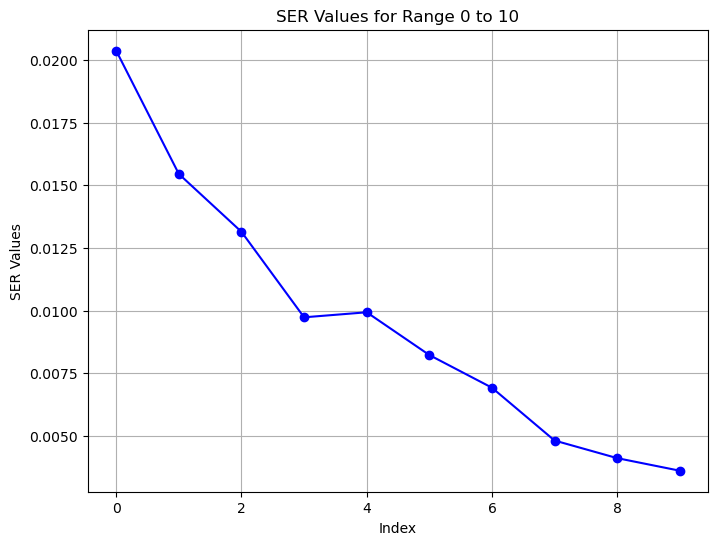

In [14]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
plt.plot(BER_list, marker='o', linestyle='-', color='b')
plt.title('SER Values for Range 0 to 10')
plt.xlabel('Index')
plt.ylabel('SER Values')
plt.grid(True)
plt.show()
